## Noneに関して同時生起行列を求める

### import，入力データの読み込み

In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load in 

# import numpy as np # linear algebra
import numpy as np
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the "../input/" directory.
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('../input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# Any results you write to the current directory are saved as output.

../input/LSWMD.pkl


In [2]:
import os
from os.path import join
os.environ["CUDA_VISIBLE_DEVICES"] = "0,1"

import csv

import pickle
import copy
import cv2
import random
import glob

from sklearn.model_selection import KFold 
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import train_test_split
import joblib

import tensorflow as tf
physical_devices = tf.config.list_physical_devices('GPU')
print(physical_devices)
if len(physical_devices) > 0:
    for device in physical_devices:
        tf.config.experimental.set_memory_growth(device, True)
        print('{} memory growth: {}'.format(device, tf.config.experimental.get_memory_growth(device)))
else:
    print("Not enough GPU hardware devices available")
logical_gpus = tf.config.experimental.list_logical_devices('GPU')
print(logical_gpus)
import keras
from tensorflow.keras import layers, Input, models
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.wrappers.scikit_learn import KerasClassifier 
import keras.backend.tensorflow_backend as tfback


import matplotlib.pyplot as plt

from keras.preprocessing import image
from keras.preprocessing.image import ImageDataGenerator

datapath = join('data', 'wafer')
print(os.listdir("../input"))
import warnings
warnings.filterwarnings("ignore")

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU'), PhysicalDevice(name='/physical_device:GPU:1', device_type='GPU')]
PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU') memory growth: True
PhysicalDevice(name='/physical_device:GPU:1', device_type='GPU') memory growth: True
[LogicalDevice(name='/device:GPU:0', device_type='GPU'), LogicalDevice(name='/device:GPU:1', device_type='GPU')]


Using TensorFlow backend.


['LSWMD.pkl']


### 定義

In [3]:
# Define
max_size = 300
random.seed(1)

### Noneのウエハのみを抽出する

In [4]:
df=pd.read_pickle("../input/LSWMD.pkl")

df = df.drop(['waferIndex'], axis = 1)

def find_dim(x):
    dim0=np.size(x,axis=0)
    dim1=np.size(x,axis=1)
    return dim0,dim1
df['waferMapDim']=df.waferMap.apply(find_dim)

In [5]:
df['failureNum']=df.failureType
df['trainTestNum']=df.trianTestLabel
mapping_type={'Center':0,'Donut':1,'Edge-Loc':2,'Edge-Ring':3,'Loc':4,'Random':5,'Scratch':6,'Near-full':7,'none':8}
mapping_traintest={'Training':0,'Test':1}
df=df.replace({'failureNum':mapping_type, 'trainTestNum':mapping_traintest})

tol_wafers = df.shape[0]

df_withlabel = df[(df['failureNum']>=0) & (df['failureNum']<=8)]
df_withlabel =df_withlabel.reset_index()
df_withpattern = df[(df['failureNum']>=0) & (df['failureNum']<=7)]
df_withpattern = df_withpattern.reset_index()
df_nonpattern = df[(df['failureNum']==8)]

In [6]:
df_nonpattern

,waferMap,dieSize,lotName,trianTestLabel,failureType,waferMapDim,failureNum,trainTestNum
0,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1683.0,lot1,[[Training]],[[none]],"(45, 48)",8,0
1,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1683.0,lot1,[[Training]],[[none]],"(45, 48)",8,0
2,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1683.0,lot1,[[Training]],[[none]],"(45, 48)",8,0
3,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1683.0,lot1,[[Training]],[[none]],"(45, 48)",8,0
4,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1683.0,lot1,[[Training]],[[none]],"(45, 48)",8,0
...,...,...,...,...,...,...,...,...
811438,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 2, 1, 1,...",600.0,lot47542,[[Test]],[[none]],"(26, 30)",8,1
811439,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1,...",600.0,lot47542,[[Test]],[[none]],"(26, 30)",8,1
811442,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 1, 1, 1,...",600.0,lot47542,[[Test]],[[none]],"(26, 30)",8,1
811445,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1,...",600.0,lot47542,[[Test]],[[none]],"(26, 30)",8,1


In [7]:
uni_waferDim=np.unique(df_nonpattern.waferMapDim, return_counts=True)
uni_waferDim[0]

array([(15, 3), (18, 4), (18, 44), (22, 50), (24, 13), (24, 18), (25, 26),
       (25, 27), (26, 25), (26, 26), (26, 28), (26, 30), (27, 15),
       (27, 25), (27, 27), (28, 26), (29, 26), (29, 27), (30, 30),
       (30, 31), (30, 34), (30, 35), (31, 28), (31, 31), (31, 32),
       (32, 32), (33, 29), (33, 32), (33, 35), (33, 37), (34, 31),
       (34, 34), (35, 31), (35, 34), (35, 37), (35, 40), (36, 34),
       (37, 37), (37, 55), (38, 38), (38, 40), (38, 42), (39, 31),
       (39, 37), (39, 39), (39, 50), (41, 33), (41, 38), (41, 40),
       (41, 41), (41, 42), (41, 43), (41, 45), (41, 57), (42, 43),
       (42, 44), (43, 42), (43, 43), (43, 44), (44, 41), (44, 43),
       (44, 44), (44, 45), (45, 42), (45, 43), (45, 45), (45, 48),
       (47, 32), (47, 47), (47, 52), (48, 48), (50, 43), (50, 49),
       (50, 51), (50, 54), (51, 30), (51, 44), (51, 50), (52, 55),
       (53, 58), (53, 71), (54, 71), (55, 56), (55, 66), (58, 59),
       (61, 60), (62, 62), (62, 64), (62, 75), (63, 64

In [8]:
df_nonpattern.iloc[0,:]

waferMap          [[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...
dieSize                                                        1683
lotName                                                        lot1
trianTestLabel                                         [[Training]]
failureType                                                [[none]]
waferMapDim                                                (45, 48)
failureNum                                                        8
trainTestNum                                                      0
Name: 0, dtype: object

In [9]:
sub_df = df_nonpattern.loc[df_nonpattern['waferMapDim'] == (26, 26)]

In [10]:
sub_df

,waferMap,dieSize,lotName,trianTestLabel,failureType,waferMapDim,failureNum,trainTestNum
150,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 1, 1, 2,...",533.0,lot7,[[Training]],[[none]],"(26, 26)",8,0
151,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 1, 1, 1, 1,...",533.0,lot7,[[Training]],[[none]],"(26, 26)",8,0
152,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 2, 1, 1, 1,...",533.0,lot7,[[Training]],[[none]],"(26, 26)",8,0
153,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 2, 2, 1, 1,...",533.0,lot7,[[Training]],[[none]],"(26, 26)",8,0
154,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2,...",533.0,lot7,[[Training]],[[none]],"(26, 26)",8,0
...,...,...,...,...,...,...,...,...
679251,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 1, 1, 1, 1,...",533.0,lot42179,[[Test]],[[none]],"(26, 26)",8,1
679252,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1,...",533.0,lot42179,[[Test]],[[none]],"(26, 26)",8,1
679253,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 1, 1,...",533.0,lot42179,[[Test]],[[none]],"(26, 26)",8,1
679254,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 1, 1, 1,...",533.0,lot42179,[[Test]],[[none]],"(26, 26)",8,1


In [104]:
wafer = np.empty((len(sub_df), 26, 26))
for i in range(len(sub_df)):
    wafer[i] = sub_df.iloc[i,:]['waferMap']

スタンプサイズ:2x2, 平均14.016
スタンプサイズ:3x2, 平均13.674
スタンプサイズ:4x2, 平均13.674
wafer_id:6889, ウエハサイズ:26x26, スタンプサイズ:2x3, oDefects:59, nDefects:160, p=36.875


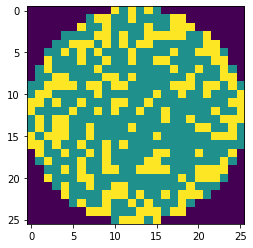

スタンプサイズ:2x3, 平均13.498
wafer_id:6889, ウエハサイズ:26x26, スタンプサイズ:3x3, oDefects:56, nDefects:148, p=37.838


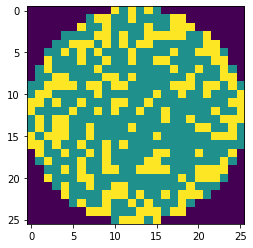

スタンプサイズ:3x3, 平均13.309
wafer_id:6889, ウエハサイズ:26x26, スタンプサイズ:4x3, oDefects:56, nDefects:148, p=37.838


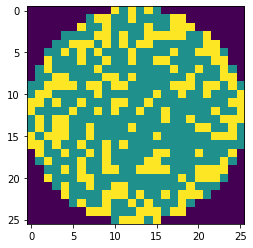

スタンプサイズ:4x3, 平均13.309
wafer_id:6131, ウエハサイズ:26x26, スタンプサイズ:2x4, oDefects:54, nDefects:143, p=37.762


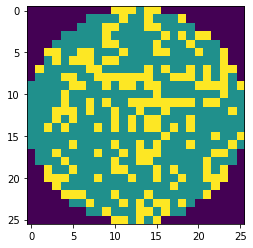

スタンプサイズ:2x4, 平均13.095
wafer_id:6131, ウエハサイズ:26x26, スタンプサイズ:3x4, oDefects:52, nDefects:135, p=38.519


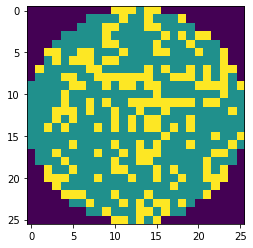

wafer_id:6285, ウエハサイズ:26x26, スタンプサイズ:3x4, oDefects:35, nDefects:100, p=35.000


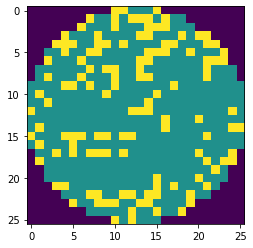

スタンプサイズ:3x4, 平均13.087
wafer_id:6131, ウエハサイズ:26x26, スタンプサイズ:4x4, oDefects:52, nDefects:135, p=38.519


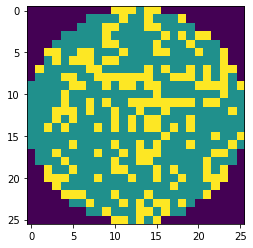

wafer_id:6285, ウエハサイズ:26x26, スタンプサイズ:4x4, oDefects:35, nDefects:100, p=35.000


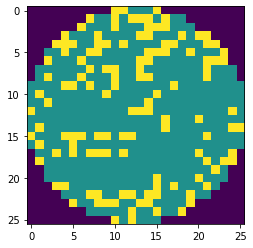

スタンプサイズ:4x4, 平均13.087


In [127]:
DEFECT = 2
waferW = 26
waferH = 26
wafer = wafer26x26
for w in range(2, 5):
    for h in range(2, 5):
        mean_p = 0
        for w_id in range(wafer.shape[0]):
            nDefects = 0
            oDefects = 0
            max_H = waferH if waferH % h == 0 else waferH - h
            max_W = waferW - w if waferW % w == 0 else waferW - 2 * w
            for l in range(0, max_H, h):
                for k in range(0, max_W, w):
                    for j in range(h):
                        for i in range(w):
                            if wafer[w_id][l + j][k + i] == DEFECT:
                                nDefects += 1
                                if wafer[w_id][l + j][k + i + w] == DEFECT:
                                    oDefects += 1
            p = (100.0 * oDefects / nDefects) if nDefects != 0 else -1.0
            if p >= 35: 
                print(f"wafer_id:{w_id}, ウエハサイズ:{waferH}x{waferW}, スタンプサイズ:{h}x{w}, oDefects:{oDefects}, nDefects:{nDefects}, p={p:.3f}")
                plt.imshow(wafer[w_id])
                plt.show()
            mean_p += p
        
        print(f"スタンプサイズ:{h}x{w}, 平均{mean_p / wafer.shape[0]:.3f}")

In [30]:
DEFECT = 2

def detectShotDefects(x, w_id, w, h):
    nDefects = 0
    oDefects = 0
    waferH = x.shape[0]
    waferW = x.shape[1]
    max_H = waferH if waferH % h == 0 else waferH - h
    max_W = waferW - w if waferW % w == 0 else waferW - 2 * w
    for l in range(0, max_H, h):
        for k in range(0, max_W, w):
            for j in range(h):
                for i in range(w):
                    if x[l + j][k + i] == DEFECT:
                        nDefects += 1
                        if x[l + j][k + i + w] == DEFECT:
                            oDefects += 1
    p = (100.0 * oDefects / nDefects) if nDefects != 0 else -1.0
    if p >= 70:
        print(f"wafer_id:{w_id}, ウエハサイズ:{waferH}x{waferW}, スタンプサイズ:{h}x{w}, oDefects:{oDefects}, nDefects:{nDefects}, p={p:.3f}")
        plt.imshow(x)
        plt.show()
        
    return p

(45, 48)
wafer_id:151, ウエハサイズ:26x26, スタンプサイズ:3x4, oDefects:36, nDefects:118, p=30.508


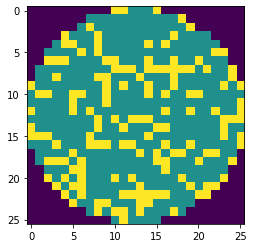

wafer_id:151, ウエハサイズ:26x26, スタンプサイズ:4x4, oDefects:36, nDefects:118, p=30.508


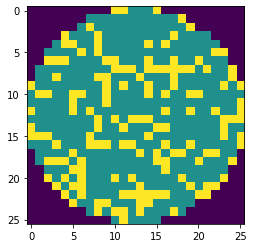

wafer_id:164, ウエハサイズ:26x26, スタンプサイズ:2x3, oDefects:35, nDefects:112, p=31.250


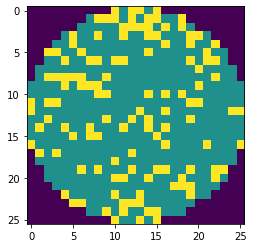

wafer_id:164, ウエハサイズ:26x26, スタンプサイズ:3x3, oDefects:33, nDefects:105, p=31.429


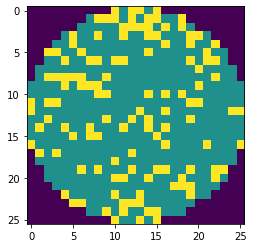

wafer_id:164, ウエハサイズ:26x26, スタンプサイズ:4x3, oDefects:33, nDefects:105, p=31.429


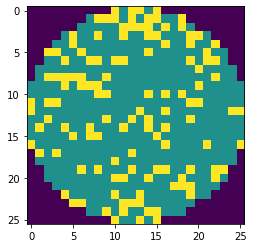

wafer_id:247, ウエハサイズ:26x26, スタンプサイズ:3x4, oDefects:28, nDefects:92, p=30.435


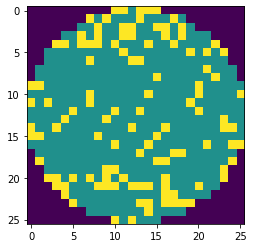

wafer_id:247, ウエハサイズ:26x26, スタンプサイズ:4x4, oDefects:28, nDefects:92, p=30.435


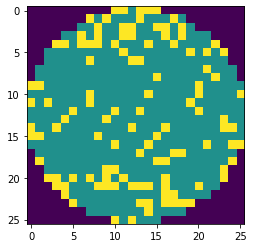

wafer_id:500, ウエハサイズ:26x26, スタンプサイズ:2x3, oDefects:33, nDefects:104, p=31.731


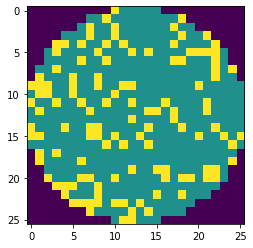

wafer_id:500, ウエハサイズ:26x26, スタンプサイズ:3x3, oDefects:33, nDefects:99, p=33.333


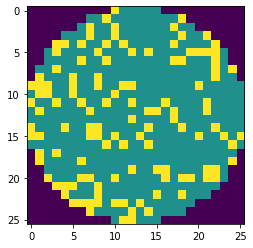

wafer_id:500, ウエハサイズ:26x26, スタンプサイズ:4x3, oDefects:33, nDefects:99, p=33.333


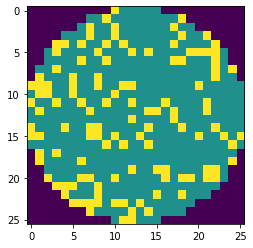

wafer_id:923, ウエハサイズ:26x26, スタンプサイズ:2x2, oDefects:26, nDefects:82, p=31.707


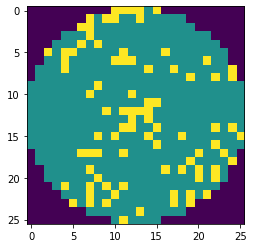

wafer_id:923, ウエハサイズ:26x26, スタンプサイズ:3x2, oDefects:26, nDefects:80, p=32.500


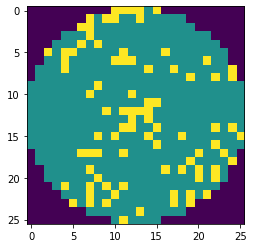

wafer_id:923, ウエハサイズ:26x26, スタンプサイズ:4x2, oDefects:26, nDefects:80, p=32.500


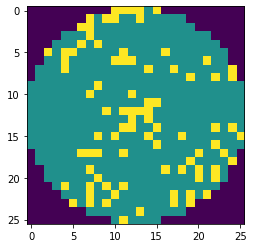

(26, 26)
wafer_id:1066, ウエハサイズ:26x26, スタンプサイズ:2x4, oDefects:30, nDefects:99, p=30.303


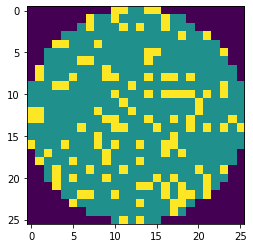

wafer_id:1066, ウエハサイズ:26x26, スタンプサイズ:3x4, oDefects:30, nDefects:96, p=31.250


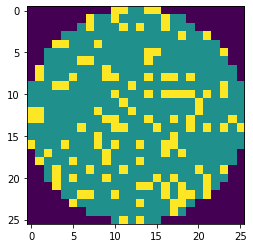

wafer_id:1066, ウエハサイズ:26x26, スタンプサイズ:4x4, oDefects:30, nDefects:96, p=31.250


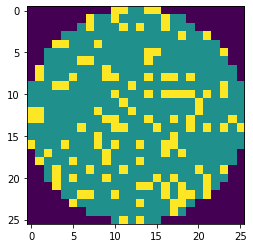

wafer_id:1414, ウエハサイズ:26x26, スタンプサイズ:2x4, oDefects:23, nDefects:74, p=31.081


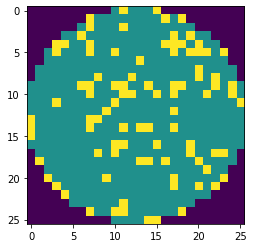

wafer_id:1414, ウエハサイズ:26x26, スタンプサイズ:3x4, oDefects:22, nDefects:68, p=32.353


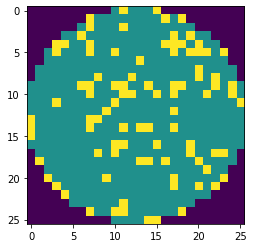

wafer_id:1414, ウエハサイズ:26x26, スタンプサイズ:4x4, oDefects:22, nDefects:68, p=32.353


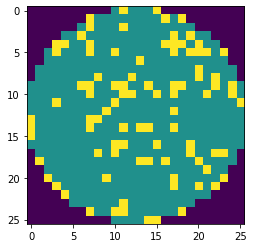

wafer_id:1590, ウエハサイズ:26x26, スタンプサイズ:3x2, oDefects:35, nDefects:116, p=30.172


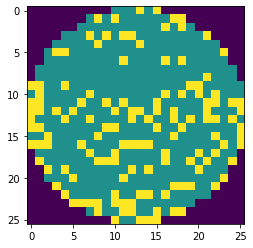

wafer_id:1590, ウエハサイズ:26x26, スタンプサイズ:4x2, oDefects:35, nDefects:116, p=30.172


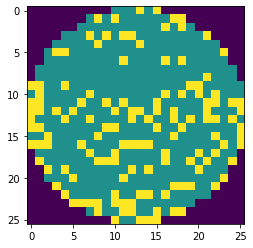

(26, 26)
wafer_id:2771, ウエハサイズ:26x26, スタンプサイズ:3x2, oDefects:42, nDefects:138, p=30.435


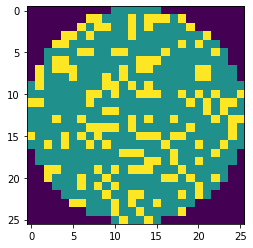

wafer_id:2771, ウエハサイズ:26x26, スタンプサイズ:4x2, oDefects:42, nDefects:138, p=30.435


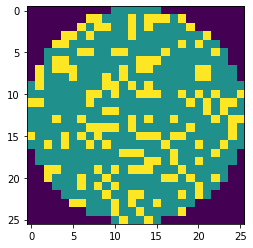

(26, 26)
wafer_id:3358, ウエハサイズ:26x26, スタンプサイズ:2x4, oDefects:23, nDefects:76, p=30.263


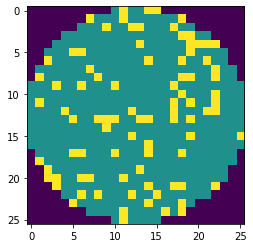

wafer_id:3358, ウエハサイズ:26x26, スタンプサイズ:3x4, oDefects:23, nDefects:72, p=31.944


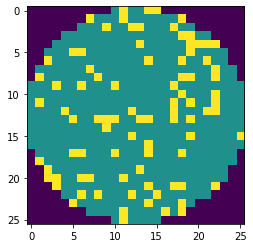

wafer_id:3358, ウエハサイズ:26x26, スタンプサイズ:4x4, oDefects:23, nDefects:72, p=31.944


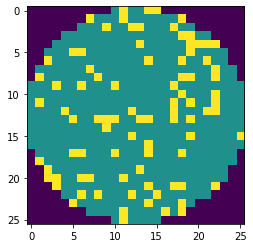

wafer_id:3489, ウエハサイズ:26x26, スタンプサイズ:3x4, oDefects:29, nDefects:96, p=30.208


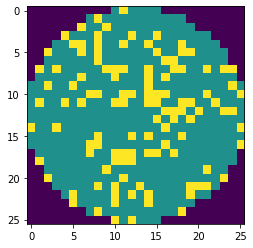

wafer_id:3489, ウエハサイズ:26x26, スタンプサイズ:4x4, oDefects:29, nDefects:96, p=30.208


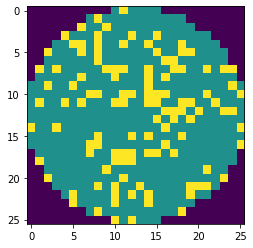

wafer_id:3541, ウエハサイズ:26x26, スタンプサイズ:2x4, oDefects:29, nDefects:96, p=30.208


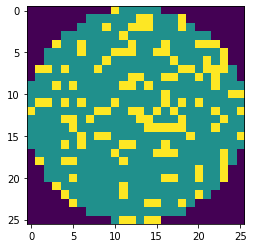

wafer_id:3541, ウエハサイズ:26x26, スタンプサイズ:3x4, oDefects:28, nDefects:92, p=30.435


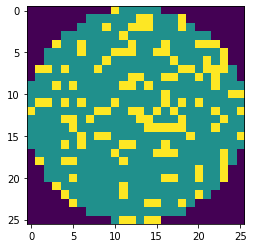

wafer_id:3541, ウエハサイズ:26x26, スタンプサイズ:4x4, oDefects:28, nDefects:92, p=30.435


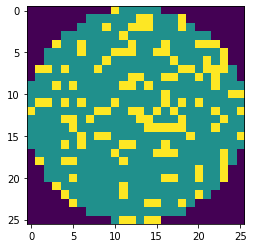

wafer_id:3793, ウエハサイズ:26x26, スタンプサイズ:2x3, oDefects:37, nDefects:121, p=30.579


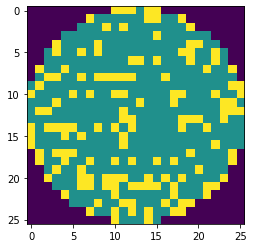

wafer_id:3793, ウエハサイズ:26x26, スタンプサイズ:3x3, oDefects:35, nDefects:113, p=30.973


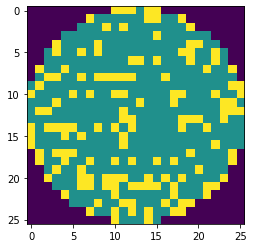

wafer_id:3793, ウエハサイズ:26x26, スタンプサイズ:4x3, oDefects:35, nDefects:113, p=30.973


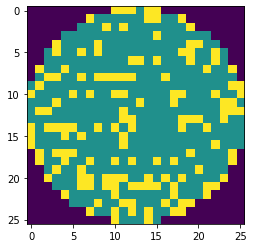

wafer_id:3862, ウエハサイズ:26x26, スタンプサイズ:2x2, oDefects:49, nDefects:154, p=31.818


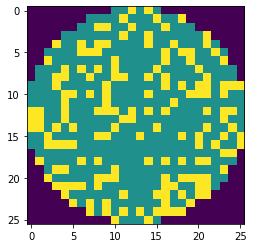

(26, 26)
wafer_id:4174, ウエハサイズ:26x26, スタンプサイズ:2x3, oDefects:35, nDefects:116, p=30.172


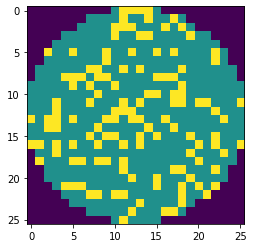

wafer_id:4174, ウエハサイズ:26x26, スタンプサイズ:3x3, oDefects:35, nDefects:112, p=31.250


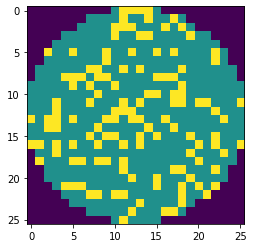

wafer_id:4174, ウエハサイズ:26x26, スタンプサイズ:4x3, oDefects:35, nDefects:112, p=31.250


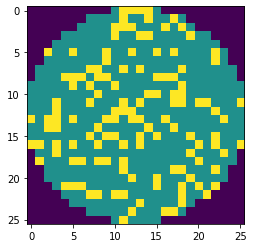

wafer_id:4905, ウエハサイズ:26x26, スタンプサイズ:2x4, oDefects:38, nDefects:126, p=30.159


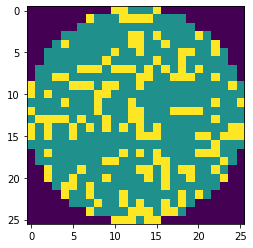

(26, 26)
wafer_id:5430, ウエハサイズ:26x26, スタンプサイズ:2x2, oDefects:30, nDefects:100, p=30.000


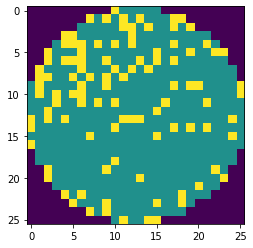

wafer_id:5430, ウエハサイズ:26x26, スタンプサイズ:3x2, oDefects:29, nDefects:95, p=30.526


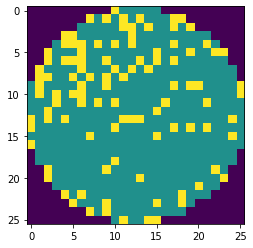

wafer_id:5430, ウエハサイズ:26x26, スタンプサイズ:4x2, oDefects:29, nDefects:95, p=30.526


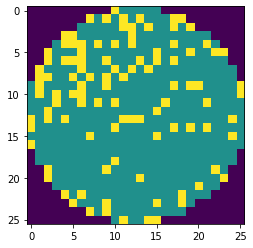

(26, 26)
(51, 50)
(50, 49)
wafer_id:8555, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:113, nDefects:342, p=33.041


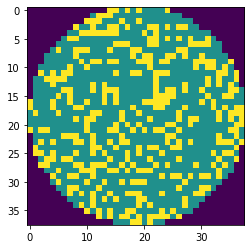

wafer_id:8555, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:105, nDefects:329, p=31.915


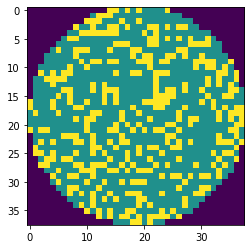

wafer_id:8555, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:105, nDefects:329, p=31.915


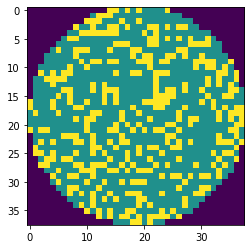

wafer_id:8556, ウエハサイズ:38x38, スタンプサイズ:2x3, oDefects:107, nDefects:334, p=32.036


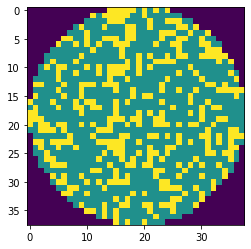

wafer_id:8556, ウエハサイズ:38x38, スタンプサイズ:3x3, oDefects:106, nDefects:328, p=32.317


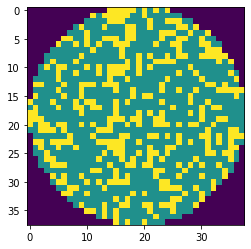

wafer_id:8556, ウエハサイズ:38x38, スタンプサイズ:4x3, oDefects:106, nDefects:328, p=32.317


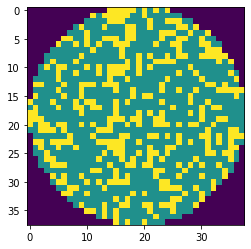

wafer_id:8556, ウエハサイズ:38x38, スタンプサイズ:2x4, oDefects:102, nDefects:326, p=31.288


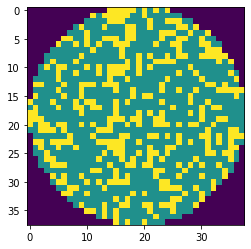

wafer_id:8556, ウエハサイズ:38x38, スタンプサイズ:3x4, oDefects:102, nDefects:320, p=31.875


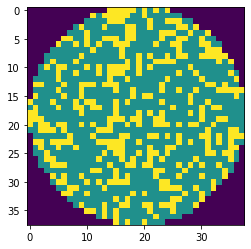

wafer_id:8556, ウエハサイズ:38x38, スタンプサイズ:4x4, oDefects:102, nDefects:320, p=31.875


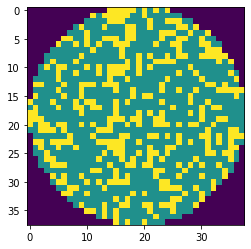

wafer_id:8558, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:113, nDefects:346, p=32.659


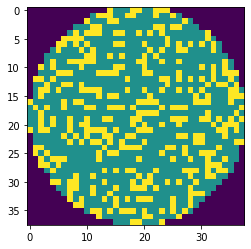

wafer_id:8558, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:113, nDefects:339, p=33.333


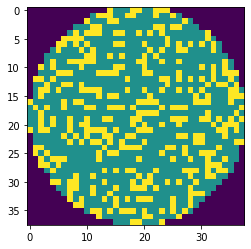

wafer_id:8558, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:113, nDefects:339, p=33.333


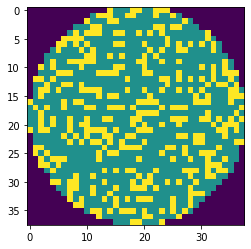

wafer_id:8559, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:110, nDefects:350, p=31.429


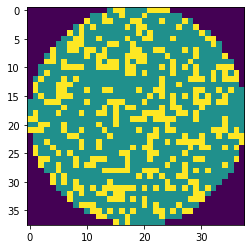

wafer_id:8559, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:109, nDefects:344, p=31.686


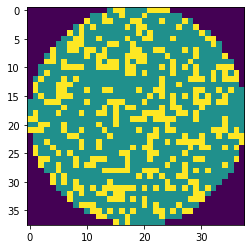

wafer_id:8559, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:109, nDefects:344, p=31.686


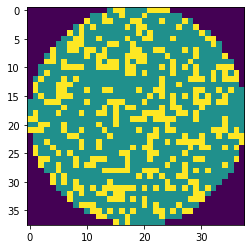

wafer_id:8561, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:104, nDefects:341, p=30.499


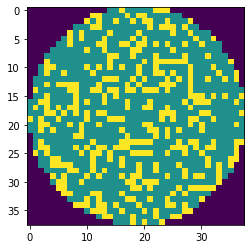

wafer_id:8561, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:103, nDefects:332, p=31.024


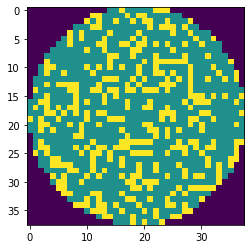

wafer_id:8561, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:103, nDefects:332, p=31.024


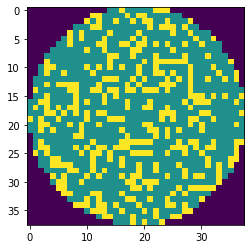

wafer_id:8562, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:117, nDefects:350, p=33.429


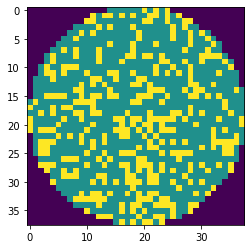

wafer_id:8562, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:112, nDefects:338, p=33.136


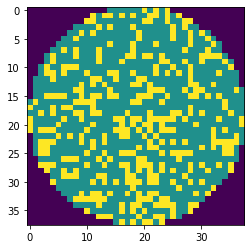

wafer_id:8562, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:112, nDefects:338, p=33.136


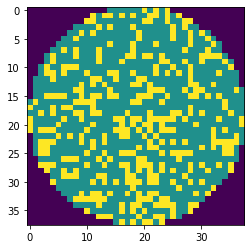

wafer_id:8562, ウエハサイズ:38x38, スタンプサイズ:2x4, oDefects:97, nDefects:322, p=30.124


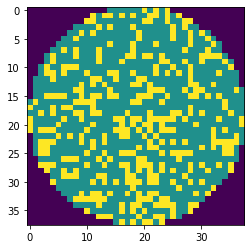

wafer_id:8562, ウエハサイズ:38x38, スタンプサイズ:3x4, oDefects:95, nDefects:310, p=30.645


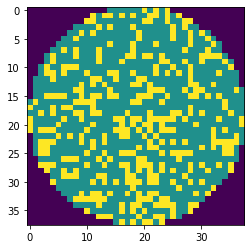

wafer_id:8562, ウエハサイズ:38x38, スタンプサイズ:4x4, oDefects:95, nDefects:310, p=30.645


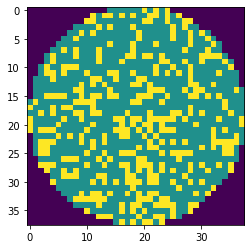

wafer_id:8563, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:113, nDefects:354, p=31.921


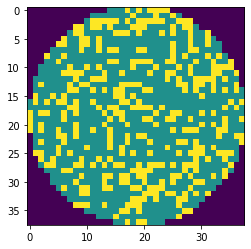

wafer_id:8563, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:112, nDefects:349, p=32.092


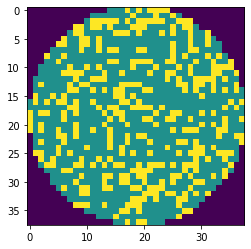

wafer_id:8563, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:112, nDefects:349, p=32.092


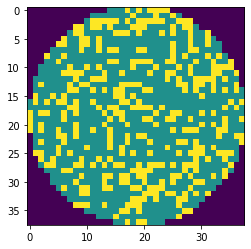

wafer_id:8563, ウエハサイズ:38x38, スタンプサイズ:2x3, oDefects:110, nDefects:332, p=33.133


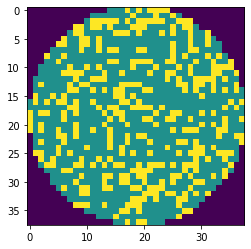

wafer_id:8563, ウエハサイズ:38x38, スタンプサイズ:3x3, oDefects:109, nDefects:327, p=33.333


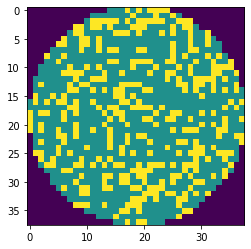

wafer_id:8563, ウエハサイズ:38x38, スタンプサイズ:4x3, oDefects:109, nDefects:327, p=33.333


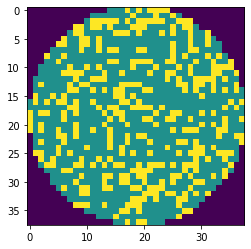

wafer_id:8564, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:126, nDefects:371, p=33.962


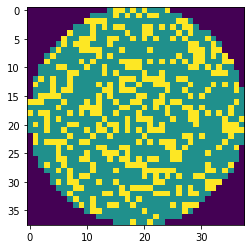

wafer_id:8564, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:126, nDefects:368, p=34.239


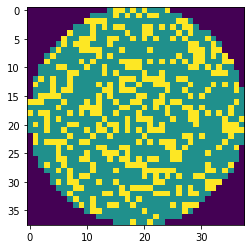

wafer_id:8564, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:126, nDefects:368, p=34.239


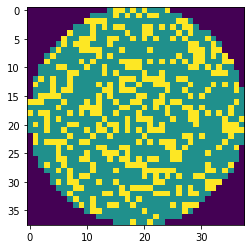

wafer_id:8564, ウエハサイズ:38x38, スタンプサイズ:2x4, oDefects:111, nDefects:341, p=32.551


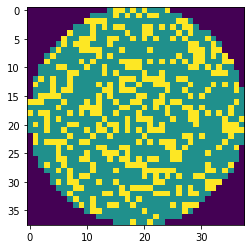

wafer_id:8564, ウエハサイズ:38x38, スタンプサイズ:3x4, oDefects:111, nDefects:338, p=32.840


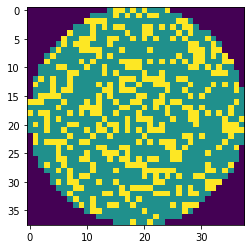

wafer_id:8564, ウエハサイズ:38x38, スタンプサイズ:4x4, oDefects:111, nDefects:338, p=32.840


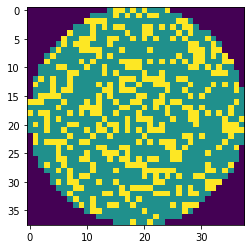

wafer_id:8566, ウエハサイズ:38x38, スタンプサイズ:2x3, oDefects:99, nDefects:320, p=30.938


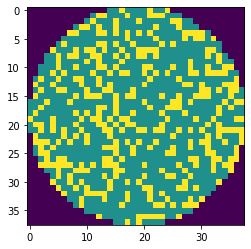

wafer_id:8566, ウエハサイズ:38x38, スタンプサイズ:3x3, oDefects:96, nDefects:311, p=30.868


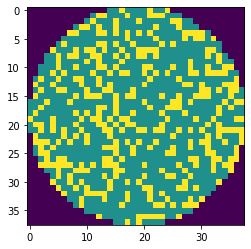

wafer_id:8566, ウエハサイズ:38x38, スタンプサイズ:4x3, oDefects:96, nDefects:311, p=30.868


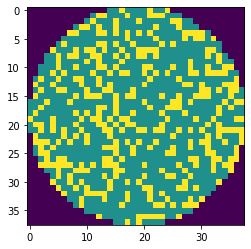

wafer_id:8567, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:120, nDefects:357, p=33.613


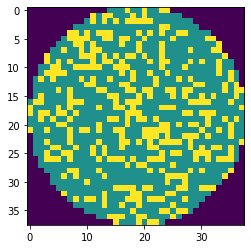

wafer_id:8567, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:118, nDefects:347, p=34.006


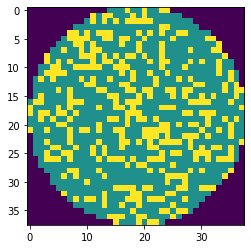

wafer_id:8567, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:118, nDefects:347, p=34.006


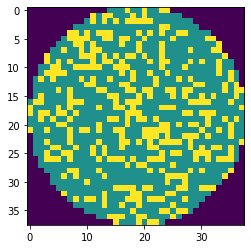

wafer_id:8567, ウエハサイズ:38x38, スタンプサイズ:2x3, oDefects:102, nDefects:333, p=30.631


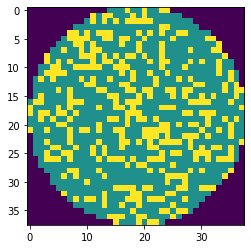

wafer_id:8567, ウエハサイズ:38x38, スタンプサイズ:3x3, oDefects:100, nDefects:323, p=30.960


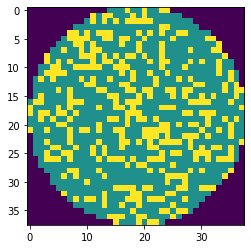

wafer_id:8567, ウエハサイズ:38x38, スタンプサイズ:4x3, oDefects:100, nDefects:323, p=30.960


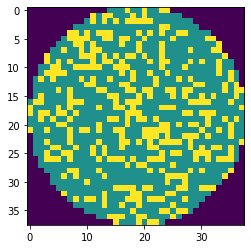

wafer_id:8568, ウエハサイズ:38x38, スタンプサイズ:2x3, oDefects:105, nDefects:335, p=31.343


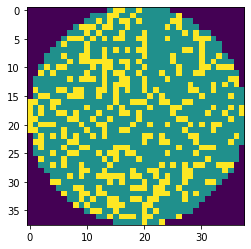

wafer_id:8568, ウエハサイズ:38x38, スタンプサイズ:3x3, oDefects:101, nDefects:326, p=30.982


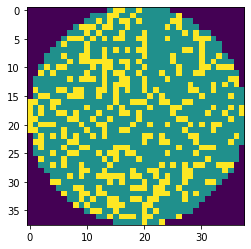

wafer_id:8568, ウエハサイズ:38x38, スタンプサイズ:4x3, oDefects:101, nDefects:326, p=30.982


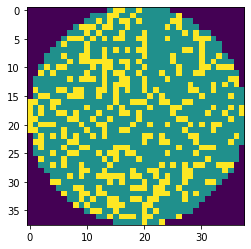

wafer_id:8568, ウエハサイズ:38x38, スタンプサイズ:2x4, oDefects:111, nDefects:327, p=33.945


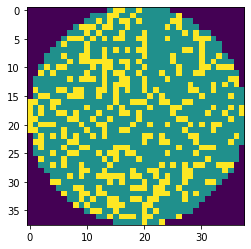

wafer_id:8568, ウエハサイズ:38x38, スタンプサイズ:3x4, oDefects:108, nDefects:318, p=33.962


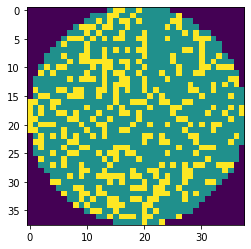

wafer_id:8568, ウエハサイズ:38x38, スタンプサイズ:4x4, oDefects:108, nDefects:318, p=33.962


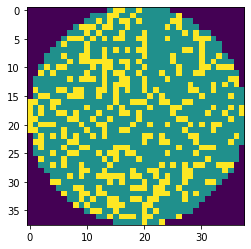

wafer_id:8569, ウエハサイズ:38x38, スタンプサイズ:2x4, oDefects:102, nDefects:330, p=30.909


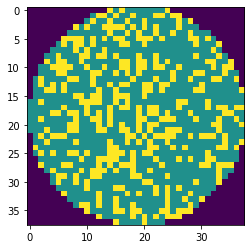

wafer_id:8569, ウエハサイズ:38x38, スタンプサイズ:3x4, oDefects:99, nDefects:321, p=30.841


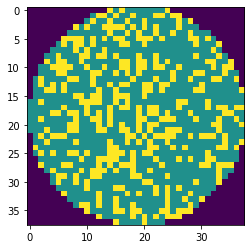

wafer_id:8569, ウエハサイズ:38x38, スタンプサイズ:4x4, oDefects:99, nDefects:321, p=30.841


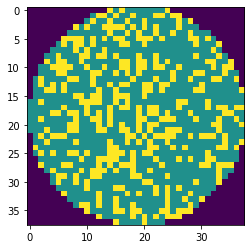

wafer_id:8570, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:116, nDefects:365, p=31.781


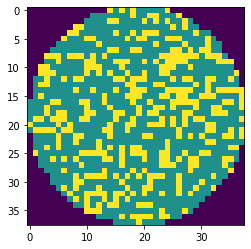

wafer_id:8570, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:112, nDefects:357, p=31.373


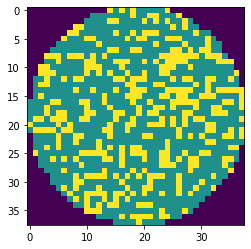

wafer_id:8570, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:112, nDefects:357, p=31.373


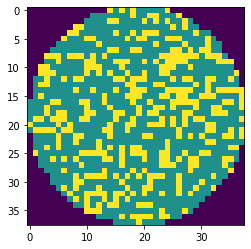

wafer_id:8570, ウエハサイズ:38x38, スタンプサイズ:2x4, oDefects:115, nDefects:334, p=34.431


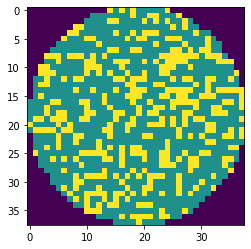

wafer_id:8570, ウエハサイズ:38x38, スタンプサイズ:3x4, oDefects:112, nDefects:326, p=34.356


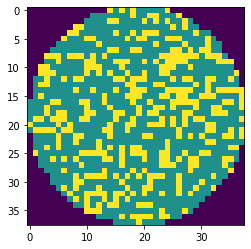

wafer_id:8570, ウエハサイズ:38x38, スタンプサイズ:4x4, oDefects:112, nDefects:326, p=34.356


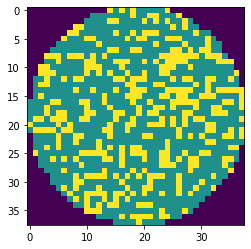

wafer_id:8572, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:109, nDefects:353, p=30.878


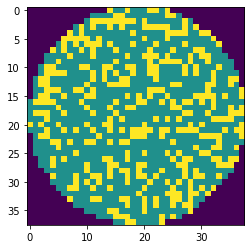

wafer_id:8572, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:107, nDefects:345, p=31.014


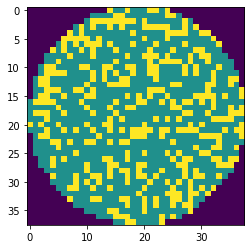

wafer_id:8572, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:107, nDefects:345, p=31.014


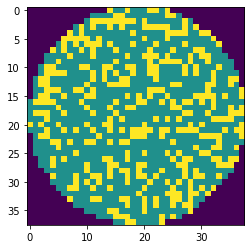

wafer_id:8572, ウエハサイズ:38x38, スタンプサイズ:3x3, oDefects:98, nDefects:325, p=30.154


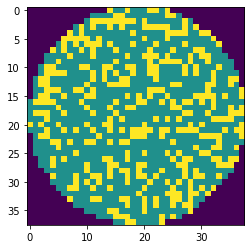

wafer_id:8572, ウエハサイズ:38x38, スタンプサイズ:4x3, oDefects:98, nDefects:325, p=30.154


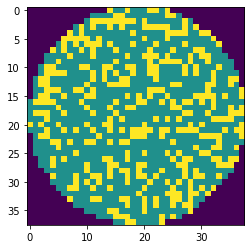

wafer_id:8806, ウエハサイズ:50x43, スタンプサイズ:2x4, oDefects:86, nDefects:282, p=30.496


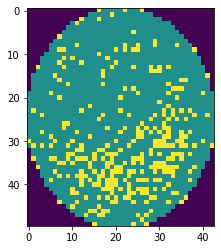

wafer_id:8806, ウエハサイズ:50x43, スタンプサイズ:3x4, oDefects:86, nDefects:278, p=30.935


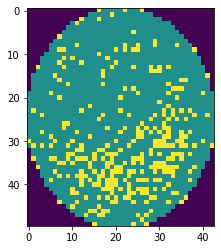

wafer_id:8806, ウエハサイズ:50x43, スタンプサイズ:4x4, oDefects:86, nDefects:278, p=30.935


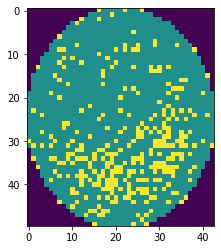

(64, 60)
wafer_id:9273, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:131, nDefects:385, p=34.026


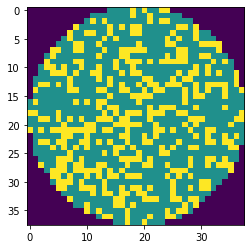

wafer_id:9273, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:131, nDefects:377, p=34.748


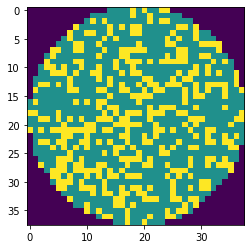

wafer_id:9273, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:131, nDefects:377, p=34.748


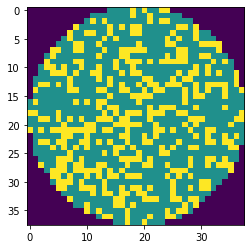

wafer_id:9273, ウエハサイズ:38x38, スタンプサイズ:2x4, oDefects:119, nDefects:360, p=33.056


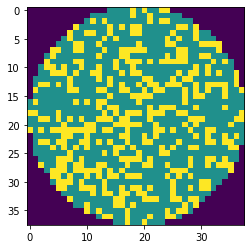

wafer_id:9273, ウエハサイズ:38x38, スタンプサイズ:3x4, oDefects:116, nDefects:352, p=32.955


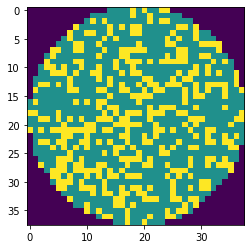

wafer_id:9273, ウエハサイズ:38x38, スタンプサイズ:4x4, oDefects:116, nDefects:352, p=32.955


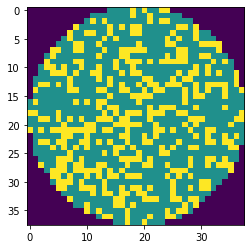

wafer_id:9274, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:115, nDefects:363, p=31.680


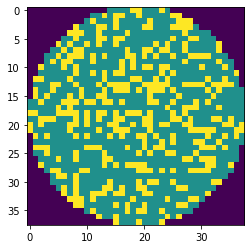

wafer_id:9274, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:114, nDefects:356, p=32.022


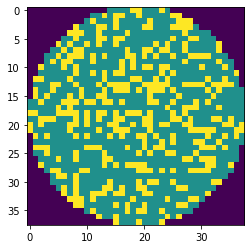

wafer_id:9274, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:114, nDefects:356, p=32.022


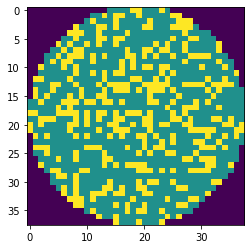

wafer_id:9274, ウエハサイズ:38x38, スタンプサイズ:2x3, oDefects:104, nDefects:344, p=30.233


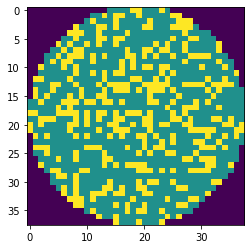

wafer_id:9274, ウエハサイズ:38x38, スタンプサイズ:3x3, oDefects:103, nDefects:337, p=30.564


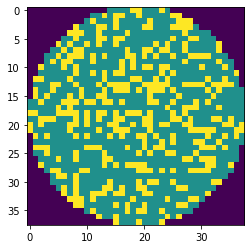

wafer_id:9274, ウエハサイズ:38x38, スタンプサイズ:4x3, oDefects:103, nDefects:337, p=30.564


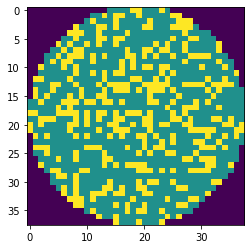

wafer_id:9275, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:128, nDefects:380, p=33.684


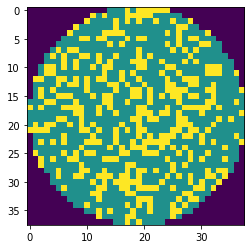

wafer_id:9275, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:127, nDefects:374, p=33.957


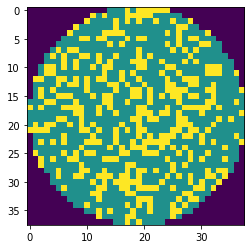

wafer_id:9275, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:127, nDefects:374, p=33.957


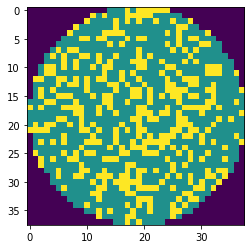

wafer_id:9275, ウエハサイズ:38x38, スタンプサイズ:2x3, oDefects:111, nDefects:369, p=30.081


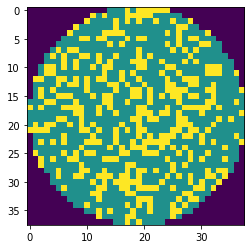

wafer_id:9275, ウエハサイズ:38x38, スタンプサイズ:3x3, oDefects:111, nDefects:363, p=30.579


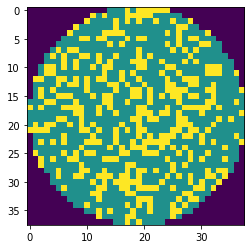

wafer_id:9275, ウエハサイズ:38x38, スタンプサイズ:4x3, oDefects:111, nDefects:363, p=30.579


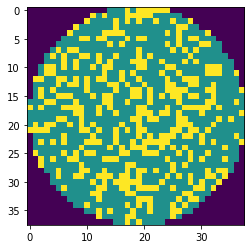

wafer_id:9275, ウエハサイズ:38x38, スタンプサイズ:3x4, oDefects:107, nDefects:353, p=30.312


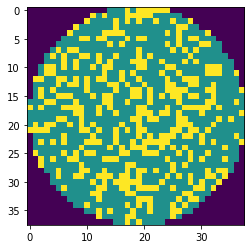

wafer_id:9275, ウエハサイズ:38x38, スタンプサイズ:4x4, oDefects:107, nDefects:353, p=30.312


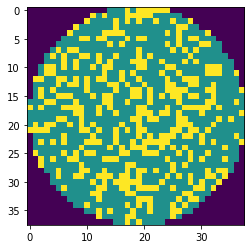

wafer_id:9276, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:129, nDefects:379, p=34.037


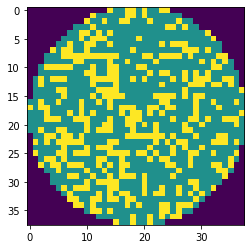

wafer_id:9276, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:127, nDefects:371, p=34.232


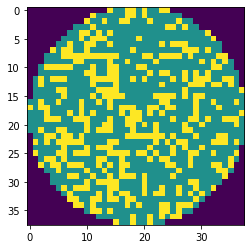

wafer_id:9276, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:127, nDefects:371, p=34.232


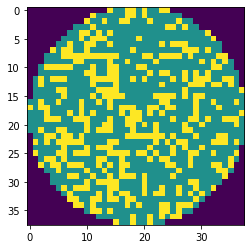

wafer_id:9276, ウエハサイズ:38x38, スタンプサイズ:2x4, oDefects:115, nDefects:349, p=32.951


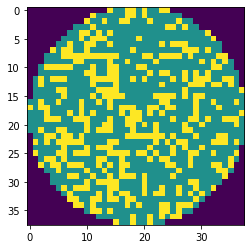

wafer_id:9276, ウエハサイズ:38x38, スタンプサイズ:3x4, oDefects:114, nDefects:341, p=33.431


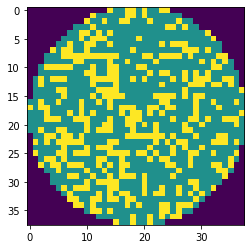

wafer_id:9276, ウエハサイズ:38x38, スタンプサイズ:4x4, oDefects:114, nDefects:341, p=33.431


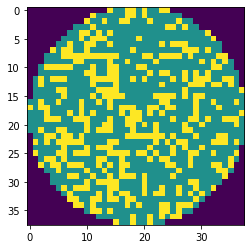

wafer_id:9277, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:124, nDefects:386, p=32.124


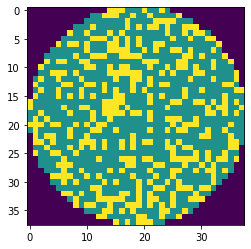

wafer_id:9277, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:121, nDefects:375, p=32.267


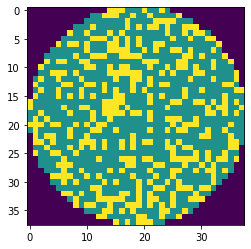

wafer_id:9277, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:121, nDefects:375, p=32.267


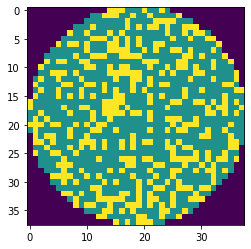

wafer_id:9277, ウエハサイズ:38x38, スタンプサイズ:2x3, oDefects:124, nDefects:367, p=33.787


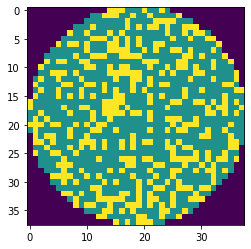

wafer_id:9277, ウエハサイズ:38x38, スタンプサイズ:3x3, oDefects:121, nDefects:356, p=33.989


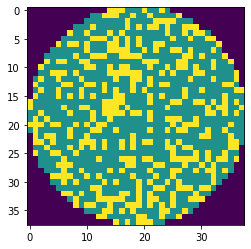

wafer_id:9277, ウエハサイズ:38x38, スタンプサイズ:4x3, oDefects:121, nDefects:356, p=33.989


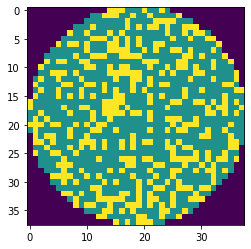

wafer_id:9277, ウエハサイズ:38x38, スタンプサイズ:2x4, oDefects:114, nDefects:356, p=32.022


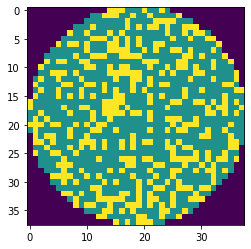

wafer_id:9277, ウエハサイズ:38x38, スタンプサイズ:3x4, oDefects:111, nDefects:345, p=32.174


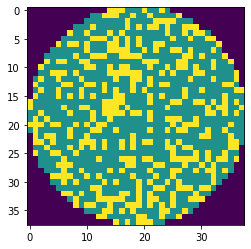

wafer_id:9277, ウエハサイズ:38x38, スタンプサイズ:4x4, oDefects:111, nDefects:345, p=32.174


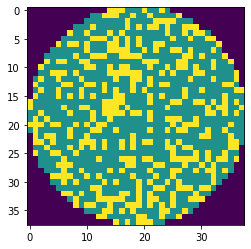

wafer_id:9278, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:120, nDefects:386, p=31.088


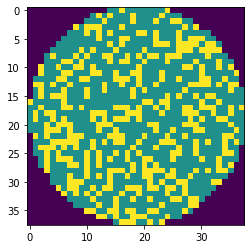

wafer_id:9278, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:116, nDefects:374, p=31.016


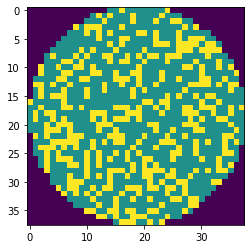

wafer_id:9278, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:116, nDefects:374, p=31.016


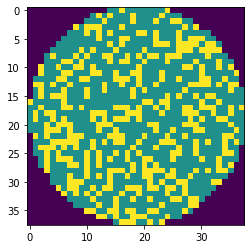

wafer_id:9278, ウエハサイズ:38x38, スタンプサイズ:2x3, oDefects:115, nDefects:360, p=31.944


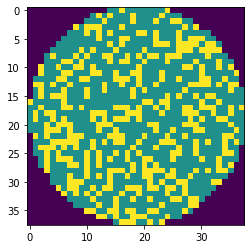

wafer_id:9278, ウエハサイズ:38x38, スタンプサイズ:3x3, oDefects:112, nDefects:348, p=32.184


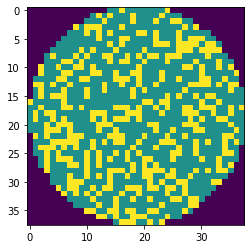

wafer_id:9278, ウエハサイズ:38x38, スタンプサイズ:4x3, oDefects:112, nDefects:348, p=32.184


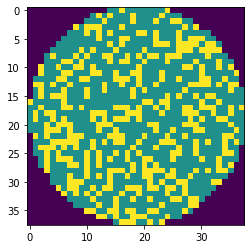

wafer_id:9278, ウエハサイズ:38x38, スタンプサイズ:2x4, oDefects:120, nDefects:354, p=33.898


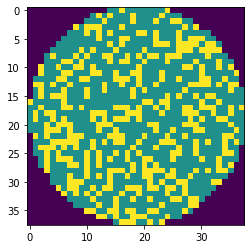

wafer_id:9278, ウエハサイズ:38x38, スタンプサイズ:3x4, oDefects:117, nDefects:342, p=34.211


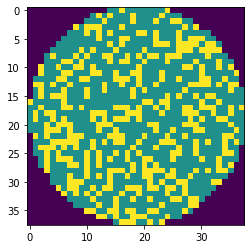

wafer_id:9278, ウエハサイズ:38x38, スタンプサイズ:4x4, oDefects:117, nDefects:342, p=34.211


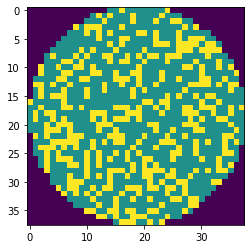

wafer_id:9279, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:111, nDefects:364, p=30.495


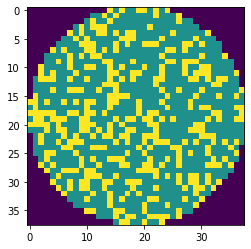

wafer_id:9279, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:107, nDefects:352, p=30.398


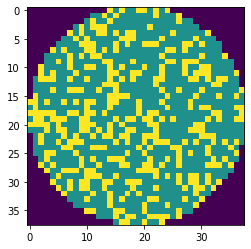

wafer_id:9279, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:107, nDefects:352, p=30.398


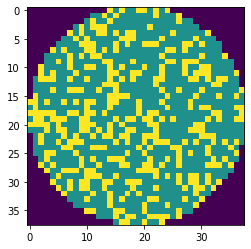

wafer_id:9280, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:137, nDefects:393, p=34.860


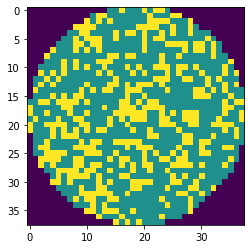

wafer_id:9280, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:135, nDefects:387, p=34.884


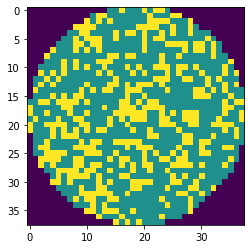

wafer_id:9280, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:135, nDefects:387, p=34.884


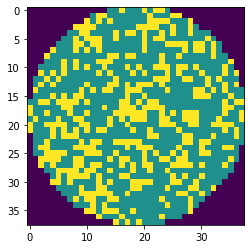

wafer_id:9280, ウエハサイズ:38x38, スタンプサイズ:2x3, oDefects:120, nDefects:373, p=32.172


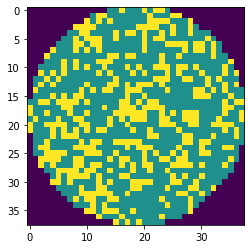

wafer_id:9280, ウエハサイズ:38x38, スタンプサイズ:3x3, oDefects:120, nDefects:367, p=32.698


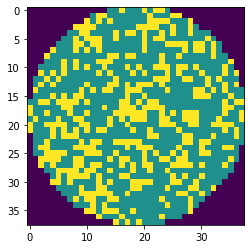

wafer_id:9280, ウエハサイズ:38x38, スタンプサイズ:4x3, oDefects:120, nDefects:367, p=32.698


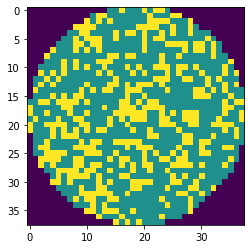

wafer_id:9280, ウエハサイズ:38x38, スタンプサイズ:2x4, oDefects:122, nDefects:366, p=33.333


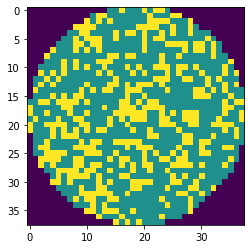

wafer_id:9280, ウエハサイズ:38x38, スタンプサイズ:3x4, oDefects:120, nDefects:360, p=33.333


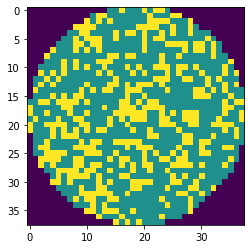

wafer_id:9280, ウエハサイズ:38x38, スタンプサイズ:4x4, oDefects:120, nDefects:360, p=33.333


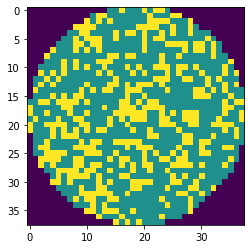

wafer_id:9305, ウエハサイズ:38x38, スタンプサイズ:2x3, oDefects:116, nDefects:365, p=31.781


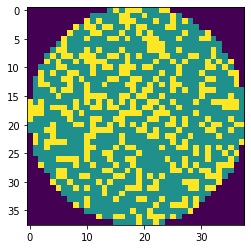

wafer_id:9305, ウエハサイズ:38x38, スタンプサイズ:3x3, oDefects:111, nDefects:355, p=31.268


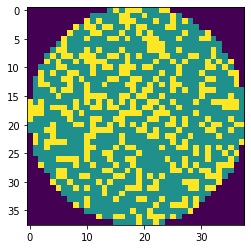

wafer_id:9305, ウエハサイズ:38x38, スタンプサイズ:4x3, oDefects:111, nDefects:355, p=31.268


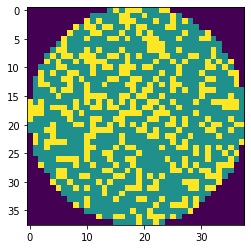

wafer_id:9305, ウエハサイズ:38x38, スタンプサイズ:2x4, oDefects:122, nDefects:355, p=34.366


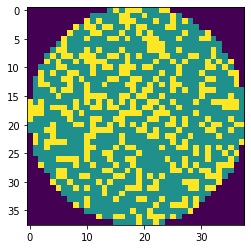

wafer_id:9305, ウエハサイズ:38x38, スタンプサイズ:3x4, oDefects:118, nDefects:345, p=34.203


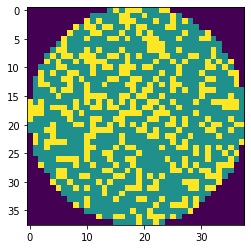

wafer_id:9305, ウエハサイズ:38x38, スタンプサイズ:4x4, oDefects:118, nDefects:345, p=34.203


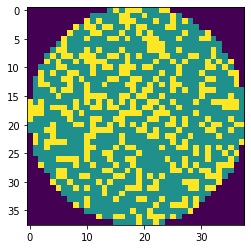

wafer_id:9306, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:97, nDefects:323, p=30.031


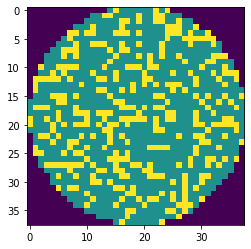

wafer_id:9306, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:97, nDefects:323, p=30.031


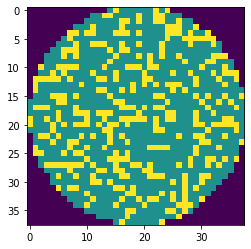

wafer_id:9307, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:109, nDefects:338, p=32.249


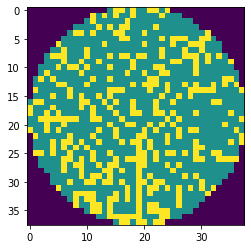

wafer_id:9307, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:103, nDefects:324, p=31.790


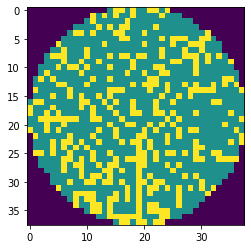

wafer_id:9307, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:103, nDefects:324, p=31.790


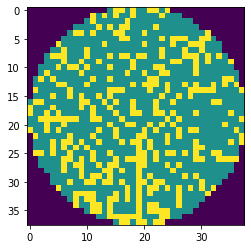

wafer_id:9307, ウエハサイズ:38x38, スタンプサイズ:2x3, oDefects:104, nDefects:325, p=32.000


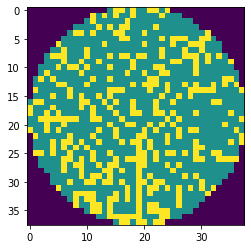

wafer_id:9307, ウエハサイズ:38x38, スタンプサイズ:3x3, oDefects:97, nDefects:311, p=31.190


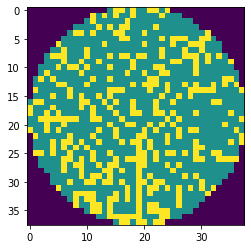

wafer_id:9307, ウエハサイズ:38x38, スタンプサイズ:4x3, oDefects:97, nDefects:311, p=31.190


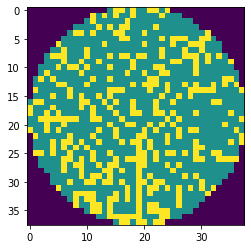

wafer_id:9309, ウエハサイズ:38x38, スタンプサイズ:2x4, oDefects:108, nDefects:335, p=32.239


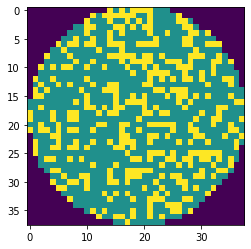

wafer_id:9309, ウエハサイズ:38x38, スタンプサイズ:3x4, oDefects:107, nDefects:328, p=32.622


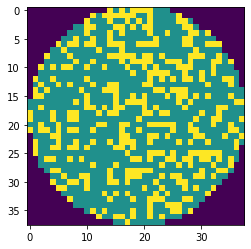

wafer_id:9309, ウエハサイズ:38x38, スタンプサイズ:4x4, oDefects:107, nDefects:328, p=32.622


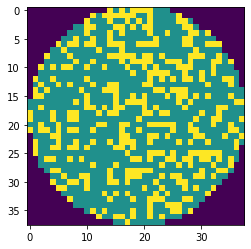

wafer_id:9310, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:99, nDefects:323, p=30.650


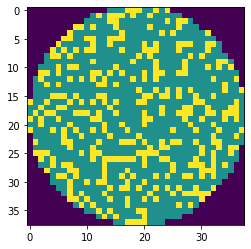

wafer_id:9310, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:96, nDefects:316, p=30.380


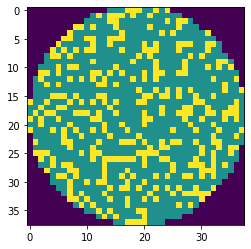

wafer_id:9310, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:96, nDefects:316, p=30.380


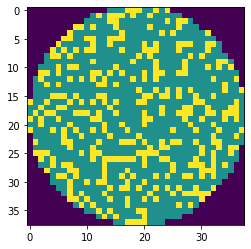

wafer_id:9313, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:101, nDefects:332, p=30.422


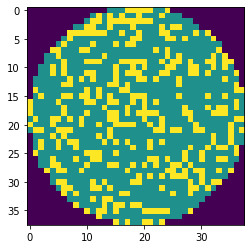

wafer_id:9313, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:99, nDefects:326, p=30.368


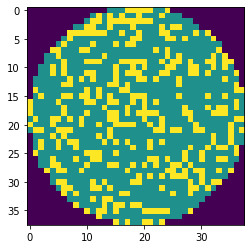

wafer_id:9313, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:99, nDefects:326, p=30.368


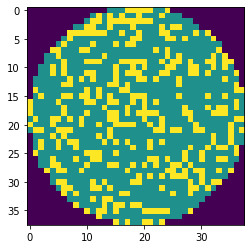

wafer_id:9313, ウエハサイズ:38x38, スタンプサイズ:2x3, oDefects:98, nDefects:310, p=31.613


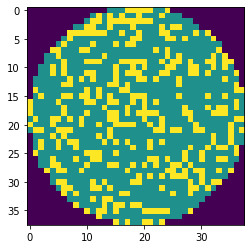

wafer_id:9313, ウエハサイズ:38x38, スタンプサイズ:3x3, oDefects:96, nDefects:304, p=31.579


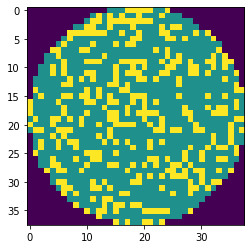

wafer_id:9313, ウエハサイズ:38x38, スタンプサイズ:4x3, oDefects:96, nDefects:304, p=31.579


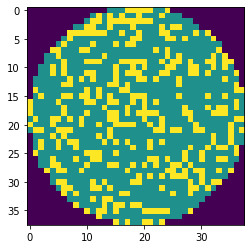

wafer_id:9314, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:113, nDefects:356, p=31.742


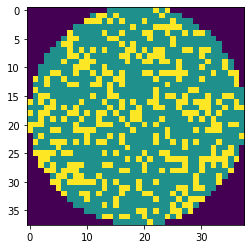

wafer_id:9314, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:111, nDefects:348, p=31.897


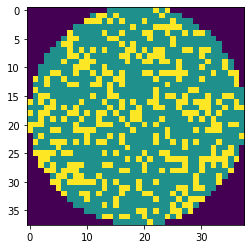

wafer_id:9314, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:111, nDefects:348, p=31.897


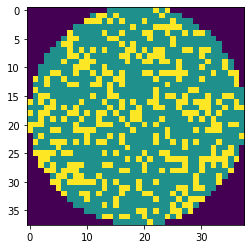

wafer_id:9314, ウエハサイズ:38x38, スタンプサイズ:2x3, oDefects:111, nDefects:335, p=33.134


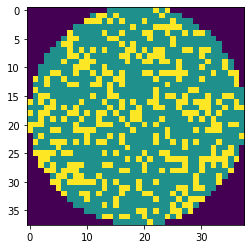

wafer_id:9314, ウエハサイズ:38x38, スタンプサイズ:3x3, oDefects:108, nDefects:327, p=33.028


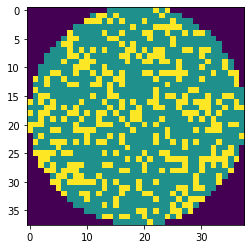

wafer_id:9314, ウエハサイズ:38x38, スタンプサイズ:4x3, oDefects:108, nDefects:327, p=33.028


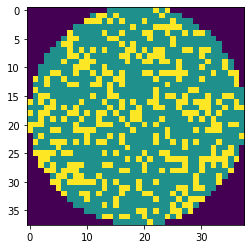

wafer_id:9314, ウエハサイズ:38x38, スタンプサイズ:2x4, oDefects:110, nDefects:327, p=33.639


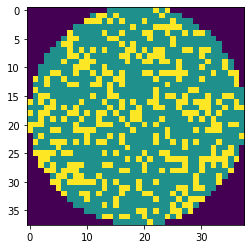

wafer_id:9314, ウエハサイズ:38x38, スタンプサイズ:3x4, oDefects:107, nDefects:319, p=33.542


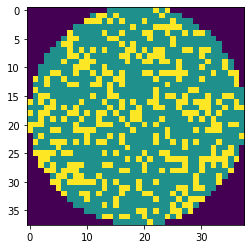

wafer_id:9314, ウエハサイズ:38x38, スタンプサイズ:4x4, oDefects:107, nDefects:319, p=33.542


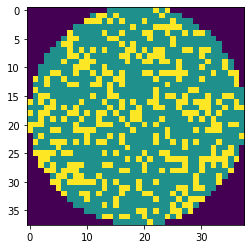

wafer_id:9315, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:117, nDefects:360, p=32.500


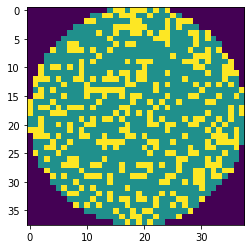

wafer_id:9315, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:114, nDefects:352, p=32.386


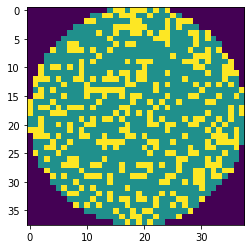

wafer_id:9315, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:114, nDefects:352, p=32.386


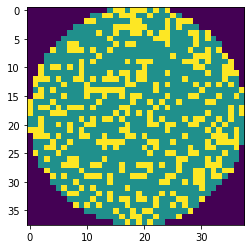

wafer_id:9315, ウエハサイズ:38x38, スタンプサイズ:2x4, oDefects:98, nDefects:325, p=30.154


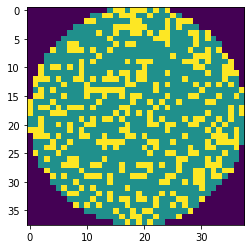

wafer_id:9316, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:95, nDefects:315, p=30.159


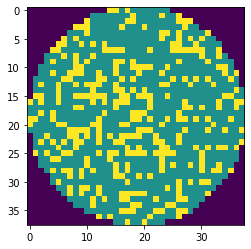

wafer_id:9316, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:94, nDefects:309, p=30.421


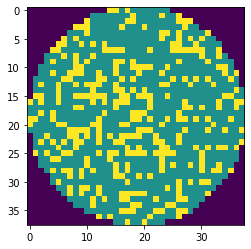

wafer_id:9316, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:94, nDefects:309, p=30.421


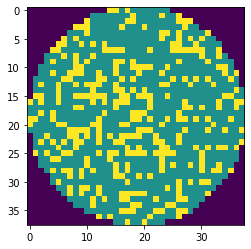

wafer_id:9317, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:106, nDefects:353, p=30.028


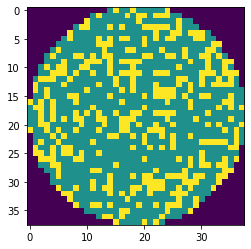

wafer_id:9317, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:104, nDefects:346, p=30.058


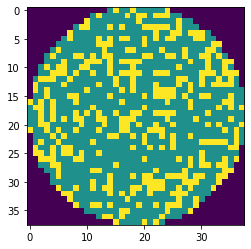

wafer_id:9317, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:104, nDefects:346, p=30.058


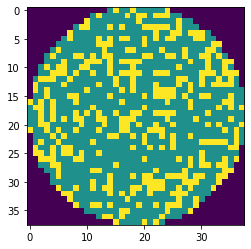

wafer_id:9317, ウエハサイズ:38x38, スタンプサイズ:2x3, oDefects:101, nDefects:322, p=31.366


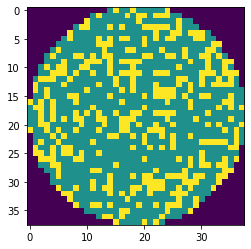

wafer_id:9317, ウエハサイズ:38x38, スタンプサイズ:3x3, oDefects:100, nDefects:315, p=31.746


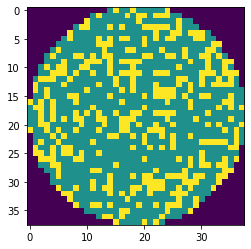

wafer_id:9317, ウエハサイズ:38x38, スタンプサイズ:4x3, oDefects:100, nDefects:315, p=31.746


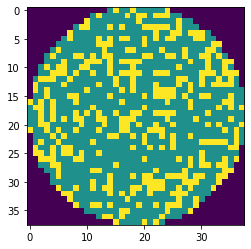

wafer_id:9317, ウエハサイズ:38x38, スタンプサイズ:2x4, oDefects:97, nDefects:316, p=30.696


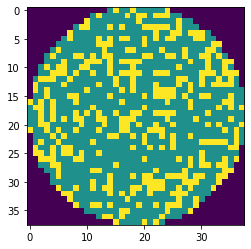

wafer_id:9317, ウエハサイズ:38x38, スタンプサイズ:3x4, oDefects:97, nDefects:309, p=31.392


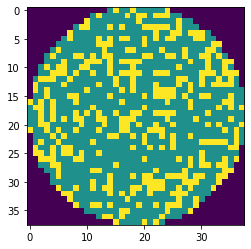

wafer_id:9317, ウエハサイズ:38x38, スタンプサイズ:4x4, oDefects:97, nDefects:309, p=31.392


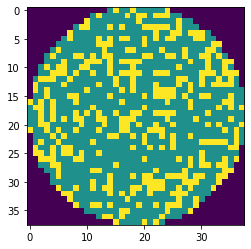

wafer_id:9318, ウエハサイズ:38x38, スタンプサイズ:2x3, oDefects:99, nDefects:314, p=31.529


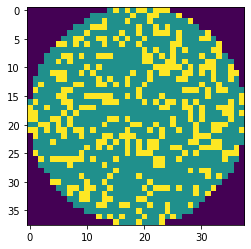

wafer_id:9318, ウエハサイズ:38x38, スタンプサイズ:3x3, oDefects:98, nDefects:305, p=32.131


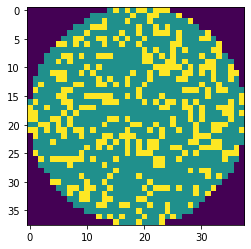

wafer_id:9318, ウエハサイズ:38x38, スタンプサイズ:4x3, oDefects:98, nDefects:305, p=32.131


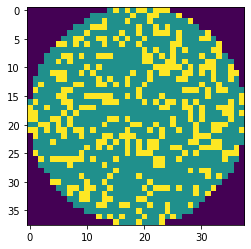

wafer_id:9319, ウエハサイズ:38x38, スタンプサイズ:2x4, oDefects:99, nDefects:329, p=30.091


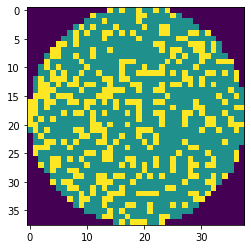

wafer_id:9319, ウエハサイズ:38x38, スタンプサイズ:3x4, oDefects:96, nDefects:319, p=30.094


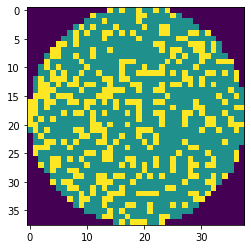

wafer_id:9319, ウエハサイズ:38x38, スタンプサイズ:4x4, oDefects:96, nDefects:319, p=30.094


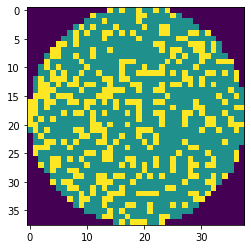

wafer_id:9321, ウエハサイズ:38x38, スタンプサイズ:2x3, oDefects:113, nDefects:343, p=32.945


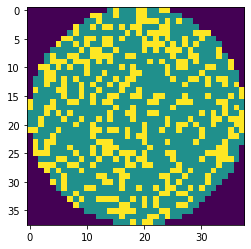

wafer_id:9321, ウエハサイズ:38x38, スタンプサイズ:3x3, oDefects:111, nDefects:336, p=33.036


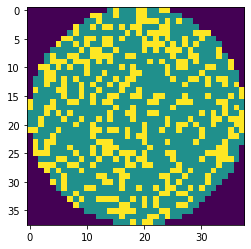

wafer_id:9321, ウエハサイズ:38x38, スタンプサイズ:4x3, oDefects:111, nDefects:336, p=33.036


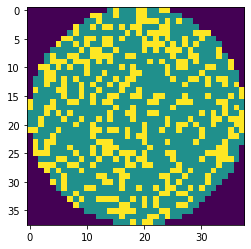

wafer_id:9321, ウエハサイズ:38x38, スタンプサイズ:2x4, oDefects:104, nDefects:337, p=30.861


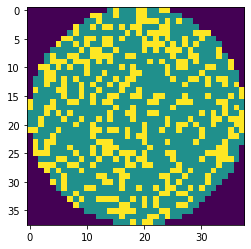

wafer_id:9321, ウエハサイズ:38x38, スタンプサイズ:3x4, oDefects:104, nDefects:330, p=31.515


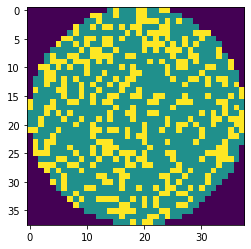

wafer_id:9321, ウエハサイズ:38x38, スタンプサイズ:4x4, oDefects:104, nDefects:330, p=31.515


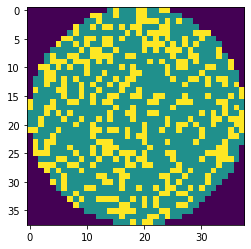

wafer_id:9322, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:113, nDefects:353, p=32.011


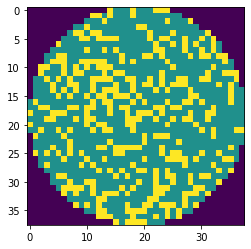

wafer_id:9322, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:107, nDefects:341, p=31.378


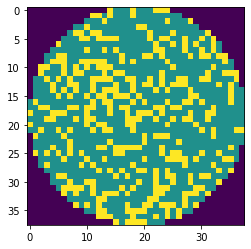

wafer_id:9322, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:107, nDefects:341, p=31.378


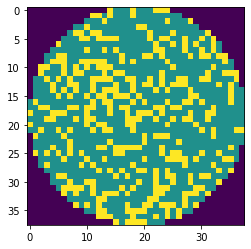

wafer_id:9322, ウエハサイズ:38x38, スタンプサイズ:2x4, oDefects:99, nDefects:327, p=30.275


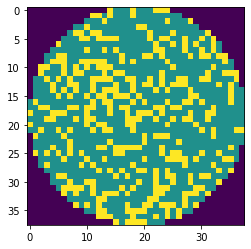

wafer_id:9322, ウエハサイズ:38x38, スタンプサイズ:3x4, oDefects:95, nDefects:315, p=30.159


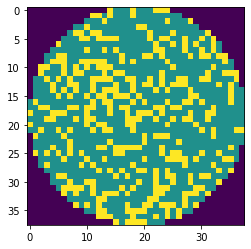

wafer_id:9322, ウエハサイズ:38x38, スタンプサイズ:4x4, oDefects:95, nDefects:315, p=30.159


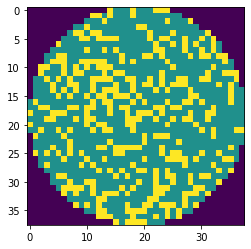

wafer_id:9324, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:118, nDefects:368, p=32.065


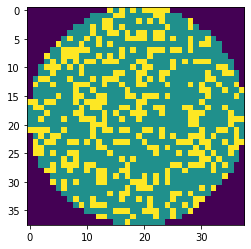

wafer_id:9324, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:118, nDefects:362, p=32.597


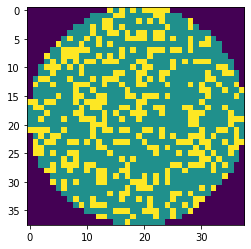

wafer_id:9324, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:118, nDefects:362, p=32.597


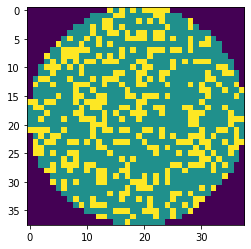

wafer_id:9324, ウエハサイズ:38x38, スタンプサイズ:2x3, oDefects:115, nDefects:350, p=32.857


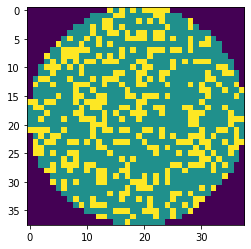

wafer_id:9324, ウエハサイズ:38x38, スタンプサイズ:3x3, oDefects:114, nDefects:344, p=33.140


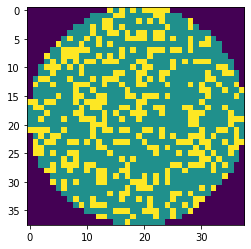

wafer_id:9324, ウエハサイズ:38x38, スタンプサイズ:4x3, oDefects:114, nDefects:344, p=33.140


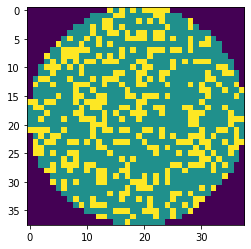

wafer_id:9324, ウエハサイズ:38x38, スタンプサイズ:2x4, oDefects:110, nDefects:344, p=31.977


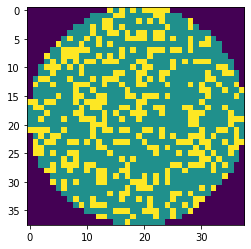

wafer_id:9324, ウエハサイズ:38x38, スタンプサイズ:3x4, oDefects:109, nDefects:338, p=32.249


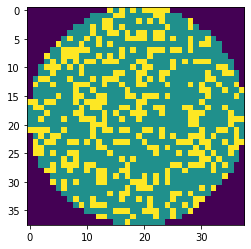

wafer_id:9324, ウエハサイズ:38x38, スタンプサイズ:4x4, oDefects:109, nDefects:338, p=32.249


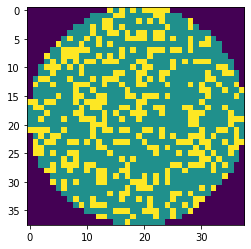

wafer_id:9326, ウエハサイズ:38x38, スタンプサイズ:2x3, oDefects:117, nDefects:340, p=34.412


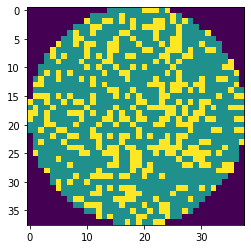

wafer_id:9326, ウエハサイズ:38x38, スタンプサイズ:2x4, oDefects:115, nDefects:335, p=34.328


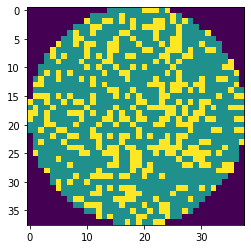

wafer_id:9326, ウエハサイズ:38x38, スタンプサイズ:3x4, oDefects:113, nDefects:326, p=34.663


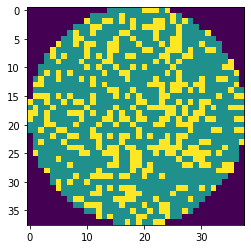

wafer_id:9326, ウエハサイズ:38x38, スタンプサイズ:4x4, oDefects:113, nDefects:326, p=34.663


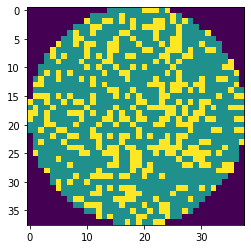

wafer_id:9328, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:138, nDefects:405, p=34.074


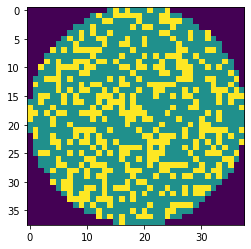

wafer_id:9328, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:135, nDefects:397, p=34.005


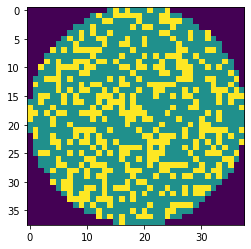

wafer_id:9328, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:135, nDefects:397, p=34.005


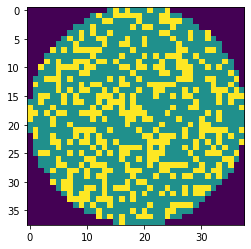

wafer_id:9328, ウエハサイズ:38x38, スタンプサイズ:2x4, oDefects:129, nDefects:372, p=34.677


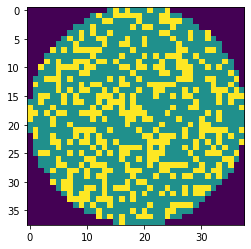

wafer_id:9328, ウエハサイズ:38x38, スタンプサイズ:3x4, oDefects:126, nDefects:364, p=34.615


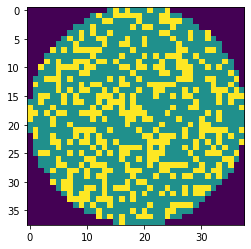

wafer_id:9328, ウエハサイズ:38x38, スタンプサイズ:4x4, oDefects:126, nDefects:364, p=34.615


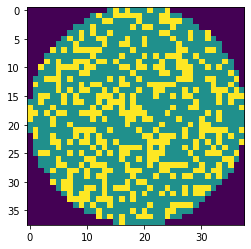

wafer_id:9329, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:124, nDefects:393, p=31.552


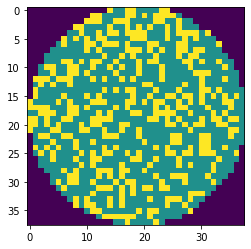

wafer_id:9329, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:120, nDefects:384, p=31.250


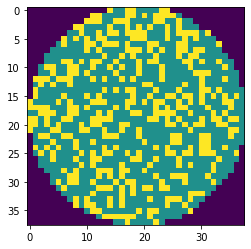

wafer_id:9329, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:120, nDefects:384, p=31.250


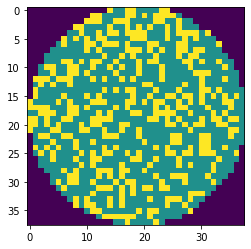

wafer_id:9329, ウエハサイズ:38x38, スタンプサイズ:2x4, oDefects:124, nDefects:368, p=33.696


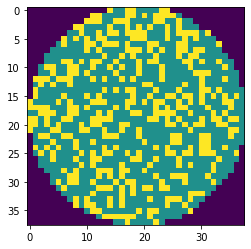

wafer_id:9329, ウエハサイズ:38x38, スタンプサイズ:3x4, oDefects:121, nDefects:359, p=33.705


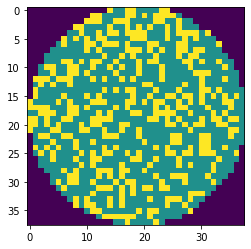

wafer_id:9329, ウエハサイズ:38x38, スタンプサイズ:4x4, oDefects:121, nDefects:359, p=33.705


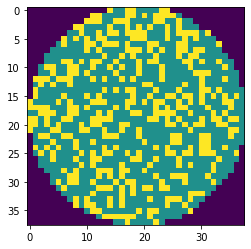

wafer_id:9330, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:123, nDefects:381, p=32.283


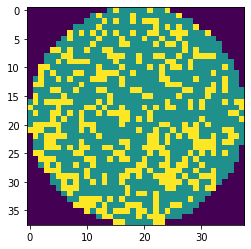

wafer_id:9330, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:121, nDefects:371, p=32.615


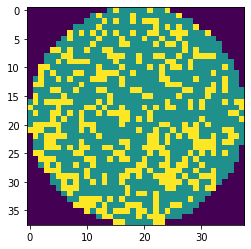

wafer_id:9330, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:121, nDefects:371, p=32.615


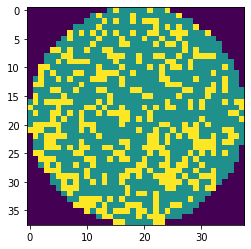

wafer_id:9330, ウエハサイズ:38x38, スタンプサイズ:2x3, oDefects:116, nDefects:369, p=31.436


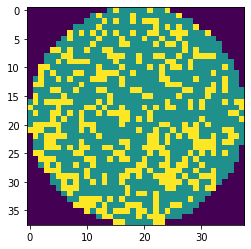

wafer_id:9330, ウエハサイズ:38x38, スタンプサイズ:3x3, oDefects:115, nDefects:359, p=32.033


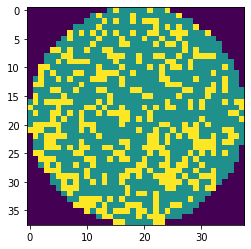

wafer_id:9330, ウエハサイズ:38x38, スタンプサイズ:4x3, oDefects:115, nDefects:359, p=32.033


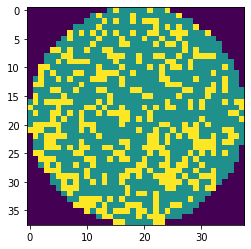

wafer_id:9813, ウエハサイズ:38x38, スタンプサイズ:2x3, oDefects:96, nDefects:317, p=30.284


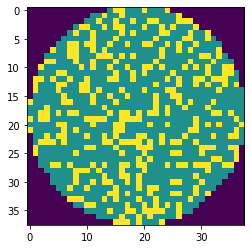

wafer_id:9813, ウエハサイズ:38x38, スタンプサイズ:3x3, oDefects:94, nDefects:308, p=30.519


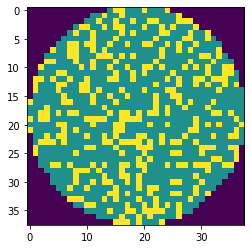

wafer_id:9813, ウエハサイズ:38x38, スタンプサイズ:4x3, oDefects:94, nDefects:308, p=30.519


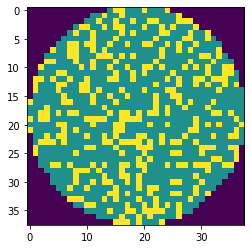

wafer_id:9813, ウエハサイズ:38x38, スタンプサイズ:2x4, oDefects:97, nDefects:310, p=31.290


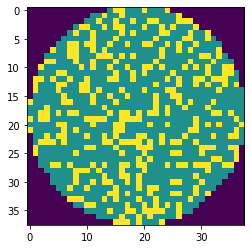

wafer_id:9813, ウエハサイズ:38x38, スタンプサイズ:3x4, oDefects:95, nDefects:301, p=31.561


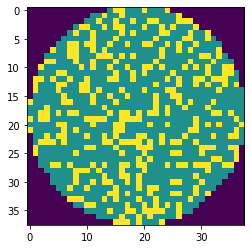

wafer_id:9813, ウエハサイズ:38x38, スタンプサイズ:4x4, oDefects:95, nDefects:301, p=31.561


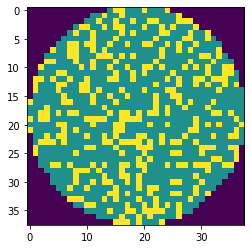

wafer_id:9814, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:113, nDefects:358, p=31.564


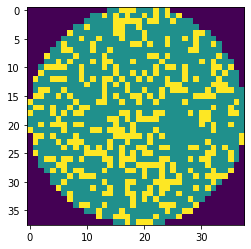

wafer_id:9814, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:110, nDefects:348, p=31.609


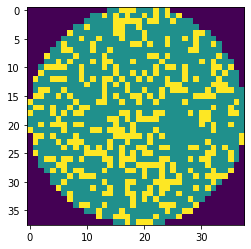

wafer_id:9814, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:110, nDefects:348, p=31.609


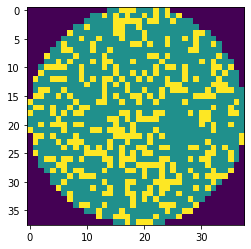

wafer_id:9814, ウエハサイズ:38x38, スタンプサイズ:2x3, oDefects:108, nDefects:339, p=31.858


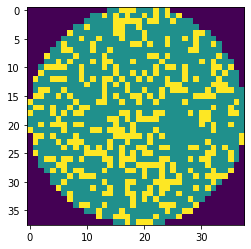

wafer_id:9814, ウエハサイズ:38x38, スタンプサイズ:3x3, oDefects:106, nDefects:329, p=32.219


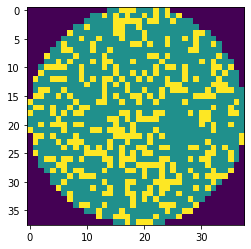

wafer_id:9814, ウエハサイズ:38x38, スタンプサイズ:4x3, oDefects:106, nDefects:329, p=32.219


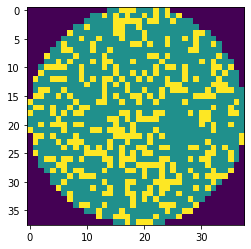

wafer_id:9815, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:118, nDefects:362, p=32.597


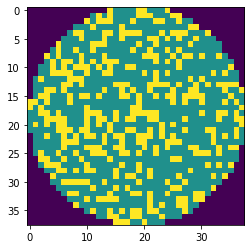

wafer_id:9815, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:117, nDefects:353, p=33.144


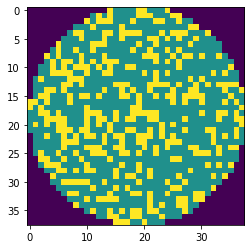

wafer_id:9815, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:117, nDefects:353, p=33.144


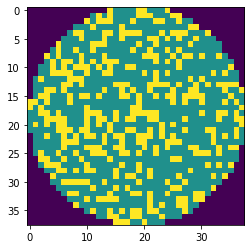

wafer_id:9816, ウエハサイズ:38x38, スタンプサイズ:2x3, oDefects:102, nDefects:324, p=31.481


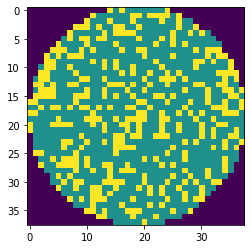

wafer_id:9816, ウエハサイズ:38x38, スタンプサイズ:3x3, oDefects:102, nDefects:319, p=31.975


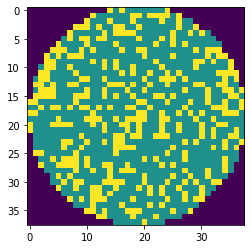

wafer_id:9816, ウエハサイズ:38x38, スタンプサイズ:4x3, oDefects:102, nDefects:319, p=31.975


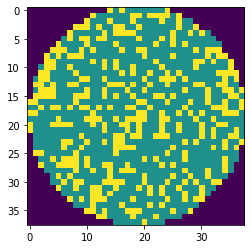

wafer_id:9817, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:110, nDefects:343, p=32.070


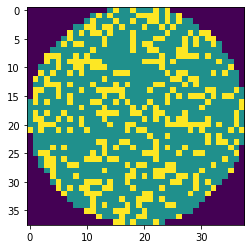

wafer_id:9817, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:109, nDefects:334, p=32.635


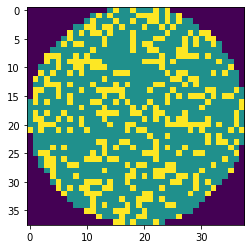

wafer_id:9817, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:109, nDefects:334, p=32.635


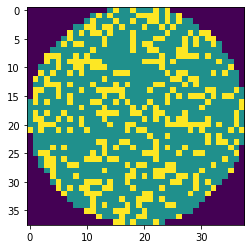

wafer_id:9817, ウエハサイズ:38x38, スタンプサイズ:2x4, oDefects:97, nDefects:323, p=30.031


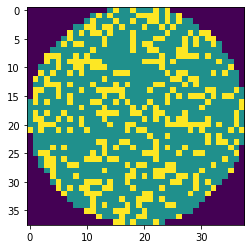

wafer_id:9819, ウエハサイズ:38x38, スタンプサイズ:2x3, oDefects:102, nDefects:340, p=30.000


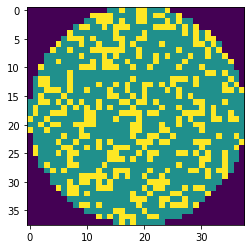

wafer_id:9819, ウエハサイズ:38x38, スタンプサイズ:3x3, oDefects:100, nDefects:331, p=30.211


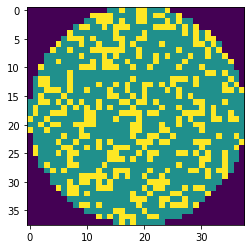

wafer_id:9819, ウエハサイズ:38x38, スタンプサイズ:4x3, oDefects:100, nDefects:331, p=30.211


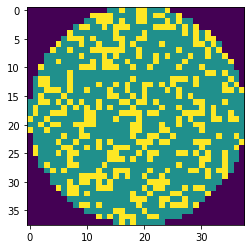

wafer_id:9819, ウエハサイズ:38x38, スタンプサイズ:2x4, oDefects:105, nDefects:334, p=31.437


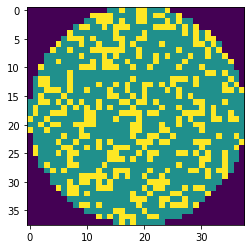

wafer_id:9819, ウエハサイズ:38x38, スタンプサイズ:3x4, oDefects:101, nDefects:325, p=31.077


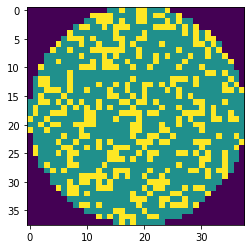

wafer_id:9819, ウエハサイズ:38x38, スタンプサイズ:4x4, oDefects:101, nDefects:325, p=31.077


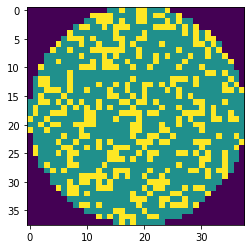

wafer_id:9820, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:110, nDefects:356, p=30.899


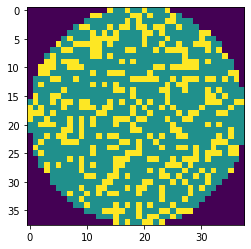

wafer_id:9820, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:107, nDefects:346, p=30.925


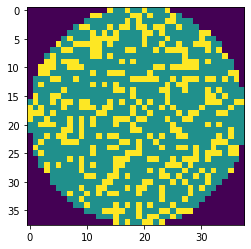

wafer_id:9820, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:107, nDefects:346, p=30.925


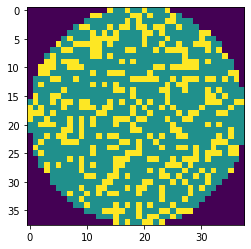

wafer_id:9820, ウエハサイズ:38x38, スタンプサイズ:2x3, oDefects:101, nDefects:336, p=30.060


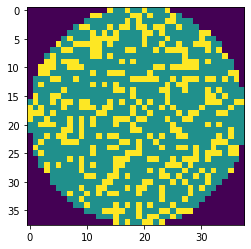

wafer_id:9821, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:110, nDefects:360, p=30.556


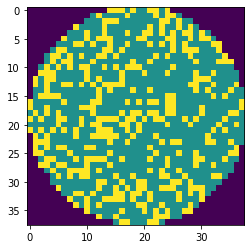

wafer_id:9821, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:109, nDefects:351, p=31.054


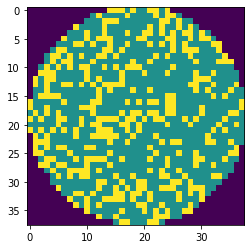

wafer_id:9821, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:109, nDefects:351, p=31.054


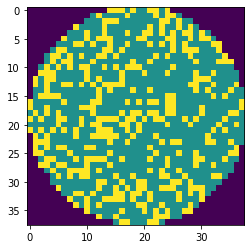

wafer_id:9822, ウエハサイズ:38x38, スタンプサイズ:2x4, oDefects:100, nDefects:318, p=31.447


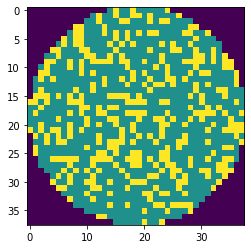

wafer_id:9822, ウエハサイズ:38x38, スタンプサイズ:3x4, oDefects:100, nDefects:314, p=31.847


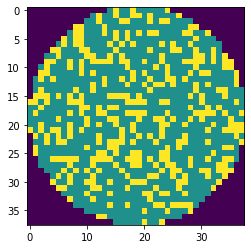

wafer_id:9822, ウエハサイズ:38x38, スタンプサイズ:4x4, oDefects:100, nDefects:314, p=31.847


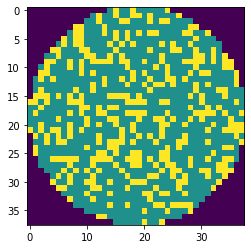

wafer_id:9824, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:112, nDefects:358, p=31.285


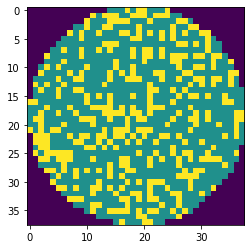

wafer_id:9824, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:112, nDefects:352, p=31.818


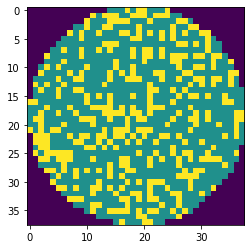

wafer_id:9824, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:112, nDefects:352, p=31.818


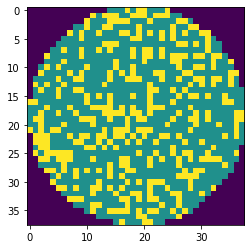

wafer_id:9824, ウエハサイズ:38x38, スタンプサイズ:2x3, oDefects:108, nDefects:345, p=31.304


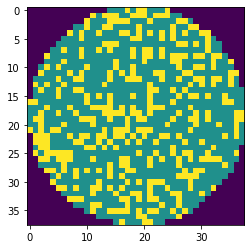

wafer_id:9824, ウエハサイズ:38x38, スタンプサイズ:3x3, oDefects:108, nDefects:339, p=31.858


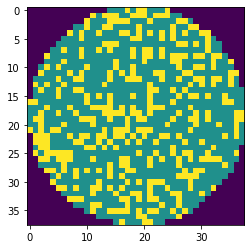

wafer_id:9824, ウエハサイズ:38x38, スタンプサイズ:4x3, oDefects:108, nDefects:339, p=31.858


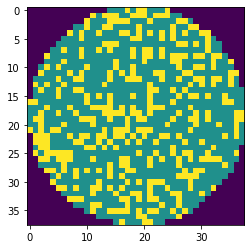

wafer_id:9825, ウエハサイズ:38x38, スタンプサイズ:2x4, oDefects:98, nDefects:318, p=30.818


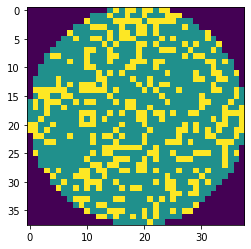

wafer_id:9825, ウエハサイズ:38x38, スタンプサイズ:3x4, oDefects:97, nDefects:311, p=31.190


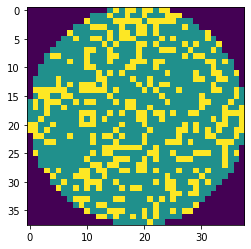

wafer_id:9825, ウエハサイズ:38x38, スタンプサイズ:4x4, oDefects:97, nDefects:311, p=31.190


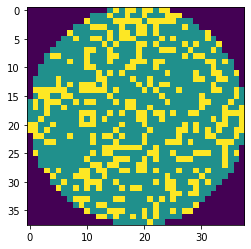

wafer_id:9826, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:103, nDefects:334, p=30.838


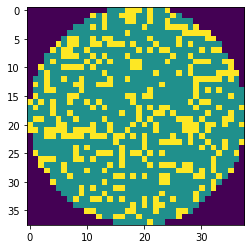

wafer_id:9826, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:103, nDefects:328, p=31.402


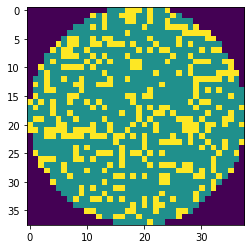

wafer_id:9826, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:103, nDefects:328, p=31.402


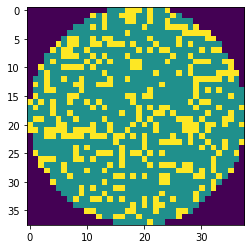

wafer_id:9826, ウエハサイズ:38x38, スタンプサイズ:2x3, oDefects:94, nDefects:313, p=30.032


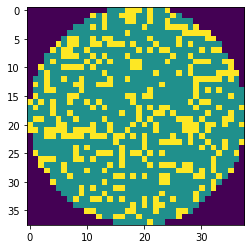

wafer_id:9826, ウエハサイズ:38x38, スタンプサイズ:2x4, oDefects:93, nDefects:303, p=30.693


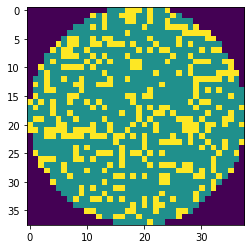

wafer_id:9826, ウエハサイズ:38x38, スタンプサイズ:3x4, oDefects:91, nDefects:297, p=30.640


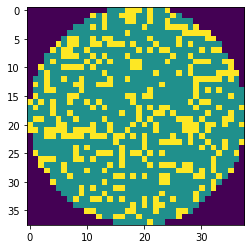

wafer_id:9826, ウエハサイズ:38x38, スタンプサイズ:4x4, oDefects:91, nDefects:297, p=30.640


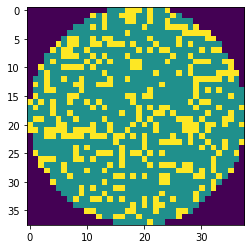

wafer_id:9827, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:102, nDefects:327, p=31.193


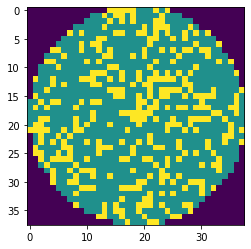

wafer_id:9827, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:102, nDefects:318, p=32.075


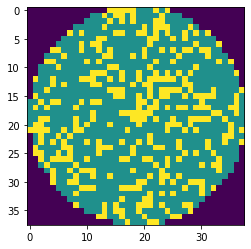

wafer_id:9827, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:102, nDefects:318, p=32.075


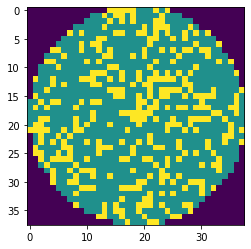

wafer_id:9830, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:104, nDefects:344, p=30.233


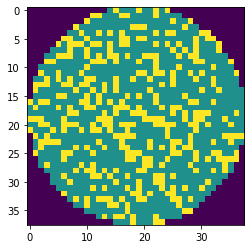

wafer_id:9830, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:102, nDefects:336, p=30.357


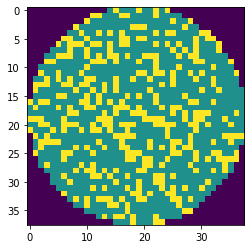

wafer_id:9830, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:102, nDefects:336, p=30.357


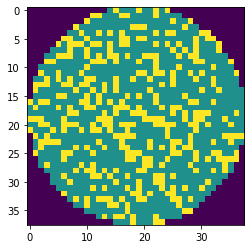

wafer_id:9832, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:107, nDefects:340, p=31.471


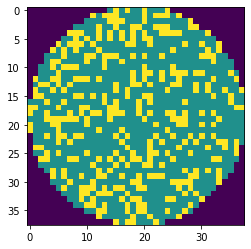

wafer_id:9832, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:106, nDefects:332, p=31.928


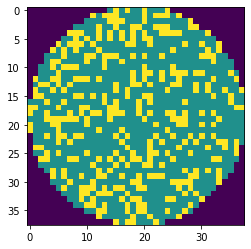

wafer_id:9832, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:106, nDefects:332, p=31.928


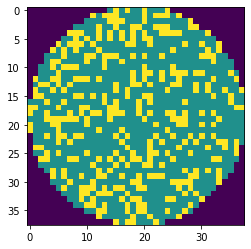

wafer_id:9832, ウエハサイズ:38x38, スタンプサイズ:2x4, oDefects:96, nDefects:318, p=30.189


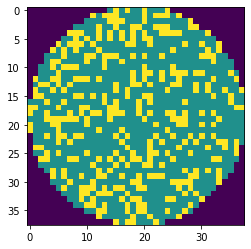

wafer_id:9832, ウエハサイズ:38x38, スタンプサイズ:3x4, oDefects:95, nDefects:310, p=30.645


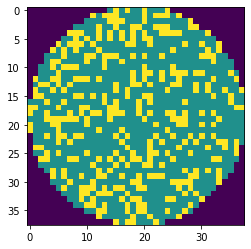

wafer_id:9832, ウエハサイズ:38x38, スタンプサイズ:4x4, oDefects:95, nDefects:310, p=30.645


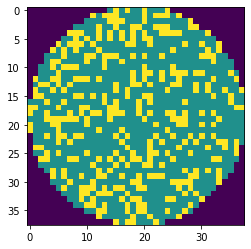

wafer_id:9841, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:99, nDefects:329, p=30.091


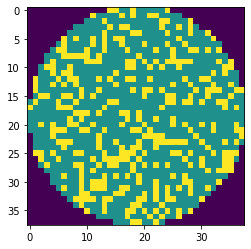

wafer_id:9841, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:99, nDefects:329, p=30.091


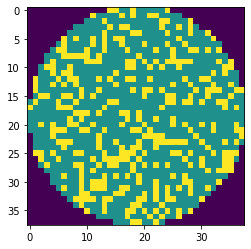

wafer_id:9841, ウエハサイズ:38x38, スタンプサイズ:2x3, oDefects:94, nDefects:313, p=30.032


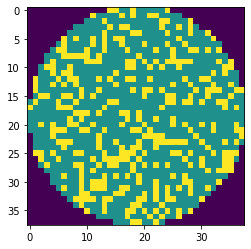

wafer_id:9841, ウエハサイズ:38x38, スタンプサイズ:3x3, oDefects:92, nDefects:306, p=30.065


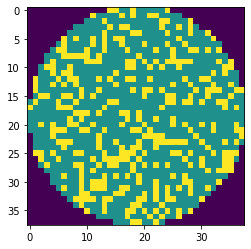

wafer_id:9841, ウエハサイズ:38x38, スタンプサイズ:4x3, oDefects:92, nDefects:306, p=30.065


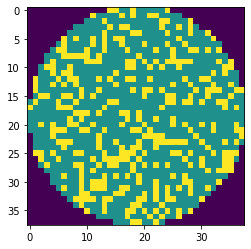

wafer_id:9841, ウエハサイズ:38x38, スタンプサイズ:2x4, oDefects:93, nDefects:306, p=30.392


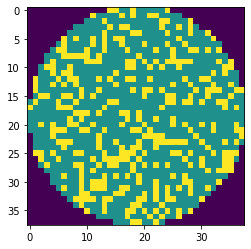

wafer_id:9841, ウエハサイズ:38x38, スタンプサイズ:3x4, oDefects:91, nDefects:299, p=30.435


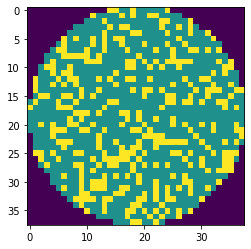

wafer_id:9841, ウエハサイズ:38x38, スタンプサイズ:4x4, oDefects:91, nDefects:299, p=30.435


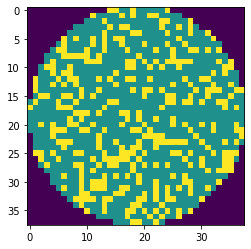

wafer_id:9842, ウエハサイズ:38x38, スタンプサイズ:3x3, oDefects:94, nDefects:309, p=30.421


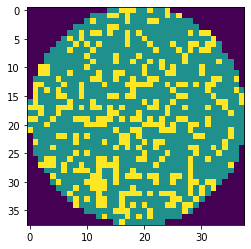

wafer_id:9842, ウエハサイズ:38x38, スタンプサイズ:4x3, oDefects:94, nDefects:309, p=30.421


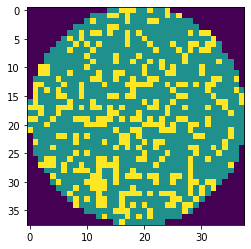

wafer_id:9842, ウエハサイズ:38x38, スタンプサイズ:2x4, oDefects:94, nDefects:306, p=30.719


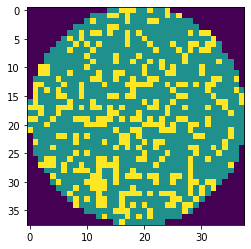

wafer_id:9842, ウエハサイズ:38x38, スタンプサイズ:3x4, oDefects:92, nDefects:301, p=30.565


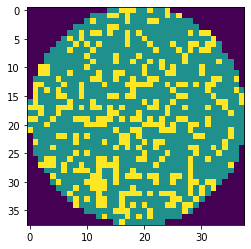

wafer_id:9842, ウエハサイズ:38x38, スタンプサイズ:4x4, oDefects:92, nDefects:301, p=30.565


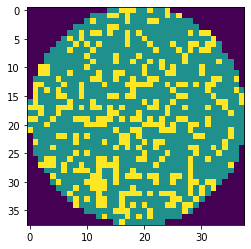

wafer_id:9849, ウエハサイズ:38x38, スタンプサイズ:2x3, oDefects:114, nDefects:327, p=34.862


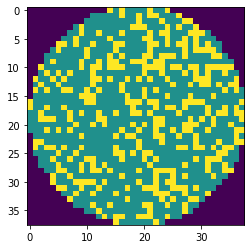

wafer_id:9849, ウエハサイズ:38x38, スタンプサイズ:3x3, oDefects:111, nDefects:318, p=34.906


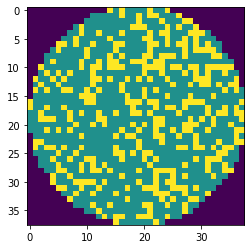

wafer_id:9849, ウエハサイズ:38x38, スタンプサイズ:4x3, oDefects:111, nDefects:318, p=34.906


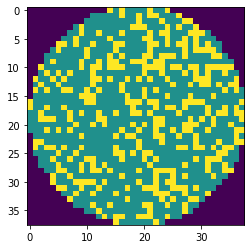

wafer_id:9850, ウエハサイズ:38x38, スタンプサイズ:2x4, oDefects:96, nDefects:299, p=32.107


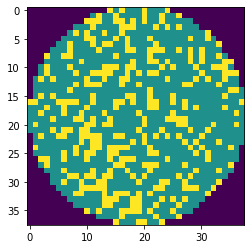

wafer_id:9850, ウエハサイズ:38x38, スタンプサイズ:3x4, oDefects:93, nDefects:292, p=31.849


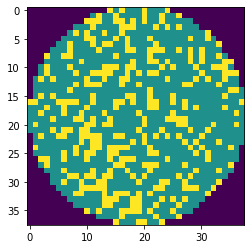

wafer_id:9850, ウエハサイズ:38x38, スタンプサイズ:4x4, oDefects:93, nDefects:292, p=31.849


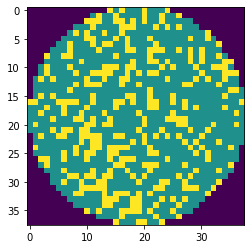

wafer_id:9851, ウエハサイズ:38x38, スタンプサイズ:2x3, oDefects:101, nDefects:331, p=30.514


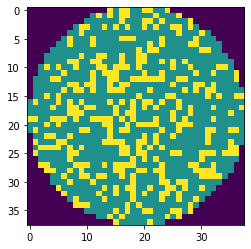

wafer_id:9851, ウエハサイズ:38x38, スタンプサイズ:3x3, oDefects:101, nDefects:325, p=31.077


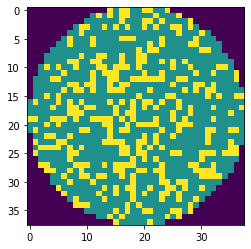

wafer_id:9851, ウエハサイズ:38x38, スタンプサイズ:4x3, oDefects:101, nDefects:325, p=31.077


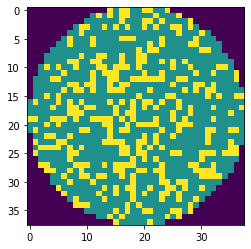

wafer_id:9881, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:93, nDefects:303, p=30.693


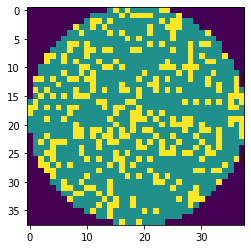

wafer_id:9881, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:93, nDefects:300, p=31.000


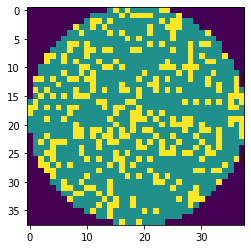

wafer_id:9881, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:93, nDefects:300, p=31.000


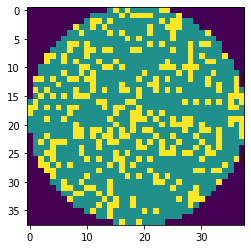

wafer_id:9883, ウエハサイズ:38x38, スタンプサイズ:2x3, oDefects:94, nDefects:298, p=31.544


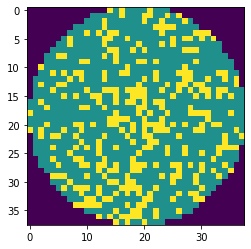

wafer_id:9883, ウエハサイズ:38x38, スタンプサイズ:3x3, oDefects:90, nDefects:288, p=31.250


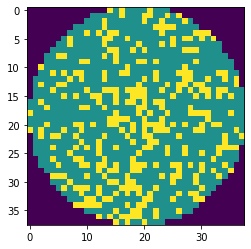

wafer_id:9883, ウエハサイズ:38x38, スタンプサイズ:4x3, oDefects:90, nDefects:288, p=31.250


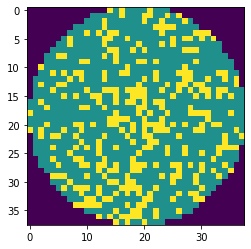

(47, 52)
wafer_id:10944, ウエハサイズ:25x26, スタンプサイズ:2x4, oDefects:26, nDefects:85, p=30.588


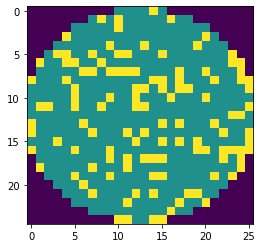

wafer_id:10944, ウエハサイズ:25x26, スタンプサイズ:3x4, oDefects:26, nDefects:85, p=30.588


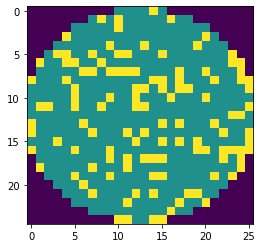

wafer_id:10944, ウエハサイズ:25x26, スタンプサイズ:4x4, oDefects:26, nDefects:85, p=30.588


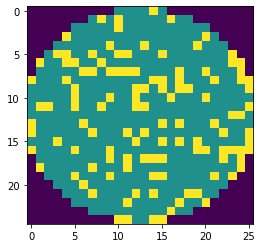

(61, 60)
wafer_id:11028, ウエハサイズ:41x42, スタンプサイズ:2x2, oDefects:48, nDefects:160, p=30.000


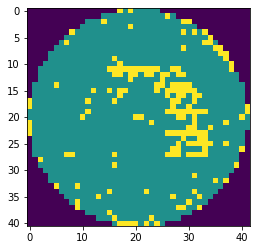

wafer_id:11028, ウエハサイズ:41x42, スタンプサイズ:3x2, oDefects:48, nDefects:158, p=30.380


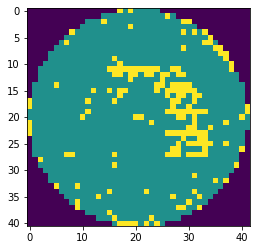

wafer_id:11028, ウエハサイズ:41x42, スタンプサイズ:4x2, oDefects:48, nDefects:160, p=30.000


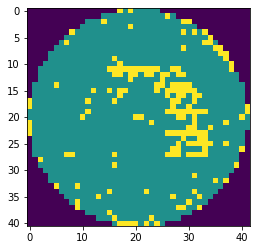

wafer_id:11028, ウエハサイズ:41x42, スタンプサイズ:2x3, oDefects:51, nDefects:159, p=32.075


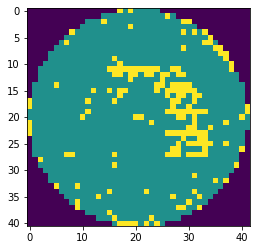

wafer_id:11028, ウエハサイズ:41x42, スタンプサイズ:3x3, oDefects:51, nDefects:157, p=32.484


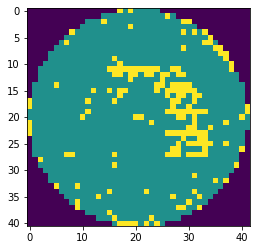

wafer_id:11028, ウエハサイズ:41x42, スタンプサイズ:4x3, oDefects:51, nDefects:159, p=32.075


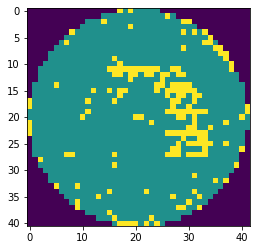

wafer_id:11035, ウエハサイズ:35x40, スタンプサイズ:2x2, oDefects:66, nDefects:218, p=30.275


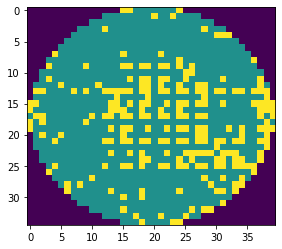

wafer_id:11035, ウエハサイズ:35x40, スタンプサイズ:3x2, oDefects:66, nDefects:215, p=30.698


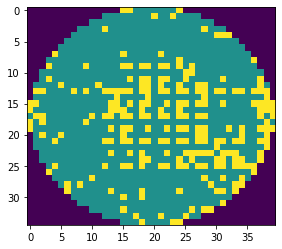

wafer_id:11035, ウエハサイズ:35x40, スタンプサイズ:4x2, oDefects:65, nDefects:211, p=30.806


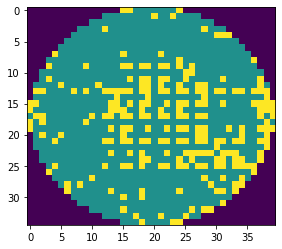

wafer_id:11035, ウエハサイズ:35x40, スタンプサイズ:2x4, oDefects:61, nDefects:203, p=30.049


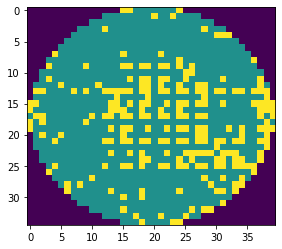

wafer_id:11035, ウエハサイズ:35x40, スタンプサイズ:4x4, oDefects:59, nDefects:196, p=30.102


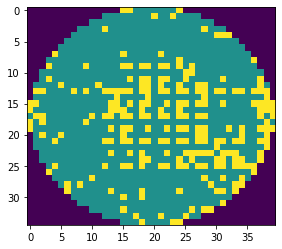

wafer_id:11190, ウエハサイズ:26x26, スタンプサイズ:2x2, oDefects:56, nDefects:170, p=32.941


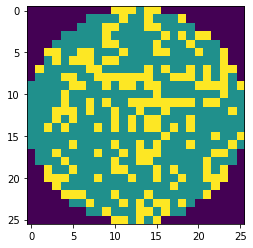

wafer_id:11190, ウエハサイズ:26x26, スタンプサイズ:3x2, oDefects:53, nDefects:162, p=32.716


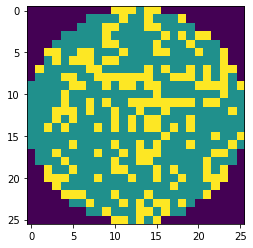

wafer_id:11190, ウエハサイズ:26x26, スタンプサイズ:4x2, oDefects:53, nDefects:162, p=32.716


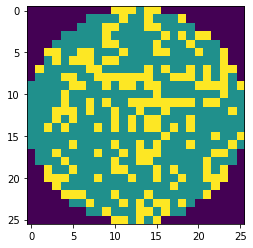

wafer_id:11190, ウエハサイズ:26x26, スタンプサイズ:2x3, oDefects:50, nDefects:146, p=34.247


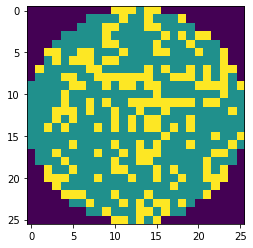

wafer_id:11190, ウエハサイズ:26x26, スタンプサイズ:3x3, oDefects:48, nDefects:138, p=34.783


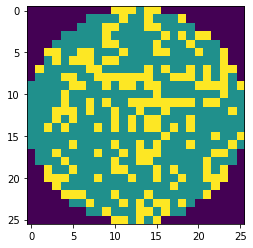

wafer_id:11190, ウエハサイズ:26x26, スタンプサイズ:4x3, oDefects:48, nDefects:138, p=34.783


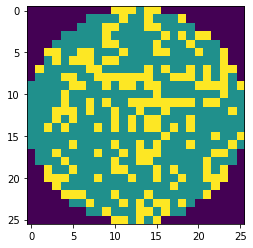

wafer_id:11215, ウエハサイズ:26x26, スタンプサイズ:2x4, oDefects:34, nDefects:111, p=30.631


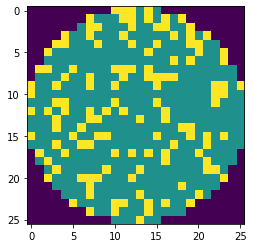

wafer_id:11215, ウエハサイズ:26x26, スタンプサイズ:3x4, oDefects:33, nDefects:107, p=30.841


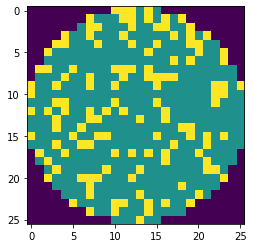

wafer_id:11215, ウエハサイズ:26x26, スタンプサイズ:4x4, oDefects:33, nDefects:107, p=30.841


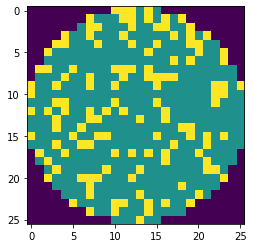

wafer_id:11344, ウエハサイズ:26x26, スタンプサイズ:2x4, oDefects:35, nDefects:105, p=33.333


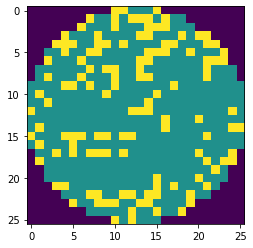

wafer_id:11758, ウエハサイズ:26x26, スタンプサイズ:2x4, oDefects:23, nDefects:74, p=31.081


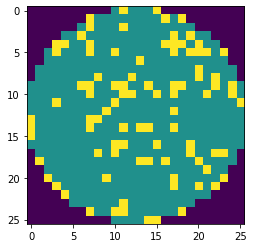

wafer_id:11758, ウエハサイズ:26x26, スタンプサイズ:3x4, oDefects:22, nDefects:68, p=32.353


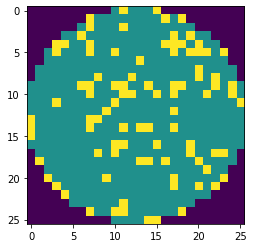

wafer_id:11758, ウエハサイズ:26x26, スタンプサイズ:4x4, oDefects:22, nDefects:68, p=32.353


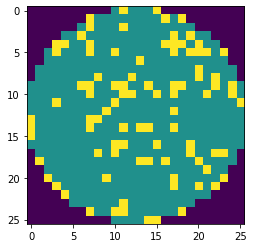

wafer_id:11833, ウエハサイズ:26x26, スタンプサイズ:2x3, oDefects:20, nDefects:63, p=31.746


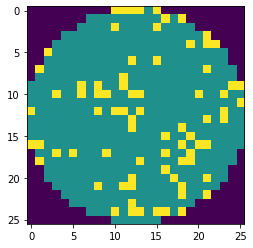

wafer_id:11902, ウエハサイズ:26x26, スタンプサイズ:3x3, oDefects:24, nDefects:80, p=30.000


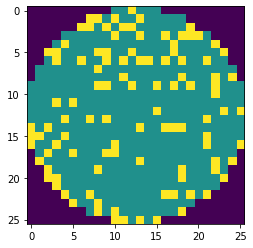

wafer_id:11902, ウエハサイズ:26x26, スタンプサイズ:4x3, oDefects:24, nDefects:80, p=30.000


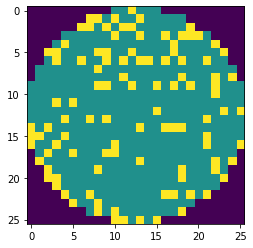

(26, 26)
wafer_id:12104, ウエハサイズ:26x26, スタンプサイズ:2x4, oDefects:41, nDefects:136, p=30.147


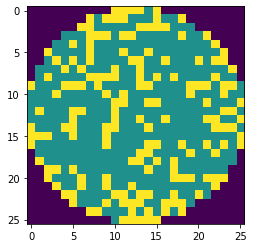

wafer_id:12108, ウエハサイズ:26x26, スタンプサイズ:3x4, oDefects:36, nDefects:118, p=30.508


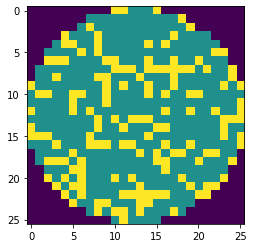

wafer_id:12108, ウエハサイズ:26x26, スタンプサイズ:4x4, oDefects:36, nDefects:118, p=30.508


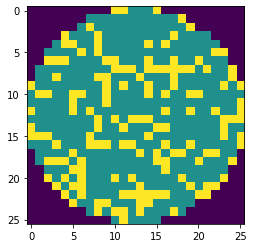

wafer_id:12443, ウエハサイズ:26x26, スタンプサイズ:2x4, oDefects:42, nDefects:134, p=31.343


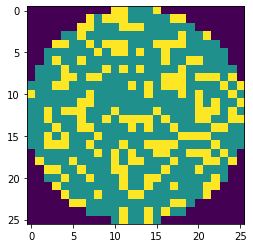

wafer_id:12443, ウエハサイズ:26x26, スタンプサイズ:3x4, oDefects:42, nDefects:129, p=32.558


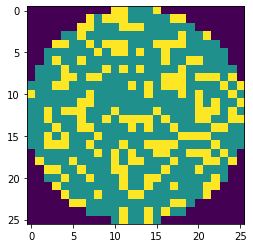

wafer_id:12443, ウエハサイズ:26x26, スタンプサイズ:4x4, oDefects:42, nDefects:129, p=32.558


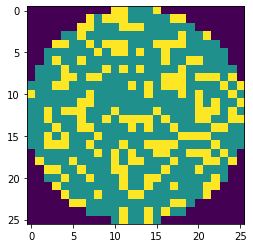

wafer_id:12518, ウエハサイズ:26x26, スタンプサイズ:3x3, oDefects:37, nDefects:123, p=30.081


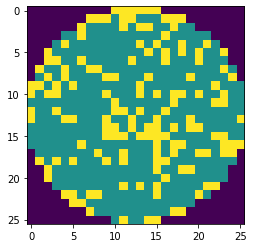

wafer_id:12518, ウエハサイズ:26x26, スタンプサイズ:4x3, oDefects:37, nDefects:123, p=30.081


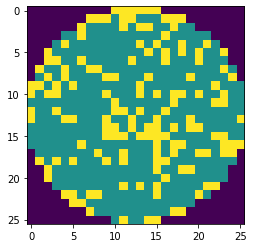

wafer_id:12597, ウエハサイズ:26x26, スタンプサイズ:2x4, oDefects:44, nDefects:136, p=32.353


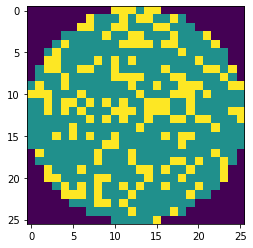

wafer_id:12597, ウエハサイズ:26x26, スタンプサイズ:3x4, oDefects:44, nDefects:133, p=33.083


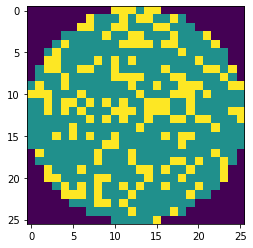

wafer_id:12597, ウエハサイズ:26x26, スタンプサイズ:4x4, oDefects:44, nDefects:133, p=33.083


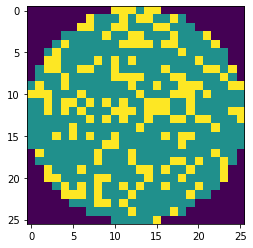

wafer_id:12619, ウエハサイズ:26x26, スタンプサイズ:2x2, oDefects:56, nDefects:164, p=34.146


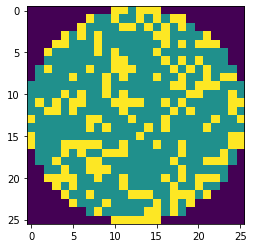

wafer_id:12619, ウエハサイズ:26x26, スタンプサイズ:3x2, oDefects:51, nDefects:154, p=33.117


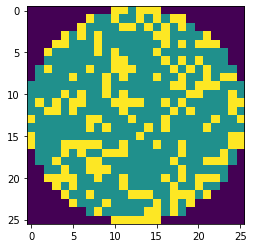

wafer_id:12619, ウエハサイズ:26x26, スタンプサイズ:4x2, oDefects:51, nDefects:154, p=33.117


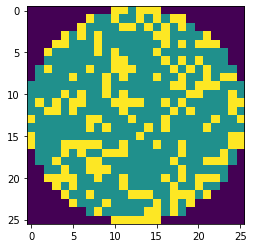

wafer_id:12719, ウエハサイズ:26x26, スタンプサイズ:2x4, oDefects:42, nDefects:139, p=30.216


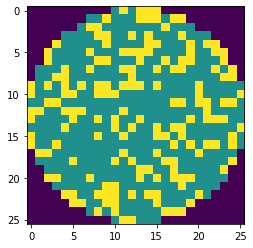

wafer_id:12719, ウエハサイズ:26x26, スタンプサイズ:3x4, oDefects:42, nDefects:132, p=31.818


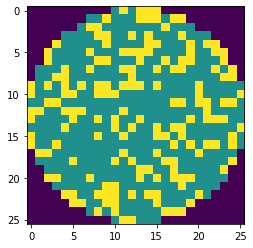

wafer_id:12719, ウエハサイズ:26x26, スタンプサイズ:4x4, oDefects:42, nDefects:132, p=31.818


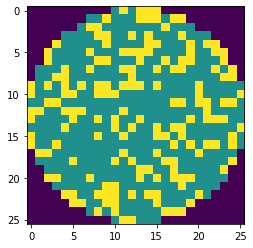

wafer_id:12907, ウエハサイズ:26x26, スタンプサイズ:2x2, oDefects:41, nDefects:133, p=30.827


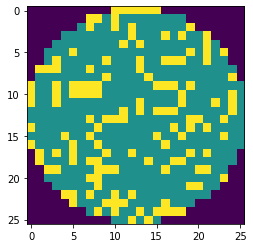

wafer_id:12999, ウエハサイズ:26x26, スタンプサイズ:2x2, oDefects:41, nDefects:134, p=30.597


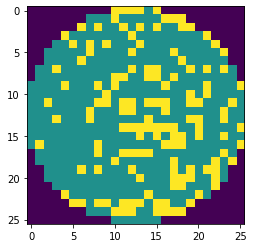

wafer_id:12999, ウエハサイズ:26x26, スタンプサイズ:2x4, oDefects:38, nDefects:113, p=33.628


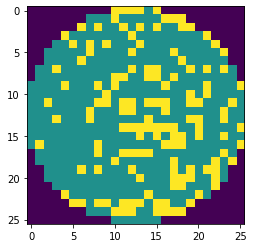

wafer_id:12999, ウエハサイズ:26x26, スタンプサイズ:3x4, oDefects:36, nDefects:106, p=33.962


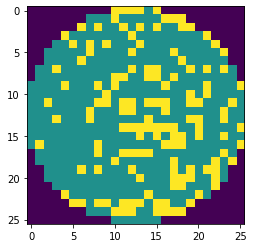

wafer_id:12999, ウエハサイズ:26x26, スタンプサイズ:4x4, oDefects:36, nDefects:106, p=33.962


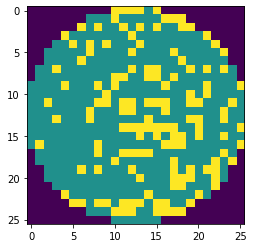

(26, 26)
wafer_id:13107, ウエハサイズ:26x26, スタンプサイズ:2x2, oDefects:42, nDefects:128, p=32.812


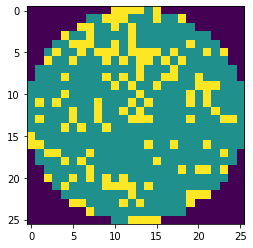

wafer_id:13107, ウエハサイズ:26x26, スタンプサイズ:3x2, oDefects:40, nDefects:123, p=32.520


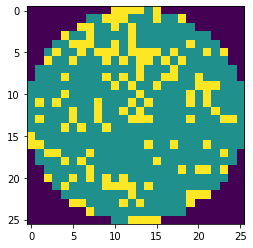

wafer_id:13107, ウエハサイズ:26x26, スタンプサイズ:4x2, oDefects:40, nDefects:123, p=32.520


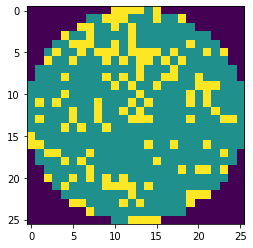

wafer_id:13321, ウエハサイズ:26x26, スタンプサイズ:2x2, oDefects:26, nDefects:82, p=31.707


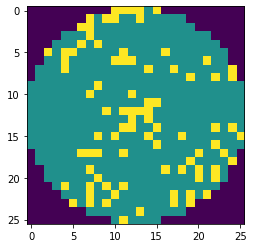

wafer_id:13321, ウエハサイズ:26x26, スタンプサイズ:3x2, oDefects:26, nDefects:80, p=32.500


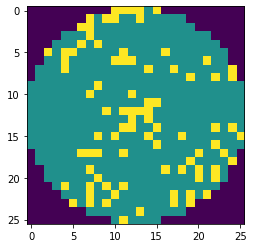

wafer_id:13321, ウエハサイズ:26x26, スタンプサイズ:4x2, oDefects:26, nDefects:80, p=32.500


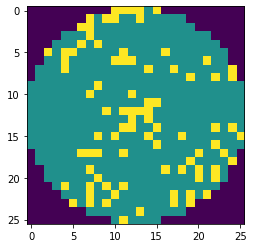

wafer_id:13337, ウエハサイズ:26x26, スタンプサイズ:2x4, oDefects:38, nDefects:126, p=30.159


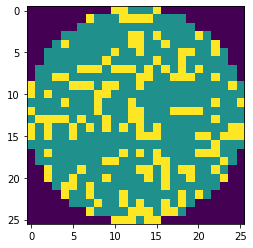

(26, 26)
(26, 26)
wafer_id:15060, ウエハサイズ:26x26, スタンプサイズ:3x2, oDefects:35, nDefects:116, p=30.172


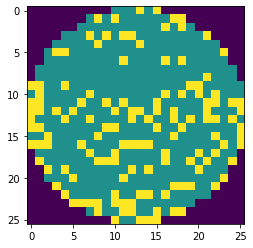

wafer_id:15060, ウエハサイズ:26x26, スタンプサイズ:4x2, oDefects:35, nDefects:116, p=30.172


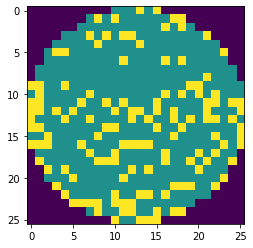

wafer_id:15226, ウエハサイズ:26x26, スタンプサイズ:2x3, oDefects:26, nDefects:85, p=30.588


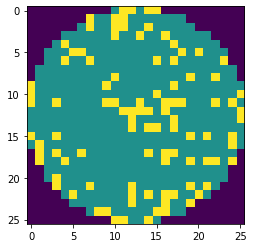

wafer_id:15226, ウエハサイズ:26x26, スタンプサイズ:3x3, oDefects:25, nDefects:78, p=32.051


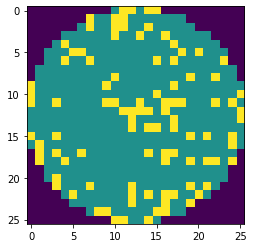

wafer_id:15226, ウエハサイズ:26x26, スタンプサイズ:4x3, oDefects:25, nDefects:78, p=32.051


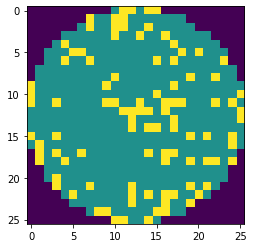

wafer_id:15299, ウエハサイズ:26x26, スタンプサイズ:3x2, oDefects:42, nDefects:138, p=30.435


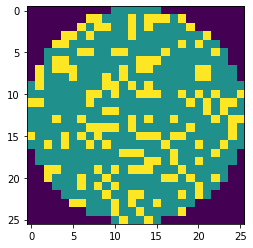

wafer_id:15299, ウエハサイズ:26x26, スタンプサイズ:4x2, oDefects:42, nDefects:138, p=30.435


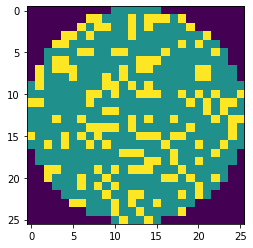

wafer_id:15418, ウエハサイズ:26x26, スタンプサイズ:2x3, oDefects:35, nDefects:112, p=31.250


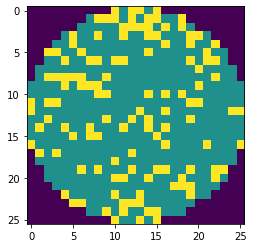

wafer_id:15418, ウエハサイズ:26x26, スタンプサイズ:3x3, oDefects:33, nDefects:105, p=31.429


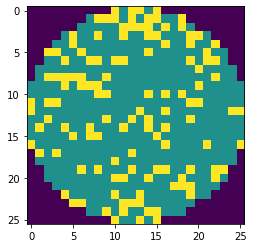

wafer_id:15418, ウエハサイズ:26x26, スタンプサイズ:4x3, oDefects:33, nDefects:105, p=31.429


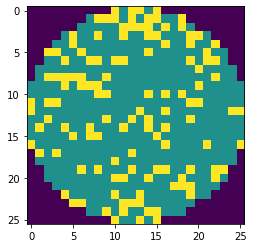

wafer_id:15558, ウエハサイズ:26x26, スタンプサイズ:2x3, oDefects:35, nDefects:116, p=30.172


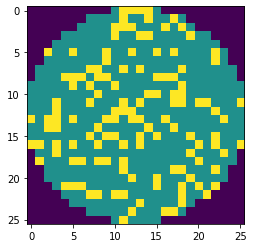

wafer_id:15558, ウエハサイズ:26x26, スタンプサイズ:3x3, oDefects:35, nDefects:112, p=31.250


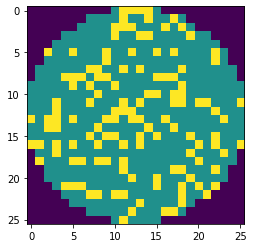

wafer_id:15558, ウエハサイズ:26x26, スタンプサイズ:4x3, oDefects:35, nDefects:112, p=31.250


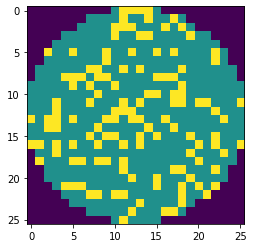

wafer_id:15576, ウエハサイズ:26x26, スタンプサイズ:3x4, oDefects:29, nDefects:96, p=30.208


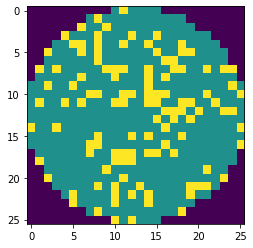

wafer_id:15576, ウエハサイズ:26x26, スタンプサイズ:4x4, oDefects:29, nDefects:96, p=30.208


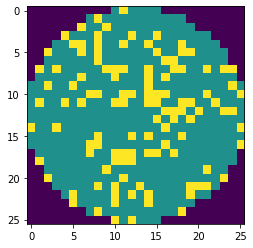

wafer_id:15830, ウエハサイズ:26x26, スタンプサイズ:2x4, oDefects:23, nDefects:76, p=30.263


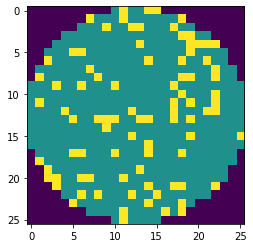

wafer_id:15830, ウエハサイズ:26x26, スタンプサイズ:3x4, oDefects:23, nDefects:72, p=31.944


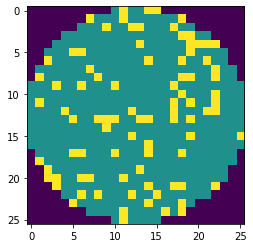

wafer_id:15830, ウエハサイズ:26x26, スタンプサイズ:4x4, oDefects:23, nDefects:72, p=31.944


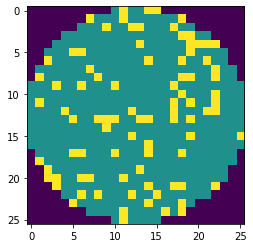

(26, 26)
wafer_id:16126, ウエハサイズ:26x26, スタンプサイズ:2x2, oDefects:30, nDefects:100, p=30.000


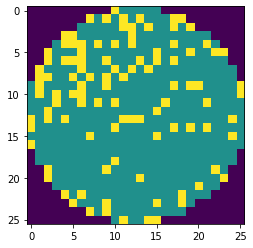

wafer_id:16126, ウエハサイズ:26x26, スタンプサイズ:3x2, oDefects:29, nDefects:95, p=30.526


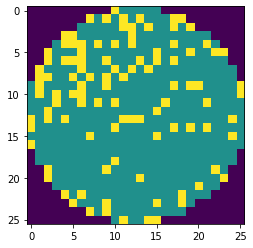

wafer_id:16126, ウエハサイズ:26x26, スタンプサイズ:4x2, oDefects:29, nDefects:95, p=30.526


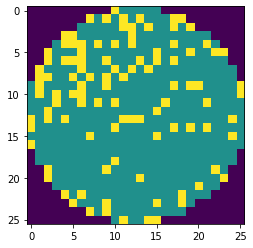

(26, 26)
(30, 34)
(30, 34)
(30, 34)
(30, 34)
wafer_id:21375, ウエハサイズ:30x34, スタンプサイズ:2x2, oDefects:75, nDefects:241, p=31.120


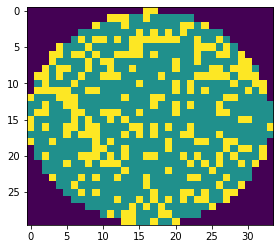

wafer_id:21375, ウエハサイズ:30x34, スタンプサイズ:3x2, oDefects:75, nDefects:241, p=31.120


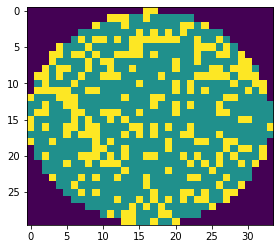

wafer_id:21375, ウエハサイズ:30x34, スタンプサイズ:4x2, oDefects:74, nDefects:232, p=31.897


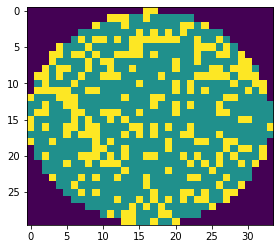

wafer_id:21375, ウエハサイズ:30x34, スタンプサイズ:2x3, oDefects:71, nDefects:232, p=30.603


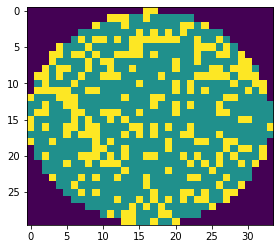

wafer_id:21375, ウエハサイズ:30x34, スタンプサイズ:3x3, oDefects:71, nDefects:232, p=30.603


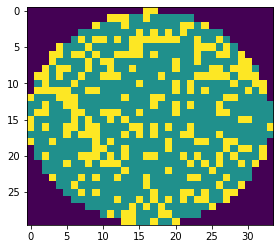

wafer_id:21375, ウエハサイズ:30x34, スタンプサイズ:4x3, oDefects:68, nDefects:223, p=30.493


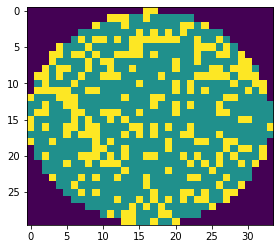

wafer_id:21375, ウエハサイズ:30x34, スタンプサイズ:2x4, oDefects:67, nDefects:218, p=30.734


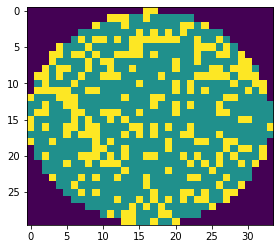

wafer_id:21375, ウエハサイズ:30x34, スタンプサイズ:3x4, oDefects:67, nDefects:218, p=30.734


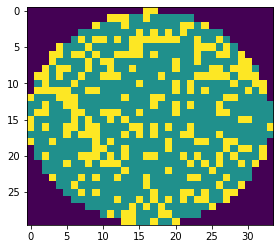

wafer_id:21375, ウエハサイズ:30x34, スタンプサイズ:4x4, oDefects:65, nDefects:209, p=31.100


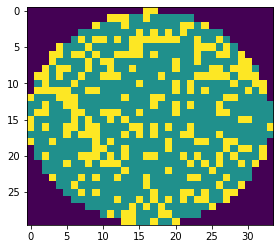

(30, 34)
wafer_id:22535, ウエハサイズ:30x34, スタンプサイズ:2x2, oDefects:72, nDefects:236, p=30.508


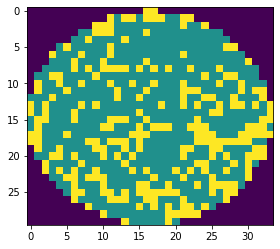

wafer_id:22535, ウエハサイズ:30x34, スタンプサイズ:3x2, oDefects:72, nDefects:236, p=30.508


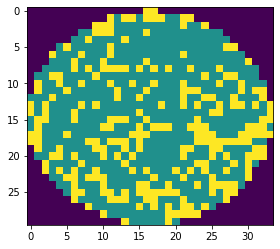

wafer_id:22535, ウエハサイズ:30x34, スタンプサイズ:4x2, oDefects:69, nDefects:228, p=30.263


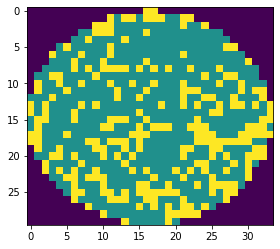

wafer_id:22535, ウエハサイズ:30x34, スタンプサイズ:2x4, oDefects:67, nDefects:209, p=32.057


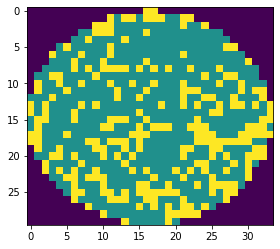

wafer_id:22535, ウエハサイズ:30x34, スタンプサイズ:3x4, oDefects:67, nDefects:209, p=32.057


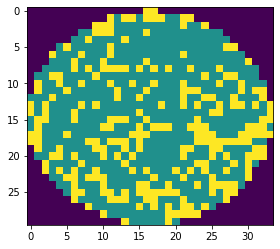

wafer_id:22535, ウエハサイズ:30x34, スタンプサイズ:4x4, oDefects:66, nDefects:201, p=32.836


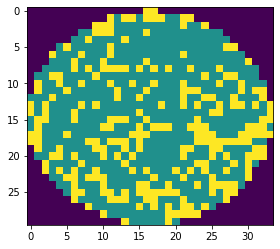

(30, 34)
(30, 34)
(30, 34)
(30, 34)
(30, 34)
wafer_id:27488, ウエハサイズ:35x31, スタンプサイズ:3x2, oDefects:41, nDefects:136, p=30.147


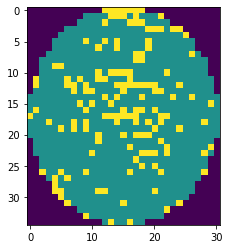

wafer_id:27488, ウエハサイズ:35x31, スタンプサイズ:4x2, oDefects:41, nDefects:135, p=30.370


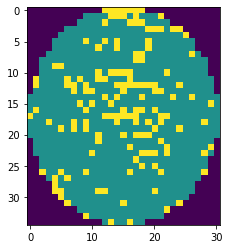

(29, 27)
(29, 27)
(29, 27)
wafer_id:30762, ウエハサイズ:26x26, スタンプサイズ:2x2, oDefects:53, nDefects:167, p=31.737


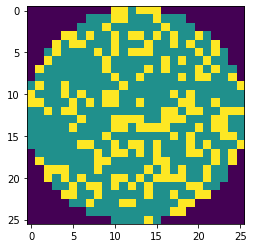

wafer_id:30762, ウエハサイズ:26x26, スタンプサイズ:3x2, oDefects:53, nDefects:164, p=32.317


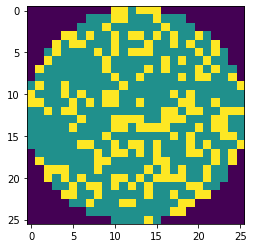

wafer_id:30762, ウエハサイズ:26x26, スタンプサイズ:4x2, oDefects:53, nDefects:164, p=32.317


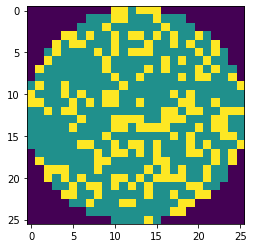

wafer_id:30762, ウエハサイズ:26x26, スタンプサイズ:2x3, oDefects:45, nDefects:149, p=30.201


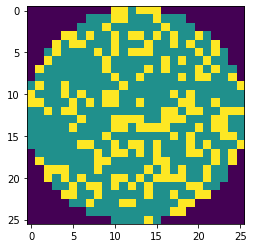

wafer_id:30762, ウエハサイズ:26x26, スタンプサイズ:3x3, oDefects:45, nDefects:146, p=30.822


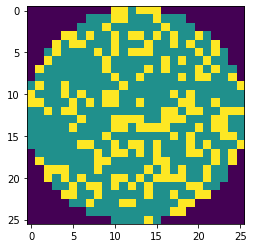

wafer_id:30762, ウエハサイズ:26x26, スタンプサイズ:4x3, oDefects:45, nDefects:146, p=30.822


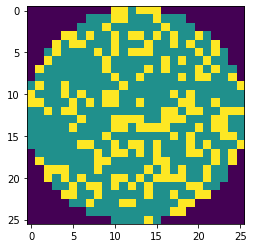

wafer_id:30774, ウエハサイズ:26x26, スタンプサイズ:2x3, oDefects:52, nDefects:151, p=34.437


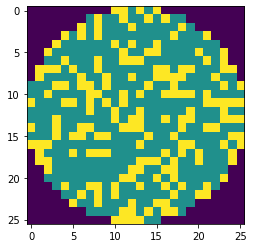

wafer_id:30774, ウエハサイズ:26x26, スタンプサイズ:3x3, oDefects:49, nDefects:142, p=34.507


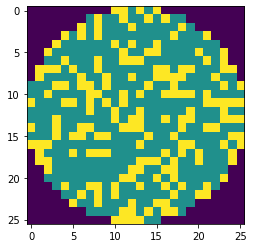

wafer_id:30774, ウエハサイズ:26x26, スタンプサイズ:4x3, oDefects:49, nDefects:142, p=34.507


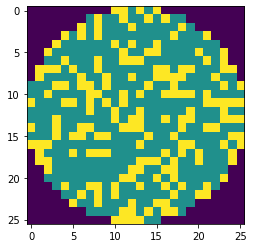

wafer_id:30777, ウエハサイズ:26x26, スタンプサイズ:2x2, oDefects:60, nDefects:176, p=34.091


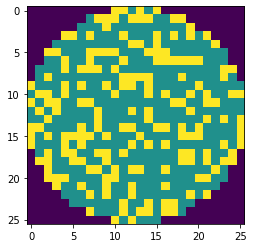

wafer_id:30777, ウエハサイズ:26x26, スタンプサイズ:3x2, oDefects:57, nDefects:168, p=33.929


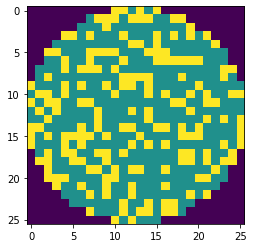

wafer_id:30777, ウエハサイズ:26x26, スタンプサイズ:4x2, oDefects:57, nDefects:168, p=33.929


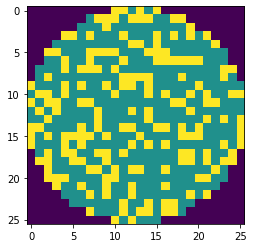

wafer_id:30777, ウエハサイズ:26x26, スタンプサイズ:2x4, oDefects:47, nDefects:155, p=30.323


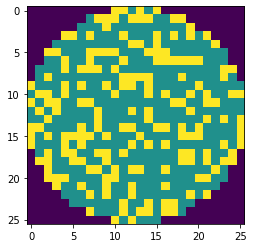

wafer_id:30777, ウエハサイズ:26x26, スタンプサイズ:3x4, oDefects:45, nDefects:147, p=30.612


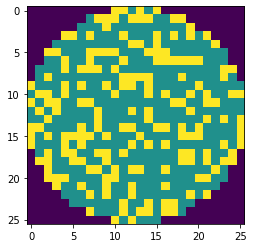

wafer_id:30777, ウエハサイズ:26x26, スタンプサイズ:4x4, oDefects:45, nDefects:147, p=30.612


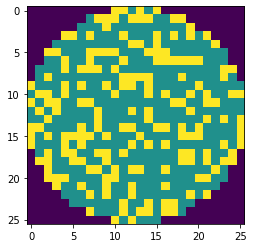

(26, 26)
(35, 31)
(35, 31)
wafer_id:33640, ウエハサイズ:35x31, スタンプサイズ:2x4, oDefects:58, nDefects:166, p=34.940


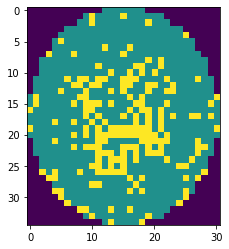

(35, 31)
wafer_id:34792, ウエハサイズ:35x31, スタンプサイズ:2x3, oDefects:60, nDefects:195, p=30.769


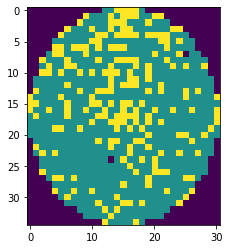

wafer_id:34792, ウエハサイズ:35x31, スタンプサイズ:3x3, oDefects:60, nDefects:194, p=30.928


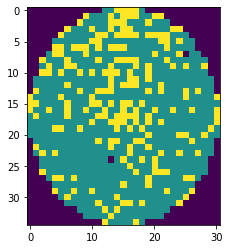

wafer_id:34792, ウエハサイズ:35x31, スタンプサイズ:4x3, oDefects:60, nDefects:192, p=31.250


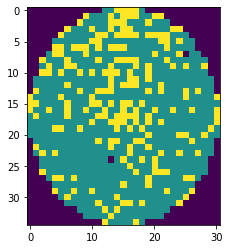

(35, 31)
(38, 42)
(41, 38)
(41, 38)
(41, 38)
(41, 38)
(39, 37)
(39, 37)
(39, 37)
(38, 38)
(32, 32)
wafer_id:45427, ウエハサイズ:31x31, スタンプサイズ:2x4, oDefects:49, nDefects:161, p=30.435


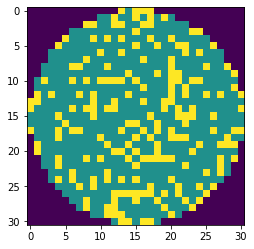

wafer_id:45427, ウエハサイズ:31x31, スタンプサイズ:3x4, oDefects:49, nDefects:161, p=30.435


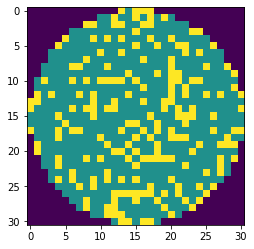

wafer_id:45427, ウエハサイズ:31x31, スタンプサイズ:4x4, oDefects:47, nDefects:152, p=30.921


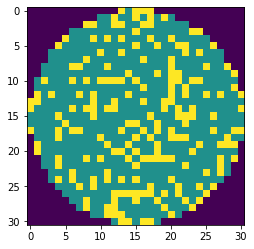

(31, 28)
wafer_id:46226, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:37, nDefects:121, p=30.579


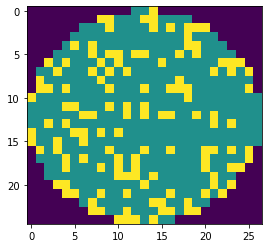

wafer_id:46226, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:37, nDefects:121, p=30.579


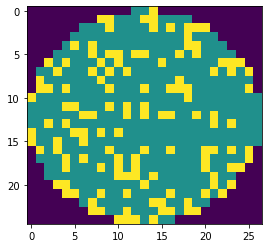

wafer_id:46226, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:37, nDefects:121, p=30.579


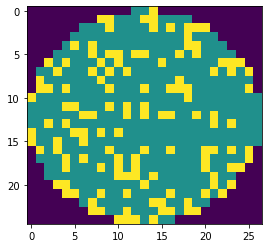

wafer_id:46807, ウエハサイズ:25x27, スタンプサイズ:2x3, oDefects:36, nDefects:120, p=30.000


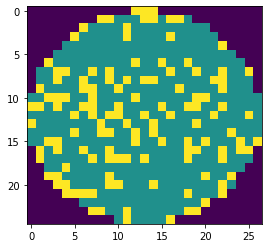

wafer_id:46807, ウエハサイズ:25x27, スタンプサイズ:3x3, oDefects:36, nDefects:120, p=30.000


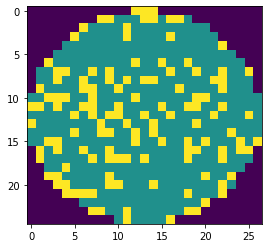

wafer_id:46807, ウエハサイズ:25x27, スタンプサイズ:4x3, oDefects:36, nDefects:120, p=30.000


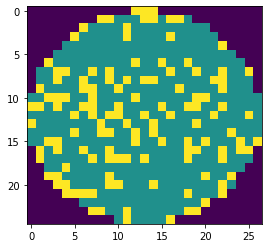

wafer_id:46895, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:25, nDefects:83, p=30.120


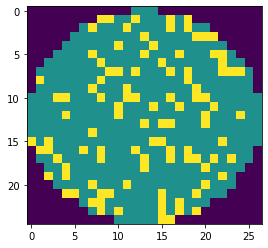

wafer_id:46895, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:25, nDefects:83, p=30.120


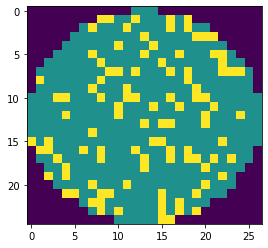

wafer_id:46895, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:25, nDefects:83, p=30.120


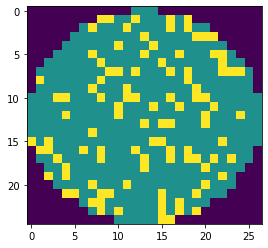

wafer_id:46911, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:38, nDefects:118, p=32.203


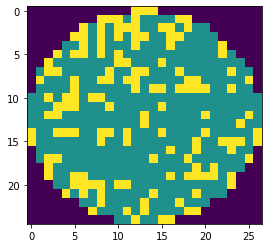

wafer_id:46911, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:38, nDefects:118, p=32.203


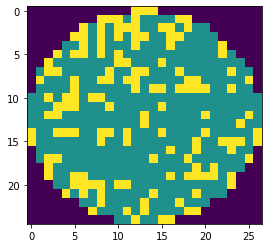

wafer_id:46911, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:38, nDefects:118, p=32.203


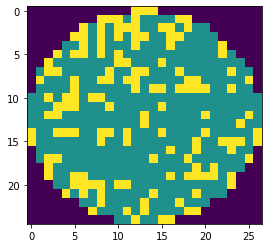

wafer_id:46946, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:28, nDefects:93, p=30.108


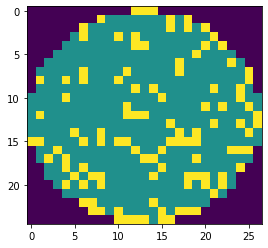

wafer_id:46946, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:28, nDefects:93, p=30.108


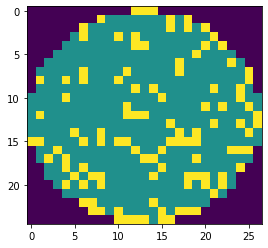

wafer_id:46946, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:28, nDefects:93, p=30.108


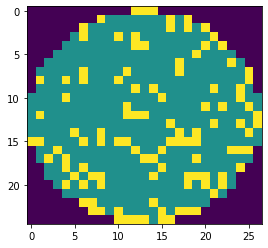

(25, 27)
wafer_id:47080, ウエハサイズ:25x27, スタンプサイズ:2x3, oDefects:49, nDefects:154, p=31.818


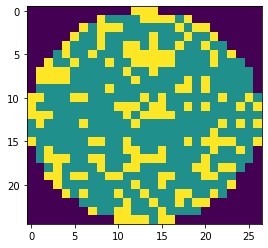

wafer_id:47080, ウエハサイズ:25x27, スタンプサイズ:3x3, oDefects:49, nDefects:154, p=31.818


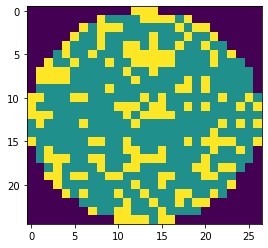

wafer_id:47080, ウエハサイズ:25x27, スタンプサイズ:4x3, oDefects:49, nDefects:154, p=31.818


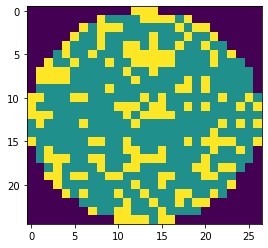

wafer_id:47097, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:42, nDefects:137, p=30.657


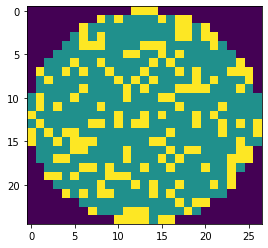

wafer_id:47097, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:42, nDefects:137, p=30.657


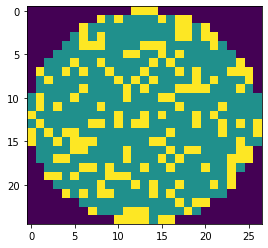

wafer_id:47097, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:42, nDefects:137, p=30.657


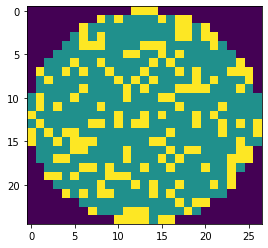

wafer_id:47144, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:29, nDefects:95, p=30.526


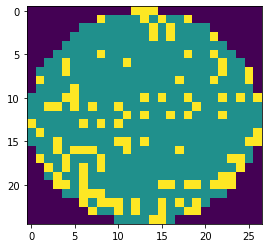

wafer_id:47144, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:29, nDefects:95, p=30.526


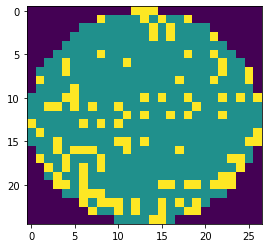

wafer_id:47144, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:29, nDefects:95, p=30.526


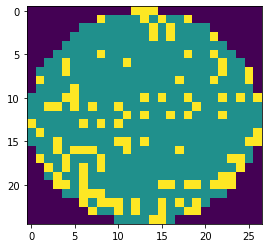

wafer_id:47240, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:36, nDefects:118, p=30.508


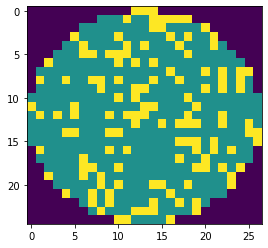

wafer_id:47240, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:36, nDefects:118, p=30.508


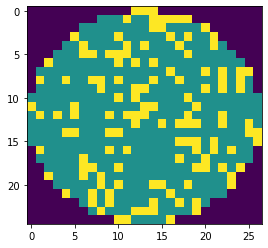

wafer_id:47240, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:36, nDefects:118, p=30.508


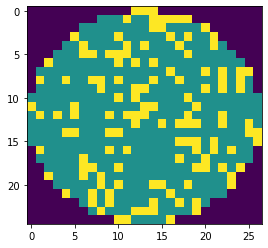

wafer_id:47500, ウエハサイズ:25x27, スタンプサイズ:2x3, oDefects:41, nDefects:136, p=30.147


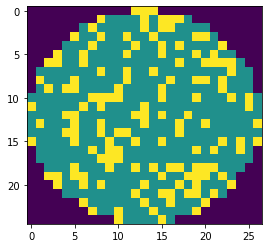

wafer_id:47500, ウエハサイズ:25x27, スタンプサイズ:3x3, oDefects:41, nDefects:136, p=30.147


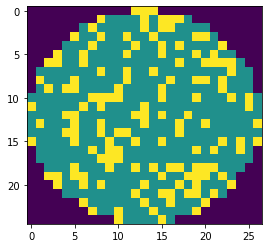

wafer_id:47500, ウエハサイズ:25x27, スタンプサイズ:4x3, oDefects:41, nDefects:136, p=30.147


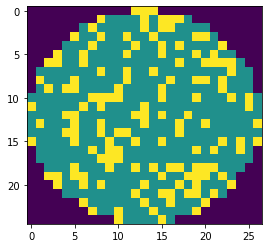

wafer_id:47538, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:31, nDefects:100, p=31.000


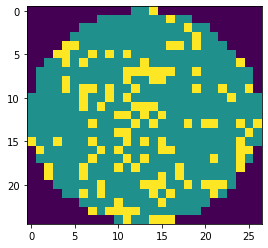

wafer_id:47538, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:31, nDefects:100, p=31.000


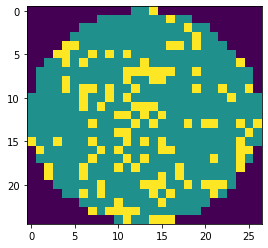

wafer_id:47538, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:31, nDefects:100, p=31.000


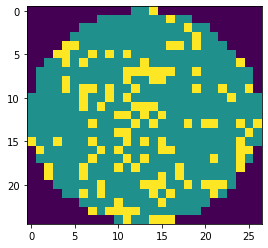

wafer_id:47543, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:36, nDefects:113, p=31.858


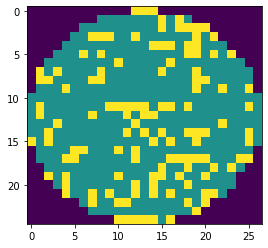

wafer_id:47543, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:36, nDefects:113, p=31.858


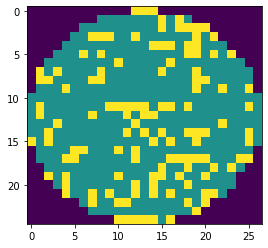

wafer_id:47543, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:36, nDefects:113, p=31.858


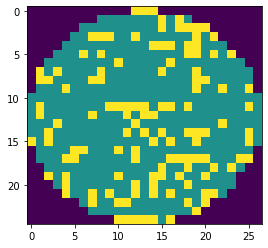

wafer_id:47653, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:23, nDefects:70, p=32.857


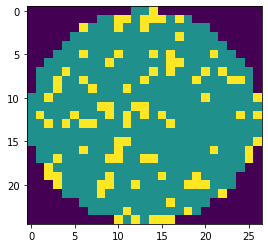

wafer_id:47653, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:23, nDefects:70, p=32.857


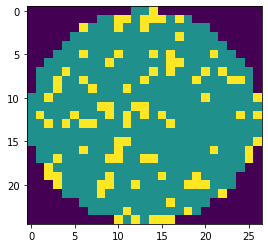

wafer_id:47653, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:23, nDefects:70, p=32.857


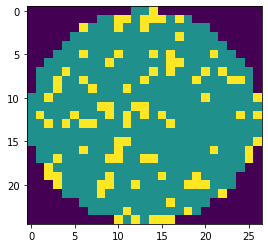

wafer_id:47764, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:40, nDefects:133, p=30.075


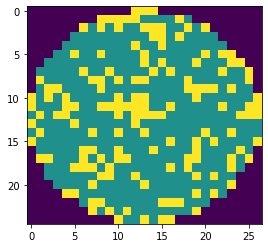

wafer_id:47764, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:40, nDefects:133, p=30.075


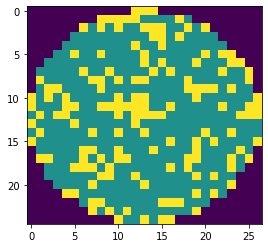

wafer_id:47764, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:40, nDefects:133, p=30.075


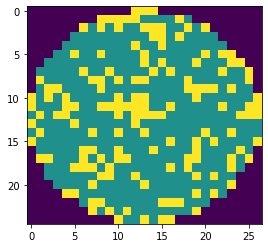

wafer_id:47767, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:45, nDefects:143, p=31.469


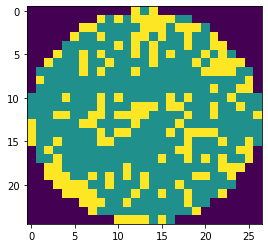

wafer_id:47767, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:45, nDefects:143, p=31.469


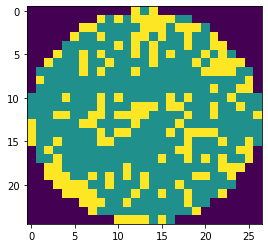

wafer_id:47767, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:45, nDefects:143, p=31.469


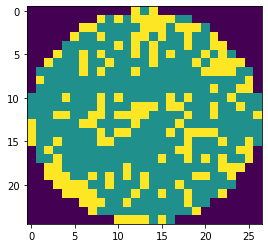

wafer_id:47767, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:37, nDefects:117, p=31.624


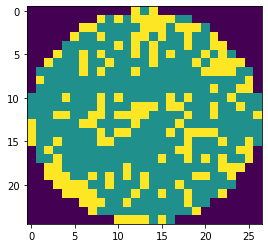

wafer_id:47767, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:37, nDefects:117, p=31.624


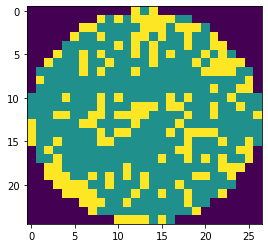

wafer_id:47767, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:37, nDefects:117, p=31.624


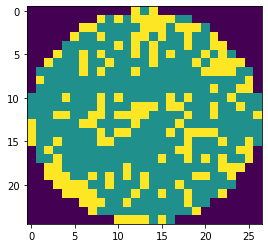

wafer_id:47939, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:40, nDefects:131, p=30.534


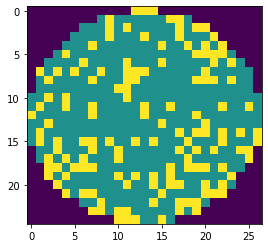

wafer_id:47939, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:40, nDefects:131, p=30.534


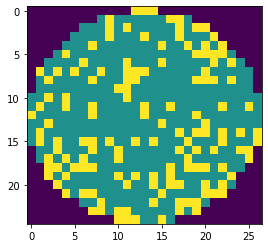

wafer_id:47939, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:40, nDefects:131, p=30.534


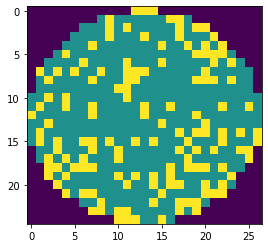

(25, 27)
wafer_id:48191, ウエハサイズ:25x27, スタンプサイズ:2x3, oDefects:42, nDefects:122, p=34.426


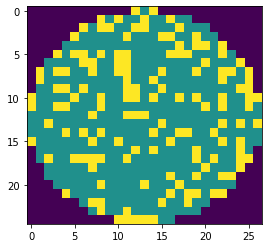

wafer_id:48191, ウエハサイズ:25x27, スタンプサイズ:3x3, oDefects:42, nDefects:122, p=34.426


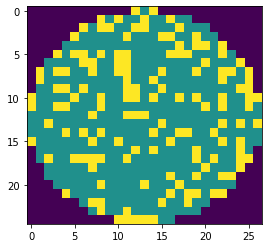

wafer_id:48191, ウエハサイズ:25x27, スタンプサイズ:4x3, oDefects:42, nDefects:122, p=34.426


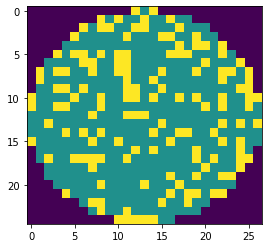

wafer_id:48325, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:34, nDefects:113, p=30.088


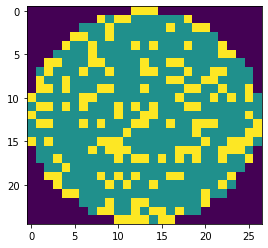

wafer_id:48325, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:34, nDefects:113, p=30.088


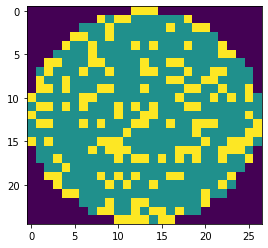

wafer_id:48325, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:34, nDefects:113, p=30.088


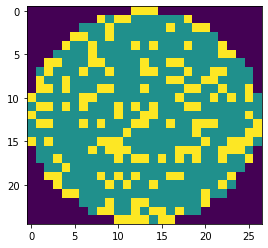

wafer_id:48402, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:42, nDefects:133, p=31.579


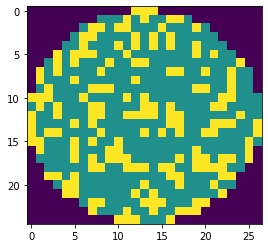

wafer_id:48402, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:42, nDefects:133, p=31.579


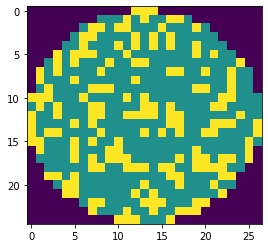

wafer_id:48402, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:42, nDefects:133, p=31.579


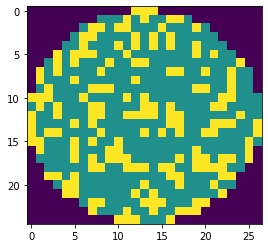

wafer_id:48410, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:32, nDefects:102, p=31.373


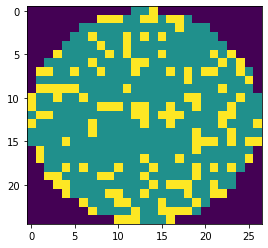

wafer_id:48410, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:32, nDefects:102, p=31.373


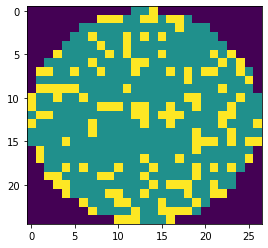

wafer_id:48410, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:32, nDefects:102, p=31.373


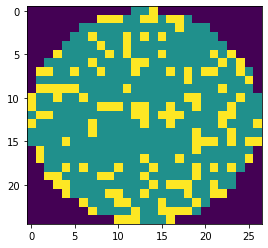

wafer_id:48429, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:38, nDefects:125, p=30.400


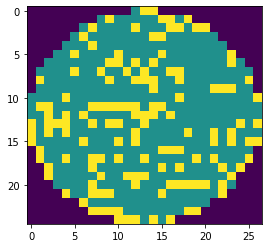

wafer_id:48429, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:38, nDefects:125, p=30.400


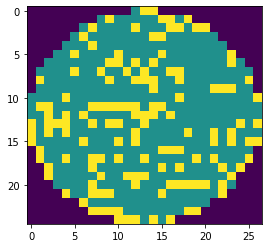

wafer_id:48429, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:38, nDefects:125, p=30.400


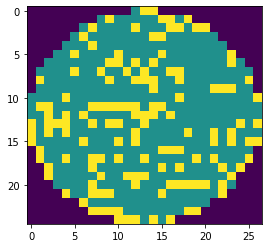

wafer_id:48451, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:43, nDefects:139, p=30.935


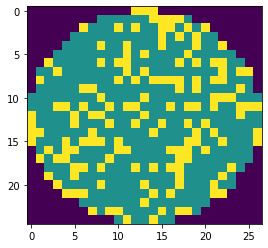

wafer_id:48451, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:43, nDefects:139, p=30.935


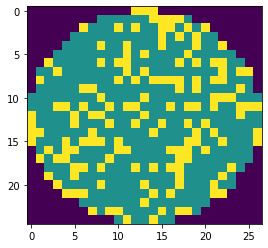

wafer_id:48451, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:43, nDefects:139, p=30.935


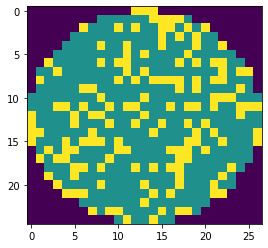

wafer_id:48462, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:50, nDefects:153, p=32.680


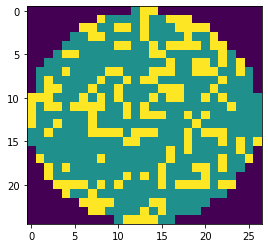

wafer_id:48462, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:50, nDefects:153, p=32.680


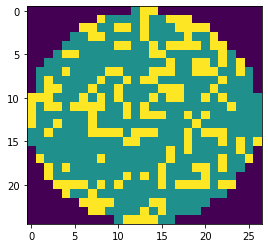

wafer_id:48462, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:50, nDefects:153, p=32.680


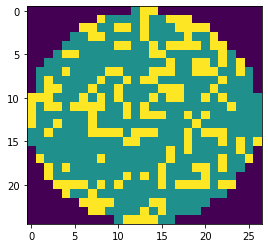

wafer_id:48735, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:33, nDefects:109, p=30.275


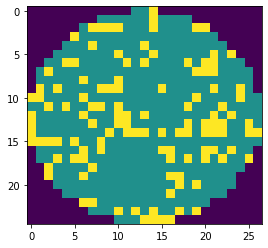

wafer_id:48735, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:33, nDefects:109, p=30.275


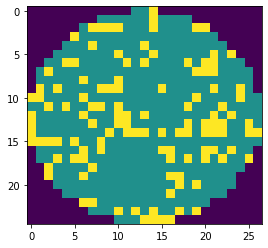

wafer_id:48735, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:33, nDefects:109, p=30.275


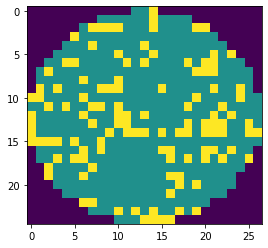

wafer_id:48785, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:42, nDefects:139, p=30.216


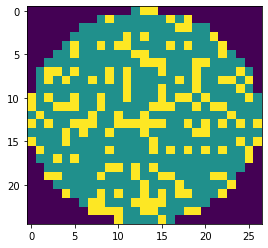

wafer_id:48785, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:42, nDefects:139, p=30.216


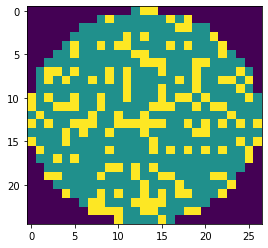

wafer_id:48785, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:42, nDefects:139, p=30.216


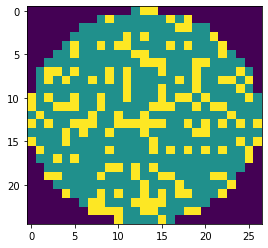

wafer_id:48785, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:36, nDefects:120, p=30.000


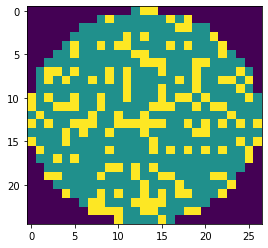

wafer_id:48785, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:36, nDefects:120, p=30.000


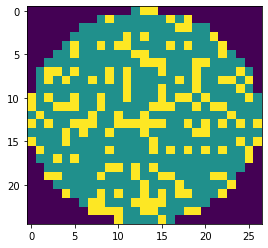

wafer_id:48785, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:36, nDefects:120, p=30.000


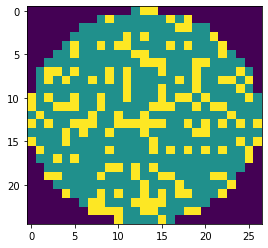

wafer_id:48798, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:43, nDefects:135, p=31.852


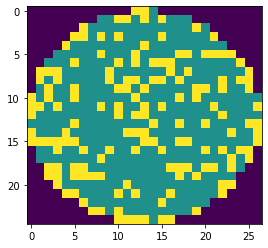

wafer_id:48798, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:43, nDefects:135, p=31.852


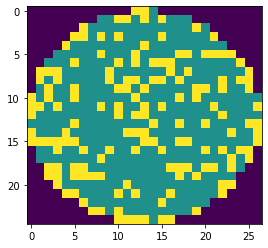

wafer_id:48798, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:43, nDefects:135, p=31.852


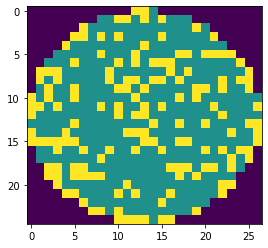

wafer_id:48874, ウエハサイズ:25x27, スタンプサイズ:2x3, oDefects:36, nDefects:119, p=30.252


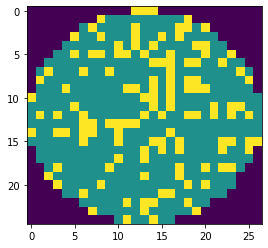

wafer_id:48874, ウエハサイズ:25x27, スタンプサイズ:3x3, oDefects:36, nDefects:119, p=30.252


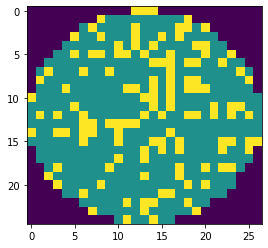

wafer_id:48874, ウエハサイズ:25x27, スタンプサイズ:4x3, oDefects:36, nDefects:119, p=30.252


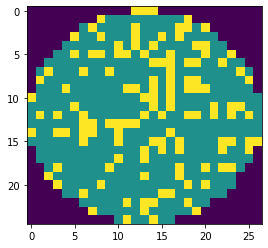

wafer_id:48956, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:33, nDefects:109, p=30.275


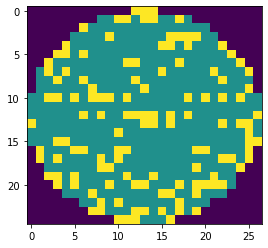

wafer_id:48956, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:33, nDefects:109, p=30.275


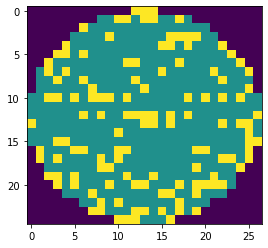

wafer_id:48956, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:33, nDefects:109, p=30.275


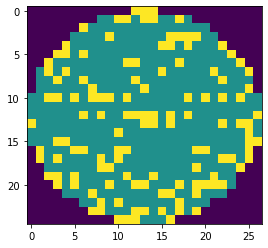

wafer_id:48969, ウエハサイズ:25x27, スタンプサイズ:2x3, oDefects:56, nDefects:162, p=34.568


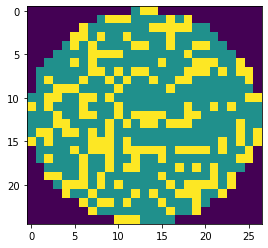

wafer_id:48969, ウエハサイズ:25x27, スタンプサイズ:3x3, oDefects:56, nDefects:162, p=34.568


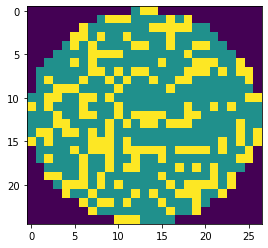

wafer_id:48969, ウエハサイズ:25x27, スタンプサイズ:4x3, oDefects:56, nDefects:162, p=34.568


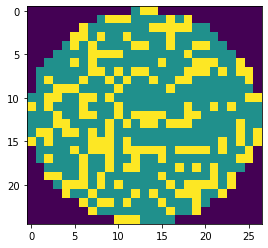

(25, 27)
wafer_id:49016, ウエハサイズ:25x27, スタンプサイズ:2x3, oDefects:47, nDefects:155, p=30.323


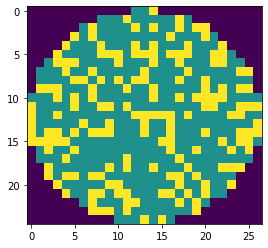

wafer_id:49016, ウエハサイズ:25x27, スタンプサイズ:3x3, oDefects:47, nDefects:155, p=30.323


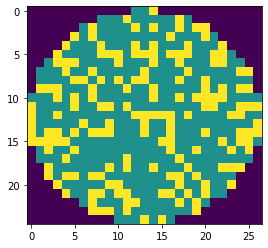

wafer_id:49016, ウエハサイズ:25x27, スタンプサイズ:4x3, oDefects:47, nDefects:155, p=30.323


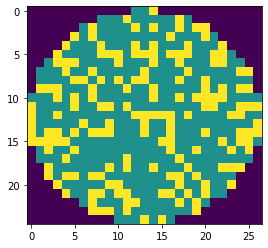

wafer_id:49016, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:41, nDefects:131, p=31.298


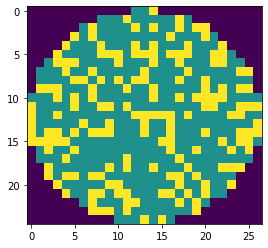

wafer_id:49016, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:41, nDefects:131, p=31.298


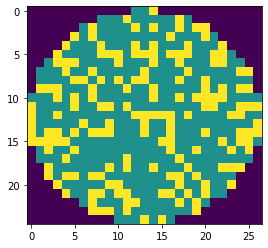

wafer_id:49016, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:41, nDefects:131, p=31.298


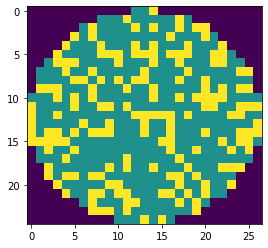

wafer_id:49300, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:33, nDefects:107, p=30.841


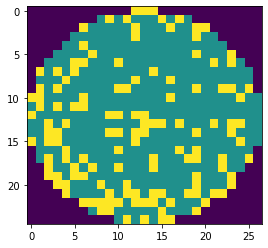

wafer_id:49300, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:33, nDefects:107, p=30.841


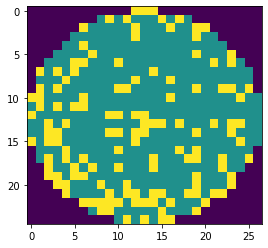

wafer_id:49300, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:33, nDefects:107, p=30.841


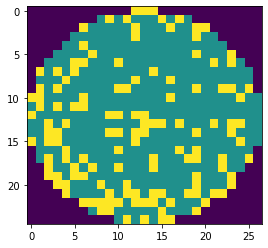

wafer_id:49433, ウエハサイズ:25x27, スタンプサイズ:2x3, oDefects:43, nDefects:131, p=32.824


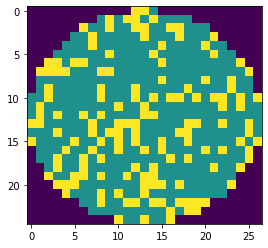

wafer_id:49433, ウエハサイズ:25x27, スタンプサイズ:3x3, oDefects:43, nDefects:131, p=32.824


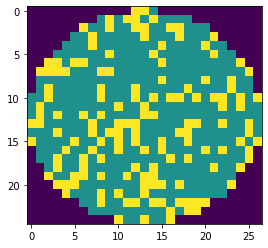

wafer_id:49433, ウエハサイズ:25x27, スタンプサイズ:4x3, oDefects:43, nDefects:131, p=32.824


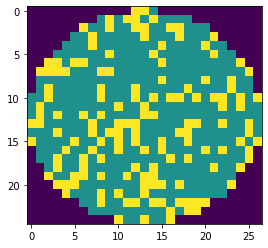

wafer_id:49434, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:38, nDefects:121, p=31.405


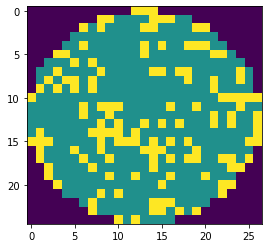

wafer_id:49434, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:38, nDefects:121, p=31.405


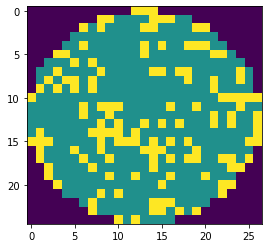

wafer_id:49434, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:38, nDefects:121, p=31.405


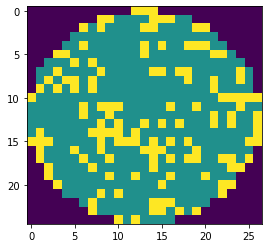

wafer_id:49502, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:50, nDefects:157, p=31.847


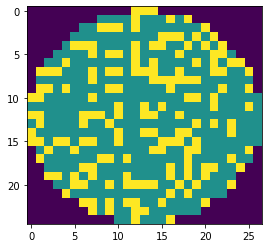

wafer_id:49502, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:50, nDefects:157, p=31.847


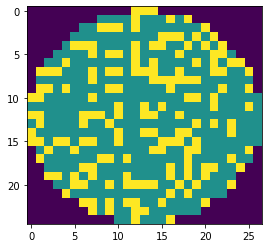

wafer_id:49502, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:50, nDefects:157, p=31.847


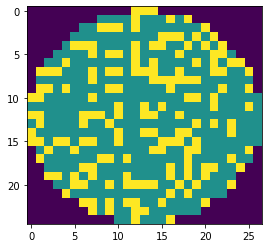

(25, 27)
wafer_id:50225, ウエハサイズ:25x27, スタンプサイズ:2x3, oDefects:43, nDefects:142, p=30.282


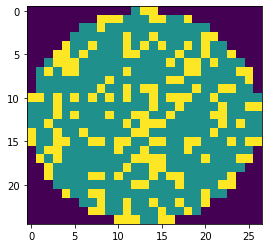

wafer_id:50225, ウエハサイズ:25x27, スタンプサイズ:3x3, oDefects:43, nDefects:142, p=30.282


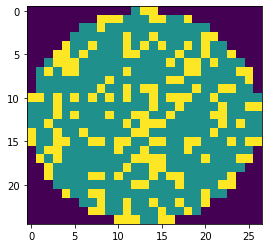

wafer_id:50225, ウエハサイズ:25x27, スタンプサイズ:4x3, oDefects:43, nDefects:142, p=30.282


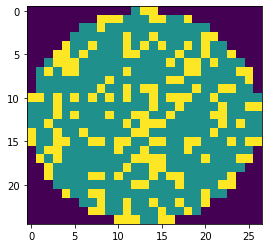

wafer_id:50395, ウエハサイズ:25x27, スタンプサイズ:2x3, oDefects:41, nDefects:135, p=30.370


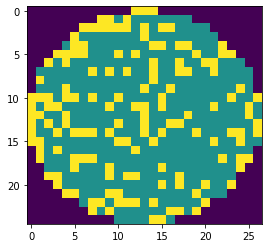

wafer_id:50395, ウエハサイズ:25x27, スタンプサイズ:3x3, oDefects:41, nDefects:135, p=30.370


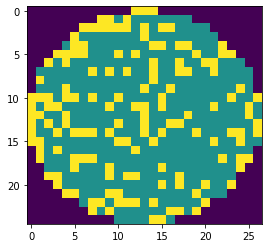

wafer_id:50395, ウエハサイズ:25x27, スタンプサイズ:4x3, oDefects:41, nDefects:135, p=30.370


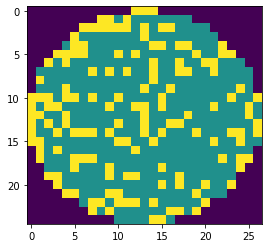

wafer_id:50400, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:32, nDefects:106, p=30.189


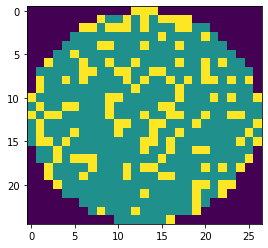

wafer_id:50400, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:32, nDefects:106, p=30.189


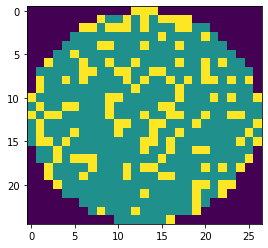

wafer_id:50400, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:32, nDefects:106, p=30.189


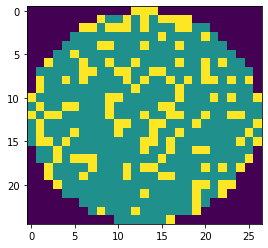

wafer_id:50560, ウエハサイズ:25x27, スタンプサイズ:2x3, oDefects:37, nDefects:123, p=30.081


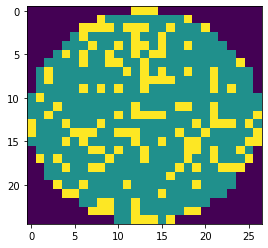

wafer_id:50560, ウエハサイズ:25x27, スタンプサイズ:3x3, oDefects:37, nDefects:123, p=30.081


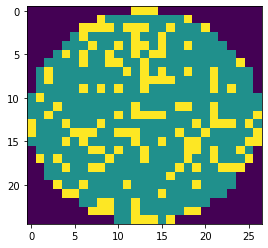

wafer_id:50560, ウエハサイズ:25x27, スタンプサイズ:4x3, oDefects:37, nDefects:123, p=30.081


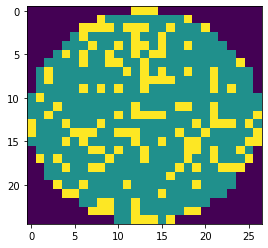

(25, 27)
wafer_id:51561, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:40, nDefects:129, p=31.008


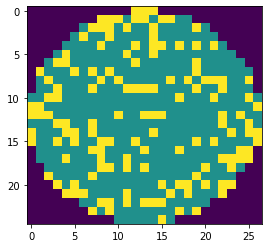

wafer_id:51561, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:40, nDefects:129, p=31.008


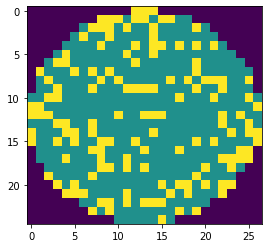

wafer_id:51561, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:40, nDefects:129, p=31.008


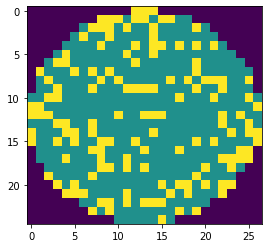

wafer_id:51824, ウエハサイズ:25x27, スタンプサイズ:2x3, oDefects:39, nDefects:121, p=32.231


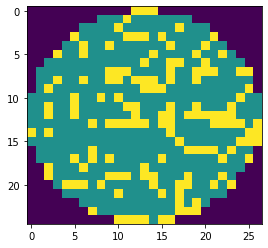

wafer_id:51824, ウエハサイズ:25x27, スタンプサイズ:3x3, oDefects:39, nDefects:121, p=32.231


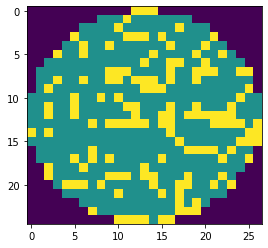

wafer_id:51824, ウエハサイズ:25x27, スタンプサイズ:4x3, oDefects:39, nDefects:121, p=32.231


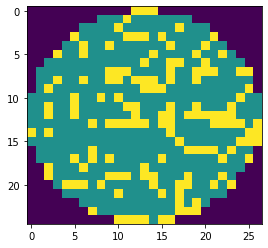

wafer_id:51824, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:30, nDefects:100, p=30.000


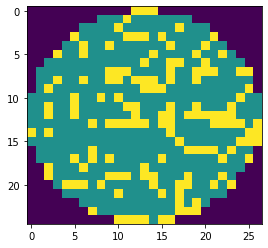

wafer_id:51824, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:30, nDefects:100, p=30.000


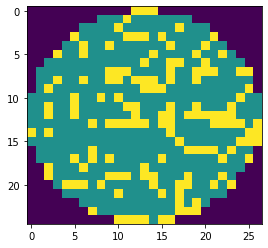

wafer_id:51824, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:30, nDefects:100, p=30.000


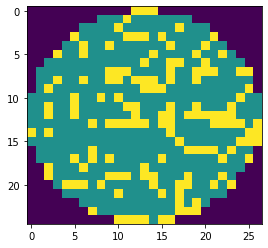

wafer_id:51876, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:34, nDefects:110, p=30.909


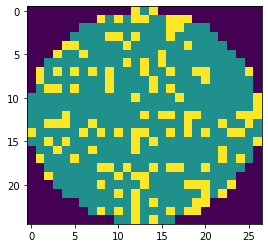

wafer_id:51876, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:34, nDefects:110, p=30.909


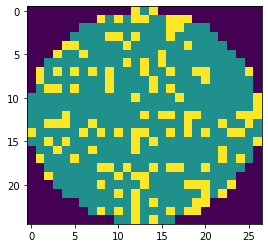

wafer_id:51876, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:34, nDefects:110, p=30.909


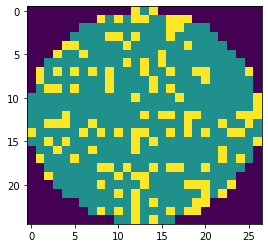

wafer_id:51901, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:36, nDefects:114, p=31.579


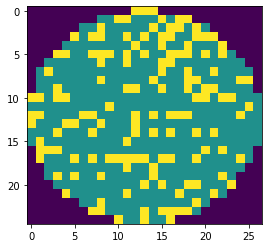

wafer_id:51901, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:36, nDefects:114, p=31.579


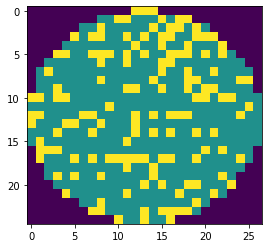

wafer_id:51901, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:36, nDefects:114, p=31.579


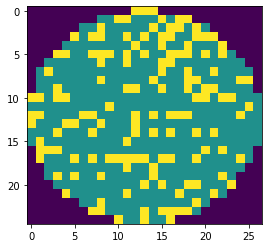

(25, 27)
wafer_id:52123, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:37, nDefects:123, p=30.081


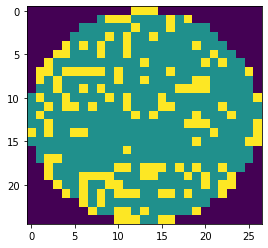

wafer_id:52123, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:37, nDefects:123, p=30.081


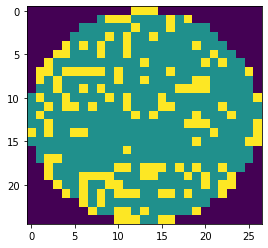

wafer_id:52123, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:37, nDefects:123, p=30.081


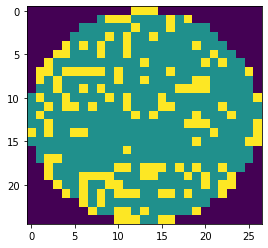

wafer_id:52171, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:31, nDefects:102, p=30.392


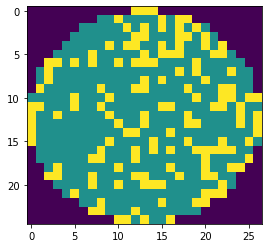

wafer_id:52171, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:31, nDefects:102, p=30.392


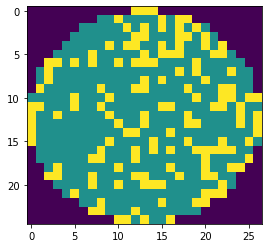

wafer_id:52171, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:31, nDefects:102, p=30.392


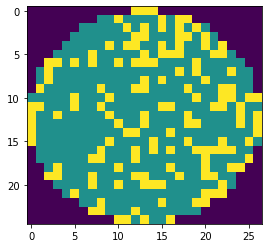

wafer_id:52310, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:40, nDefects:128, p=31.250


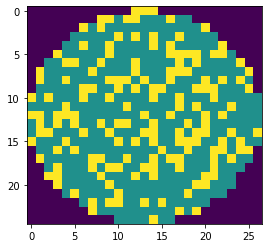

wafer_id:52310, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:40, nDefects:128, p=31.250


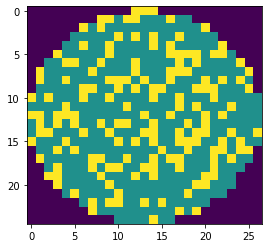

wafer_id:52310, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:40, nDefects:128, p=31.250


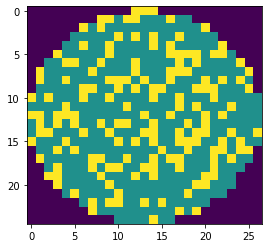

wafer_id:52639, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:25, nDefects:79, p=31.646


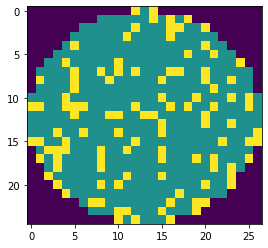

wafer_id:52639, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:25, nDefects:79, p=31.646


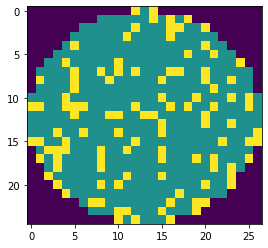

wafer_id:52639, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:25, nDefects:79, p=31.646


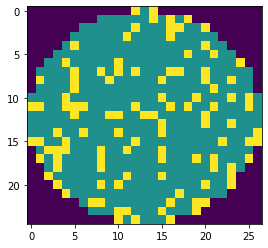

wafer_id:52788, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:39, nDefects:125, p=31.200


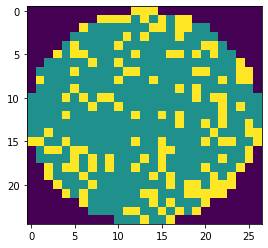

wafer_id:52788, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:39, nDefects:125, p=31.200


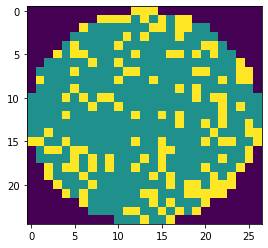

wafer_id:52788, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:39, nDefects:125, p=31.200


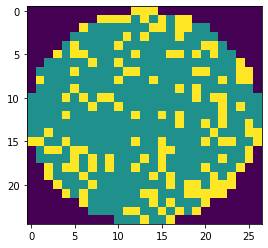

wafer_id:52984, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:33, nDefects:107, p=30.841


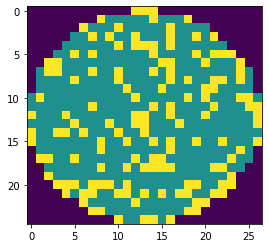

wafer_id:52984, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:33, nDefects:107, p=30.841


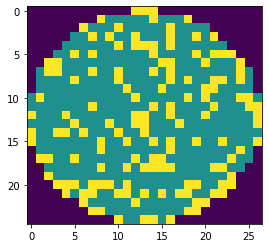

wafer_id:52984, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:33, nDefects:107, p=30.841


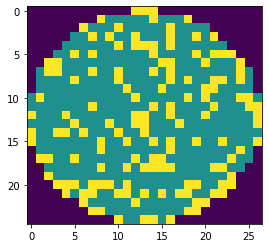

(25, 27)
wafer_id:53034, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:35, nDefects:115, p=30.435


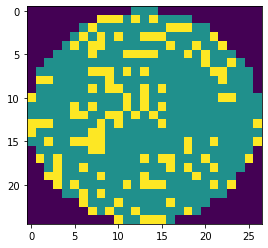

wafer_id:53034, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:35, nDefects:115, p=30.435


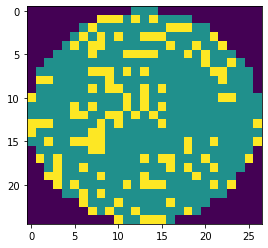

wafer_id:53034, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:35, nDefects:115, p=30.435


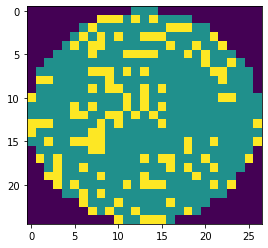

wafer_id:53434, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:44, nDefects:135, p=32.593


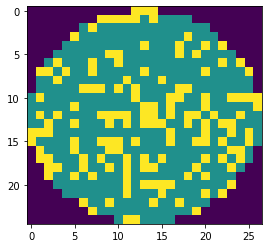

wafer_id:53434, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:44, nDefects:135, p=32.593


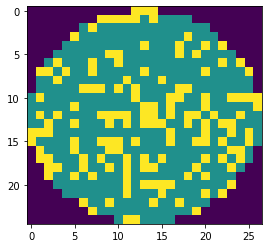

wafer_id:53434, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:44, nDefects:135, p=32.593


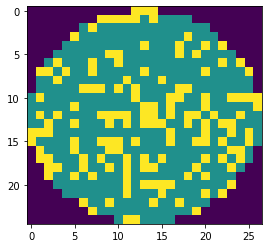

wafer_id:53492, ウエハサイズ:25x27, スタンプサイズ:2x3, oDefects:39, nDefects:128, p=30.469


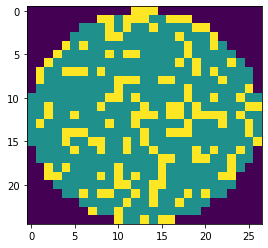

wafer_id:53492, ウエハサイズ:25x27, スタンプサイズ:3x3, oDefects:39, nDefects:128, p=30.469


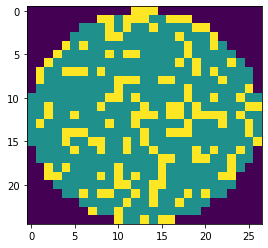

wafer_id:53492, ウエハサイズ:25x27, スタンプサイズ:4x3, oDefects:39, nDefects:128, p=30.469


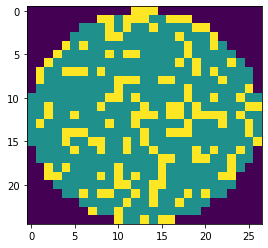

wafer_id:53518, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:40, nDefects:116, p=34.483


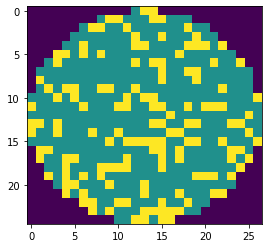

wafer_id:53518, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:40, nDefects:116, p=34.483


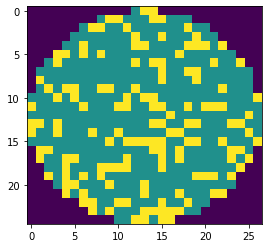

wafer_id:53518, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:40, nDefects:116, p=34.483


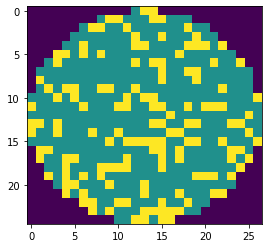

wafer_id:53551, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:48, nDefects:149, p=32.215


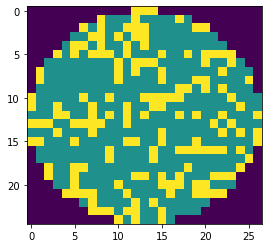

wafer_id:53551, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:48, nDefects:149, p=32.215


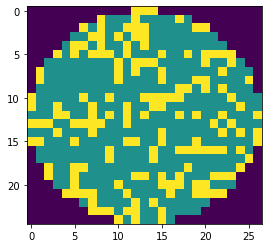

wafer_id:53551, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:48, nDefects:149, p=32.215


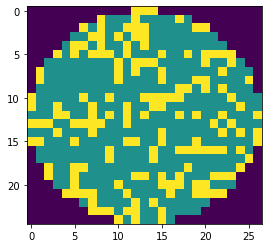

wafer_id:53551, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:40, nDefects:123, p=32.520


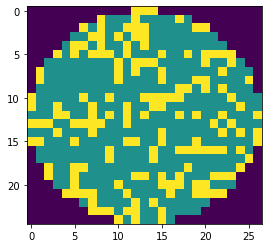

wafer_id:53551, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:40, nDefects:123, p=32.520


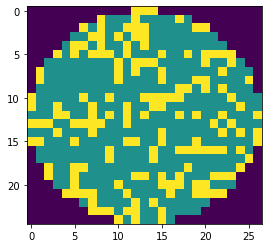

wafer_id:53551, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:40, nDefects:123, p=32.520


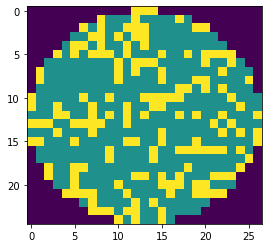

wafer_id:53590, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:40, nDefects:129, p=31.008


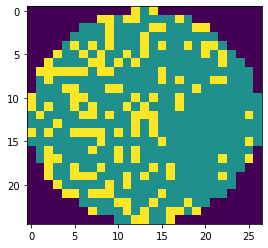

wafer_id:53590, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:40, nDefects:129, p=31.008


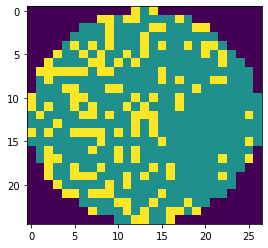

wafer_id:53590, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:40, nDefects:129, p=31.008


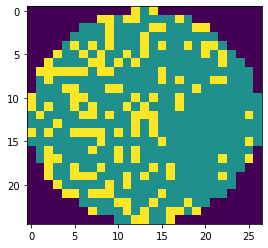

wafer_id:53790, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:36, nDefects:116, p=31.034


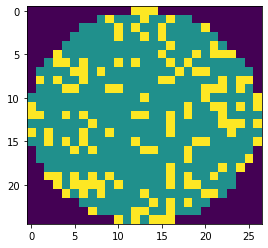

wafer_id:53790, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:36, nDefects:116, p=31.034


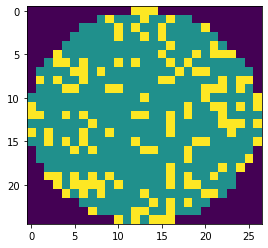

wafer_id:53790, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:36, nDefects:116, p=31.034


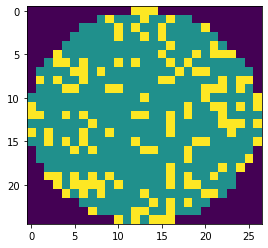

wafer_id:53791, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:39, nDefects:130, p=30.000


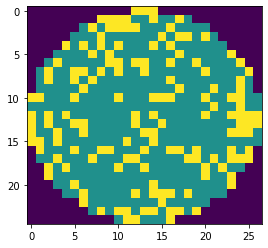

wafer_id:53791, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:39, nDefects:130, p=30.000


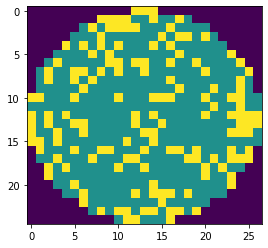

wafer_id:53791, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:39, nDefects:130, p=30.000


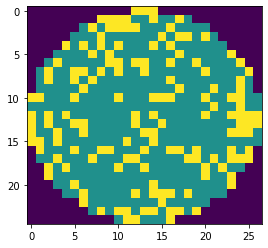

wafer_id:53791, ウエハサイズ:25x27, スタンプサイズ:2x3, oDefects:41, nDefects:130, p=31.538


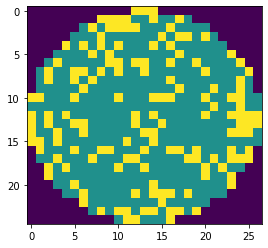

wafer_id:53791, ウエハサイズ:25x27, スタンプサイズ:3x3, oDefects:41, nDefects:130, p=31.538


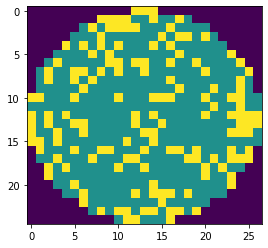

wafer_id:53791, ウエハサイズ:25x27, スタンプサイズ:4x3, oDefects:41, nDefects:130, p=31.538


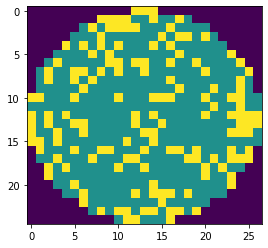

wafer_id:53807, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:45, nDefects:142, p=31.690


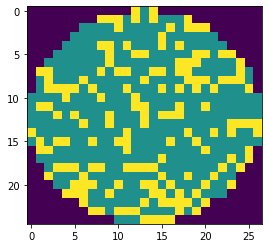

wafer_id:53807, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:45, nDefects:142, p=31.690


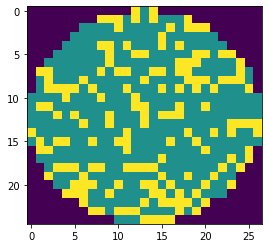

wafer_id:53807, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:45, nDefects:142, p=31.690


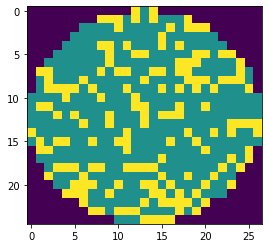

wafer_id:53807, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:41, nDefects:123, p=33.333


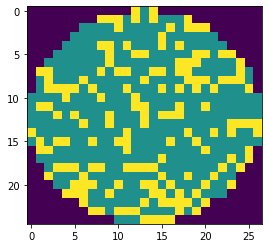

wafer_id:53807, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:41, nDefects:123, p=33.333


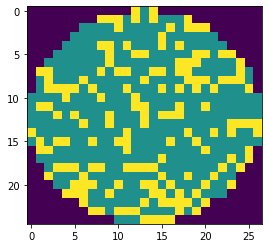

wafer_id:53807, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:41, nDefects:123, p=33.333


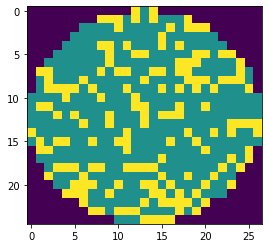

wafer_id:53831, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:35, nDefects:113, p=30.973


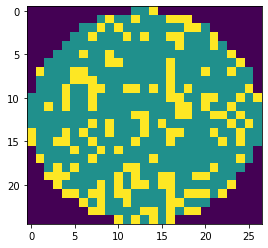

wafer_id:53831, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:35, nDefects:113, p=30.973


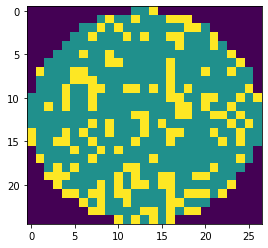

wafer_id:53831, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:35, nDefects:113, p=30.973


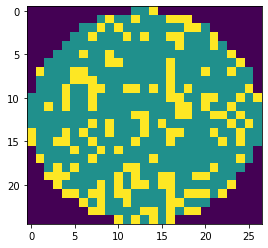

wafer_id:53861, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:38, nDefects:125, p=30.400


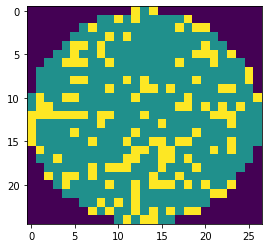

wafer_id:53861, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:38, nDefects:125, p=30.400


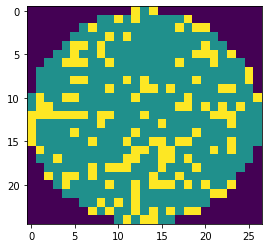

wafer_id:53861, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:38, nDefects:125, p=30.400


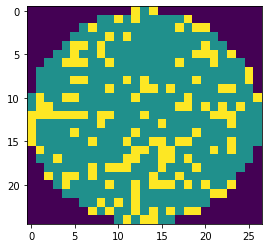

wafer_id:53879, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:37, nDefects:116, p=31.897


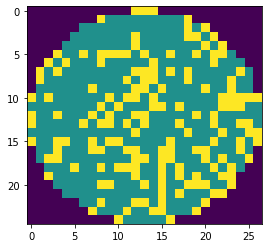

wafer_id:53879, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:37, nDefects:116, p=31.897


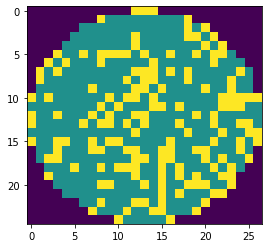

wafer_id:53879, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:37, nDefects:116, p=31.897


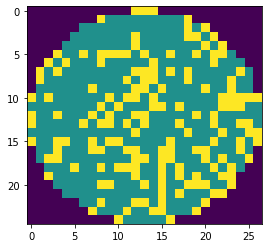

wafer_id:53895, ウエハサイズ:25x27, スタンプサイズ:2x3, oDefects:48, nDefects:156, p=30.769


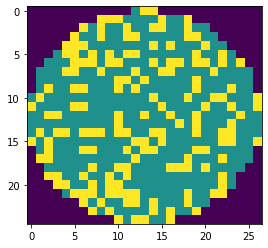

wafer_id:53895, ウエハサイズ:25x27, スタンプサイズ:3x3, oDefects:48, nDefects:156, p=30.769


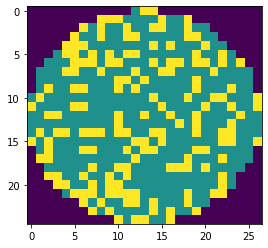

wafer_id:53895, ウエハサイズ:25x27, スタンプサイズ:4x3, oDefects:48, nDefects:156, p=30.769


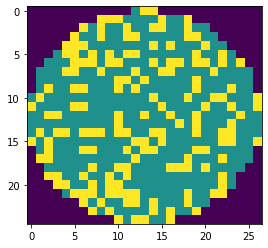

wafer_id:53990, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:42, nDefects:137, p=30.657


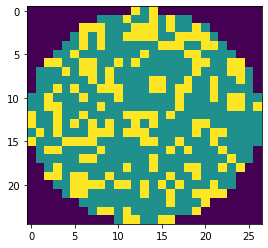

wafer_id:53990, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:42, nDefects:137, p=30.657


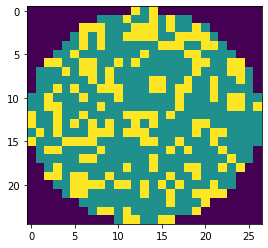

wafer_id:53990, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:42, nDefects:137, p=30.657


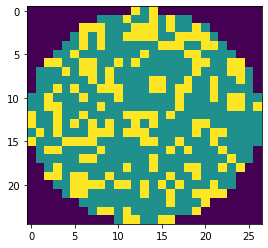

(25, 27)
wafer_id:54058, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:48, nDefects:157, p=30.573


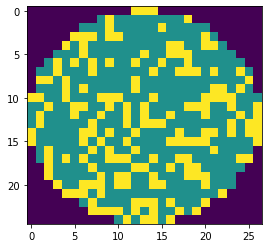

wafer_id:54058, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:48, nDefects:157, p=30.573


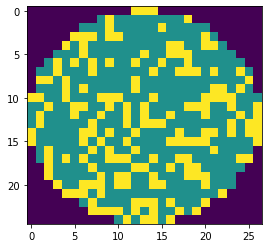

wafer_id:54058, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:48, nDefects:157, p=30.573


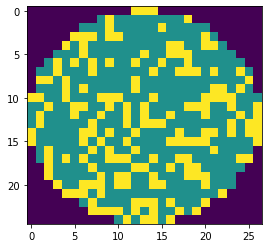

wafer_id:54058, ウエハサイズ:25x27, スタンプサイズ:2x3, oDefects:48, nDefects:157, p=30.573


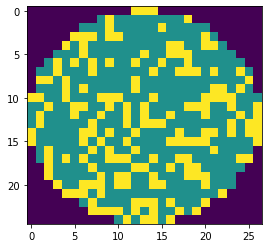

wafer_id:54058, ウエハサイズ:25x27, スタンプサイズ:3x3, oDefects:48, nDefects:157, p=30.573


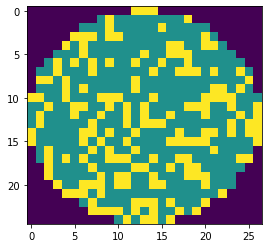

wafer_id:54058, ウエハサイズ:25x27, スタンプサイズ:4x3, oDefects:48, nDefects:157, p=30.573


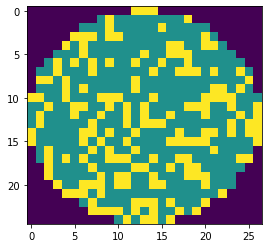

wafer_id:54156, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:41, nDefects:132, p=31.061


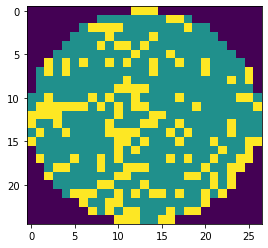

wafer_id:54156, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:41, nDefects:132, p=31.061


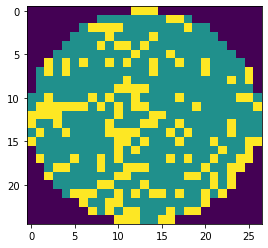

wafer_id:54156, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:41, nDefects:132, p=31.061


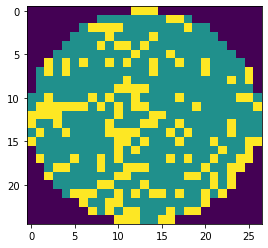

wafer_id:54231, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:47, nDefects:150, p=31.333


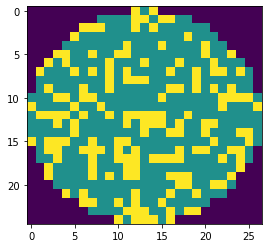

wafer_id:54231, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:47, nDefects:150, p=31.333


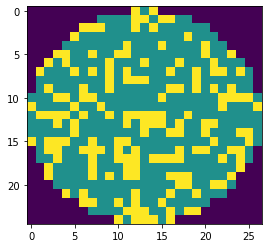

wafer_id:54231, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:47, nDefects:150, p=31.333


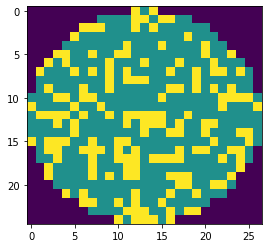

wafer_id:54231, ウエハサイズ:25x27, スタンプサイズ:2x3, oDefects:45, nDefects:150, p=30.000


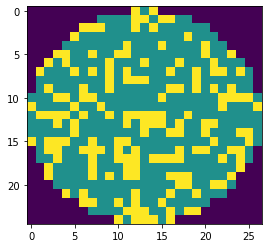

wafer_id:54231, ウエハサイズ:25x27, スタンプサイズ:3x3, oDefects:45, nDefects:150, p=30.000


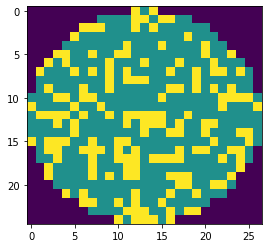

wafer_id:54231, ウエハサイズ:25x27, スタンプサイズ:4x3, oDefects:45, nDefects:150, p=30.000


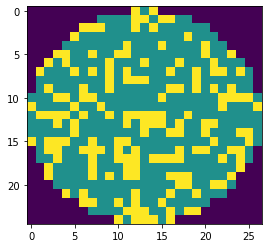

wafer_id:54242, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:36, nDefects:117, p=30.769


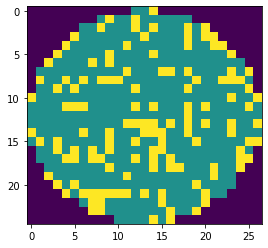

wafer_id:54242, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:36, nDefects:117, p=30.769


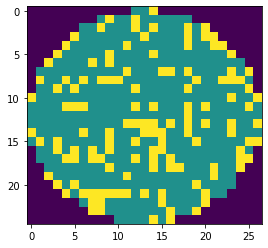

wafer_id:54242, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:36, nDefects:117, p=30.769


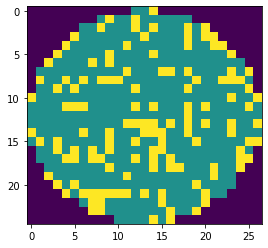

wafer_id:54273, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:36, nDefects:120, p=30.000


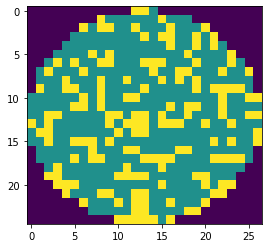

wafer_id:54273, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:36, nDefects:120, p=30.000


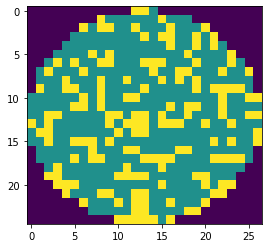

wafer_id:54273, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:36, nDefects:120, p=30.000


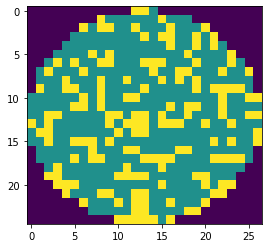

wafer_id:54423, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:27, nDefects:90, p=30.000


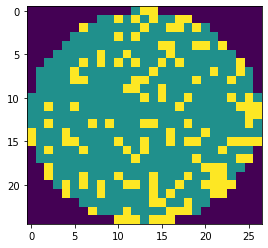

wafer_id:54423, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:27, nDefects:90, p=30.000


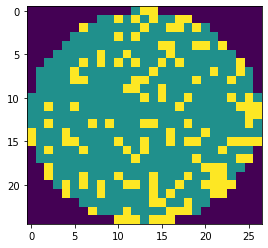

wafer_id:54423, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:27, nDefects:90, p=30.000


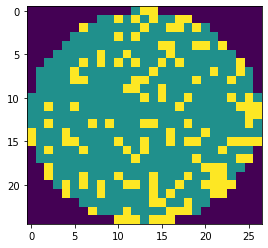

wafer_id:54430, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:45, nDefects:131, p=34.351


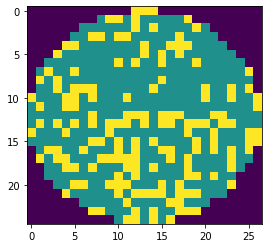

wafer_id:54430, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:45, nDefects:131, p=34.351


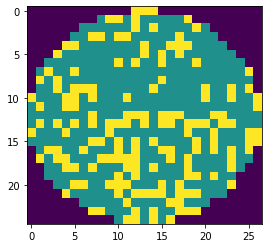

wafer_id:54430, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:45, nDefects:131, p=34.351


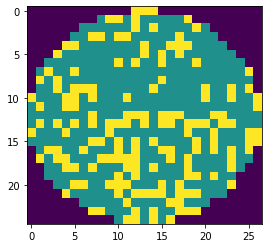

wafer_id:54486, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:33, nDefects:104, p=31.731


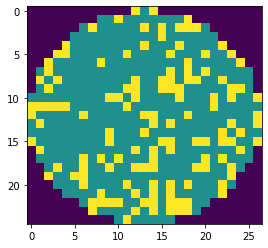

wafer_id:54486, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:33, nDefects:104, p=31.731


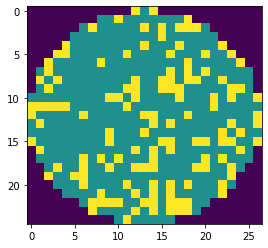

wafer_id:54486, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:33, nDefects:104, p=31.731


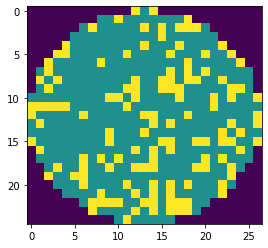

wafer_id:54498, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:42, nDefects:133, p=31.579


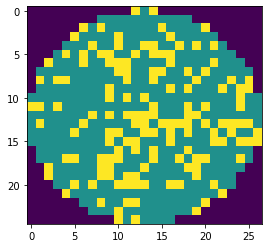

wafer_id:54498, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:42, nDefects:133, p=31.579


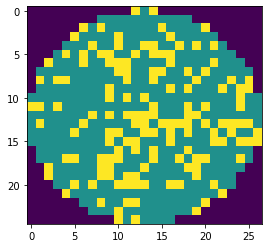

wafer_id:54498, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:42, nDefects:133, p=31.579


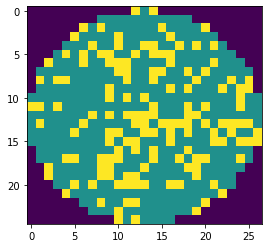

wafer_id:54498, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:39, nDefects:115, p=33.913


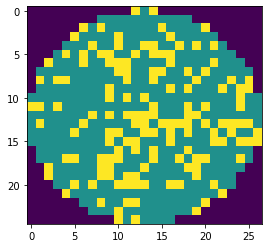

wafer_id:54498, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:39, nDefects:115, p=33.913


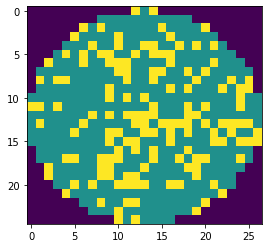

wafer_id:54498, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:39, nDefects:115, p=33.913


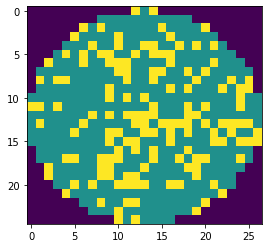

wafer_id:54515, ウエハサイズ:25x27, スタンプサイズ:2x3, oDefects:41, nDefects:130, p=31.538


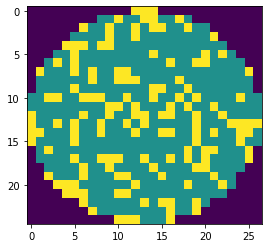

wafer_id:54515, ウエハサイズ:25x27, スタンプサイズ:3x3, oDefects:41, nDefects:130, p=31.538


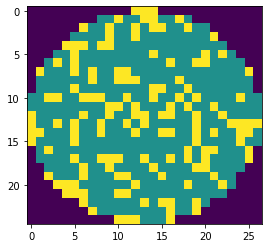

wafer_id:54515, ウエハサイズ:25x27, スタンプサイズ:4x3, oDefects:41, nDefects:130, p=31.538


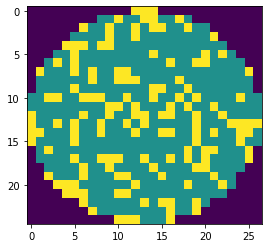

wafer_id:54594, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:39, nDefects:123, p=31.707


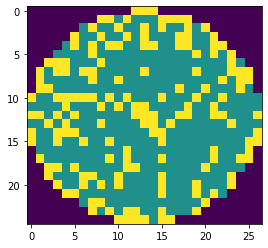

wafer_id:54594, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:39, nDefects:123, p=31.707


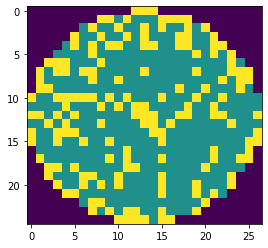

wafer_id:54594, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:39, nDefects:123, p=31.707


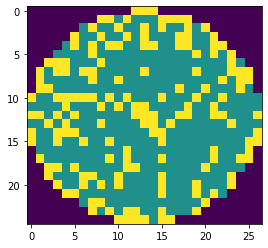

wafer_id:54612, ウエハサイズ:25x27, スタンプサイズ:2x3, oDefects:44, nDefects:145, p=30.345


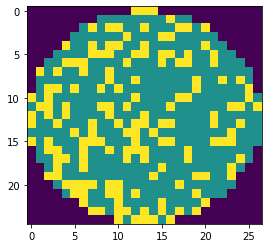

wafer_id:54612, ウエハサイズ:25x27, スタンプサイズ:3x3, oDefects:44, nDefects:145, p=30.345


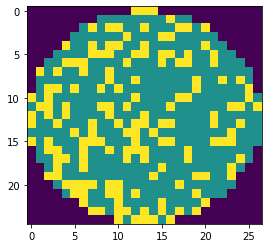

wafer_id:54612, ウエハサイズ:25x27, スタンプサイズ:4x3, oDefects:44, nDefects:145, p=30.345


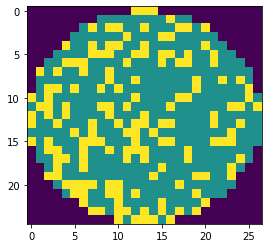

wafer_id:54628, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:29, nDefects:95, p=30.526


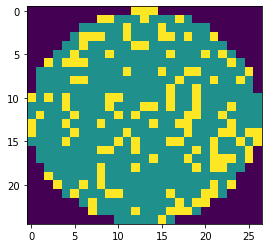

wafer_id:54628, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:29, nDefects:95, p=30.526


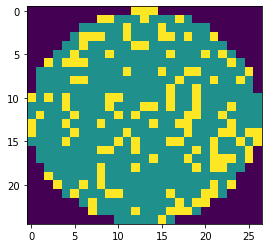

wafer_id:54628, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:29, nDefects:95, p=30.526


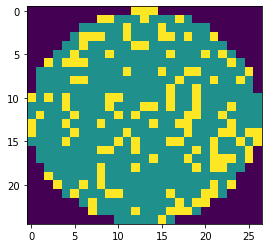

wafer_id:54749, ウエハサイズ:25x27, スタンプサイズ:2x3, oDefects:41, nDefects:136, p=30.147


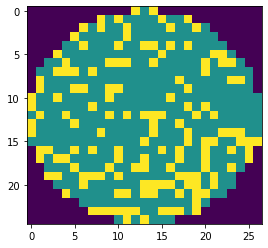

wafer_id:54749, ウエハサイズ:25x27, スタンプサイズ:3x3, oDefects:41, nDefects:136, p=30.147


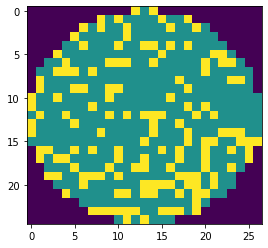

wafer_id:54749, ウエハサイズ:25x27, スタンプサイズ:4x3, oDefects:41, nDefects:136, p=30.147


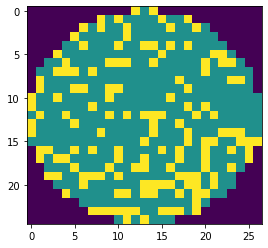

wafer_id:54757, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:37, nDefects:114, p=32.456


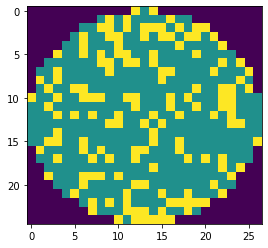

wafer_id:54757, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:37, nDefects:114, p=32.456


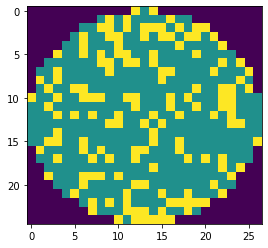

wafer_id:54757, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:37, nDefects:114, p=32.456


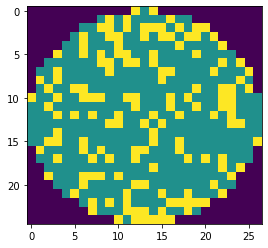

wafer_id:54794, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:41, nDefects:122, p=33.607


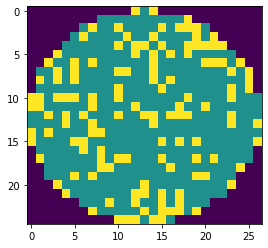

wafer_id:54794, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:41, nDefects:122, p=33.607


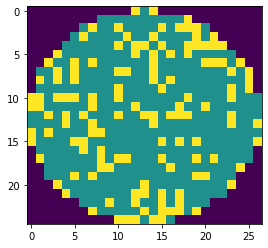

wafer_id:54794, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:41, nDefects:122, p=33.607


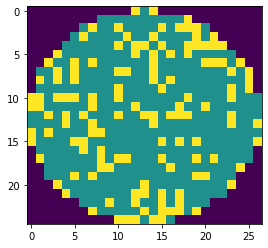

(25, 27)
wafer_id:55031, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:45, nDefects:147, p=30.612


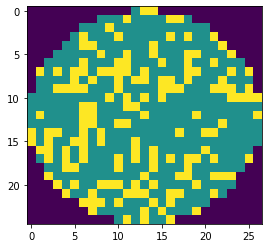

wafer_id:55031, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:45, nDefects:147, p=30.612


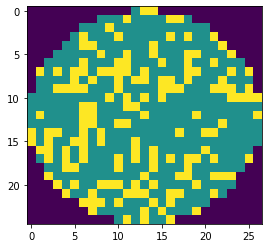

wafer_id:55031, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:45, nDefects:147, p=30.612


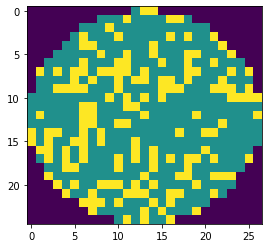

wafer_id:55031, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:44, nDefects:128, p=34.375


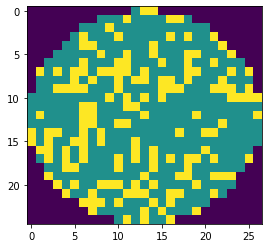

wafer_id:55031, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:44, nDefects:128, p=34.375


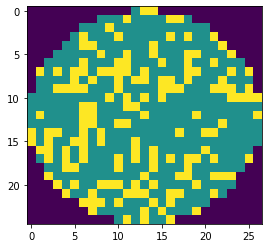

wafer_id:55031, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:44, nDefects:128, p=34.375


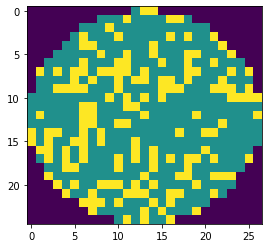

wafer_id:55340, ウエハサイズ:25x27, スタンプサイズ:2x3, oDefects:37, nDefects:119, p=31.092


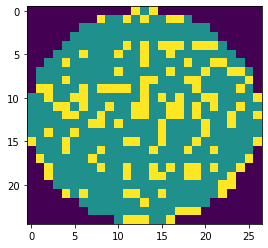

wafer_id:55340, ウエハサイズ:25x27, スタンプサイズ:3x3, oDefects:37, nDefects:119, p=31.092


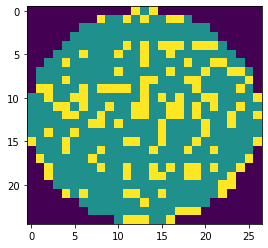

wafer_id:55340, ウエハサイズ:25x27, スタンプサイズ:4x3, oDefects:37, nDefects:119, p=31.092


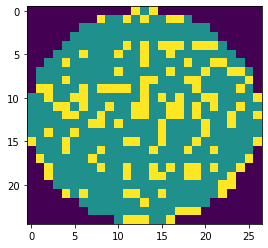

wafer_id:55831, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:44, nDefects:139, p=31.655


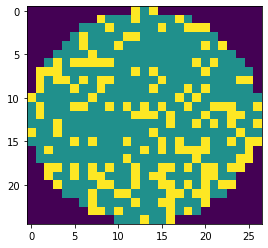

wafer_id:55831, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:44, nDefects:139, p=31.655


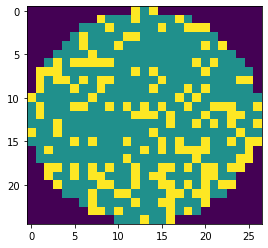

wafer_id:55831, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:44, nDefects:139, p=31.655


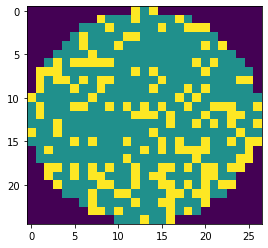

(25, 27)
wafer_id:56754, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:41, nDefects:135, p=30.370


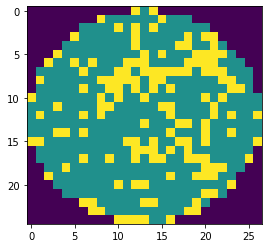

wafer_id:56754, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:41, nDefects:135, p=30.370


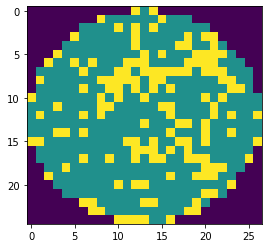

wafer_id:56754, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:41, nDefects:135, p=30.370


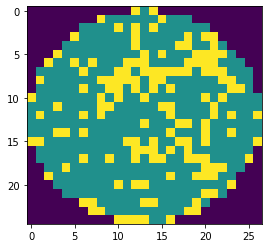

wafer_id:56841, ウエハサイズ:25x27, スタンプサイズ:2x3, oDefects:39, nDefects:128, p=30.469


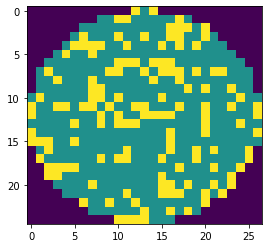

wafer_id:56841, ウエハサイズ:25x27, スタンプサイズ:3x3, oDefects:39, nDefects:128, p=30.469


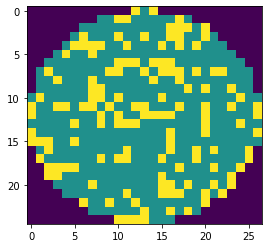

wafer_id:56841, ウエハサイズ:25x27, スタンプサイズ:4x3, oDefects:39, nDefects:128, p=30.469


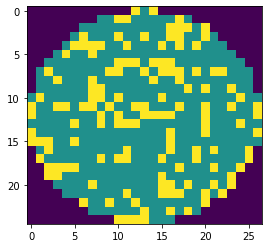

(25, 27)
wafer_id:57945, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:38, nDefects:122, p=31.148


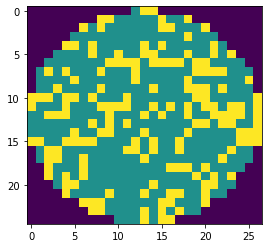

wafer_id:57945, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:38, nDefects:122, p=31.148


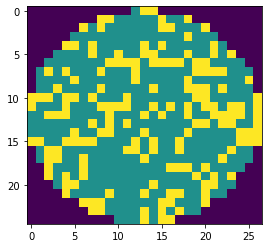

wafer_id:57945, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:38, nDefects:122, p=31.148


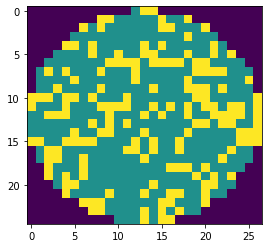

(25, 27)
wafer_id:58870, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:43, nDefects:131, p=32.824


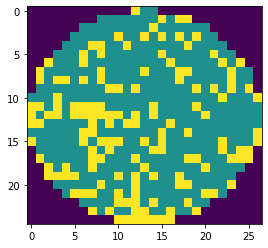

wafer_id:58870, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:43, nDefects:131, p=32.824


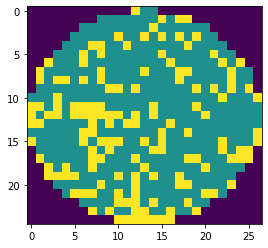

wafer_id:58870, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:43, nDefects:131, p=32.824


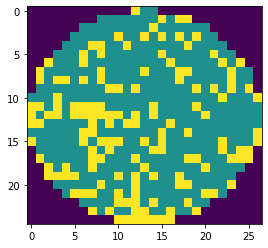

(25, 27)
wafer_id:59798, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:33, nDefects:102, p=32.353


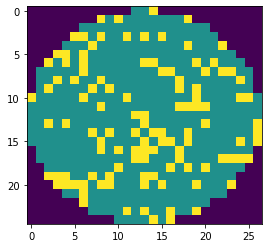

wafer_id:59798, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:33, nDefects:102, p=32.353


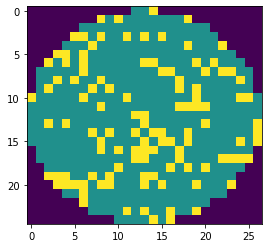

wafer_id:59798, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:33, nDefects:102, p=32.353


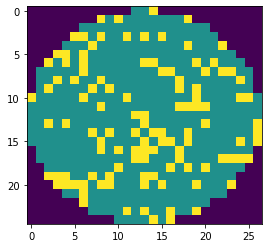

(25, 27)
wafer_id:60601, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:29, nDefects:96, p=30.208


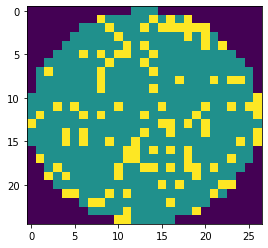

wafer_id:60601, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:29, nDefects:96, p=30.208


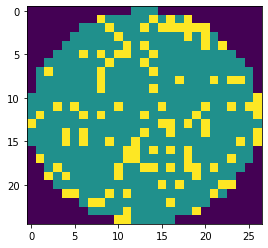

wafer_id:60601, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:29, nDefects:96, p=30.208


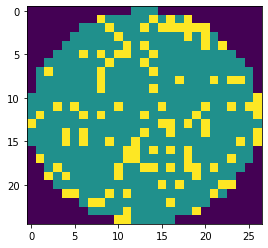

wafer_id:60741, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:43, nDefects:139, p=30.935


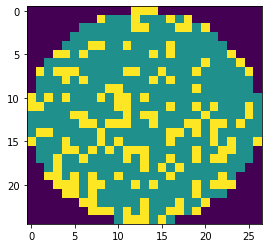

wafer_id:60741, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:43, nDefects:139, p=30.935


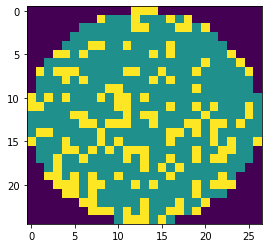

wafer_id:60741, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:43, nDefects:139, p=30.935


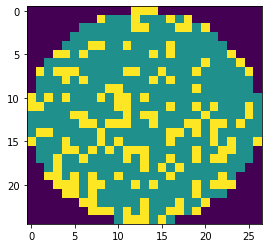

(25, 27)
wafer_id:61180, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:33, nDefects:106, p=31.132


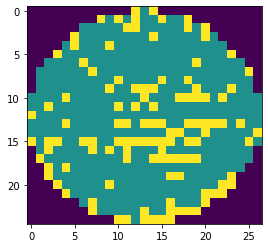

wafer_id:61180, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:33, nDefects:106, p=31.132


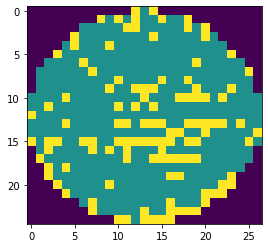

wafer_id:61180, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:33, nDefects:106, p=31.132


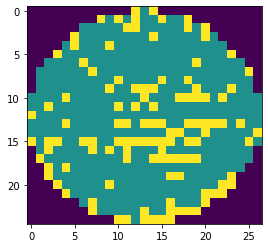

wafer_id:61180, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:29, nDefects:89, p=32.584


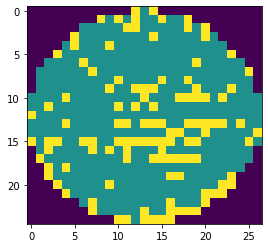

wafer_id:61180, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:29, nDefects:89, p=32.584


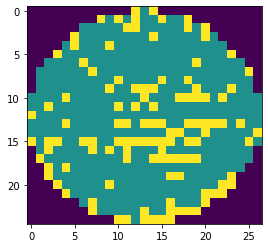

wafer_id:61180, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:29, nDefects:89, p=32.584


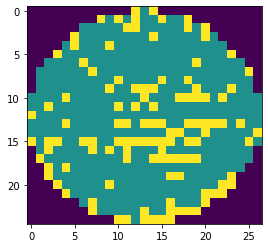

wafer_id:61583, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:26, nDefects:86, p=30.233


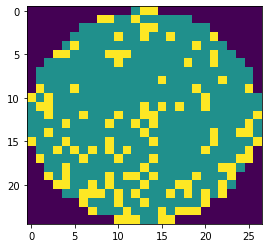

wafer_id:61583, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:26, nDefects:86, p=30.233


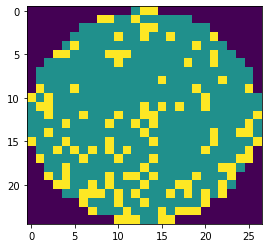

wafer_id:61583, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:26, nDefects:86, p=30.233


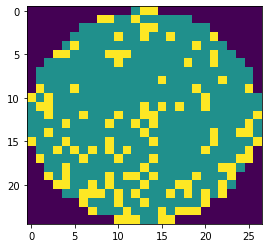

(25, 27)
(45, 42)
(45, 42)
wafer_id:64426, ウエハサイズ:45x42, スタンプサイズ:2x4, oDefects:62, nDefects:204, p=30.392


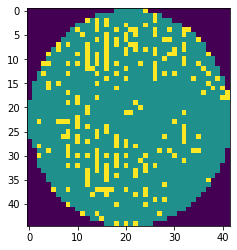

wafer_id:64426, ウエハサイズ:45x42, スタンプサイズ:3x4, oDefects:63, nDefects:207, p=30.435


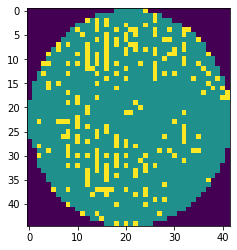

wafer_id:64426, ウエハサイズ:45x42, スタンプサイズ:4x4, oDefects:62, nDefects:204, p=30.392


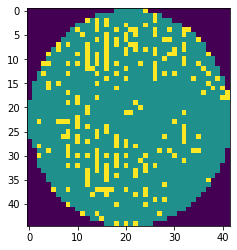

(45, 42)
wafer_id:65959, ウエハサイズ:41x40, スタンプサイズ:2x2, oDefects:90, nDefects:290, p=31.034


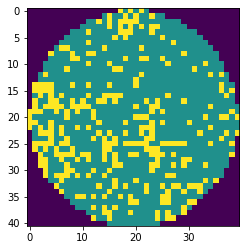

wafer_id:65959, ウエハサイズ:41x40, スタンプサイズ:3x2, oDefects:89, nDefects:285, p=31.228


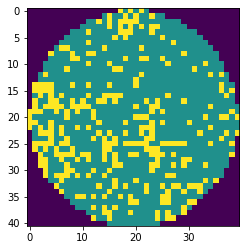

wafer_id:65959, ウエハサイズ:41x40, スタンプサイズ:4x2, oDefects:90, nDefects:290, p=31.034


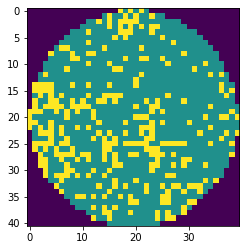

(41, 40)
(41, 40)
(34, 31)
(25, 26)
(25, 26)
wafer_id:70275, ウエハサイズ:25x26, スタンプサイズ:2x3, oDefects:39, nDefects:128, p=30.469


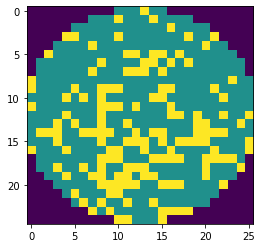

wafer_id:70275, ウエハサイズ:25x26, スタンプサイズ:3x3, oDefects:39, nDefects:128, p=30.469


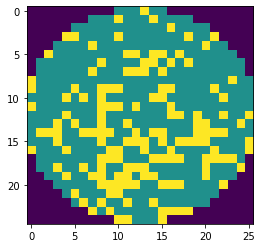

wafer_id:70275, ウエハサイズ:25x26, スタンプサイズ:4x3, oDefects:39, nDefects:128, p=30.469


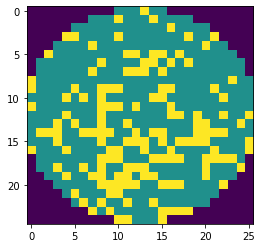

wafer_id:70353, ウエハサイズ:25x26, スタンプサイズ:2x2, oDefects:35, nDefects:112, p=31.250


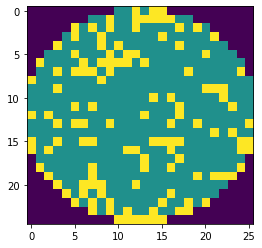

wafer_id:70353, ウエハサイズ:25x26, スタンプサイズ:3x2, oDefects:35, nDefects:112, p=31.250


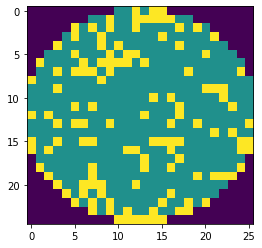

wafer_id:70353, ウエハサイズ:25x26, スタンプサイズ:4x2, oDefects:35, nDefects:112, p=31.250


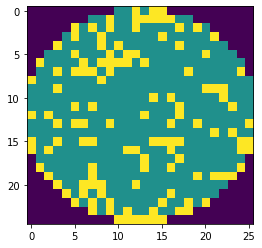

wafer_id:70597, ウエハサイズ:25x26, スタンプサイズ:2x2, oDefects:38, nDefects:121, p=31.405


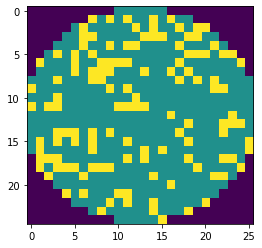

wafer_id:70597, ウエハサイズ:25x26, スタンプサイズ:3x2, oDefects:38, nDefects:121, p=31.405


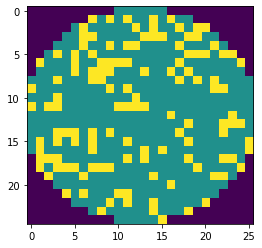

wafer_id:70597, ウエハサイズ:25x26, スタンプサイズ:4x2, oDefects:38, nDefects:121, p=31.405


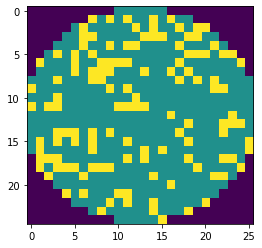

(25, 26)
wafer_id:71057, ウエハサイズ:25x26, スタンプサイズ:2x2, oDefects:50, nDefects:153, p=32.680


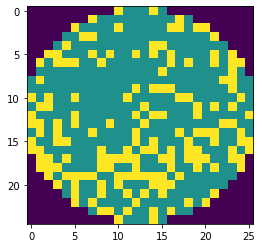

wafer_id:71057, ウエハサイズ:25x26, スタンプサイズ:3x2, oDefects:50, nDefects:153, p=32.680


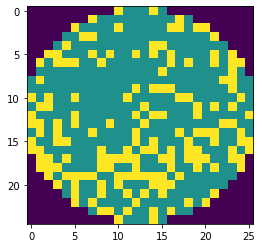

wafer_id:71057, ウエハサイズ:25x26, スタンプサイズ:4x2, oDefects:50, nDefects:153, p=32.680


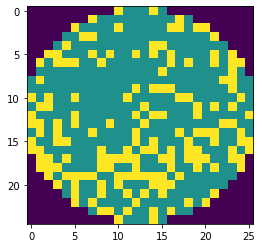

wafer_id:71897, ウエハサイズ:25x26, スタンプサイズ:2x2, oDefects:29, nDefects:94, p=30.851


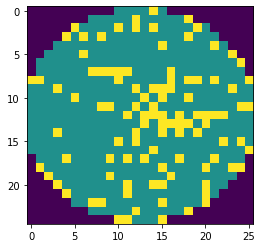

wafer_id:71897, ウエハサイズ:25x26, スタンプサイズ:3x2, oDefects:29, nDefects:94, p=30.851


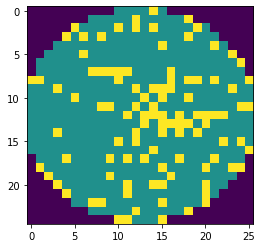

wafer_id:71897, ウエハサイズ:25x26, スタンプサイズ:4x2, oDefects:29, nDefects:94, p=30.851


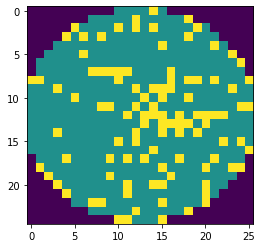

(25, 26)
(30, 34)
(30, 34)
(42, 43)
(33, 29)
wafer_id:76512, ウエハサイズ:33x29, スタンプサイズ:2x2, oDefects:70, nDefects:233, p=30.043


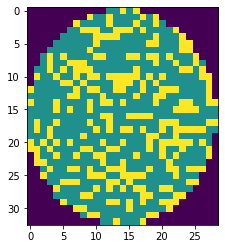

wafer_id:76512, ウエハサイズ:33x29, スタンプサイズ:4x2, oDefects:70, nDefects:233, p=30.043


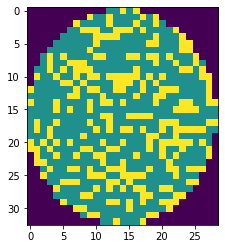

wafer_id:76512, ウエハサイズ:33x29, スタンプサイズ:2x3, oDefects:68, nDefects:218, p=31.193


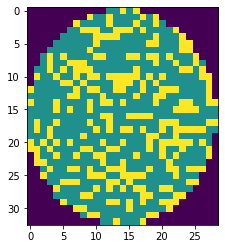

wafer_id:76512, ウエハサイズ:33x29, スタンプサイズ:3x3, oDefects:68, nDefects:220, p=30.909


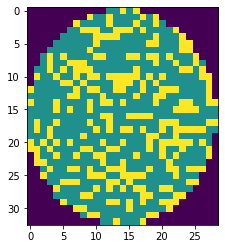

wafer_id:76512, ウエハサイズ:33x29, スタンプサイズ:4x3, oDefects:68, nDefects:218, p=31.193


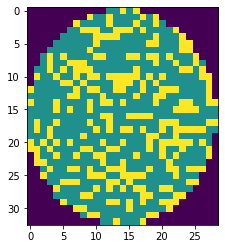

(33, 29)
(33, 29)
(33, 29)
wafer_id:79462, ウエハサイズ:33x29, スタンプサイズ:2x3, oDefects:78, nDefects:232, p=33.621


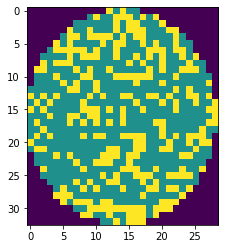

wafer_id:79462, ウエハサイズ:33x29, スタンプサイズ:3x3, oDefects:79, nDefects:236, p=33.475


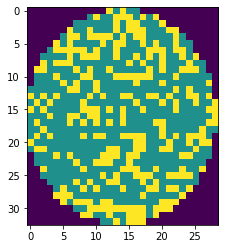

wafer_id:79462, ウエハサイズ:33x29, スタンプサイズ:4x3, oDefects:78, nDefects:232, p=33.621


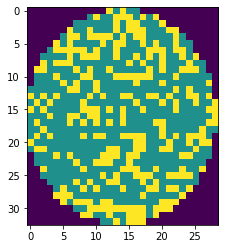

(33, 29)
(33, 29)
(33, 29)
(43, 44)
wafer_id:83853, ウエハサイズ:43x44, スタンプサイズ:2x3, oDefects:111, nDefects:368, p=30.163


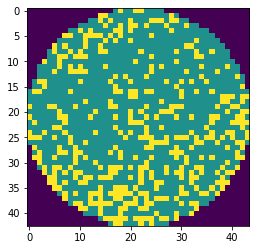

wafer_id:83853, ウエハサイズ:43x44, スタンプサイズ:3x3, oDefects:111, nDefects:368, p=30.163


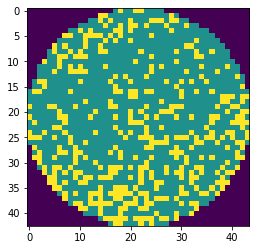

(43, 44)
(43, 44)
(43, 42)
wafer_id:86362, ウエハサイズ:43x42, スタンプサイズ:2x2, oDefects:132, nDefects:401, p=32.918


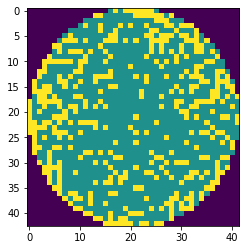

wafer_id:86362, ウエハサイズ:43x42, スタンプサイズ:3x2, oDefects:132, nDefects:401, p=32.918


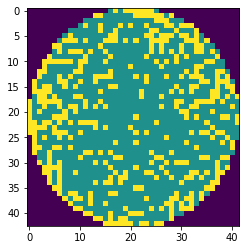

wafer_id:86362, ウエハサイズ:43x42, スタンプサイズ:4x2, oDefects:129, nDefects:388, p=33.247


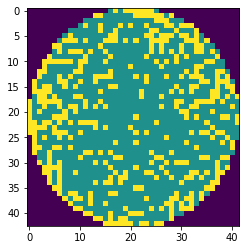

wafer_id:86393, ウエハサイズ:43x42, スタンプサイズ:2x3, oDefects:97, nDefects:319, p=30.408


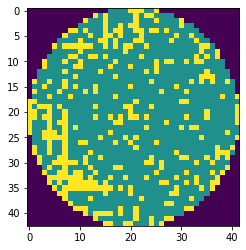

wafer_id:86393, ウエハサイズ:43x42, スタンプサイズ:3x3, oDefects:97, nDefects:319, p=30.408


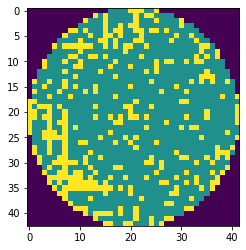

(22, 50)
(27, 25)
wafer_id:88516, ウエハサイズ:27x25, スタンプサイズ:2x2, oDefects:41, nDefects:125, p=32.800


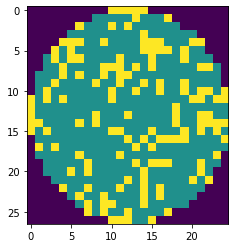

wafer_id:88516, ウエハサイズ:27x25, スタンプサイズ:3x2, oDefects:42, nDefects:129, p=32.558


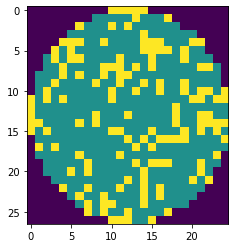

wafer_id:88516, ウエハサイズ:27x25, スタンプサイズ:4x2, oDefects:39, nDefects:117, p=33.333


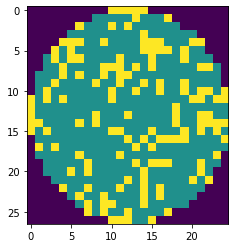

(27, 25)
wafer_id:89004, ウエハサイズ:27x25, スタンプサイズ:2x2, oDefects:32, nDefects:104, p=30.769


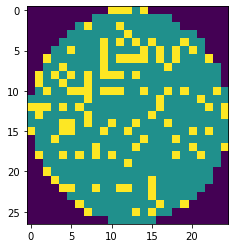

wafer_id:89004, ウエハサイズ:27x25, スタンプサイズ:3x2, oDefects:32, nDefects:104, p=30.769


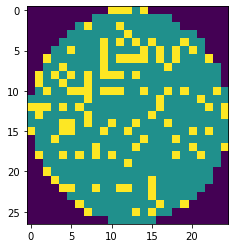

wafer_id:89004, ウエハサイズ:27x25, スタンプサイズ:4x2, oDefects:31, nDefects:98, p=31.633


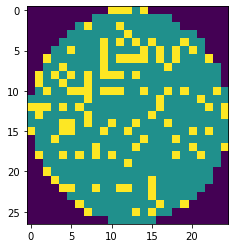

wafer_id:89004, ウエハサイズ:27x25, スタンプサイズ:2x4, oDefects:34, nDefects:99, p=34.343


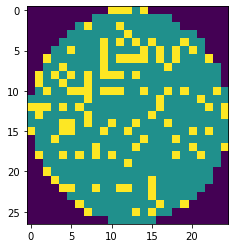

wafer_id:89004, ウエハサイズ:27x25, スタンプサイズ:3x4, oDefects:34, nDefects:99, p=34.343


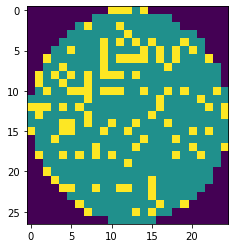

wafer_id:89536, ウエハサイズ:27x25, スタンプサイズ:3x2, oDefects:29, nDefects:95, p=30.526


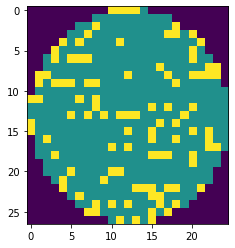

wafer_id:89594, ウエハサイズ:27x25, スタンプサイズ:3x2, oDefects:35, nDefects:116, p=30.172


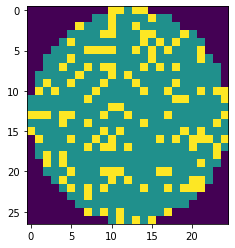

wafer_id:89737, ウエハサイズ:27x25, スタンプサイズ:2x2, oDefects:47, nDefects:143, p=32.867


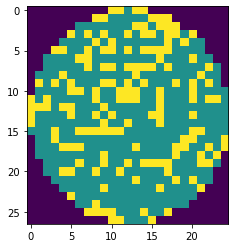

wafer_id:89737, ウエハサイズ:27x25, スタンプサイズ:3x2, oDefects:47, nDefects:146, p=32.192


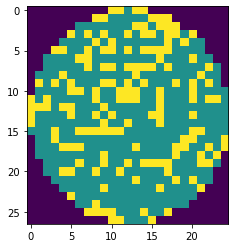

wafer_id:89737, ウエハサイズ:27x25, スタンプサイズ:4x2, oDefects:45, nDefects:136, p=33.088


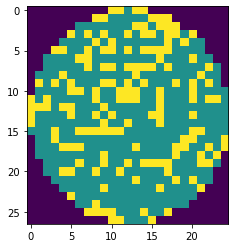

wafer_id:89737, ウエハサイズ:27x25, スタンプサイズ:2x3, oDefects:44, nDefects:138, p=31.884


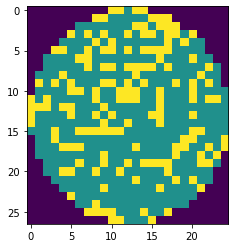

wafer_id:89737, ウエハサイズ:27x25, スタンプサイズ:3x3, oDefects:44, nDefects:141, p=31.206


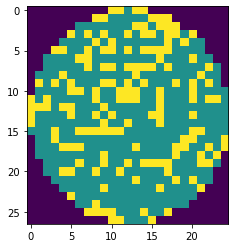

wafer_id:89737, ウエハサイズ:27x25, スタンプサイズ:4x3, oDefects:42, nDefects:131, p=32.061


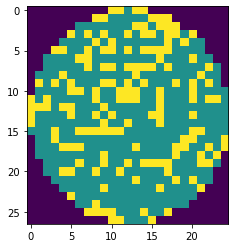

(27, 25)
wafer_id:90207, ウエハサイズ:27x25, スタンプサイズ:2x3, oDefects:28, nDefects:92, p=30.435


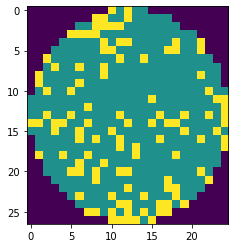

wafer_id:90207, ウエハサイズ:27x25, スタンプサイズ:3x3, oDefects:30, nDefects:97, p=30.928


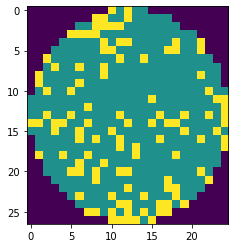

wafer_id:90207, ウエハサイズ:27x25, スタンプサイズ:4x3, oDefects:25, nDefects:80, p=31.250


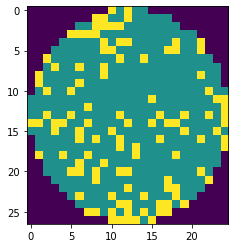

wafer_id:90229, ウエハサイズ:27x25, スタンプサイズ:2x3, oDefects:41, nDefects:128, p=32.031


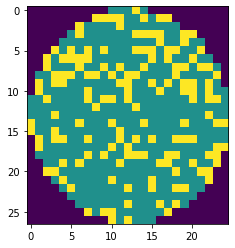

wafer_id:90229, ウエハサイズ:27x25, スタンプサイズ:3x3, oDefects:41, nDefects:130, p=31.538


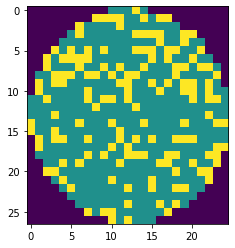

wafer_id:90229, ウエハサイズ:27x25, スタンプサイズ:4x3, oDefects:40, nDefects:121, p=33.058


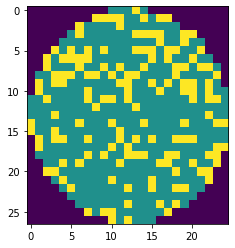

wafer_id:90437, ウエハサイズ:27x25, スタンプサイズ:4x4, oDefects:19, nDefects:63, p=30.159


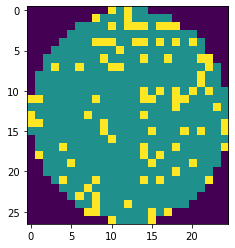

wafer_id:90897, ウエハサイズ:27x25, スタンプサイズ:2x2, oDefects:33, nDefects:105, p=31.429


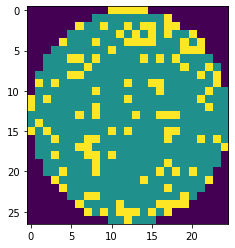

wafer_id:90897, ウエハサイズ:27x25, スタンプサイズ:3x2, oDefects:33, nDefects:106, p=31.132


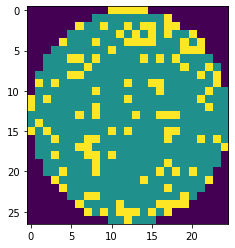

wafer_id:90977, ウエハサイズ:27x25, スタンプサイズ:4x4, oDefects:25, nDefects:83, p=30.120


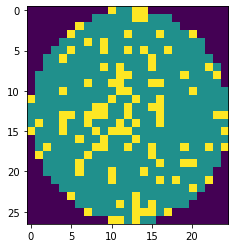

(27, 25)
wafer_id:91033, ウエハサイズ:27x25, スタンプサイズ:2x2, oDefects:40, nDefects:131, p=30.534


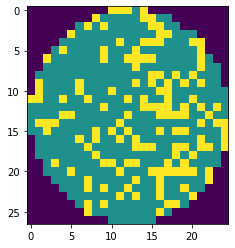

wafer_id:91033, ウエハサイズ:27x25, スタンプサイズ:3x2, oDefects:40, nDefects:131, p=30.534


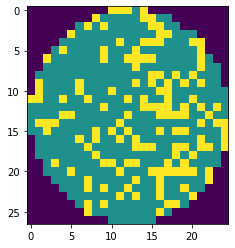

wafer_id:91033, ウエハサイズ:27x25, スタンプサイズ:4x2, oDefects:39, nDefects:125, p=31.200


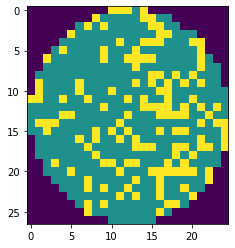

wafer_id:91291, ウエハサイズ:27x25, スタンプサイズ:2x4, oDefects:20, nDefects:60, p=33.333


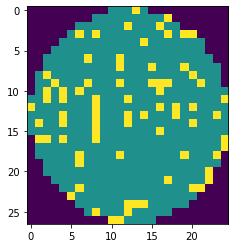

wafer_id:91291, ウエハサイズ:27x25, スタンプサイズ:3x4, oDefects:20, nDefects:62, p=32.258


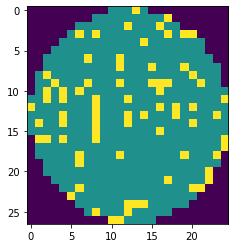

wafer_id:91291, ウエハサイズ:27x25, スタンプサイズ:4x4, oDefects:19, nDefects:55, p=34.545


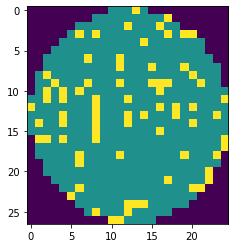

wafer_id:91796, ウエハサイズ:27x25, スタンプサイズ:2x4, oDefects:38, nDefects:110, p=34.545


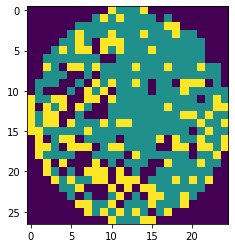

wafer_id:91796, ウエハサイズ:27x25, スタンプサイズ:3x4, oDefects:39, nDefects:113, p=34.513


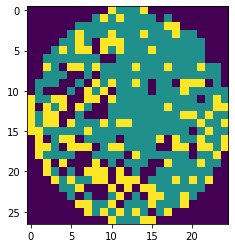

wafer_id:91796, ウエハサイズ:27x25, スタンプサイズ:4x4, oDefects:33, nDefects:100, p=33.000


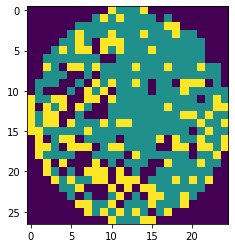

(27, 25)
wafer_id:92583, ウエハサイズ:27x25, スタンプサイズ:2x2, oDefects:32, nDefects:96, p=33.333


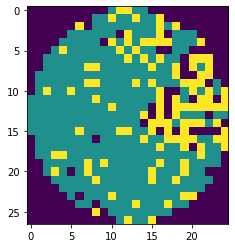

wafer_id:92583, ウエハサイズ:27x25, スタンプサイズ:3x2, oDefects:32, nDefects:98, p=32.653


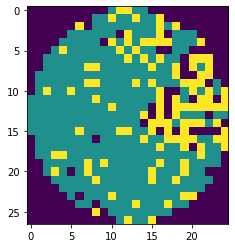

wafer_id:92583, ウエハサイズ:27x25, スタンプサイズ:4x2, oDefects:32, nDefects:93, p=34.409


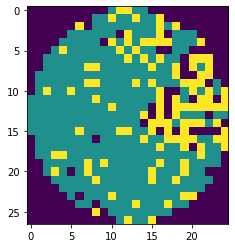

wafer_id:92583, ウエハサイズ:27x25, スタンプサイズ:2x4, oDefects:26, nDefects:79, p=32.911


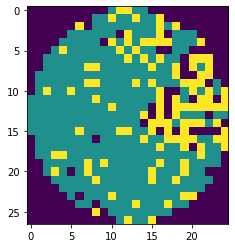

wafer_id:92583, ウエハサイズ:27x25, スタンプサイズ:3x4, oDefects:26, nDefects:81, p=32.099


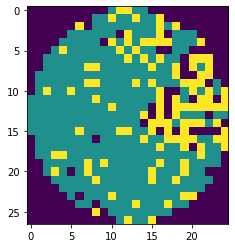

wafer_id:92583, ウエハサイズ:27x25, スタンプサイズ:4x4, oDefects:25, nDefects:76, p=32.895


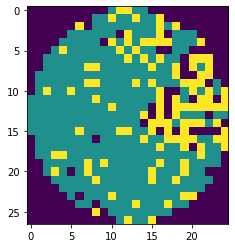

(27, 25)
wafer_id:93884, ウエハサイズ:27x25, スタンプサイズ:3x4, oDefects:22, nDefects:73, p=30.137


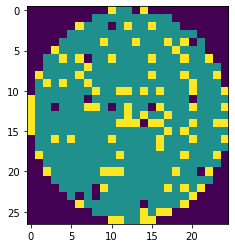

wafer_id:93884, ウエハサイズ:27x25, スタンプサイズ:4x4, oDefects:20, nDefects:64, p=31.250


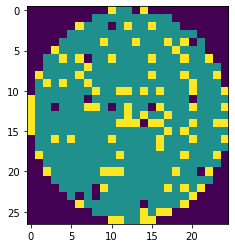

(27, 25)
wafer_id:94628, ウエハサイズ:27x25, スタンプサイズ:2x4, oDefects:20, nDefects:61, p=32.787


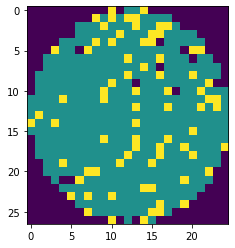

wafer_id:94628, ウエハサイズ:27x25, スタンプサイズ:3x4, oDefects:21, nDefects:63, p=33.333


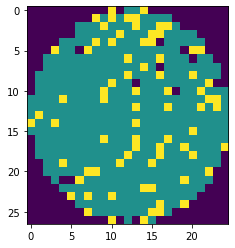

(27, 25)
wafer_id:95628, ウエハサイズ:27x25, スタンプサイズ:2x4, oDefects:18, nDefects:58, p=31.034


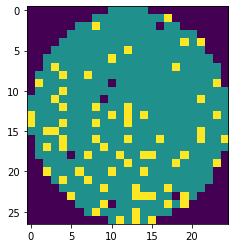

wafer_id:95628, ウエハサイズ:27x25, スタンプサイズ:3x4, oDefects:19, nDefects:61, p=31.148


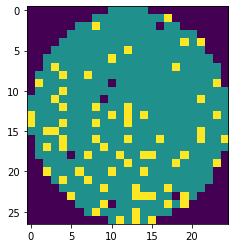

wafer_id:95628, ウエハサイズ:27x25, スタンプサイズ:4x4, oDefects:18, nDefects:53, p=33.962


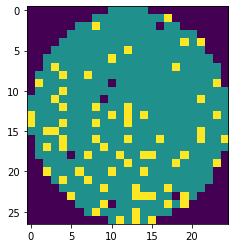

wafer_id:95963, ウエハサイズ:27x25, スタンプサイズ:3x4, oDefects:26, nDefects:75, p=34.667


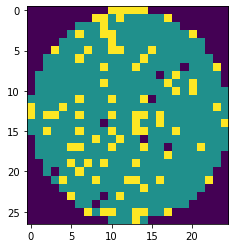

wafer_id:95963, ウエハサイズ:27x25, スタンプサイズ:4x4, oDefects:23, nDefects:68, p=33.824


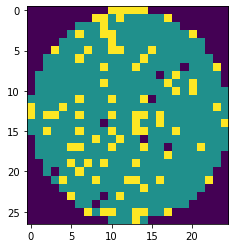

(27, 25)
wafer_id:96627, ウエハサイズ:27x25, スタンプサイズ:2x4, oDefects:19, nDefects:63, p=30.159


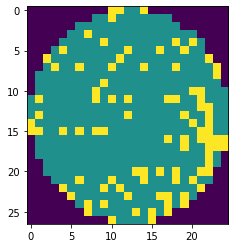

wafer_id:96627, ウエハサイズ:27x25, スタンプサイズ:4x4, oDefects:18, nDefects:55, p=32.727


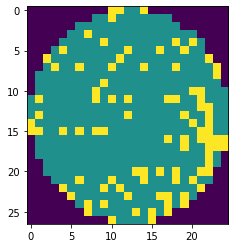

(27, 25)
wafer_id:97080, ウエハサイズ:27x25, スタンプサイズ:2x2, oDefects:23, nDefects:75, p=30.667


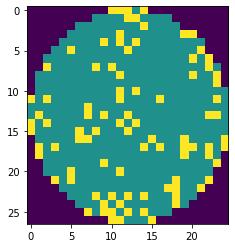

wafer_id:97095, ウエハサイズ:27x25, スタンプサイズ:2x2, oDefects:38, nDefects:122, p=31.148


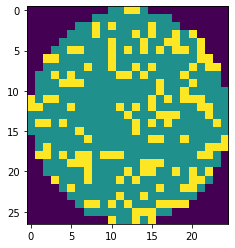

wafer_id:97095, ウエハサイズ:27x25, スタンプサイズ:3x2, oDefects:39, nDefects:125, p=31.200


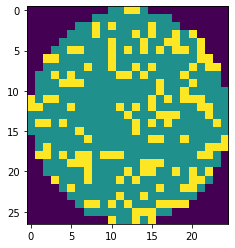

wafer_id:97439, ウエハサイズ:27x25, スタンプサイズ:2x4, oDefects:26, nDefects:82, p=31.707


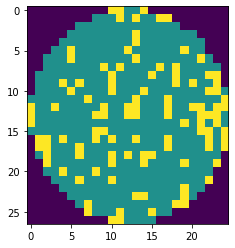

wafer_id:97439, ウエハサイズ:27x25, スタンプサイズ:3x4, oDefects:26, nDefects:84, p=30.952


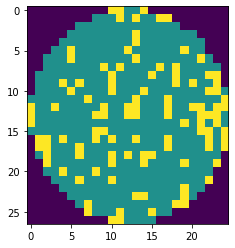

wafer_id:97439, ウエハサイズ:27x25, スタンプサイズ:4x4, oDefects:24, nDefects:76, p=31.579


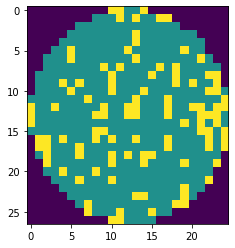

(39, 37)
(39, 37)
(39, 37)
(39, 37)
wafer_id:101166, ウエハサイズ:39x37, スタンプサイズ:2x2, oDefects:98, nDefects:320, p=30.625


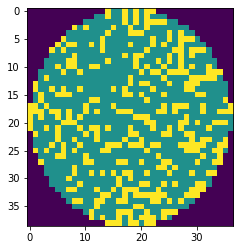

wafer_id:101166, ウエハサイズ:39x37, スタンプサイズ:3x2, oDefects:101, nDefects:327, p=30.887


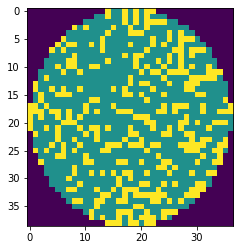

(39, 37)
(39, 37)
wafer_id:103665, ウエハサイズ:39x37, スタンプサイズ:3x3, oDefects:74, nDefects:242, p=30.579


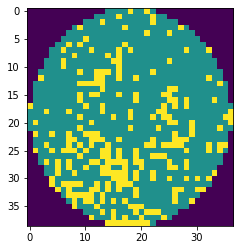

wafer_id:103665, ウエハサイズ:39x37, スタンプサイズ:4x3, oDefects:67, nDefects:223, p=30.045


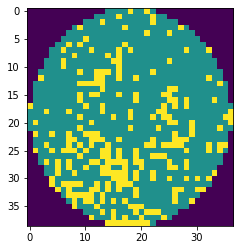

wafer_id:103765, ウエハサイズ:39x37, スタンプサイズ:4x2, oDefects:78, nDefects:257, p=30.350


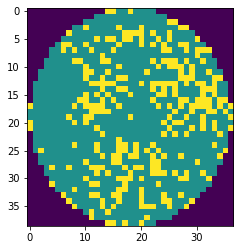

wafer_id:103790, ウエハサイズ:39x37, スタンプサイズ:2x2, oDefects:99, nDefects:287, p=34.495


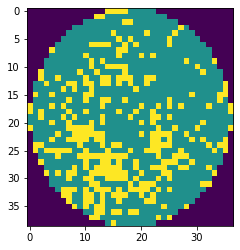

wafer_id:103790, ウエハサイズ:39x37, スタンプサイズ:3x2, oDefects:99, nDefects:288, p=34.375


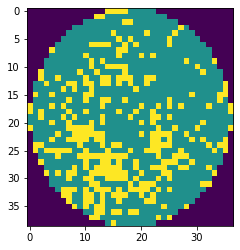

wafer_id:103790, ウエハサイズ:39x37, スタンプサイズ:4x2, oDefects:96, nDefects:277, p=34.657


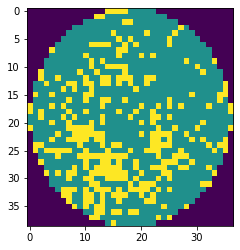

wafer_id:103790, ウエハサイズ:39x37, スタンプサイズ:2x3, oDefects:98, nDefects:284, p=34.507


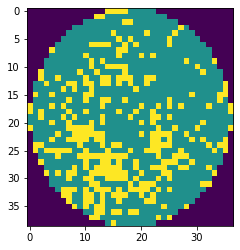

wafer_id:103790, ウエハサイズ:39x37, スタンプサイズ:3x3, oDefects:98, nDefects:285, p=34.386


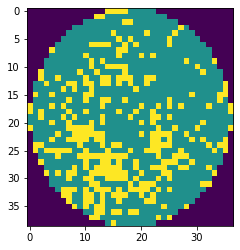

wafer_id:103790, ウエハサイズ:39x37, スタンプサイズ:4x3, oDefects:94, nDefects:274, p=34.307


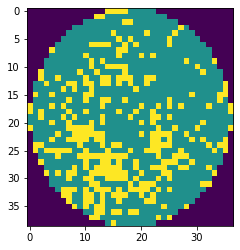

wafer_id:103790, ウエハサイズ:39x37, スタンプサイズ:2x4, oDefects:88, nDefects:280, p=31.429


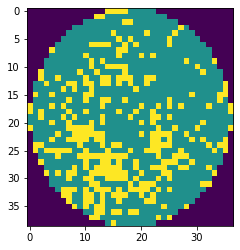

wafer_id:103790, ウエハサイズ:39x37, スタンプサイズ:3x4, oDefects:88, nDefects:281, p=31.317


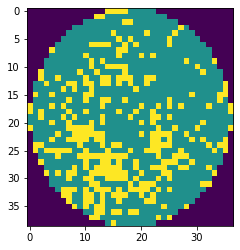

wafer_id:103790, ウエハサイズ:39x37, スタンプサイズ:4x4, oDefects:86, nDefects:270, p=31.852


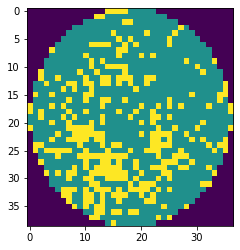

wafer_id:103949, ウエハサイズ:39x37, スタンプサイズ:2x2, oDefects:88, nDefects:287, p=30.662


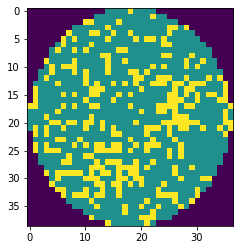

wafer_id:103949, ウエハサイズ:39x37, スタンプサイズ:3x2, oDefects:88, nDefects:289, p=30.450


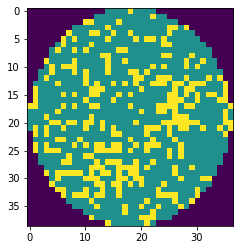

wafer_id:103949, ウエハサイズ:39x37, スタンプサイズ:4x2, oDefects:87, nDefects:281, p=30.961


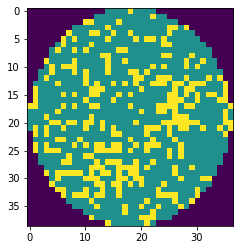

wafer_id:103949, ウエハサイズ:39x37, スタンプサイズ:2x3, oDefects:86, nDefects:286, p=30.070


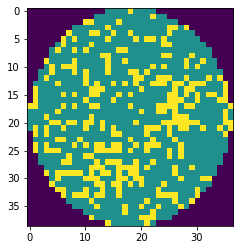

wafer_id:103949, ウエハサイズ:39x37, スタンプサイズ:4x3, oDefects:86, nDefects:280, p=30.714


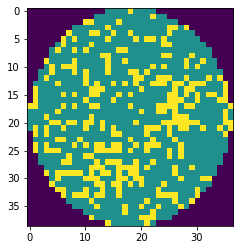

(39, 37)
(34, 34)
(44, 41)
(44, 41)
(44, 41)
(44, 41)
(44, 41)
(44, 41)
wafer_id:111067, ウエハサイズ:44x41, スタンプサイズ:2x2, oDefects:105, nDefects:349, p=30.086


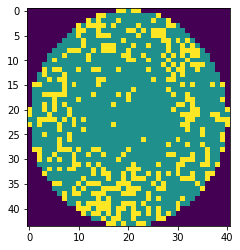

wafer_id:111067, ウエハサイズ:44x41, スタンプサイズ:3x2, oDefects:103, nDefects:338, p=30.473


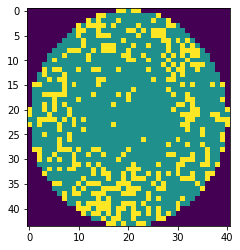

wafer_id:111067, ウエハサイズ:44x41, スタンプサイズ:4x2, oDefects:105, nDefects:349, p=30.086


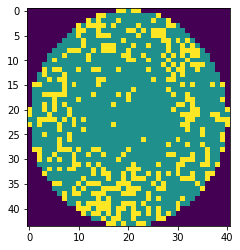

(41, 42)
wafer_id:112309, ウエハサイズ:41x42, スタンプサイズ:2x3, oDefects:148, nDefects:453, p=32.671


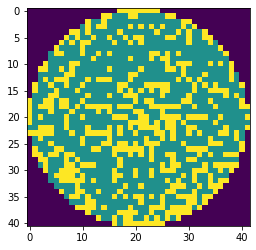

wafer_id:112309, ウエハサイズ:41x42, スタンプサイズ:3x3, oDefects:145, nDefects:445, p=32.584


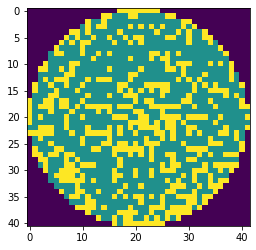

wafer_id:112309, ウエハサイズ:41x42, スタンプサイズ:4x3, oDefects:148, nDefects:453, p=32.671


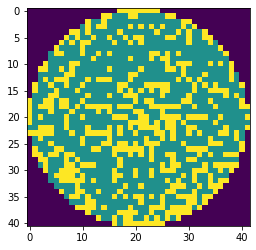

wafer_id:112309, ウエハサイズ:41x42, スタンプサイズ:2x4, oDefects:143, nDefects:428, p=33.411


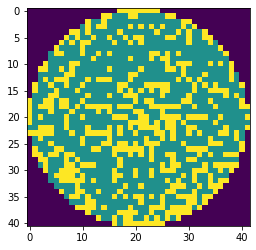

wafer_id:112309, ウエハサイズ:41x42, スタンプサイズ:3x4, oDefects:140, nDefects:420, p=33.333


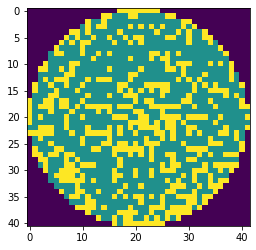

wafer_id:112309, ウエハサイズ:41x42, スタンプサイズ:4x4, oDefects:143, nDefects:428, p=33.411


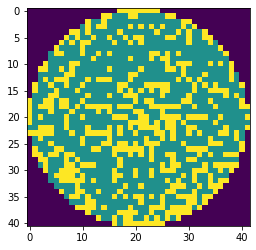

wafer_id:112311, ウエハサイズ:41x42, スタンプサイズ:2x2, oDefects:143, nDefects:424, p=33.726


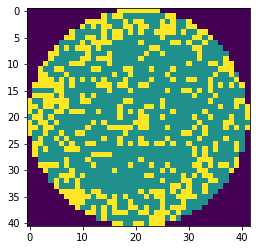

wafer_id:112311, ウエハサイズ:41x42, スタンプサイズ:3x2, oDefects:141, nDefects:419, p=33.652


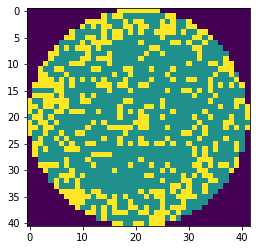

wafer_id:112311, ウエハサイズ:41x42, スタンプサイズ:4x2, oDefects:143, nDefects:424, p=33.726


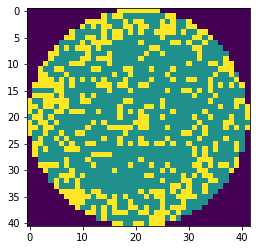

wafer_id:112311, ウエハサイズ:41x42, スタンプサイズ:2x3, oDefects:131, nDefects:416, p=31.490


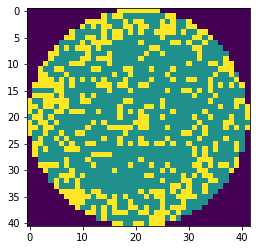

wafer_id:112311, ウエハサイズ:41x42, スタンプサイズ:3x3, oDefects:130, nDefects:411, p=31.630


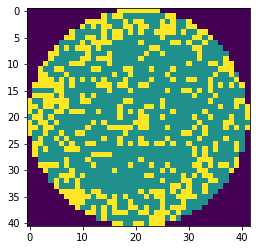

wafer_id:112311, ウエハサイズ:41x42, スタンプサイズ:4x3, oDefects:131, nDefects:416, p=31.490


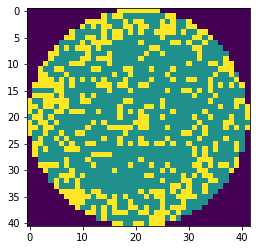

wafer_id:112311, ウエハサイズ:41x42, スタンプサイズ:2x4, oDefects:127, nDefects:398, p=31.910


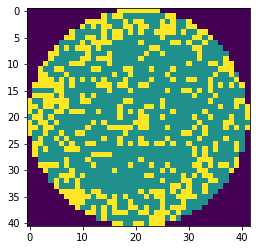

wafer_id:112311, ウエハサイズ:41x42, スタンプサイズ:3x4, oDefects:126, nDefects:393, p=32.061


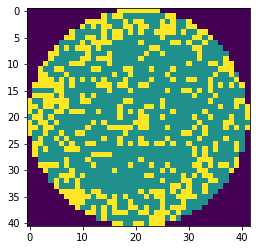

wafer_id:112311, ウエハサイズ:41x42, スタンプサイズ:4x4, oDefects:127, nDefects:398, p=31.910


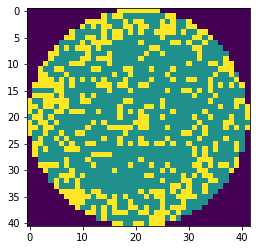

(41, 45)
(41, 45)
wafer_id:114083, ウエハサイズ:41x45, スタンプサイズ:2x4, oDefects:31, nDefects:97, p=31.959


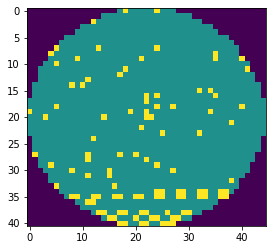

wafer_id:114083, ウエハサイズ:41x45, スタンプサイズ:3x4, oDefects:27, nDefects:90, p=30.000


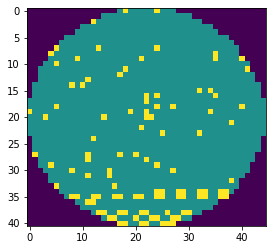

wafer_id:114083, ウエハサイズ:41x45, スタンプサイズ:4x4, oDefects:31, nDefects:97, p=31.959


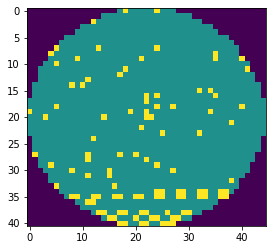

wafer_id:114432, ウエハサイズ:41x45, スタンプサイズ:2x2, oDefects:164, nDefects:482, p=34.025


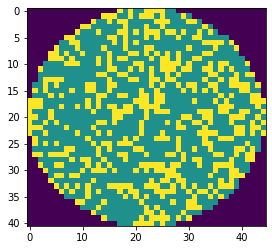

wafer_id:114432, ウエハサイズ:41x45, スタンプサイズ:3x2, oDefects:159, nDefects:474, p=33.544


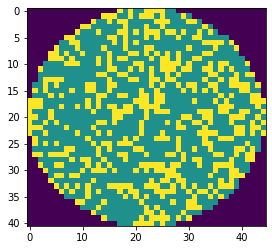

wafer_id:114432, ウエハサイズ:41x45, スタンプサイズ:4x2, oDefects:164, nDefects:482, p=34.025


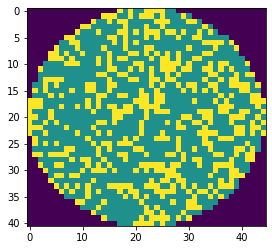

wafer_id:114432, ウエハサイズ:41x45, スタンプサイズ:2x4, oDefects:147, nDefects:466, p=31.545


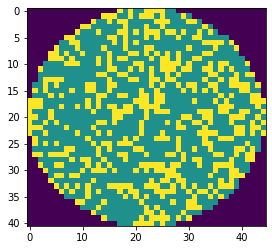

wafer_id:114432, ウエハサイズ:41x45, スタンプサイズ:3x4, oDefects:144, nDefects:458, p=31.441


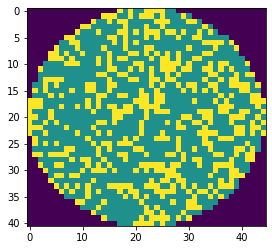

wafer_id:114432, ウエハサイズ:41x45, スタンプサイズ:4x4, oDefects:147, nDefects:466, p=31.545


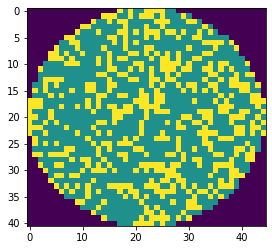

wafer_id:114787, ウエハサイズ:39x50, スタンプサイズ:3x4, oDefects:129, nDefects:427, p=30.211


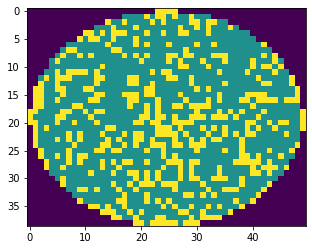

wafer_id:114790, ウエハサイズ:39x50, スタンプサイズ:2x2, oDefects:122, nDefects:405, p=30.123


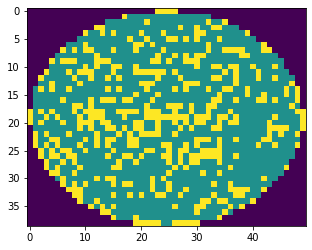

wafer_id:114790, ウエハサイズ:39x50, スタンプサイズ:3x2, oDefects:128, nDefects:415, p=30.843


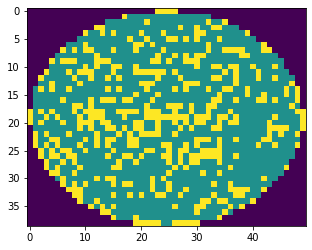

wafer_id:114790, ウエハサイズ:39x50, スタンプサイズ:4x2, oDefects:122, nDefects:398, p=30.653


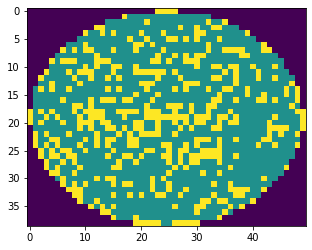

wafer_id:114790, ウエハサイズ:39x50, スタンプサイズ:2x3, oDefects:124, nDefects:397, p=31.234


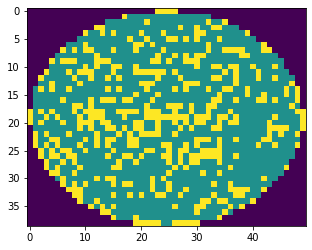

wafer_id:114790, ウエハサイズ:39x50, スタンプサイズ:3x3, oDefects:129, nDefects:407, p=31.695


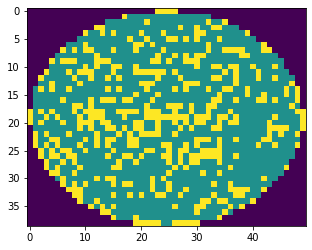

wafer_id:114790, ウエハサイズ:39x50, スタンプサイズ:4x3, oDefects:124, nDefects:390, p=31.795


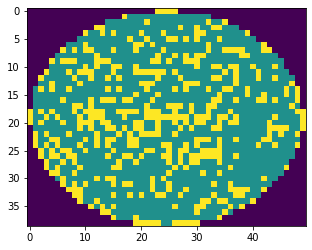

wafer_id:114790, ウエハサイズ:39x50, スタンプサイズ:2x4, oDefects:122, nDefects:391, p=31.202


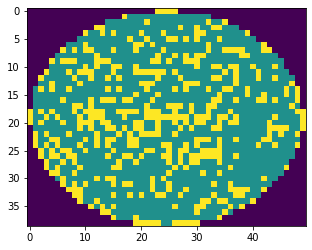

wafer_id:114790, ウエハサイズ:39x50, スタンプサイズ:3x4, oDefects:126, nDefects:401, p=31.421


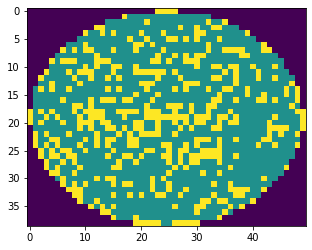

wafer_id:114790, ウエハサイズ:39x50, スタンプサイズ:4x4, oDefects:121, nDefects:384, p=31.510


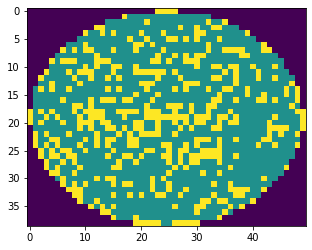

wafer_id:114794, ウエハサイズ:39x50, スタンプサイズ:2x2, oDefects:131, nDefects:418, p=31.340


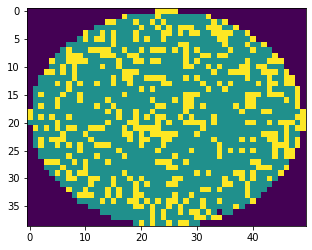

wafer_id:114794, ウエハサイズ:39x50, スタンプサイズ:3x2, oDefects:133, nDefects:423, p=31.442


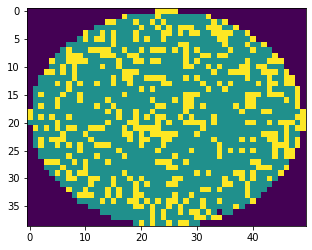

wafer_id:114794, ウエハサイズ:39x50, スタンプサイズ:4x2, oDefects:126, nDefects:406, p=31.034


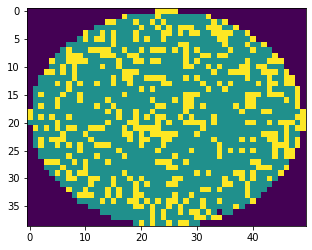

wafer_id:114794, ウエハサイズ:39x50, スタンプサイズ:2x3, oDefects:119, nDefects:396, p=30.051


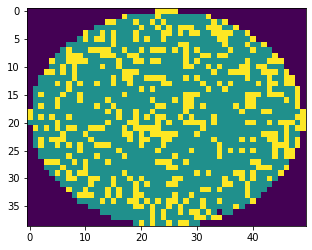

wafer_id:114794, ウエハサイズ:39x50, スタンプサイズ:3x3, oDefects:121, nDefects:401, p=30.175


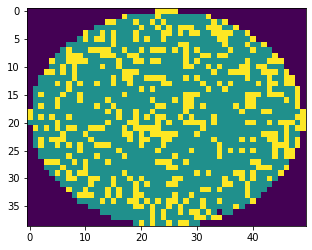

wafer_id:114808, ウエハサイズ:39x50, スタンプサイズ:2x3, oDefects:109, nDefects:353, p=30.878


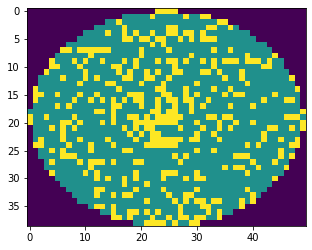

wafer_id:114808, ウエハサイズ:39x50, スタンプサイズ:3x3, oDefects:112, nDefects:360, p=31.111


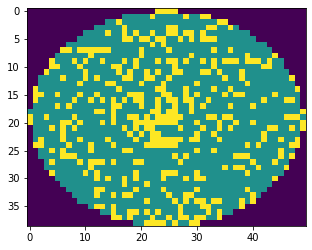

wafer_id:114808, ウエハサイズ:39x50, スタンプサイズ:4x3, oDefects:101, nDefects:335, p=30.149


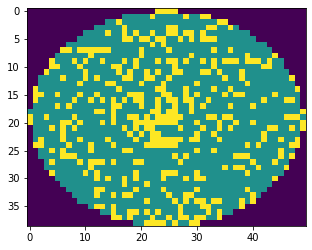

(39, 50)
wafer_id:115087, ウエハサイズ:22x50, スタンプサイズ:3x3, oDefects:99, nDefects:289, p=34.256


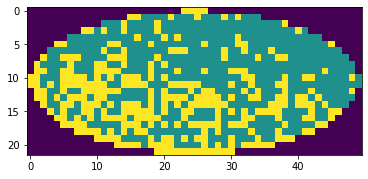

wafer_id:115087, ウエハサイズ:22x50, スタンプサイズ:4x3, oDefects:92, nDefects:273, p=33.700


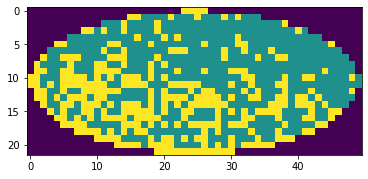

wafer_id:115088, ウエハサイズ:22x50, スタンプサイズ:3x2, oDefects:70, nDefects:210, p=33.333


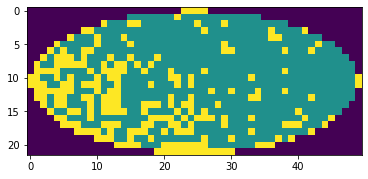

wafer_id:115088, ウエハサイズ:22x50, スタンプサイズ:4x2, oDefects:62, nDefects:196, p=31.633


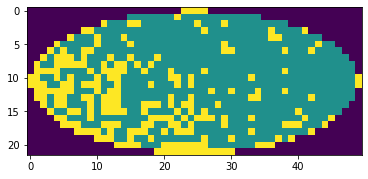

wafer_id:115088, ウエハサイズ:22x50, スタンプサイズ:2x3, oDefects:69, nDefects:221, p=31.222


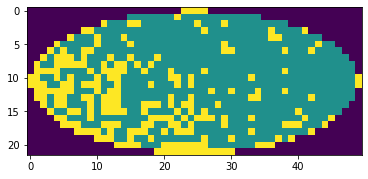

wafer_id:115088, ウエハサイズ:22x50, スタンプサイズ:2x4, oDefects:76, nDefects:220, p=34.545


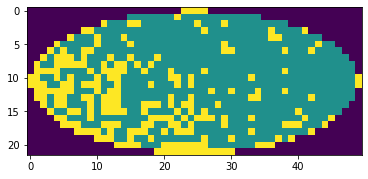

wafer_id:115088, ウエハサイズ:22x50, スタンプサイズ:3x4, oDefects:68, nDefects:208, p=32.692


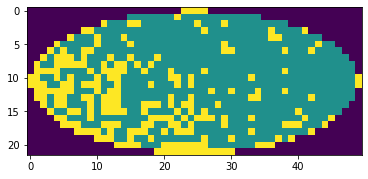

wafer_id:115088, ウエハサイズ:22x50, スタンプサイズ:4x4, oDefects:64, nDefects:194, p=32.990


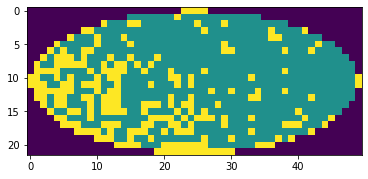

wafer_id:115089, ウエハサイズ:22x50, スタンプサイズ:2x2, oDefects:76, nDefects:220, p=34.545


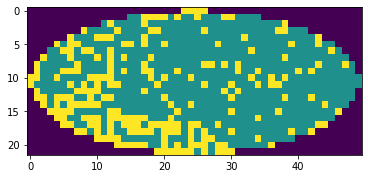

wafer_id:115089, ウエハサイズ:22x50, スタンプサイズ:3x2, oDefects:69, nDefects:210, p=32.857


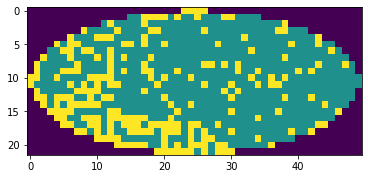

wafer_id:115089, ウエハサイズ:22x50, スタンプサイズ:4x2, oDefects:62, nDefects:197, p=31.472


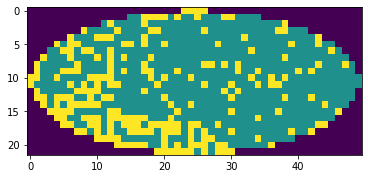

wafer_id:115089, ウエハサイズ:22x50, スタンプサイズ:2x4, oDefects:67, nDefects:215, p=31.163


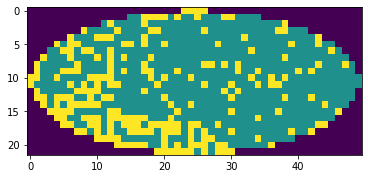

wafer_id:115089, ウエハサイズ:22x50, スタンプサイズ:3x4, oDefects:62, nDefects:205, p=30.244


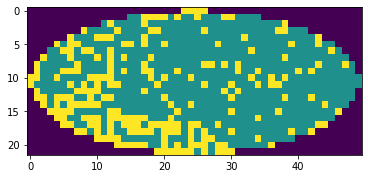

(42, 44)
(42, 44)
(42, 44)
(42, 44)
wafer_id:119801, ウエハサイズ:42x44, スタンプサイズ:2x2, oDefects:12, nDefects:38, p=31.579


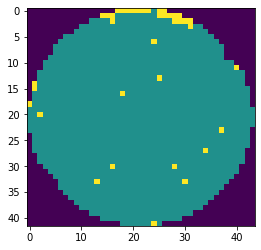

wafer_id:119801, ウエハサイズ:42x44, スタンプサイズ:3x2, oDefects:12, nDefects:38, p=31.579


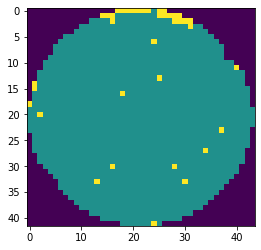

wafer_id:119801, ウエハサイズ:42x44, スタンプサイズ:4x2, oDefects:12, nDefects:37, p=32.432


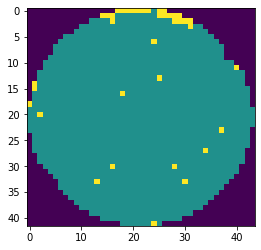

(42, 44)
(42, 44)
(42, 44)
(33, 37)
(33, 37)
(33, 37)
(33, 37)
(51, 30)
(51, 30)
(45, 43)
(29, 26)
(29, 26)
(29, 26)
(29, 26)
(29, 26)
(29, 26)
(29, 26)
(29, 26)
(29, 26)
(29, 26)
(29, 26)
(33, 35)
(41, 33)
(41, 33)
(41, 33)
(41, 33)
(41, 33)
wafer_id:146445, ウエハサイズ:26x30, スタンプサイズ:2x2, oDefects:16, nDefects:53, p=30.189


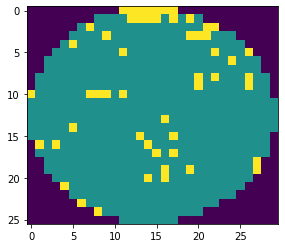

wafer_id:146445, ウエハサイズ:26x30, スタンプサイズ:3x2, oDefects:16, nDefects:52, p=30.769


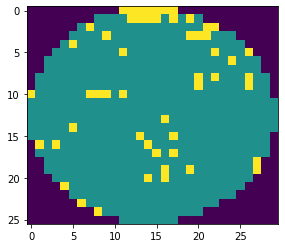

wafer_id:146445, ウエハサイズ:26x30, スタンプサイズ:4x2, oDefects:16, nDefects:52, p=30.769


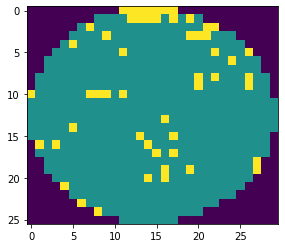

wafer_id:146662, ウエハサイズ:26x30, スタンプサイズ:2x2, oDefects:8, nDefects:26, p=30.769


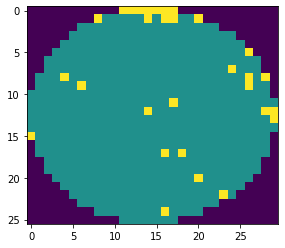

wafer_id:146662, ウエハサイズ:26x30, スタンプサイズ:3x2, oDefects:8, nDefects:25, p=32.000


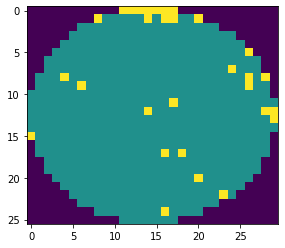

wafer_id:146662, ウエハサイズ:26x30, スタンプサイズ:4x2, oDefects:8, nDefects:25, p=32.000


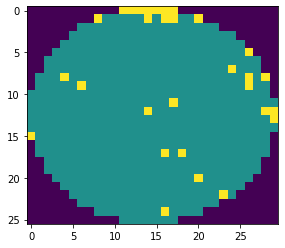

(26, 30)


In [131]:
# none pattern
for w_id in range(len(df_nonpattern)):
    x = df_nonpattern.iloc[w_id, :]['waferMap']
    if w_id % 1000 == 0: print(x.shape)
    for w in range(2, 5):
        for h in range(2, 5):
            detectShotDefects(x, w_id, w, h)

In [11]:
sub_df = df_withlabel[df_withlabel['failureNum']==5]

In [15]:
len(sub_df)

866

(26, 26)
wafer_id:21, ウエハサイズ:39x39, スタンプサイズ:2x2, oDefects:671, nDefects:869, p=77.215


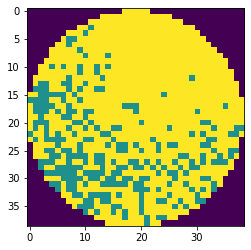

wafer_id:21, ウエハサイズ:39x39, スタンプサイズ:3x2, oDefects:677, nDefects:878, p=77.107


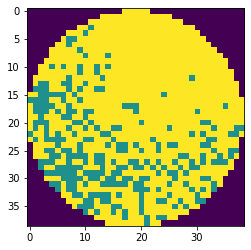

wafer_id:21, ウエハサイズ:39x39, スタンプサイズ:4x2, oDefects:655, nDefects:844, p=77.607


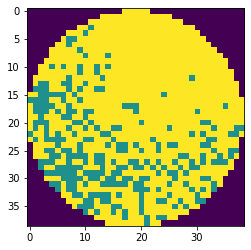

wafer_id:21, ウエハサイズ:39x39, スタンプサイズ:2x3, oDefects:678, nDefects:869, p=78.021


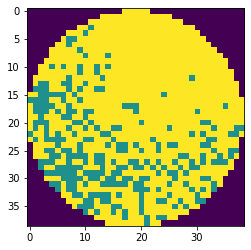

wafer_id:21, ウエハサイズ:39x39, スタンプサイズ:3x3, oDefects:684, nDefects:878, p=77.904


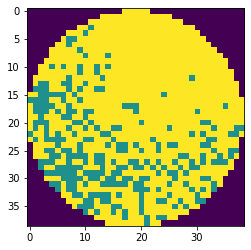

wafer_id:21, ウエハサイズ:39x39, スタンプサイズ:4x3, oDefects:662, nDefects:844, p=78.436


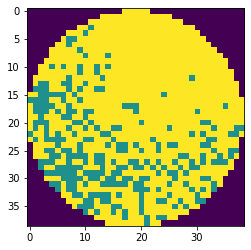

wafer_id:21, ウエハサイズ:39x39, スタンプサイズ:2x4, oDefects:606, nDefects:784, p=77.296


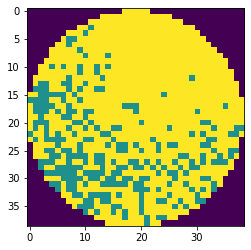

wafer_id:21, ウエハサイズ:39x39, スタンプサイズ:3x4, oDefects:611, nDefects:793, p=77.049


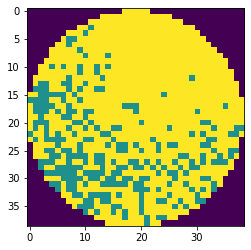

wafer_id:21, ウエハサイズ:39x39, スタンプサイズ:4x4, oDefects:593, nDefects:759, p=78.129


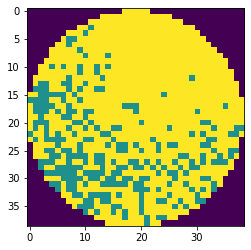

wafer_id:260, ウエハサイズ:32x32, スタンプサイズ:2x2, oDefects:273, nDefects:339, p=80.531


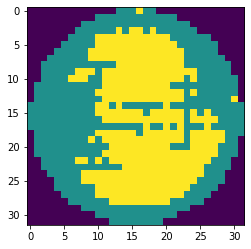

wafer_id:260, ウエハサイズ:32x32, スタンプサイズ:3x2, oDefects:273, nDefects:339, p=80.531


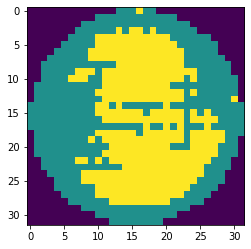

wafer_id:260, ウエハサイズ:32x32, スタンプサイズ:4x2, oDefects:273, nDefects:339, p=80.531


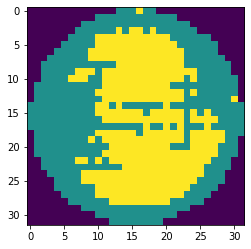

wafer_id:260, ウエハサイズ:32x32, スタンプサイズ:2x3, oDefects:248, nDefects:332, p=74.699


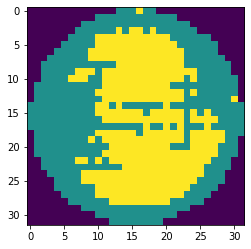

wafer_id:260, ウエハサイズ:32x32, スタンプサイズ:3x3, oDefects:248, nDefects:332, p=74.699


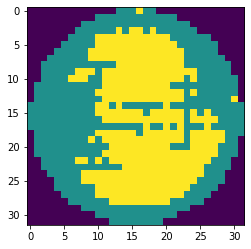

wafer_id:260, ウエハサイズ:32x32, スタンプサイズ:4x3, oDefects:248, nDefects:332, p=74.699


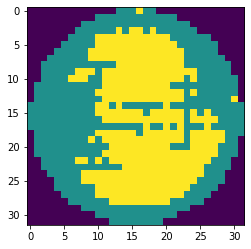

wafer_id:262, ウエハサイズ:32x32, スタンプサイズ:2x2, oDefects:313, nDefects:418, p=74.880


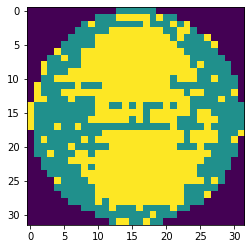

wafer_id:262, ウエハサイズ:32x32, スタンプサイズ:3x2, oDefects:313, nDefects:414, p=75.604


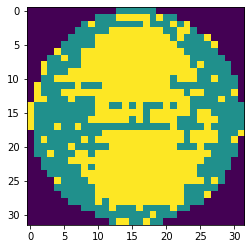

wafer_id:262, ウエハサイズ:32x32, スタンプサイズ:4x2, oDefects:313, nDefects:418, p=74.880


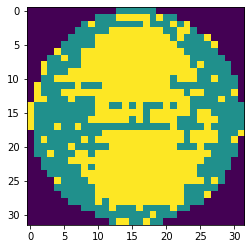

wafer_id:262, ウエハサイズ:32x32, スタンプサイズ:2x3, oDefects:293, nDefects:411, p=71.290


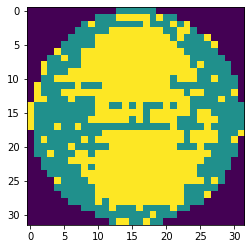

wafer_id:262, ウエハサイズ:32x32, スタンプサイズ:3x3, oDefects:292, nDefects:407, p=71.744


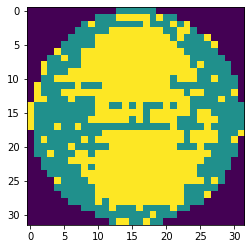

wafer_id:262, ウエハサイズ:32x32, スタンプサイズ:4x3, oDefects:293, nDefects:411, p=71.290


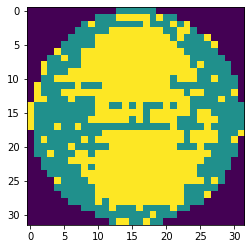

wafer_id:263, ウエハサイズ:32x32, スタンプサイズ:2x2, oDefects:290, nDefects:386, p=75.130


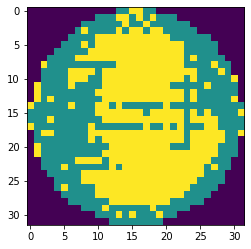

wafer_id:263, ウエハサイズ:32x32, スタンプサイズ:3x2, oDefects:289, nDefects:383, p=75.457


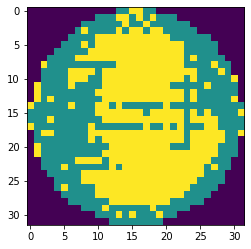

wafer_id:263, ウエハサイズ:32x32, スタンプサイズ:4x2, oDefects:290, nDefects:386, p=75.130


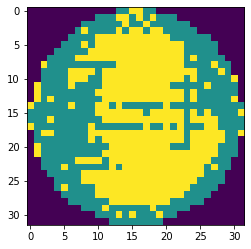

wafer_id:263, ウエハサイズ:32x32, スタンプサイズ:2x3, oDefects:264, nDefects:375, p=70.400


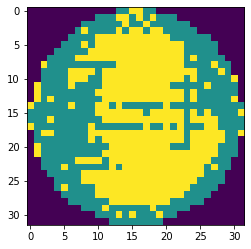

wafer_id:263, ウエハサイズ:32x32, スタンプサイズ:3x3, oDefects:264, nDefects:372, p=70.968


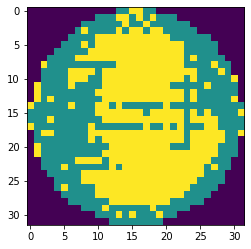

wafer_id:263, ウエハサイズ:32x32, スタンプサイズ:4x3, oDefects:264, nDefects:375, p=70.400


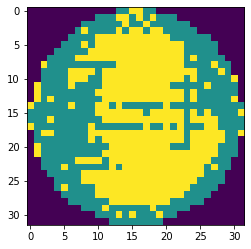

wafer_id:276, ウエハサイズ:58x60, スタンプサイズ:2x2, oDefects:1363, nDefects:1862, p=73.201


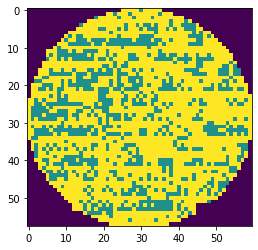

wafer_id:276, ウエハサイズ:58x60, スタンプサイズ:3x2, oDefects:1349, nDefects:1846, p=73.077


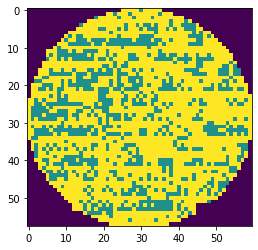

wafer_id:276, ウエハサイズ:58x60, スタンプサイズ:4x2, oDefects:1333, nDefects:1826, p=73.001


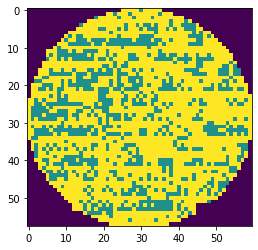

wafer_id:276, ウエハサイズ:58x60, スタンプサイズ:2x3, oDefects:1294, nDefects:1847, p=70.060


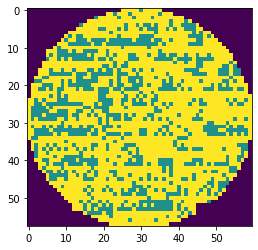

wafer_id:363, ウエハサイズ:51x59, スタンプサイズ:2x2, oDefects:1119, nDefects:1561, p=71.685


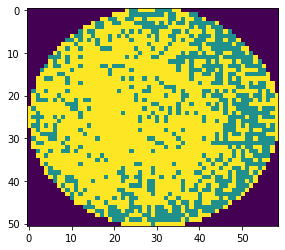

wafer_id:363, ウエハサイズ:51x59, スタンプサイズ:3x2, oDefects:1130, nDefects:1575, p=71.746


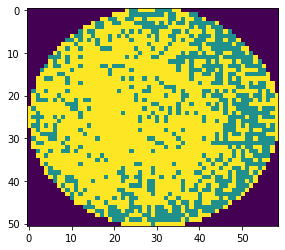

wafer_id:363, ウエハサイズ:51x59, スタンプサイズ:4x2, oDefects:1114, nDefects:1544, p=72.150


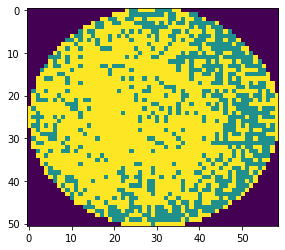

wafer_id:363, ウエハサイズ:51x59, スタンプサイズ:2x3, oDefects:1109, nDefects:1543, p=71.873


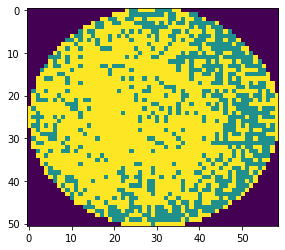

wafer_id:363, ウエハサイズ:51x59, スタンプサイズ:3x3, oDefects:1119, nDefects:1557, p=71.869


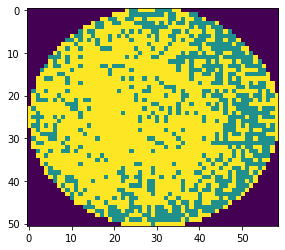

wafer_id:363, ウエハサイズ:51x59, スタンプサイズ:4x3, oDefects:1106, nDefects:1526, p=72.477


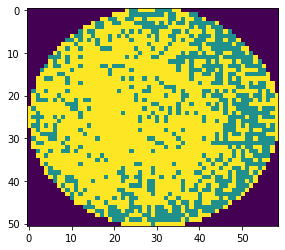

wafer_id:363, ウエハサイズ:51x59, スタンプサイズ:2x4, oDefects:1098, nDefects:1519, p=72.284


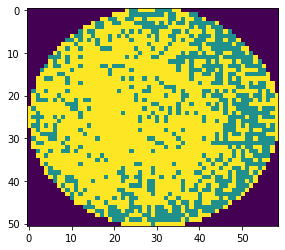

wafer_id:363, ウエハサイズ:51x59, スタンプサイズ:3x4, oDefects:1107, nDefects:1533, p=72.211


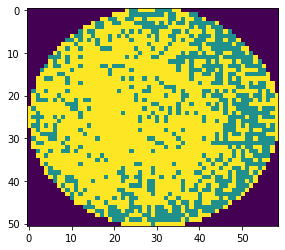

wafer_id:363, ウエハサイズ:51x59, スタンプサイズ:4x4, oDefects:1093, nDefects:1502, p=72.770


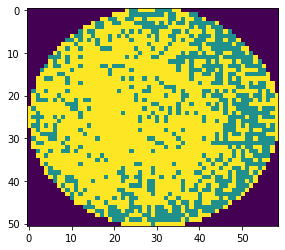

wafer_id:370, ウエハサイズ:50x43, スタンプサイズ:2x3, oDefects:800, nDefects:1126, p=71.048


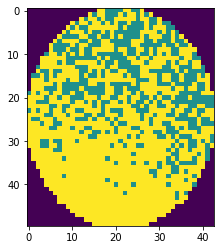

wafer_id:370, ウエハサイズ:50x43, スタンプサイズ:3x3, oDefects:776, nDefects:1096, p=70.803


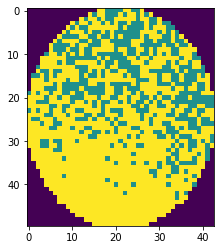

wafer_id:370, ウエハサイズ:50x43, スタンプサイズ:4x3, oDefects:776, nDefects:1096, p=70.803


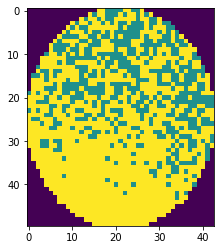

wafer_id:373, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:490, nDefects:700, p=70.000


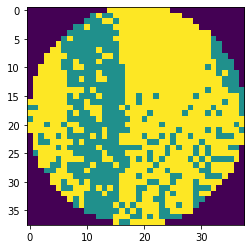

wafer_id:373, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:490, nDefects:700, p=70.000


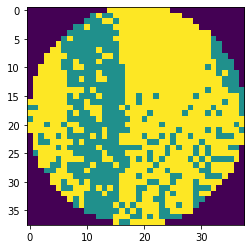

wafer_id:422, ウエハサイズ:43x42, スタンプサイズ:4x2, oDefects:692, nDefects:988, p=70.040


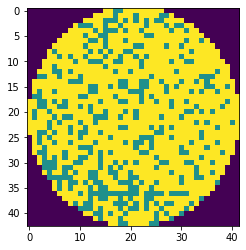

wafer_id:422, ウエハサイズ:43x42, スタンプサイズ:4x3, oDefects:680, nDefects:970, p=70.103


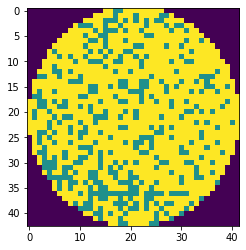

wafer_id:422, ウエハサイズ:43x42, スタンプサイズ:4x4, oDefects:635, nDefects:903, p=70.321


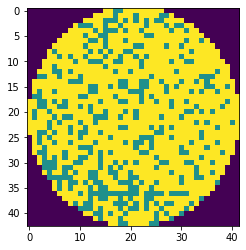

wafer_id:434, ウエハサイズ:41x42, スタンプサイズ:2x3, oDefects:342, nDefects:485, p=70.515


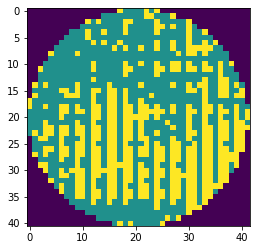

wafer_id:434, ウエハサイズ:41x42, スタンプサイズ:3x3, oDefects:342, nDefects:483, p=70.807


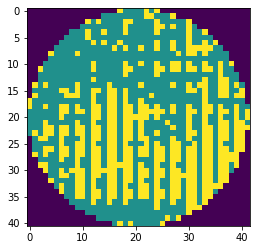

wafer_id:434, ウエハサイズ:41x42, スタンプサイズ:4x3, oDefects:342, nDefects:485, p=70.515


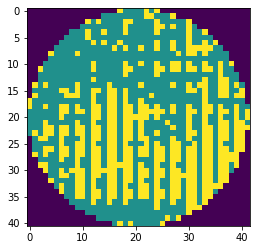

wafer_id:435, ウエハサイズ:41x42, スタンプサイズ:2x3, oDefects:396, nDefects:546, p=72.527


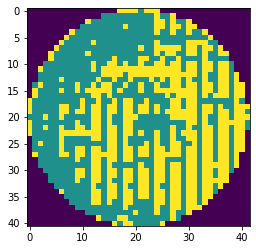

wafer_id:435, ウエハサイズ:41x42, スタンプサイズ:3x3, oDefects:396, nDefects:542, p=73.063


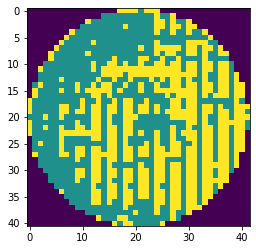

wafer_id:435, ウエハサイズ:41x42, スタンプサイズ:4x3, oDefects:396, nDefects:546, p=72.527


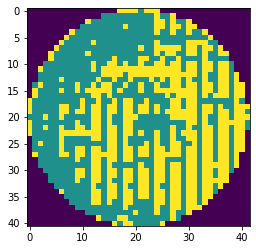

wafer_id:470, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:295, nDefects:416, p=70.913


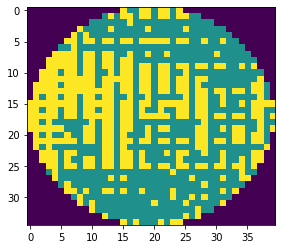

wafer_id:470, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:295, nDefects:413, p=71.429


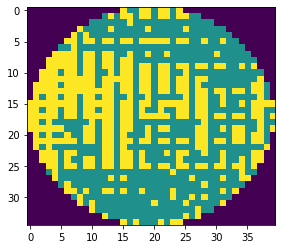

wafer_id:470, ウエハサイズ:35x40, スタンプサイズ:4x3, oDefects:295, nDefects:411, p=71.776


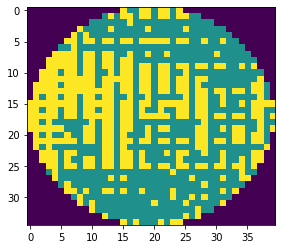

wafer_id:472, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:243, nDefects:337, p=72.107


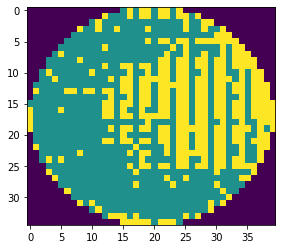

wafer_id:472, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:242, nDefects:331, p=73.112


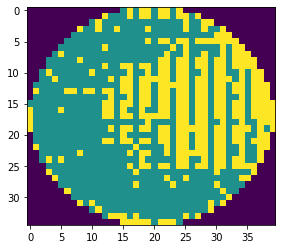

wafer_id:472, ウエハサイズ:35x40, スタンプサイズ:4x3, oDefects:242, nDefects:329, p=73.556


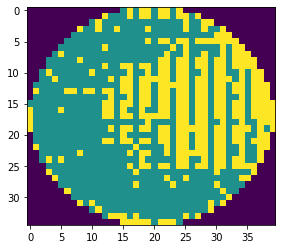

wafer_id:473, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:262, nDefects:374, p=70.053


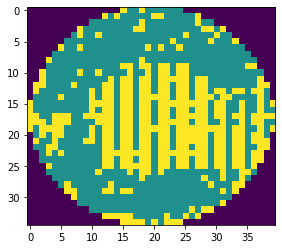

wafer_id:473, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:259, nDefects:366, p=70.765


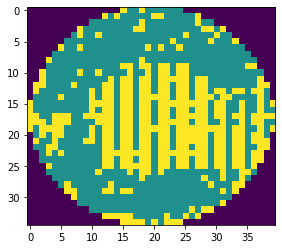

wafer_id:473, ウエハサイズ:35x40, スタンプサイズ:4x3, oDefects:258, nDefects:363, p=71.074


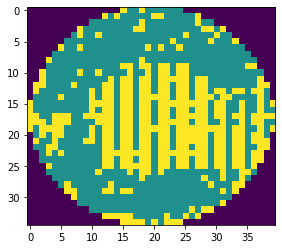

wafer_id:474, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:289, nDefects:396, p=72.980


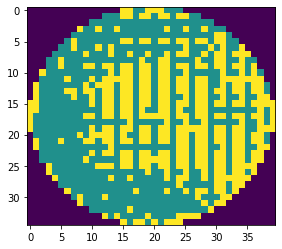

wafer_id:474, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:288, nDefects:389, p=74.036


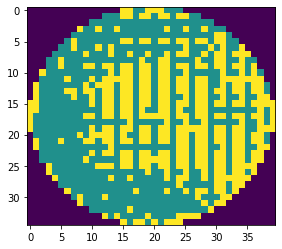

wafer_id:474, ウエハサイズ:35x40, スタンプサイズ:4x3, oDefects:288, nDefects:387, p=74.419


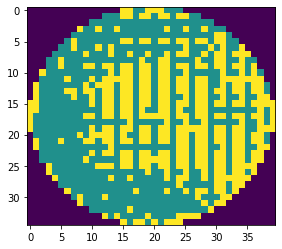

wafer_id:478, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:316, nDefects:446, p=70.852


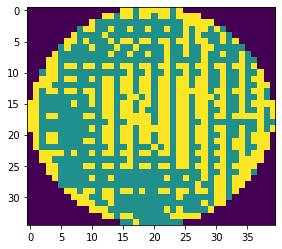

wafer_id:478, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:312, nDefects:437, p=71.396


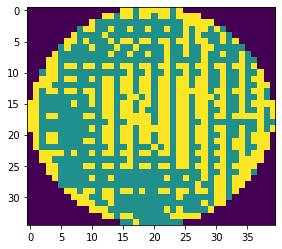

wafer_id:478, ウエハサイズ:35x40, スタンプサイズ:4x3, oDefects:312, nDefects:431, p=72.390


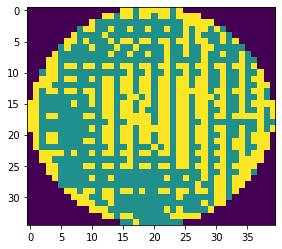

wafer_id:479, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:329, nDefects:451, p=72.949


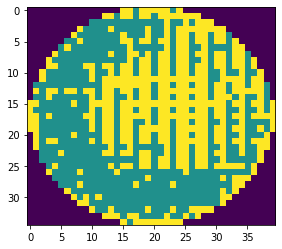

wafer_id:479, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:326, nDefects:443, p=73.589


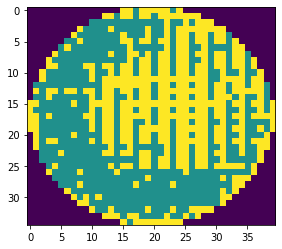

wafer_id:479, ウエハサイズ:35x40, スタンプサイズ:4x3, oDefects:323, nDefects:435, p=74.253


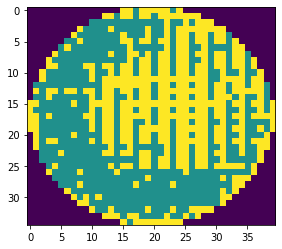

wafer_id:480, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:389, nDefects:505, p=77.030


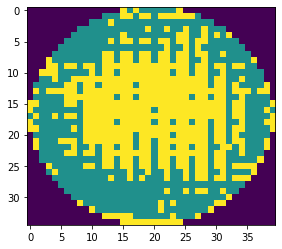

wafer_id:480, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:387, nDefects:498, p=77.711


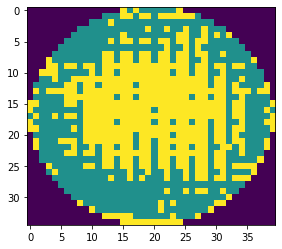

wafer_id:480, ウエハサイズ:35x40, スタンプサイズ:4x3, oDefects:387, nDefects:495, p=78.182


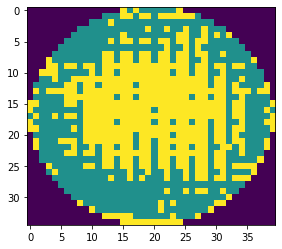

wafer_id:482, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:291, nDefects:395, p=73.671


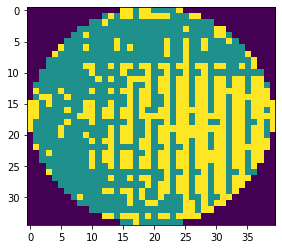

wafer_id:482, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:284, nDefects:383, p=74.151


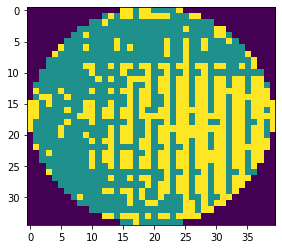

wafer_id:482, ウエハサイズ:35x40, スタンプサイズ:4x3, oDefects:282, nDefects:379, p=74.406


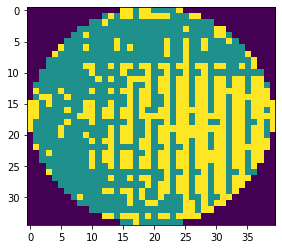

wafer_id:485, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:311, nDefects:416, p=74.760


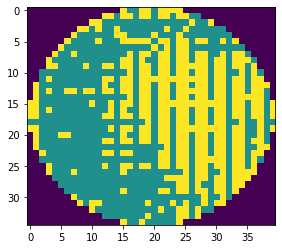

wafer_id:485, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:310, nDefects:412, p=75.243


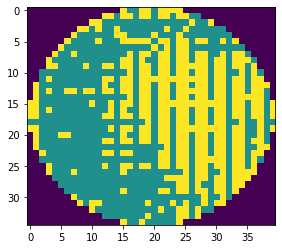

wafer_id:485, ウエハサイズ:35x40, スタンプサイズ:4x3, oDefects:308, nDefects:407, p=75.676


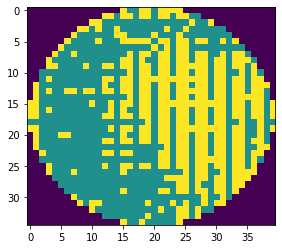

wafer_id:488, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:343, nDefects:474, p=72.363


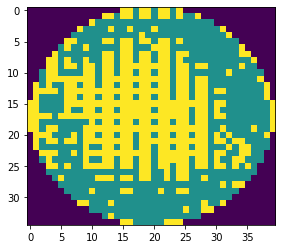

wafer_id:488, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:343, nDefects:473, p=72.516


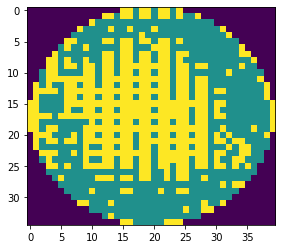

wafer_id:488, ウエハサイズ:35x40, スタンプサイズ:4x3, oDefects:342, nDefects:470, p=72.766


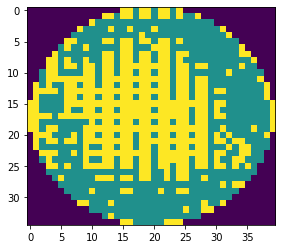

wafer_id:489, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:322, nDefects:446, p=72.197


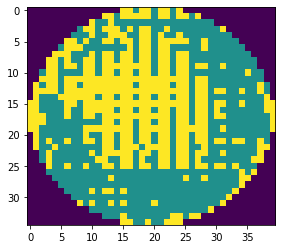

wafer_id:489, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:320, nDefects:441, p=72.562


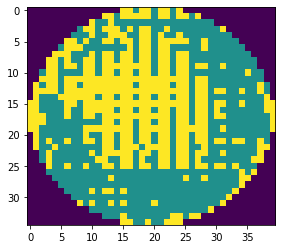

wafer_id:489, ウエハサイズ:35x40, スタンプサイズ:4x3, oDefects:320, nDefects:440, p=72.727


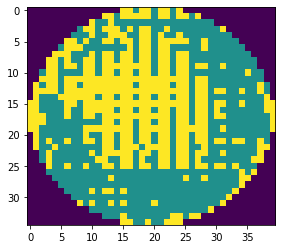

wafer_id:490, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:278, nDefects:380, p=73.158


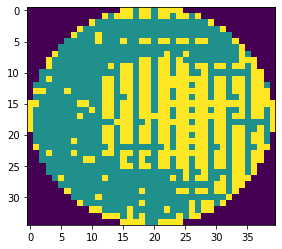

wafer_id:490, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:276, nDefects:372, p=74.194


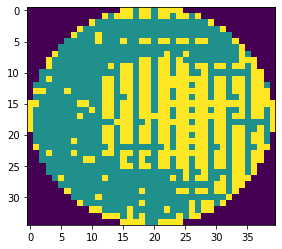

wafer_id:490, ウエハサイズ:35x40, スタンプサイズ:4x3, oDefects:275, nDefects:365, p=75.342


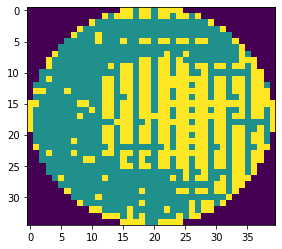

wafer_id:494, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:306, nDefects:395, p=77.468


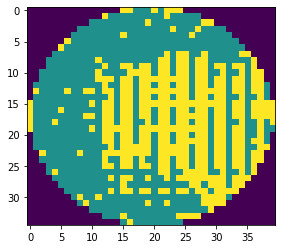

wafer_id:494, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:305, nDefects:390, p=78.205


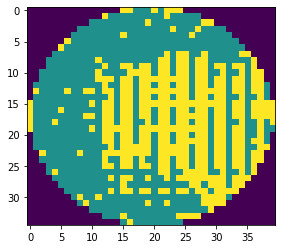

wafer_id:494, ウエハサイズ:35x40, スタンプサイズ:4x3, oDefects:305, nDefects:389, p=78.406


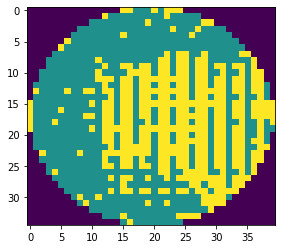

wafer_id:504, ウエハサイズ:35x40, スタンプサイズ:3x2, oDefects:515, nDefects:730, p=70.548


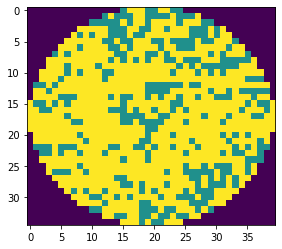

wafer_id:504, ウエハサイズ:35x40, スタンプサイズ:4x2, oDefects:509, nDefects:719, p=70.793


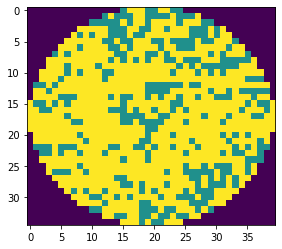

wafer_id:514, ウエハサイズ:35x40, スタンプサイズ:2x2, oDefects:541, nDefects:745, p=72.617


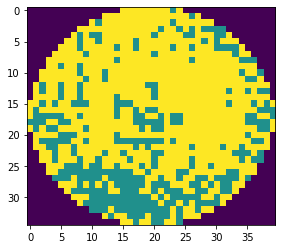

wafer_id:514, ウエハサイズ:35x40, スタンプサイズ:3x2, oDefects:538, nDefects:737, p=72.999


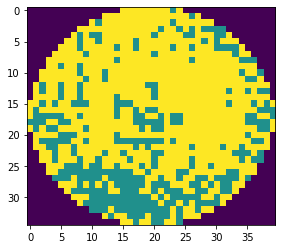

wafer_id:514, ウエハサイズ:35x40, スタンプサイズ:4x2, oDefects:536, nDefects:731, p=73.324


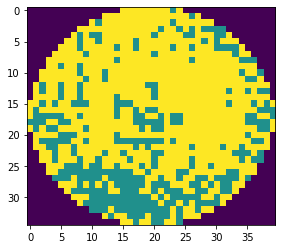

wafer_id:514, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:544, nDefects:726, p=74.931


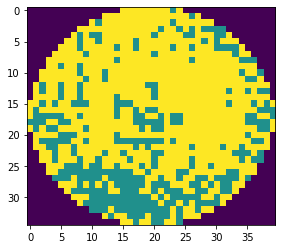

wafer_id:514, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:542, nDefects:718, p=75.487


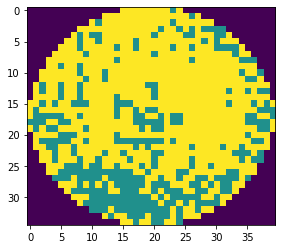

wafer_id:514, ウエハサイズ:35x40, スタンプサイズ:4x3, oDefects:539, nDefects:712, p=75.702


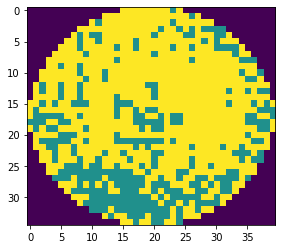

wafer_id:514, ウエハサイズ:35x40, スタンプサイズ:2x4, oDefects:513, nDefects:726, p=70.661


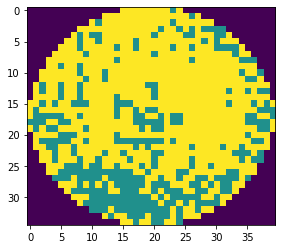

wafer_id:514, ウエハサイズ:35x40, スタンプサイズ:3x4, oDefects:510, nDefects:718, p=71.031


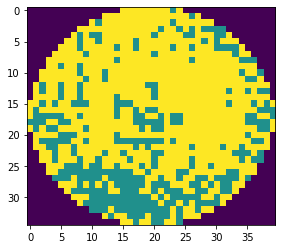

wafer_id:514, ウエハサイズ:35x40, スタンプサイズ:4x4, oDefects:509, nDefects:712, p=71.489


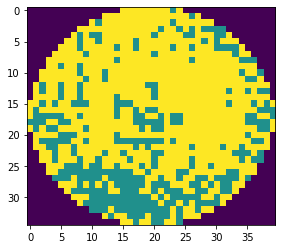

wafer_id:517, ウエハサイズ:35x40, スタンプサイズ:2x2, oDefects:522, nDefects:736, p=70.924


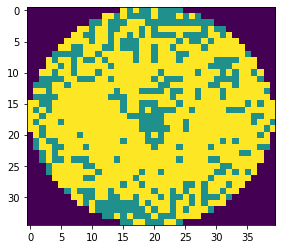

wafer_id:517, ウエハサイズ:35x40, スタンプサイズ:3x2, oDefects:519, nDefects:729, p=71.193


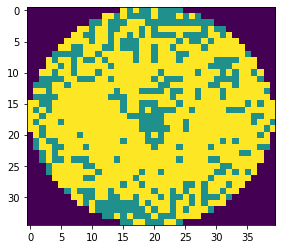

wafer_id:517, ウエハサイズ:35x40, スタンプサイズ:4x2, oDefects:515, nDefects:721, p=71.429


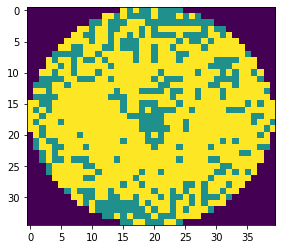

wafer_id:517, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:508, nDefects:710, p=71.549


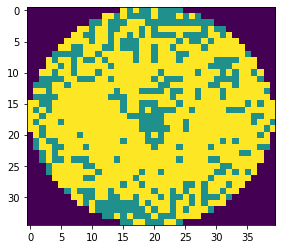

wafer_id:517, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:507, nDefects:703, p=72.119


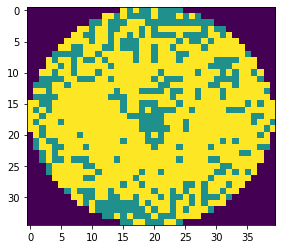

wafer_id:517, ウエハサイズ:35x40, スタンプサイズ:4x3, oDefects:504, nDefects:695, p=72.518


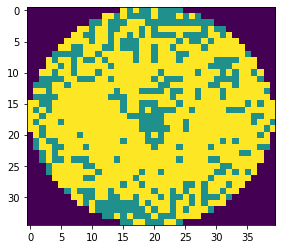

wafer_id:519, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:336, nDefects:472, p=71.186


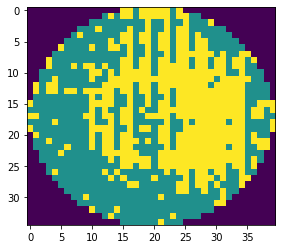

wafer_id:519, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:336, nDefects:470, p=71.489


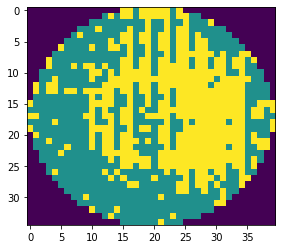

wafer_id:519, ウエハサイズ:35x40, スタンプサイズ:4x3, oDefects:336, nDefects:468, p=71.795


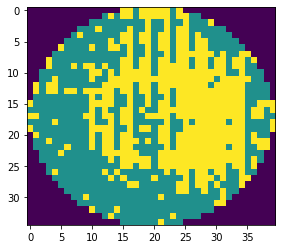

wafer_id:527, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:337, nDefects:441, p=76.417


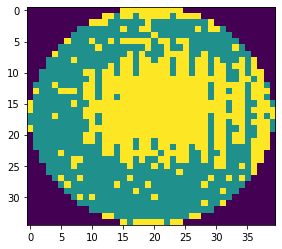

wafer_id:527, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:337, nDefects:437, p=77.117


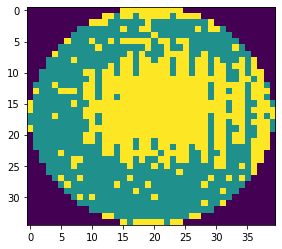

wafer_id:527, ウエハサイズ:35x40, スタンプサイズ:4x3, oDefects:337, nDefects:437, p=77.117


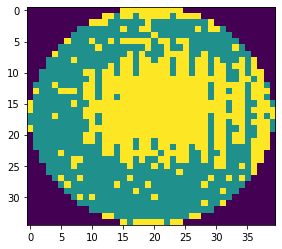

wafer_id:561, ウエハサイズ:26x25, スタンプサイズ:3x2, oDefects:230, nDefects:328, p=70.122


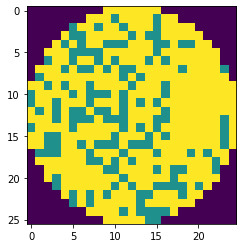

wafer_id:561, ウエハサイズ:26x25, スタンプサイズ:4x2, oDefects:230, nDefects:328, p=70.122


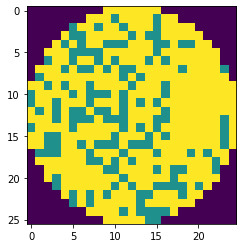

wafer_id:564, ウエハサイズ:26x25, スタンプサイズ:2x2, oDefects:244, nDefects:325, p=75.077


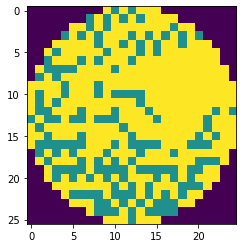

wafer_id:564, ウエハサイズ:26x25, スタンプサイズ:3x2, oDefects:240, nDefects:316, p=75.949


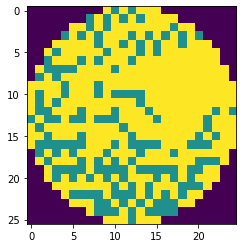

wafer_id:564, ウエハサイズ:26x25, スタンプサイズ:4x2, oDefects:240, nDefects:316, p=75.949


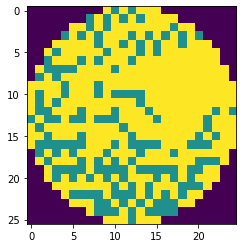

wafer_id:564, ウエハサイズ:26x25, スタンプサイズ:2x4, oDefects:223, nDefects:297, p=75.084


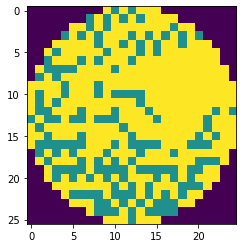

wafer_id:564, ウエハサイズ:26x25, スタンプサイズ:3x4, oDefects:219, nDefects:288, p=76.042


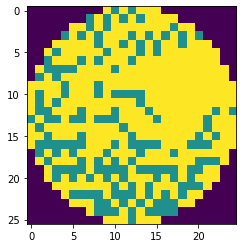

wafer_id:564, ウエハサイズ:26x25, スタンプサイズ:4x4, oDefects:219, nDefects:288, p=76.042


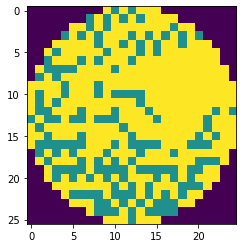

wafer_id:583, ウエハサイズ:26x26, スタンプサイズ:2x2, oDefects:280, nDefects:385, p=72.727


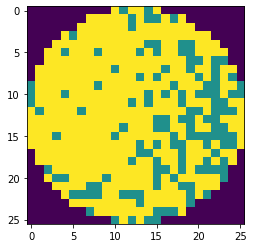

wafer_id:583, ウエハサイズ:26x26, スタンプサイズ:3x2, oDefects:274, nDefects:375, p=73.067


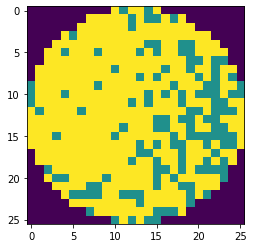

wafer_id:583, ウエハサイズ:26x26, スタンプサイズ:4x2, oDefects:274, nDefects:375, p=73.067


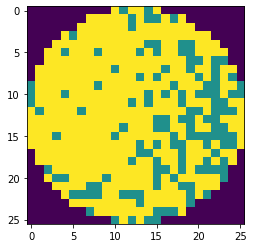

wafer_id:583, ウエハサイズ:26x26, スタンプサイズ:2x3, oDefects:264, nDefects:360, p=73.333


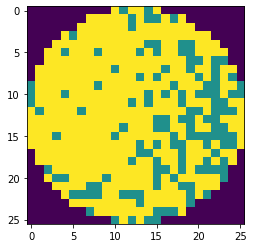

wafer_id:583, ウエハサイズ:26x26, スタンプサイズ:3x3, oDefects:260, nDefects:350, p=74.286


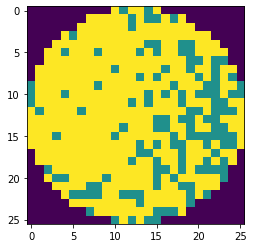

wafer_id:583, ウエハサイズ:26x26, スタンプサイズ:4x3, oDefects:260, nDefects:350, p=74.286


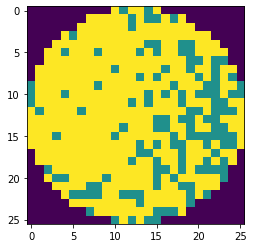

wafer_id:583, ウエハサイズ:26x26, スタンプサイズ:2x4, oDefects:248, nDefects:346, p=71.676


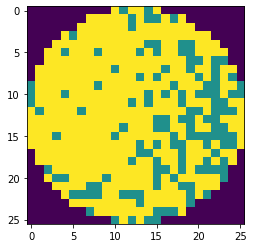

wafer_id:583, ウエハサイズ:26x26, スタンプサイズ:3x4, oDefects:244, nDefects:336, p=72.619


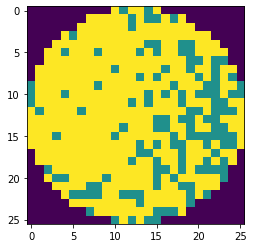

wafer_id:583, ウエハサイズ:26x26, スタンプサイズ:4x4, oDefects:244, nDefects:336, p=72.619


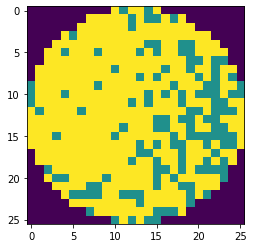

wafer_id:618, ウエハサイズ:32x29, スタンプサイズ:2x2, oDefects:269, nDefects:377, p=71.353


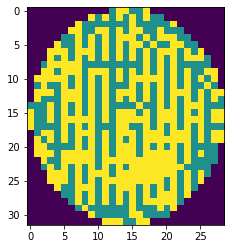

wafer_id:618, ウエハサイズ:32x29, スタンプサイズ:3x2, oDefects:268, nDefects:369, p=72.629


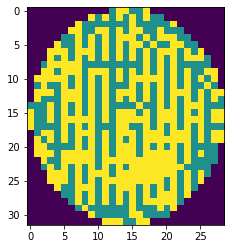

wafer_id:618, ウエハサイズ:32x29, スタンプサイズ:4x2, oDefects:269, nDefects:377, p=71.353


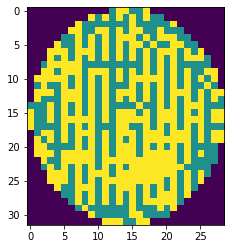

wafer_id:628, ウエハサイズ:32x29, スタンプサイズ:2x3, oDefects:314, nDefects:447, p=70.246


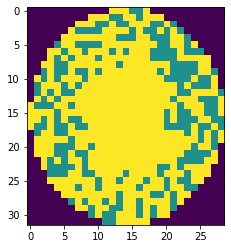

wafer_id:628, ウエハサイズ:32x29, スタンプサイズ:3x3, oDefects:309, nDefects:435, p=71.034


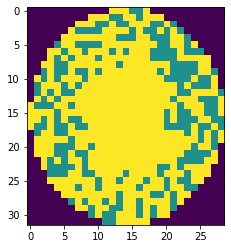

wafer_id:628, ウエハサイズ:32x29, スタンプサイズ:4x3, oDefects:314, nDefects:447, p=70.246


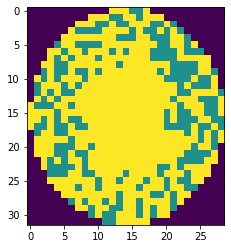

wafer_id:699, ウエハサイズ:34x31, スタンプサイズ:2x2, oDefects:385, nDefects:546, p=70.513


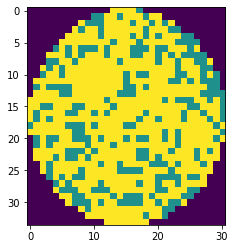

wafer_id:699, ウエハサイズ:34x31, スタンプサイズ:3x2, oDefects:380, nDefects:539, p=70.501


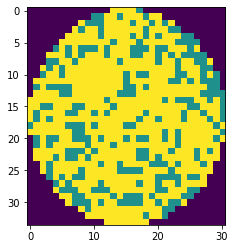

wafer_id:699, ウエハサイズ:34x31, スタンプサイズ:4x2, oDefects:372, nDefects:528, p=70.455


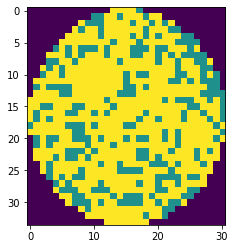

wafer_id:704, ウエハサイズ:34x31, スタンプサイズ:3x4, oDefects:342, nDefects:487, p=70.226


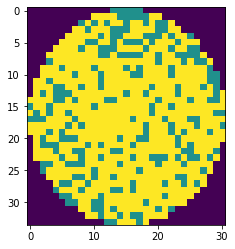

wafer_id:704, ウエハサイズ:34x31, スタンプサイズ:4x4, oDefects:340, nDefects:478, p=71.130


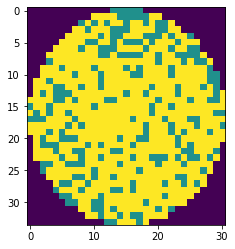

wafer_id:749, ウエハサイズ:27x25, スタンプサイズ:2x2, oDefects:245, nDefects:312, p=78.526


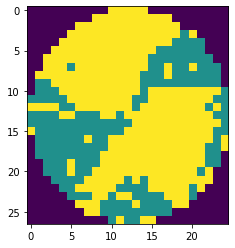

wafer_id:749, ウエハサイズ:27x25, スタンプサイズ:3x2, oDefects:245, nDefects:315, p=77.778


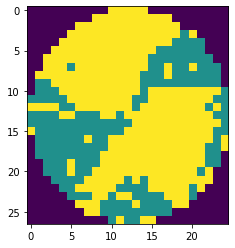

wafer_id:749, ウエハサイズ:27x25, スタンプサイズ:4x2, oDefects:244, nDefects:304, p=80.263


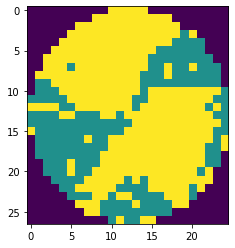

wafer_id:749, ウエハサイズ:27x25, スタンプサイズ:2x3, oDefects:224, nDefects:300, p=74.667


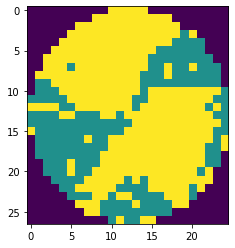

wafer_id:749, ウエハサイズ:27x25, スタンプサイズ:3x3, oDefects:225, nDefects:303, p=74.257


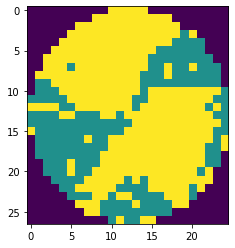

wafer_id:749, ウエハサイズ:27x25, スタンプサイズ:4x3, oDefects:224, nDefects:292, p=76.712


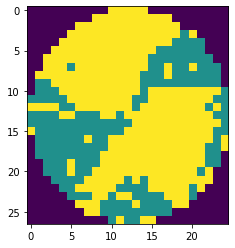

wafer_id:749, ウエハサイズ:27x25, スタンプサイズ:2x4, oDefects:202, nDefects:286, p=70.629


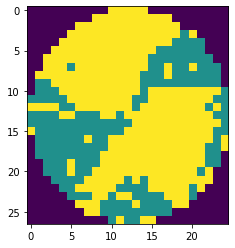

wafer_id:749, ウエハサイズ:27x25, スタンプサイズ:3x4, oDefects:203, nDefects:289, p=70.242


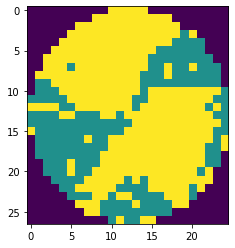

wafer_id:749, ウエハサイズ:27x25, スタンプサイズ:4x4, oDefects:202, nDefects:278, p=72.662


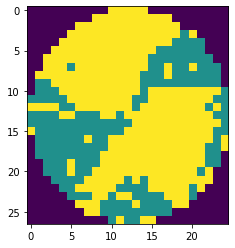

wafer_id:750, ウエハサイズ:27x25, スタンプサイズ:2x2, oDefects:277, nDefects:356, p=77.809


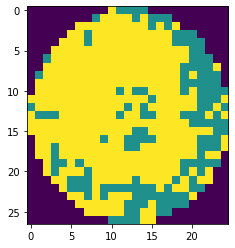

wafer_id:750, ウエハサイズ:27x25, スタンプサイズ:3x2, oDefects:277, nDefects:358, p=77.374


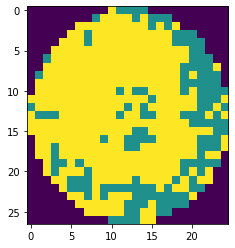

wafer_id:750, ウエハサイズ:27x25, スタンプサイズ:4x2, oDefects:270, nDefects:342, p=78.947


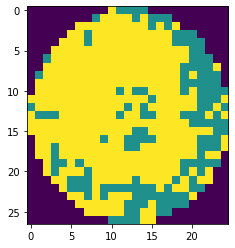

wafer_id:750, ウエハサイズ:27x25, スタンプサイズ:2x3, oDefects:258, nDefects:354, p=72.881


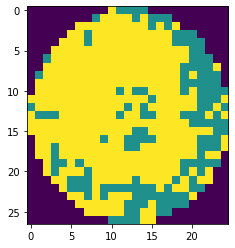

wafer_id:750, ウエハサイズ:27x25, スタンプサイズ:3x3, oDefects:258, nDefects:356, p=72.472


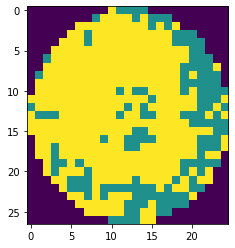

wafer_id:750, ウエハサイズ:27x25, スタンプサイズ:4x3, oDefects:252, nDefects:340, p=74.118


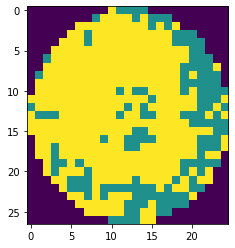

wafer_id:750, ウエハサイズ:27x25, スタンプサイズ:2x4, oDefects:242, nDefects:344, p=70.349


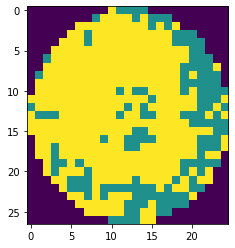

wafer_id:750, ウエハサイズ:27x25, スタンプサイズ:4x4, oDefects:236, nDefects:330, p=71.515


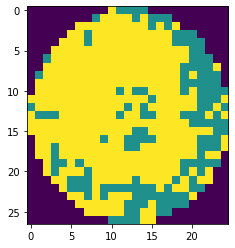

wafer_id:752, ウエハサイズ:39x37, スタンプサイズ:2x2, oDefects:585, nDefects:754, p=77.586


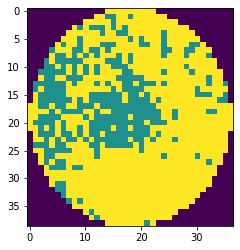

wafer_id:752, ウエハサイズ:39x37, スタンプサイズ:3x2, oDefects:591, nDefects:762, p=77.559


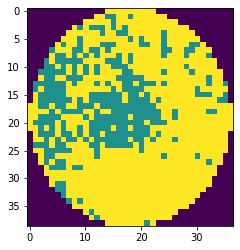

wafer_id:752, ウエハサイズ:39x37, スタンプサイズ:4x2, oDefects:559, nDefects:724, p=77.210


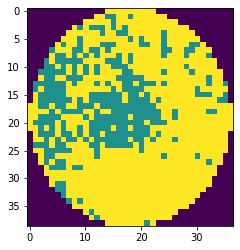

wafer_id:752, ウエハサイズ:39x37, スタンプサイズ:2x3, oDefects:552, nDefects:734, p=75.204


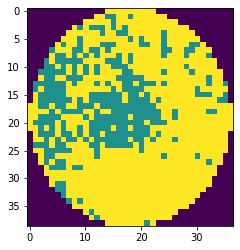

wafer_id:752, ウエハサイズ:39x37, スタンプサイズ:3x3, oDefects:557, nDefects:742, p=75.067


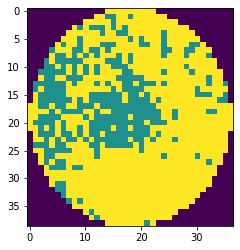

wafer_id:752, ウエハサイズ:39x37, スタンプサイズ:4x3, oDefects:528, nDefects:704, p=75.000


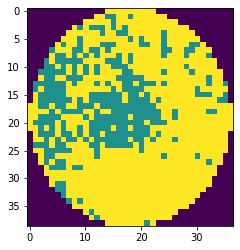

wafer_id:752, ウエハサイズ:39x37, スタンプサイズ:2x4, oDefects:524, nDefects:715, p=73.287


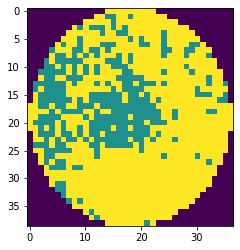

wafer_id:752, ウエハサイズ:39x37, スタンプサイズ:3x4, oDefects:528, nDefects:723, p=73.029


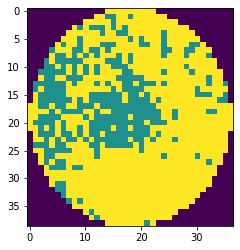

wafer_id:752, ウエハサイズ:39x37, スタンプサイズ:4x4, oDefects:502, nDefects:685, p=73.285


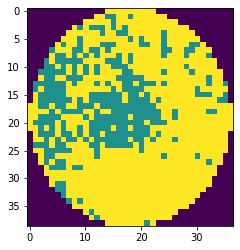

wafer_id:765, ウエハサイズ:39x37, スタンプサイズ:2x2, oDefects:600, nDefects:790, p=75.949


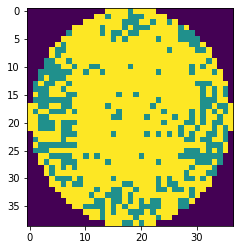

wafer_id:765, ウエハサイズ:39x37, スタンプサイズ:3x2, oDefects:602, nDefects:796, p=75.628


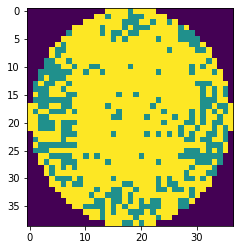

wafer_id:765, ウエハサイズ:39x37, スタンプサイズ:4x2, oDefects:587, nDefects:767, p=76.532


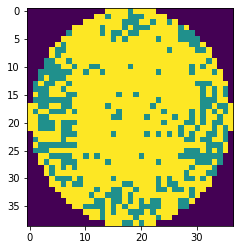

wafer_id:765, ウエハサイズ:39x37, スタンプサイズ:2x3, oDefects:580, nDefects:781, p=74.264


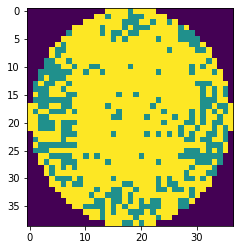

wafer_id:765, ウエハサイズ:39x37, スタンプサイズ:3x3, oDefects:582, nDefects:787, p=73.952


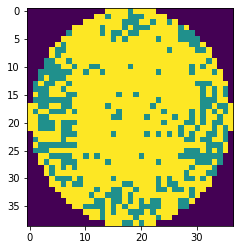

wafer_id:765, ウエハサイズ:39x37, スタンプサイズ:4x3, oDefects:568, nDefects:758, p=74.934


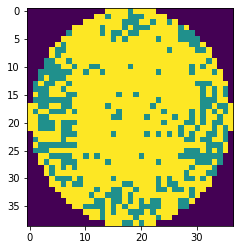

wafer_id:765, ウエハサイズ:39x37, スタンプサイズ:2x4, oDefects:563, nDefects:767, p=73.403


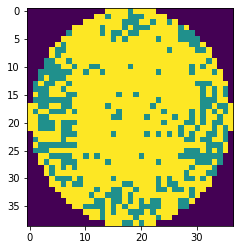

wafer_id:765, ウエハサイズ:39x37, スタンプサイズ:3x4, oDefects:564, nDefects:773, p=72.962


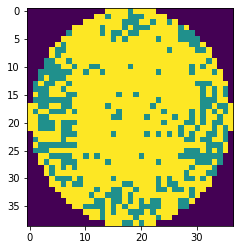

wafer_id:765, ウエハサイズ:39x37, スタンプサイズ:4x4, oDefects:551, nDefects:744, p=74.059


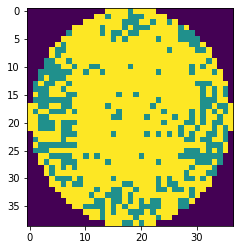

wafer_id:772, ウエハサイズ:39x37, スタンプサイズ:2x2, oDefects:570, nDefects:730, p=78.082


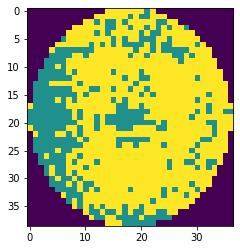

wafer_id:772, ウエハサイズ:39x37, スタンプサイズ:3x2, oDefects:571, nDefects:733, p=77.899


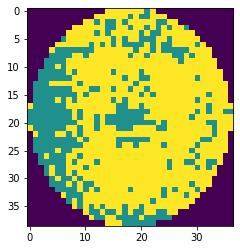

wafer_id:772, ウエハサイズ:39x37, スタンプサイズ:4x2, oDefects:569, nDefects:718, p=79.248


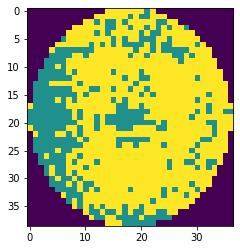

wafer_id:772, ウエハサイズ:39x37, スタンプサイズ:2x3, oDefects:548, nDefects:713, p=76.858


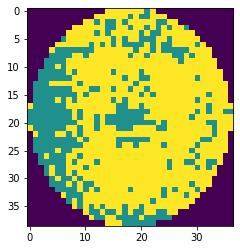

wafer_id:772, ウエハサイズ:39x37, スタンプサイズ:3x3, oDefects:548, nDefects:716, p=76.536


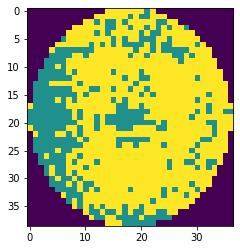

wafer_id:772, ウエハサイズ:39x37, スタンプサイズ:4x3, oDefects:543, nDefects:701, p=77.461


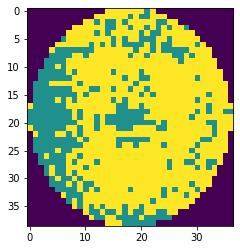

wafer_id:772, ウエハサイズ:39x37, スタンプサイズ:2x4, oDefects:517, nDefects:695, p=74.388


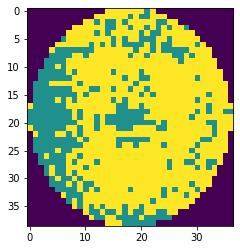

wafer_id:772, ウエハサイズ:39x37, スタンプサイズ:3x4, oDefects:517, nDefects:698, p=74.069


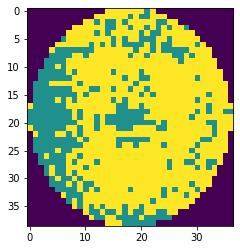

wafer_id:772, ウエハサイズ:39x37, スタンプサイズ:4x4, oDefects:513, nDefects:683, p=75.110


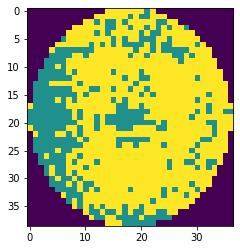

wafer_id:773, ウエハサイズ:39x37, スタンプサイズ:2x2, oDefects:493, nDefects:700, p=70.429


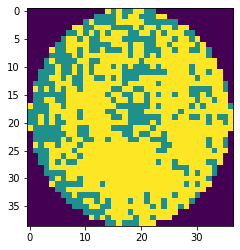

wafer_id:773, ウエハサイズ:39x37, スタンプサイズ:3x2, oDefects:494, nDefects:704, p=70.170


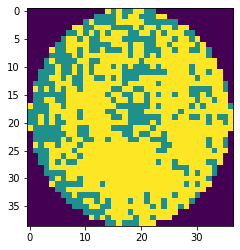

wafer_id:773, ウエハサイズ:39x37, スタンプサイズ:4x2, oDefects:477, nDefects:677, p=70.458


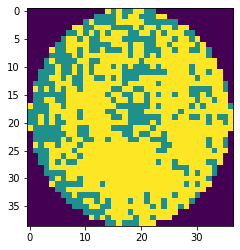

wafer_id:773, ウエハサイズ:39x37, スタンプサイズ:2x3, oDefects:489, nDefects:684, p=71.491


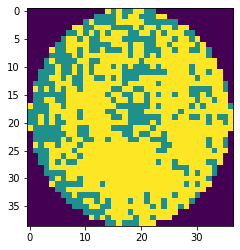

wafer_id:773, ウエハサイズ:39x37, スタンプサイズ:3x3, oDefects:489, nDefects:688, p=71.076


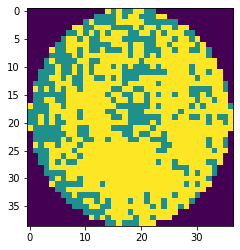

wafer_id:773, ウエハサイズ:39x37, スタンプサイズ:4x3, oDefects:475, nDefects:661, p=71.861


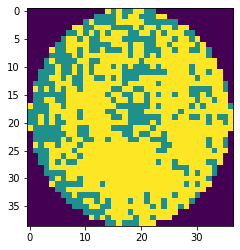

wafer_id:775, ウエハサイズ:39x37, スタンプサイズ:2x2, oDefects:496, nDefects:700, p=70.857


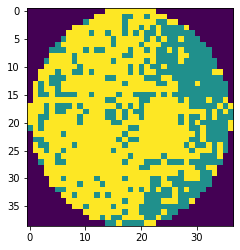

wafer_id:775, ウエハサイズ:39x37, スタンプサイズ:3x2, oDefects:496, nDefects:703, p=70.555


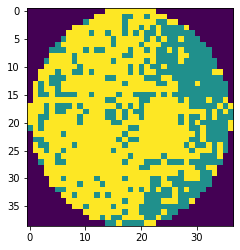

wafer_id:775, ウエハサイズ:39x37, スタンプサイズ:4x2, oDefects:487, nDefects:682, p=71.408


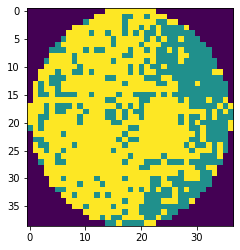

wafer_id:780, ウエハサイズ:39x37, スタンプサイズ:2x2, oDefects:626, nDefects:790, p=79.241


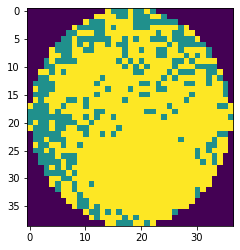

wafer_id:780, ウエハサイズ:39x37, スタンプサイズ:3x2, oDefects:627, nDefects:795, p=78.868


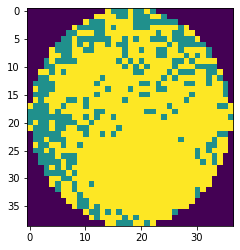

wafer_id:780, ウエハサイズ:39x37, スタンプサイズ:4x2, oDefects:608, nDefects:766, p=79.373


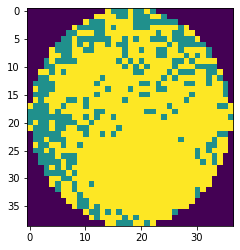

wafer_id:780, ウエハサイズ:39x37, スタンプサイズ:2x3, oDefects:610, nDefects:775, p=78.710


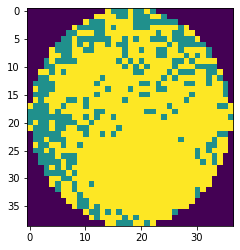

wafer_id:780, ウエハサイズ:39x37, スタンプサイズ:3x3, oDefects:611, nDefects:780, p=78.333


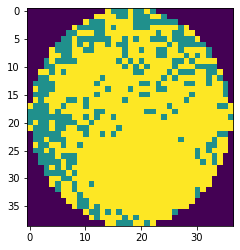

wafer_id:780, ウエハサイズ:39x37, スタンプサイズ:4x3, oDefects:595, nDefects:751, p=79.228


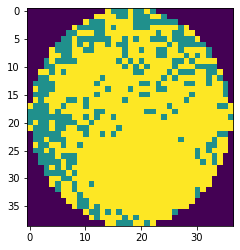

wafer_id:780, ウエハサイズ:39x37, スタンプサイズ:2x4, oDefects:591, nDefects:758, p=77.968


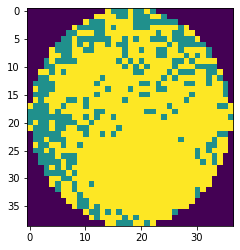

wafer_id:780, ウエハサイズ:39x37, スタンプサイズ:3x4, oDefects:592, nDefects:763, p=77.588


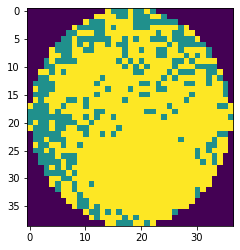

wafer_id:780, ウエハサイズ:39x37, スタンプサイズ:4x4, oDefects:578, nDefects:734, p=78.747


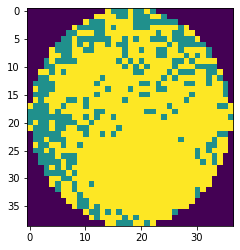

wafer_id:798, ウエハサイズ:34x34, スタンプサイズ:2x2, oDefects:453, nDefects:628, p=72.134


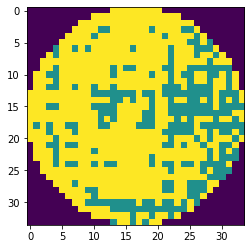

wafer_id:798, ウエハサイズ:34x34, スタンプサイズ:3x2, oDefects:451, nDefects:623, p=72.392


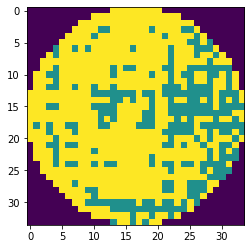

wafer_id:798, ウエハサイズ:34x34, スタンプサイズ:4x2, oDefects:444, nDefects:612, p=72.549


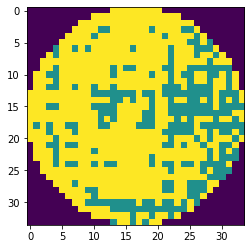

wafer_id:798, ウエハサイズ:34x34, スタンプサイズ:2x3, oDefects:449, nDefects:615, p=73.008


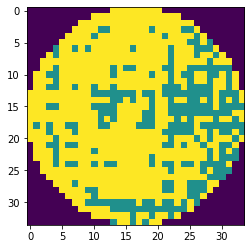

wafer_id:798, ウエハサイズ:34x34, スタンプサイズ:3x3, oDefects:447, nDefects:610, p=73.279


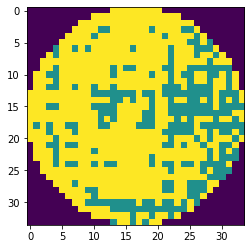

wafer_id:798, ウエハサイズ:34x34, スタンプサイズ:4x3, oDefects:439, nDefects:599, p=73.289


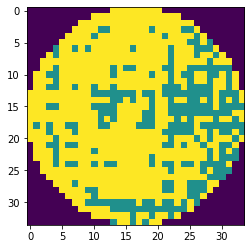

wafer_id:798, ウエハサイズ:34x34, スタンプサイズ:2x4, oDefects:418, nDefects:596, p=70.134


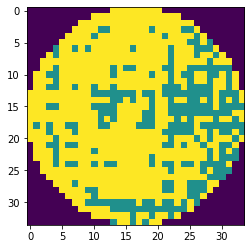

wafer_id:798, ウエハサイズ:34x34, スタンプサイズ:3x4, oDefects:417, nDefects:591, p=70.558


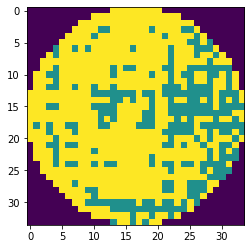

wafer_id:798, ウエハサイズ:34x34, スタンプサイズ:4x4, oDefects:412, nDefects:580, p=71.034


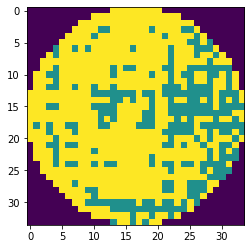

wafer_id:809, ウエハサイズ:44x41, スタンプサイズ:2x2, oDefects:747, nDefects:969, p=77.090


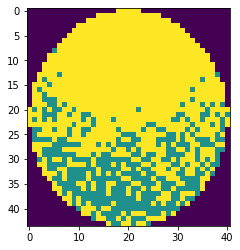

wafer_id:809, ウエハサイズ:44x41, スタンプサイズ:3x2, oDefects:743, nDefects:956, p=77.720


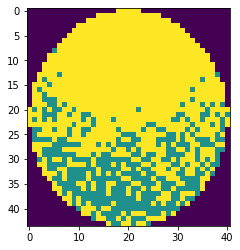

wafer_id:809, ウエハサイズ:44x41, スタンプサイズ:4x2, oDefects:747, nDefects:969, p=77.090


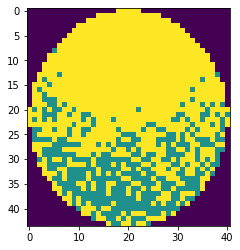

wafer_id:809, ウエハサイズ:44x41, スタンプサイズ:2x3, oDefects:710, nDefects:931, p=76.262


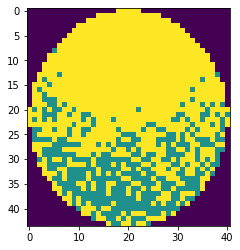

wafer_id:809, ウエハサイズ:44x41, スタンプサイズ:3x3, oDefects:705, nDefects:918, p=76.797


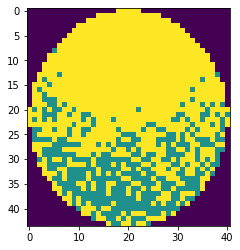

wafer_id:809, ウエハサイズ:44x41, スタンプサイズ:4x3, oDefects:710, nDefects:931, p=76.262


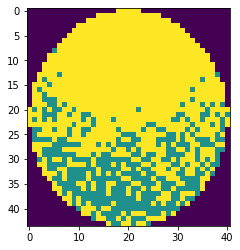

wafer_id:809, ウエハサイズ:44x41, スタンプサイズ:2x4, oDefects:700, nDefects:931, p=75.188


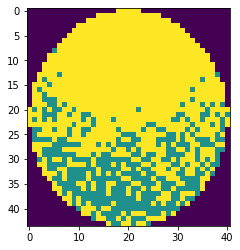

wafer_id:809, ウエハサイズ:44x41, スタンプサイズ:3x4, oDefects:696, nDefects:918, p=75.817


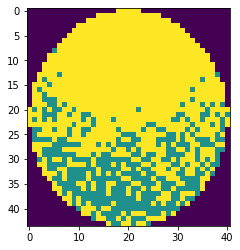

wafer_id:809, ウエハサイズ:44x41, スタンプサイズ:4x4, oDefects:700, nDefects:931, p=75.188


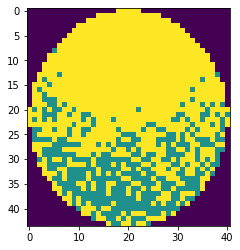

wafer_id:810, ウエハサイズ:44x41, スタンプサイズ:2x2, oDefects:520, nDefects:738, p=70.461


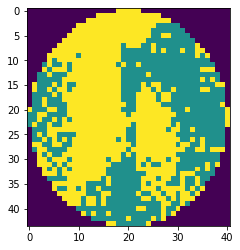

wafer_id:810, ウエハサイズ:44x41, スタンプサイズ:3x2, oDefects:519, nDefects:732, p=70.902


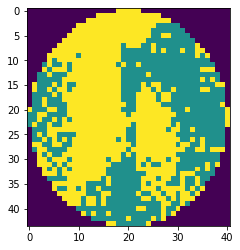

wafer_id:810, ウエハサイズ:44x41, スタンプサイズ:4x2, oDefects:520, nDefects:738, p=70.461


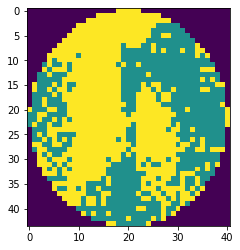

wafer_id:827, ウエハサイズ:41x45, スタンプサイズ:2x4, oDefects:314, nDefects:363, p=86.501


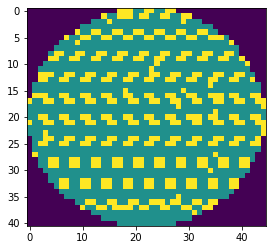

wafer_id:827, ウエハサイズ:41x45, スタンプサイズ:3x4, oDefects:314, nDefects:363, p=86.501


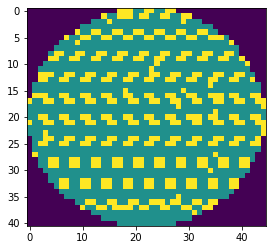

wafer_id:827, ウエハサイズ:41x45, スタンプサイズ:4x4, oDefects:314, nDefects:363, p=86.501


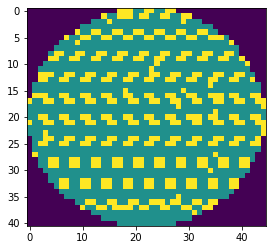

wafer_id:863, ウエハサイズ:26x30, スタンプサイズ:2x2, oDefects:251, nDefects:350, p=71.714


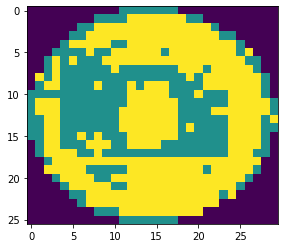

wafer_id:863, ウエハサイズ:26x30, スタンプサイズ:3x2, oDefects:243, nDefects:340, p=71.471


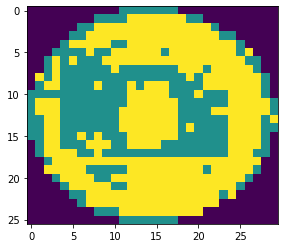

wafer_id:863, ウエハサイズ:26x30, スタンプサイズ:4x2, oDefects:243, nDefects:340, p=71.471


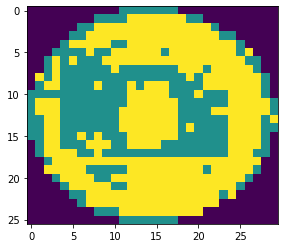

In [31]:
# random pattern 70
for w_id in range(len(sub_df)):
    x = sub_df.iloc[w_id, :]['waferMap']
    if w_id % 1000 == 0: print(x.shape)
    for w in range(2, 5):
        for h in range(2, 5):
            detectShotDefects(x, w_id, w, h)

(26, 26)
wafer_id:8, ウエハサイズ:26x26, スタンプサイズ:2x3, oDefects:156, nDefects:238, p=65.546


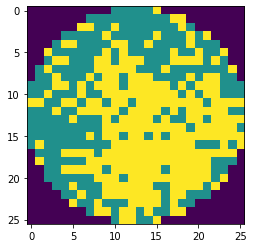

wafer_id:8, ウエハサイズ:26x26, スタンプサイズ:3x3, oDefects:151, nDefects:228, p=66.228


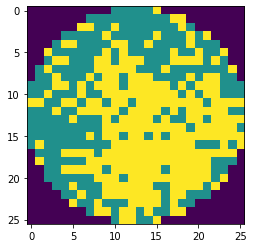

wafer_id:8, ウエハサイズ:26x26, スタンプサイズ:4x3, oDefects:151, nDefects:228, p=66.228


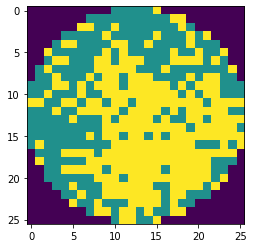

wafer_id:76, ウエハサイズ:41x41, スタンプサイズ:2x2, oDefects:550, nDefects:841, p=65.398


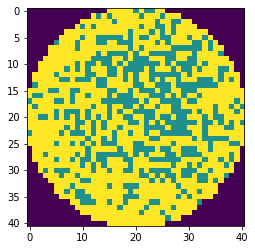

wafer_id:76, ウエハサイズ:41x41, スタンプサイズ:3x2, oDefects:537, nDefects:825, p=65.091


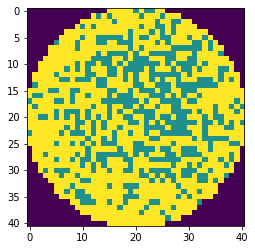

wafer_id:76, ウエハサイズ:41x41, スタンプサイズ:4x2, oDefects:550, nDefects:841, p=65.398


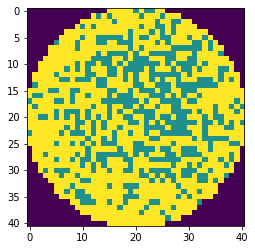

wafer_id:77, ウエハサイズ:41x41, スタンプサイズ:2x2, oDefects:544, nDefects:830, p=65.542


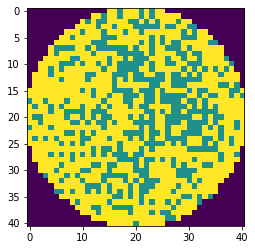

wafer_id:77, ウエハサイズ:41x41, スタンプサイズ:3x2, oDefects:532, nDefects:815, p=65.276


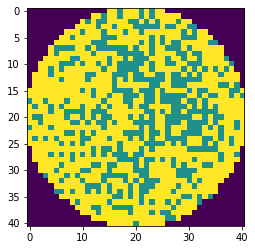

wafer_id:77, ウエハサイズ:41x41, スタンプサイズ:4x2, oDefects:544, nDefects:830, p=65.542


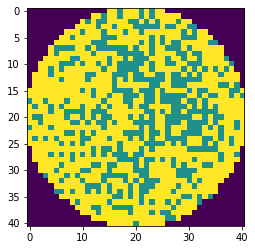

wafer_id:80, ウエハサイズ:41x41, スタンプサイズ:2x2, oDefects:579, nDefects:876, p=66.096


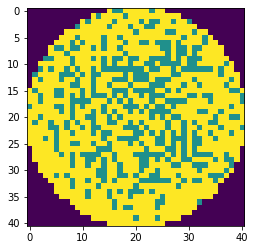

wafer_id:80, ウエハサイズ:41x41, スタンプサイズ:3x2, oDefects:568, nDefects:861, p=65.970


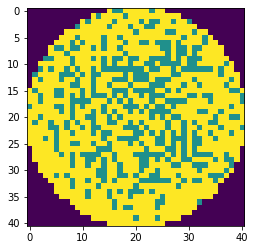

wafer_id:80, ウエハサイズ:41x41, スタンプサイズ:4x2, oDefects:579, nDefects:876, p=66.096


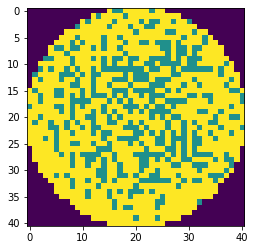

wafer_id:80, ウエハサイズ:41x41, スタンプサイズ:2x3, oDefects:549, nDefects:837, p=65.591


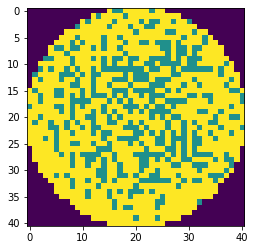

wafer_id:80, ウエハサイズ:41x41, スタンプサイズ:3x3, oDefects:539, nDefects:822, p=65.572


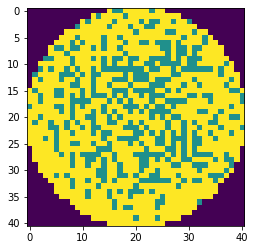

wafer_id:80, ウエハサイズ:41x41, スタンプサイズ:4x3, oDefects:549, nDefects:837, p=65.591


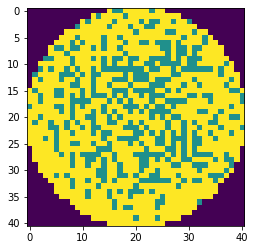

wafer_id:82, ウエハサイズ:41x41, スタンプサイズ:2x2, oDefects:570, nDefects:853, p=66.823


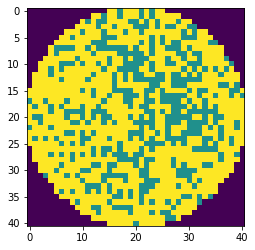

wafer_id:82, ウエハサイズ:41x41, スタンプサイズ:3x2, oDefects:558, nDefects:838, p=66.587


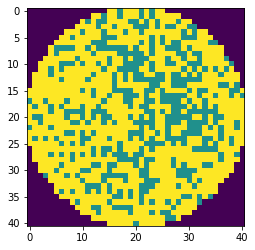

wafer_id:82, ウエハサイズ:41x41, スタンプサイズ:4x2, oDefects:570, nDefects:853, p=66.823


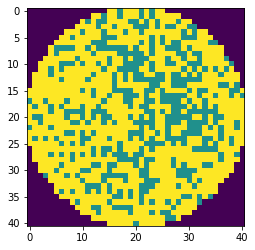

wafer_id:128, ウエハサイズ:41x41, スタンプサイズ:2x2, oDefects:560, nDefects:854, p=65.574


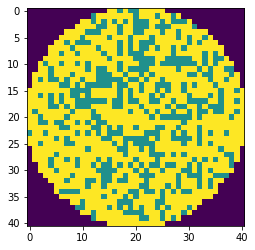

wafer_id:128, ウエハサイズ:41x41, スタンプサイズ:3x2, oDefects:552, nDefects:842, p=65.558


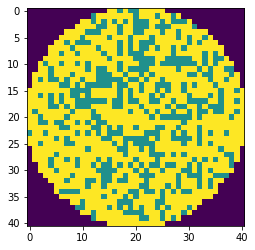

wafer_id:128, ウエハサイズ:41x41, スタンプサイズ:4x2, oDefects:560, nDefects:854, p=65.574


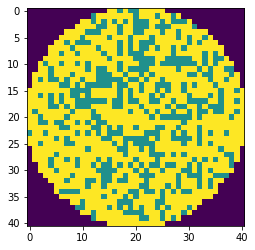

wafer_id:205, ウエハサイズ:37x40, スタンプサイズ:2x2, oDefects:481, nDefects:717, p=67.085


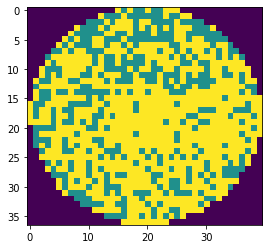

wafer_id:205, ウエハサイズ:37x40, スタンプサイズ:3x2, oDefects:481, nDefects:717, p=67.085


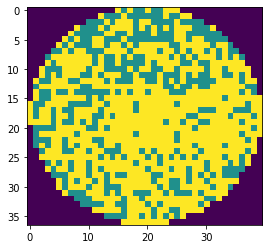

wafer_id:205, ウエハサイズ:37x40, スタンプサイズ:4x2, oDefects:481, nDefects:717, p=67.085


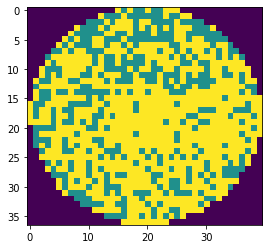

wafer_id:205, ウエハサイズ:37x40, スタンプサイズ:2x3, oDefects:457, nDefects:695, p=65.755


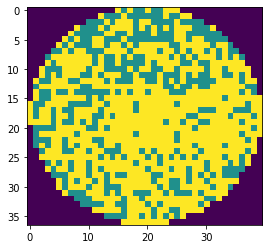

wafer_id:205, ウエハサイズ:37x40, スタンプサイズ:3x3, oDefects:457, nDefects:695, p=65.755


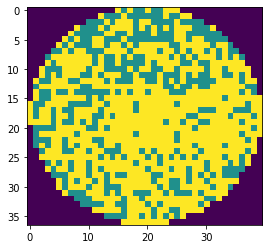

wafer_id:205, ウエハサイズ:37x40, スタンプサイズ:4x3, oDefects:457, nDefects:695, p=65.755


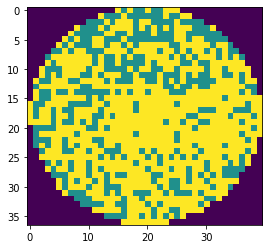

wafer_id:260, ウエハサイズ:32x32, スタンプサイズ:2x4, oDefects:225, nDefects:337, p=66.766


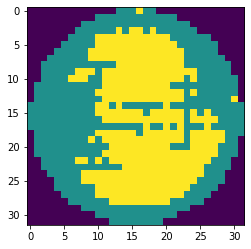

wafer_id:260, ウエハサイズ:32x32, スタンプサイズ:3x4, oDefects:225, nDefects:337, p=66.766


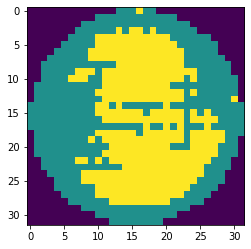

wafer_id:260, ウエハサイズ:32x32, スタンプサイズ:4x4, oDefects:225, nDefects:337, p=66.766


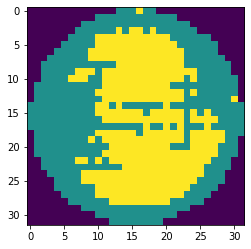

wafer_id:261, ウエハサイズ:32x32, スタンプサイズ:2x2, oDefects:246, nDefects:356, p=69.101


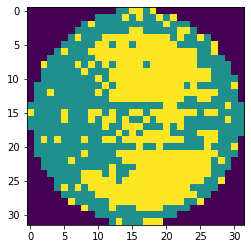

wafer_id:261, ウエハサイズ:32x32, スタンプサイズ:3x2, oDefects:245, nDefects:352, p=69.602


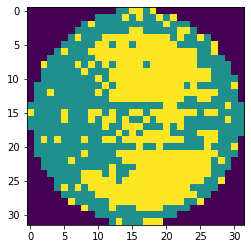

wafer_id:261, ウエハサイズ:32x32, スタンプサイズ:4x2, oDefects:246, nDefects:356, p=69.101


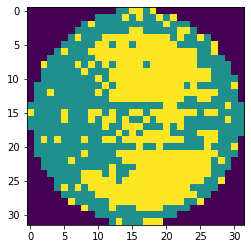

wafer_id:261, ウエハサイズ:32x32, スタンプサイズ:2x3, oDefects:228, nDefects:345, p=66.087


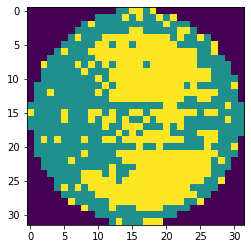

wafer_id:261, ウエハサイズ:32x32, スタンプサイズ:3x3, oDefects:228, nDefects:341, p=66.862


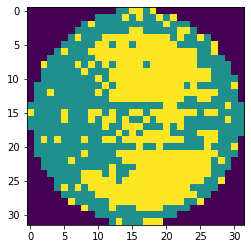

wafer_id:261, ウエハサイズ:32x32, スタンプサイズ:4x3, oDefects:228, nDefects:345, p=66.087


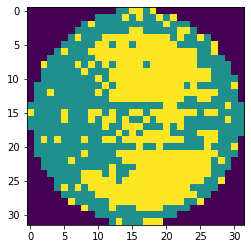

wafer_id:262, ウエハサイズ:32x32, スタンプサイズ:2x4, oDefects:285, nDefects:417, p=68.345


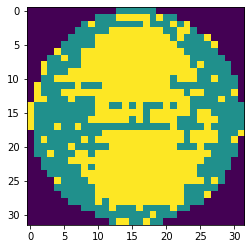

wafer_id:262, ウエハサイズ:32x32, スタンプサイズ:3x4, oDefects:284, nDefects:413, p=68.765


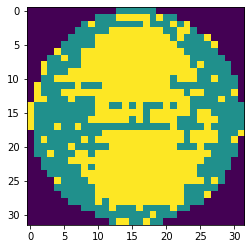

wafer_id:262, ウエハサイズ:32x32, スタンプサイズ:4x4, oDefects:285, nDefects:417, p=68.345


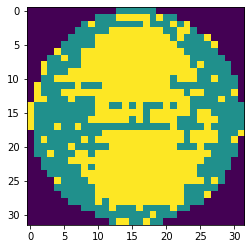

wafer_id:276, ウエハサイズ:58x60, スタンプサイズ:3x3, oDefects:1281, nDefects:1831, p=69.962


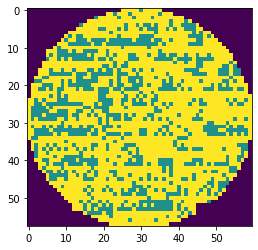

wafer_id:276, ウエハサイズ:58x60, スタンプサイズ:4x3, oDefects:1266, nDefects:1811, p=69.906


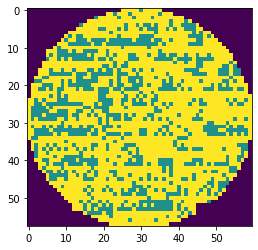

wafer_id:276, ウエハサイズ:58x60, スタンプサイズ:2x4, oDefects:1254, nDefects:1830, p=68.525


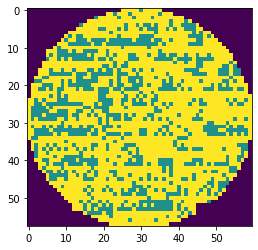

wafer_id:276, ウエハサイズ:58x60, スタンプサイズ:3x4, oDefects:1242, nDefects:1814, p=68.467


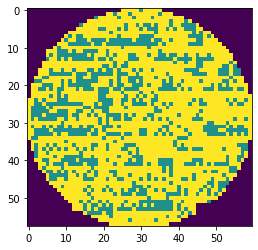

wafer_id:276, ウエハサイズ:58x60, スタンプサイズ:4x4, oDefects:1228, nDefects:1794, p=68.450


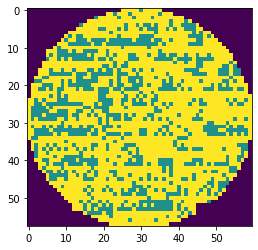

wafer_id:280, ウエハサイズ:41x51, スタンプサイズ:2x4, oDefects:652, nDefects:979, p=66.599


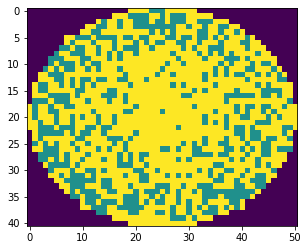

wafer_id:280, ウエハサイズ:41x51, スタンプサイズ:3x4, oDefects:643, nDefects:964, p=66.701


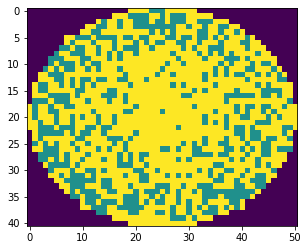

wafer_id:280, ウエハサイズ:41x51, スタンプサイズ:4x4, oDefects:652, nDefects:979, p=66.599


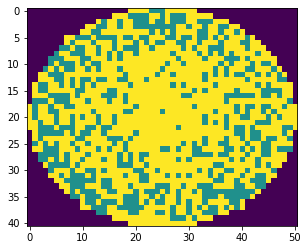

wafer_id:370, ウエハサイズ:50x43, スタンプサイズ:2x2, oDefects:789, nDefects:1142, p=69.089


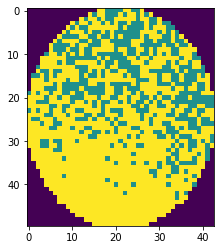

wafer_id:370, ウエハサイズ:50x43, スタンプサイズ:3x2, oDefects:763, nDefects:1112, p=68.615


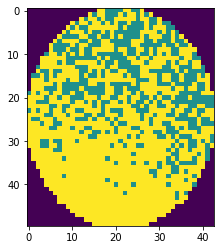

wafer_id:370, ウエハサイズ:50x43, スタンプサイズ:4x2, oDefects:763, nDefects:1112, p=68.615


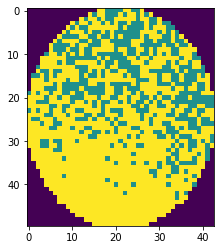

wafer_id:370, ウエハサイズ:50x43, スタンプサイズ:2x4, oDefects:736, nDefects:1076, p=68.401


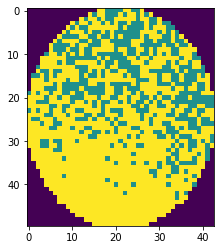

wafer_id:370, ウエハサイズ:50x43, スタンプサイズ:3x4, oDefects:714, nDefects:1046, p=68.260


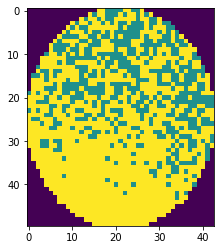

wafer_id:370, ウエハサイズ:50x43, スタンプサイズ:4x4, oDefects:714, nDefects:1046, p=68.260


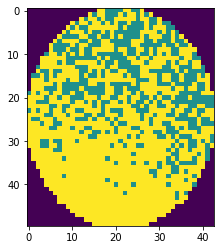

wafer_id:373, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:496, nDefects:712, p=69.663


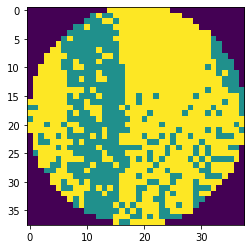

wafer_id:373, ウエハサイズ:38x38, スタンプサイズ:2x3, oDefects:448, nDefects:673, p=66.568


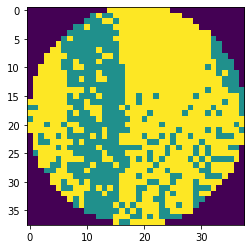

wafer_id:373, ウエハサイズ:38x38, スタンプサイズ:3x3, oDefects:443, nDefects:661, p=67.020


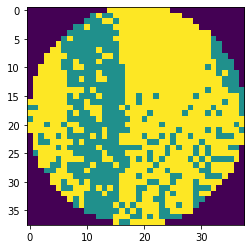

wafer_id:373, ウエハサイズ:38x38, スタンプサイズ:4x3, oDefects:443, nDefects:661, p=67.020


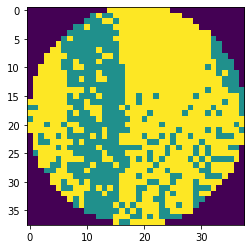

wafer_id:373, ウエハサイズ:38x38, スタンプサイズ:3x4, oDefects:417, nDefects:641, p=65.055


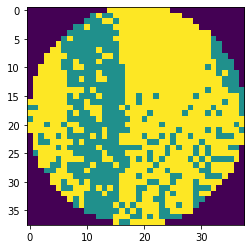

wafer_id:373, ウエハサイズ:38x38, スタンプサイズ:4x4, oDefects:417, nDefects:641, p=65.055


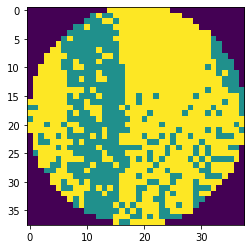

wafer_id:375, ウエハサイズ:50x43, スタンプサイズ:2x2, oDefects:737, nDefects:1060, p=69.528


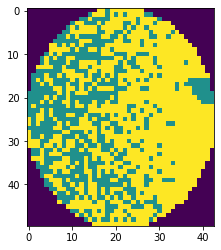

wafer_id:375, ウエハサイズ:50x43, スタンプサイズ:3x2, oDefects:720, nDefects:1038, p=69.364


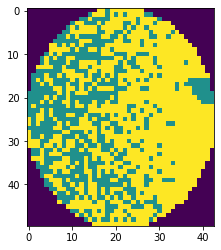

wafer_id:375, ウエハサイズ:50x43, スタンプサイズ:4x2, oDefects:720, nDefects:1038, p=69.364


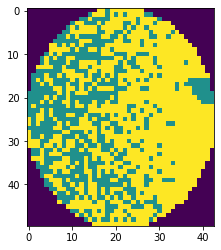

wafer_id:375, ウエハサイズ:50x43, スタンプサイズ:2x3, oDefects:701, nDefects:1037, p=67.599


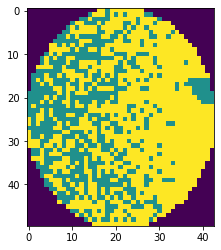

wafer_id:375, ウエハサイズ:50x43, スタンプサイズ:3x3, oDefects:688, nDefects:1015, p=67.783


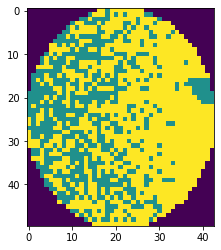

wafer_id:375, ウエハサイズ:50x43, スタンプサイズ:4x3, oDefects:688, nDefects:1015, p=67.783


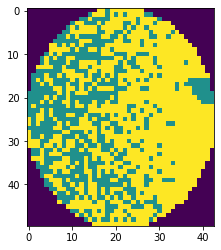

wafer_id:375, ウエハサイズ:50x43, スタンプサイズ:2x4, oDefects:636, nDefects:942, p=67.516


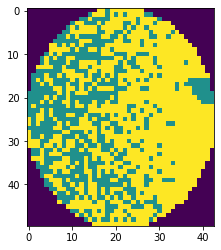

wafer_id:375, ウエハサイズ:50x43, スタンプサイズ:3x4, oDefects:623, nDefects:920, p=67.717


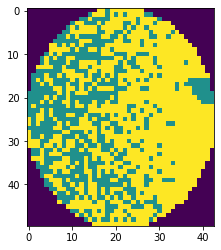

wafer_id:375, ウエハサイズ:50x43, スタンプサイズ:4x4, oDefects:623, nDefects:920, p=67.717


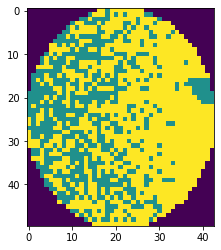

wafer_id:376, ウエハサイズ:25x26, スタンプサイズ:2x2, oDefects:216, nDefects:322, p=67.081


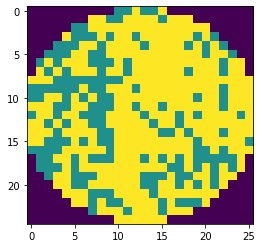

wafer_id:376, ウエハサイズ:25x26, スタンプサイズ:3x2, oDefects:216, nDefects:322, p=67.081


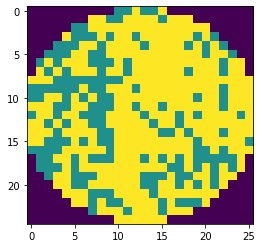

wafer_id:376, ウエハサイズ:25x26, スタンプサイズ:4x2, oDefects:216, nDefects:322, p=67.081


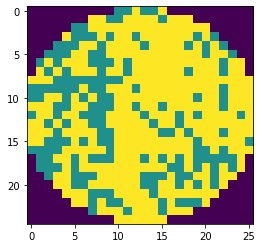

wafer_id:376, ウエハサイズ:25x26, スタンプサイズ:2x3, oDefects:189, nDefects:288, p=65.625


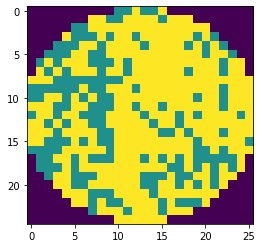

wafer_id:376, ウエハサイズ:25x26, スタンプサイズ:3x3, oDefects:189, nDefects:288, p=65.625


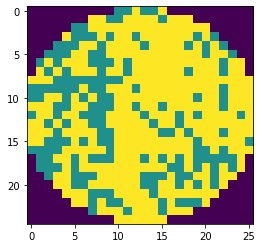

wafer_id:376, ウエハサイズ:25x26, スタンプサイズ:4x3, oDefects:189, nDefects:288, p=65.625


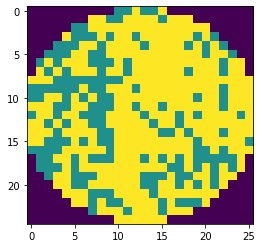

wafer_id:376, ウエハサイズ:25x26, スタンプサイズ:2x4, oDefects:187, nDefects:271, p=69.004


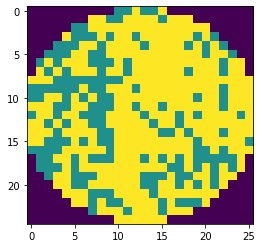

wafer_id:376, ウエハサイズ:25x26, スタンプサイズ:3x4, oDefects:187, nDefects:271, p=69.004


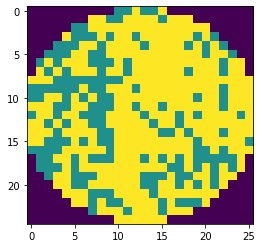

wafer_id:376, ウエハサイズ:25x26, スタンプサイズ:4x4, oDefects:187, nDefects:271, p=69.004


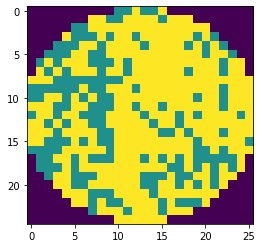

wafer_id:422, ウエハサイズ:43x42, スタンプサイズ:2x2, oDefects:707, nDefects:1013, p=69.793


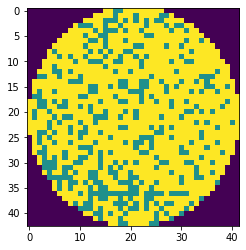

wafer_id:422, ウエハサイズ:43x42, スタンプサイズ:3x2, oDefects:707, nDefects:1013, p=69.793


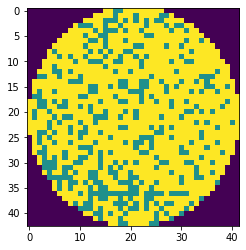

wafer_id:422, ウエハサイズ:43x42, スタンプサイズ:2x3, oDefects:696, nDefects:995, p=69.950


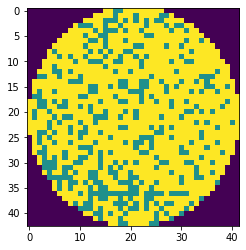

wafer_id:422, ウエハサイズ:43x42, スタンプサイズ:3x3, oDefects:696, nDefects:995, p=69.950


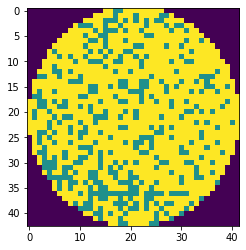

wafer_id:422, ウエハサイズ:43x42, スタンプサイズ:2x4, oDefects:649, nDefects:928, p=69.935


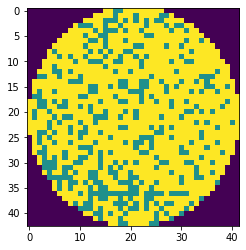

wafer_id:422, ウエハサイズ:43x42, スタンプサイズ:3x4, oDefects:649, nDefects:928, p=69.935


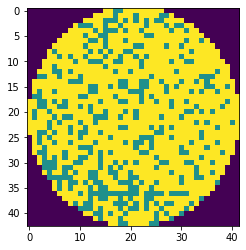

wafer_id:427, ウエハサイズ:41x42, スタンプサイズ:2x2, oDefects:505, nDefects:771, p=65.499


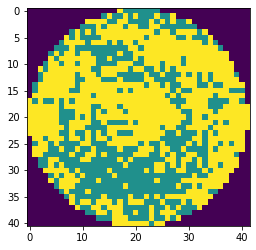

wafer_id:427, ウエハサイズ:41x42, スタンプサイズ:3x2, oDefects:503, nDefects:765, p=65.752


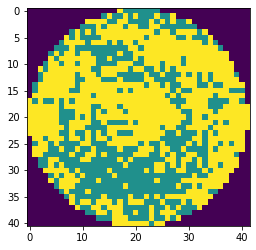

wafer_id:427, ウエハサイズ:41x42, スタンプサイズ:4x2, oDefects:505, nDefects:771, p=65.499


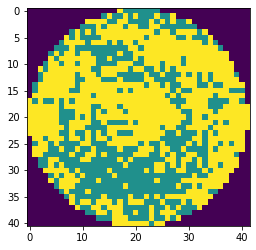

wafer_id:430, ウエハサイズ:41x42, スタンプサイズ:2x3, oDefects:392, nDefects:582, p=67.354


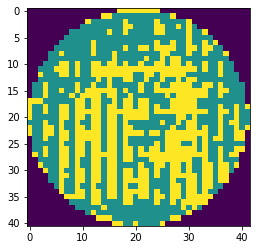

wafer_id:430, ウエハサイズ:41x42, スタンプサイズ:3x3, oDefects:392, nDefects:577, p=67.938


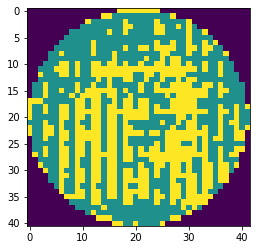

wafer_id:430, ウエハサイズ:41x42, スタンプサイズ:4x3, oDefects:392, nDefects:582, p=67.354


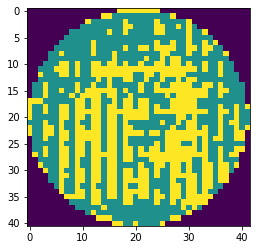

wafer_id:431, ウエハサイズ:41x42, スタンプサイズ:2x3, oDefects:320, nDefects:488, p=65.574


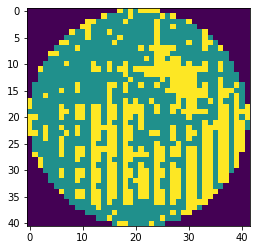

wafer_id:431, ウエハサイズ:41x42, スタンプサイズ:3x3, oDefects:320, nDefects:486, p=65.844


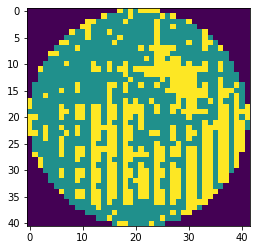

wafer_id:431, ウエハサイズ:41x42, スタンプサイズ:4x3, oDefects:320, nDefects:488, p=65.574


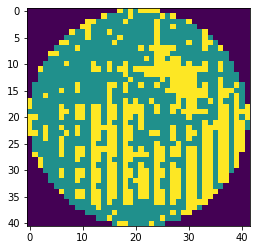

wafer_id:432, ウエハサイズ:41x42, スタンプサイズ:2x3, oDefects:338, nDefects:501, p=67.465


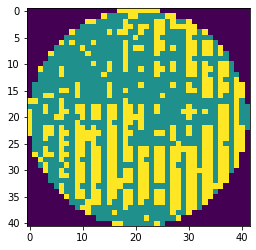

wafer_id:432, ウエハサイズ:41x42, スタンプサイズ:3x3, oDefects:338, nDefects:499, p=67.735


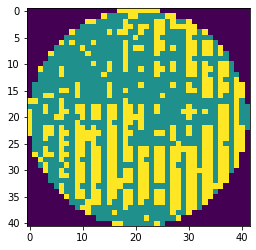

wafer_id:432, ウエハサイズ:41x42, スタンプサイズ:4x3, oDefects:338, nDefects:501, p=67.465


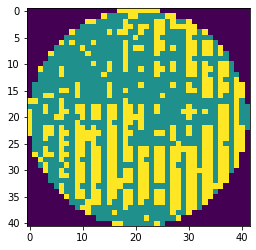

wafer_id:436, ウエハサイズ:41x42, スタンプサイズ:2x3, oDefects:356, nDefects:531, p=67.043


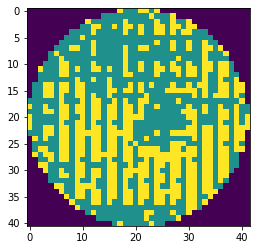

wafer_id:436, ウエハサイズ:41x42, スタンプサイズ:3x3, oDefects:356, nDefects:529, p=67.297


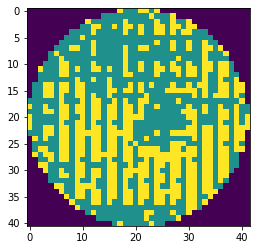

wafer_id:436, ウエハサイズ:41x42, スタンプサイズ:4x3, oDefects:356, nDefects:531, p=67.043


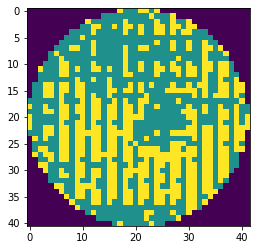

wafer_id:437, ウエハサイズ:41x42, スタンプサイズ:2x3, oDefects:338, nDefects:520, p=65.000


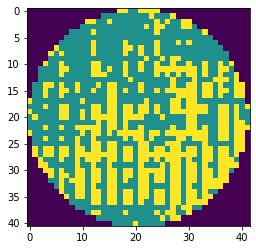

wafer_id:437, ウエハサイズ:41x42, スタンプサイズ:3x3, oDefects:337, nDefects:517, p=65.184


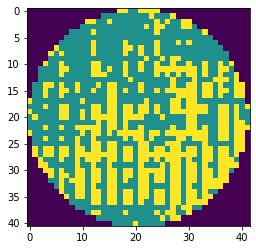

wafer_id:437, ウエハサイズ:41x42, スタンプサイズ:4x3, oDefects:338, nDefects:520, p=65.000


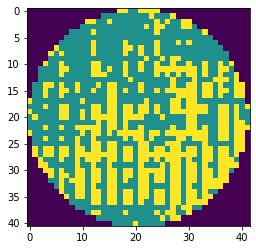

wafer_id:440, ウエハサイズ:41x42, スタンプサイズ:2x3, oDefects:416, nDefects:608, p=68.421


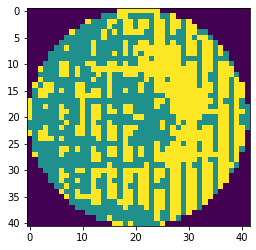

wafer_id:440, ウエハサイズ:41x42, スタンプサイズ:3x3, oDefects:415, nDefects:605, p=68.595


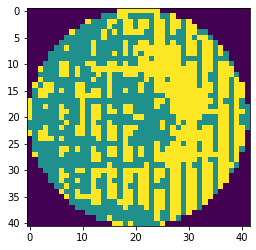

wafer_id:440, ウエハサイズ:41x42, スタンプサイズ:4x3, oDefects:416, nDefects:608, p=68.421


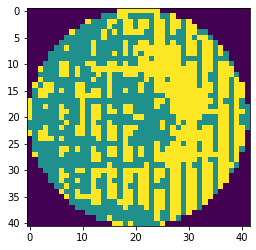

wafer_id:441, ウエハサイズ:41x42, スタンプサイズ:2x2, oDefects:558, nDefects:801, p=69.663


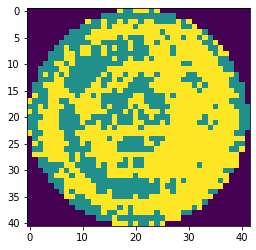

wafer_id:441, ウエハサイズ:41x42, スタンプサイズ:3x2, oDefects:557, nDefects:797, p=69.887


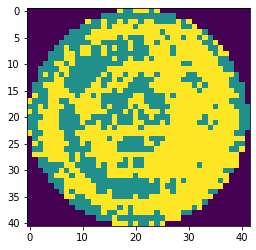

wafer_id:441, ウエハサイズ:41x42, スタンプサイズ:4x2, oDefects:558, nDefects:801, p=69.663


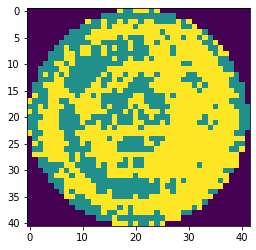

wafer_id:441, ウエハサイズ:41x42, スタンプサイズ:2x3, oDefects:529, nDefects:792, p=66.793


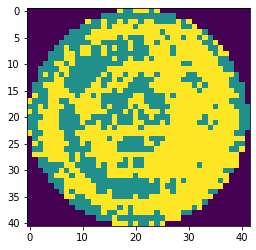

wafer_id:441, ウエハサイズ:41x42, スタンプサイズ:3x3, oDefects:529, nDefects:788, p=67.132


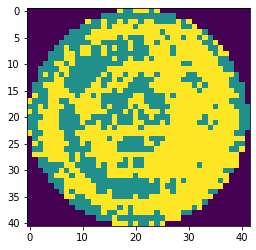

wafer_id:441, ウエハサイズ:41x42, スタンプサイズ:4x3, oDefects:529, nDefects:792, p=66.793


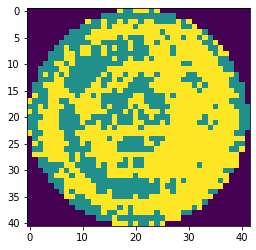

wafer_id:467, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:260, nDefects:397, p=65.491


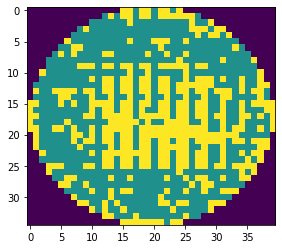

wafer_id:467, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:260, nDefects:393, p=66.158


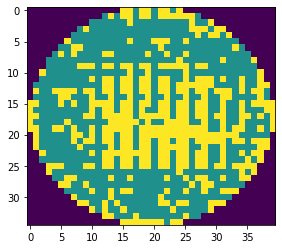

wafer_id:467, ウエハサイズ:35x40, スタンプサイズ:4x3, oDefects:259, nDefects:388, p=66.753


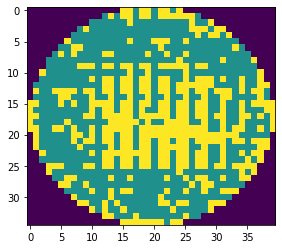

wafer_id:469, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:192, nDefects:290, p=66.207


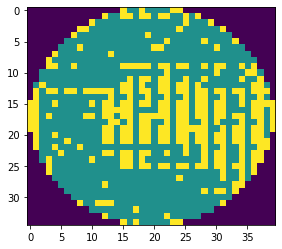

wafer_id:469, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:192, nDefects:288, p=66.667


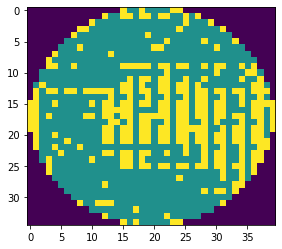

wafer_id:469, ウエハサイズ:35x40, スタンプサイズ:4x3, oDefects:192, nDefects:287, p=66.899


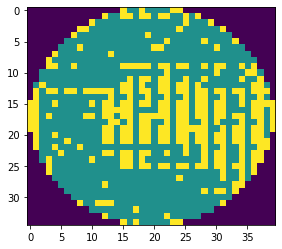

wafer_id:486, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:258, nDefects:379, p=68.074


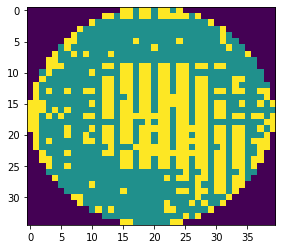

wafer_id:486, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:258, nDefects:377, p=68.435


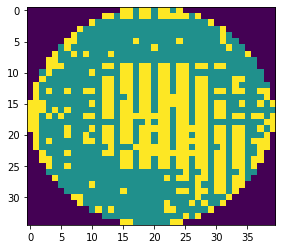

wafer_id:486, ウエハサイズ:35x40, スタンプサイズ:4x3, oDefects:258, nDefects:372, p=69.355


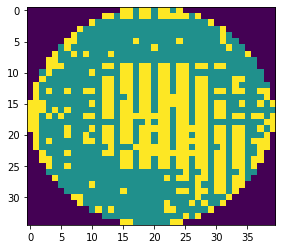

wafer_id:487, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:297, nDefects:435, p=68.276


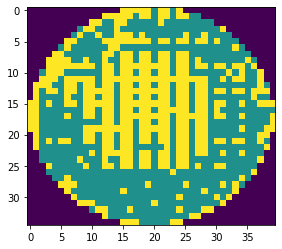

wafer_id:487, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:297, nDefects:432, p=68.750


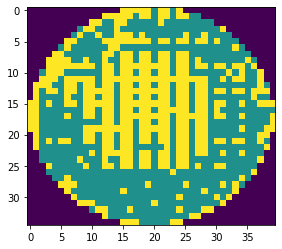

wafer_id:487, ウエハサイズ:35x40, スタンプサイズ:4x3, oDefects:297, nDefects:426, p=69.718


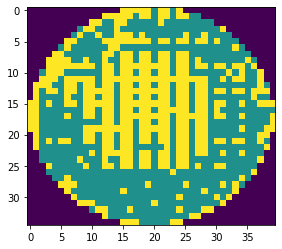

wafer_id:492, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:237, nDefects:357, p=66.387


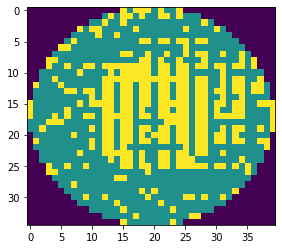

wafer_id:492, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:237, nDefects:354, p=66.949


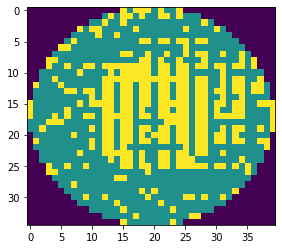

wafer_id:492, ウエハサイズ:35x40, スタンプサイズ:4x3, oDefects:237, nDefects:352, p=67.330


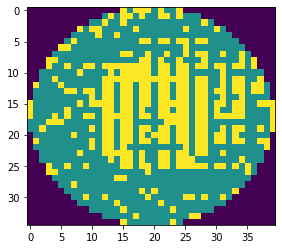

wafer_id:495, ウエハサイズ:35x40, スタンプサイズ:2x2, oDefects:448, nDefects:678, p=66.077


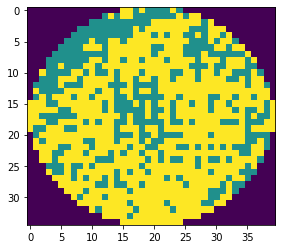

wafer_id:495, ウエハサイズ:35x40, スタンプサイズ:3x2, oDefects:436, nDefects:663, p=65.762


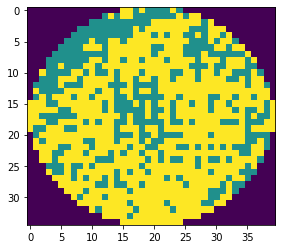

wafer_id:495, ウエハサイズ:35x40, スタンプサイズ:4x2, oDefects:423, nDefects:646, p=65.480


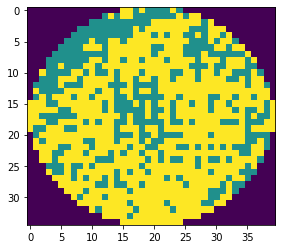

wafer_id:495, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:451, nDefects:656, p=68.750


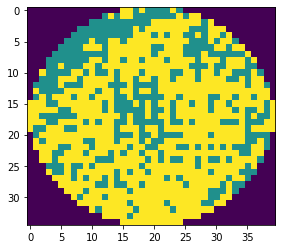

wafer_id:495, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:440, nDefects:641, p=68.643


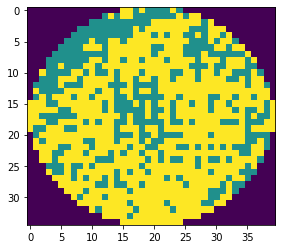

wafer_id:495, ウエハサイズ:35x40, スタンプサイズ:4x3, oDefects:428, nDefects:624, p=68.590


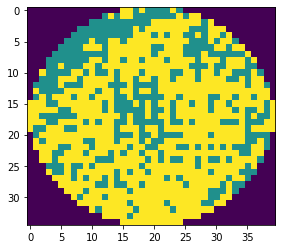

wafer_id:503, ウエハサイズ:35x40, スタンプサイズ:2x2, oDefects:480, nDefects:711, p=67.511


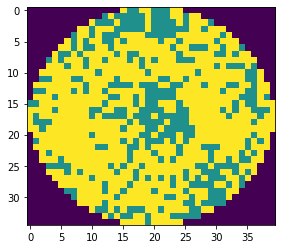

wafer_id:503, ウエハサイズ:35x40, スタンプサイズ:3x2, oDefects:477, nDefects:704, p=67.756


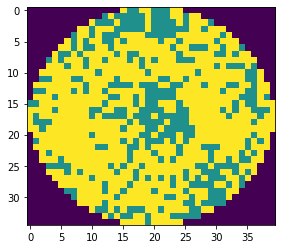

wafer_id:503, ウエハサイズ:35x40, スタンプサイズ:4x2, oDefects:473, nDefects:693, p=68.254


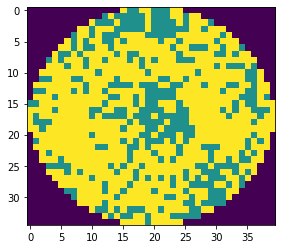

wafer_id:503, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:461, nDefects:691, p=66.715


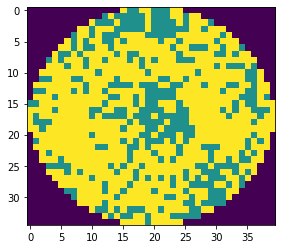

wafer_id:503, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:458, nDefects:684, p=66.959


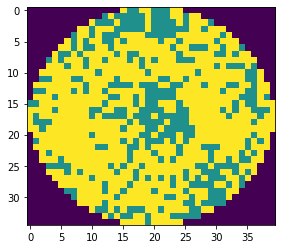

wafer_id:503, ウエハサイズ:35x40, スタンプサイズ:4x3, oDefects:453, nDefects:673, p=67.311


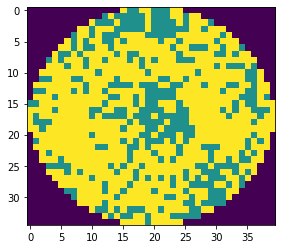

wafer_id:503, ウエハサイズ:35x40, スタンプサイズ:2x4, oDefects:462, nDefects:691, p=66.860


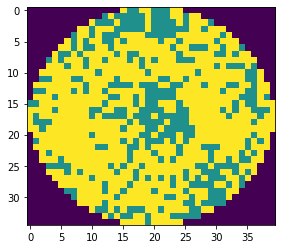

wafer_id:503, ウエハサイズ:35x40, スタンプサイズ:3x4, oDefects:459, nDefects:684, p=67.105


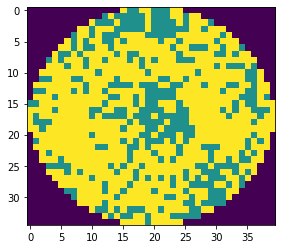

wafer_id:503, ウエハサイズ:35x40, スタンプサイズ:4x4, oDefects:454, nDefects:673, p=67.459


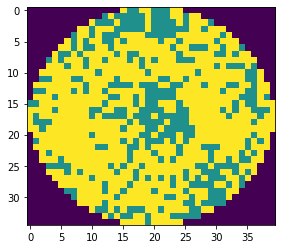

wafer_id:504, ウエハサイズ:35x40, スタンプサイズ:2x2, oDefects:515, nDefects:738, p=69.783


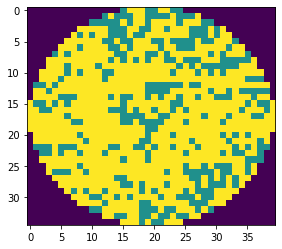

wafer_id:504, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:487, nDefects:717, p=67.922


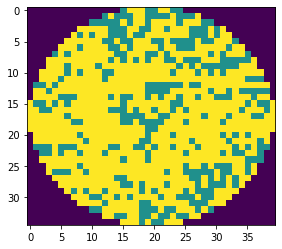

wafer_id:504, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:483, nDefects:709, p=68.124


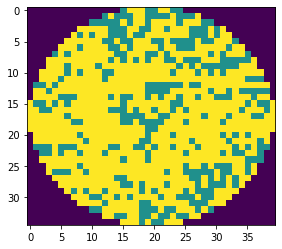

wafer_id:504, ウエハサイズ:35x40, スタンプサイズ:4x3, oDefects:478, nDefects:698, p=68.481


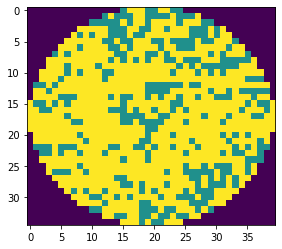

wafer_id:504, ウエハサイズ:35x40, スタンプサイズ:2x4, oDefects:485, nDefects:717, p=67.643


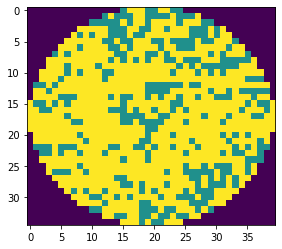

wafer_id:504, ウエハサイズ:35x40, スタンプサイズ:3x4, oDefects:481, nDefects:709, p=67.842


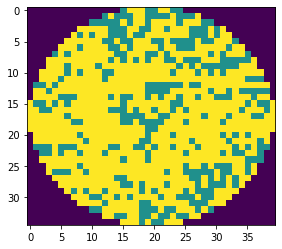

wafer_id:504, ウエハサイズ:35x40, スタンプサイズ:4x4, oDefects:476, nDefects:698, p=68.195


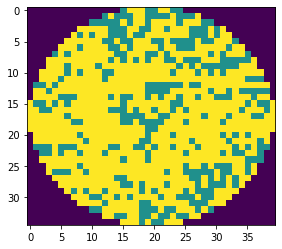

wafer_id:505, ウエハサイズ:35x40, スタンプサイズ:2x2, oDefects:451, nDefects:685, p=65.839


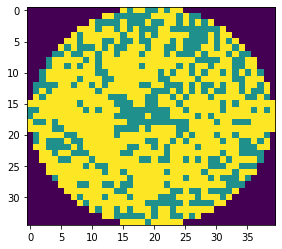

wafer_id:505, ウエハサイズ:35x40, スタンプサイズ:3x2, oDefects:449, nDefects:678, p=66.224


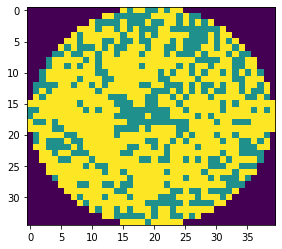

wafer_id:505, ウエハサイズ:35x40, スタンプサイズ:4x2, oDefects:439, nDefects:663, p=66.214


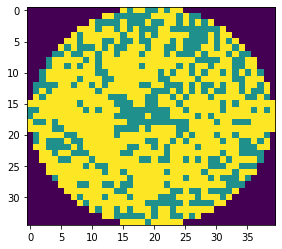

wafer_id:513, ウエハサイズ:35x40, スタンプサイズ:2x2, oDefects:435, nDefects:651, p=66.820


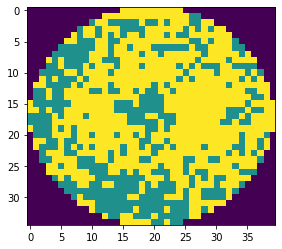

wafer_id:513, ウエハサイズ:35x40, スタンプサイズ:3x2, oDefects:435, nDefects:645, p=67.442


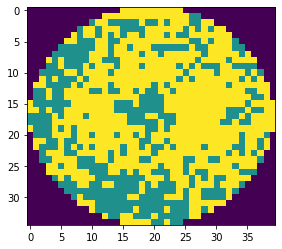

wafer_id:513, ウエハサイズ:35x40, スタンプサイズ:4x2, oDefects:434, nDefects:639, p=67.919


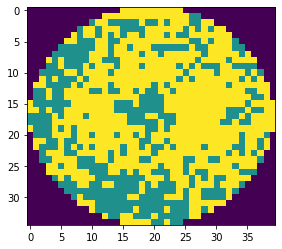

wafer_id:513, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:408, nDefects:624, p=65.385


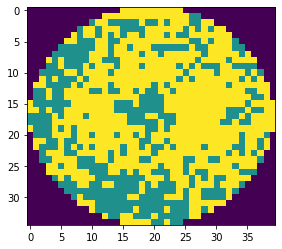

wafer_id:513, ウエハサイズ:35x40, スタンプサイズ:4x3, oDefects:407, nDefects:618, p=65.858


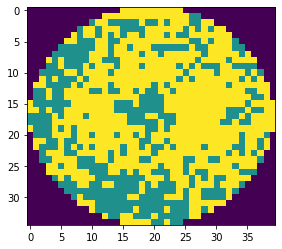

wafer_id:517, ウエハサイズ:35x40, スタンプサイズ:2x4, oDefects:488, nDefects:710, p=68.732


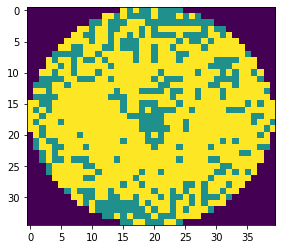

wafer_id:517, ウエハサイズ:35x40, スタンプサイズ:3x4, oDefects:486, nDefects:703, p=69.132


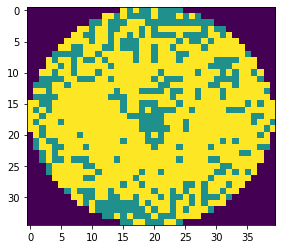

wafer_id:517, ウエハサイズ:35x40, スタンプサイズ:4x4, oDefects:484, nDefects:695, p=69.640


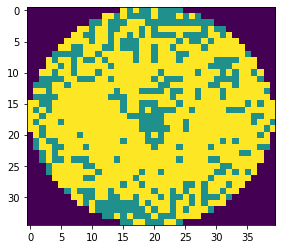

wafer_id:527, ウエハサイズ:35x40, スタンプサイズ:3x4, oDefects:286, nDefects:437, p=65.446


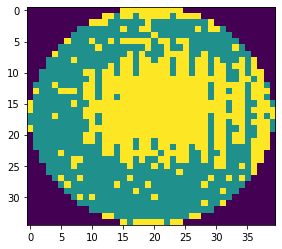

wafer_id:527, ウエハサイズ:35x40, スタンプサイズ:4x4, oDefects:286, nDefects:437, p=65.446


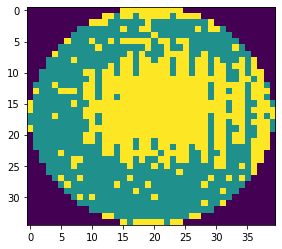

wafer_id:528, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:235, nDefects:356, p=66.011


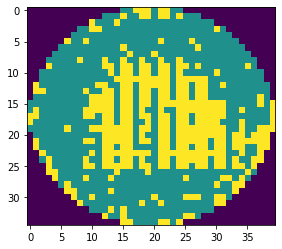

wafer_id:528, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:234, nDefects:352, p=66.477


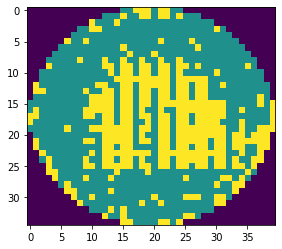

wafer_id:528, ウエハサイズ:35x40, スタンプサイズ:4x3, oDefects:234, nDefects:350, p=66.857


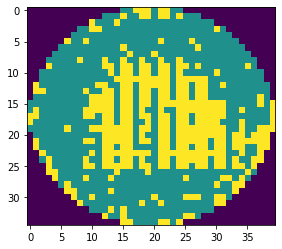

wafer_id:547, ウエハサイズ:32x29, スタンプサイズ:2x2, oDefects:301, nDefects:459, p=65.577


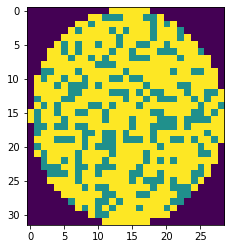

wafer_id:547, ウエハサイズ:32x29, スタンプサイズ:3x2, oDefects:289, nDefects:442, p=65.385


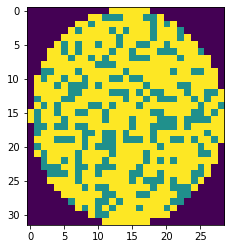

wafer_id:547, ウエハサイズ:32x29, スタンプサイズ:4x2, oDefects:301, nDefects:459, p=65.577


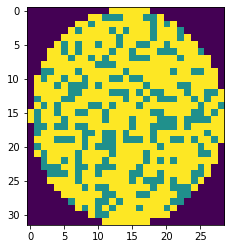

wafer_id:561, ウエハサイズ:26x25, スタンプサイズ:2x2, oDefects:236, nDefects:339, p=69.617


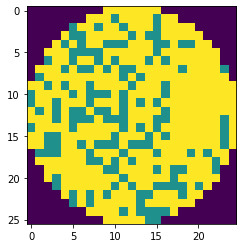

wafer_id:561, ウエハサイズ:26x25, スタンプサイズ:3x3, oDefects:203, nDefects:311, p=65.273


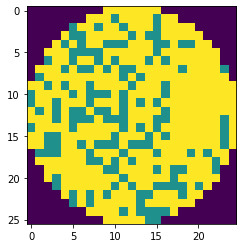

wafer_id:561, ウエハサイズ:26x25, スタンプサイズ:4x3, oDefects:203, nDefects:311, p=65.273


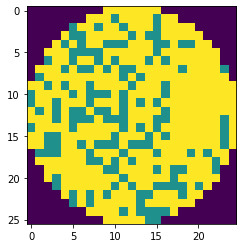

wafer_id:561, ウエハサイズ:26x25, スタンプサイズ:2x4, oDefects:200, nDefects:303, p=66.007


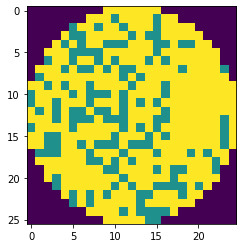

wafer_id:561, ウエハサイズ:26x25, スタンプサイズ:3x4, oDefects:198, nDefects:292, p=67.808


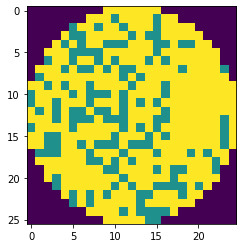

wafer_id:561, ウエハサイズ:26x25, スタンプサイズ:4x4, oDefects:198, nDefects:292, p=67.808


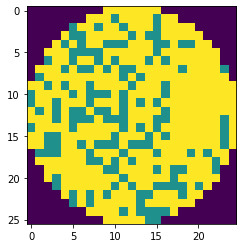

wafer_id:562, ウエハサイズ:26x25, スタンプサイズ:2x2, oDefects:198, nDefects:304, p=65.132


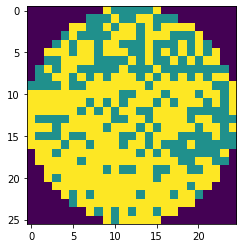

wafer_id:562, ウエハサイズ:26x25, スタンプサイズ:3x2, oDefects:190, nDefects:291, p=65.292


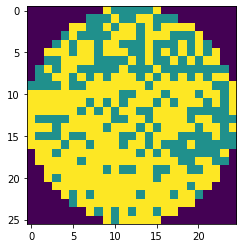

wafer_id:562, ウエハサイズ:26x25, スタンプサイズ:4x2, oDefects:190, nDefects:291, p=65.292


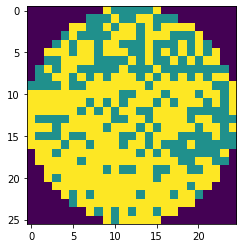

wafer_id:562, ウエハサイズ:26x25, スタンプサイズ:3x4, oDefects:178, nDefects:272, p=65.441


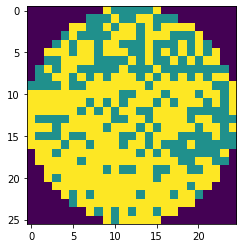

wafer_id:562, ウエハサイズ:26x25, スタンプサイズ:4x4, oDefects:178, nDefects:272, p=65.441


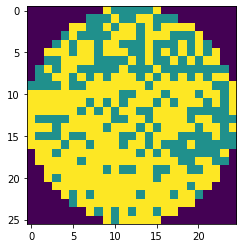

wafer_id:563, ウエハサイズ:26x25, スタンプサイズ:2x2, oDefects:185, nDefects:270, p=68.519


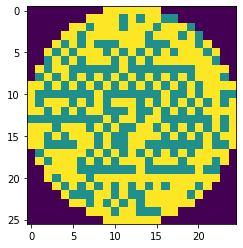

wafer_id:563, ウエハサイズ:26x25, スタンプサイズ:3x2, oDefects:178, nDefects:256, p=69.531


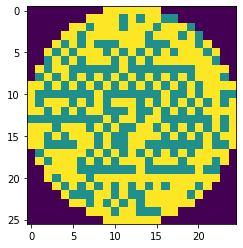

wafer_id:563, ウエハサイズ:26x25, スタンプサイズ:4x2, oDefects:178, nDefects:256, p=69.531


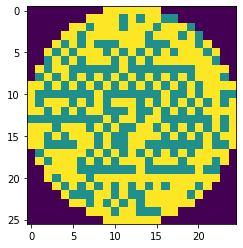

wafer_id:563, ウエハサイズ:26x25, スタンプサイズ:3x4, oDefects:152, nDefects:232, p=65.517


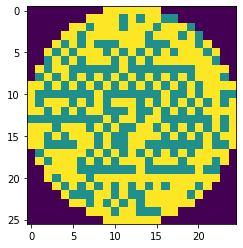

wafer_id:563, ウエハサイズ:26x25, スタンプサイズ:4x4, oDefects:152, nDefects:232, p=65.517


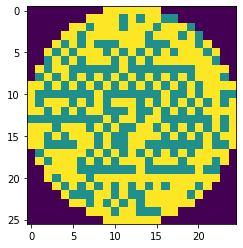

wafer_id:564, ウエハサイズ:26x25, スタンプサイズ:3x3, oDefects:199, nDefects:302, p=65.894


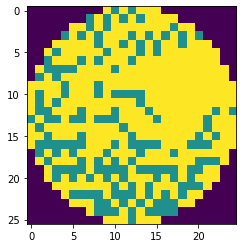

wafer_id:564, ウエハサイズ:26x25, スタンプサイズ:4x3, oDefects:199, nDefects:302, p=65.894


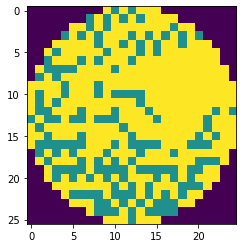

wafer_id:585, ウエハサイズ:26x26, スタンプサイズ:2x2, oDefects:242, nDefects:361, p=67.036


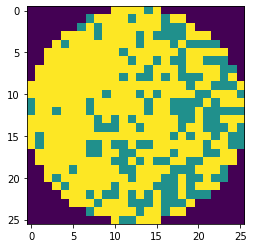

wafer_id:585, ウエハサイズ:26x26, スタンプサイズ:3x2, oDefects:236, nDefects:348, p=67.816


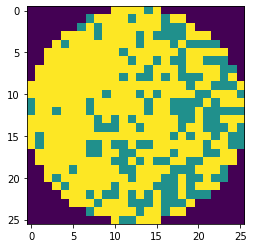

wafer_id:585, ウエハサイズ:26x26, スタンプサイズ:4x2, oDefects:236, nDefects:348, p=67.816


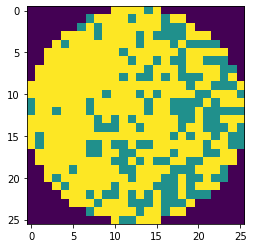

wafer_id:585, ウエハサイズ:26x26, スタンプサイズ:2x3, oDefects:226, nDefects:334, p=67.665


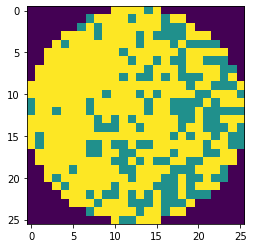

wafer_id:585, ウエハサイズ:26x26, スタンプサイズ:3x3, oDefects:219, nDefects:321, p=68.224


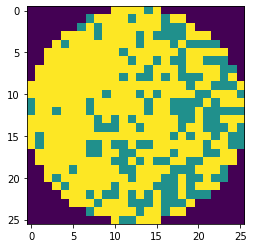

wafer_id:585, ウエハサイズ:26x26, スタンプサイズ:4x3, oDefects:219, nDefects:321, p=68.224


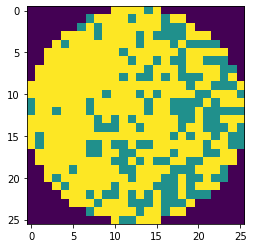

wafer_id:585, ウエハサイズ:26x26, スタンプサイズ:2x4, oDefects:214, nDefects:321, p=66.667


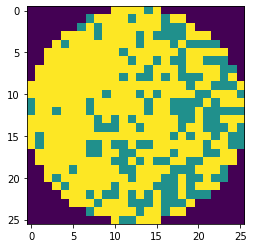

wafer_id:585, ウエハサイズ:26x26, スタンプサイズ:3x4, oDefects:209, nDefects:308, p=67.857


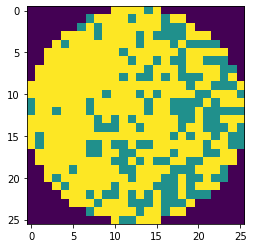

wafer_id:585, ウエハサイズ:26x26, スタンプサイズ:4x4, oDefects:209, nDefects:308, p=67.857


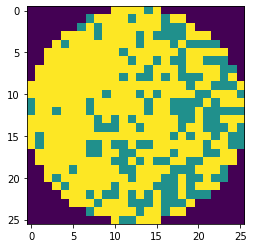

wafer_id:586, ウエハサイズ:26x26, スタンプサイズ:2x2, oDefects:223, nDefects:340, p=65.588


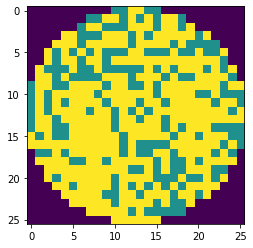

wafer_id:586, ウエハサイズ:26x26, スタンプサイズ:3x2, oDefects:215, nDefects:328, p=65.549


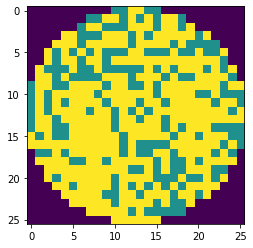

wafer_id:586, ウエハサイズ:26x26, スタンプサイズ:4x2, oDefects:215, nDefects:328, p=65.549


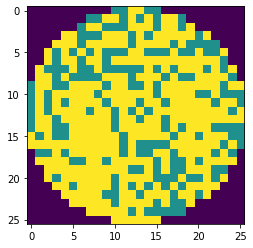

wafer_id:586, ウエハサイズ:26x26, スタンプサイズ:2x3, oDefects:200, nDefects:304, p=65.789


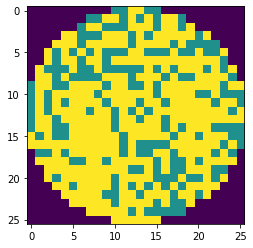

wafer_id:586, ウエハサイズ:26x26, スタンプサイズ:3x3, oDefects:194, nDefects:292, p=66.438


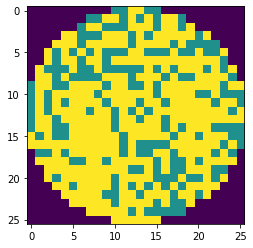

wafer_id:586, ウエハサイズ:26x26, スタンプサイズ:4x3, oDefects:194, nDefects:292, p=66.438


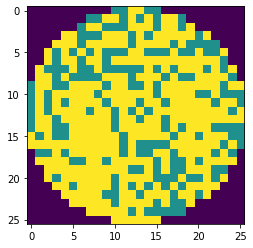

wafer_id:595, ウエハサイズ:26x26, スタンプサイズ:2x2, oDefects:265, nDefects:379, p=69.921


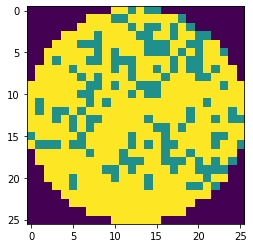

wafer_id:595, ウエハサイズ:26x26, スタンプサイズ:3x2, oDefects:251, nDefects:361, p=69.529


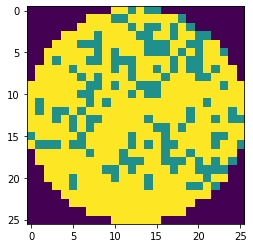

wafer_id:595, ウエハサイズ:26x26, スタンプサイズ:4x2, oDefects:251, nDefects:361, p=69.529


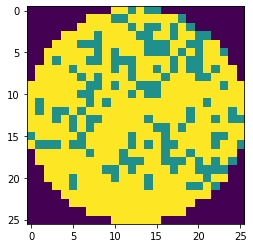

wafer_id:595, ウエハサイズ:26x26, スタンプサイズ:2x3, oDefects:231, nDefects:341, p=67.742


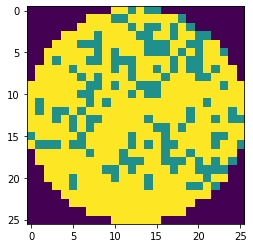

wafer_id:595, ウエハサイズ:26x26, スタンプサイズ:3x3, oDefects:219, nDefects:323, p=67.802


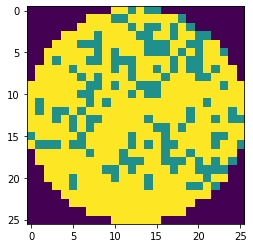

wafer_id:595, ウエハサイズ:26x26, スタンプサイズ:4x3, oDefects:219, nDefects:323, p=67.802


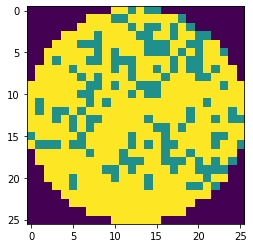

wafer_id:595, ウエハサイズ:26x26, スタンプサイズ:2x4, oDefects:216, nDefects:330, p=65.455


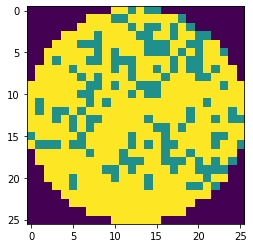

wafer_id:595, ウエハサイズ:26x26, スタンプサイズ:3x4, oDefects:206, nDefects:312, p=66.026


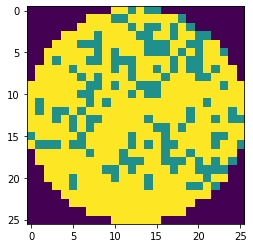

wafer_id:595, ウエハサイズ:26x26, スタンプサイズ:4x4, oDefects:206, nDefects:312, p=66.026


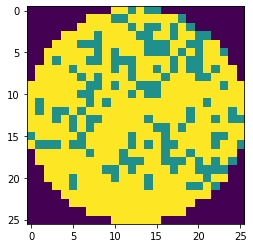

wafer_id:600, ウエハサイズ:26x26, スタンプサイズ:2x2, oDefects:231, nDefects:332, p=69.578


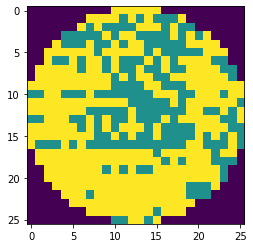

wafer_id:600, ウエハサイズ:26x26, スタンプサイズ:3x2, oDefects:222, nDefects:318, p=69.811


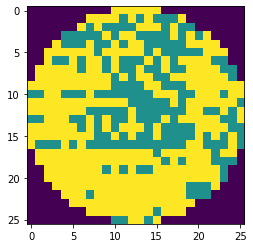

wafer_id:600, ウエハサイズ:26x26, スタンプサイズ:4x2, oDefects:222, nDefects:318, p=69.811


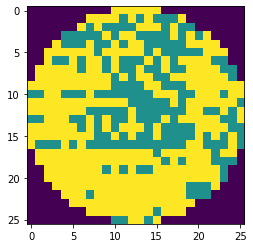

wafer_id:600, ウエハサイズ:26x26, スタンプサイズ:2x3, oDefects:194, nDefects:297, p=65.320


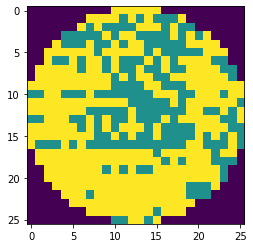

wafer_id:600, ウエハサイズ:26x26, スタンプサイズ:3x3, oDefects:186, nDefects:283, p=65.724


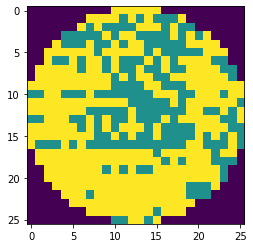

wafer_id:600, ウエハサイズ:26x26, スタンプサイズ:4x3, oDefects:186, nDefects:283, p=65.724


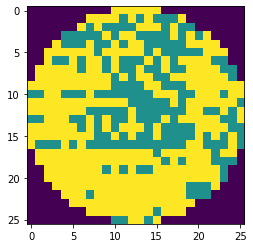

wafer_id:608, ウエハサイズ:30x34, スタンプサイズ:2x2, oDefects:301, nDefects:442, p=68.100


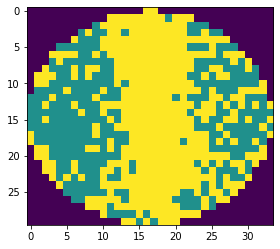

wafer_id:608, ウエハサイズ:30x34, スタンプサイズ:3x2, oDefects:301, nDefects:442, p=68.100


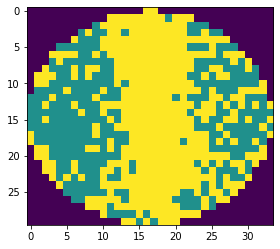

wafer_id:608, ウエハサイズ:30x34, スタンプサイズ:4x2, oDefects:292, nDefects:427, p=68.384


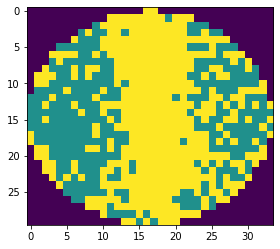

wafer_id:608, ウエハサイズ:30x34, スタンプサイズ:2x3, oDefects:285, nDefects:431, p=66.125


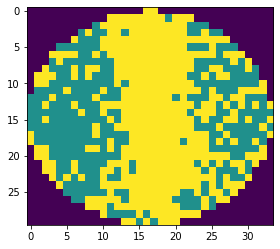

wafer_id:608, ウエハサイズ:30x34, スタンプサイズ:3x3, oDefects:285, nDefects:431, p=66.125


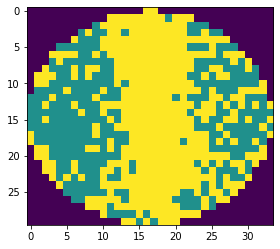

wafer_id:608, ウエハサイズ:30x34, スタンプサイズ:4x3, oDefects:278, nDefects:416, p=66.827


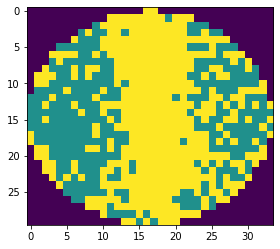

wafer_id:608, ウエハサイズ:30x34, スタンプサイズ:2x4, oDefects:271, nDefects:415, p=65.301


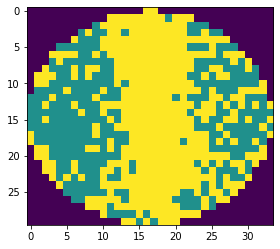

wafer_id:608, ウエハサイズ:30x34, スタンプサイズ:3x4, oDefects:271, nDefects:415, p=65.301


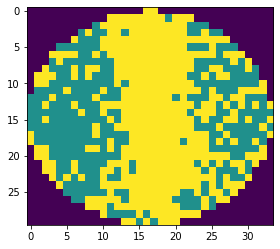

wafer_id:608, ウエハサイズ:30x34, スタンプサイズ:4x4, oDefects:265, nDefects:400, p=66.250


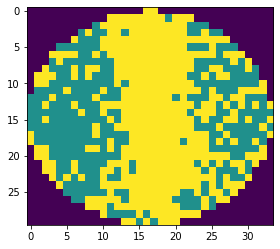

wafer_id:618, ウエハサイズ:32x29, スタンプサイズ:2x4, oDefects:248, nDefects:360, p=68.889


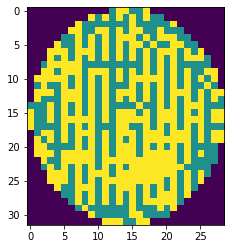

wafer_id:618, ウエハサイズ:32x29, スタンプサイズ:3x4, oDefects:246, nDefects:352, p=69.886


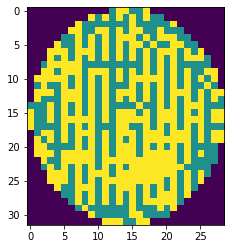

wafer_id:618, ウエハサイズ:32x29, スタンプサイズ:4x4, oDefects:248, nDefects:360, p=68.889


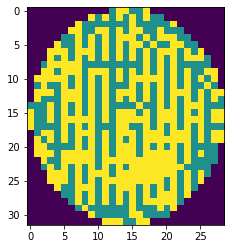

wafer_id:620, ウエハサイズ:32x29, スタンプサイズ:3x4, oDefects:275, nDefects:422, p=65.166


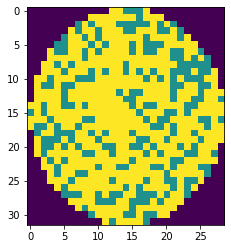

wafer_id:628, ウエハサイズ:32x29, スタンプサイズ:2x2, oDefects:324, nDefects:471, p=68.790


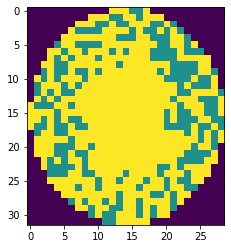

wafer_id:628, ウエハサイズ:32x29, スタンプサイズ:3x2, oDefects:318, nDefects:459, p=69.281


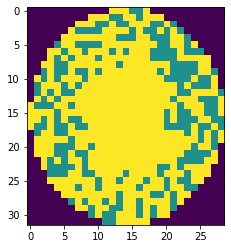

wafer_id:628, ウエハサイズ:32x29, スタンプサイズ:4x2, oDefects:324, nDefects:471, p=68.790


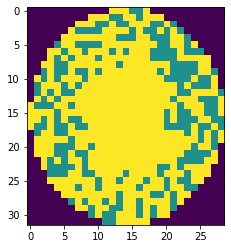

wafer_id:628, ウエハサイズ:32x29, スタンプサイズ:2x4, oDefects:299, nDefects:447, p=66.890


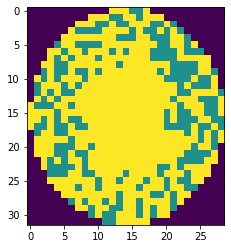

wafer_id:628, ウエハサイズ:32x29, スタンプサイズ:3x4, oDefects:295, nDefects:435, p=67.816


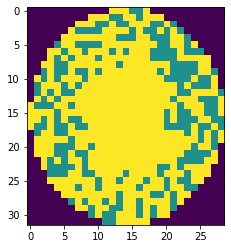

wafer_id:628, ウエハサイズ:32x29, スタンプサイズ:4x4, oDefects:299, nDefects:447, p=66.890


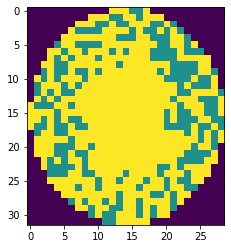

wafer_id:643, ウエハサイズ:35x31, スタンプサイズ:3x2, oDefects:203, nDefects:312, p=65.064


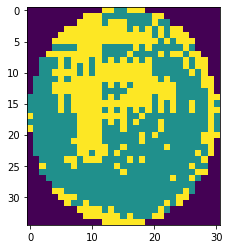

wafer_id:643, ウエハサイズ:35x31, スタンプサイズ:4x2, oDefects:200, nDefects:306, p=65.359


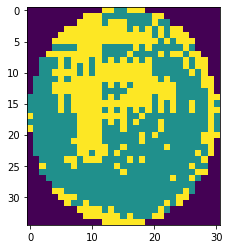

wafer_id:668, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:221, nDefects:325, p=68.000


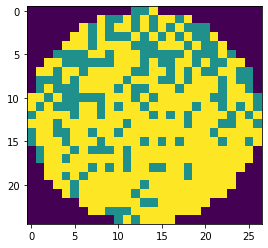

wafer_id:668, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:221, nDefects:325, p=68.000


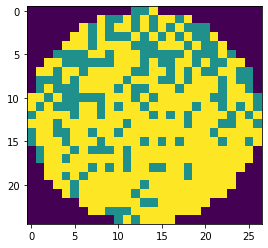

wafer_id:668, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:221, nDefects:325, p=68.000


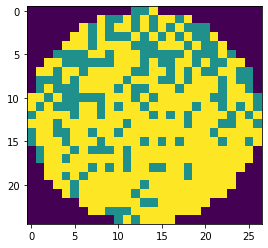

wafer_id:668, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:186, nDefects:272, p=68.382


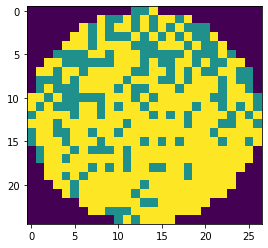

wafer_id:668, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:186, nDefects:272, p=68.382


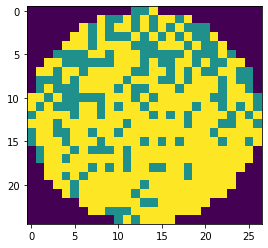

wafer_id:668, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:186, nDefects:272, p=68.382


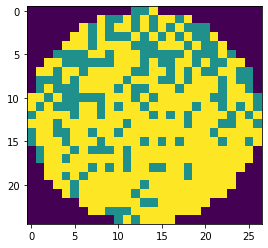

wafer_id:687, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:229, nDefects:343, p=66.764


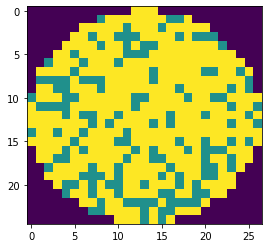

wafer_id:687, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:229, nDefects:343, p=66.764


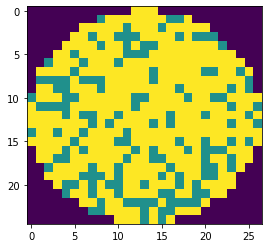

wafer_id:687, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:229, nDefects:343, p=66.764


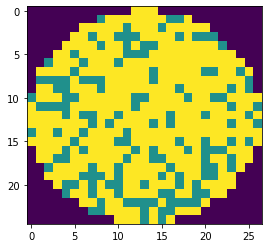

wafer_id:687, ウエハサイズ:25x27, スタンプサイズ:2x3, oDefects:228, nDefects:343, p=66.472


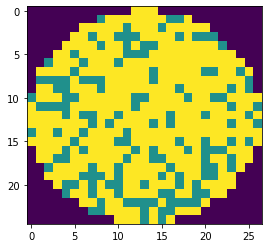

wafer_id:687, ウエハサイズ:25x27, スタンプサイズ:3x3, oDefects:228, nDefects:343, p=66.472


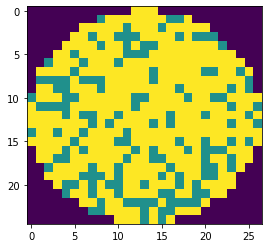

wafer_id:687, ウエハサイズ:25x27, スタンプサイズ:4x3, oDefects:228, nDefects:343, p=66.472


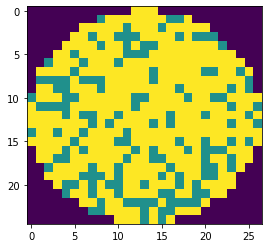

wafer_id:687, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:199, nDefects:293, p=67.918


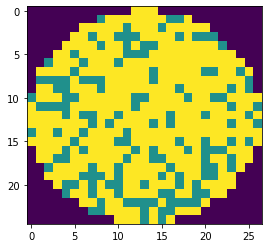

wafer_id:687, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:199, nDefects:293, p=67.918


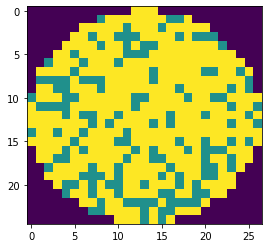

wafer_id:687, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:199, nDefects:293, p=67.918


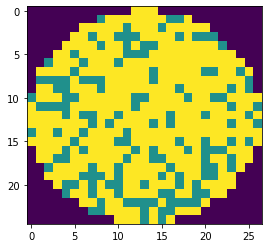

wafer_id:692, ウエハサイズ:34x31, スタンプサイズ:2x3, oDefects:291, nDefects:441, p=65.986


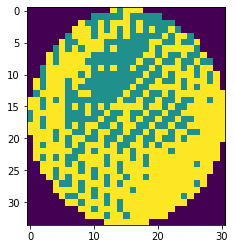

wafer_id:692, ウエハサイズ:34x31, スタンプサイズ:3x3, oDefects:287, nDefects:434, p=66.129


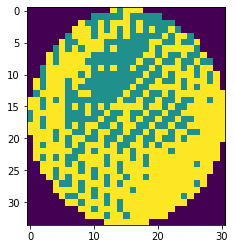

wafer_id:692, ウエハサイズ:34x31, スタンプサイズ:4x3, oDefects:280, nDefects:423, p=66.194


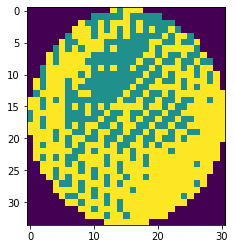

wafer_id:697, ウエハサイズ:34x31, スタンプサイズ:2x2, oDefects:367, nDefects:540, p=67.963


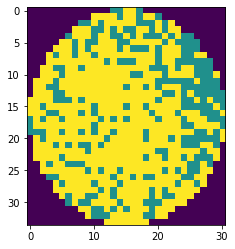

wafer_id:697, ウエハサイズ:34x31, スタンプサイズ:3x2, oDefects:362, nDefects:533, p=67.917


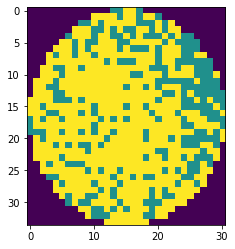

wafer_id:697, ウエハサイズ:34x31, スタンプサイズ:4x2, oDefects:359, nDefects:525, p=68.381


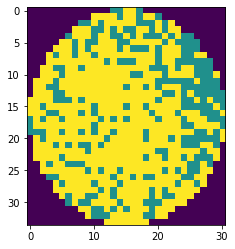

wafer_id:697, ウエハサイズ:34x31, スタンプサイズ:2x3, oDefects:350, nDefects:532, p=65.789


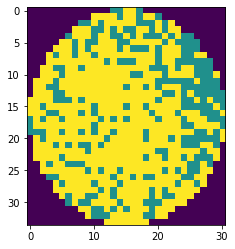

wafer_id:697, ウエハサイズ:34x31, スタンプサイズ:3x3, oDefects:346, nDefects:525, p=65.905


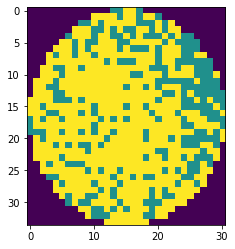

wafer_id:697, ウエハサイズ:34x31, スタンプサイズ:4x3, oDefects:343, nDefects:517, p=66.344


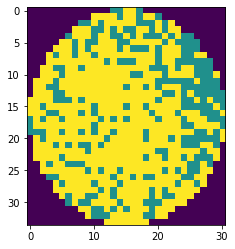

wafer_id:697, ウエハサイズ:34x31, スタンプサイズ:2x4, oDefects:333, nDefects:501, p=66.467


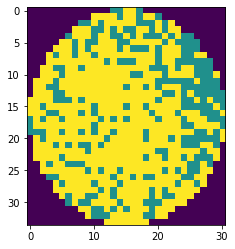

wafer_id:697, ウエハサイズ:34x31, スタンプサイズ:3x4, oDefects:330, nDefects:494, p=66.802


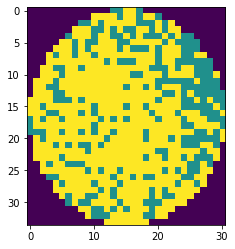

wafer_id:697, ウエハサイズ:34x31, スタンプサイズ:4x4, oDefects:326, nDefects:486, p=67.078


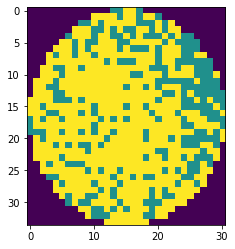

wafer_id:699, ウエハサイズ:34x31, スタンプサイズ:2x3, oDefects:359, nDefects:533, p=67.355


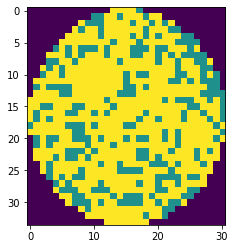

wafer_id:699, ウエハサイズ:34x31, スタンプサイズ:3x3, oDefects:355, nDefects:526, p=67.490


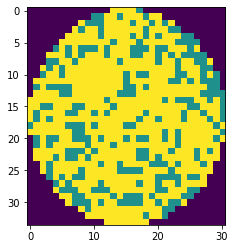

wafer_id:699, ウエハサイズ:34x31, スタンプサイズ:4x3, oDefects:347, nDefects:515, p=67.379


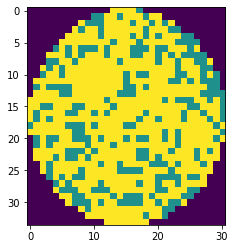

wafer_id:699, ウエハサイズ:34x31, スタンプサイズ:2x4, oDefects:328, nDefects:482, p=68.050


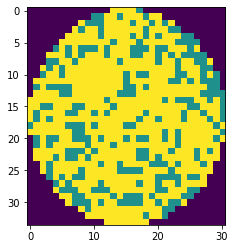

wafer_id:699, ウエハサイズ:34x31, スタンプサイズ:3x4, oDefects:325, nDefects:475, p=68.421


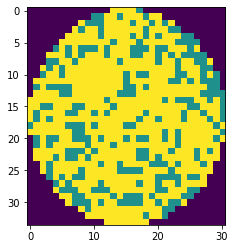

wafer_id:699, ウエハサイズ:34x31, スタンプサイズ:4x4, oDefects:318, nDefects:464, p=68.534


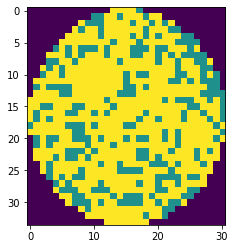

wafer_id:700, ウエハサイズ:34x31, スタンプサイズ:2x2, oDefects:366, nDefects:547, p=66.910


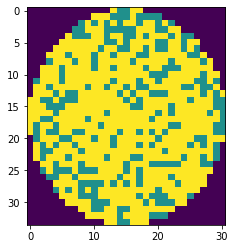

wafer_id:700, ウエハサイズ:34x31, スタンプサイズ:3x2, oDefects:365, nDefects:542, p=67.343


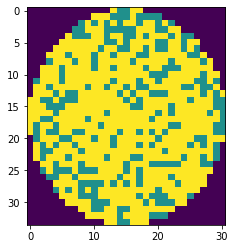

wafer_id:700, ウエハサイズ:34x31, スタンプサイズ:4x2, oDefects:359, nDefects:533, p=67.355


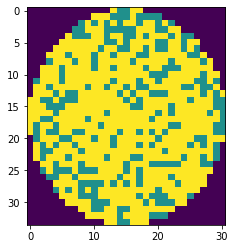

wafer_id:700, ウエハサイズ:34x31, スタンプサイズ:2x3, oDefects:349, nDefects:535, p=65.234


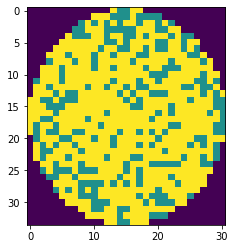

wafer_id:700, ウエハサイズ:34x31, スタンプサイズ:3x3, oDefects:348, nDefects:530, p=65.660


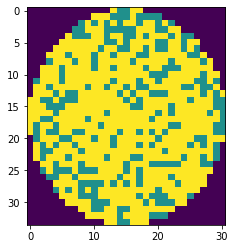

wafer_id:700, ウエハサイズ:34x31, スタンプサイズ:4x3, oDefects:343, nDefects:521, p=65.835


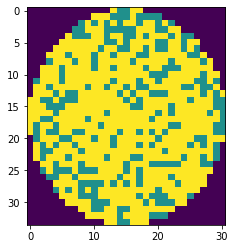

wafer_id:700, ウエハサイズ:34x31, スタンプサイズ:2x4, oDefects:323, nDefects:473, p=68.288


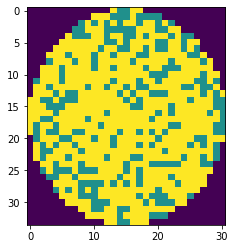

wafer_id:700, ウエハサイズ:34x31, スタンプサイズ:3x4, oDefects:321, nDefects:468, p=68.590


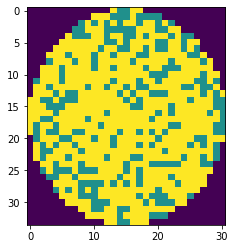

wafer_id:700, ウエハサイズ:34x31, スタンプサイズ:4x4, oDefects:317, nDefects:459, p=69.063


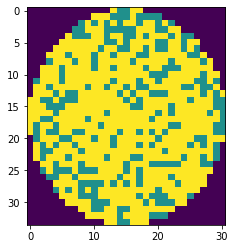

wafer_id:701, ウエハサイズ:34x31, スタンプサイズ:2x2, oDefects:343, nDefects:527, p=65.085


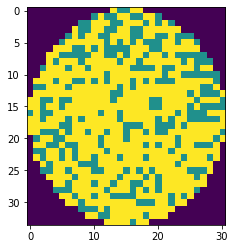

wafer_id:701, ウエハサイズ:34x31, スタンプサイズ:3x2, oDefects:340, nDefects:521, p=65.259


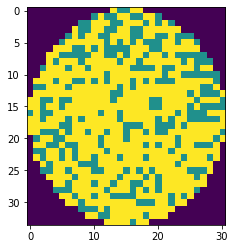

wafer_id:701, ウエハサイズ:34x31, スタンプサイズ:4x2, oDefects:335, nDefects:511, p=65.558


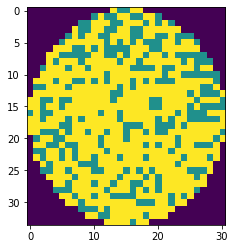

wafer_id:701, ウエハサイズ:34x31, スタンプサイズ:2x3, oDefects:340, nDefects:516, p=65.891


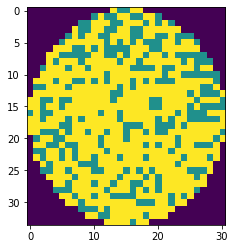

wafer_id:701, ウエハサイズ:34x31, スタンプサイズ:3x3, oDefects:337, nDefects:510, p=66.078


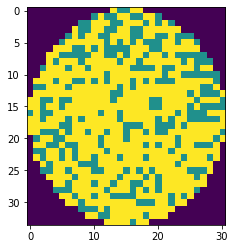

wafer_id:701, ウエハサイズ:34x31, スタンプサイズ:4x3, oDefects:332, nDefects:500, p=66.400


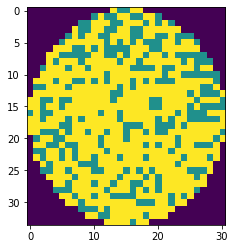

wafer_id:701, ウエハサイズ:34x31, スタンプサイズ:2x4, oDefects:315, nDefects:466, p=67.597


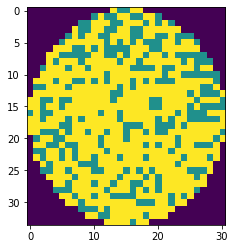

wafer_id:701, ウエハサイズ:34x31, スタンプサイズ:3x4, oDefects:313, nDefects:460, p=68.043


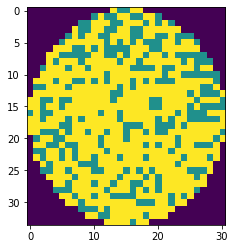

wafer_id:701, ウエハサイズ:34x31, スタンプサイズ:4x4, oDefects:307, nDefects:450, p=68.222


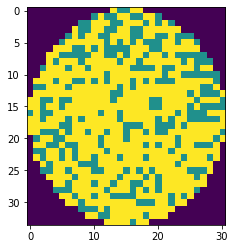

wafer_id:704, ウエハサイズ:34x31, スタンプサイズ:2x2, oDefects:390, nDefects:564, p=69.149


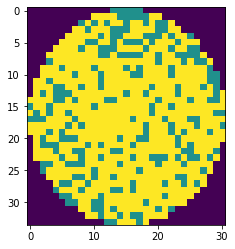

wafer_id:704, ウエハサイズ:34x31, スタンプサイズ:3x2, oDefects:388, nDefects:560, p=69.286


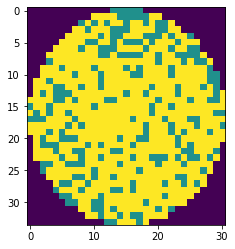

wafer_id:704, ウエハサイズ:34x31, スタンプサイズ:4x2, oDefects:384, nDefects:551, p=69.691


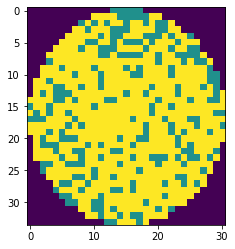

wafer_id:704, ウエハサイズ:34x31, スタンプサイズ:2x3, oDefects:375, nDefects:546, p=68.681


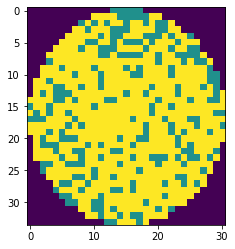

wafer_id:704, ウエハサイズ:34x31, スタンプサイズ:3x3, oDefects:374, nDefects:542, p=69.004


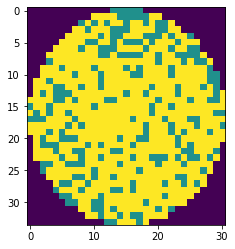

wafer_id:704, ウエハサイズ:34x31, スタンプサイズ:4x3, oDefects:369, nDefects:533, p=69.231


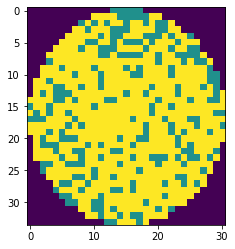

wafer_id:704, ウエハサイズ:34x31, スタンプサイズ:2x4, oDefects:343, nDefects:491, p=69.857


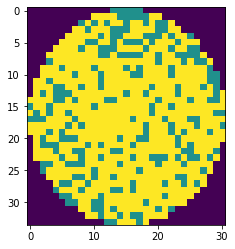

wafer_id:705, ウエハサイズ:34x31, スタンプサイズ:2x2, oDefects:378, nDefects:550, p=68.727


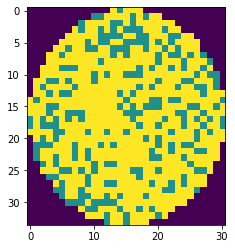

wafer_id:705, ウエハサイズ:34x31, スタンプサイズ:3x2, oDefects:376, nDefects:545, p=68.991


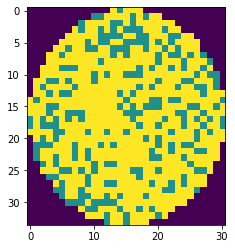

wafer_id:705, ウエハサイズ:34x31, スタンプサイズ:4x2, oDefects:370, nDefects:535, p=69.159


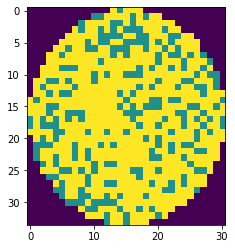

wafer_id:705, ウエハサイズ:34x31, スタンプサイズ:2x3, oDefects:354, nDefects:537, p=65.922


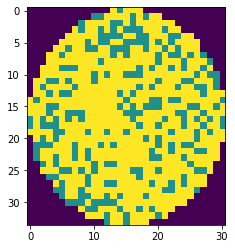

wafer_id:705, ウエハサイズ:34x31, スタンプサイズ:3x3, oDefects:352, nDefects:532, p=66.165


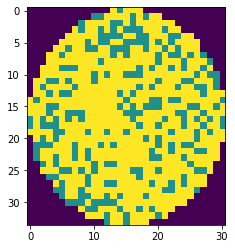

wafer_id:705, ウエハサイズ:34x31, スタンプサイズ:4x3, oDefects:346, nDefects:522, p=66.284


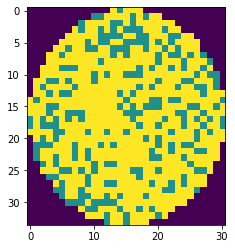

wafer_id:705, ウエハサイズ:34x31, スタンプサイズ:2x4, oDefects:332, nDefects:484, p=68.595


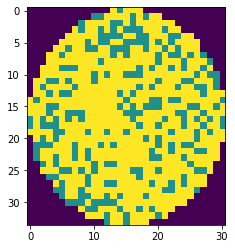

wafer_id:705, ウエハサイズ:34x31, スタンプサイズ:3x4, oDefects:330, nDefects:479, p=68.894


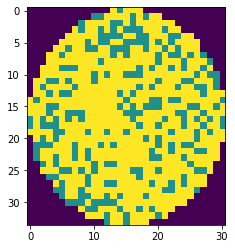

wafer_id:705, ウエハサイズ:34x31, スタンプサイズ:4x4, oDefects:325, nDefects:469, p=69.296


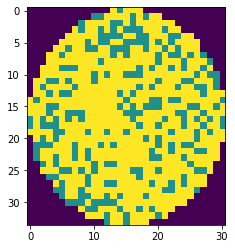

wafer_id:706, ウエハサイズ:34x31, スタンプサイズ:2x2, oDefects:346, nDefects:510, p=67.843


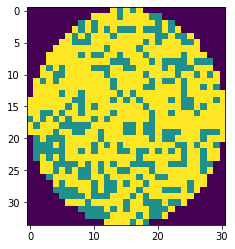

wafer_id:706, ウエハサイズ:34x31, スタンプサイズ:3x2, oDefects:343, nDefects:505, p=67.921


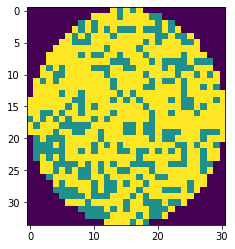

wafer_id:706, ウエハサイズ:34x31, スタンプサイズ:4x2, oDefects:340, nDefects:499, p=68.136


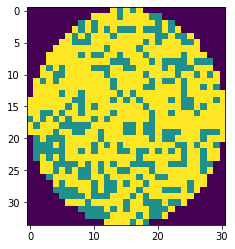

wafer_id:706, ウエハサイズ:34x31, スタンプサイズ:2x4, oDefects:291, nDefects:445, p=65.393


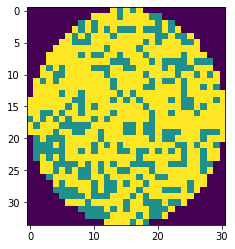

wafer_id:706, ウエハサイズ:34x31, スタンプサイズ:3x4, oDefects:290, nDefects:440, p=65.909


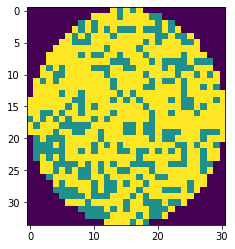

wafer_id:706, ウエハサイズ:34x31, スタンプサイズ:4x4, oDefects:289, nDefects:434, p=66.590


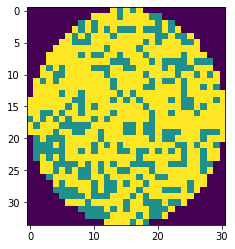

wafer_id:711, ウエハサイズ:25x26, スタンプサイズ:2x2, oDefects:221, nDefects:327, p=67.584


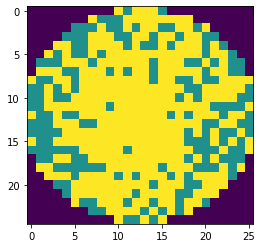

wafer_id:711, ウエハサイズ:25x26, スタンプサイズ:3x2, oDefects:221, nDefects:327, p=67.584


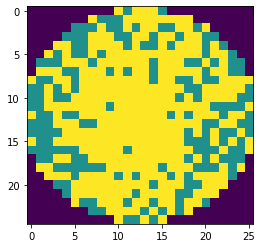

wafer_id:711, ウエハサイズ:25x26, スタンプサイズ:4x2, oDefects:221, nDefects:327, p=67.584


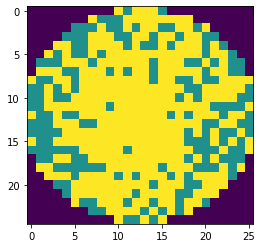

wafer_id:711, ウエハサイズ:25x26, スタンプサイズ:2x3, oDefects:206, nDefects:298, p=69.128


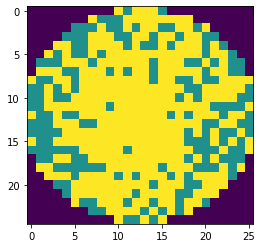

wafer_id:711, ウエハサイズ:25x26, スタンプサイズ:3x3, oDefects:206, nDefects:298, p=69.128


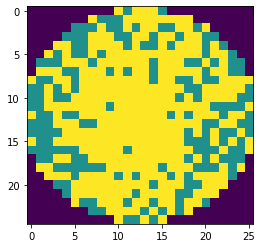

wafer_id:711, ウエハサイズ:25x26, スタンプサイズ:4x3, oDefects:206, nDefects:298, p=69.128


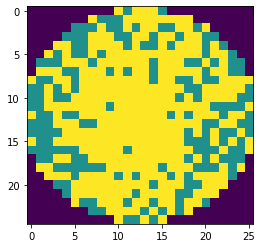

wafer_id:711, ウエハサイズ:25x26, スタンプサイズ:2x4, oDefects:201, nDefects:289, p=69.550


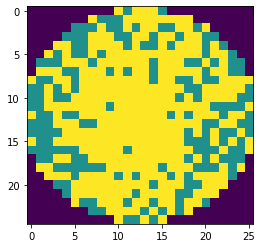

wafer_id:711, ウエハサイズ:25x26, スタンプサイズ:3x4, oDefects:201, nDefects:289, p=69.550


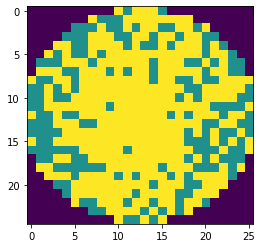

wafer_id:711, ウエハサイズ:25x26, スタンプサイズ:4x4, oDefects:201, nDefects:289, p=69.550


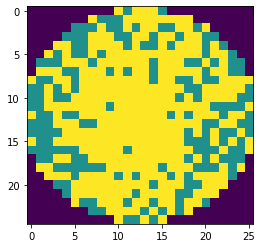

wafer_id:718, ウエハサイズ:25x26, スタンプサイズ:2x2, oDefects:199, nDefects:305, p=65.246


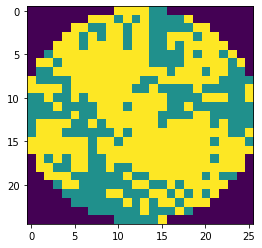

wafer_id:718, ウエハサイズ:25x26, スタンプサイズ:3x2, oDefects:199, nDefects:305, p=65.246


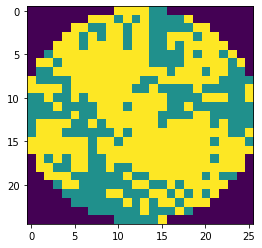

wafer_id:718, ウエハサイズ:25x26, スタンプサイズ:4x2, oDefects:199, nDefects:305, p=65.246


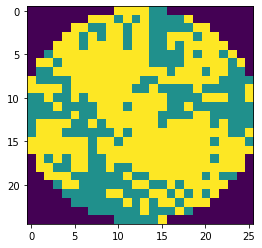

wafer_id:718, ウエハサイズ:25x26, スタンプサイズ:2x3, oDefects:185, nDefects:276, p=67.029


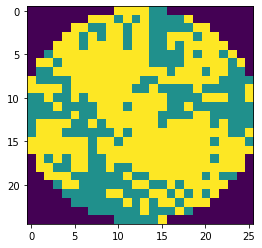

wafer_id:718, ウエハサイズ:25x26, スタンプサイズ:3x3, oDefects:185, nDefects:276, p=67.029


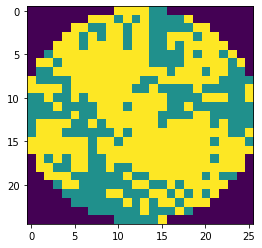

wafer_id:718, ウエハサイズ:25x26, スタンプサイズ:4x3, oDefects:185, nDefects:276, p=67.029


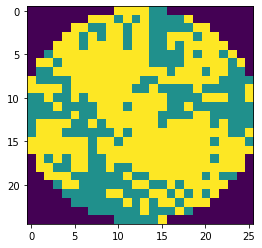

wafer_id:750, ウエハサイズ:27x25, スタンプサイズ:3x4, oDefects:242, nDefects:346, p=69.942


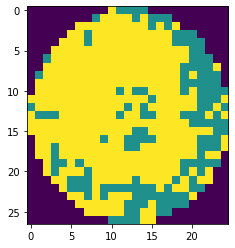

wafer_id:773, ウエハサイズ:39x37, スタンプサイズ:2x4, oDefects:456, nDefects:670, p=68.060


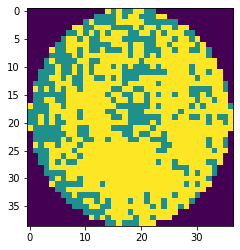

wafer_id:773, ウエハサイズ:39x37, スタンプサイズ:3x4, oDefects:457, nDefects:674, p=67.804


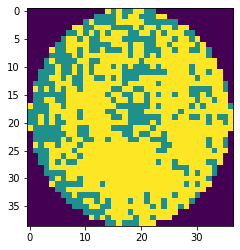

wafer_id:773, ウエハサイズ:39x37, スタンプサイズ:4x4, oDefects:443, nDefects:647, p=68.470


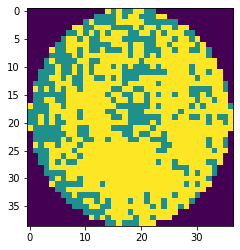

wafer_id:774, ウエハサイズ:39x37, スタンプサイズ:2x2, oDefects:409, nDefects:613, p=66.721


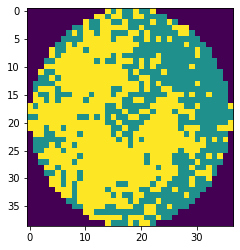

wafer_id:774, ウエハサイズ:39x37, スタンプサイズ:3x2, oDefects:410, nDefects:617, p=66.451


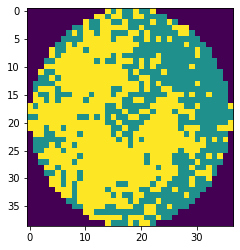

wafer_id:774, ウエハサイズ:39x37, スタンプサイズ:4x2, oDefects:403, nDefects:599, p=67.279


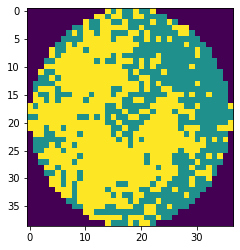

wafer_id:774, ウエハサイズ:39x37, スタンプサイズ:2x3, oDefects:406, nDefects:612, p=66.340


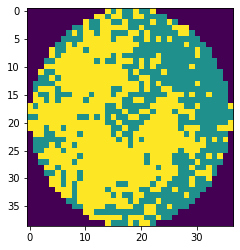

wafer_id:774, ウエハサイズ:39x37, スタンプサイズ:3x3, oDefects:407, nDefects:616, p=66.071


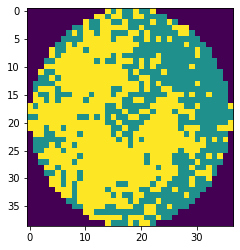

wafer_id:774, ウエハサイズ:39x37, スタンプサイズ:4x3, oDefects:400, nDefects:598, p=66.890


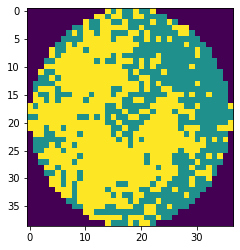

wafer_id:775, ウエハサイズ:39x37, スタンプサイズ:2x3, oDefects:479, nDefects:695, p=68.921


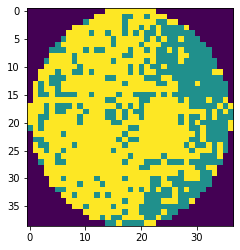

wafer_id:775, ウエハサイズ:39x37, スタンプサイズ:3x3, oDefects:479, nDefects:698, p=68.625


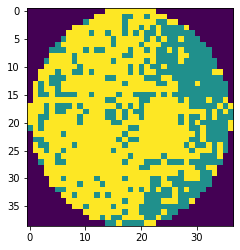

wafer_id:775, ウエハサイズ:39x37, スタンプサイズ:4x3, oDefects:469, nDefects:677, p=69.276


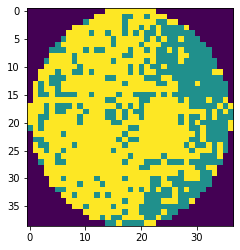

wafer_id:775, ウエハサイズ:39x37, スタンプサイズ:2x4, oDefects:457, nDefects:691, p=66.136


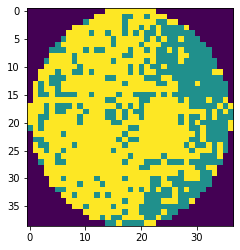

wafer_id:775, ウエハサイズ:39x37, スタンプサイズ:3x4, oDefects:457, nDefects:694, p=65.850


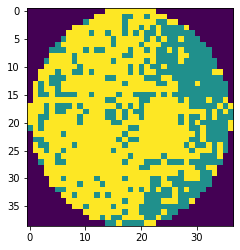

wafer_id:775, ウエハサイズ:39x37, スタンプサイズ:4x4, oDefects:450, nDefects:673, p=66.865


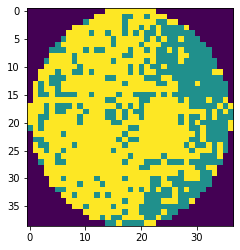

wafer_id:784, ウエハサイズ:34x34, スタンプサイズ:2x3, oDefects:354, nDefects:538, p=65.799


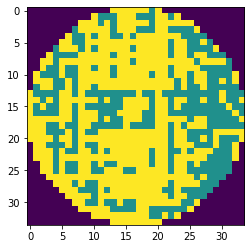

wafer_id:784, ウエハサイズ:34x34, スタンプサイズ:3x3, oDefects:349, nDefects:530, p=65.849


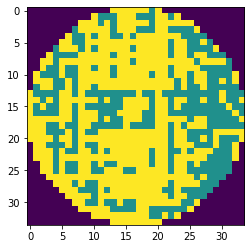

wafer_id:784, ウエハサイズ:34x34, スタンプサイズ:4x3, oDefects:342, nDefects:519, p=65.896


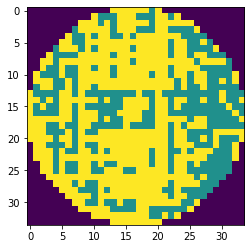

wafer_id:789, ウエハサイズ:34x34, スタンプサイズ:2x3, oDefects:340, nDefects:515, p=66.019


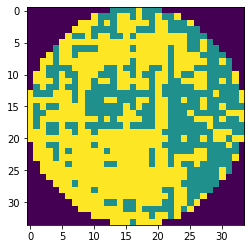

wafer_id:789, ウエハサイズ:34x34, スタンプサイズ:3x3, oDefects:337, nDefects:508, p=66.339


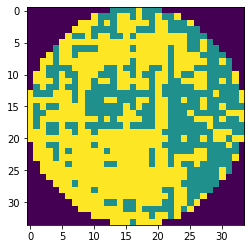

wafer_id:789, ウエハサイズ:34x34, スタンプサイズ:4x3, oDefects:328, nDefects:496, p=66.129


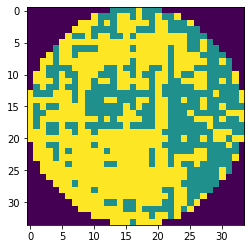

wafer_id:795, ウエハサイズ:34x34, スタンプサイズ:2x2, oDefects:338, nDefects:515, p=65.631


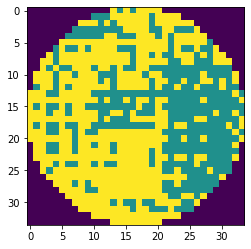

wafer_id:795, ウエハサイズ:34x34, スタンプサイズ:3x2, oDefects:332, nDefects:507, p=65.483


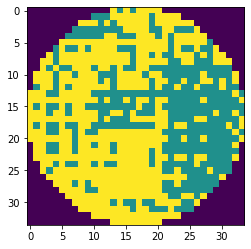

wafer_id:795, ウエハサイズ:34x34, スタンプサイズ:2x3, oDefects:339, nDefects:508, p=66.732


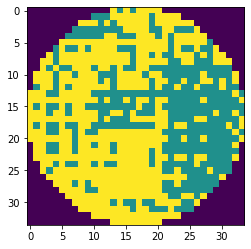

wafer_id:795, ウエハサイズ:34x34, スタンプサイズ:3x3, oDefects:334, nDefects:500, p=66.800


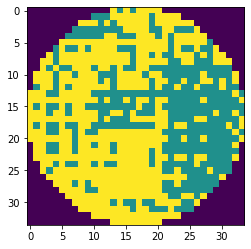

wafer_id:795, ウエハサイズ:34x34, スタンプサイズ:4x3, oDefects:323, nDefects:486, p=66.461


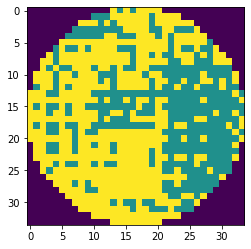

wafer_id:799, ウエハサイズ:34x34, スタンプサイズ:2x2, oDefects:336, nDefects:505, p=66.535


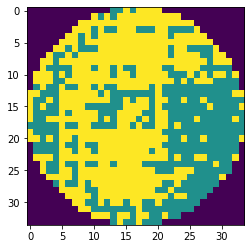

wafer_id:799, ウエハサイズ:34x34, スタンプサイズ:3x2, oDefects:336, nDefects:503, p=66.799


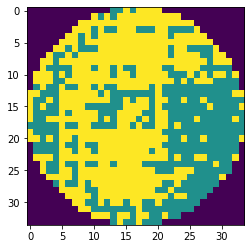

wafer_id:799, ウエハサイズ:34x34, スタンプサイズ:4x2, oDefects:333, nDefects:495, p=67.273


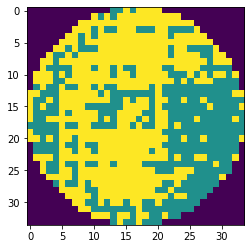

wafer_id:799, ウエハサイズ:34x34, スタンプサイズ:2x3, oDefects:342, nDefects:500, p=68.400


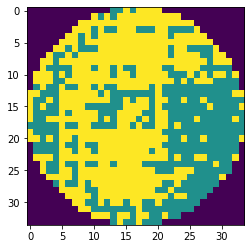

wafer_id:799, ウエハサイズ:34x34, スタンプサイズ:3x3, oDefects:341, nDefects:498, p=68.474


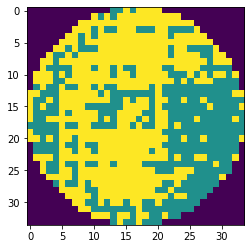

wafer_id:799, ウエハサイズ:34x34, スタンプサイズ:4x3, oDefects:336, nDefects:490, p=68.571


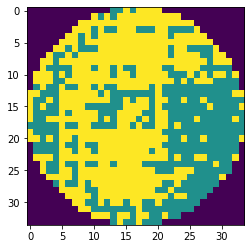

wafer_id:807, ウエハサイズ:44x41, スタンプサイズ:3x2, oDefects:483, nDefects:741, p=65.182


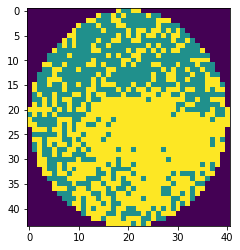

wafer_id:807, ウエハサイズ:44x41, スタンプサイズ:2x3, oDefects:482, nDefects:727, p=66.300


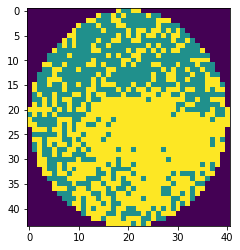

wafer_id:807, ウエハサイズ:44x41, スタンプサイズ:3x3, oDefects:474, nDefects:711, p=66.667


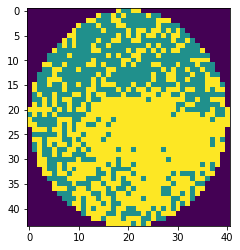

wafer_id:807, ウエハサイズ:44x41, スタンプサイズ:4x3, oDefects:482, nDefects:727, p=66.300


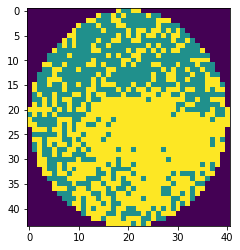

wafer_id:807, ウエハサイズ:44x41, スタンプサイズ:2x4, oDefects:473, nDefects:727, p=65.062


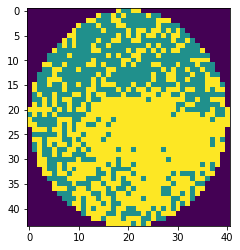

wafer_id:807, ウエハサイズ:44x41, スタンプサイズ:3x4, oDefects:464, nDefects:711, p=65.260


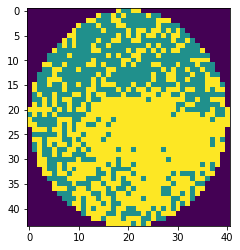

wafer_id:807, ウエハサイズ:44x41, スタンプサイズ:4x4, oDefects:473, nDefects:727, p=65.062


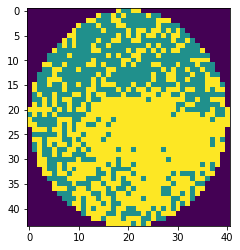

wafer_id:810, ウエハサイズ:44x41, スタンプサイズ:2x3, oDefects:493, nDefects:730, p=67.534


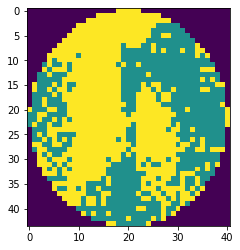

wafer_id:810, ウエハサイズ:44x41, スタンプサイズ:3x3, oDefects:493, nDefects:724, p=68.094


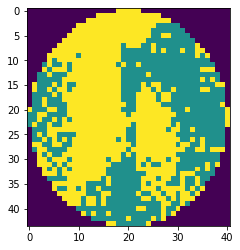

wafer_id:810, ウエハサイズ:44x41, スタンプサイズ:4x3, oDefects:493, nDefects:730, p=67.534


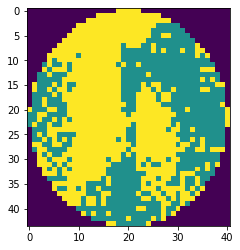

wafer_id:856, ウエハサイズ:33x35, スタンプサイズ:2x2, oDefects:375, nDefects:549, p=68.306


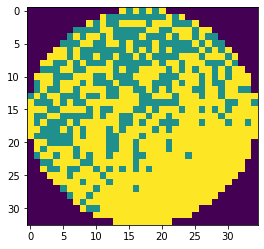

wafer_id:856, ウエハサイズ:33x35, スタンプサイズ:3x2, oDefects:382, nDefects:558, p=68.459


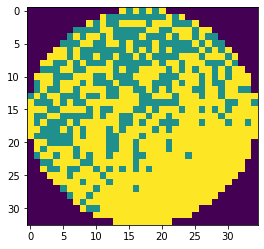

wafer_id:856, ウエハサイズ:33x35, スタンプサイズ:4x2, oDefects:375, nDefects:549, p=68.306


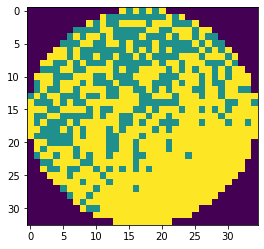

wafer_id:856, ウエハサイズ:33x35, スタンプサイズ:2x3, oDefects:344, nDefects:517, p=66.538


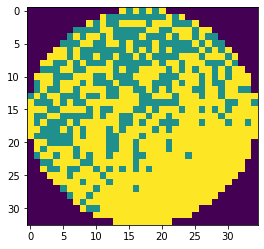

wafer_id:856, ウエハサイズ:33x35, スタンプサイズ:3x3, oDefects:350, nDefects:526, p=66.540


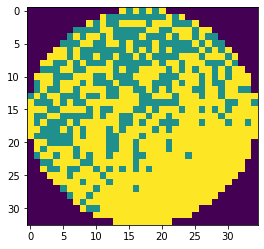

wafer_id:856, ウエハサイズ:33x35, スタンプサイズ:4x3, oDefects:344, nDefects:517, p=66.538


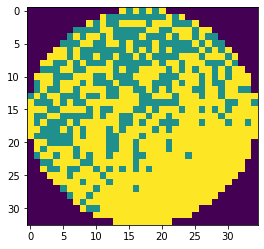

wafer_id:856, ウエハサイズ:33x35, スタンプサイズ:2x4, oDefects:334, nDefects:483, p=69.151


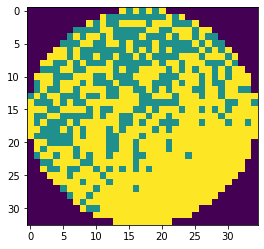

wafer_id:856, ウエハサイズ:33x35, スタンプサイズ:3x4, oDefects:339, nDefects:492, p=68.902


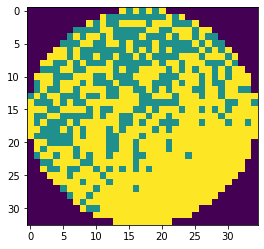

wafer_id:856, ウエハサイズ:33x35, スタンプサイズ:4x4, oDefects:334, nDefects:483, p=69.151


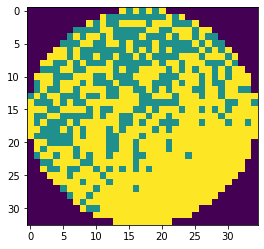

wafer_id:861, ウエハサイズ:41x33, スタンプサイズ:2x2, oDefects:428, nDefects:624, p=68.590


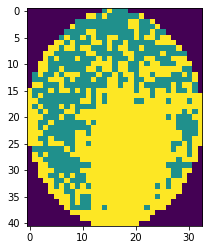

wafer_id:861, ウエハサイズ:41x33, スタンプサイズ:3x2, oDefects:417, nDefects:611, p=68.249


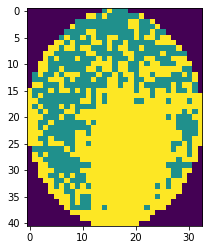

wafer_id:861, ウエハサイズ:41x33, スタンプサイズ:4x2, oDefects:428, nDefects:624, p=68.590


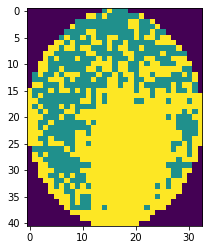

wafer_id:861, ウエハサイズ:41x33, スタンプサイズ:2x3, oDefects:425, nDefects:624, p=68.109


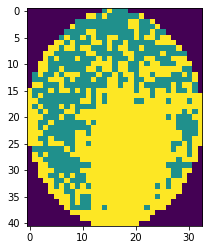

wafer_id:861, ウエハサイズ:41x33, スタンプサイズ:3x3, oDefects:415, nDefects:611, p=67.921


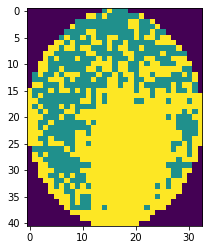

wafer_id:861, ウエハサイズ:41x33, スタンプサイズ:4x3, oDefects:425, nDefects:624, p=68.109


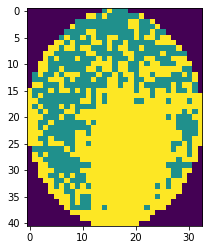

wafer_id:861, ウエハサイズ:41x33, スタンプサイズ:2x4, oDefects:397, nDefects:595, p=66.723


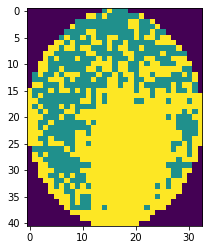

wafer_id:861, ウエハサイズ:41x33, スタンプサイズ:3x4, oDefects:388, nDefects:582, p=66.667


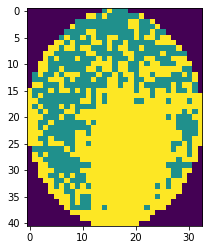

wafer_id:861, ウエハサイズ:41x33, スタンプサイズ:4x4, oDefects:397, nDefects:595, p=66.723


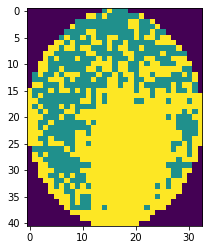

wafer_id:862, ウエハサイズ:26x30, スタンプサイズ:2x2, oDefects:208, nDefects:309, p=67.314


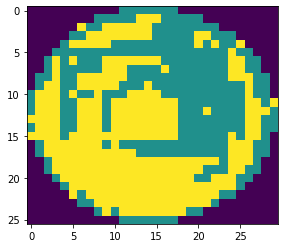

wafer_id:862, ウエハサイズ:26x30, スタンプサイズ:3x2, oDefects:201, nDefects:300, p=67.000


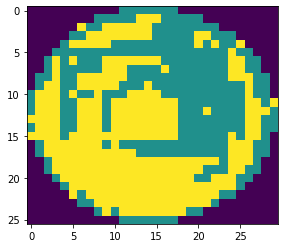

wafer_id:862, ウエハサイズ:26x30, スタンプサイズ:4x2, oDefects:201, nDefects:300, p=67.000


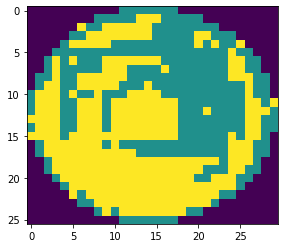

In [25]:
# random pattern 70 - 65
for w_id in range(len(sub_df)):
    x = sub_df.iloc[w_id, :]['waferMap']
    if w_id % 1000 == 0: print(x.shape)
    for w in range(2, 5):
        for h in range(2, 5):
            detectShotDefects(x, w_id, w, h)

In [27]:
# random pattern 65 - 70
for w_id in range(len(sub_df)):
    x = sub_df.iloc[w_id, :]['waferMap']
    if w_id % 1000 == 0: print(x.shape)
    for w in range(2, 5):
        for h in range(2, 5):
            detectShotDefects(x, w_id, w, h)

(26, 26)


(26, 26)
wafer_id:1, ウエハサイズ:26x26, スタンプサイズ:2x3, oDefects:160, nDefects:269, p=59.480


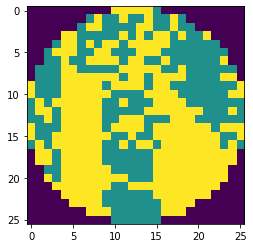

wafer_id:1, ウエハサイズ:26x26, スタンプサイズ:2x4, oDefects:130, nDefects:259, p=50.193


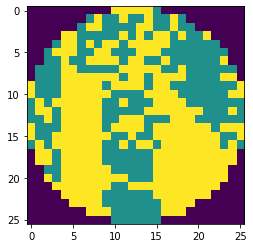

wafer_id:1, ウエハサイズ:26x26, スタンプサイズ:3x4, oDefects:130, nDefects:253, p=51.383


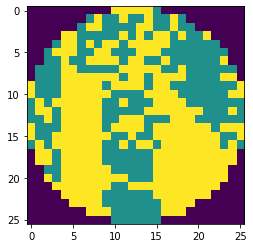

wafer_id:1, ウエハサイズ:26x26, スタンプサイズ:4x4, oDefects:130, nDefects:253, p=51.383


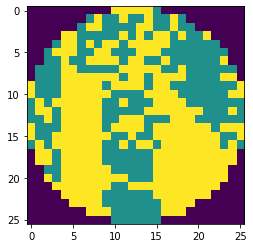

wafer_id:3, ウエハサイズ:26x26, スタンプサイズ:2x2, oDefects:136, nDefects:272, p=50.000


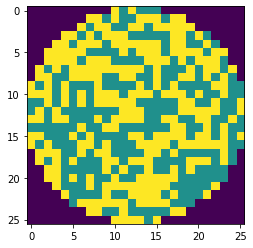

wafer_id:3, ウエハサイズ:26x26, スタンプサイズ:3x2, oDefects:133, nDefects:262, p=50.763


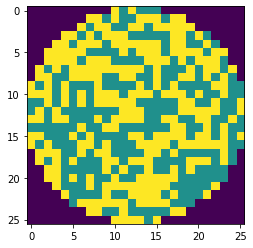

wafer_id:3, ウエハサイズ:26x26, スタンプサイズ:4x2, oDefects:133, nDefects:262, p=50.763


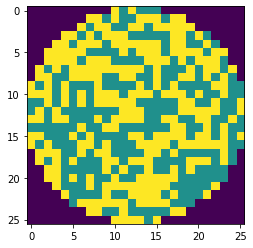

wafer_id:3, ウエハサイズ:26x26, スタンプサイズ:3x4, oDefects:113, nDefects:225, p=50.222


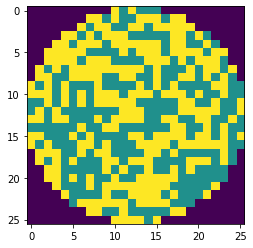

wafer_id:3, ウエハサイズ:26x26, スタンプサイズ:4x4, oDefects:113, nDefects:225, p=50.222


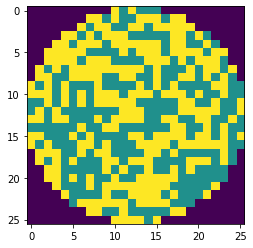

wafer_id:9, ウエハサイズ:26x26, スタンプサイズ:2x2, oDefects:155, nDefects:290, p=53.448


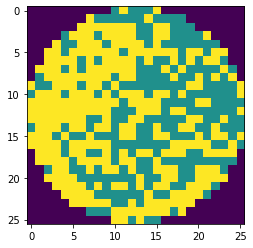

wafer_id:9, ウエハサイズ:26x26, スタンプサイズ:3x2, oDefects:148, nDefects:279, p=53.047


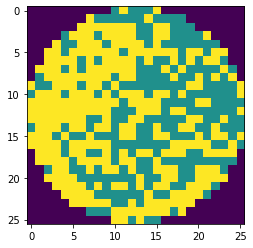

wafer_id:9, ウエハサイズ:26x26, スタンプサイズ:4x2, oDefects:148, nDefects:279, p=53.047


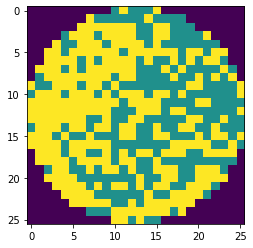

wafer_id:9, ウエハサイズ:26x26, スタンプサイズ:2x3, oDefects:151, nDefects:268, p=56.343


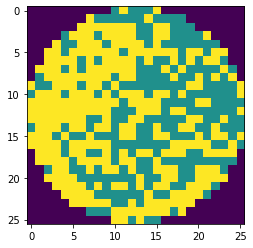

wafer_id:9, ウエハサイズ:26x26, スタンプサイズ:3x3, oDefects:145, nDefects:257, p=56.420


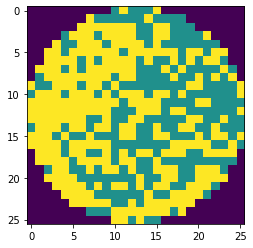

wafer_id:9, ウエハサイズ:26x26, スタンプサイズ:4x3, oDefects:145, nDefects:257, p=56.420


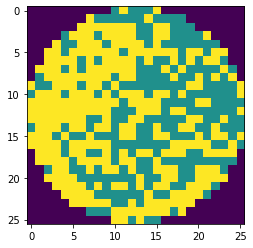

wafer_id:9, ウエハサイズ:26x26, スタンプサイズ:2x4, oDefects:134, nDefects:257, p=52.140


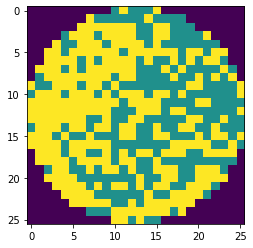

wafer_id:9, ウエハサイズ:26x26, スタンプサイズ:3x4, oDefects:130, nDefects:246, p=52.846


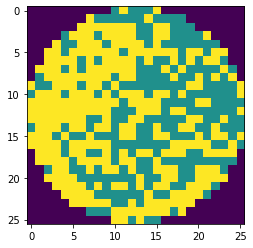

wafer_id:9, ウエハサイズ:26x26, スタンプサイズ:4x4, oDefects:130, nDefects:246, p=52.846


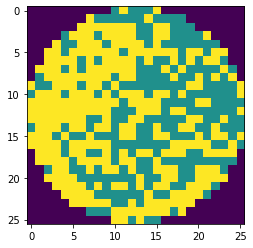

wafer_id:11, ウエハサイズ:26x26, スタンプサイズ:2x2, oDefects:142, nDefects:266, p=53.383


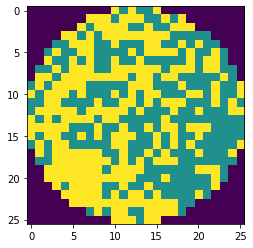

wafer_id:11, ウエハサイズ:26x26, スタンプサイズ:3x2, oDefects:137, nDefects:254, p=53.937


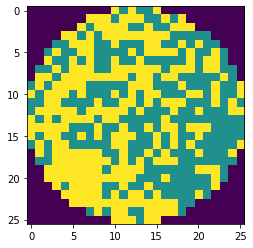

wafer_id:11, ウエハサイズ:26x26, スタンプサイズ:4x2, oDefects:137, nDefects:254, p=53.937


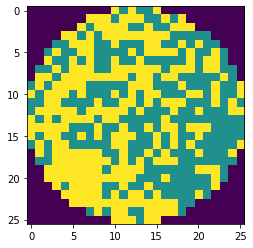

wafer_id:11, ウエハサイズ:26x26, スタンプサイズ:2x3, oDefects:131, nDefects:252, p=51.984


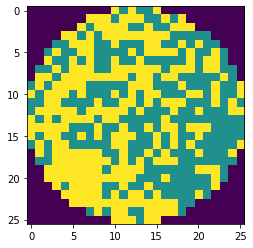

wafer_id:11, ウエハサイズ:26x26, スタンプサイズ:3x3, oDefects:126, nDefects:240, p=52.500


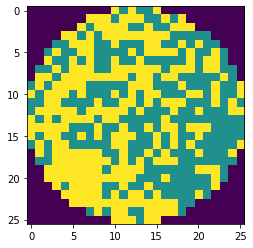

wafer_id:11, ウエハサイズ:26x26, スタンプサイズ:4x3, oDefects:126, nDefects:240, p=52.500


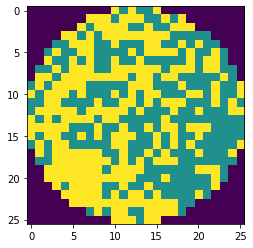

wafer_id:12, ウエハサイズ:26x26, スタンプサイズ:2x2, oDefects:139, nDefects:270, p=51.481


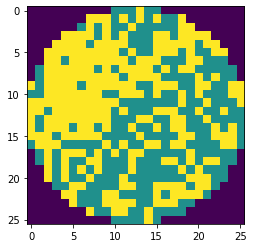

wafer_id:12, ウエハサイズ:26x26, スタンプサイズ:3x2, oDefects:139, nDefects:265, p=52.453


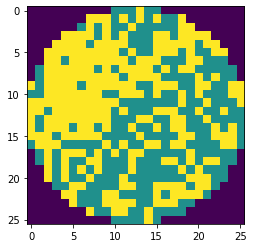

wafer_id:12, ウエハサイズ:26x26, スタンプサイズ:4x2, oDefects:139, nDefects:265, p=52.453


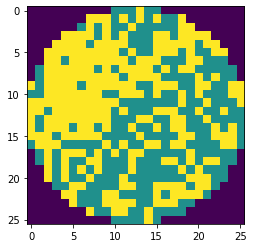

wafer_id:12, ウエハサイズ:26x26, スタンプサイズ:2x4, oDefects:123, nDefects:242, p=50.826


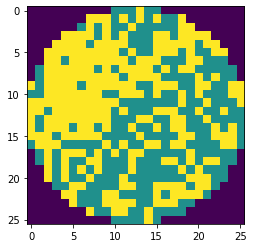

wafer_id:12, ウエハサイズ:26x26, スタンプサイズ:3x4, oDefects:121, nDefects:237, p=51.055


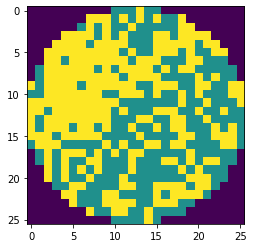

wafer_id:12, ウエハサイズ:26x26, スタンプサイズ:4x4, oDefects:121, nDefects:237, p=51.055


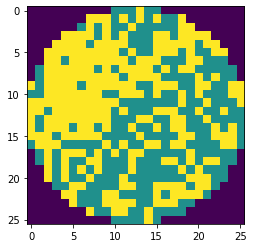

wafer_id:13, ウエハサイズ:26x26, スタンプサイズ:2x2, oDefects:163, nDefects:286, p=56.993


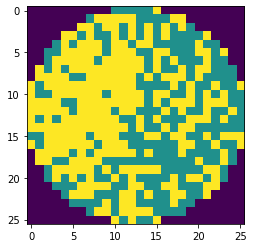

wafer_id:13, ウエハサイズ:26x26, スタンプサイズ:3x2, oDefects:159, nDefects:277, p=57.401


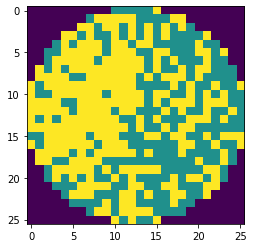

wafer_id:13, ウエハサイズ:26x26, スタンプサイズ:4x2, oDefects:159, nDefects:277, p=57.401


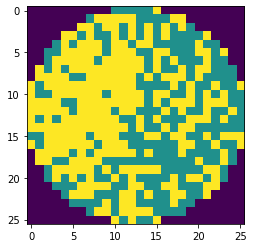

wafer_id:13, ウエハサイズ:26x26, スタンプサイズ:2x3, oDefects:144, nDefects:261, p=55.172


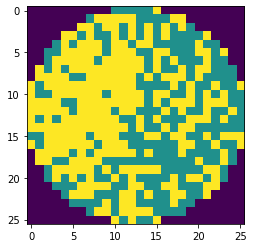

wafer_id:13, ウエハサイズ:26x26, スタンプサイズ:3x3, oDefects:140, nDefects:252, p=55.556


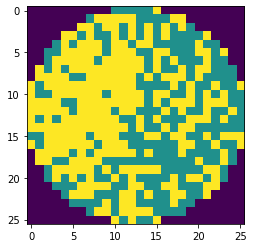

wafer_id:13, ウエハサイズ:26x26, スタンプサイズ:4x3, oDefects:140, nDefects:252, p=55.556


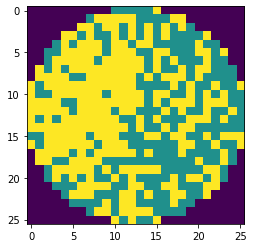

wafer_id:13, ウエハサイズ:26x26, スタンプサイズ:2x4, oDefects:134, nDefects:254, p=52.756


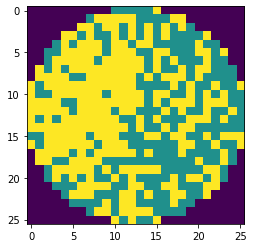

wafer_id:13, ウエハサイズ:26x26, スタンプサイズ:3x4, oDefects:132, nDefects:245, p=53.878


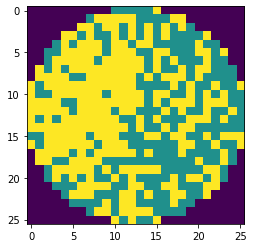

wafer_id:13, ウエハサイズ:26x26, スタンプサイズ:4x4, oDefects:132, nDefects:245, p=53.878


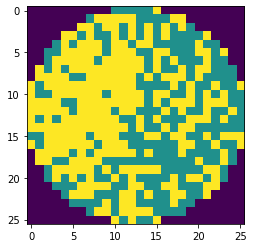

wafer_id:16, ウエハサイズ:26x26, スタンプサイズ:2x3, oDefects:117, nDefects:228, p=51.316


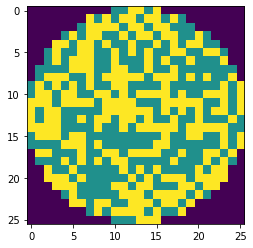

wafer_id:16, ウエハサイズ:26x26, スタンプサイズ:3x3, oDefects:113, nDefects:218, p=51.835


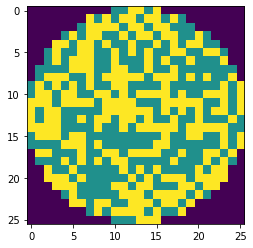

wafer_id:16, ウエハサイズ:26x26, スタンプサイズ:4x3, oDefects:113, nDefects:218, p=51.835


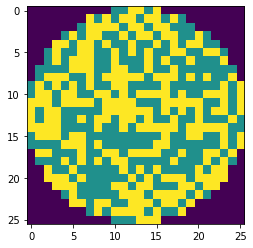

wafer_id:18, ウエハサイズ:26x26, スタンプサイズ:2x2, oDefects:141, nDefects:280, p=50.357


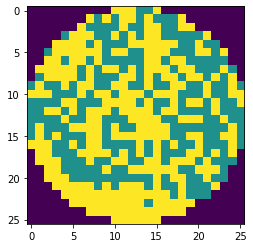

wafer_id:18, ウエハサイズ:26x26, スタンプサイズ:2x3, oDefects:136, nDefects:263, p=51.711


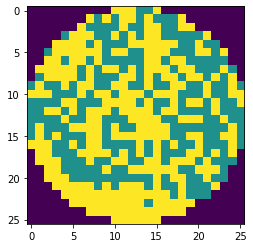

wafer_id:18, ウエハサイズ:26x26, スタンプサイズ:3x3, oDefects:124, nDefects:245, p=50.612


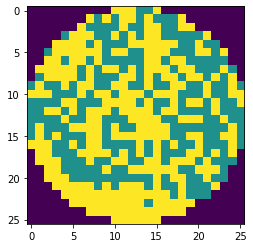

wafer_id:18, ウエハサイズ:26x26, スタンプサイズ:4x3, oDefects:124, nDefects:245, p=50.612


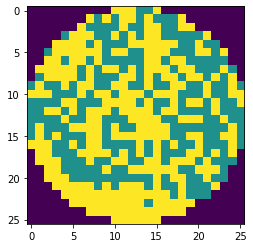

wafer_id:18, ウエハサイズ:26x26, スタンプサイズ:2x4, oDefects:127, nDefects:254, p=50.000


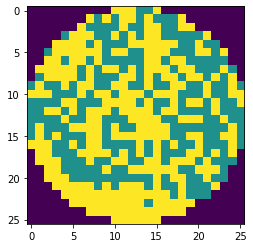

wafer_id:33, ウエハサイズ:41x41, スタンプサイズ:2x2, oDefects:354, nDefects:680, p=52.059


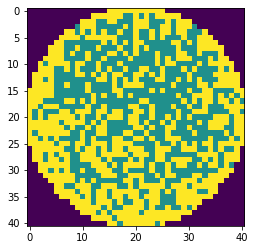

wafer_id:33, ウエハサイズ:41x41, スタンプサイズ:3x2, oDefects:341, nDefects:664, p=51.355


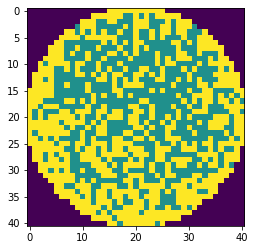

wafer_id:33, ウエハサイズ:41x41, スタンプサイズ:4x2, oDefects:354, nDefects:680, p=52.059


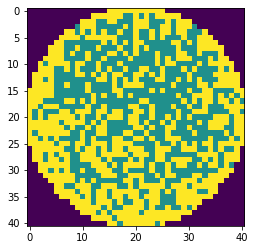

wafer_id:36, ウエハサイズ:41x41, スタンプサイズ:2x2, oDefects:323, nDefects:646, p=50.000


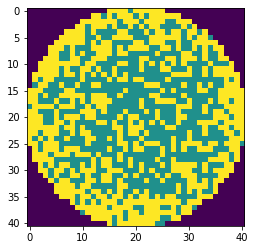

wafer_id:36, ウエハサイズ:41x41, スタンプサイズ:4x2, oDefects:323, nDefects:646, p=50.000


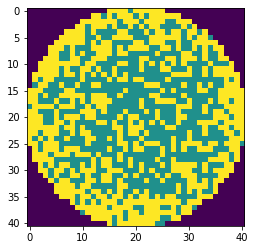

wafer_id:46, ウエハサイズ:41x41, スタンプサイズ:2x2, oDefects:396, nDefects:711, p=55.696


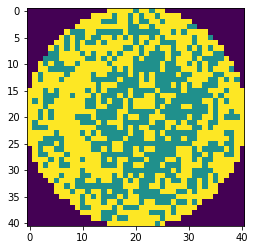

wafer_id:46, ウエハサイズ:41x41, スタンプサイズ:3x2, oDefects:390, nDefects:699, p=55.794


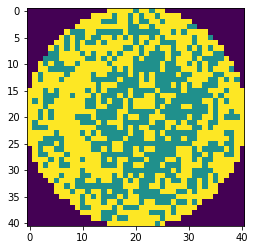

wafer_id:46, ウエハサイズ:41x41, スタンプサイズ:4x2, oDefects:396, nDefects:711, p=55.696


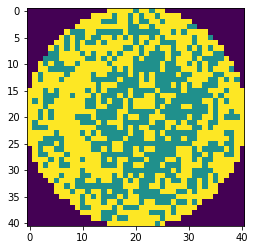

wafer_id:46, ウエハサイズ:41x41, スタンプサイズ:2x3, oDefects:346, nDefects:674, p=51.335


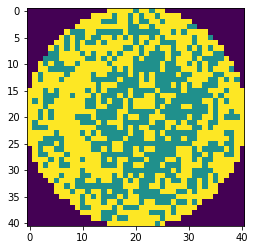

wafer_id:46, ウエハサイズ:41x41, スタンプサイズ:3x3, oDefects:339, nDefects:662, p=51.208


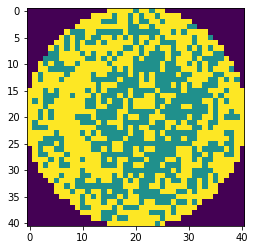

wafer_id:46, ウエハサイズ:41x41, スタンプサイズ:4x3, oDefects:346, nDefects:674, p=51.335


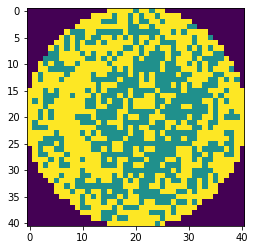

wafer_id:49, ウエハサイズ:41x41, スタンプサイズ:2x2, oDefects:330, nDefects:645, p=51.163


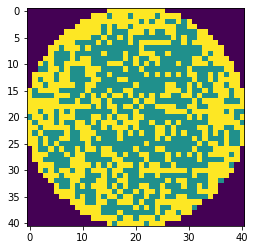

wafer_id:49, ウエハサイズ:41x41, スタンプサイズ:3x2, oDefects:321, nDefects:631, p=50.872


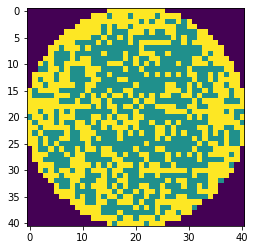

wafer_id:49, ウエハサイズ:41x41, スタンプサイズ:4x2, oDefects:330, nDefects:645, p=51.163


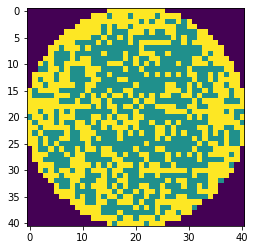

wafer_id:50, ウエハサイズ:41x41, スタンプサイズ:2x2, oDefects:344, nDefects:675, p=50.963


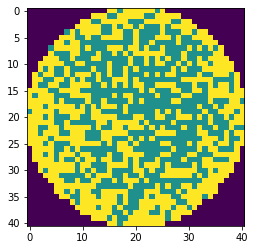

wafer_id:50, ウエハサイズ:41x41, スタンプサイズ:3x2, oDefects:336, nDefects:662, p=50.755


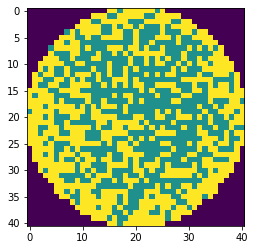

wafer_id:50, ウエハサイズ:41x41, スタンプサイズ:4x2, oDefects:344, nDefects:675, p=50.963


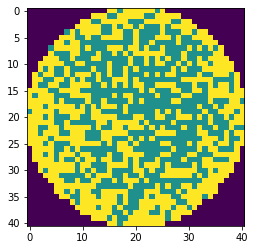

wafer_id:51, ウエハサイズ:41x41, スタンプサイズ:2x2, oDefects:357, nDefects:692, p=51.590


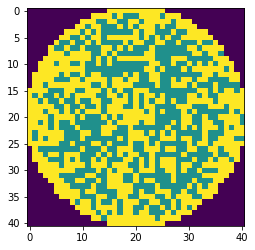

wafer_id:51, ウエハサイズ:41x41, スタンプサイズ:3x2, oDefects:346, nDefects:677, p=51.108


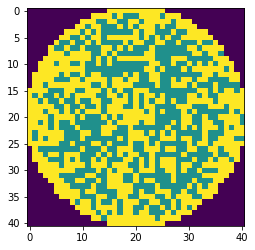

wafer_id:51, ウエハサイズ:41x41, スタンプサイズ:4x2, oDefects:357, nDefects:692, p=51.590


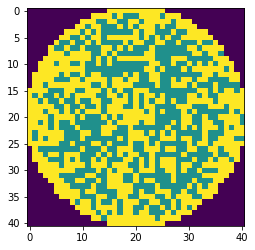

wafer_id:54, ウエハサイズ:41x41, スタンプサイズ:2x2, oDefects:411, nDefects:732, p=56.148


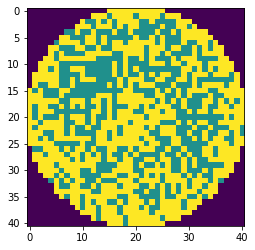

wafer_id:54, ウエハサイズ:41x41, スタンプサイズ:3x2, oDefects:401, nDefects:718, p=55.850


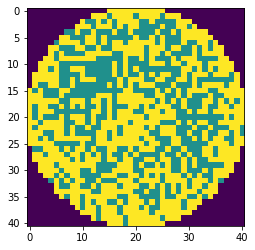

wafer_id:54, ウエハサイズ:41x41, スタンプサイズ:4x2, oDefects:411, nDefects:732, p=56.148


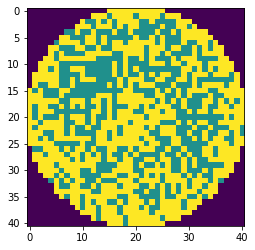

wafer_id:54, ウエハサイズ:41x41, スタンプサイズ:2x3, oDefects:375, nDefects:694, p=54.035


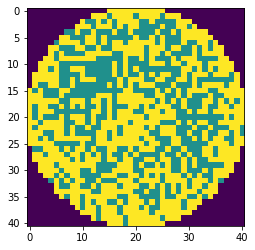

wafer_id:54, ウエハサイズ:41x41, スタンプサイズ:3x3, oDefects:366, nDefects:680, p=53.824


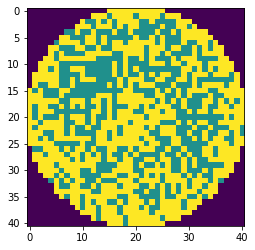

wafer_id:54, ウエハサイズ:41x41, スタンプサイズ:4x3, oDefects:375, nDefects:694, p=54.035


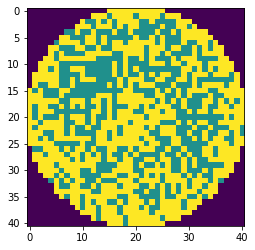

wafer_id:54, ウエハサイズ:41x41, スタンプサイズ:2x4, oDefects:375, nDefects:694, p=54.035


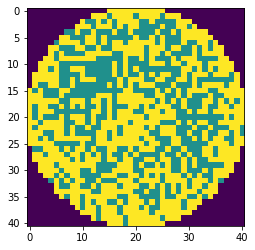

wafer_id:54, ウエハサイズ:41x41, スタンプサイズ:3x4, oDefects:366, nDefects:680, p=53.824


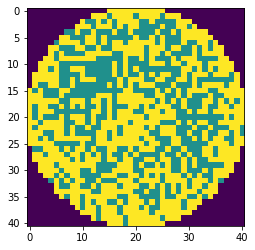

wafer_id:54, ウエハサイズ:41x41, スタンプサイズ:4x4, oDefects:375, nDefects:694, p=54.035


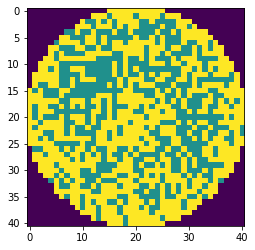

wafer_id:58, ウエハサイズ:41x41, スタンプサイズ:2x2, oDefects:381, nDefects:705, p=54.043


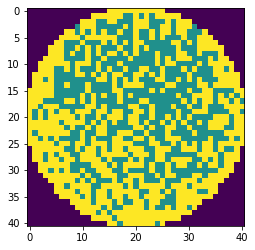

wafer_id:58, ウエハサイズ:41x41, スタンプサイズ:3x2, oDefects:368, nDefects:689, p=53.411


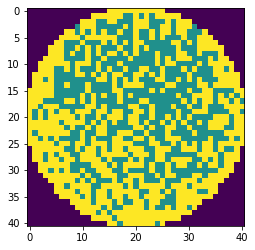

wafer_id:58, ウエハサイズ:41x41, スタンプサイズ:4x2, oDefects:381, nDefects:705, p=54.043


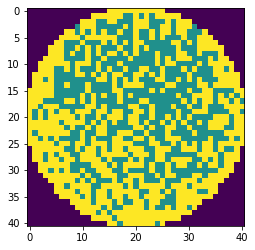

wafer_id:58, ウエハサイズ:41x41, スタンプサイズ:2x3, oDefects:341, nDefects:671, p=50.820


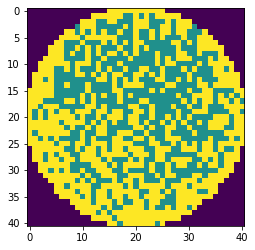

wafer_id:58, ウエハサイズ:41x41, スタンプサイズ:3x3, oDefects:329, nDefects:655, p=50.229


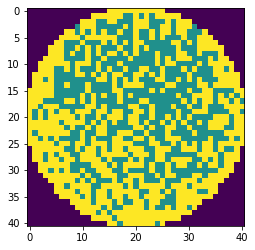

wafer_id:58, ウエハサイズ:41x41, スタンプサイズ:4x3, oDefects:341, nDefects:671, p=50.820


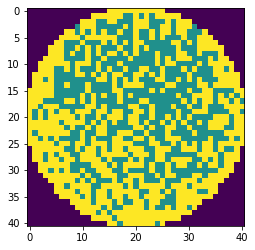

wafer_id:61, ウエハサイズ:41x41, スタンプサイズ:2x2, oDefects:361, nDefects:685, p=52.701


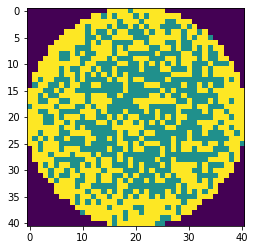

wafer_id:61, ウエハサイズ:41x41, スタンプサイズ:3x2, oDefects:353, nDefects:672, p=52.530


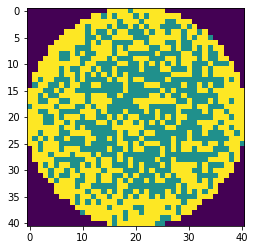

wafer_id:61, ウエハサイズ:41x41, スタンプサイズ:4x2, oDefects:361, nDefects:685, p=52.701


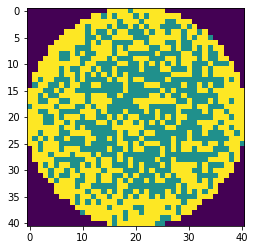

wafer_id:63, ウエハサイズ:41x41, スタンプサイズ:2x2, oDefects:351, nDefects:683, p=51.391


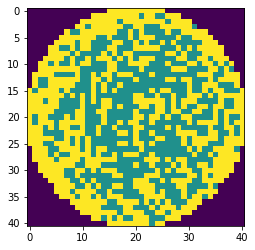

wafer_id:63, ウエハサイズ:41x41, スタンプサイズ:3x2, oDefects:347, nDefects:673, p=51.560


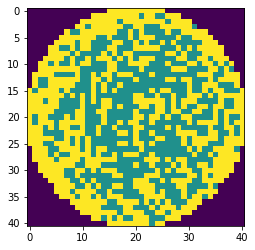

wafer_id:63, ウエハサイズ:41x41, スタンプサイズ:4x2, oDefects:351, nDefects:683, p=51.391


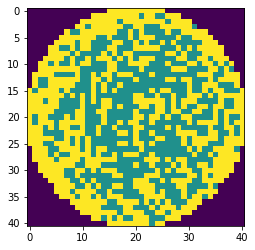

wafer_id:67, ウエハサイズ:41x41, スタンプサイズ:2x2, oDefects:387, nDefects:711, p=54.430


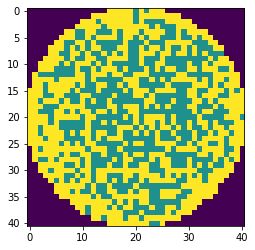

wafer_id:67, ウエハサイズ:41x41, スタンプサイズ:3x2, oDefects:378, nDefects:697, p=54.232


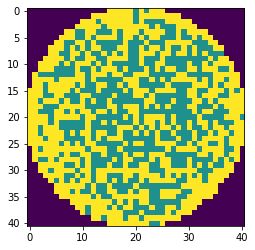

wafer_id:67, ウエハサイズ:41x41, スタンプサイズ:4x2, oDefects:387, nDefects:711, p=54.430


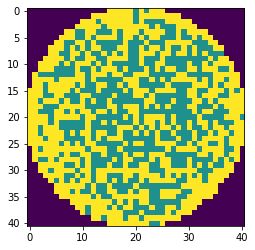

wafer_id:67, ウエハサイズ:41x41, スタンプサイズ:2x3, oDefects:353, nDefects:683, p=51.684


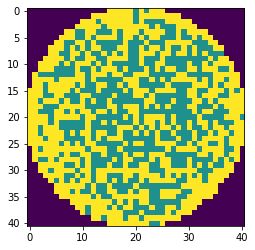

wafer_id:67, ウエハサイズ:41x41, スタンプサイズ:3x3, oDefects:343, nDefects:669, p=51.271


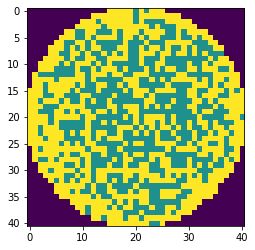

wafer_id:67, ウエハサイズ:41x41, スタンプサイズ:4x3, oDefects:353, nDefects:683, p=51.684


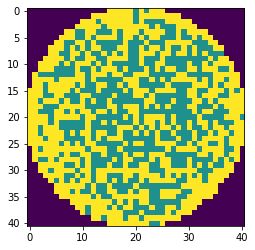

wafer_id:71, ウエハサイズ:41x41, スタンプサイズ:2x2, oDefects:432, nDefects:751, p=57.523


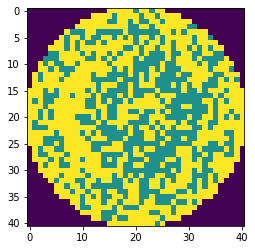

wafer_id:71, ウエハサイズ:41x41, スタンプサイズ:3x2, oDefects:426, nDefects:739, p=57.645


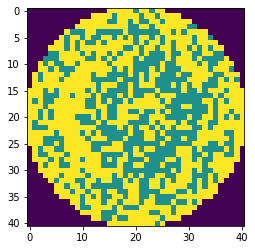

wafer_id:71, ウエハサイズ:41x41, スタンプサイズ:4x2, oDefects:432, nDefects:751, p=57.523


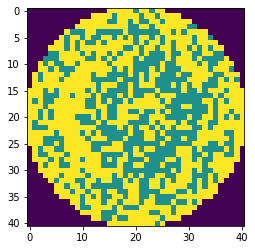

wafer_id:71, ウエハサイズ:41x41, スタンプサイズ:2x3, oDefects:391, nDefects:714, p=54.762


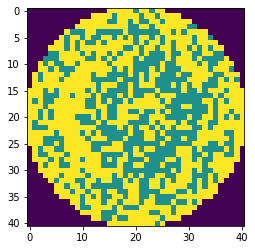

wafer_id:71, ウエハサイズ:41x41, スタンプサイズ:3x3, oDefects:384, nDefects:702, p=54.701


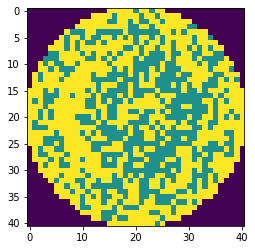

wafer_id:71, ウエハサイズ:41x41, スタンプサイズ:4x3, oDefects:391, nDefects:714, p=54.762


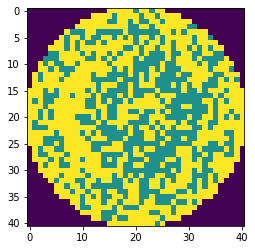

wafer_id:71, ウエハサイズ:41x41, スタンプサイズ:2x4, oDefects:372, nDefects:714, p=52.101


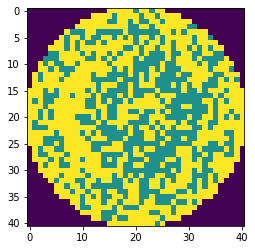

wafer_id:71, ウエハサイズ:41x41, スタンプサイズ:3x4, oDefects:365, nDefects:702, p=51.994


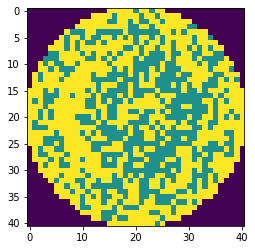

wafer_id:71, ウエハサイズ:41x41, スタンプサイズ:4x4, oDefects:372, nDefects:714, p=52.101


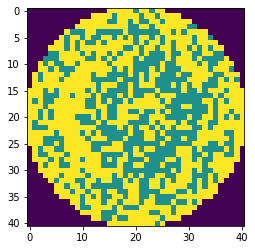

wafer_id:74, ウエハサイズ:41x41, スタンプサイズ:2x2, oDefects:385, nDefects:707, p=54.455


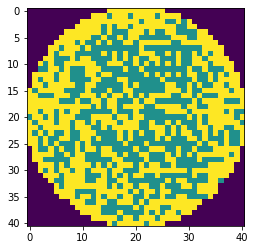

wafer_id:74, ウエハサイズ:41x41, スタンプサイズ:3x2, oDefects:376, nDefects:693, p=54.257


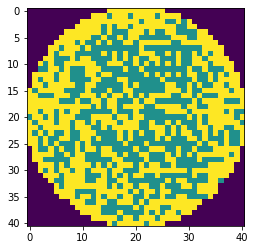

wafer_id:74, ウエハサイズ:41x41, スタンプサイズ:4x2, oDefects:385, nDefects:707, p=54.455


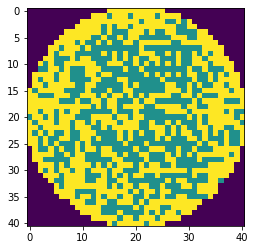

wafer_id:74, ウエハサイズ:41x41, スタンプサイズ:2x3, oDefects:349, nDefects:669, p=52.167


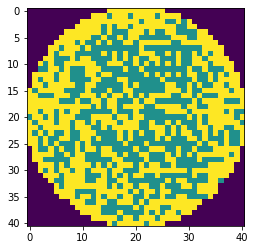

wafer_id:74, ウエハサイズ:41x41, スタンプサイズ:3x3, oDefects:340, nDefects:655, p=51.908


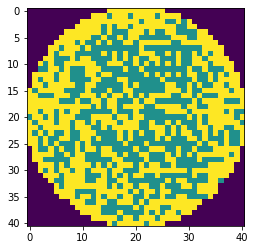

wafer_id:74, ウエハサイズ:41x41, スタンプサイズ:4x3, oDefects:349, nDefects:669, p=52.167


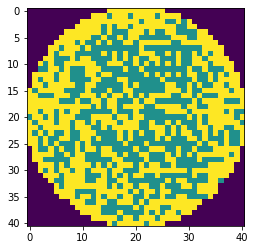

wafer_id:75, ウエハサイズ:41x41, スタンプサイズ:2x4, oDefects:458, nDefects:792, p=57.828


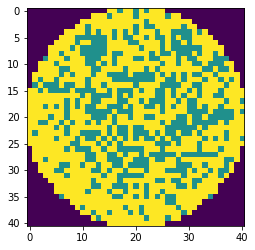

wafer_id:75, ウエハサイズ:41x41, スタンプサイズ:3x4, oDefects:448, nDefects:778, p=57.584


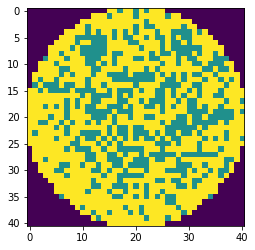

wafer_id:75, ウエハサイズ:41x41, スタンプサイズ:4x4, oDefects:458, nDefects:792, p=57.828


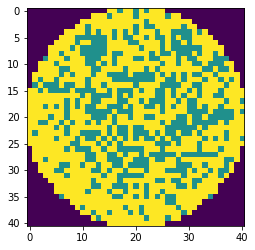

wafer_id:76, ウエハサイズ:41x41, スタンプサイズ:3x4, oDefects:471, nDefects:789, p=59.696


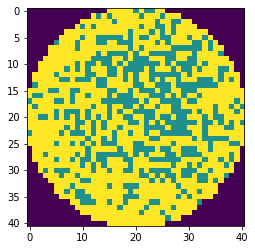

wafer_id:77, ウエハサイズ:41x41, スタンプサイズ:2x3, oDefects:468, nDefects:792, p=59.091


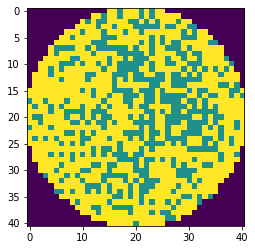

wafer_id:77, ウエハサイズ:41x41, スタンプサイズ:3x3, oDefects:456, nDefects:777, p=58.687


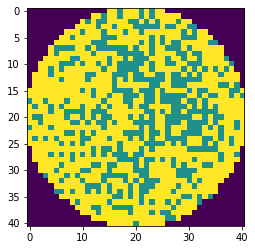

wafer_id:77, ウエハサイズ:41x41, スタンプサイズ:4x3, oDefects:468, nDefects:792, p=59.091


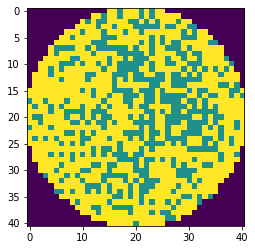

wafer_id:77, ウエハサイズ:41x41, スタンプサイズ:2x4, oDefects:465, nDefects:792, p=58.712


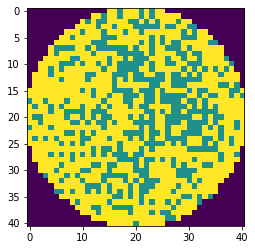

wafer_id:77, ウエハサイズ:41x41, スタンプサイズ:3x4, oDefects:454, nDefects:777, p=58.430


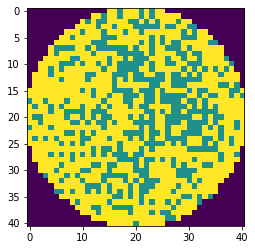

wafer_id:77, ウエハサイズ:41x41, スタンプサイズ:4x4, oDefects:465, nDefects:792, p=58.712


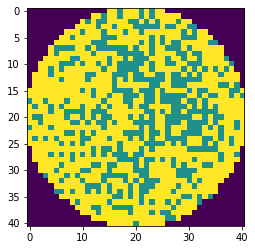

wafer_id:78, ウエハサイズ:41x41, スタンプサイズ:2x2, oDefects:416, nDefects:746, p=55.764


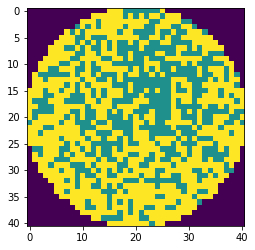

wafer_id:78, ウエハサイズ:41x41, スタンプサイズ:3x2, oDefects:411, nDefects:735, p=55.918


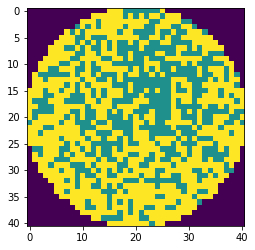

wafer_id:78, ウエハサイズ:41x41, スタンプサイズ:4x2, oDefects:416, nDefects:746, p=55.764


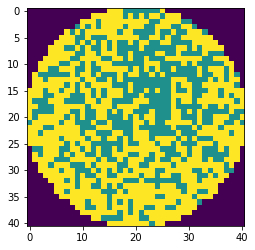

wafer_id:78, ウエハサイズ:41x41, スタンプサイズ:2x3, oDefects:380, nDefects:715, p=53.147


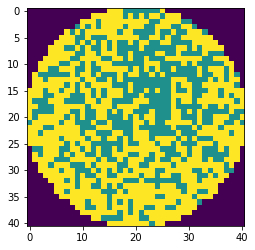

wafer_id:78, ウエハサイズ:41x41, スタンプサイズ:3x3, oDefects:376, nDefects:704, p=53.409


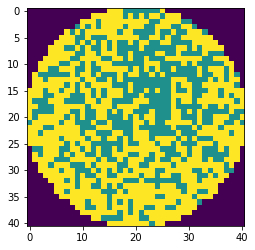

wafer_id:78, ウエハサイズ:41x41, スタンプサイズ:4x3, oDefects:380, nDefects:715, p=53.147


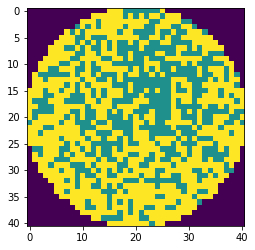

wafer_id:78, ウエハサイズ:41x41, スタンプサイズ:2x4, oDefects:386, nDefects:715, p=53.986


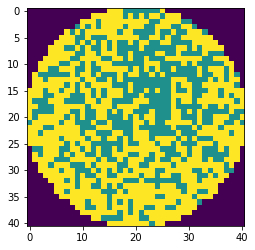

wafer_id:78, ウエハサイズ:41x41, スタンプサイズ:3x4, oDefects:382, nDefects:704, p=54.261


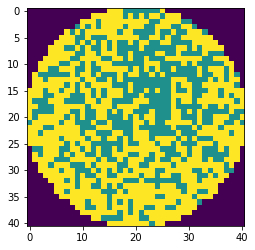

wafer_id:78, ウエハサイズ:41x41, スタンプサイズ:4x4, oDefects:386, nDefects:715, p=53.986


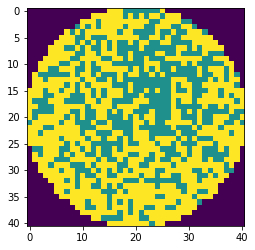

wafer_id:79, ウエハサイズ:41x41, スタンプサイズ:2x3, oDefects:310, nDefects:613, p=50.571


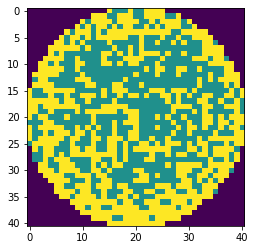

wafer_id:79, ウエハサイズ:41x41, スタンプサイズ:3x3, oDefects:302, nDefects:599, p=50.417


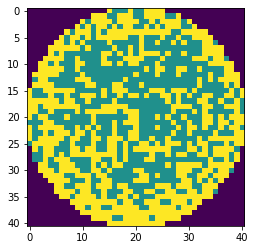

wafer_id:79, ウエハサイズ:41x41, スタンプサイズ:4x3, oDefects:310, nDefects:613, p=50.571


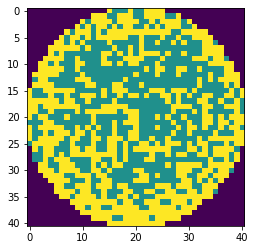

wafer_id:81, ウエハサイズ:41x41, スタンプサイズ:2x4, oDefects:474, nDefects:804, p=58.955


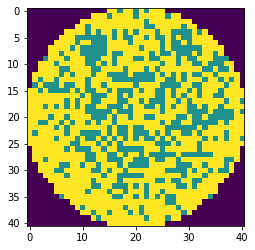

wafer_id:81, ウエハサイズ:41x41, スタンプサイズ:3x4, oDefects:464, nDefects:790, p=58.734


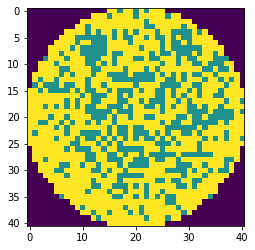

wafer_id:81, ウエハサイズ:41x41, スタンプサイズ:4x4, oDefects:474, nDefects:804, p=58.955


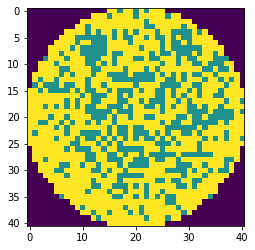

wafer_id:82, ウエハサイズ:41x41, スタンプサイズ:3x4, oDefects:479, nDefects:800, p=59.875


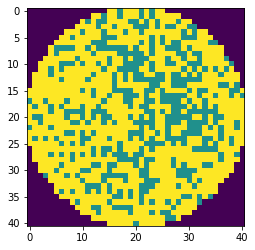

wafer_id:83, ウエハサイズ:41x41, スタンプサイズ:2x2, oDefects:452, nDefects:772, p=58.549


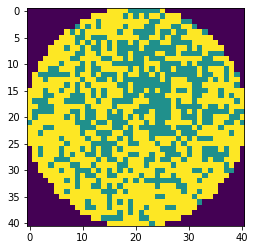

wafer_id:83, ウエハサイズ:41x41, スタンプサイズ:3x2, oDefects:447, nDefects:761, p=58.739


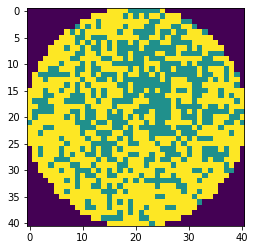

wafer_id:83, ウエハサイズ:41x41, スタンプサイズ:4x2, oDefects:452, nDefects:772, p=58.549


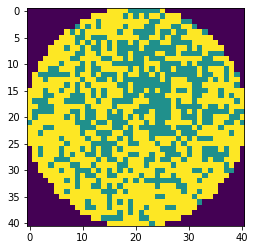

wafer_id:83, ウエハサイズ:41x41, スタンプサイズ:2x3, oDefects:410, nDefects:741, p=55.331


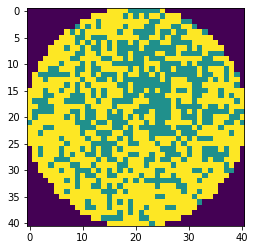

wafer_id:83, ウエハサイズ:41x41, スタンプサイズ:3x3, oDefects:406, nDefects:730, p=55.616


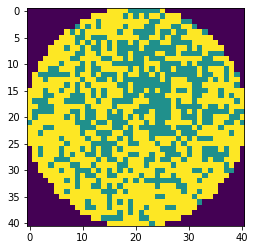

wafer_id:83, ウエハサイズ:41x41, スタンプサイズ:4x3, oDefects:410, nDefects:741, p=55.331


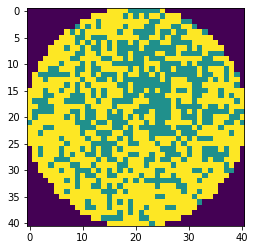

wafer_id:83, ウエハサイズ:41x41, スタンプサイズ:2x4, oDefects:413, nDefects:741, p=55.735


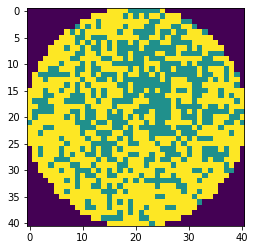

wafer_id:83, ウエハサイズ:41x41, スタンプサイズ:3x4, oDefects:409, nDefects:730, p=56.027


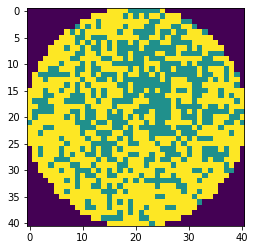

wafer_id:83, ウエハサイズ:41x41, スタンプサイズ:4x4, oDefects:413, nDefects:741, p=55.735


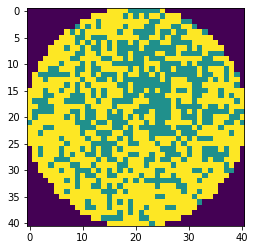

wafer_id:84, ウエハサイズ:41x41, スタンプサイズ:2x2, oDefects:341, nDefects:666, p=51.201


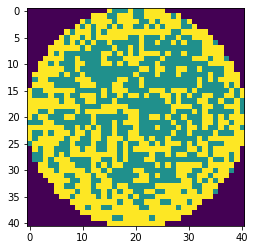

wafer_id:84, ウエハサイズ:41x41, スタンプサイズ:3x2, oDefects:332, nDefects:652, p=50.920


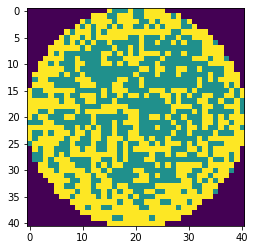

wafer_id:84, ウエハサイズ:41x41, スタンプサイズ:4x2, oDefects:341, nDefects:666, p=51.201


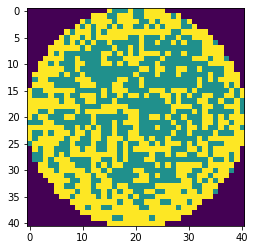

wafer_id:84, ウエハサイズ:41x41, スタンプサイズ:2x3, oDefects:329, nDefects:634, p=51.893


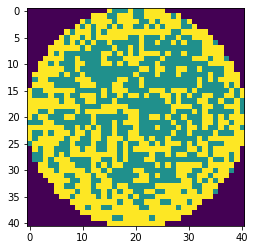

wafer_id:84, ウエハサイズ:41x41, スタンプサイズ:3x3, oDefects:321, nDefects:620, p=51.774


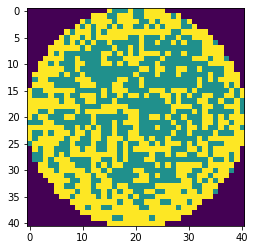

wafer_id:84, ウエハサイズ:41x41, スタンプサイズ:4x3, oDefects:329, nDefects:634, p=51.893


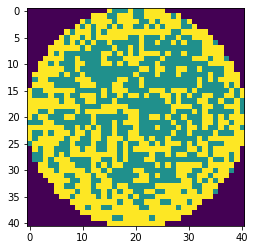

wafer_id:84, ウエハサイズ:41x41, スタンプサイズ:2x4, oDefects:322, nDefects:634, p=50.789


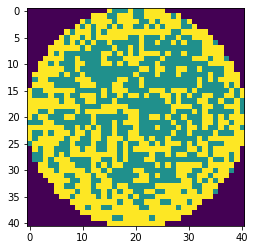

wafer_id:84, ウエハサイズ:41x41, スタンプサイズ:3x4, oDefects:315, nDefects:620, p=50.806


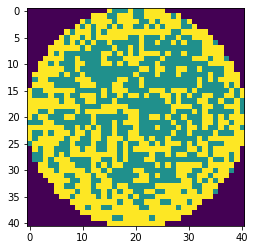

wafer_id:84, ウエハサイズ:41x41, スタンプサイズ:4x4, oDefects:322, nDefects:634, p=50.789


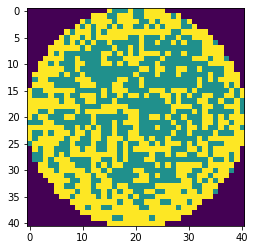

wafer_id:112, ウエハサイズ:41x41, スタンプサイズ:2x2, oDefects:374, nDefects:694, p=53.890


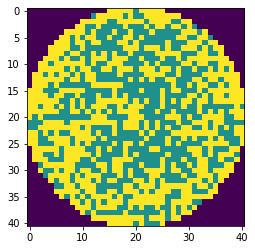

wafer_id:112, ウエハサイズ:41x41, スタンプサイズ:3x2, oDefects:363, nDefects:679, p=53.461


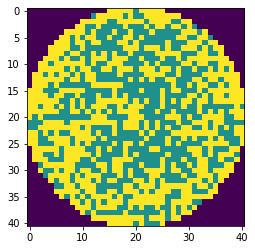

wafer_id:112, ウエハサイズ:41x41, スタンプサイズ:4x2, oDefects:374, nDefects:694, p=53.890


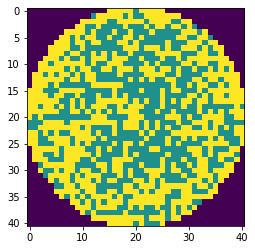

wafer_id:112, ウエハサイズ:41x41, スタンプサイズ:2x3, oDefects:337, nDefects:662, p=50.906


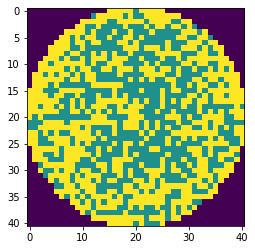

wafer_id:112, ウエハサイズ:41x41, スタンプサイズ:3x3, oDefects:326, nDefects:647, p=50.386


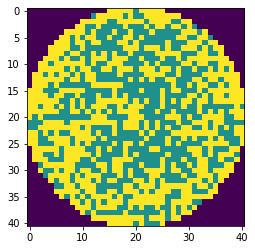

wafer_id:112, ウエハサイズ:41x41, スタンプサイズ:4x3, oDefects:337, nDefects:662, p=50.906


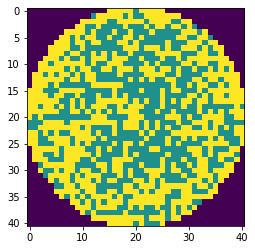

wafer_id:115, ウエハサイズ:41x41, スタンプサイズ:2x2, oDefects:356, nDefects:683, p=52.123


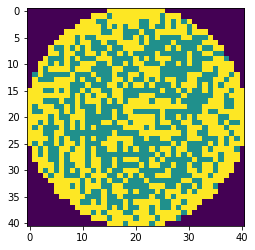

wafer_id:115, ウエハサイズ:41x41, スタンプサイズ:3x2, oDefects:348, nDefects:670, p=51.940


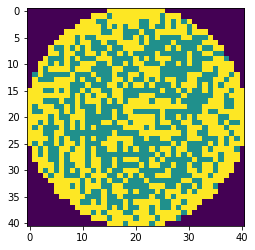

wafer_id:115, ウエハサイズ:41x41, スタンプサイズ:4x2, oDefects:356, nDefects:683, p=52.123


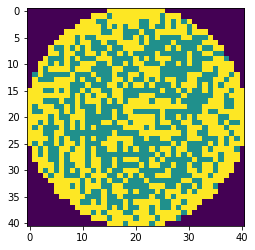

wafer_id:116, ウエハサイズ:41x41, スタンプサイズ:2x3, oDefects:444, nDefects:766, p=57.963


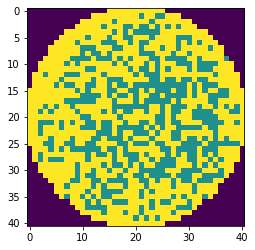

wafer_id:116, ウエハサイズ:41x41, スタンプサイズ:3x3, oDefects:436, nDefects:752, p=57.979


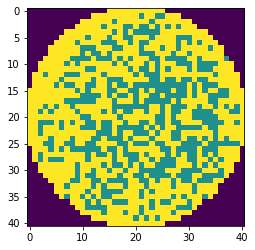

wafer_id:116, ウエハサイズ:41x41, スタンプサイズ:4x3, oDefects:444, nDefects:766, p=57.963


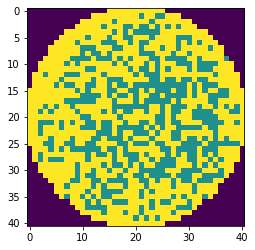

wafer_id:116, ウエハサイズ:41x41, スタンプサイズ:2x4, oDefects:433, nDefects:766, p=56.527


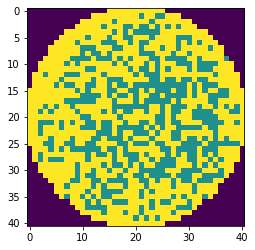

wafer_id:116, ウエハサイズ:41x41, スタンプサイズ:3x4, oDefects:425, nDefects:752, p=56.516


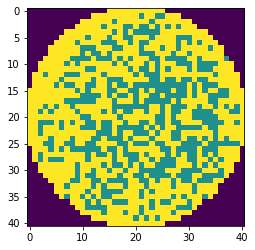

wafer_id:116, ウエハサイズ:41x41, スタンプサイズ:4x4, oDefects:433, nDefects:766, p=56.527


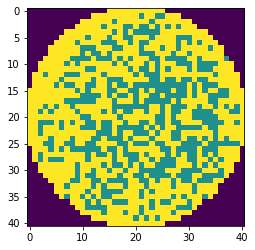

wafer_id:117, ウエハサイズ:41x41, スタンプサイズ:2x3, oDefects:448, nDefects:775, p=57.806


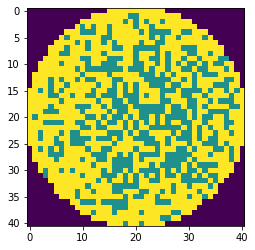

wafer_id:117, ウエハサイズ:41x41, スタンプサイズ:3x3, oDefects:437, nDefects:760, p=57.500


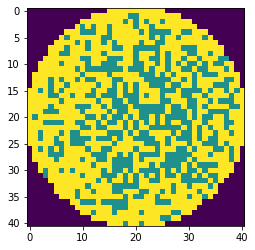

wafer_id:117, ウエハサイズ:41x41, スタンプサイズ:4x3, oDefects:448, nDefects:775, p=57.806


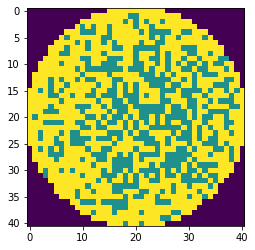

wafer_id:117, ウエハサイズ:41x41, スタンプサイズ:2x4, oDefects:432, nDefects:775, p=55.742


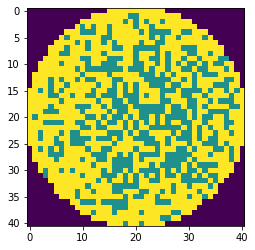

wafer_id:117, ウエハサイズ:41x41, スタンプサイズ:3x4, oDefects:421, nDefects:760, p=55.395


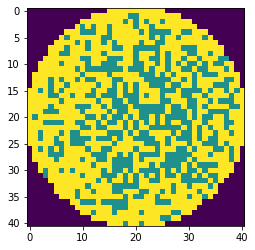

wafer_id:117, ウエハサイズ:41x41, スタンプサイズ:4x4, oDefects:432, nDefects:775, p=55.742


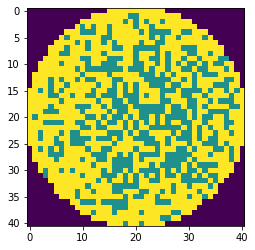

wafer_id:118, ウエハサイズ:41x41, スタンプサイズ:2x2, oDefects:451, nDefects:778, p=57.969


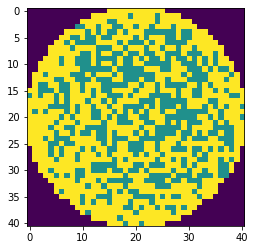

wafer_id:118, ウエハサイズ:41x41, スタンプサイズ:3x2, oDefects:438, nDefects:762, p=57.480


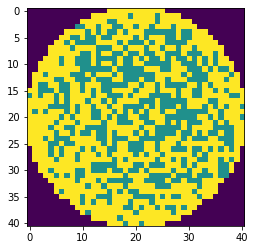

wafer_id:118, ウエハサイズ:41x41, スタンプサイズ:4x2, oDefects:451, nDefects:778, p=57.969


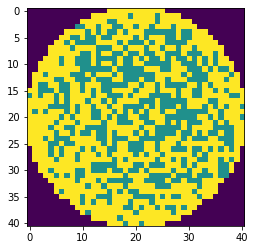

wafer_id:118, ウエハサイズ:41x41, スタンプサイズ:2x3, oDefects:424, nDefects:751, p=56.458


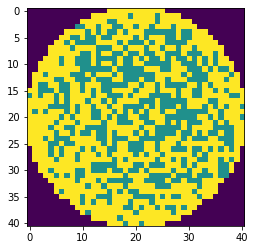

wafer_id:118, ウエハサイズ:41x41, スタンプサイズ:3x3, oDefects:412, nDefects:735, p=56.054


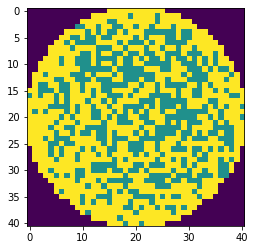

wafer_id:118, ウエハサイズ:41x41, スタンプサイズ:4x3, oDefects:424, nDefects:751, p=56.458


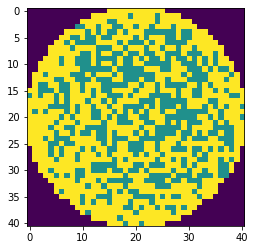

wafer_id:118, ウエハサイズ:41x41, スタンプサイズ:2x4, oDefects:404, nDefects:751, p=53.795


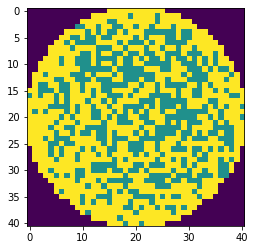

wafer_id:118, ウエハサイズ:41x41, スタンプサイズ:3x4, oDefects:393, nDefects:735, p=53.469


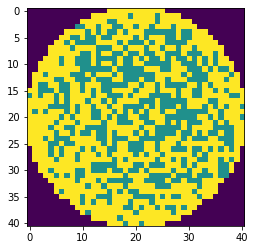

wafer_id:118, ウエハサイズ:41x41, スタンプサイズ:4x4, oDefects:404, nDefects:751, p=53.795


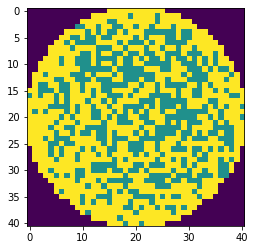

wafer_id:119, ウエハサイズ:41x41, スタンプサイズ:2x2, oDefects:441, nDefects:765, p=57.647


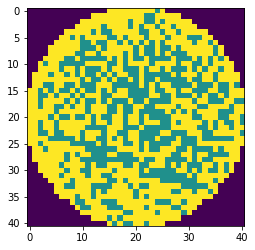

wafer_id:119, ウエハサイズ:41x41, スタンプサイズ:3x2, oDefects:429, nDefects:750, p=57.200


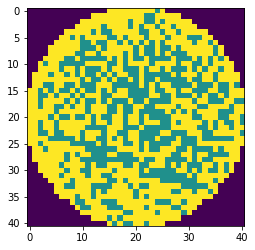

wafer_id:119, ウエハサイズ:41x41, スタンプサイズ:4x2, oDefects:441, nDefects:765, p=57.647


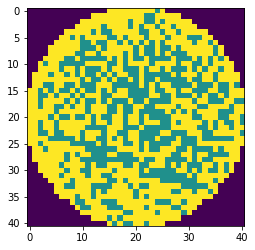

wafer_id:119, ウエハサイズ:41x41, スタンプサイズ:2x3, oDefects:419, nDefects:736, p=56.929


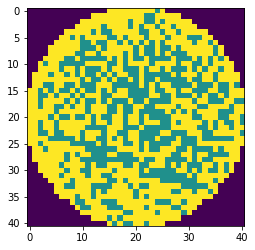

wafer_id:119, ウエハサイズ:41x41, スタンプサイズ:3x3, oDefects:409, nDefects:721, p=56.727


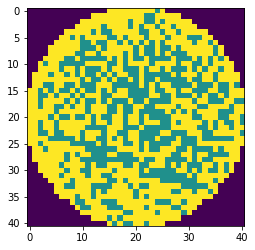

wafer_id:119, ウエハサイズ:41x41, スタンプサイズ:4x3, oDefects:419, nDefects:736, p=56.929


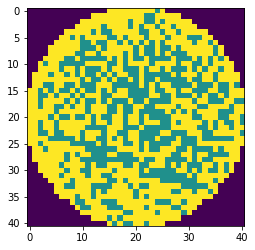

wafer_id:119, ウエハサイズ:41x41, スタンプサイズ:2x4, oDefects:382, nDefects:736, p=51.902


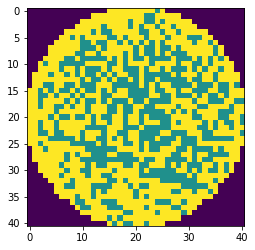

wafer_id:119, ウエハサイズ:41x41, スタンプサイズ:3x4, oDefects:372, nDefects:721, p=51.595


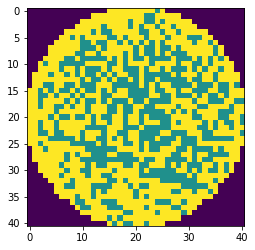

wafer_id:119, ウエハサイズ:41x41, スタンプサイズ:4x4, oDefects:382, nDefects:736, p=51.902


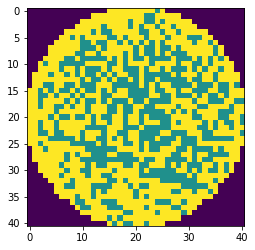

wafer_id:120, ウエハサイズ:41x41, スタンプサイズ:3x2, oDefects:466, nDefects:778, p=59.897


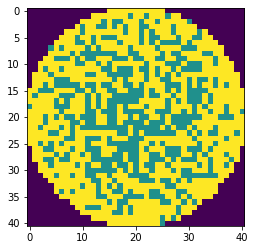

wafer_id:120, ウエハサイズ:41x41, スタンプサイズ:2x3, oDefects:436, nDefects:752, p=57.979


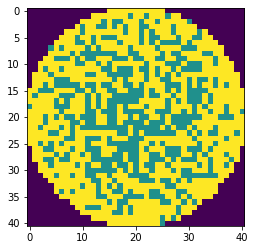

wafer_id:120, ウエハサイズ:41x41, スタンプサイズ:3x3, oDefects:425, nDefects:737, p=57.666


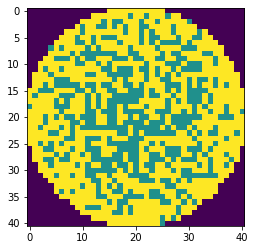

wafer_id:120, ウエハサイズ:41x41, スタンプサイズ:4x3, oDefects:436, nDefects:752, p=57.979


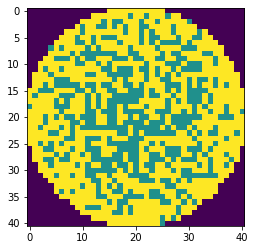

wafer_id:120, ウエハサイズ:41x41, スタンプサイズ:2x4, oDefects:433, nDefects:752, p=57.580


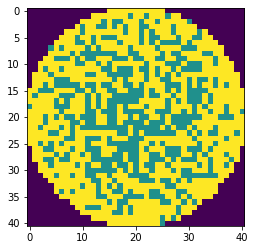

wafer_id:120, ウエハサイズ:41x41, スタンプサイズ:3x4, oDefects:422, nDefects:737, p=57.259


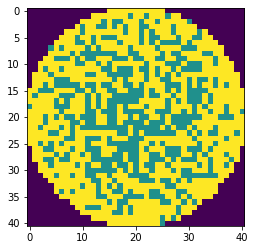

wafer_id:120, ウエハサイズ:41x41, スタンプサイズ:4x4, oDefects:433, nDefects:752, p=57.580


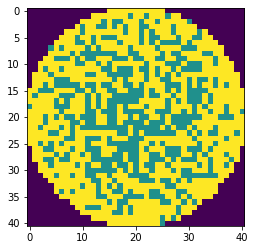

wafer_id:121, ウエハサイズ:41x41, スタンプサイズ:2x2, oDefects:463, nDefects:789, p=58.682


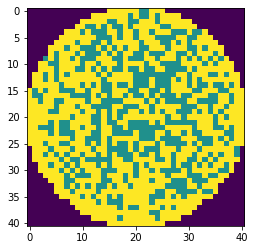

wafer_id:121, ウエハサイズ:41x41, スタンプサイズ:3x2, oDefects:452, nDefects:774, p=58.398


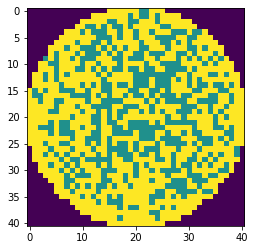

wafer_id:121, ウエハサイズ:41x41, スタンプサイズ:4x2, oDefects:463, nDefects:789, p=58.682


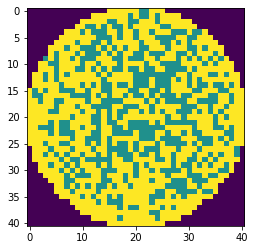

wafer_id:121, ウエハサイズ:41x41, スタンプサイズ:2x3, oDefects:417, nDefects:756, p=55.159


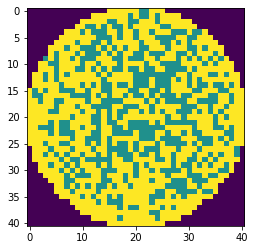

wafer_id:121, ウエハサイズ:41x41, スタンプサイズ:3x3, oDefects:407, nDefects:741, p=54.926


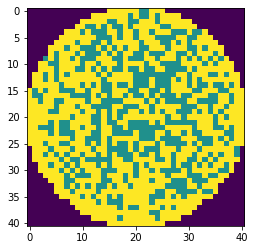

wafer_id:121, ウエハサイズ:41x41, スタンプサイズ:4x3, oDefects:417, nDefects:756, p=55.159


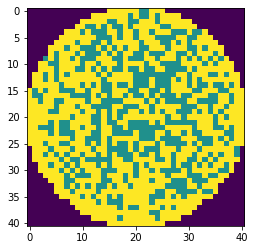

wafer_id:121, ウエハサイズ:41x41, スタンプサイズ:2x4, oDefects:420, nDefects:756, p=55.556


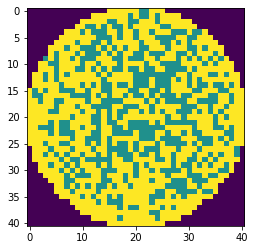

wafer_id:121, ウエハサイズ:41x41, スタンプサイズ:3x4, oDefects:411, nDefects:741, p=55.466


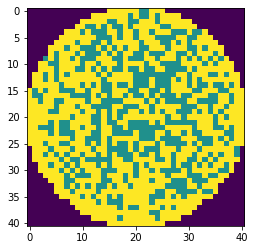

wafer_id:121, ウエハサイズ:41x41, スタンプサイズ:4x4, oDefects:420, nDefects:756, p=55.556


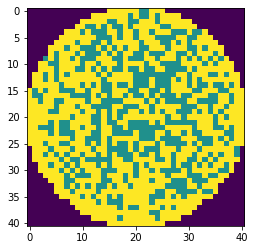

wafer_id:122, ウエハサイズ:41x41, スタンプサイズ:2x2, oDefects:402, nDefects:731, p=54.993


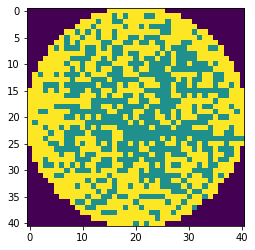

wafer_id:122, ウエハサイズ:41x41, スタンプサイズ:3x2, oDefects:389, nDefects:715, p=54.406


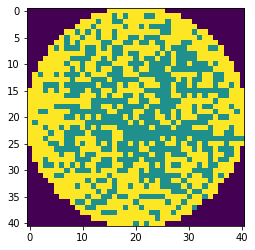

wafer_id:122, ウエハサイズ:41x41, スタンプサイズ:4x2, oDefects:402, nDefects:731, p=54.993


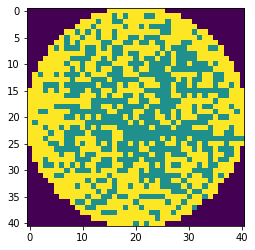

wafer_id:122, ウエハサイズ:41x41, スタンプサイズ:2x3, oDefects:387, nDefects:700, p=55.286


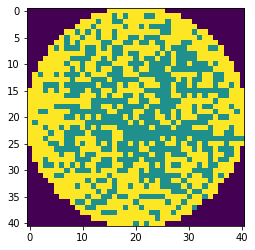

wafer_id:122, ウエハサイズ:41x41, スタンプサイズ:3x3, oDefects:375, nDefects:684, p=54.825


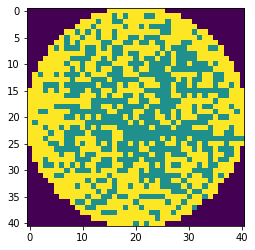

wafer_id:122, ウエハサイズ:41x41, スタンプサイズ:4x3, oDefects:387, nDefects:700, p=55.286


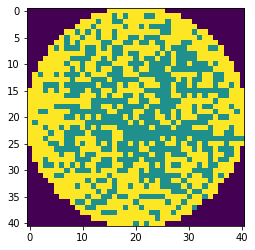

wafer_id:122, ウエハサイズ:41x41, スタンプサイズ:2x4, oDefects:356, nDefects:700, p=50.857


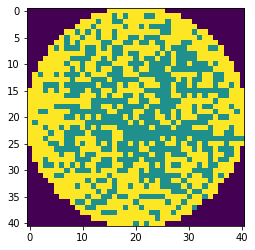

wafer_id:122, ウエハサイズ:41x41, スタンプサイズ:3x4, oDefects:345, nDefects:684, p=50.439


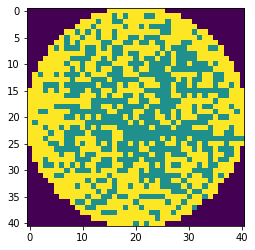

wafer_id:122, ウエハサイズ:41x41, スタンプサイズ:4x4, oDefects:356, nDefects:700, p=50.857


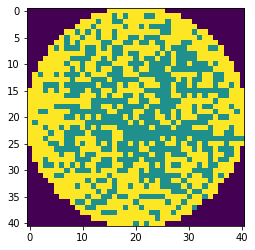

wafer_id:123, ウエハサイズ:41x41, スタンプサイズ:2x3, oDefects:470, nDefects:789, p=59.569


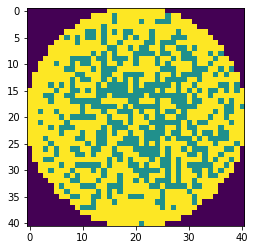

wafer_id:123, ウエハサイズ:41x41, スタンプサイズ:3x3, oDefects:456, nDefects:772, p=59.067


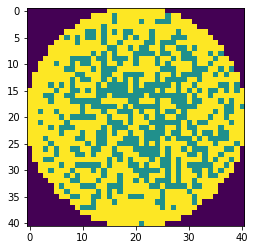

wafer_id:123, ウエハサイズ:41x41, スタンプサイズ:4x3, oDefects:470, nDefects:789, p=59.569


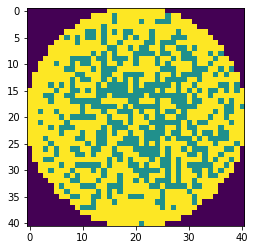

wafer_id:123, ウエハサイズ:41x41, スタンプサイズ:2x4, oDefects:454, nDefects:789, p=57.541


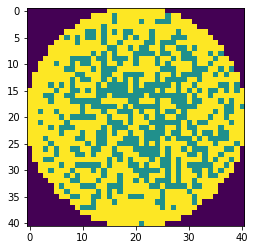

wafer_id:123, ウエハサイズ:41x41, スタンプサイズ:3x4, oDefects:441, nDefects:772, p=57.124


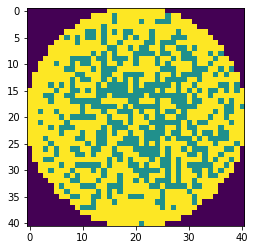

wafer_id:123, ウエハサイズ:41x41, スタンプサイズ:4x4, oDefects:454, nDefects:789, p=57.541


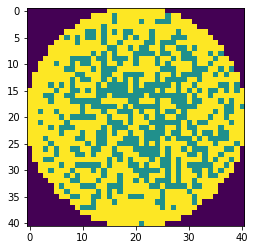

wafer_id:124, ウエハサイズ:41x41, スタンプサイズ:2x2, oDefects:449, nDefects:764, p=58.770


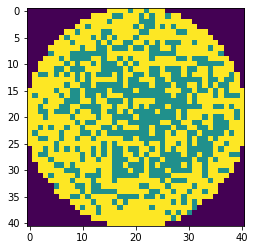

wafer_id:124, ウエハサイズ:41x41, スタンプサイズ:3x2, oDefects:435, nDefects:748, p=58.155


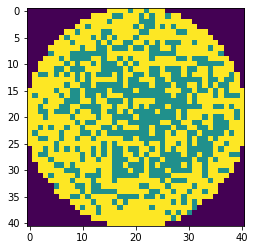

wafer_id:124, ウエハサイズ:41x41, スタンプサイズ:4x2, oDefects:449, nDefects:764, p=58.770


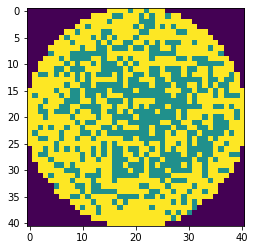

wafer_id:124, ウエハサイズ:41x41, スタンプサイズ:2x3, oDefects:436, nDefects:733, p=59.482


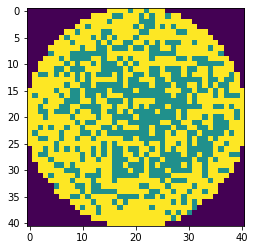

wafer_id:124, ウエハサイズ:41x41, スタンプサイズ:3x3, oDefects:423, nDefects:717, p=58.996


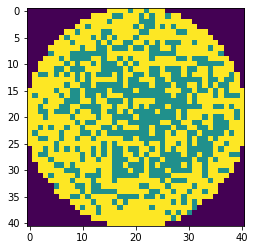

wafer_id:124, ウエハサイズ:41x41, スタンプサイズ:4x3, oDefects:436, nDefects:733, p=59.482


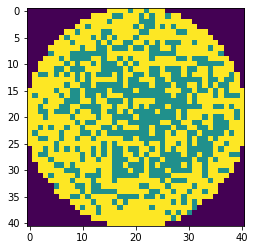

wafer_id:124, ウエハサイズ:41x41, スタンプサイズ:2x4, oDefects:409, nDefects:733, p=55.798


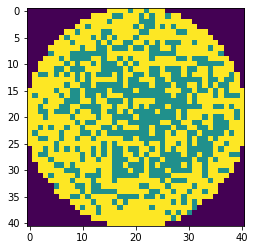

wafer_id:124, ウエハサイズ:41x41, スタンプサイズ:3x4, oDefects:397, nDefects:717, p=55.370


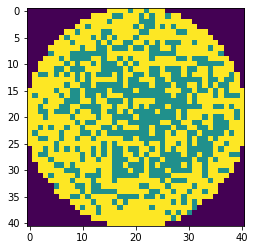

wafer_id:124, ウエハサイズ:41x41, スタンプサイズ:4x4, oDefects:409, nDefects:733, p=55.798


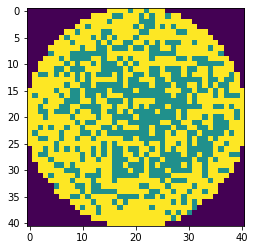

wafer_id:125, ウエハサイズ:41x41, スタンプサイズ:2x2, oDefects:481, nDefects:807, p=59.603


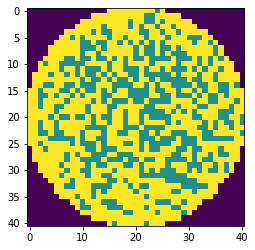

wafer_id:125, ウエハサイズ:41x41, スタンプサイズ:3x2, oDefects:466, nDefects:790, p=58.987


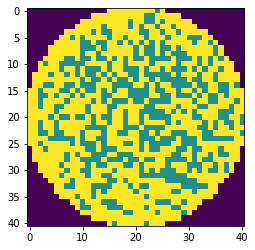

wafer_id:125, ウエハサイズ:41x41, スタンプサイズ:4x2, oDefects:481, nDefects:807, p=59.603


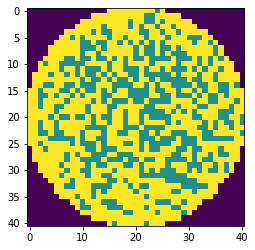

wafer_id:125, ウエハサイズ:41x41, スタンプサイズ:2x3, oDefects:466, nDefects:777, p=59.974


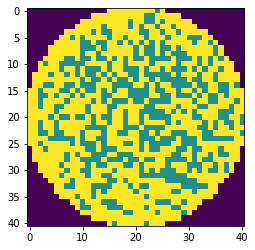

wafer_id:125, ウエハサイズ:41x41, スタンプサイズ:3x3, oDefects:452, nDefects:760, p=59.474


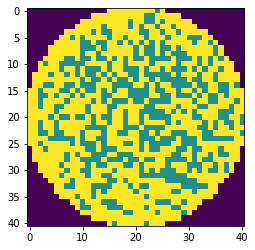

wafer_id:125, ウエハサイズ:41x41, スタンプサイズ:4x3, oDefects:466, nDefects:777, p=59.974


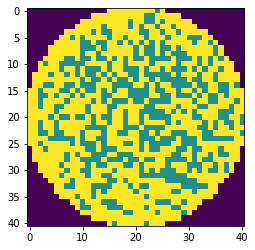

wafer_id:125, ウエハサイズ:41x41, スタンプサイズ:2x4, oDefects:428, nDefects:777, p=55.084


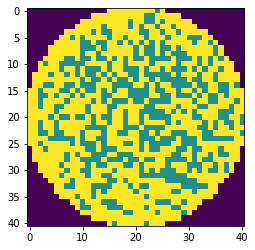

wafer_id:125, ウエハサイズ:41x41, スタンプサイズ:3x4, oDefects:415, nDefects:760, p=54.605


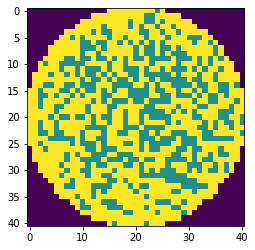

wafer_id:125, ウエハサイズ:41x41, スタンプサイズ:4x4, oDefects:428, nDefects:777, p=55.084


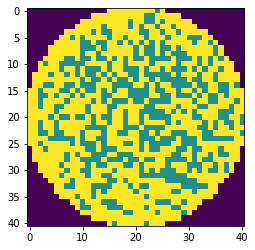

wafer_id:126, ウエハサイズ:41x41, スタンプサイズ:2x3, oDefects:455, nDefects:783, p=58.110


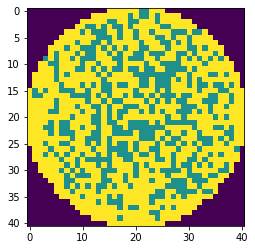

wafer_id:126, ウエハサイズ:41x41, スタンプサイズ:3x3, oDefects:445, nDefects:768, p=57.943


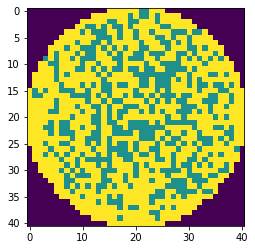

wafer_id:126, ウエハサイズ:41x41, スタンプサイズ:4x3, oDefects:455, nDefects:783, p=58.110


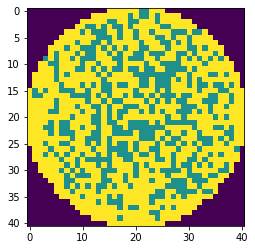

wafer_id:126, ウエハサイズ:41x41, スタンプサイズ:2x4, oDefects:448, nDefects:783, p=57.216


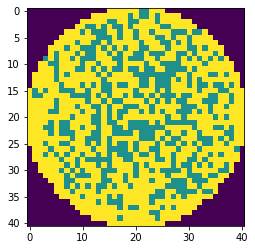

wafer_id:126, ウエハサイズ:41x41, スタンプサイズ:3x4, oDefects:439, nDefects:768, p=57.161


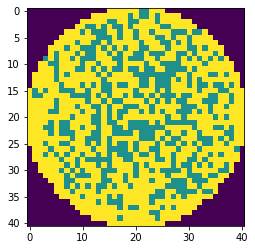

wafer_id:126, ウエハサイズ:41x41, スタンプサイズ:4x4, oDefects:448, nDefects:783, p=57.216


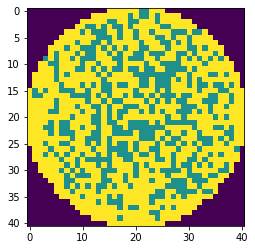

wafer_id:127, ウエハサイズ:41x41, スタンプサイズ:2x2, oDefects:453, nDefects:775, p=58.452


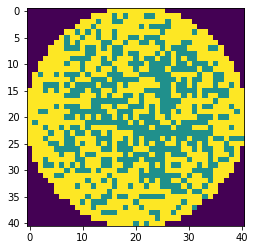

wafer_id:127, ウエハサイズ:41x41, スタンプサイズ:3x2, oDefects:440, nDefects:759, p=57.971


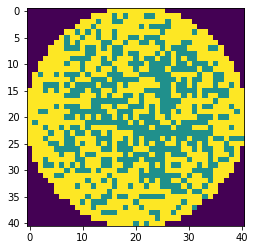

wafer_id:127, ウエハサイズ:41x41, スタンプサイズ:4x2, oDefects:453, nDefects:775, p=58.452


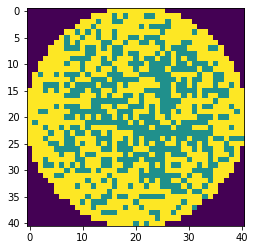

wafer_id:127, ウエハサイズ:41x41, スタンプサイズ:2x3, oDefects:426, nDefects:739, p=57.645


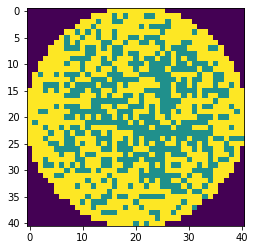

wafer_id:127, ウエハサイズ:41x41, スタンプサイズ:3x3, oDefects:414, nDefects:723, p=57.261


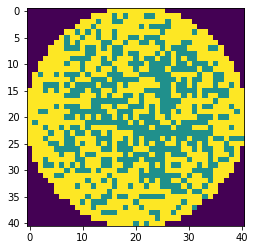

wafer_id:127, ウエハサイズ:41x41, スタンプサイズ:4x3, oDefects:426, nDefects:739, p=57.645


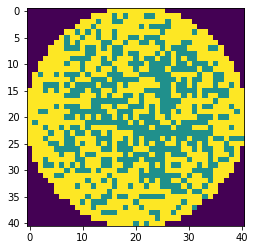

wafer_id:127, ウエハサイズ:41x41, スタンプサイズ:2x4, oDefects:399, nDefects:739, p=53.992


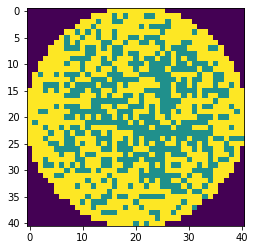

wafer_id:127, ウエハサイズ:41x41, スタンプサイズ:3x4, oDefects:388, nDefects:723, p=53.665


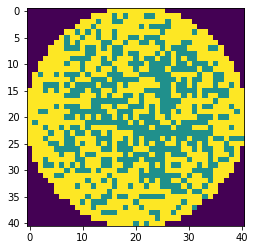

wafer_id:127, ウエハサイズ:41x41, スタンプサイズ:4x4, oDefects:399, nDefects:739, p=53.992


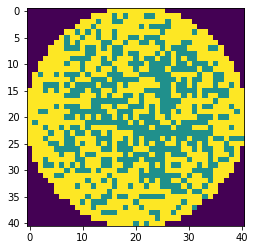

wafer_id:129, ウエハサイズ:41x41, スタンプサイズ:2x3, oDefects:465, nDefects:784, p=59.311


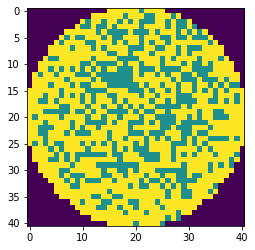

wafer_id:129, ウエハサイズ:41x41, スタンプサイズ:3x3, oDefects:453, nDefects:769, p=58.908


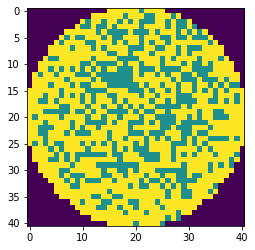

wafer_id:129, ウエハサイズ:41x41, スタンプサイズ:4x3, oDefects:465, nDefects:784, p=59.311


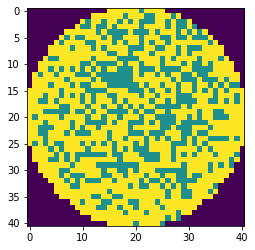

wafer_id:129, ウエハサイズ:41x41, スタンプサイズ:2x4, oDefects:464, nDefects:784, p=59.184


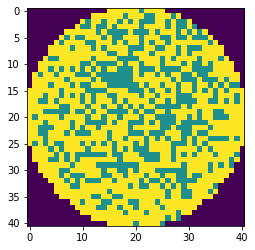

wafer_id:129, ウエハサイズ:41x41, スタンプサイズ:3x4, oDefects:453, nDefects:769, p=58.908


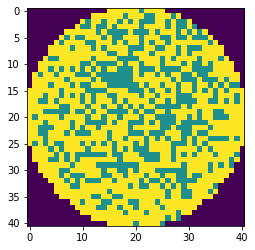

wafer_id:129, ウエハサイズ:41x41, スタンプサイズ:4x4, oDefects:464, nDefects:784, p=59.184


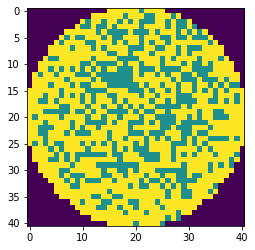

wafer_id:130, ウエハサイズ:41x41, スタンプサイズ:2x4, oDefects:471, nDefects:798, p=59.023


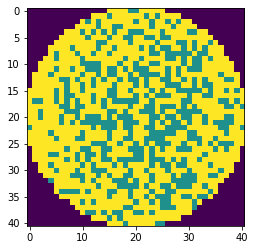

wafer_id:130, ウエハサイズ:41x41, スタンプサイズ:3x4, oDefects:461, nDefects:783, p=58.876


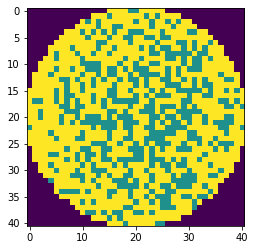

wafer_id:130, ウエハサイズ:41x41, スタンプサイズ:4x4, oDefects:471, nDefects:798, p=59.023


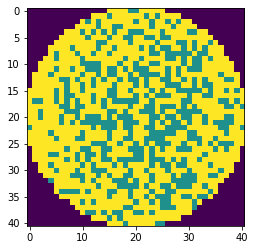

wafer_id:131, ウエハサイズ:41x41, スタンプサイズ:2x2, oDefects:362, nDefects:684, p=52.924


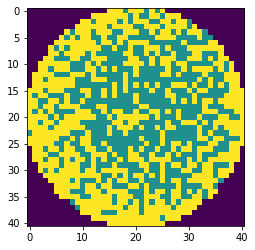

wafer_id:131, ウエハサイズ:41x41, スタンプサイズ:3x2, oDefects:349, nDefects:668, p=52.246


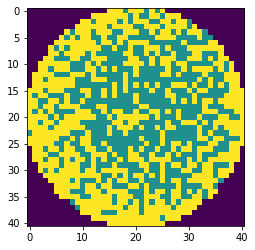

wafer_id:131, ウエハサイズ:41x41, スタンプサイズ:4x2, oDefects:362, nDefects:684, p=52.924


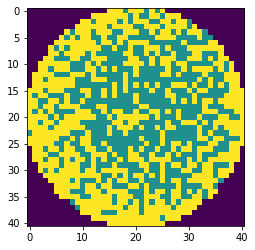

wafer_id:131, ウエハサイズ:41x41, スタンプサイズ:2x3, oDefects:335, nDefects:657, p=50.989


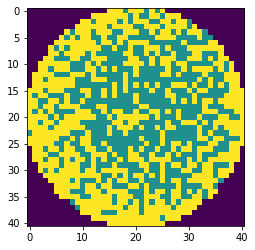

wafer_id:131, ウエハサイズ:41x41, スタンプサイズ:3x3, oDefects:323, nDefects:641, p=50.390


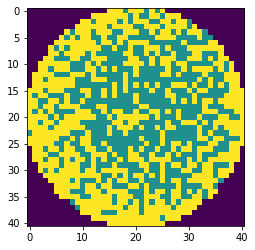

wafer_id:131, ウエハサイズ:41x41, スタンプサイズ:4x3, oDefects:335, nDefects:657, p=50.989


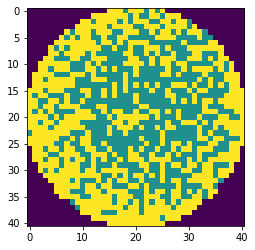

wafer_id:132, ウエハサイズ:41x41, スタンプサイズ:2x2, oDefects:435, nDefects:750, p=58.000


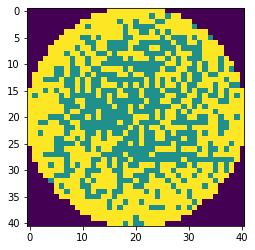

wafer_id:132, ウエハサイズ:41x41, スタンプサイズ:3x2, oDefects:422, nDefects:734, p=57.493


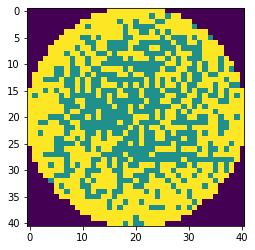

wafer_id:132, ウエハサイズ:41x41, スタンプサイズ:4x2, oDefects:435, nDefects:750, p=58.000


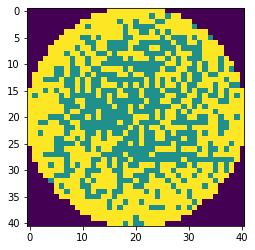

wafer_id:132, ウエハサイズ:41x41, スタンプサイズ:2x3, oDefects:421, nDefects:720, p=58.472


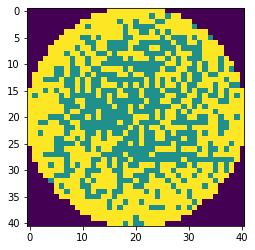

wafer_id:132, ウエハサイズ:41x41, スタンプサイズ:3x3, oDefects:409, nDefects:704, p=58.097


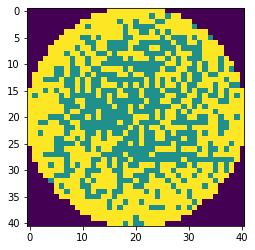

wafer_id:132, ウエハサイズ:41x41, スタンプサイズ:4x3, oDefects:421, nDefects:720, p=58.472


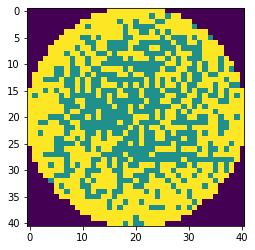

wafer_id:132, ウエハサイズ:41x41, スタンプサイズ:2x4, oDefects:393, nDefects:720, p=54.583


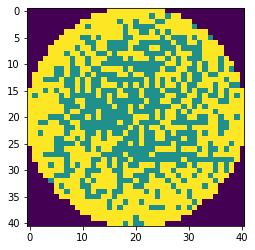

wafer_id:132, ウエハサイズ:41x41, スタンプサイズ:3x4, oDefects:382, nDefects:704, p=54.261


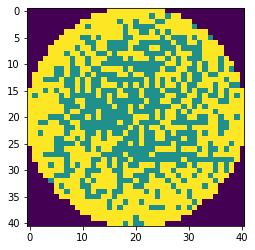

wafer_id:132, ウエハサイズ:41x41, スタンプサイズ:4x4, oDefects:393, nDefects:720, p=54.583


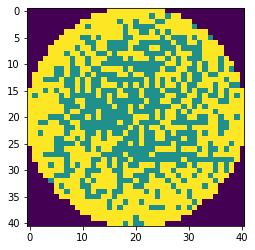

wafer_id:133, ウエハサイズ:41x41, スタンプサイズ:2x2, oDefects:410, nDefects:736, p=55.707


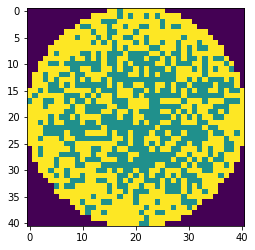

wafer_id:133, ウエハサイズ:41x41, スタンプサイズ:3x2, oDefects:397, nDefects:720, p=55.139


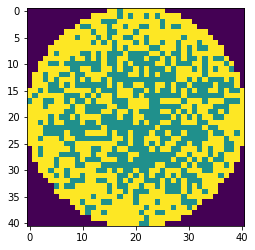

wafer_id:133, ウエハサイズ:41x41, スタンプサイズ:4x2, oDefects:410, nDefects:736, p=55.707


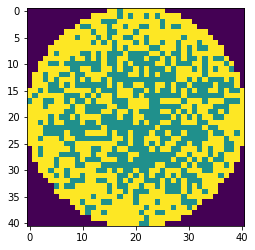

wafer_id:133, ウエハサイズ:41x41, スタンプサイズ:2x3, oDefects:390, nDefects:707, p=55.163


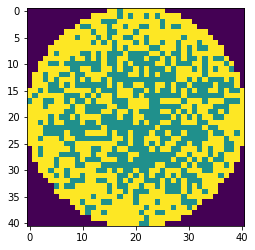

wafer_id:133, ウエハサイズ:41x41, スタンプサイズ:3x3, oDefects:378, nDefects:691, p=54.703


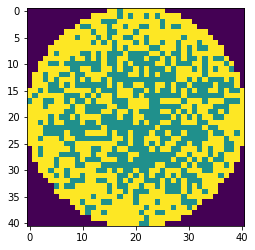

wafer_id:133, ウエハサイズ:41x41, スタンプサイズ:4x3, oDefects:390, nDefects:707, p=55.163


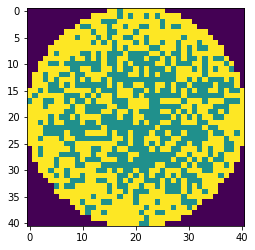

wafer_id:133, ウエハサイズ:41x41, スタンプサイズ:2x4, oDefects:376, nDefects:707, p=53.182


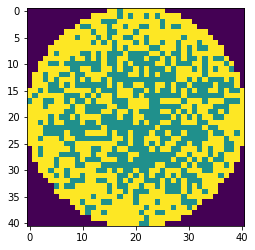

wafer_id:133, ウエハサイズ:41x41, スタンプサイズ:3x4, oDefects:365, nDefects:691, p=52.822


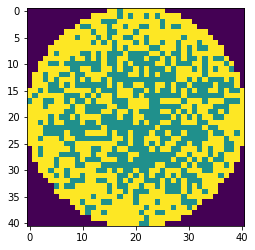

wafer_id:133, ウエハサイズ:41x41, スタンプサイズ:4x4, oDefects:376, nDefects:707, p=53.182


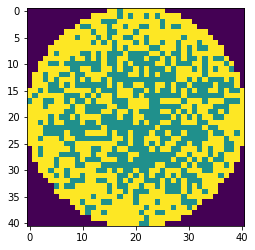

wafer_id:134, ウエハサイズ:41x41, スタンプサイズ:2x2, oDefects:461, nDefects:788, p=58.503


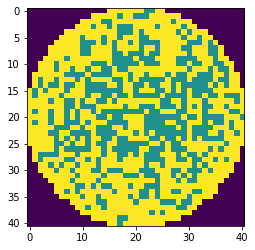

wafer_id:134, ウエハサイズ:41x41, スタンプサイズ:3x2, oDefects:450, nDefects:773, p=58.215


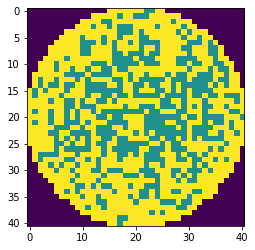

wafer_id:134, ウエハサイズ:41x41, スタンプサイズ:4x2, oDefects:461, nDefects:788, p=58.503


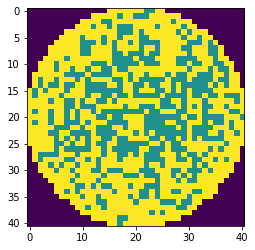

wafer_id:134, ウエハサイズ:41x41, スタンプサイズ:2x3, oDefects:444, nDefects:755, p=58.808


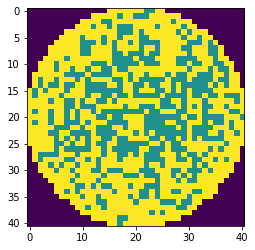

wafer_id:134, ウエハサイズ:41x41, スタンプサイズ:3x3, oDefects:434, nDefects:740, p=58.649


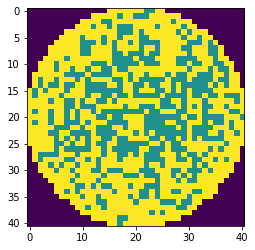

wafer_id:134, ウエハサイズ:41x41, スタンプサイズ:4x3, oDefects:444, nDefects:755, p=58.808


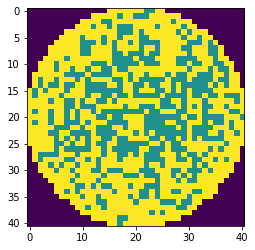

wafer_id:134, ウエハサイズ:41x41, スタンプサイズ:2x4, oDefects:419, nDefects:755, p=55.497


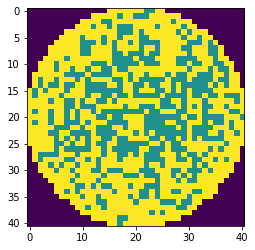

wafer_id:134, ウエハサイズ:41x41, スタンプサイズ:3x4, oDefects:410, nDefects:740, p=55.405


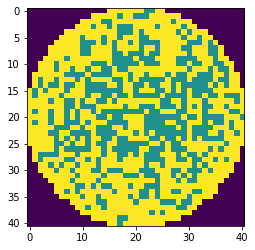

wafer_id:134, ウエハサイズ:41x41, スタンプサイズ:4x4, oDefects:419, nDefects:755, p=55.497


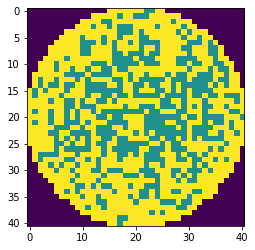

wafer_id:135, ウエハサイズ:41x41, スタンプサイズ:2x2, oDefects:448, nDefects:760, p=58.947


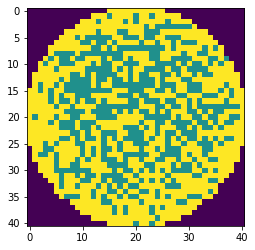

wafer_id:135, ウエハサイズ:41x41, スタンプサイズ:3x2, oDefects:435, nDefects:744, p=58.468


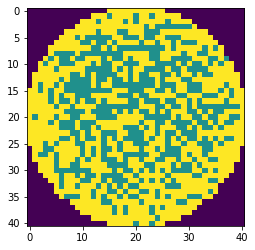

wafer_id:135, ウエハサイズ:41x41, スタンプサイズ:4x2, oDefects:448, nDefects:760, p=58.947


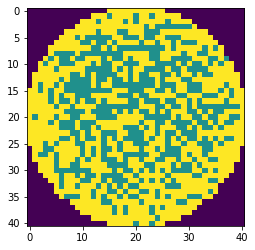

wafer_id:135, ウエハサイズ:41x41, スタンプサイズ:2x3, oDefects:398, nDefects:723, p=55.048


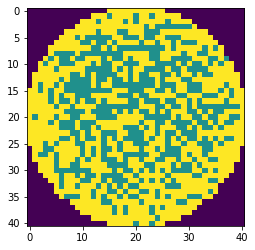

wafer_id:135, ウエハサイズ:41x41, スタンプサイズ:3x3, oDefects:386, nDefects:707, p=54.597


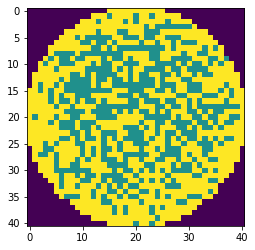

wafer_id:135, ウエハサイズ:41x41, スタンプサイズ:4x3, oDefects:398, nDefects:723, p=55.048


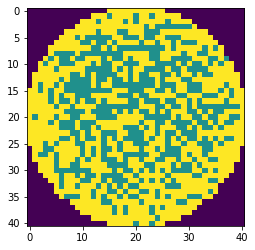

wafer_id:135, ウエハサイズ:41x41, スタンプサイズ:2x4, oDefects:365, nDefects:723, p=50.484


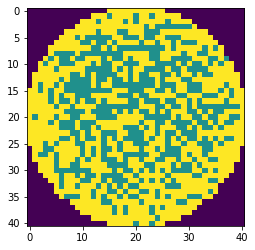

wafer_id:135, ウエハサイズ:41x41, スタンプサイズ:3x4, oDefects:354, nDefects:707, p=50.071


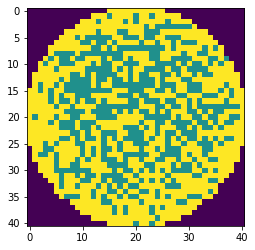

wafer_id:135, ウエハサイズ:41x41, スタンプサイズ:4x4, oDefects:365, nDefects:723, p=50.484


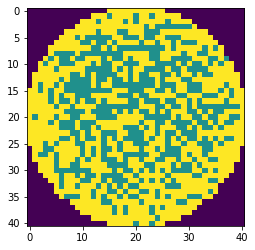

wafer_id:136, ウエハサイズ:41x41, スタンプサイズ:2x2, oDefects:415, nDefects:733, p=56.617


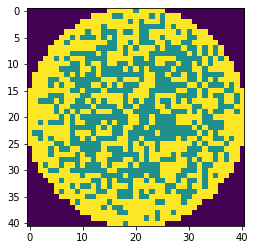

wafer_id:136, ウエハサイズ:41x41, スタンプサイズ:3x2, oDefects:403, nDefects:718, p=56.128


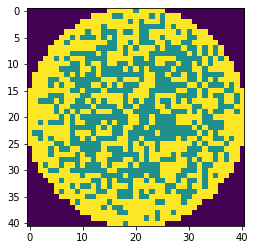

wafer_id:136, ウエハサイズ:41x41, スタンプサイズ:4x2, oDefects:415, nDefects:733, p=56.617


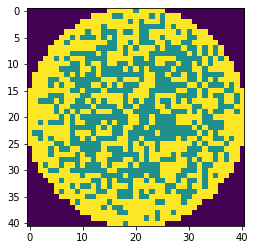

wafer_id:136, ウエハサイズ:41x41, スタンプサイズ:2x3, oDefects:362, nDefects:700, p=51.714


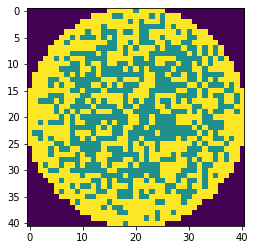

wafer_id:136, ウエハサイズ:41x41, スタンプサイズ:3x3, oDefects:352, nDefects:685, p=51.387


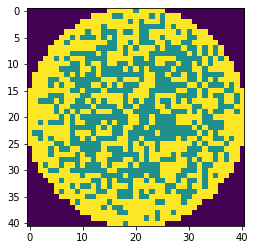

wafer_id:136, ウエハサイズ:41x41, スタンプサイズ:4x3, oDefects:362, nDefects:700, p=51.714


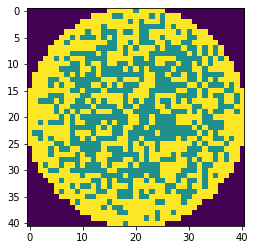

wafer_id:137, ウエハサイズ:41x41, スタンプサイズ:2x4, oDefects:447, nDefects:774, p=57.752


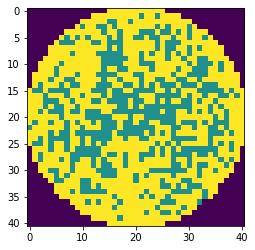

wafer_id:137, ウエハサイズ:41x41, スタンプサイズ:3x4, oDefects:436, nDefects:758, p=57.520


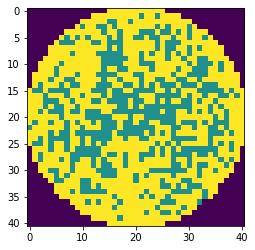

wafer_id:137, ウエハサイズ:41x41, スタンプサイズ:4x4, oDefects:447, nDefects:774, p=57.752


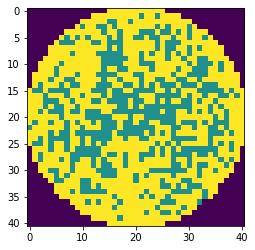

wafer_id:138, ウエハサイズ:41x41, スタンプサイズ:2x2, oDefects:482, nDefects:809, p=59.580


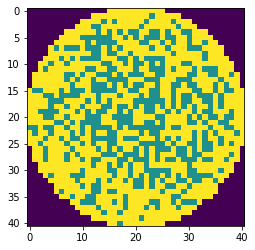

wafer_id:138, ウエハサイズ:41x41, スタンプサイズ:3x2, oDefects:469, nDefects:793, p=59.142


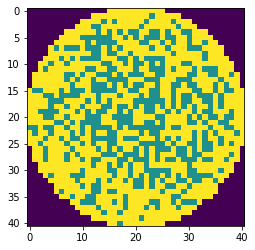

wafer_id:138, ウエハサイズ:41x41, スタンプサイズ:4x2, oDefects:482, nDefects:809, p=59.580


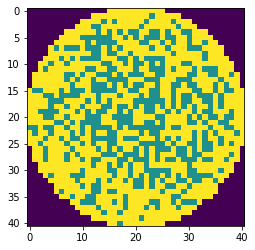

wafer_id:138, ウエハサイズ:41x41, スタンプサイズ:2x3, oDefects:453, nDefects:774, p=58.527


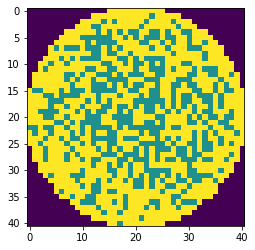

wafer_id:138, ウエハサイズ:41x41, スタンプサイズ:3x3, oDefects:441, nDefects:758, p=58.179


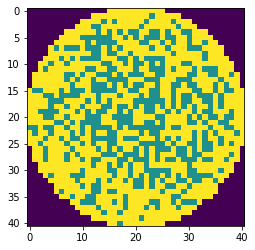

wafer_id:138, ウエハサイズ:41x41, スタンプサイズ:4x3, oDefects:453, nDefects:774, p=58.527


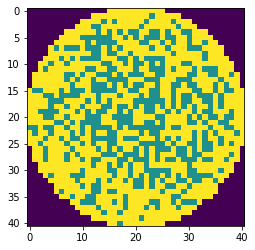

wafer_id:138, ウエハサイズ:41x41, スタンプサイズ:2x4, oDefects:445, nDefects:774, p=57.494


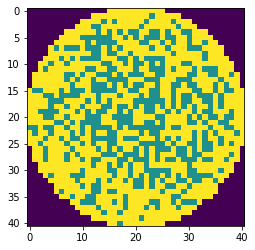

wafer_id:138, ウエハサイズ:41x41, スタンプサイズ:3x4, oDefects:434, nDefects:758, p=57.256


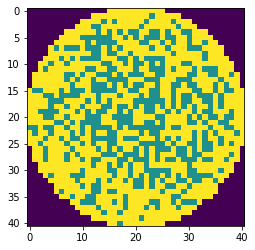

wafer_id:138, ウエハサイズ:41x41, スタンプサイズ:4x4, oDefects:445, nDefects:774, p=57.494


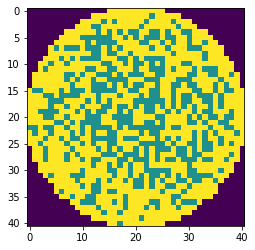

wafer_id:139, ウエハサイズ:41x41, スタンプサイズ:3x4, oDefects:453, nDefects:757, p=59.841


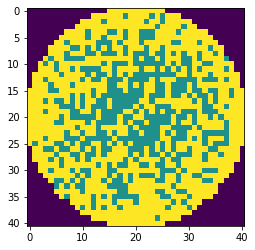

wafer_id:140, ウエハサイズ:41x41, スタンプサイズ:2x2, oDefects:436, nDefects:764, p=57.068


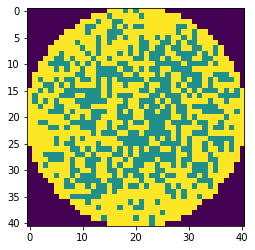

wafer_id:140, ウエハサイズ:41x41, スタンプサイズ:3x2, oDefects:427, nDefects:750, p=56.933


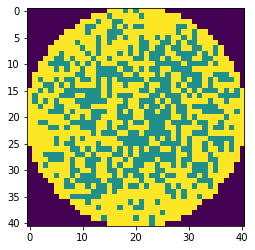

wafer_id:140, ウエハサイズ:41x41, スタンプサイズ:4x2, oDefects:436, nDefects:764, p=57.068


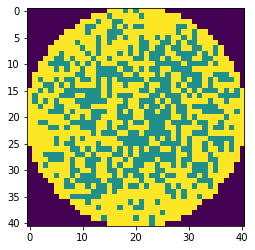

wafer_id:140, ウエハサイズ:41x41, スタンプサイズ:2x3, oDefects:413, nDefects:731, p=56.498


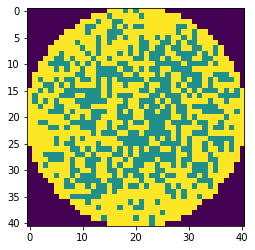

wafer_id:140, ウエハサイズ:41x41, スタンプサイズ:3x3, oDefects:403, nDefects:717, p=56.206


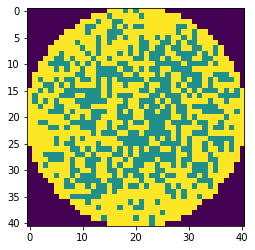

wafer_id:140, ウエハサイズ:41x41, スタンプサイズ:4x3, oDefects:413, nDefects:731, p=56.498


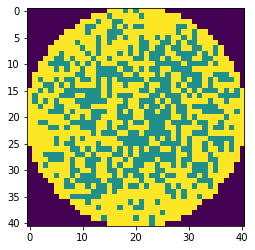

wafer_id:140, ウエハサイズ:41x41, スタンプサイズ:2x4, oDefects:386, nDefects:731, p=52.804


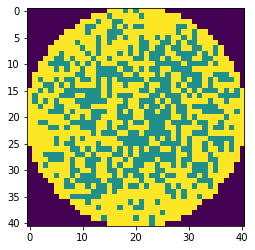

wafer_id:140, ウエハサイズ:41x41, スタンプサイズ:3x4, oDefects:378, nDefects:717, p=52.720


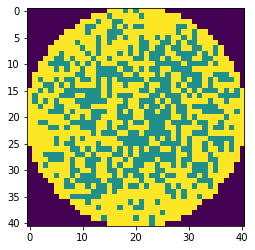

wafer_id:140, ウエハサイズ:41x41, スタンプサイズ:4x4, oDefects:386, nDefects:731, p=52.804


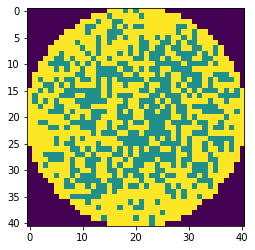

wafer_id:141, ウエハサイズ:41x41, スタンプサイズ:2x2, oDefects:404, nDefects:717, p=56.346


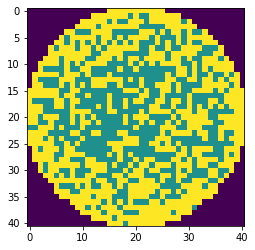

wafer_id:141, ウエハサイズ:41x41, スタンプサイズ:3x2, oDefects:391, nDefects:701, p=55.777


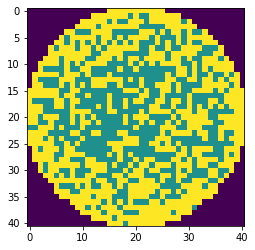

wafer_id:141, ウエハサイズ:41x41, スタンプサイズ:4x2, oDefects:404, nDefects:717, p=56.346


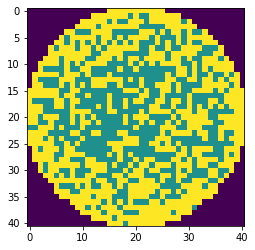

wafer_id:141, ウエハサイズ:41x41, スタンプサイズ:2x3, oDefects:351, nDefects:688, p=51.017


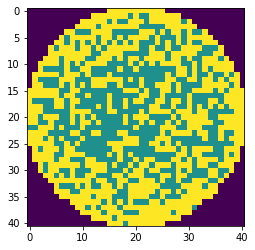

wafer_id:141, ウエハサイズ:41x41, スタンプサイズ:3x3, oDefects:339, nDefects:672, p=50.446


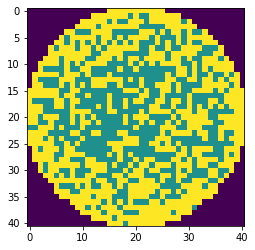

wafer_id:141, ウエハサイズ:41x41, スタンプサイズ:4x3, oDefects:351, nDefects:688, p=51.017


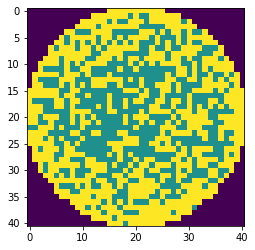

wafer_id:141, ウエハサイズ:41x41, スタンプサイズ:2x4, oDefects:344, nDefects:688, p=50.000


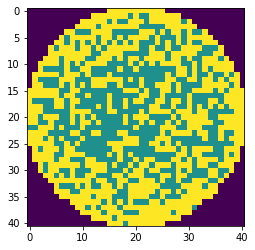

wafer_id:141, ウエハサイズ:41x41, スタンプサイズ:4x4, oDefects:344, nDefects:688, p=50.000


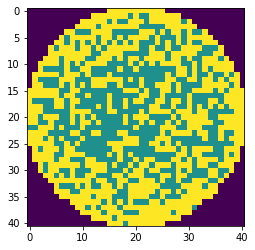

wafer_id:142, ウエハサイズ:41x41, スタンプサイズ:2x2, oDefects:409, nDefects:728, p=56.181


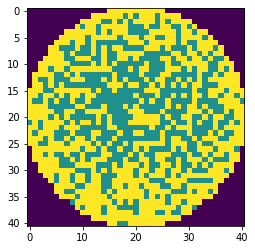

wafer_id:142, ウエハサイズ:41x41, スタンプサイズ:3x2, oDefects:394, nDefects:711, p=55.415


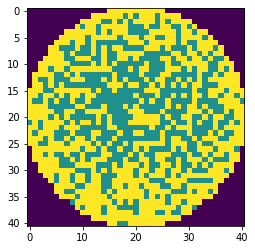

wafer_id:142, ウエハサイズ:41x41, スタンプサイズ:4x2, oDefects:409, nDefects:728, p=56.181


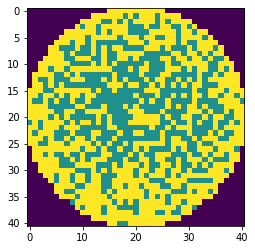

wafer_id:142, ウエハサイズ:41x41, スタンプサイズ:2x3, oDefects:378, nDefects:697, p=54.232


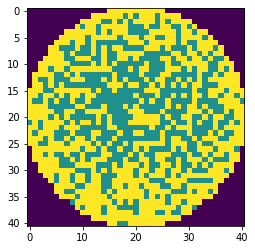

wafer_id:142, ウエハサイズ:41x41, スタンプサイズ:3x3, oDefects:364, nDefects:680, p=53.529


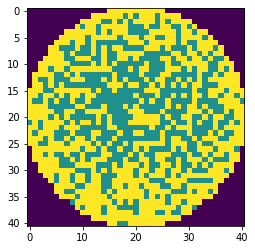

wafer_id:142, ウエハサイズ:41x41, スタンプサイズ:4x3, oDefects:378, nDefects:697, p=54.232


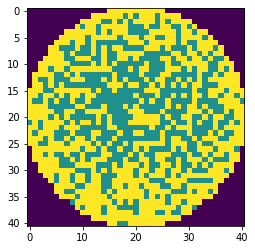

wafer_id:143, ウエハサイズ:41x41, スタンプサイズ:2x2, oDefects:403, nDefects:728, p=55.357


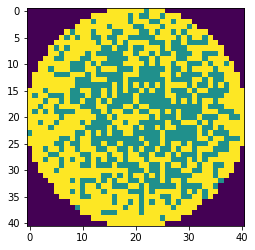

wafer_id:143, ウエハサイズ:41x41, スタンプサイズ:3x2, oDefects:390, nDefects:712, p=54.775


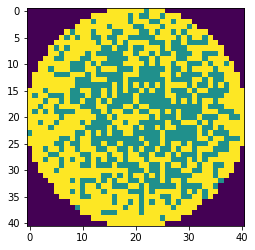

wafer_id:143, ウエハサイズ:41x41, スタンプサイズ:4x2, oDefects:403, nDefects:728, p=55.357


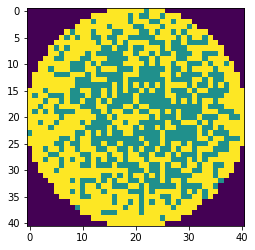

wafer_id:143, ウエハサイズ:41x41, スタンプサイズ:2x3, oDefects:382, nDefects:699, p=54.649


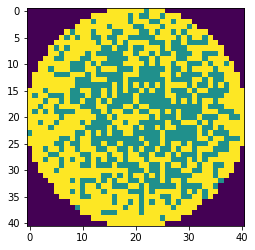

wafer_id:143, ウエハサイズ:41x41, スタンプサイズ:3x3, oDefects:370, nDefects:683, p=54.173


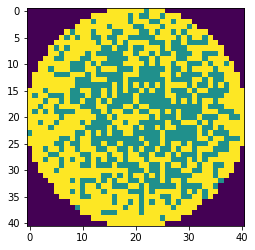

wafer_id:143, ウエハサイズ:41x41, スタンプサイズ:4x3, oDefects:382, nDefects:699, p=54.649


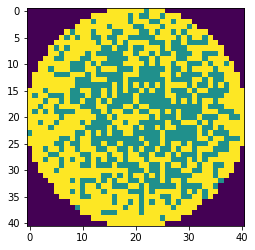

wafer_id:143, ウエハサイズ:41x41, スタンプサイズ:2x4, oDefects:361, nDefects:699, p=51.645


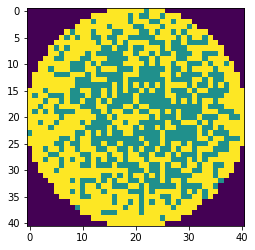

wafer_id:143, ウエハサイズ:41x41, スタンプサイズ:3x4, oDefects:349, nDefects:683, p=51.098


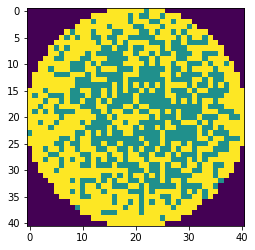

wafer_id:143, ウエハサイズ:41x41, スタンプサイズ:4x4, oDefects:361, nDefects:699, p=51.645


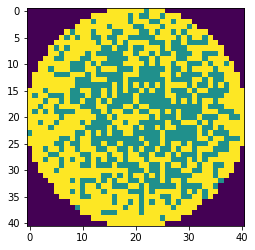

wafer_id:144, ウエハサイズ:41x41, スタンプサイズ:2x4, oDefects:454, nDefects:782, p=58.056


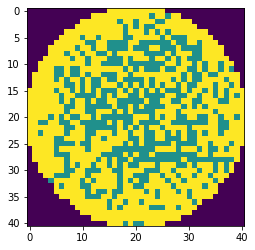

wafer_id:144, ウエハサイズ:41x41, スタンプサイズ:3x4, oDefects:441, nDefects:765, p=57.647


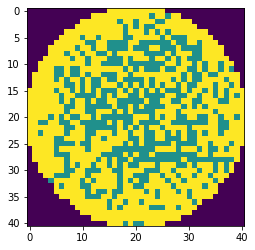

wafer_id:144, ウエハサイズ:41x41, スタンプサイズ:4x4, oDefects:454, nDefects:782, p=58.056


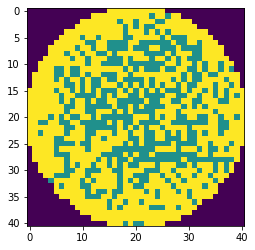

wafer_id:145, ウエハサイズ:41x41, スタンプサイズ:3x4, oDefects:468, nDefects:781, p=59.923


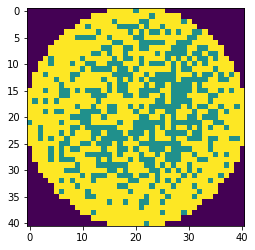

wafer_id:146, ウエハサイズ:41x41, スタンプサイズ:2x3, oDefects:466, nDefects:786, p=59.288


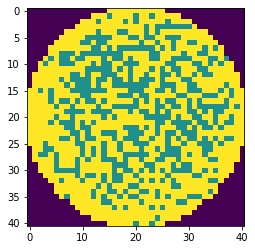

wafer_id:146, ウエハサイズ:41x41, スタンプサイズ:3x3, oDefects:454, nDefects:770, p=58.961


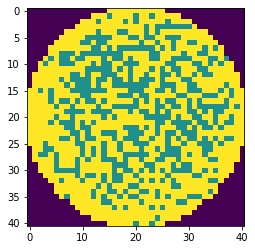

wafer_id:146, ウエハサイズ:41x41, スタンプサイズ:4x3, oDefects:466, nDefects:786, p=59.288


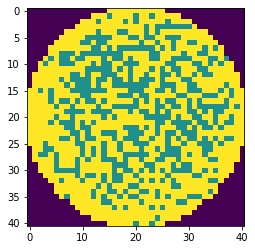

wafer_id:146, ウエハサイズ:41x41, スタンプサイズ:2x4, oDefects:442, nDefects:786, p=56.234


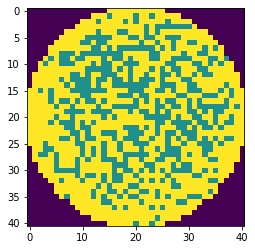

wafer_id:146, ウエハサイズ:41x41, スタンプサイズ:3x4, oDefects:431, nDefects:770, p=55.974


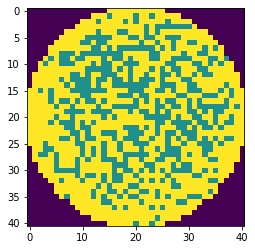

wafer_id:146, ウエハサイズ:41x41, スタンプサイズ:4x4, oDefects:442, nDefects:786, p=56.234


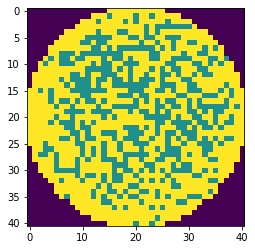

wafer_id:147, ウエハサイズ:41x41, スタンプサイズ:2x4, oDefects:446, nDefects:783, p=56.960


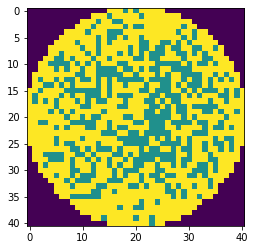

wafer_id:147, ウエハサイズ:41x41, スタンプサイズ:3x4, oDefects:438, nDefects:769, p=56.957


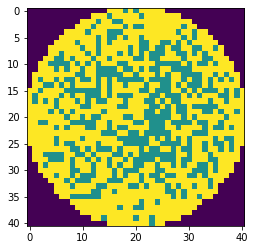

wafer_id:147, ウエハサイズ:41x41, スタンプサイズ:4x4, oDefects:446, nDefects:783, p=56.960


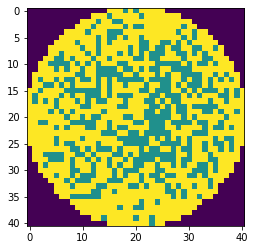

wafer_id:148, ウエハサイズ:41x41, スタンプサイズ:2x2, oDefects:459, nDefects:780, p=58.846


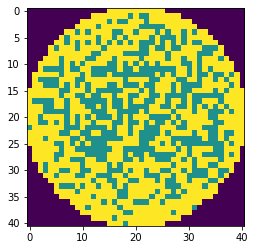

wafer_id:148, ウエハサイズ:41x41, スタンプサイズ:3x2, oDefects:446, nDefects:764, p=58.377


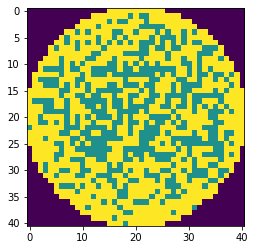

wafer_id:148, ウエハサイズ:41x41, スタンプサイズ:4x2, oDefects:459, nDefects:780, p=58.846


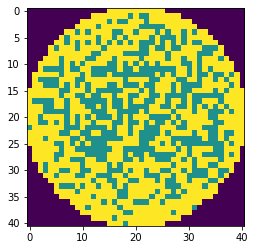

wafer_id:148, ウエハサイズ:41x41, スタンプサイズ:2x3, oDefects:417, nDefects:749, p=55.674


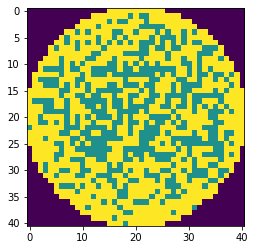

wafer_id:148, ウエハサイズ:41x41, スタンプサイズ:3x3, oDefects:405, nDefects:733, p=55.252


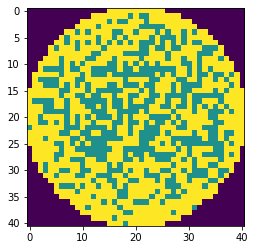

wafer_id:148, ウエハサイズ:41x41, スタンプサイズ:4x3, oDefects:417, nDefects:749, p=55.674


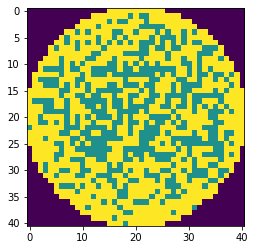

wafer_id:148, ウエハサイズ:41x41, スタンプサイズ:2x4, oDefects:417, nDefects:749, p=55.674


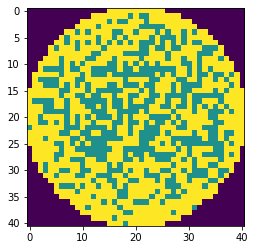

wafer_id:148, ウエハサイズ:41x41, スタンプサイズ:3x4, oDefects:406, nDefects:733, p=55.389


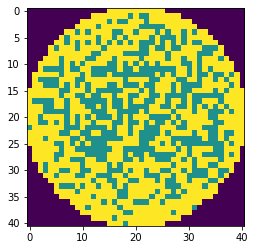

wafer_id:148, ウエハサイズ:41x41, スタンプサイズ:4x4, oDefects:417, nDefects:749, p=55.674


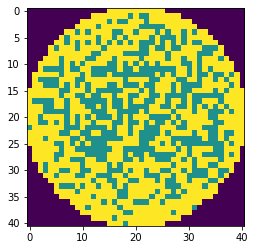

wafer_id:149, ウエハサイズ:33x29, スタンプサイズ:2x2, oDefects:203, nDefects:368, p=55.163


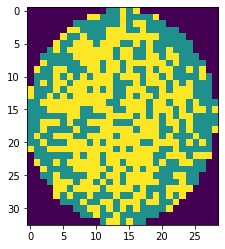

wafer_id:149, ウエハサイズ:33x29, スタンプサイズ:3x2, oDefects:204, nDefects:371, p=54.987


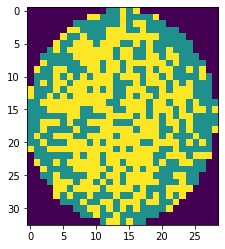

wafer_id:149, ウエハサイズ:33x29, スタンプサイズ:4x2, oDefects:203, nDefects:368, p=55.163


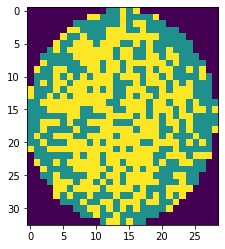

wafer_id:149, ウエハサイズ:33x29, スタンプサイズ:2x3, oDefects:196, nDefects:354, p=55.367


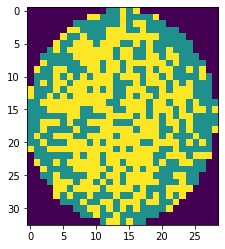

wafer_id:149, ウエハサイズ:33x29, スタンプサイズ:3x3, oDefects:197, nDefects:357, p=55.182


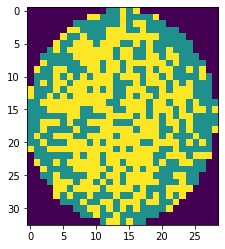

wafer_id:149, ウエハサイズ:33x29, スタンプサイズ:4x3, oDefects:196, nDefects:354, p=55.367


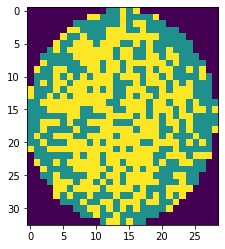

wafer_id:149, ウエハサイズ:33x29, スタンプサイズ:2x4, oDefects:186, nDefects:354, p=52.542


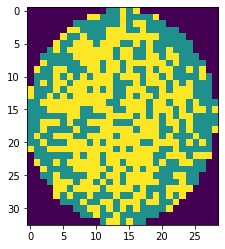

wafer_id:149, ウエハサイズ:33x29, スタンプサイズ:3x4, oDefects:186, nDefects:357, p=52.101


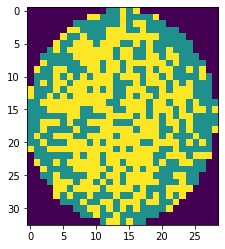

wafer_id:149, ウエハサイズ:33x29, スタンプサイズ:4x4, oDefects:186, nDefects:354, p=52.542


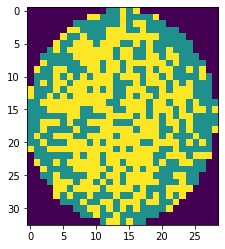

wafer_id:150, ウエハサイズ:33x29, スタンプサイズ:2x2, oDefects:215, nDefects:378, p=56.878


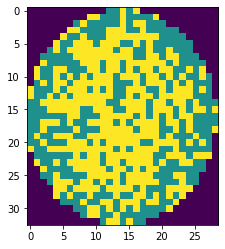

wafer_id:150, ウエハサイズ:33x29, スタンプサイズ:3x2, oDefects:216, nDefects:381, p=56.693


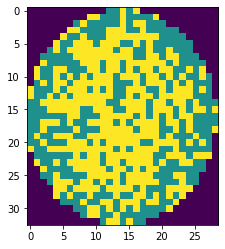

wafer_id:150, ウエハサイズ:33x29, スタンプサイズ:4x2, oDefects:215, nDefects:378, p=56.878


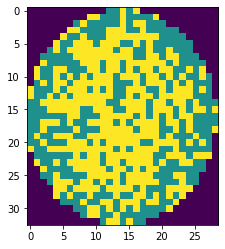

wafer_id:150, ウエハサイズ:33x29, スタンプサイズ:2x3, oDefects:206, nDefects:364, p=56.593


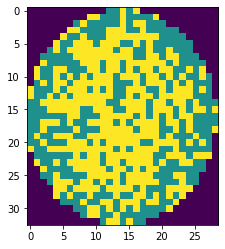

wafer_id:150, ウエハサイズ:33x29, スタンプサイズ:3x3, oDefects:207, nDefects:367, p=56.403


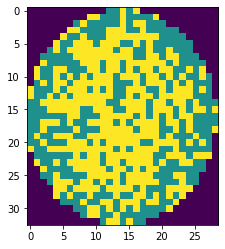

wafer_id:150, ウエハサイズ:33x29, スタンプサイズ:4x3, oDefects:206, nDefects:364, p=56.593


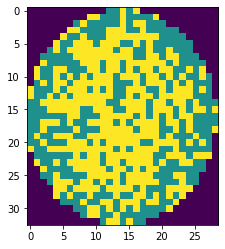

wafer_id:150, ウエハサイズ:33x29, スタンプサイズ:2x4, oDefects:199, nDefects:364, p=54.670


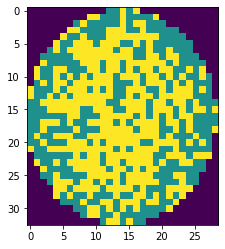

wafer_id:150, ウエハサイズ:33x29, スタンプサイズ:3x4, oDefects:199, nDefects:367, p=54.223


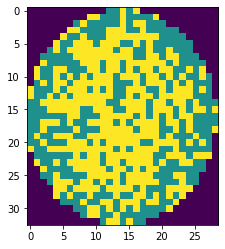

wafer_id:150, ウエハサイズ:33x29, スタンプサイズ:4x4, oDefects:199, nDefects:364, p=54.670


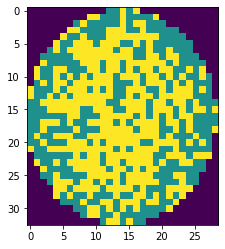

wafer_id:151, ウエハサイズ:38x36, スタンプサイズ:2x2, oDefects:366, nDefects:645, p=56.744


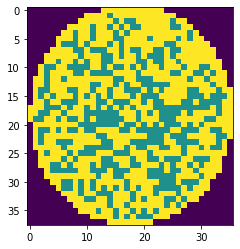

wafer_id:151, ウエハサイズ:38x36, スタンプサイズ:3x2, oDefects:355, nDefects:628, p=56.529


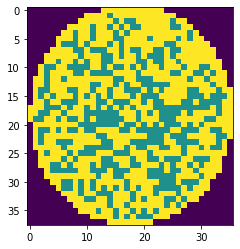

wafer_id:151, ウエハサイズ:38x36, スタンプサイズ:4x2, oDefects:355, nDefects:628, p=56.529


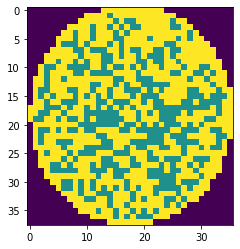

wafer_id:151, ウエハサイズ:38x36, スタンプサイズ:2x3, oDefects:347, nDefects:634, p=54.732


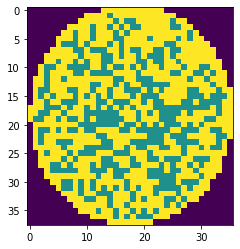

wafer_id:151, ウエハサイズ:38x36, スタンプサイズ:3x3, oDefects:340, nDefects:617, p=55.105


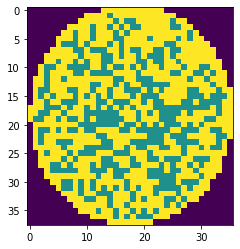

wafer_id:151, ウエハサイズ:38x36, スタンプサイズ:4x3, oDefects:340, nDefects:617, p=55.105


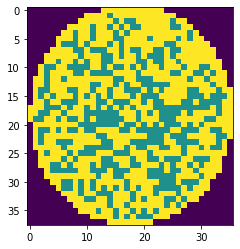

wafer_id:151, ウエハサイズ:38x36, スタンプサイズ:2x4, oDefects:347, nDefects:618, p=56.149


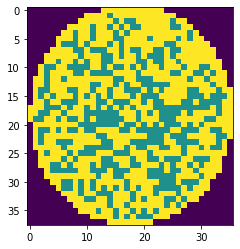

wafer_id:151, ウエハサイズ:38x36, スタンプサイズ:3x4, oDefects:340, nDefects:601, p=56.572


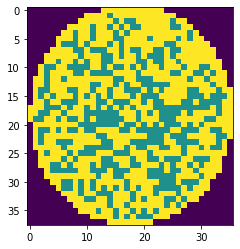

wafer_id:151, ウエハサイズ:38x36, スタンプサイズ:4x4, oDefects:340, nDefects:601, p=56.572


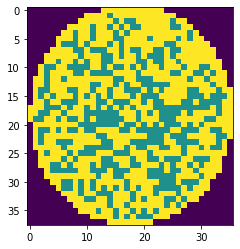

wafer_id:152, ウエハサイズ:29x30, スタンプサイズ:2x2, oDefects:158, nDefects:310, p=50.968


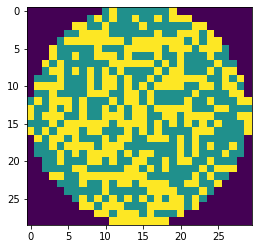

wafer_id:152, ウエハサイズ:29x30, スタンプサイズ:3x2, oDefects:155, nDefects:303, p=51.155


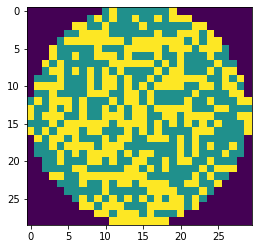

wafer_id:152, ウエハサイズ:29x30, スタンプサイズ:4x2, oDefects:158, nDefects:310, p=50.968


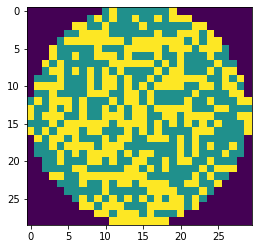

wafer_id:163, ウエハサイズ:32x29, スタンプサイズ:2x2, oDefects:234, nDefects:408, p=57.353


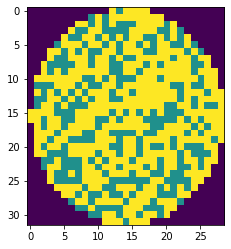

wafer_id:163, ウエハサイズ:32x29, スタンプサイズ:3x2, oDefects:228, nDefects:395, p=57.722


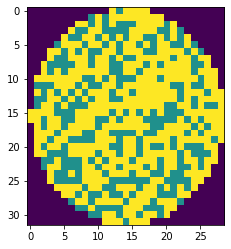

wafer_id:163, ウエハサイズ:32x29, スタンプサイズ:4x2, oDefects:234, nDefects:408, p=57.353


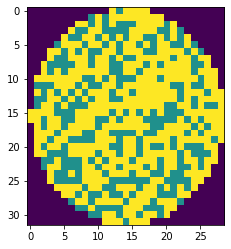

wafer_id:163, ウエハサイズ:32x29, スタンプサイズ:2x3, oDefects:223, nDefects:386, p=57.772


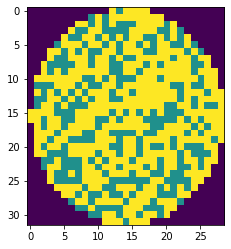

wafer_id:163, ウエハサイズ:32x29, スタンプサイズ:3x3, oDefects:216, nDefects:373, p=57.909


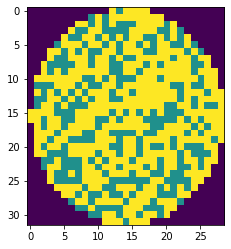

wafer_id:163, ウエハサイズ:32x29, スタンプサイズ:4x3, oDefects:223, nDefects:386, p=57.772


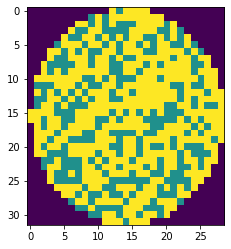

wafer_id:163, ウエハサイズ:32x29, スタンプサイズ:2x4, oDefects:220, nDefects:386, p=56.995


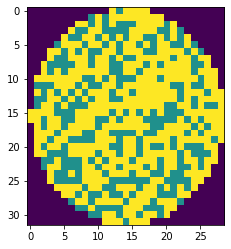

wafer_id:163, ウエハサイズ:32x29, スタンプサイズ:3x4, oDefects:215, nDefects:373, p=57.641


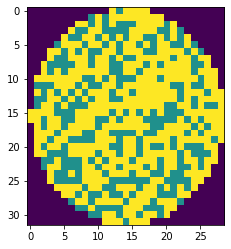

wafer_id:163, ウエハサイズ:32x29, スタンプサイズ:4x4, oDefects:220, nDefects:386, p=56.995


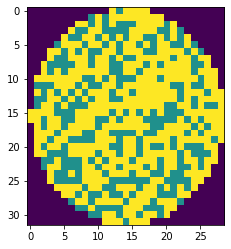

wafer_id:164, ウエハサイズ:34x35, スタンプサイズ:2x4, oDefects:277, nDefects:469, p=59.062


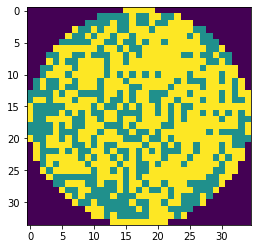

wafer_id:164, ウエハサイズ:34x35, スタンプサイズ:3x4, oDefects:272, nDefects:460, p=59.130


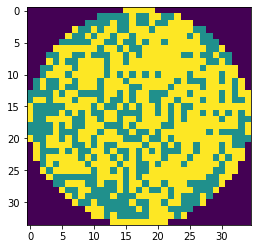

wafer_id:164, ウエハサイズ:34x35, スタンプサイズ:4x4, oDefects:271, nDefects:452, p=59.956


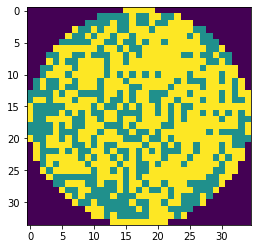

wafer_id:166, ウエハサイズ:26x26, スタンプサイズ:2x2, oDefects:151, nDefects:280, p=53.929


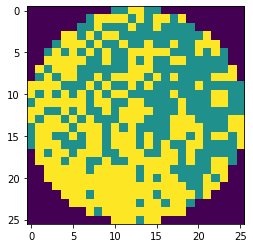

wafer_id:166, ウエハサイズ:26x26, スタンプサイズ:3x2, oDefects:140, nDefects:264, p=53.030


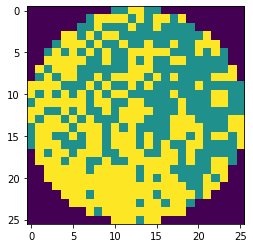

wafer_id:166, ウエハサイズ:26x26, スタンプサイズ:4x2, oDefects:140, nDefects:264, p=53.030


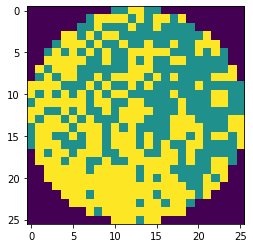

wafer_id:166, ウエハサイズ:26x26, スタンプサイズ:2x3, oDefects:134, nDefects:259, p=51.737


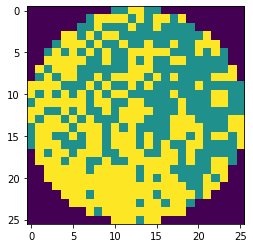

wafer_id:166, ウエハサイズ:26x26, スタンプサイズ:3x3, oDefects:124, nDefects:243, p=51.029


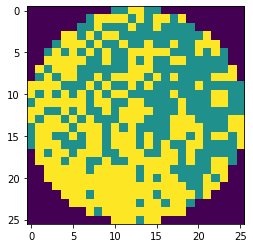

wafer_id:166, ウエハサイズ:26x26, スタンプサイズ:4x3, oDefects:124, nDefects:243, p=51.029


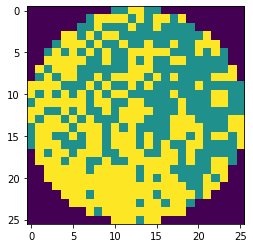

wafer_id:167, ウエハサイズ:26x26, スタンプサイズ:3x2, oDefects:131, nDefects:262, p=50.000


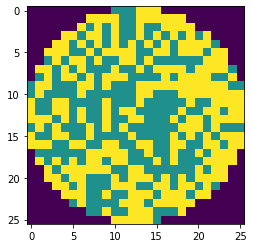

wafer_id:167, ウエハサイズ:26x26, スタンプサイズ:4x2, oDefects:131, nDefects:262, p=50.000


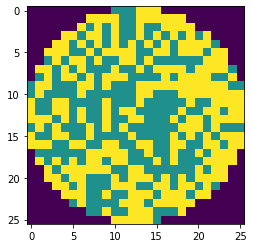

wafer_id:167, ウエハサイズ:26x26, スタンプサイズ:2x4, oDefects:111, nDefects:220, p=50.455


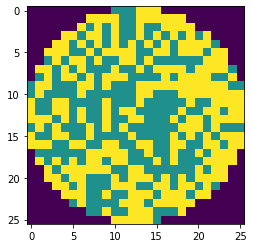

wafer_id:167, ウエハサイズ:26x26, スタンプサイズ:3x4, oDefects:108, nDefects:210, p=51.429


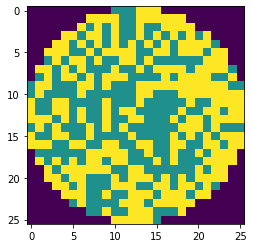

wafer_id:167, ウエハサイズ:26x26, スタンプサイズ:4x4, oDefects:108, nDefects:210, p=51.429


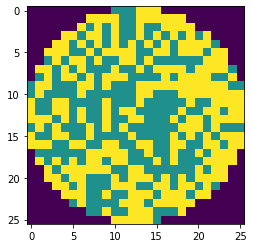

wafer_id:168, ウエハサイズ:26x26, スタンプサイズ:2x2, oDefects:144, nDefects:278, p=51.799


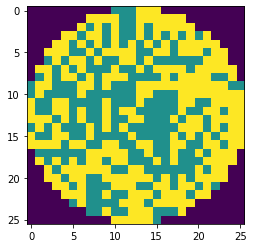

wafer_id:168, ウエハサイズ:26x26, スタンプサイズ:3x2, oDefects:140, nDefects:268, p=52.239


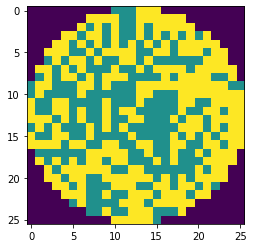

wafer_id:168, ウエハサイズ:26x26, スタンプサイズ:4x2, oDefects:140, nDefects:268, p=52.239


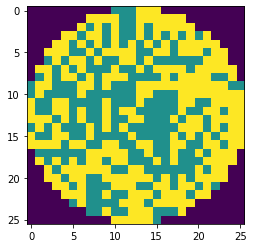

wafer_id:168, ウエハサイズ:26x26, スタンプサイズ:3x3, oDefects:115, nDefects:227, p=50.661


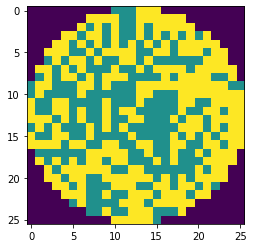

wafer_id:168, ウエハサイズ:26x26, スタンプサイズ:4x3, oDefects:115, nDefects:227, p=50.661


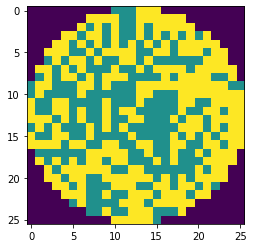

wafer_id:168, ウエハサイズ:26x26, スタンプサイズ:2x4, oDefects:116, nDefects:225, p=51.556


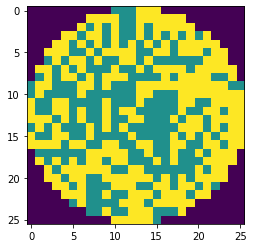

wafer_id:168, ウエハサイズ:26x26, スタンプサイズ:3x4, oDefects:113, nDefects:215, p=52.558


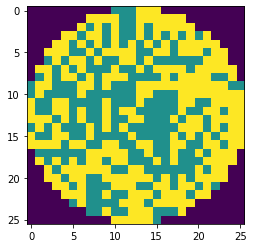

wafer_id:168, ウエハサイズ:26x26, スタンプサイズ:4x4, oDefects:113, nDefects:215, p=52.558


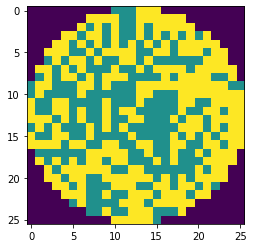

wafer_id:180, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:153, nDefects:267, p=57.303


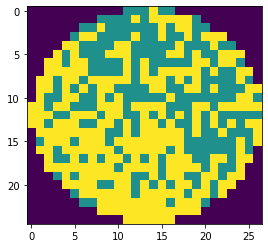

wafer_id:180, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:153, nDefects:267, p=57.303


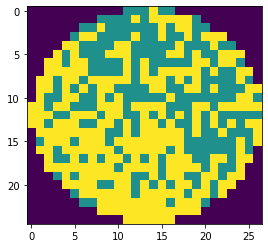

wafer_id:180, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:153, nDefects:267, p=57.303


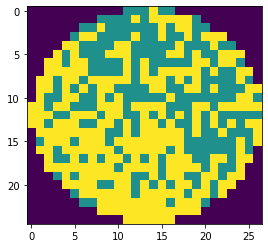

wafer_id:180, ウエハサイズ:25x27, スタンプサイズ:2x3, oDefects:147, nDefects:267, p=55.056


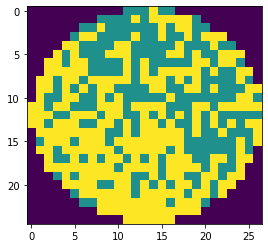

wafer_id:180, ウエハサイズ:25x27, スタンプサイズ:3x3, oDefects:147, nDefects:267, p=55.056


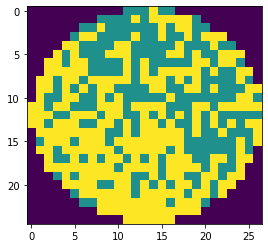

wafer_id:180, ウエハサイズ:25x27, スタンプサイズ:4x3, oDefects:147, nDefects:267, p=55.056


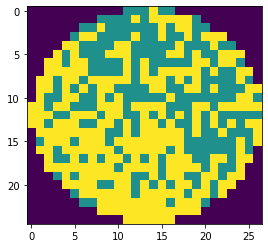

wafer_id:180, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:127, nDefects:238, p=53.361


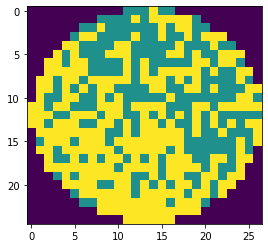

wafer_id:180, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:127, nDefects:238, p=53.361


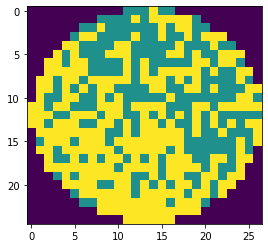

wafer_id:180, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:127, nDefects:238, p=53.361


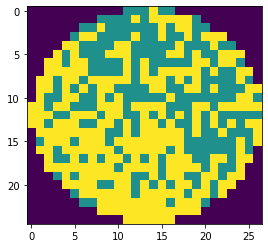

wafer_id:181, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:115, nDefects:230, p=50.000


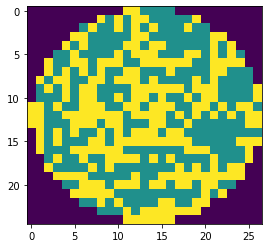

wafer_id:181, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:115, nDefects:230, p=50.000


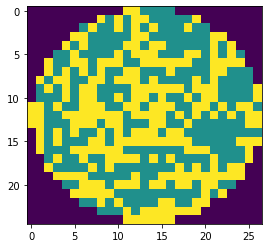

wafer_id:181, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:115, nDefects:230, p=50.000


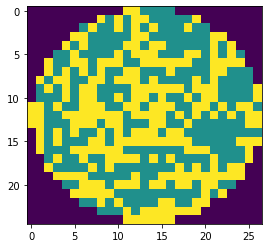

wafer_id:182, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:118, nDefects:234, p=50.427


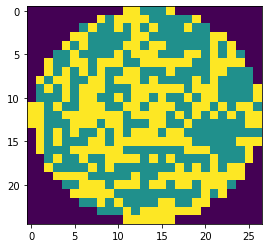

wafer_id:182, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:118, nDefects:234, p=50.427


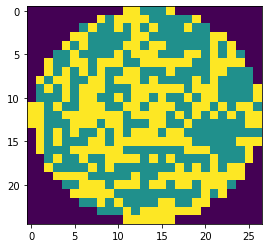

wafer_id:182, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:118, nDefects:234, p=50.427


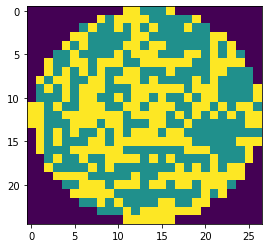

wafer_id:182, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:101, nDefects:200, p=50.500


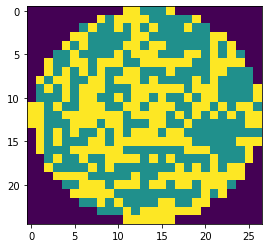

wafer_id:182, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:101, nDefects:200, p=50.500


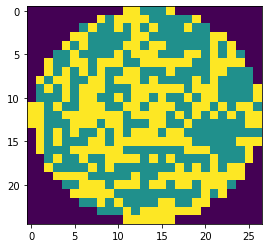

wafer_id:182, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:101, nDefects:200, p=50.500


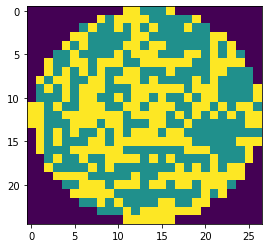

wafer_id:183, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:119, nDefects:235, p=50.638


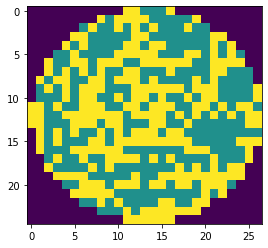

wafer_id:183, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:119, nDefects:235, p=50.638


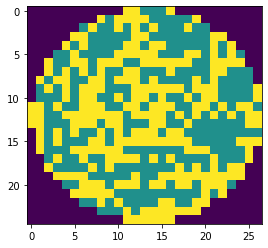

wafer_id:183, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:119, nDefects:235, p=50.638


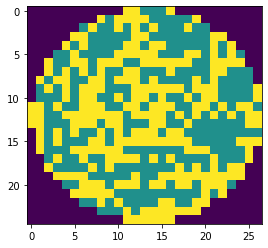

wafer_id:183, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:101, nDefects:201, p=50.249


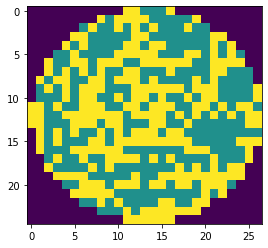

wafer_id:183, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:101, nDefects:201, p=50.249


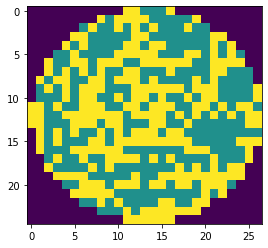

wafer_id:183, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:101, nDefects:201, p=50.249


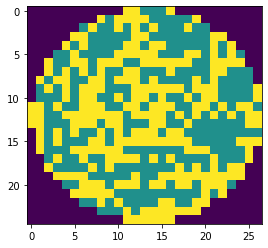

wafer_id:184, ウエハサイズ:35x36, スタンプサイズ:2x2, oDefects:255, nDefects:509, p=50.098


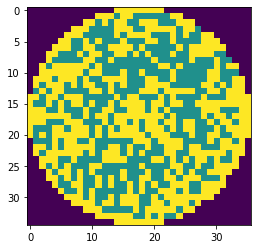

wafer_id:184, ウエハサイズ:35x36, スタンプサイズ:3x2, oDefects:250, nDefects:500, p=50.000


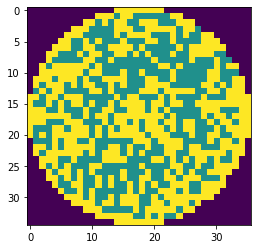

wafer_id:197, ウエハサイズ:35x36, スタンプサイズ:2x2, oDefects:323, nDefects:567, p=56.966


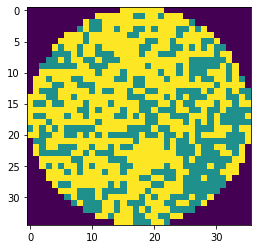

wafer_id:197, ウエハサイズ:35x36, スタンプサイズ:3x2, oDefects:321, nDefects:558, p=57.527


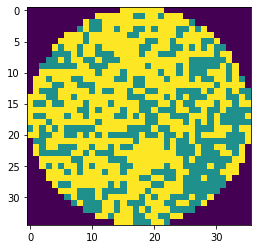

wafer_id:197, ウエハサイズ:35x36, スタンプサイズ:4x2, oDefects:317, nDefects:550, p=57.636


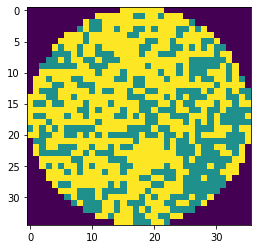

wafer_id:197, ウエハサイズ:35x36, スタンプサイズ:2x3, oDefects:321, nDefects:559, p=57.424


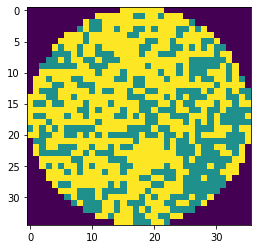

wafer_id:197, ウエハサイズ:35x36, スタンプサイズ:3x3, oDefects:317, nDefects:550, p=57.636


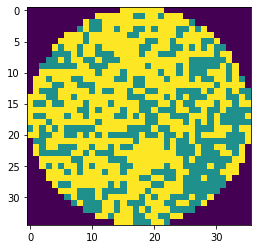

wafer_id:197, ウエハサイズ:35x36, スタンプサイズ:4x3, oDefects:313, nDefects:542, p=57.749


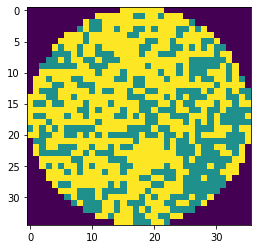

wafer_id:197, ウエハサイズ:35x36, スタンプサイズ:2x4, oDefects:317, nDefects:550, p=57.636


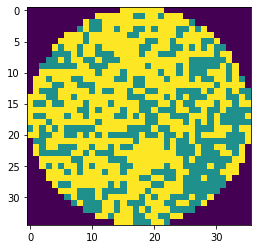

wafer_id:197, ウエハサイズ:35x36, スタンプサイズ:3x4, oDefects:311, nDefects:541, p=57.486


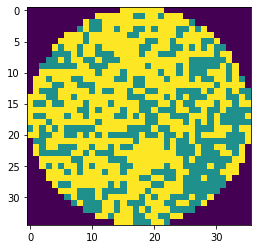

wafer_id:197, ウエハサイズ:35x36, スタンプサイズ:4x4, oDefects:308, nDefects:533, p=57.786


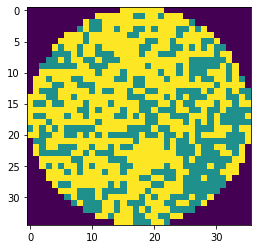

wafer_id:198, ウエハサイズ:26x26, スタンプサイズ:2x2, oDefects:156, nDefects:292, p=53.425


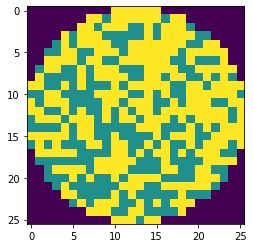

wafer_id:198, ウエハサイズ:26x26, スタンプサイズ:3x2, oDefects:153, nDefects:281, p=54.448


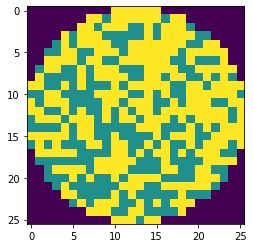

wafer_id:198, ウエハサイズ:26x26, スタンプサイズ:4x2, oDefects:153, nDefects:281, p=54.448


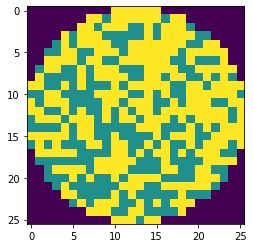

wafer_id:198, ウエハサイズ:26x26, スタンプサイズ:2x3, oDefects:129, nDefects:253, p=50.988


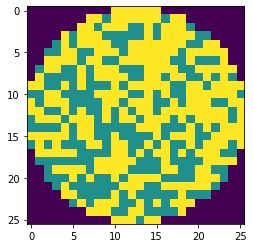

wafer_id:198, ウエハサイズ:26x26, スタンプサイズ:3x3, oDefects:126, nDefects:242, p=52.066


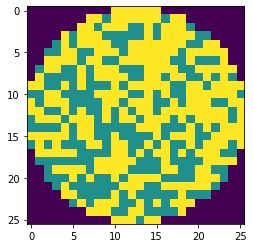

wafer_id:198, ウエハサイズ:26x26, スタンプサイズ:4x3, oDefects:126, nDefects:242, p=52.066


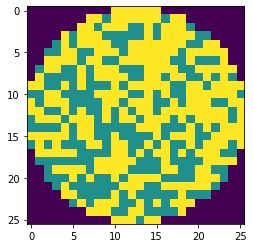

wafer_id:198, ウエハサイズ:26x26, スタンプサイズ:2x4, oDefects:121, nDefects:242, p=50.000


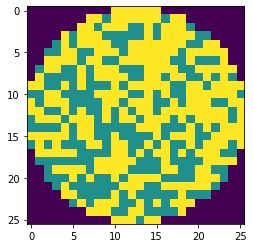

wafer_id:198, ウエハサイズ:26x26, スタンプサイズ:3x4, oDefects:117, nDefects:231, p=50.649


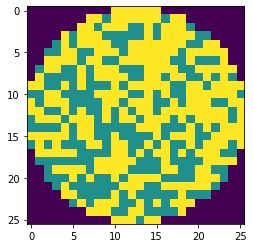

wafer_id:198, ウエハサイズ:26x26, スタンプサイズ:4x4, oDefects:117, nDefects:231, p=50.649


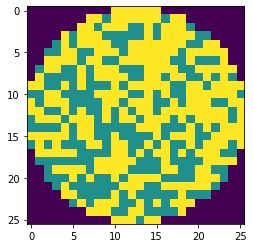

wafer_id:199, ウエハサイズ:26x26, スタンプサイズ:2x2, oDefects:170, nDefects:305, p=55.738


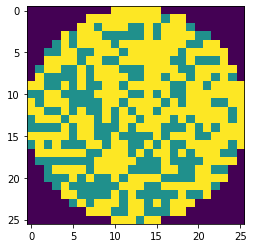

wafer_id:199, ウエハサイズ:26x26, スタンプサイズ:3x2, oDefects:167, nDefects:293, p=56.997


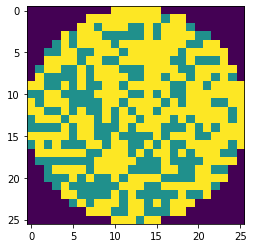

wafer_id:199, ウエハサイズ:26x26, スタンプサイズ:4x2, oDefects:167, nDefects:293, p=56.997


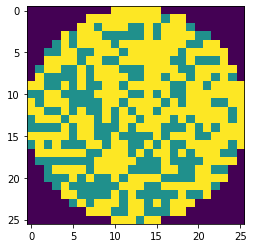

wafer_id:199, ウエハサイズ:26x26, スタンプサイズ:2x3, oDefects:145, nDefects:264, p=54.924


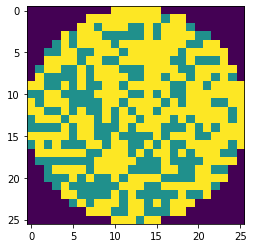

wafer_id:199, ウエハサイズ:26x26, スタンプサイズ:3x3, oDefects:142, nDefects:252, p=56.349


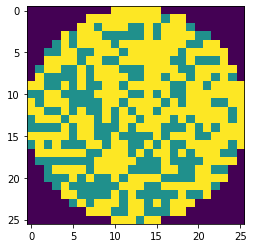

wafer_id:199, ウエハサイズ:26x26, スタンプサイズ:4x3, oDefects:142, nDefects:252, p=56.349


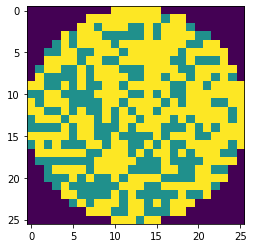

wafer_id:199, ウエハサイズ:26x26, スタンプサイズ:2x4, oDefects:135, nDefects:251, p=53.785


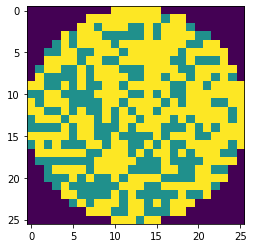

wafer_id:199, ウエハサイズ:26x26, スタンプサイズ:3x4, oDefects:130, nDefects:239, p=54.393


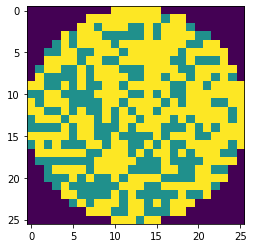

wafer_id:199, ウエハサイズ:26x26, スタンプサイズ:4x4, oDefects:130, nDefects:239, p=54.393


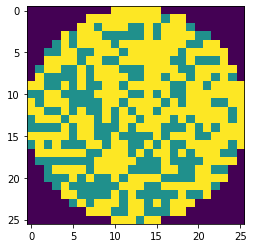

wafer_id:200, ウエハサイズ:26x26, スタンプサイズ:2x2, oDefects:174, nDefects:307, p=56.678


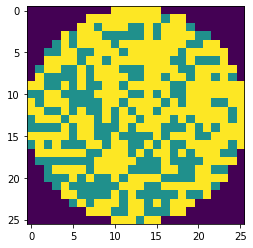

wafer_id:200, ウエハサイズ:26x26, スタンプサイズ:3x2, oDefects:171, nDefects:295, p=57.966


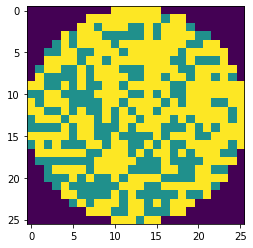

wafer_id:200, ウエハサイズ:26x26, スタンプサイズ:4x2, oDefects:171, nDefects:295, p=57.966


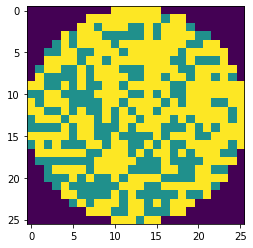

wafer_id:200, ウエハサイズ:26x26, スタンプサイズ:2x3, oDefects:147, nDefects:265, p=55.472


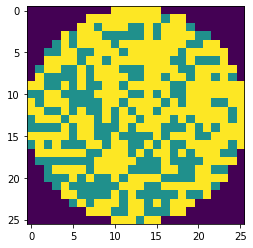

wafer_id:200, ウエハサイズ:26x26, スタンプサイズ:3x3, oDefects:144, nDefects:253, p=56.917


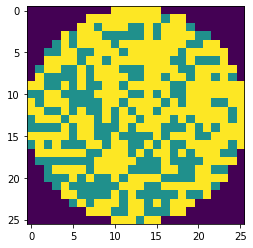

wafer_id:200, ウエハサイズ:26x26, スタンプサイズ:4x3, oDefects:144, nDefects:253, p=56.917


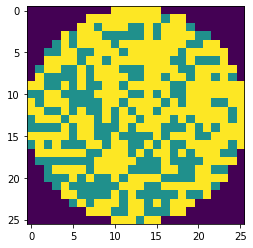

wafer_id:200, ウエハサイズ:26x26, スタンプサイズ:2x4, oDefects:136, nDefects:252, p=53.968


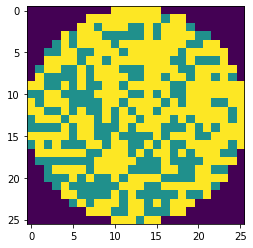

wafer_id:200, ウエハサイズ:26x26, スタンプサイズ:3x4, oDefects:131, nDefects:240, p=54.583


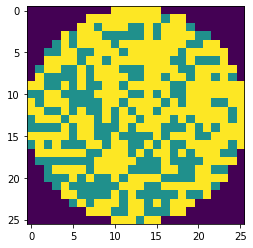

wafer_id:200, ウエハサイズ:26x26, スタンプサイズ:4x4, oDefects:131, nDefects:240, p=54.583


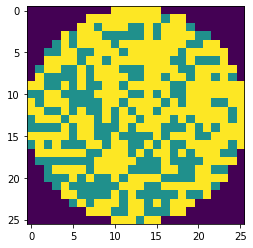

wafer_id:201, ウエハサイズ:36x36, スタンプサイズ:2x2, oDefects:275, nDefects:528, p=52.083


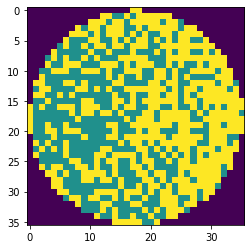

wafer_id:201, ウエハサイズ:36x36, スタンプサイズ:3x2, oDefects:275, nDefects:528, p=52.083


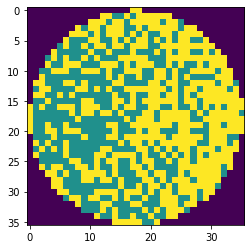

wafer_id:201, ウエハサイズ:36x36, スタンプサイズ:4x2, oDefects:275, nDefects:528, p=52.083


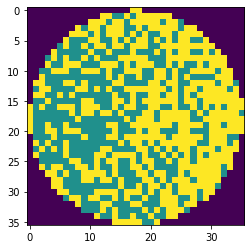

wafer_id:201, ウエハサイズ:36x36, スタンプサイズ:2x3, oDefects:279, nDefects:514, p=54.280


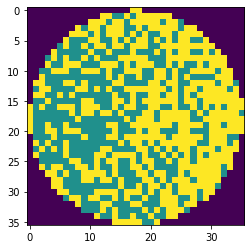

wafer_id:201, ウエハサイズ:36x36, スタンプサイズ:3x3, oDefects:279, nDefects:514, p=54.280


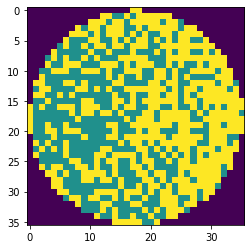

wafer_id:201, ウエハサイズ:36x36, スタンプサイズ:4x3, oDefects:279, nDefects:514, p=54.280


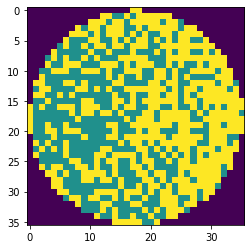

wafer_id:201, ウエハサイズ:36x36, スタンプサイズ:2x4, oDefects:250, nDefects:498, p=50.201


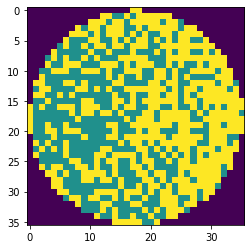

wafer_id:201, ウエハサイズ:36x36, スタンプサイズ:3x4, oDefects:250, nDefects:498, p=50.201


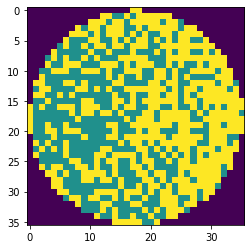

wafer_id:201, ウエハサイズ:36x36, スタンプサイズ:4x4, oDefects:250, nDefects:498, p=50.201


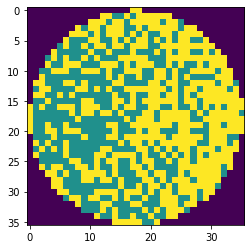

wafer_id:204, ウエハサイズ:37x40, スタンプサイズ:2x2, oDefects:369, nDefects:619, p=59.612


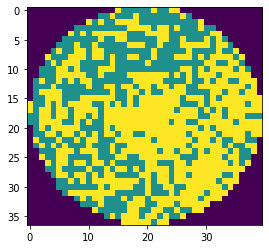

wafer_id:204, ウエハサイズ:37x40, スタンプサイズ:3x2, oDefects:369, nDefects:619, p=59.612


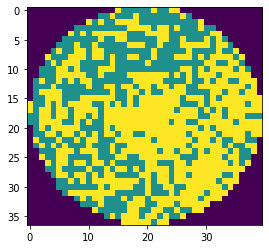

wafer_id:204, ウエハサイズ:37x40, スタンプサイズ:4x2, oDefects:369, nDefects:619, p=59.612


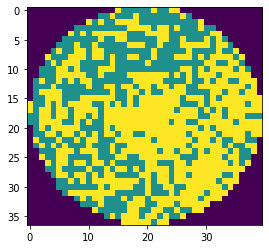

wafer_id:204, ウエハサイズ:37x40, スタンプサイズ:2x4, oDefects:338, nDefects:596, p=56.711


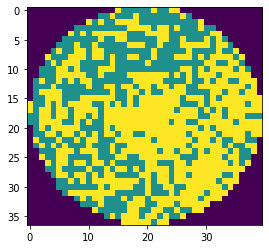

wafer_id:204, ウエハサイズ:37x40, スタンプサイズ:3x4, oDefects:338, nDefects:596, p=56.711


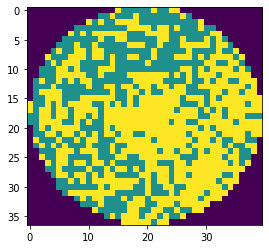

wafer_id:204, ウエハサイズ:37x40, スタンプサイズ:4x4, oDefects:338, nDefects:596, p=56.711


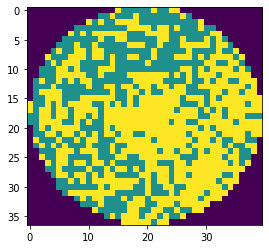

wafer_id:206, ウエハサイズ:32x29, スタンプサイズ:2x3, oDefects:218, nDefects:365, p=59.726


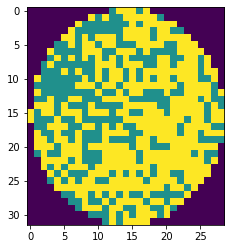

wafer_id:206, ウエハサイズ:32x29, スタンプサイズ:4x3, oDefects:218, nDefects:365, p=59.726


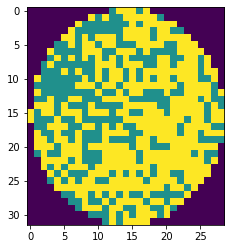

wafer_id:206, ウエハサイズ:32x29, スタンプサイズ:2x4, oDefects:216, nDefects:365, p=59.178


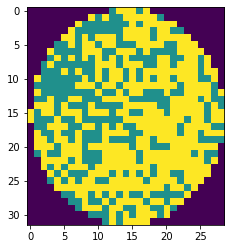

wafer_id:206, ウエハサイズ:32x29, スタンプサイズ:3x4, oDefects:212, nDefects:354, p=59.887


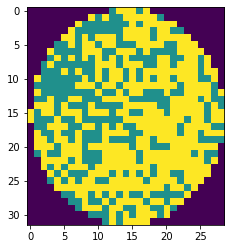

wafer_id:206, ウエハサイズ:32x29, スタンプサイズ:4x4, oDefects:216, nDefects:365, p=59.178


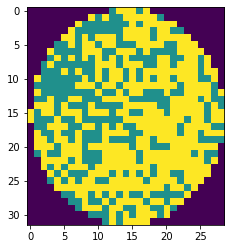

wafer_id:208, ウエハサイズ:41x41, スタンプサイズ:2x2, oDefects:353, nDefects:647, p=54.560


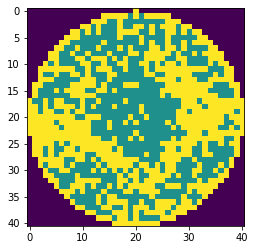

wafer_id:208, ウエハサイズ:41x41, スタンプサイズ:3x2, oDefects:349, nDefects:638, p=54.702


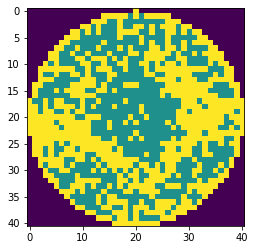

wafer_id:208, ウエハサイズ:41x41, スタンプサイズ:4x2, oDefects:353, nDefects:647, p=54.560


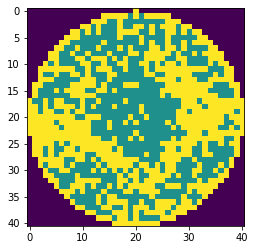

wafer_id:208, ウエハサイズ:41x41, スタンプサイズ:2x3, oDefects:323, nDefects:622, p=51.929


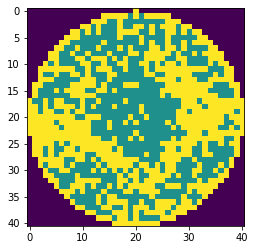

wafer_id:208, ウエハサイズ:41x41, スタンプサイズ:3x3, oDefects:320, nDefects:613, p=52.202


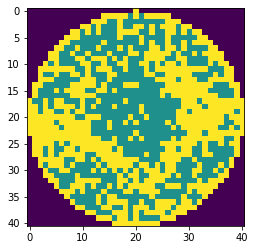

wafer_id:208, ウエハサイズ:41x41, スタンプサイズ:4x3, oDefects:323, nDefects:622, p=51.929


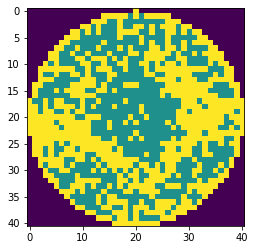

wafer_id:219, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:351, nDefects:647, p=54.250


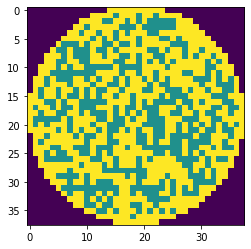

wafer_id:219, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:335, nDefects:626, p=53.514


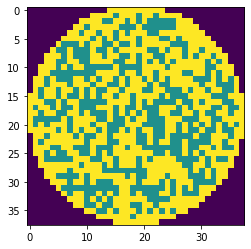

wafer_id:219, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:335, nDefects:626, p=53.514


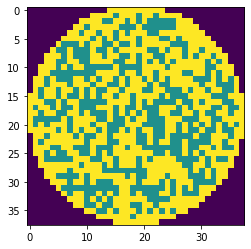

wafer_id:219, ウエハサイズ:38x38, スタンプサイズ:2x3, oDefects:328, nDefects:609, p=53.859


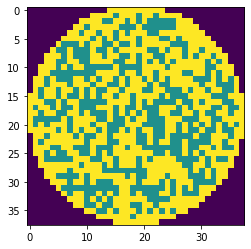

wafer_id:219, ウエハサイズ:38x38, スタンプサイズ:3x3, oDefects:314, nDefects:588, p=53.401


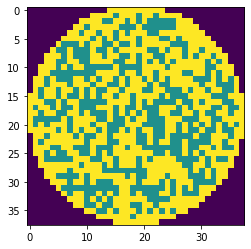

wafer_id:219, ウエハサイズ:38x38, スタンプサイズ:4x3, oDefects:314, nDefects:588, p=53.401


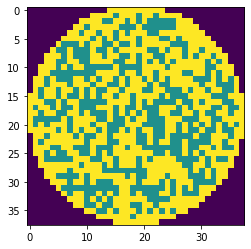

wafer_id:219, ウエハサイズ:38x38, スタンプサイズ:2x4, oDefects:309, nDefects:595, p=51.933


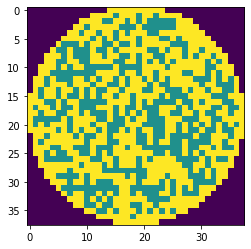

wafer_id:219, ウエハサイズ:38x38, スタンプサイズ:3x4, oDefects:297, nDefects:574, p=51.742


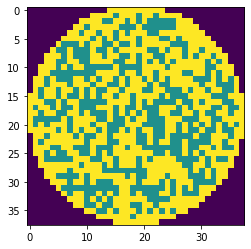

wafer_id:219, ウエハサイズ:38x38, スタンプサイズ:4x4, oDefects:297, nDefects:574, p=51.742


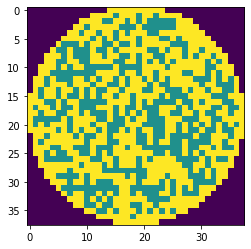

wafer_id:224, ウエハサイズ:26x26, スタンプサイズ:2x3, oDefects:141, nDefects:257, p=54.864


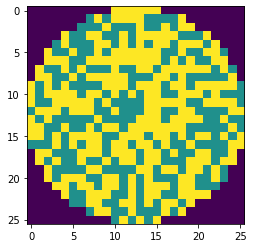

wafer_id:224, ウエハサイズ:26x26, スタンプサイズ:3x3, oDefects:140, nDefects:249, p=56.225


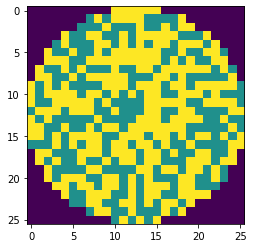

wafer_id:224, ウエハサイズ:26x26, スタンプサイズ:4x3, oDefects:140, nDefects:249, p=56.225


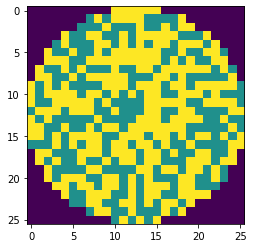

wafer_id:224, ウエハサイズ:26x26, スタンプサイズ:2x4, oDefects:124, nDefects:247, p=50.202


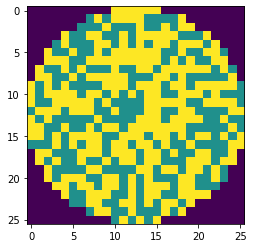

wafer_id:224, ウエハサイズ:26x26, スタンプサイズ:3x4, oDefects:121, nDefects:239, p=50.628


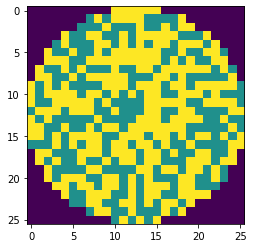

wafer_id:224, ウエハサイズ:26x26, スタンプサイズ:4x4, oDefects:121, nDefects:239, p=50.628


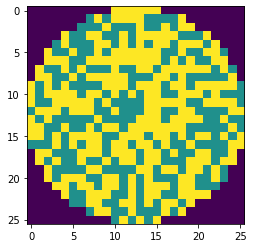

wafer_id:225, ウエハサイズ:26x26, スタンプサイズ:2x2, oDefects:147, nDefects:293, p=50.171


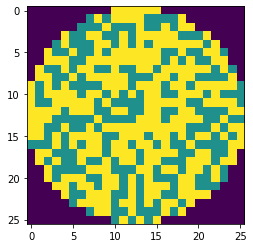

wafer_id:225, ウエハサイズ:26x26, スタンプサイズ:3x2, oDefects:144, nDefects:285, p=50.526


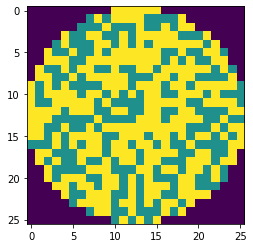

wafer_id:225, ウエハサイズ:26x26, スタンプサイズ:4x2, oDefects:144, nDefects:285, p=50.526


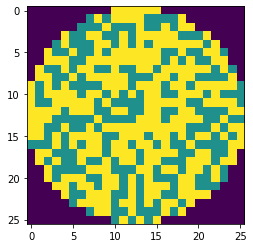

wafer_id:225, ウエハサイズ:26x26, スタンプサイズ:2x3, oDefects:150, nDefects:268, p=55.970


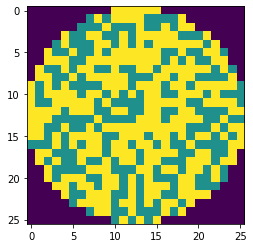

wafer_id:225, ウエハサイズ:26x26, スタンプサイズ:3x3, oDefects:149, nDefects:260, p=57.308


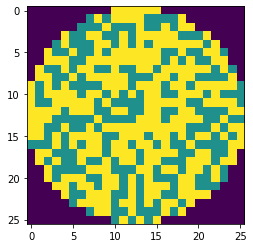

wafer_id:225, ウエハサイズ:26x26, スタンプサイズ:4x3, oDefects:149, nDefects:260, p=57.308


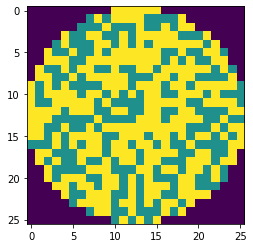

wafer_id:225, ウエハサイズ:26x26, スタンプサイズ:2x4, oDefects:134, nDefects:258, p=51.938


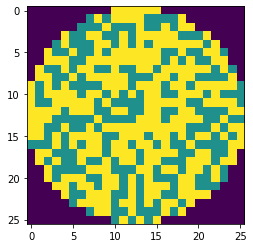

wafer_id:225, ウエハサイズ:26x26, スタンプサイズ:3x4, oDefects:131, nDefects:250, p=52.400


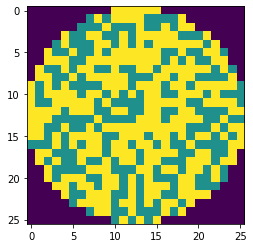

wafer_id:225, ウエハサイズ:26x26, スタンプサイズ:4x4, oDefects:131, nDefects:250, p=52.400


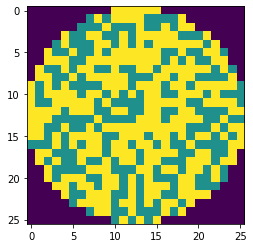

wafer_id:229, ウエハサイズ:37x40, スタンプサイズ:2x3, oDefects:271, nDefects:523, p=51.816


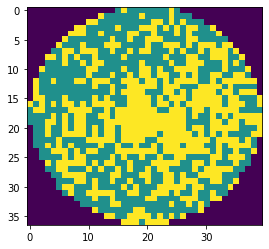

wafer_id:229, ウエハサイズ:37x40, スタンプサイズ:3x3, oDefects:271, nDefects:523, p=51.816


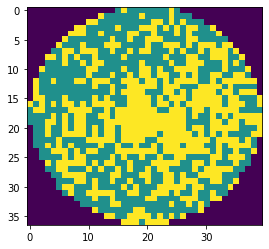

wafer_id:229, ウエハサイズ:37x40, スタンプサイズ:4x3, oDefects:271, nDefects:523, p=51.816


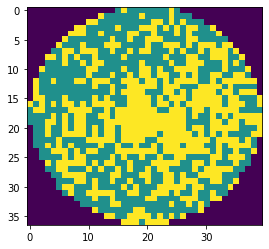

wafer_id:230, ウエハサイズ:37x40, スタンプサイズ:2x2, oDefects:291, nDefects:571, p=50.963


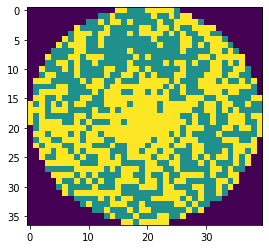

wafer_id:230, ウエハサイズ:37x40, スタンプサイズ:3x2, oDefects:291, nDefects:571, p=50.963


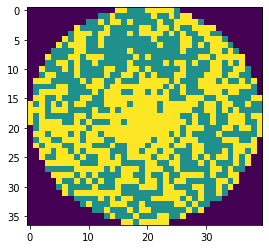

wafer_id:230, ウエハサイズ:37x40, スタンプサイズ:4x2, oDefects:291, nDefects:571, p=50.963


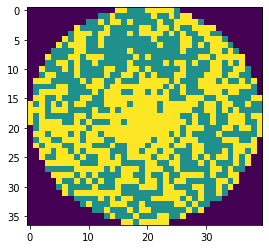

wafer_id:230, ウエハサイズ:37x40, スタンプサイズ:2x3, oDefects:281, nDefects:555, p=50.631


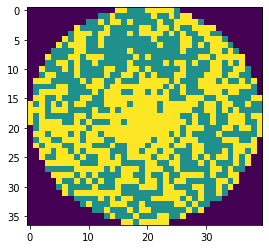

wafer_id:230, ウエハサイズ:37x40, スタンプサイズ:3x3, oDefects:281, nDefects:555, p=50.631


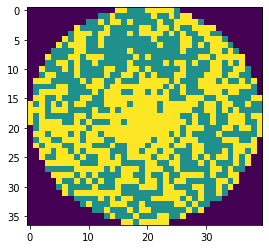

wafer_id:230, ウエハサイズ:37x40, スタンプサイズ:4x3, oDefects:281, nDefects:555, p=50.631


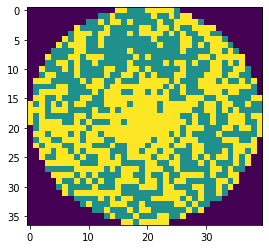

wafer_id:233, ウエハサイズ:64x71, スタンプサイズ:2x2, oDefects:1256, nDefects:2133, p=58.884


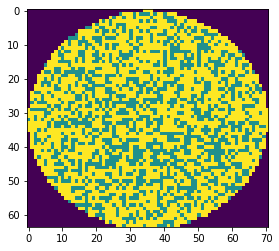

wafer_id:233, ウエハサイズ:64x71, スタンプサイズ:3x2, oDefects:1249, nDefects:2120, p=58.915


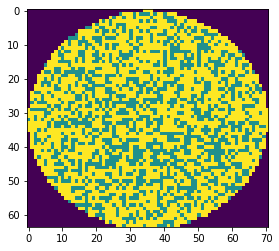

wafer_id:233, ウエハサイズ:64x71, スタンプサイズ:4x2, oDefects:1256, nDefects:2133, p=58.884


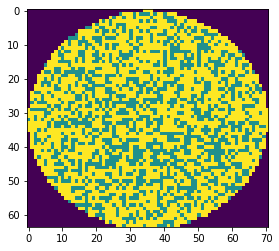

wafer_id:233, ウエハサイズ:64x71, スタンプサイズ:2x3, oDefects:1239, nDefects:2094, p=59.169


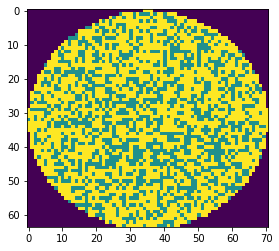

wafer_id:233, ウエハサイズ:64x71, スタンプサイズ:3x3, oDefects:1232, nDefects:2081, p=59.202


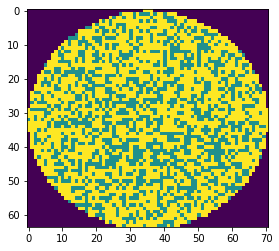

wafer_id:233, ウエハサイズ:64x71, スタンプサイズ:4x3, oDefects:1239, nDefects:2094, p=59.169


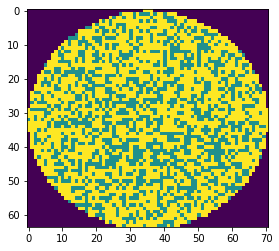

wafer_id:233, ウエハサイズ:64x71, スタンプサイズ:2x4, oDefects:1179, nDefects:2048, p=57.568


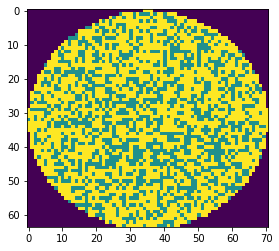

wafer_id:233, ウエハサイズ:64x71, スタンプサイズ:3x4, oDefects:1172, nDefects:2035, p=57.592


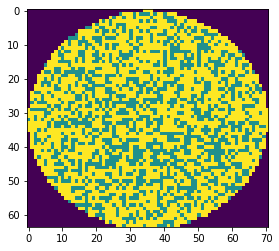

wafer_id:233, ウエハサイズ:64x71, スタンプサイズ:4x4, oDefects:1179, nDefects:2048, p=57.568


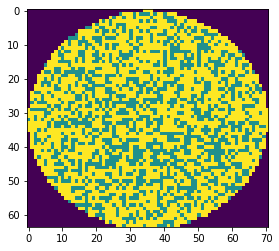

wafer_id:234, ウエハサイズ:31x28, スタンプサイズ:4x2, oDefects:171, nDefects:341, p=50.147


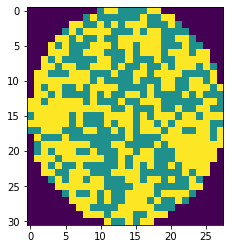

wafer_id:234, ウエハサイズ:31x28, スタンプサイズ:2x3, oDefects:164, nDefects:327, p=50.153


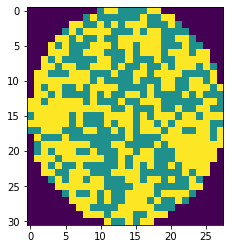

wafer_id:234, ウエハサイズ:31x28, スタンプサイズ:3x3, oDefects:164, nDefects:327, p=50.153


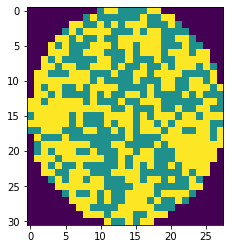

wafer_id:234, ウエハサイズ:31x28, スタンプサイズ:4x3, oDefects:159, nDefects:311, p=51.125


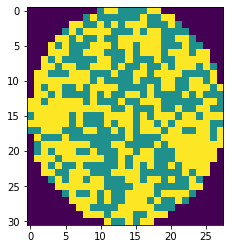

wafer_id:236, ウエハサイズ:32x35, スタンプサイズ:2x2, oDefects:201, nDefects:401, p=50.125


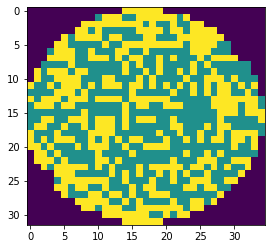

wafer_id:236, ウエハサイズ:32x35, スタンプサイズ:4x2, oDefects:201, nDefects:401, p=50.125


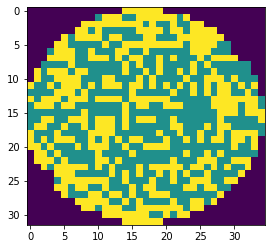

wafer_id:240, ウエハサイズ:32x35, スタンプサイズ:2x2, oDefects:254, nDefects:469, p=54.158


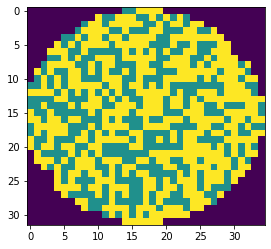

wafer_id:240, ウエハサイズ:32x35, スタンプサイズ:3x2, oDefects:243, nDefects:454, p=53.524


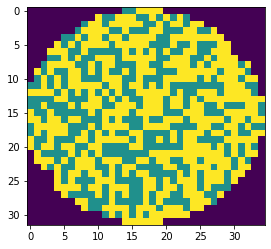

wafer_id:240, ウエハサイズ:32x35, スタンプサイズ:4x2, oDefects:254, nDefects:469, p=54.158


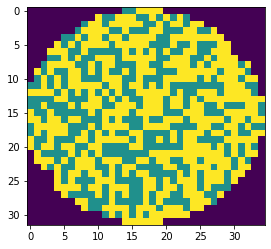

wafer_id:240, ウエハサイズ:32x35, スタンプサイズ:2x3, oDefects:226, nDefects:443, p=51.016


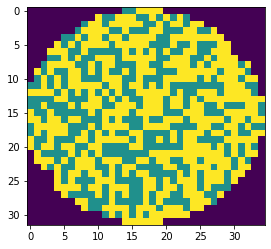

wafer_id:240, ウエハサイズ:32x35, スタンプサイズ:3x3, oDefects:219, nDefects:428, p=51.168


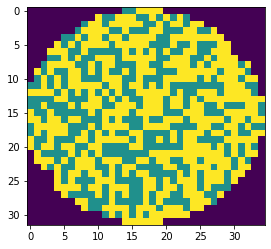

wafer_id:240, ウエハサイズ:32x35, スタンプサイズ:4x3, oDefects:226, nDefects:443, p=51.016


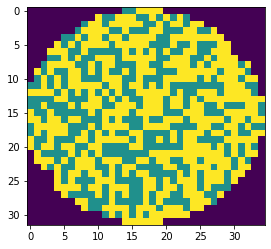

wafer_id:240, ウエハサイズ:32x35, スタンプサイズ:2x4, oDefects:221, nDefects:412, p=53.641


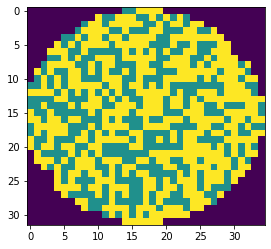

wafer_id:240, ウエハサイズ:32x35, スタンプサイズ:3x4, oDefects:214, nDefects:397, p=53.904


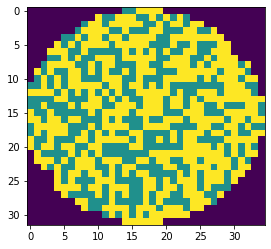

wafer_id:240, ウエハサイズ:32x35, スタンプサイズ:4x4, oDefects:221, nDefects:412, p=53.641


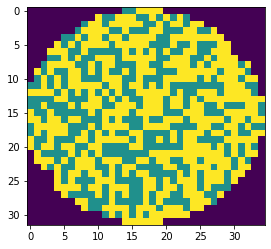

wafer_id:245, ウエハサイズ:32x35, スタンプサイズ:2x3, oDefects:217, nDefects:425, p=51.059


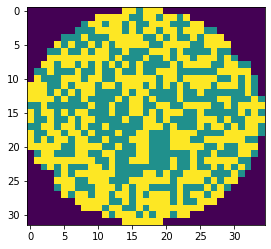

wafer_id:245, ウエハサイズ:32x35, スタンプサイズ:3x3, oDefects:209, nDefects:410, p=50.976


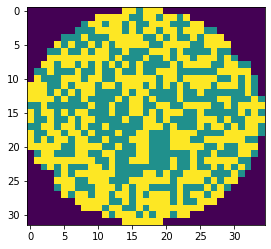

wafer_id:245, ウエハサイズ:32x35, スタンプサイズ:4x3, oDefects:217, nDefects:425, p=51.059


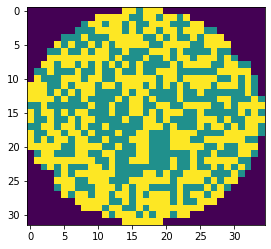

wafer_id:251, ウエハサイズ:32x35, スタンプサイズ:2x2, oDefects:263, nDefects:475, p=55.368


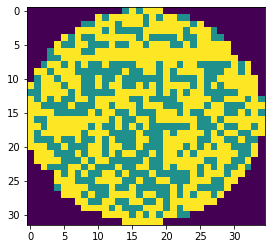

wafer_id:251, ウエハサイズ:32x35, スタンプサイズ:3x2, oDefects:254, nDefects:461, p=55.098


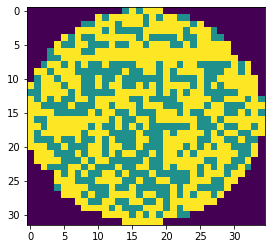

wafer_id:251, ウエハサイズ:32x35, スタンプサイズ:4x2, oDefects:263, nDefects:475, p=55.368


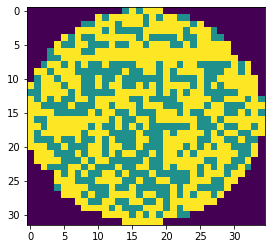

wafer_id:251, ウエハサイズ:32x35, スタンプサイズ:2x3, oDefects:246, nDefects:454, p=54.185


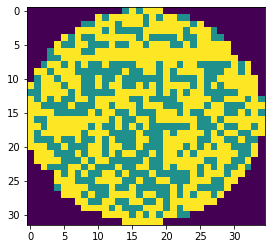

wafer_id:251, ウエハサイズ:32x35, スタンプサイズ:3x3, oDefects:240, nDefects:440, p=54.545


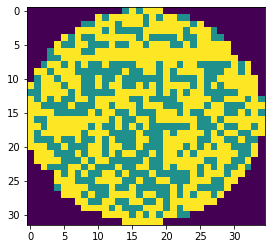

wafer_id:251, ウエハサイズ:32x35, スタンプサイズ:4x3, oDefects:246, nDefects:454, p=54.185


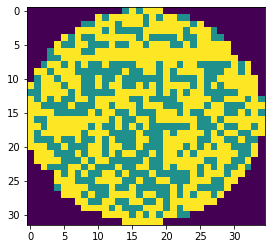

wafer_id:251, ウエハサイズ:32x35, スタンプサイズ:2x4, oDefects:232, nDefects:426, p=54.460


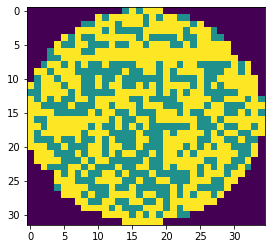

wafer_id:251, ウエハサイズ:32x35, スタンプサイズ:3x4, oDefects:227, nDefects:412, p=55.097


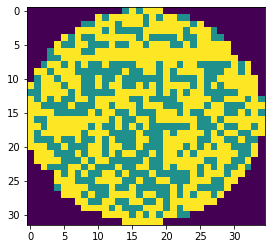

wafer_id:251, ウエハサイズ:32x35, スタンプサイズ:4x4, oDefects:232, nDefects:426, p=54.460


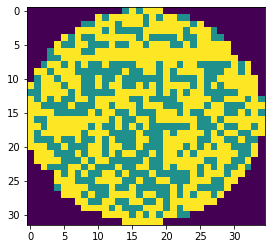

wafer_id:256, ウエハサイズ:32x35, スタンプサイズ:2x2, oDefects:215, nDefects:427, p=50.351


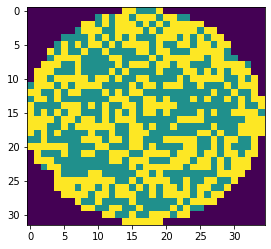

wafer_id:256, ウエハサイズ:32x35, スタンプサイズ:3x2, oDefects:209, nDefects:413, p=50.605


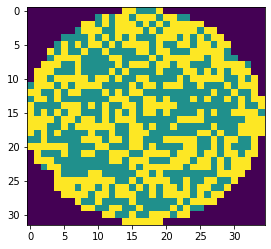

wafer_id:256, ウエハサイズ:32x35, スタンプサイズ:4x2, oDefects:215, nDefects:427, p=50.351


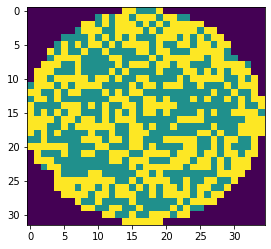

wafer_id:264, ウエハサイズ:28x28, スタンプサイズ:2x2, oDefects:210, nDefects:360, p=58.333


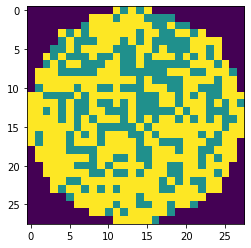

wafer_id:264, ウエハサイズ:28x28, スタンプサイズ:3x2, oDefects:207, nDefects:355, p=58.310


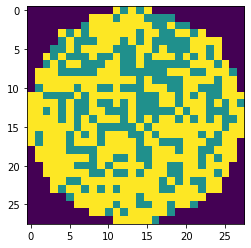

wafer_id:264, ウエハサイズ:28x28, スタンプサイズ:4x2, oDefects:210, nDefects:360, p=58.333


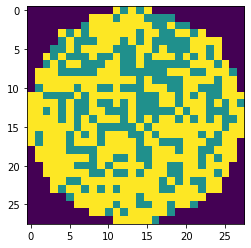

wafer_id:264, ウエハサイズ:28x28, スタンプサイズ:2x3, oDefects:182, nDefects:338, p=53.846


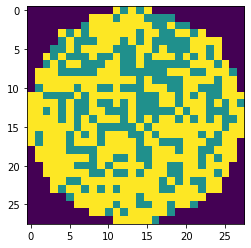

wafer_id:264, ウエハサイズ:28x28, スタンプサイズ:3x3, oDefects:180, nDefects:333, p=54.054


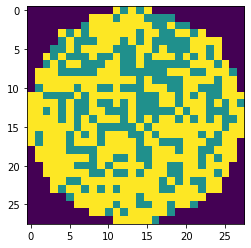

wafer_id:264, ウエハサイズ:28x28, スタンプサイズ:4x3, oDefects:182, nDefects:338, p=53.846


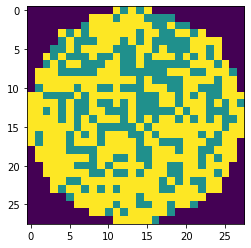

wafer_id:264, ウエハサイズ:28x28, スタンプサイズ:2x4, oDefects:185, nDefects:338, p=54.734


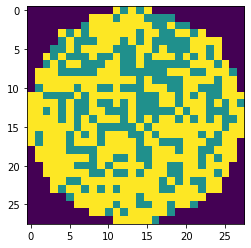

wafer_id:264, ウエハサイズ:28x28, スタンプサイズ:3x4, oDefects:184, nDefects:333, p=55.255


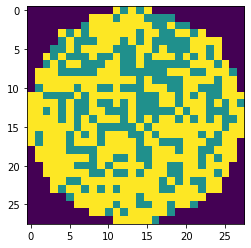

wafer_id:264, ウエハサイズ:28x28, スタンプサイズ:4x4, oDefects:185, nDefects:338, p=54.734


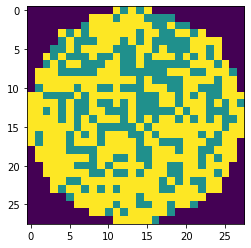

wafer_id:265, ウエハサイズ:28x28, スタンプサイズ:2x2, oDefects:183, nDefects:345, p=53.043


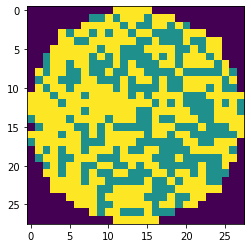

wafer_id:265, ウエハサイズ:28x28, スタンプサイズ:3x2, oDefects:179, nDefects:339, p=52.802


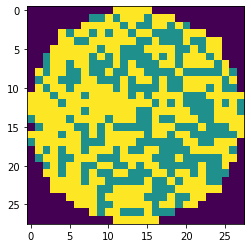

wafer_id:265, ウエハサイズ:28x28, スタンプサイズ:4x2, oDefects:183, nDefects:345, p=53.043


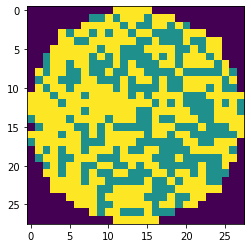

wafer_id:265, ウエハサイズ:28x28, スタンプサイズ:2x3, oDefects:171, nDefects:324, p=52.778


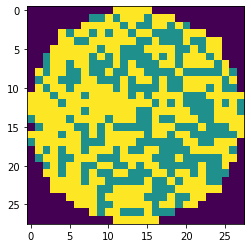

wafer_id:265, ウエハサイズ:28x28, スタンプサイズ:3x3, oDefects:168, nDefects:318, p=52.830


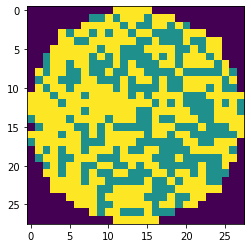

wafer_id:265, ウエハサイズ:28x28, スタンプサイズ:4x3, oDefects:171, nDefects:324, p=52.778


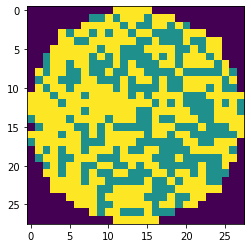

wafer_id:267, ウエハサイズ:28x28, スタンプサイズ:2x2, oDefects:190, nDefects:346, p=54.913


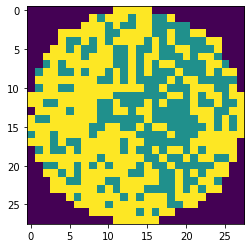

wafer_id:267, ウエハサイズ:28x28, スタンプサイズ:3x2, oDefects:186, nDefects:340, p=54.706


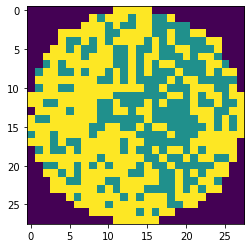

wafer_id:267, ウエハサイズ:28x28, スタンプサイズ:4x2, oDefects:190, nDefects:346, p=54.913


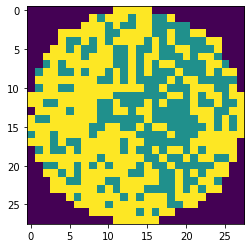

wafer_id:267, ウエハサイズ:28x28, スタンプサイズ:2x3, oDefects:182, nDefects:327, p=55.657


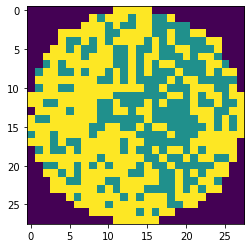

wafer_id:267, ウエハサイズ:28x28, スタンプサイズ:3x3, oDefects:179, nDefects:321, p=55.763


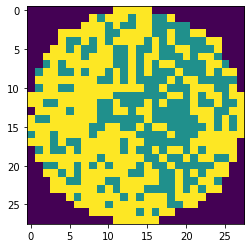

wafer_id:267, ウエハサイズ:28x28, スタンプサイズ:4x3, oDefects:182, nDefects:327, p=55.657


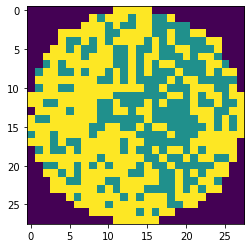

wafer_id:267, ウエハサイズ:28x28, スタンプサイズ:2x4, oDefects:166, nDefects:327, p=50.765


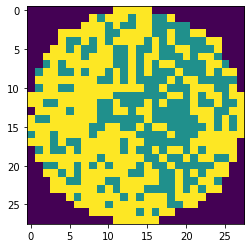

wafer_id:267, ウエハサイズ:28x28, スタンプサイズ:3x4, oDefects:164, nDefects:321, p=51.090


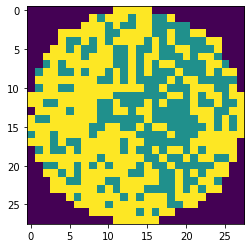

wafer_id:267, ウエハサイズ:28x28, スタンプサイズ:4x4, oDefects:166, nDefects:327, p=50.765


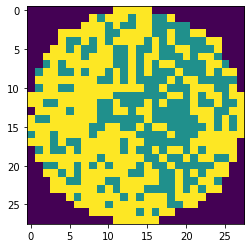

wafer_id:270, ウエハサイズ:28x28, スタンプサイズ:2x2, oDefects:160, nDefects:312, p=51.282


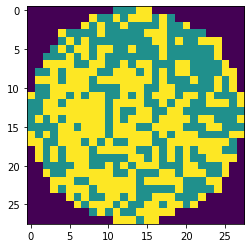

wafer_id:270, ウエハサイズ:28x28, スタンプサイズ:3x2, oDefects:158, nDefects:307, p=51.466


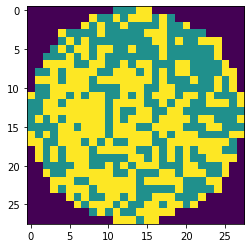

wafer_id:270, ウエハサイズ:28x28, スタンプサイズ:4x2, oDefects:160, nDefects:312, p=51.282


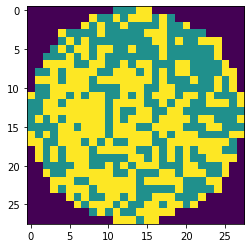

wafer_id:270, ウエハサイズ:28x28, スタンプサイズ:2x4, oDefects:152, nDefects:293, p=51.877


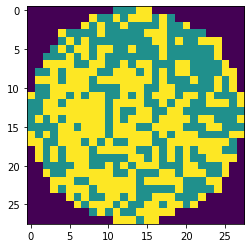

wafer_id:270, ウエハサイズ:28x28, スタンプサイズ:3x4, oDefects:150, nDefects:288, p=52.083


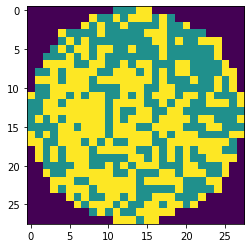

wafer_id:270, ウエハサイズ:28x28, スタンプサイズ:4x4, oDefects:152, nDefects:293, p=51.877


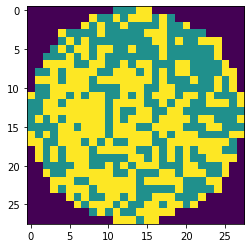

wafer_id:274, ウエハサイズ:41x51, スタンプサイズ:2x2, oDefects:433, nDefects:831, p=52.106


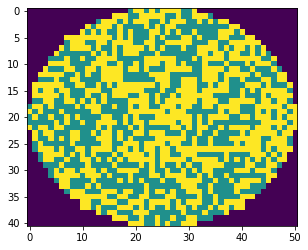

wafer_id:274, ウエハサイズ:41x51, スタンプサイズ:3x2, oDefects:432, nDefects:823, p=52.491


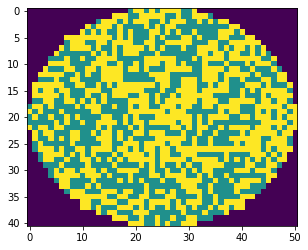

wafer_id:274, ウエハサイズ:41x51, スタンプサイズ:4x2, oDefects:433, nDefects:831, p=52.106


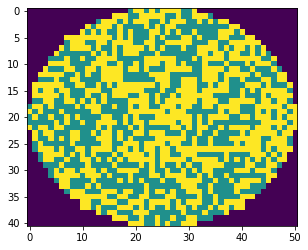

wafer_id:275, ウエハサイズ:41x51, スタンプサイズ:2x2, oDefects:476, nDefects:882, p=53.968


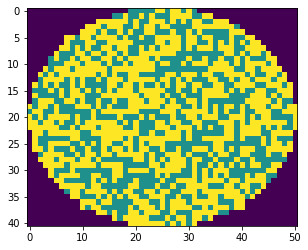

wafer_id:275, ウエハサイズ:41x51, スタンプサイズ:3x2, oDefects:469, nDefects:870, p=53.908


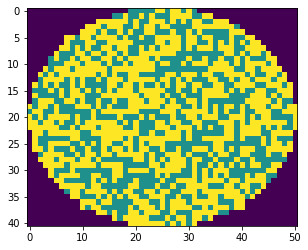

wafer_id:275, ウエハサイズ:41x51, スタンプサイズ:4x2, oDefects:476, nDefects:882, p=53.968


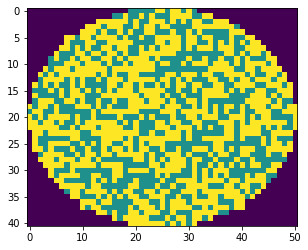

wafer_id:275, ウエハサイズ:41x51, スタンプサイズ:2x3, oDefects:477, nDefects:882, p=54.082


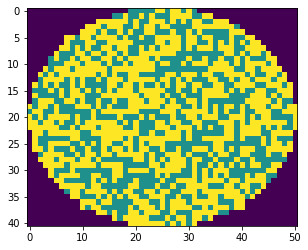

wafer_id:275, ウエハサイズ:41x51, スタンプサイズ:3x3, oDefects:470, nDefects:870, p=54.023


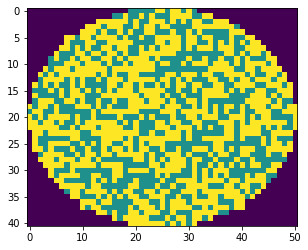

wafer_id:275, ウエハサイズ:41x51, スタンプサイズ:4x3, oDefects:477, nDefects:882, p=54.082


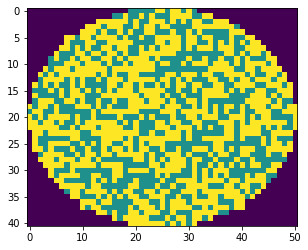

wafer_id:275, ウエハサイズ:41x51, スタンプサイズ:2x4, oDefects:438, nDefects:826, p=53.027


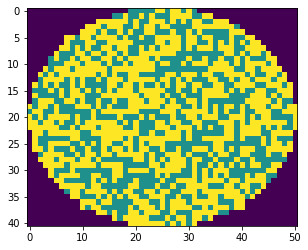

wafer_id:275, ウエハサイズ:41x51, スタンプサイズ:3x4, oDefects:434, nDefects:814, p=53.317


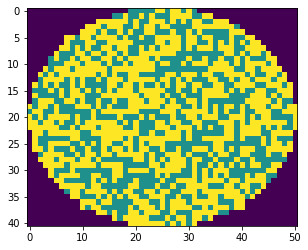

wafer_id:275, ウエハサイズ:41x51, スタンプサイズ:4x4, oDefects:438, nDefects:826, p=53.027


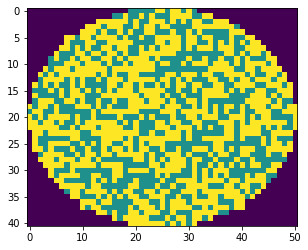

wafer_id:277, ウエハサイズ:58x60, スタンプサイズ:2x4, oDefects:926, nDefects:1582, p=58.534


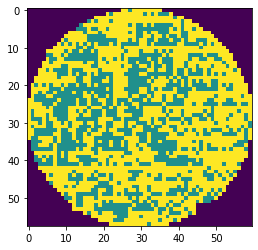

wafer_id:277, ウエハサイズ:58x60, スタンプサイズ:3x4, oDefects:916, nDefects:1567, p=58.456


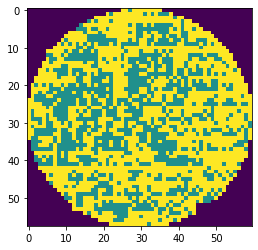

wafer_id:277, ウエハサイズ:58x60, スタンプサイズ:4x4, oDefects:906, nDefects:1550, p=58.452


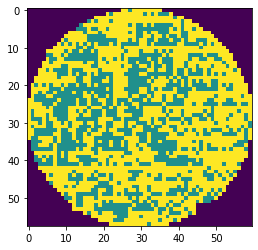

wafer_id:279, ウエハサイズ:41x51, スタンプサイズ:2x2, oDefects:446, nDefects:840, p=53.095


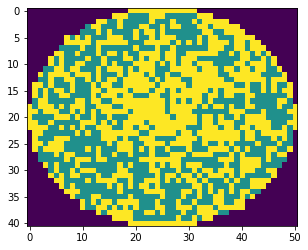

wafer_id:279, ウエハサイズ:41x51, スタンプサイズ:3x2, oDefects:443, nDefects:832, p=53.245


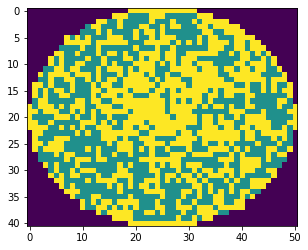

wafer_id:279, ウエハサイズ:41x51, スタンプサイズ:4x2, oDefects:446, nDefects:840, p=53.095


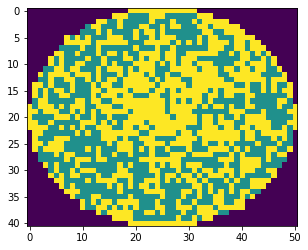

wafer_id:279, ウエハサイズ:41x51, スタンプサイズ:2x3, oDefects:420, nDefects:840, p=50.000


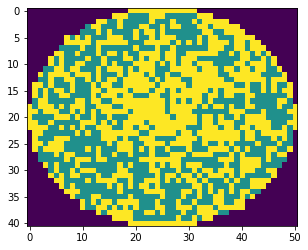

wafer_id:279, ウエハサイズ:41x51, スタンプサイズ:3x3, oDefects:417, nDefects:832, p=50.120


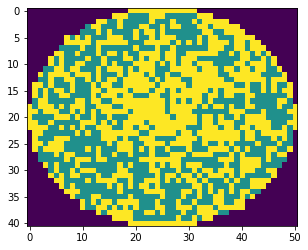

wafer_id:279, ウエハサイズ:41x51, スタンプサイズ:4x3, oDefects:420, nDefects:840, p=50.000


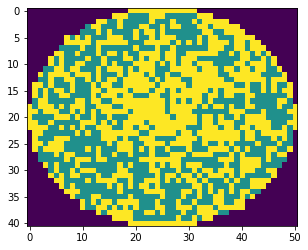

wafer_id:279, ウエハサイズ:41x51, スタンプサイズ:2x4, oDefects:410, nDefects:800, p=51.250


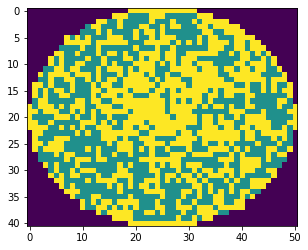

wafer_id:279, ウエハサイズ:41x51, スタンプサイズ:3x4, oDefects:410, nDefects:792, p=51.768


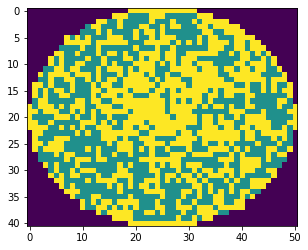

wafer_id:279, ウエハサイズ:41x51, スタンプサイズ:4x4, oDefects:410, nDefects:800, p=51.250


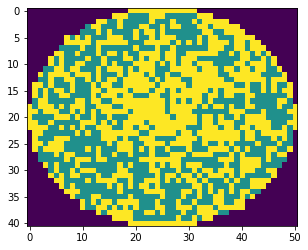

wafer_id:283, ウエハサイズ:41x51, スタンプサイズ:2x2, oDefects:448, nDefects:845, p=53.018


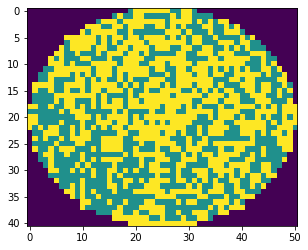

wafer_id:283, ウエハサイズ:41x51, スタンプサイズ:3x2, oDefects:443, nDefects:834, p=53.118


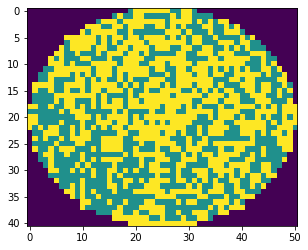

wafer_id:283, ウエハサイズ:41x51, スタンプサイズ:4x2, oDefects:448, nDefects:845, p=53.018


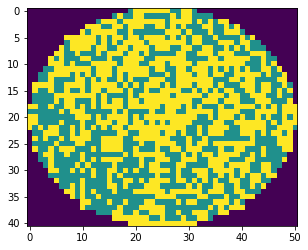

wafer_id:283, ウエハサイズ:41x51, スタンプサイズ:2x3, oDefects:427, nDefects:845, p=50.533


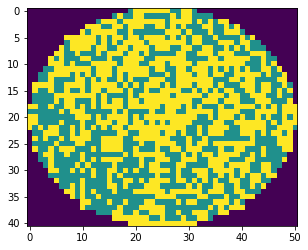

wafer_id:283, ウエハサイズ:41x51, スタンプサイズ:3x3, oDefects:421, nDefects:834, p=50.480


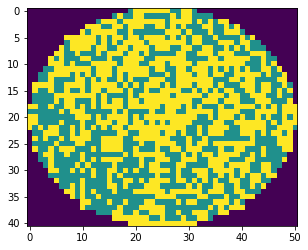

wafer_id:283, ウエハサイズ:41x51, スタンプサイズ:4x3, oDefects:427, nDefects:845, p=50.533


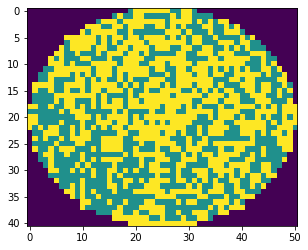

wafer_id:283, ウエハサイズ:41x51, スタンプサイズ:2x4, oDefects:442, nDefects:803, p=55.044


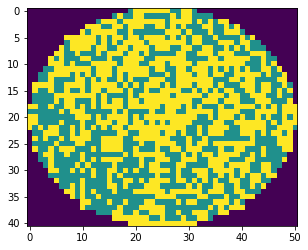

wafer_id:283, ウエハサイズ:41x51, スタンプサイズ:3x4, oDefects:436, nDefects:792, p=55.051


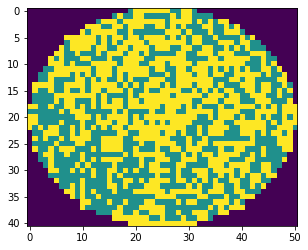

wafer_id:283, ウエハサイズ:41x51, スタンプサイズ:4x4, oDefects:442, nDefects:803, p=55.044


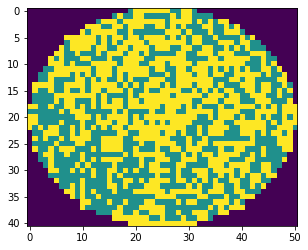

wafer_id:285, ウエハサイズ:41x51, スタンプサイズ:3x2, oDefects:379, nDefects:757, p=50.066


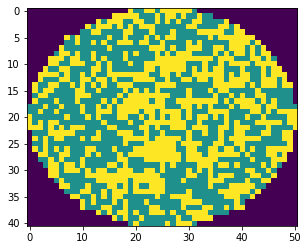

wafer_id:289, ウエハサイズ:41x51, スタンプサイズ:2x2, oDefects:448, nDefects:840, p=53.333


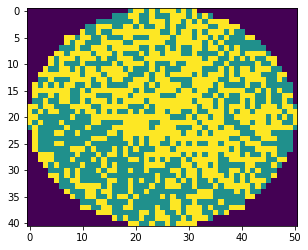

wafer_id:289, ウエハサイズ:41x51, スタンプサイズ:3x2, oDefects:444, nDefects:830, p=53.494


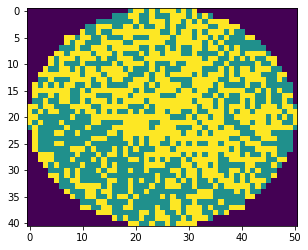

wafer_id:289, ウエハサイズ:41x51, スタンプサイズ:4x2, oDefects:448, nDefects:840, p=53.333


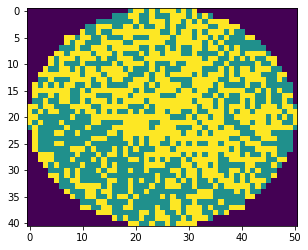

wafer_id:289, ウエハサイズ:41x51, スタンプサイズ:2x3, oDefects:434, nDefects:840, p=51.667


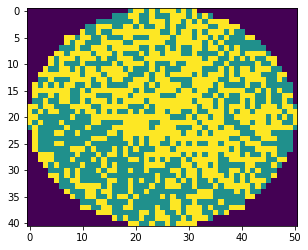

wafer_id:289, ウエハサイズ:41x51, スタンプサイズ:3x3, oDefects:430, nDefects:830, p=51.807


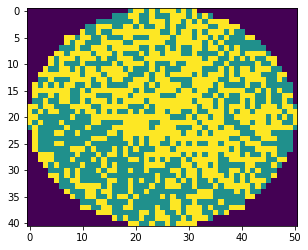

wafer_id:289, ウエハサイズ:41x51, スタンプサイズ:4x3, oDefects:434, nDefects:840, p=51.667


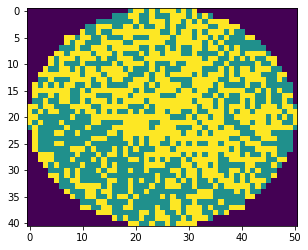

wafer_id:289, ウエハサイズ:41x51, スタンプサイズ:2x4, oDefects:421, nDefects:795, p=52.956


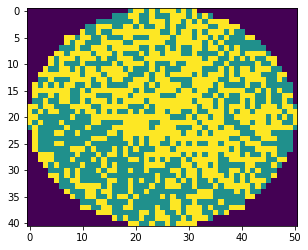

wafer_id:289, ウエハサイズ:41x51, スタンプサイズ:3x4, oDefects:418, nDefects:785, p=53.248


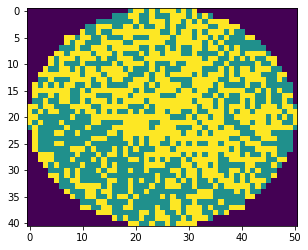

wafer_id:289, ウエハサイズ:41x51, スタンプサイズ:4x4, oDefects:421, nDefects:795, p=52.956


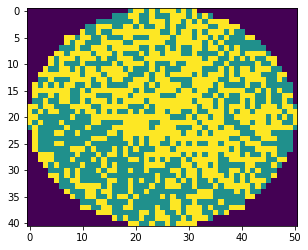

wafer_id:291, ウエハサイズ:58x60, スタンプサイズ:2x2, oDefects:619, nDefects:1234, p=50.162


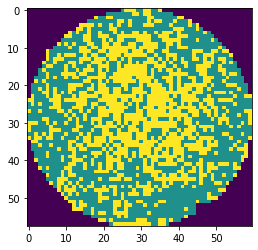

wafer_id:291, ウエハサイズ:58x60, スタンプサイズ:3x2, oDefects:611, nDefects:1222, p=50.000


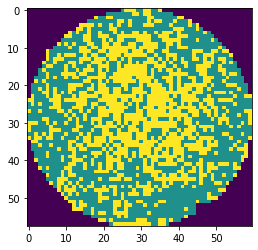

wafer_id:291, ウエハサイズ:58x60, スタンプサイズ:4x2, oDefects:608, nDefects:1213, p=50.124


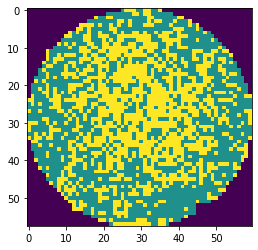

wafer_id:293, ウエハサイズ:41x51, スタンプサイズ:2x2, oDefects:403, nDefects:763, p=52.818


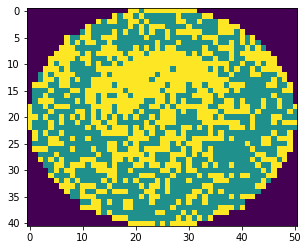

wafer_id:293, ウエハサイズ:41x51, スタンプサイズ:3x2, oDefects:399, nDefects:756, p=52.778


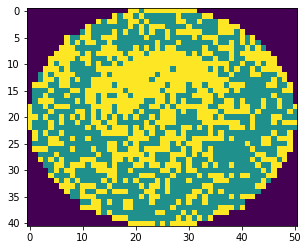

wafer_id:293, ウエハサイズ:41x51, スタンプサイズ:4x2, oDefects:403, nDefects:763, p=52.818


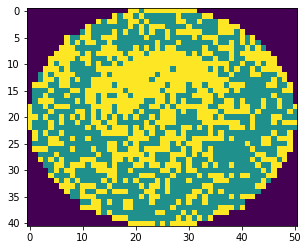

wafer_id:294, ウエハサイズ:41x51, スタンプサイズ:2x2, oDefects:383, nDefects:745, p=51.409


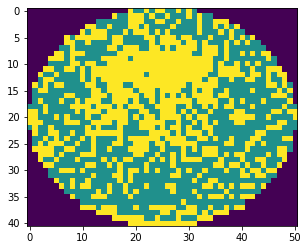

wafer_id:294, ウエハサイズ:41x51, スタンプサイズ:3x2, oDefects:378, nDefects:734, p=51.499


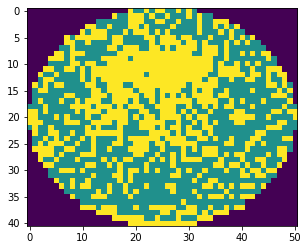

wafer_id:294, ウエハサイズ:41x51, スタンプサイズ:4x2, oDefects:383, nDefects:745, p=51.409


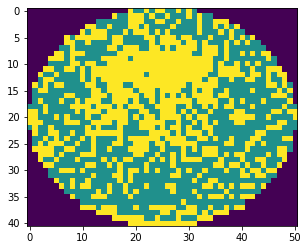

wafer_id:294, ウエハサイズ:41x51, スタンプサイズ:3x3, oDefects:368, nDefects:734, p=50.136


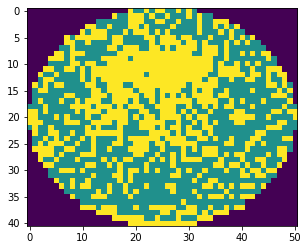

wafer_id:294, ウエハサイズ:41x51, スタンプサイズ:2x4, oDefects:372, nDefects:711, p=52.321


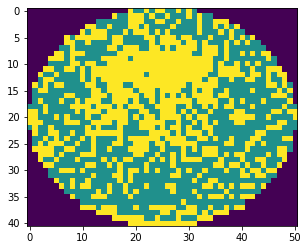

wafer_id:294, ウエハサイズ:41x51, スタンプサイズ:3x4, oDefects:367, nDefects:700, p=52.429


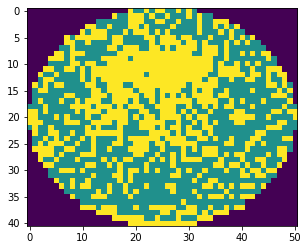

wafer_id:294, ウエハサイズ:41x51, スタンプサイズ:4x4, oDefects:372, nDefects:711, p=52.321


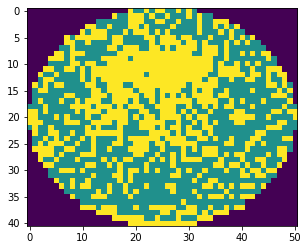

wafer_id:296, ウエハサイズ:41x51, スタンプサイズ:2x2, oDefects:378, nDefects:745, p=50.738


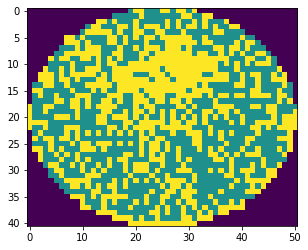

wafer_id:296, ウエハサイズ:41x51, スタンプサイズ:3x2, oDefects:373, nDefects:734, p=50.817


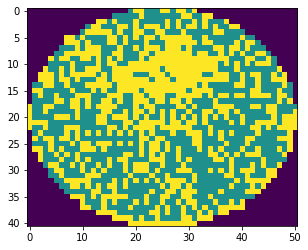

wafer_id:296, ウエハサイズ:41x51, スタンプサイズ:4x2, oDefects:378, nDefects:745, p=50.738


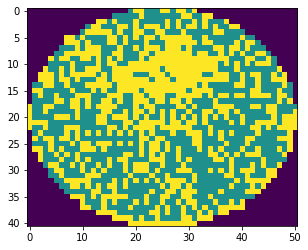

wafer_id:297, ウエハサイズ:41x51, スタンプサイズ:2x2, oDefects:458, nDefects:828, p=55.314


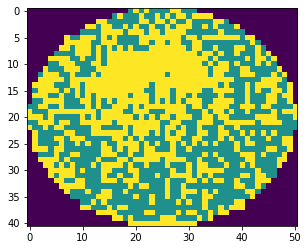

wafer_id:297, ウエハサイズ:41x51, スタンプサイズ:3x2, oDefects:455, nDefects:820, p=55.488


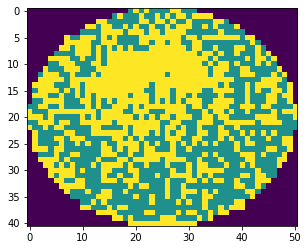

wafer_id:297, ウエハサイズ:41x51, スタンプサイズ:4x2, oDefects:458, nDefects:828, p=55.314


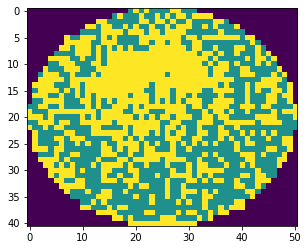

wafer_id:297, ウエハサイズ:41x51, スタンプサイズ:2x3, oDefects:445, nDefects:828, p=53.744


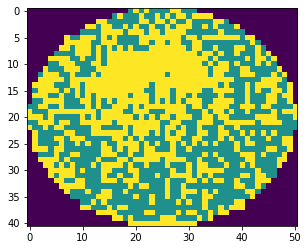

wafer_id:297, ウエハサイズ:41x51, スタンプサイズ:3x3, oDefects:444, nDefects:820, p=54.146


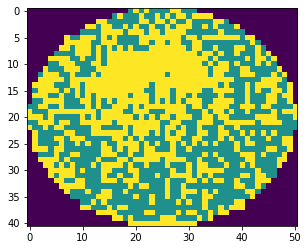

wafer_id:297, ウエハサイズ:41x51, スタンプサイズ:4x3, oDefects:445, nDefects:828, p=53.744


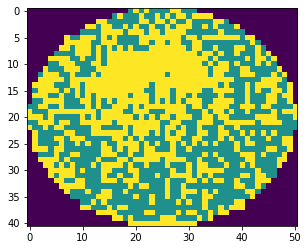

wafer_id:297, ウエハサイズ:41x51, スタンプサイズ:2x4, oDefects:429, nDefects:788, p=54.442


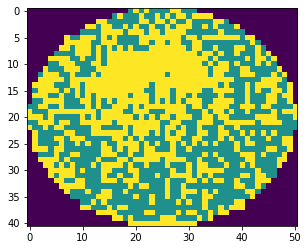

wafer_id:297, ウエハサイズ:41x51, スタンプサイズ:3x4, oDefects:429, nDefects:780, p=55.000


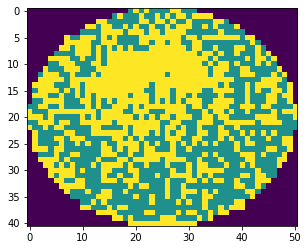

wafer_id:297, ウエハサイズ:41x51, スタンプサイズ:4x4, oDefects:429, nDefects:788, p=54.442


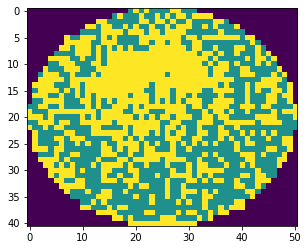

wafer_id:300, ウエハサイズ:41x51, スタンプサイズ:2x2, oDefects:408, nDefects:770, p=52.987


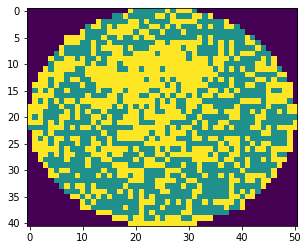

wafer_id:300, ウエハサイズ:41x51, スタンプサイズ:3x2, oDefects:402, nDefects:757, p=53.104


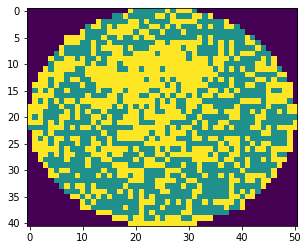

wafer_id:300, ウエハサイズ:41x51, スタンプサイズ:4x2, oDefects:408, nDefects:770, p=52.987


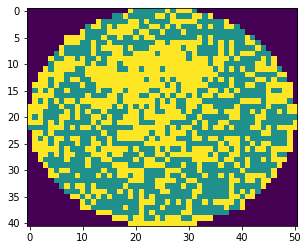

wafer_id:300, ウエハサイズ:41x51, スタンプサイズ:2x3, oDefects:388, nDefects:770, p=50.390


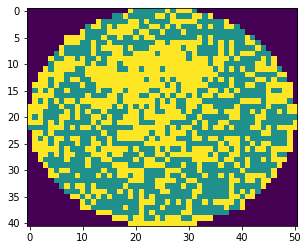

wafer_id:300, ウエハサイズ:41x51, スタンプサイズ:3x3, oDefects:382, nDefects:757, p=50.462


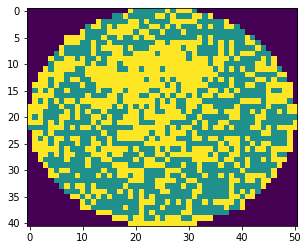

wafer_id:300, ウエハサイズ:41x51, スタンプサイズ:4x3, oDefects:388, nDefects:770, p=50.390


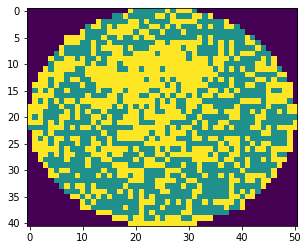

wafer_id:302, ウエハサイズ:41x51, スタンプサイズ:2x2, oDefects:434, nDefects:808, p=53.713


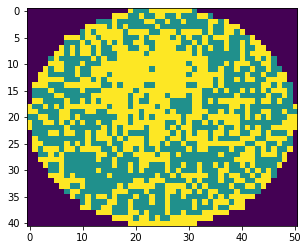

wafer_id:302, ウエハサイズ:41x51, スタンプサイズ:3x2, oDefects:424, nDefects:793, p=53.468


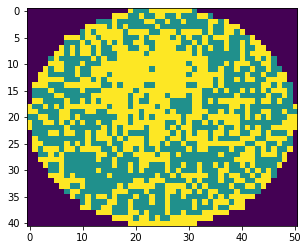

wafer_id:302, ウエハサイズ:41x51, スタンプサイズ:4x2, oDefects:434, nDefects:808, p=53.713


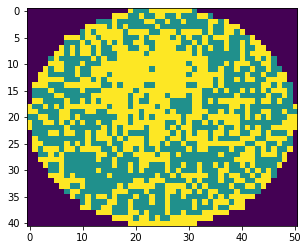

wafer_id:302, ウエハサイズ:41x51, スタンプサイズ:2x3, oDefects:436, nDefects:808, p=53.960


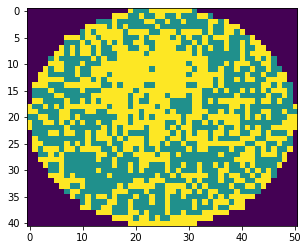

wafer_id:302, ウエハサイズ:41x51, スタンプサイズ:3x3, oDefects:426, nDefects:793, p=53.720


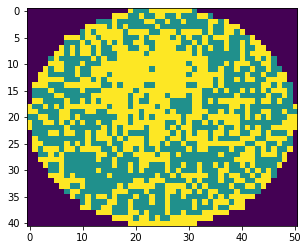

wafer_id:302, ウエハサイズ:41x51, スタンプサイズ:4x3, oDefects:436, nDefects:808, p=53.960


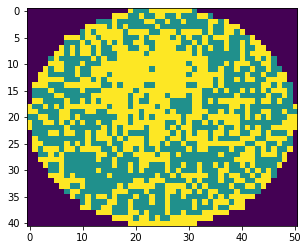

wafer_id:302, ウエハサイズ:41x51, スタンプサイズ:2x4, oDefects:390, nDefects:763, p=51.114


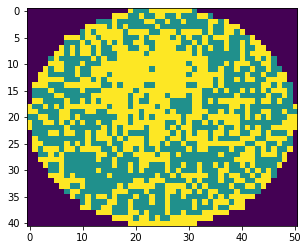

wafer_id:302, ウエハサイズ:41x51, スタンプサイズ:3x4, oDefects:383, nDefects:748, p=51.203


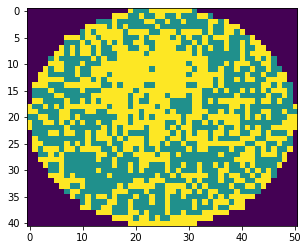

wafer_id:302, ウエハサイズ:41x51, スタンプサイズ:4x4, oDefects:390, nDefects:763, p=51.114


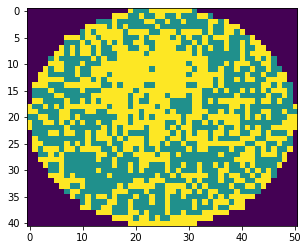

wafer_id:303, ウエハサイズ:41x51, スタンプサイズ:2x2, oDefects:393, nDefects:762, p=51.575


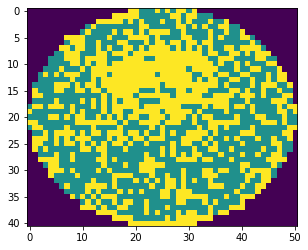

wafer_id:303, ウエハサイズ:41x51, スタンプサイズ:3x2, oDefects:385, nDefects:750, p=51.333


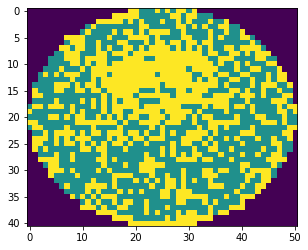

wafer_id:303, ウエハサイズ:41x51, スタンプサイズ:4x2, oDefects:393, nDefects:762, p=51.575


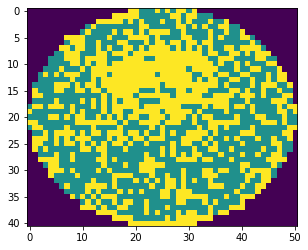

wafer_id:303, ウエハサイズ:41x51, スタンプサイズ:3x4, oDefects:355, nDefects:708, p=50.141


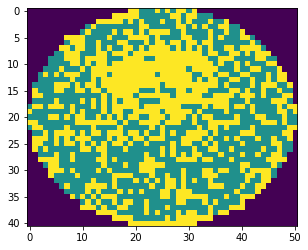

wafer_id:307, ウエハサイズ:41x51, スタンプサイズ:2x2, oDefects:449, nDefects:813, p=55.228


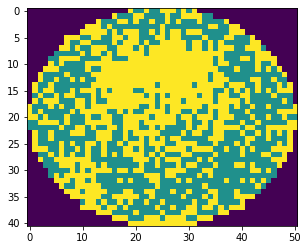

wafer_id:307, ウエハサイズ:41x51, スタンプサイズ:3x2, oDefects:443, nDefects:800, p=55.375


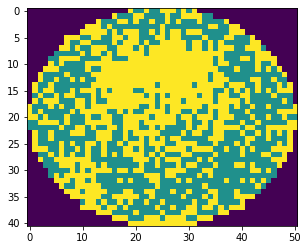

wafer_id:307, ウエハサイズ:41x51, スタンプサイズ:4x2, oDefects:449, nDefects:813, p=55.228


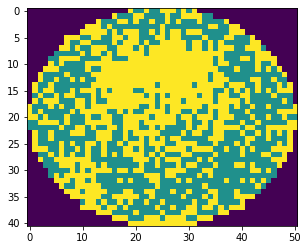

wafer_id:307, ウエハサイズ:41x51, スタンプサイズ:2x3, oDefects:435, nDefects:813, p=53.506


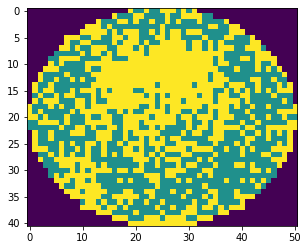

wafer_id:307, ウエハサイズ:41x51, スタンプサイズ:3x3, oDefects:431, nDefects:800, p=53.875


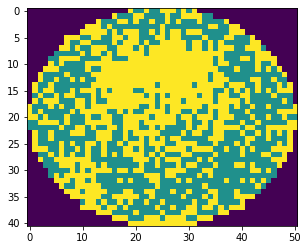

wafer_id:307, ウエハサイズ:41x51, スタンプサイズ:4x3, oDefects:435, nDefects:813, p=53.506


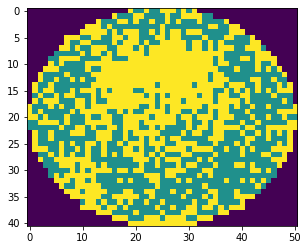

wafer_id:307, ウエハサイズ:41x51, スタンプサイズ:2x4, oDefects:416, nDefects:781, p=53.265


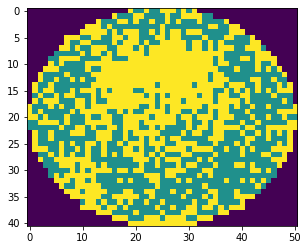

wafer_id:307, ウエハサイズ:41x51, スタンプサイズ:3x4, oDefects:410, nDefects:768, p=53.385


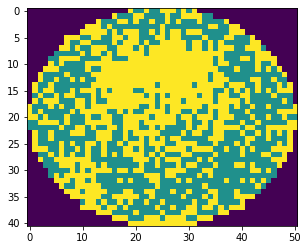

wafer_id:307, ウエハサイズ:41x51, スタンプサイズ:4x4, oDefects:416, nDefects:781, p=53.265


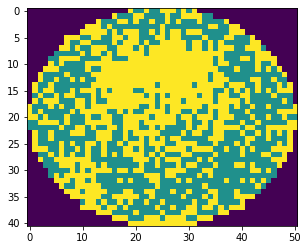

wafer_id:309, ウエハサイズ:41x51, スタンプサイズ:2x2, oDefects:442, nDefects:793, p=55.738


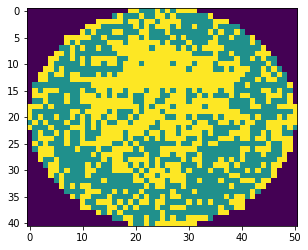

wafer_id:309, ウエハサイズ:41x51, スタンプサイズ:3x2, oDefects:439, nDefects:784, p=55.995


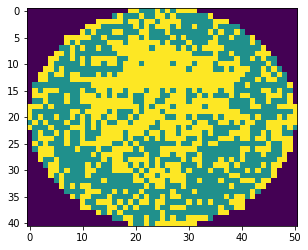

wafer_id:309, ウエハサイズ:41x51, スタンプサイズ:4x2, oDefects:442, nDefects:793, p=55.738


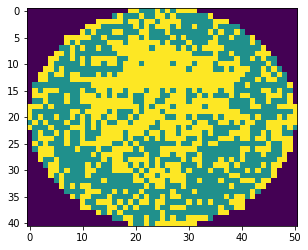

wafer_id:309, ウエハサイズ:41x51, スタンプサイズ:2x3, oDefects:424, nDefects:793, p=53.468


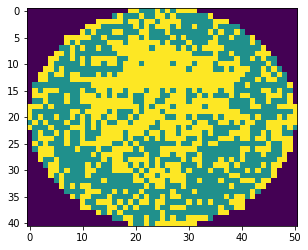

wafer_id:309, ウエハサイズ:41x51, スタンプサイズ:3x3, oDefects:420, nDefects:784, p=53.571


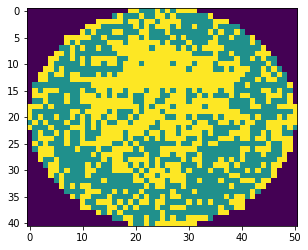

wafer_id:309, ウエハサイズ:41x51, スタンプサイズ:4x3, oDefects:424, nDefects:793, p=53.468


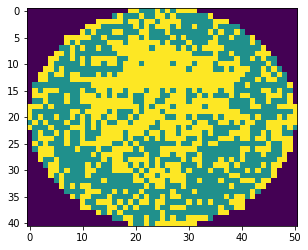

wafer_id:309, ウエハサイズ:41x51, スタンプサイズ:2x4, oDefects:400, nDefects:747, p=53.548


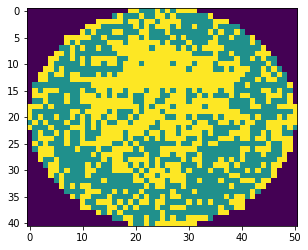

wafer_id:309, ウエハサイズ:41x51, スタンプサイズ:3x4, oDefects:398, nDefects:738, p=53.930


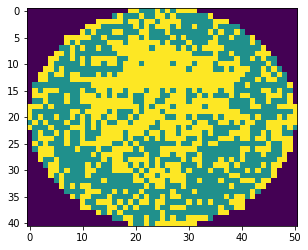

wafer_id:309, ウエハサイズ:41x51, スタンプサイズ:4x4, oDefects:400, nDefects:747, p=53.548


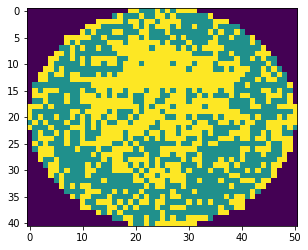

wafer_id:310, ウエハサイズ:41x51, スタンプサイズ:2x2, oDefects:390, nDefects:764, p=51.047


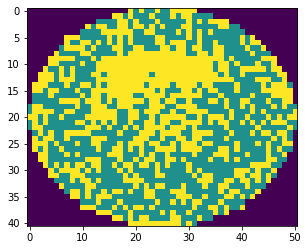

wafer_id:310, ウエハサイズ:41x51, スタンプサイズ:3x2, oDefects:388, nDefects:756, p=51.323


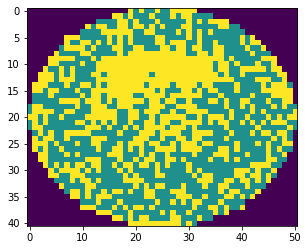

wafer_id:310, ウエハサイズ:41x51, スタンプサイズ:4x2, oDefects:390, nDefects:764, p=51.047


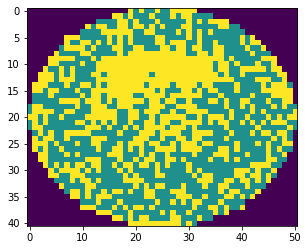

wafer_id:311, ウエハサイズ:41x51, スタンプサイズ:2x2, oDefects:387, nDefects:752, p=51.463


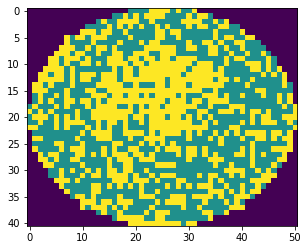

wafer_id:311, ウエハサイズ:41x51, スタンプサイズ:3x2, oDefects:384, nDefects:744, p=51.613


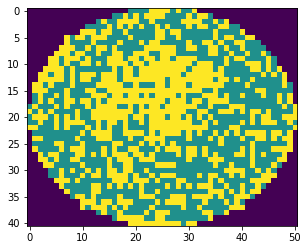

wafer_id:311, ウエハサイズ:41x51, スタンプサイズ:4x2, oDefects:387, nDefects:752, p=51.463


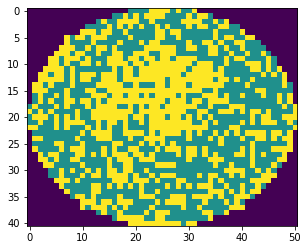

wafer_id:313, ウエハサイズ:81x73, スタンプサイズ:2x2, oDefects:1172, nDefects:2306, p=50.824


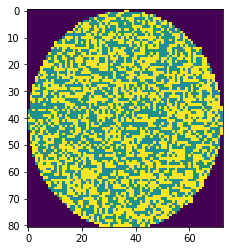

wafer_id:313, ウエハサイズ:81x73, スタンプサイズ:3x2, oDefects:1181, nDefects:2320, p=50.905


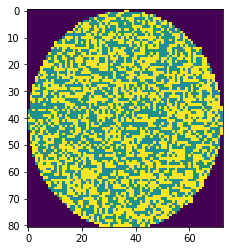

wafer_id:313, ウエハサイズ:81x73, スタンプサイズ:4x2, oDefects:1172, nDefects:2306, p=50.824


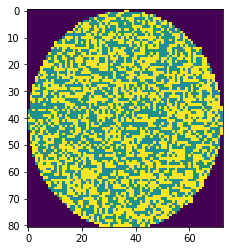

wafer_id:322, ウエハサイズ:41x51, スタンプサイズ:2x4, oDefects:396, nDefects:778, p=50.900


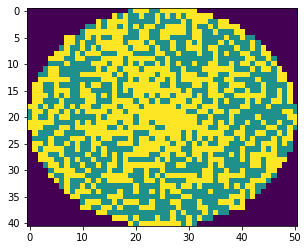

wafer_id:322, ウエハサイズ:41x51, スタンプサイズ:3x4, oDefects:394, nDefects:770, p=51.169


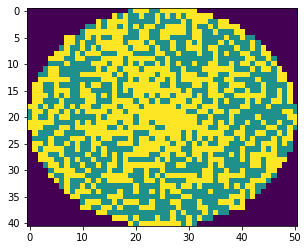

wafer_id:322, ウエハサイズ:41x51, スタンプサイズ:4x4, oDefects:396, nDefects:778, p=50.900


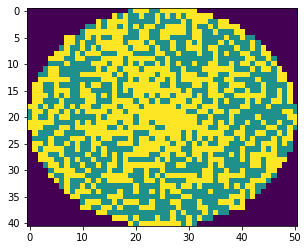

wafer_id:336, ウエハサイズ:41x51, スタンプサイズ:2x4, oDefects:372, nDefects:743, p=50.067


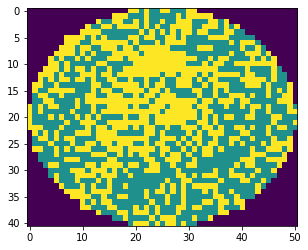

wafer_id:336, ウエハサイズ:41x51, スタンプサイズ:3x4, oDefects:370, nDefects:736, p=50.272


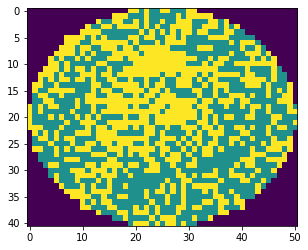

wafer_id:336, ウエハサイズ:41x51, スタンプサイズ:4x4, oDefects:372, nDefects:743, p=50.067


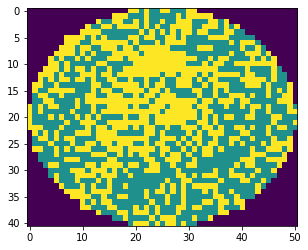

wafer_id:337, ウエハサイズ:41x51, スタンプサイズ:2x2, oDefects:414, nDefects:815, p=50.798


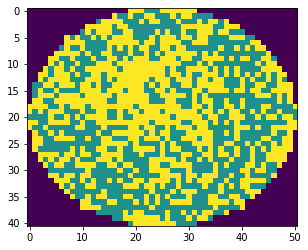

wafer_id:337, ウエハサイズ:41x51, スタンプサイズ:3x2, oDefects:407, nDefects:804, p=50.622


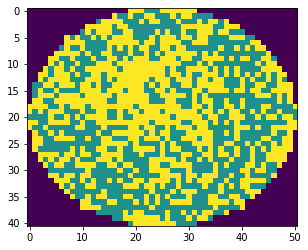

wafer_id:337, ウエハサイズ:41x51, スタンプサイズ:4x2, oDefects:414, nDefects:815, p=50.798


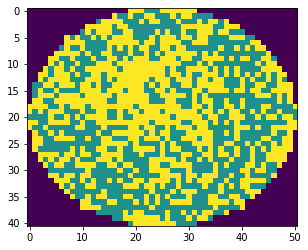

wafer_id:337, ウエハサイズ:41x51, スタンプサイズ:2x3, oDefects:422, nDefects:815, p=51.779


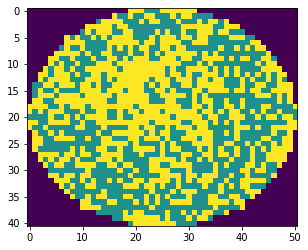

wafer_id:337, ウエハサイズ:41x51, スタンプサイズ:3x3, oDefects:416, nDefects:804, p=51.741


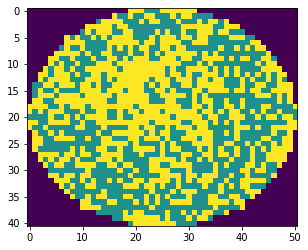

wafer_id:337, ウエハサイズ:41x51, スタンプサイズ:4x3, oDefects:422, nDefects:815, p=51.779


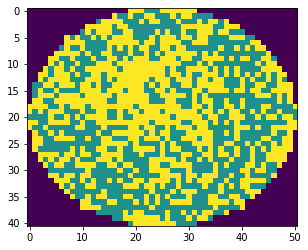

wafer_id:337, ウエハサイズ:41x51, スタンプサイズ:2x4, oDefects:391, nDefects:767, p=50.978


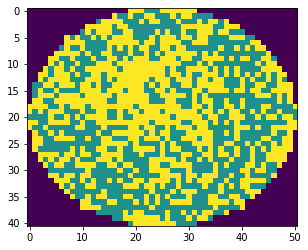

wafer_id:337, ウエハサイズ:41x51, スタンプサイズ:3x4, oDefects:386, nDefects:756, p=51.058


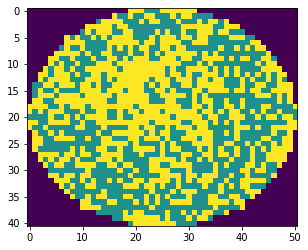

wafer_id:337, ウエハサイズ:41x51, スタンプサイズ:4x4, oDefects:391, nDefects:767, p=50.978


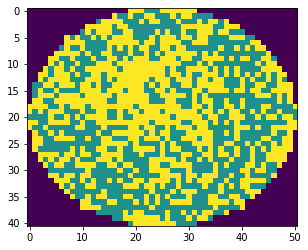

wafer_id:338, ウエハサイズ:41x51, スタンプサイズ:2x2, oDefects:428, nDefects:821, p=52.132


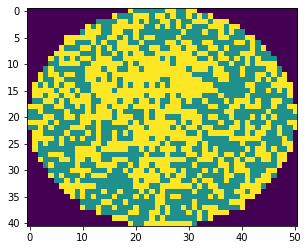

wafer_id:338, ウエハサイズ:41x51, スタンプサイズ:3x2, oDefects:425, nDefects:814, p=52.211


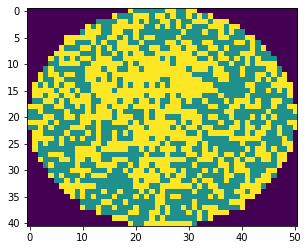

wafer_id:338, ウエハサイズ:41x51, スタンプサイズ:4x2, oDefects:428, nDefects:821, p=52.132


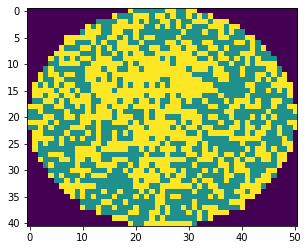

wafer_id:338, ウエハサイズ:41x51, スタンプサイズ:2x3, oDefects:416, nDefects:821, p=50.670


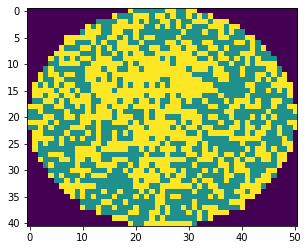

wafer_id:338, ウエハサイズ:41x51, スタンプサイズ:3x3, oDefects:416, nDefects:814, p=51.106


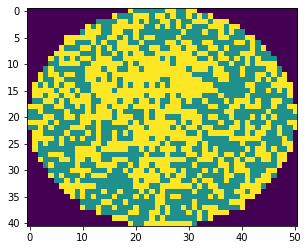

wafer_id:338, ウエハサイズ:41x51, スタンプサイズ:4x3, oDefects:416, nDefects:821, p=50.670


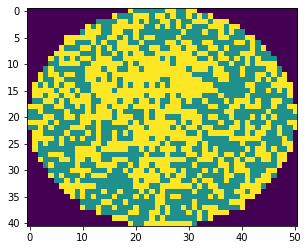

wafer_id:338, ウエハサイズ:41x51, スタンプサイズ:2x4, oDefects:406, nDefects:779, p=52.118


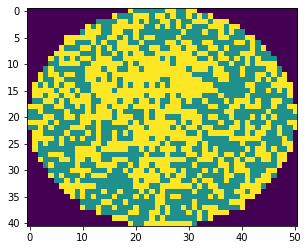

wafer_id:338, ウエハサイズ:41x51, スタンプサイズ:3x4, oDefects:406, nDefects:772, p=52.591


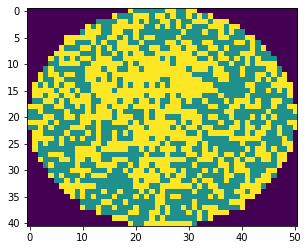

wafer_id:338, ウエハサイズ:41x51, スタンプサイズ:4x4, oDefects:406, nDefects:779, p=52.118


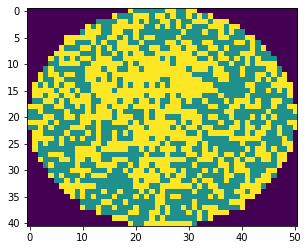

wafer_id:339, ウエハサイズ:41x51, スタンプサイズ:2x2, oDefects:414, nDefects:814, p=50.860


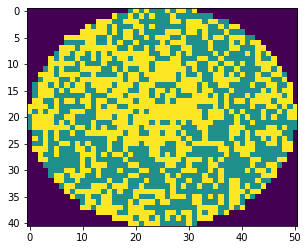

wafer_id:339, ウエハサイズ:41x51, スタンプサイズ:3x2, oDefects:405, nDefects:801, p=50.562


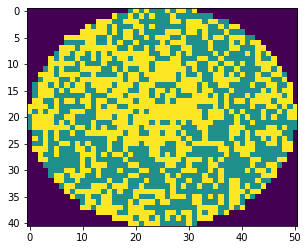

wafer_id:339, ウエハサイズ:41x51, スタンプサイズ:4x2, oDefects:414, nDefects:814, p=50.860


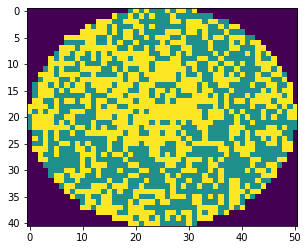

wafer_id:339, ウエハサイズ:41x51, スタンプサイズ:2x3, oDefects:417, nDefects:814, p=51.229


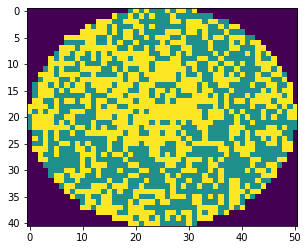

wafer_id:339, ウエハサイズ:41x51, スタンプサイズ:3x3, oDefects:412, nDefects:801, p=51.436


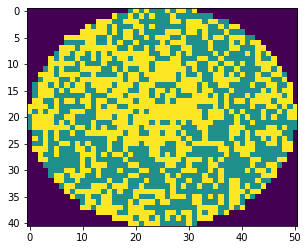

wafer_id:339, ウエハサイズ:41x51, スタンプサイズ:4x3, oDefects:417, nDefects:814, p=51.229


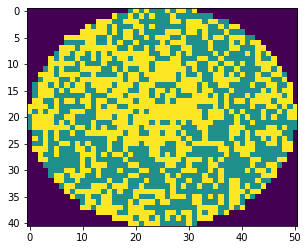

wafer_id:339, ウエハサイズ:41x51, スタンプサイズ:2x4, oDefects:383, nDefects:765, p=50.065


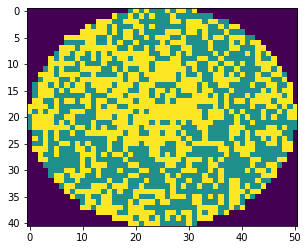

wafer_id:339, ウエハサイズ:41x51, スタンプサイズ:3x4, oDefects:376, nDefects:752, p=50.000


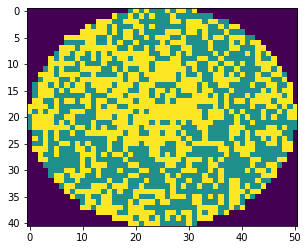

wafer_id:339, ウエハサイズ:41x51, スタンプサイズ:4x4, oDefects:383, nDefects:765, p=50.065


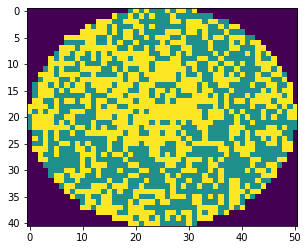

wafer_id:341, ウエハサイズ:41x51, スタンプサイズ:2x2, oDefects:432, nDefects:843, p=51.246


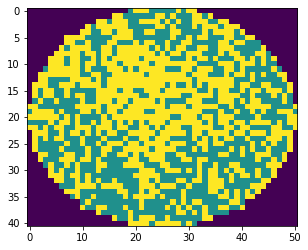

wafer_id:341, ウエハサイズ:41x51, スタンプサイズ:3x2, oDefects:430, nDefects:835, p=51.497


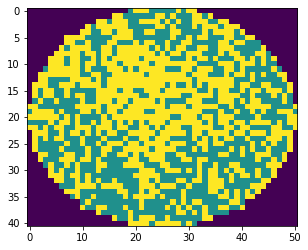

wafer_id:341, ウエハサイズ:41x51, スタンプサイズ:4x2, oDefects:432, nDefects:843, p=51.246


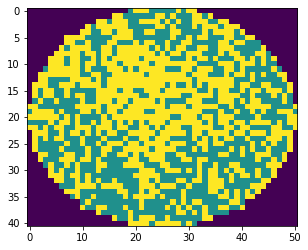

wafer_id:341, ウエハサイズ:41x51, スタンプサイズ:2x3, oDefects:438, nDefects:843, p=51.957


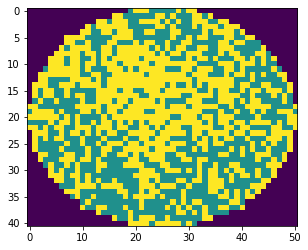

wafer_id:341, ウエハサイズ:41x51, スタンプサイズ:3x3, oDefects:435, nDefects:835, p=52.096


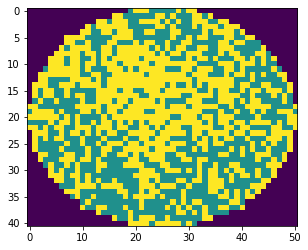

wafer_id:341, ウエハサイズ:41x51, スタンプサイズ:4x3, oDefects:438, nDefects:843, p=51.957


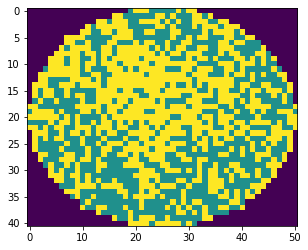

wafer_id:341, ウエハサイズ:41x51, スタンプサイズ:2x4, oDefects:419, nDefects:800, p=52.375


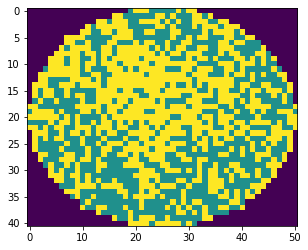

wafer_id:341, ウエハサイズ:41x51, スタンプサイズ:3x4, oDefects:417, nDefects:792, p=52.652


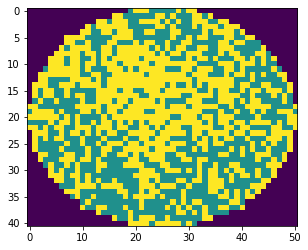

wafer_id:341, ウエハサイズ:41x51, スタンプサイズ:4x4, oDefects:419, nDefects:800, p=52.375


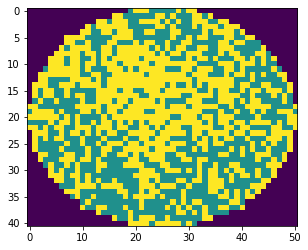

wafer_id:342, ウエハサイズ:41x51, スタンプサイズ:2x2, oDefects:450, nDefects:853, p=52.755


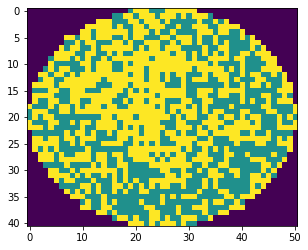

wafer_id:342, ウエハサイズ:41x51, スタンプサイズ:3x2, oDefects:447, nDefects:843, p=53.025


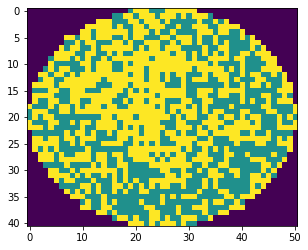

wafer_id:342, ウエハサイズ:41x51, スタンプサイズ:4x2, oDefects:450, nDefects:853, p=52.755


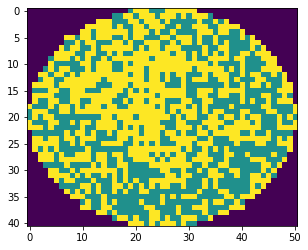

wafer_id:342, ウエハサイズ:41x51, スタンプサイズ:2x3, oDefects:441, nDefects:853, p=51.700


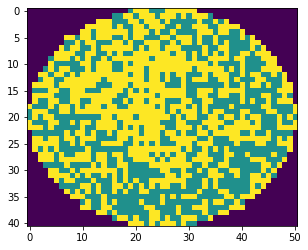

wafer_id:342, ウエハサイズ:41x51, スタンプサイズ:3x3, oDefects:436, nDefects:843, p=51.720


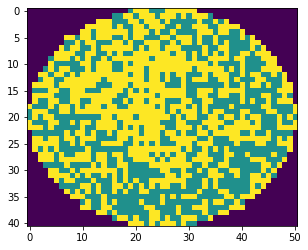

wafer_id:342, ウエハサイズ:41x51, スタンプサイズ:4x3, oDefects:441, nDefects:853, p=51.700


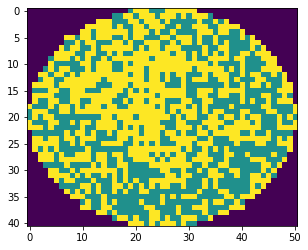

wafer_id:342, ウエハサイズ:41x51, スタンプサイズ:2x4, oDefects:428, nDefects:809, p=52.905


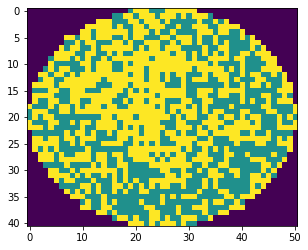

wafer_id:342, ウエハサイズ:41x51, スタンプサイズ:3x4, oDefects:425, nDefects:799, p=53.191


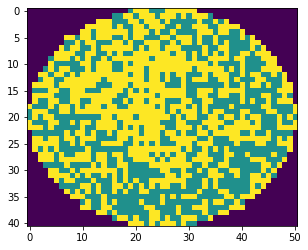

wafer_id:342, ウエハサイズ:41x51, スタンプサイズ:4x4, oDefects:428, nDefects:809, p=52.905


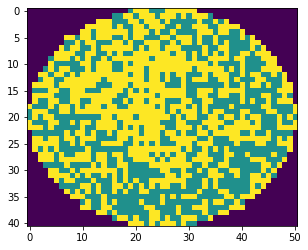

wafer_id:343, ウエハサイズ:41x51, スタンプサイズ:2x2, oDefects:429, nDefects:827, p=51.874


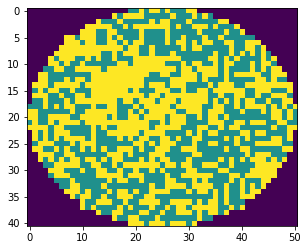

wafer_id:343, ウエハサイズ:41x51, スタンプサイズ:3x2, oDefects:429, nDefects:822, p=52.190


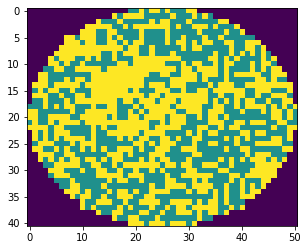

wafer_id:343, ウエハサイズ:41x51, スタンプサイズ:4x2, oDefects:429, nDefects:827, p=51.874


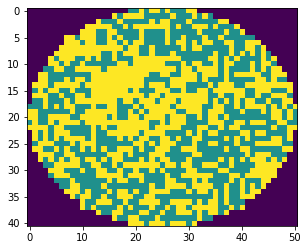

wafer_id:343, ウエハサイズ:41x51, スタンプサイズ:2x3, oDefects:419, nDefects:827, p=50.665


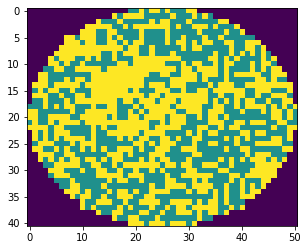

wafer_id:343, ウエハサイズ:41x51, スタンプサイズ:3x3, oDefects:418, nDefects:822, p=50.852


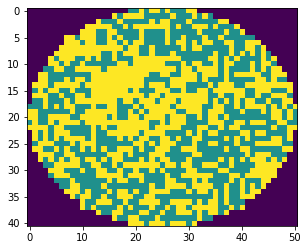

wafer_id:343, ウエハサイズ:41x51, スタンプサイズ:4x3, oDefects:419, nDefects:827, p=50.665


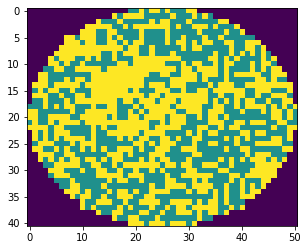

wafer_id:343, ウエハサイズ:41x51, スタンプサイズ:2x4, oDefects:403, nDefects:771, p=52.270


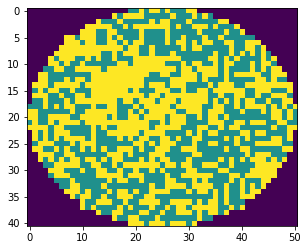

wafer_id:343, ウエハサイズ:41x51, スタンプサイズ:3x4, oDefects:401, nDefects:766, p=52.350


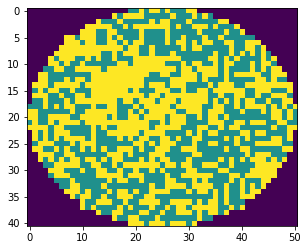

wafer_id:343, ウエハサイズ:41x51, スタンプサイズ:4x4, oDefects:403, nDefects:771, p=52.270


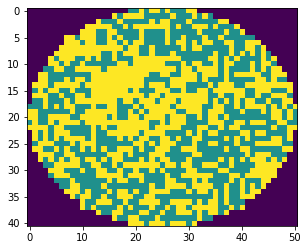

wafer_id:344, ウエハサイズ:41x51, スタンプサイズ:2x2, oDefects:406, nDefects:800, p=50.750


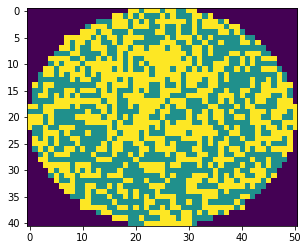

wafer_id:344, ウエハサイズ:41x51, スタンプサイズ:3x2, oDefects:403, nDefects:791, p=50.948


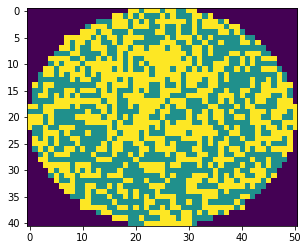

wafer_id:344, ウエハサイズ:41x51, スタンプサイズ:4x2, oDefects:406, nDefects:800, p=50.750


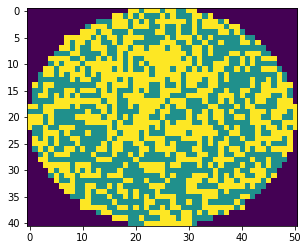

wafer_id:346, ウエハサイズ:41x51, スタンプサイズ:2x2, oDefects:432, nDefects:831, p=51.986


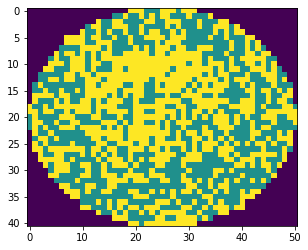

wafer_id:346, ウエハサイズ:41x51, スタンプサイズ:3x2, oDefects:428, nDefects:821, p=52.132


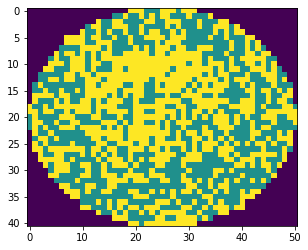

wafer_id:346, ウエハサイズ:41x51, スタンプサイズ:4x2, oDefects:432, nDefects:831, p=51.986


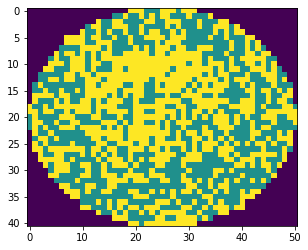

wafer_id:346, ウエハサイズ:41x51, スタンプサイズ:2x3, oDefects:419, nDefects:831, p=50.421


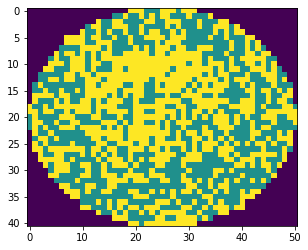

wafer_id:346, ウエハサイズ:41x51, スタンプサイズ:3x3, oDefects:416, nDefects:821, p=50.670


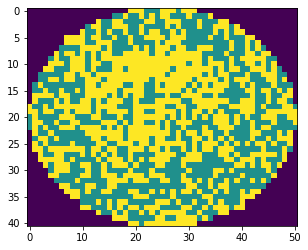

wafer_id:346, ウエハサイズ:41x51, スタンプサイズ:4x3, oDefects:419, nDefects:831, p=50.421


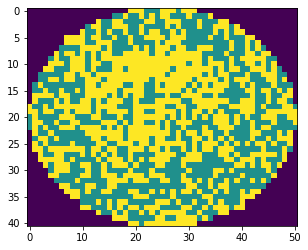

wafer_id:346, ウエハサイズ:41x51, スタンプサイズ:2x4, oDefects:419, nDefects:786, p=53.308


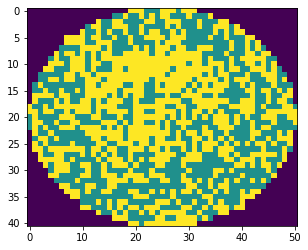

wafer_id:346, ウエハサイズ:41x51, スタンプサイズ:3x4, oDefects:416, nDefects:776, p=53.608


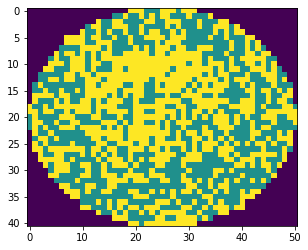

wafer_id:346, ウエハサイズ:41x51, スタンプサイズ:4x4, oDefects:419, nDefects:786, p=53.308


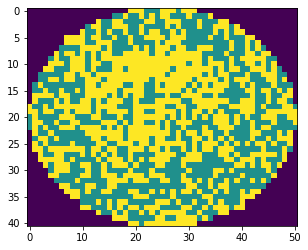

wafer_id:347, ウエハサイズ:41x51, スタンプサイズ:2x2, oDefects:447, nDefects:855, p=52.281


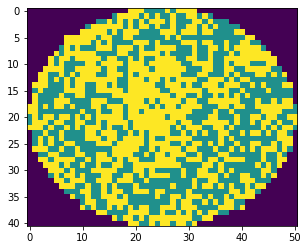

wafer_id:347, ウエハサイズ:41x51, スタンプサイズ:3x2, oDefects:438, nDefects:841, p=52.081


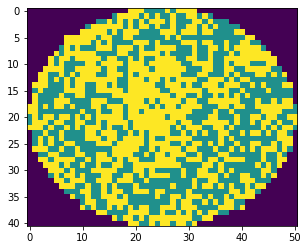

wafer_id:347, ウエハサイズ:41x51, スタンプサイズ:4x2, oDefects:447, nDefects:855, p=52.281


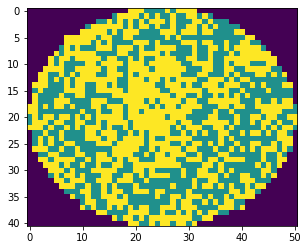

wafer_id:347, ウエハサイズ:41x51, スタンプサイズ:2x3, oDefects:443, nDefects:855, p=51.813


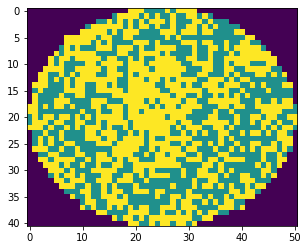

wafer_id:347, ウエハサイズ:41x51, スタンプサイズ:3x3, oDefects:434, nDefects:841, p=51.605


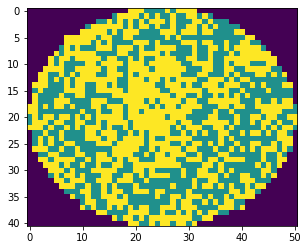

wafer_id:347, ウエハサイズ:41x51, スタンプサイズ:4x3, oDefects:443, nDefects:855, p=51.813


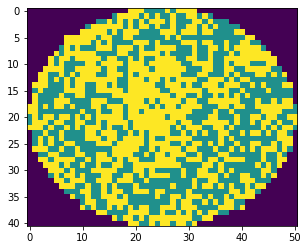

wafer_id:347, ウエハサイズ:41x51, スタンプサイズ:2x4, oDefects:409, nDefects:808, p=50.619


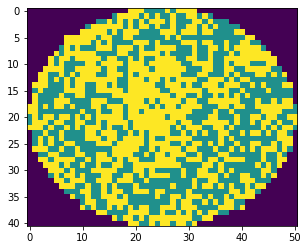

wafer_id:347, ウエハサイズ:41x51, スタンプサイズ:3x4, oDefects:401, nDefects:794, p=50.504


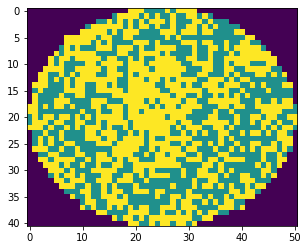

wafer_id:347, ウエハサイズ:41x51, スタンプサイズ:4x4, oDefects:409, nDefects:808, p=50.619


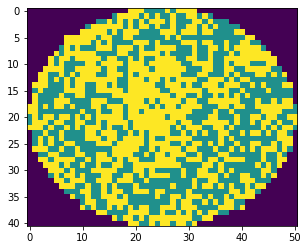

wafer_id:348, ウエハサイズ:41x51, スタンプサイズ:2x2, oDefects:449, nDefects:829, p=54.162


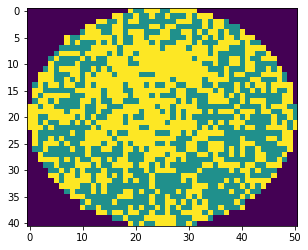

wafer_id:348, ウエハサイズ:41x51, スタンプサイズ:3x2, oDefects:444, nDefects:819, p=54.212


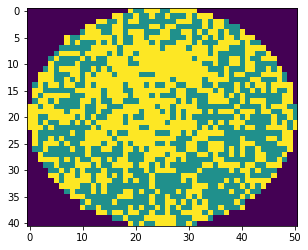

wafer_id:348, ウエハサイズ:41x51, スタンプサイズ:4x2, oDefects:449, nDefects:829, p=54.162


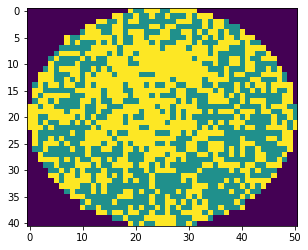

wafer_id:348, ウエハサイズ:41x51, スタンプサイズ:2x3, oDefects:427, nDefects:829, p=51.508


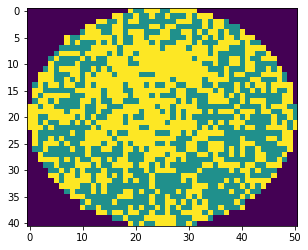

wafer_id:348, ウエハサイズ:41x51, スタンプサイズ:3x3, oDefects:424, nDefects:819, p=51.770


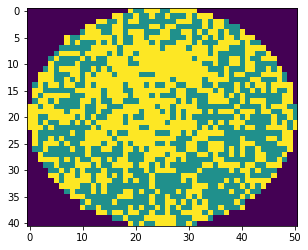

wafer_id:348, ウエハサイズ:41x51, スタンプサイズ:4x3, oDefects:427, nDefects:829, p=51.508


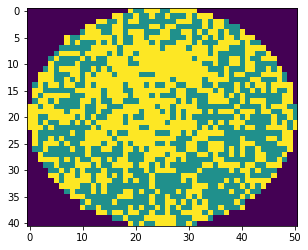

wafer_id:348, ウエハサイズ:41x51, スタンプサイズ:2x4, oDefects:413, nDefects:788, p=52.411


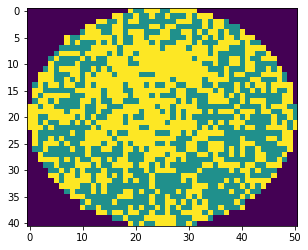

wafer_id:348, ウエハサイズ:41x51, スタンプサイズ:3x4, oDefects:409, nDefects:778, p=52.571


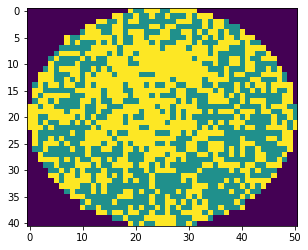

wafer_id:348, ウエハサイズ:41x51, スタンプサイズ:4x4, oDefects:413, nDefects:788, p=52.411


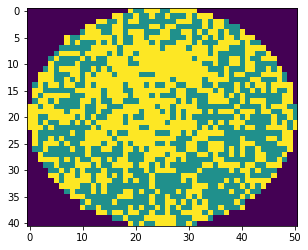

wafer_id:349, ウエハサイズ:41x51, スタンプサイズ:2x2, oDefects:470, nDefects:856, p=54.907


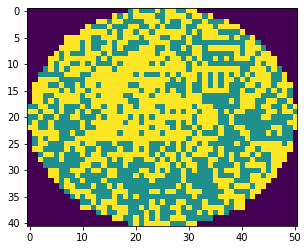

wafer_id:349, ウエハサイズ:41x51, スタンプサイズ:3x2, oDefects:467, nDefects:848, p=55.071


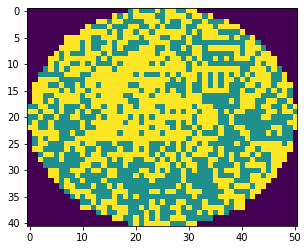

wafer_id:349, ウエハサイズ:41x51, スタンプサイズ:4x2, oDefects:470, nDefects:856, p=54.907


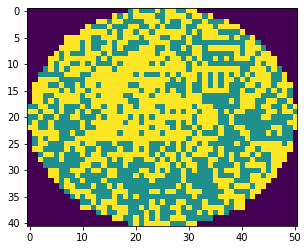

wafer_id:349, ウエハサイズ:41x51, スタンプサイズ:2x3, oDefects:454, nDefects:856, p=53.037


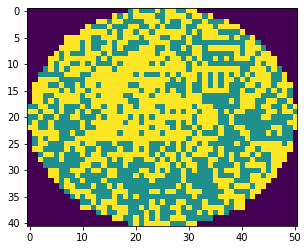

wafer_id:349, ウエハサイズ:41x51, スタンプサイズ:3x3, oDefects:452, nDefects:848, p=53.302


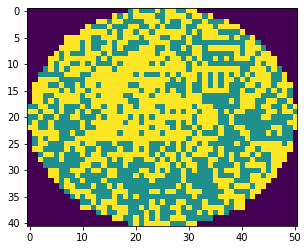

wafer_id:349, ウエハサイズ:41x51, スタンプサイズ:4x3, oDefects:454, nDefects:856, p=53.037


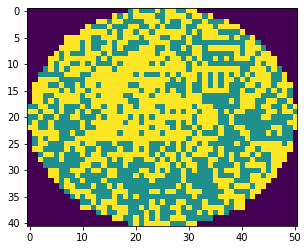

wafer_id:349, ウエハサイズ:41x51, スタンプサイズ:2x4, oDefects:436, nDefects:803, p=54.296


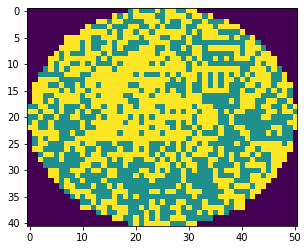

wafer_id:349, ウエハサイズ:41x51, スタンプサイズ:3x4, oDefects:433, nDefects:795, p=54.465


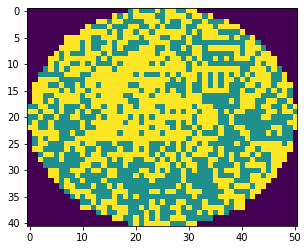

wafer_id:349, ウエハサイズ:41x51, スタンプサイズ:4x4, oDefects:436, nDefects:803, p=54.296


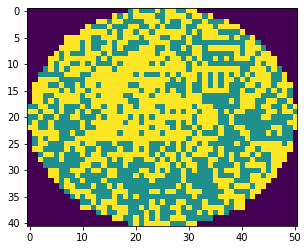

wafer_id:350, ウエハサイズ:41x51, スタンプサイズ:2x2, oDefects:491, nDefects:872, p=56.307


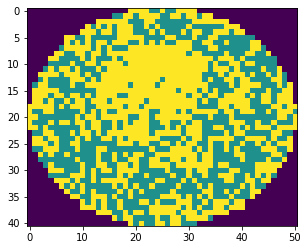

wafer_id:350, ウエハサイズ:41x51, スタンプサイズ:3x2, oDefects:487, nDefects:862, p=56.497


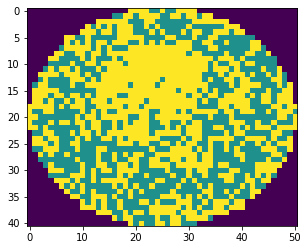

wafer_id:350, ウエハサイズ:41x51, スタンプサイズ:4x2, oDefects:491, nDefects:872, p=56.307


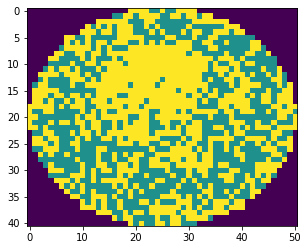

wafer_id:350, ウエハサイズ:41x51, スタンプサイズ:2x3, oDefects:489, nDefects:872, p=56.078


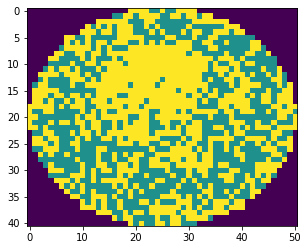

wafer_id:350, ウエハサイズ:41x51, スタンプサイズ:3x3, oDefects:484, nDefects:862, p=56.148


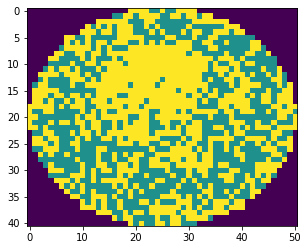

wafer_id:350, ウエハサイズ:41x51, スタンプサイズ:4x3, oDefects:489, nDefects:872, p=56.078


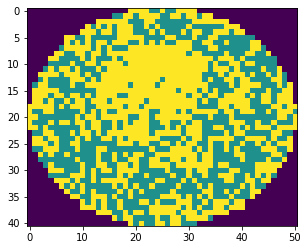

wafer_id:350, ウエハサイズ:41x51, スタンプサイズ:2x4, oDefects:456, nDefects:826, p=55.206


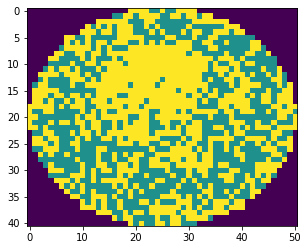

wafer_id:350, ウエハサイズ:41x51, スタンプサイズ:3x4, oDefects:453, nDefects:816, p=55.515


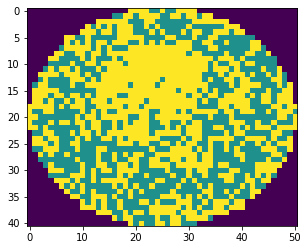

wafer_id:350, ウエハサイズ:41x51, スタンプサイズ:4x4, oDefects:456, nDefects:826, p=55.206


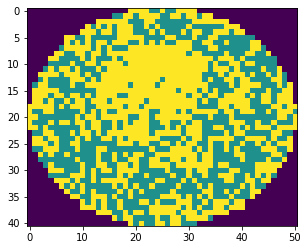

wafer_id:351, ウエハサイズ:41x51, スタンプサイズ:2x2, oDefects:422, nDefects:817, p=51.652


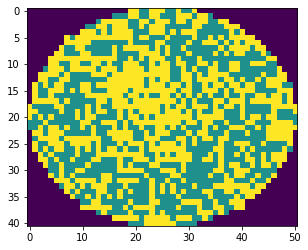

wafer_id:351, ウエハサイズ:41x51, スタンプサイズ:3x2, oDefects:413, nDefects:803, p=51.432


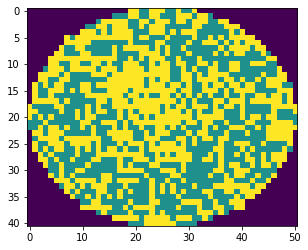

wafer_id:351, ウエハサイズ:41x51, スタンプサイズ:4x2, oDefects:422, nDefects:817, p=51.652


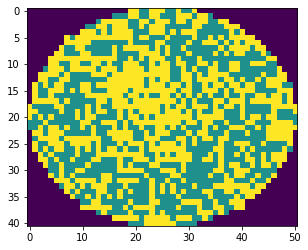

wafer_id:351, ウエハサイズ:41x51, スタンプサイズ:2x4, oDefects:393, nDefects:766, p=51.305


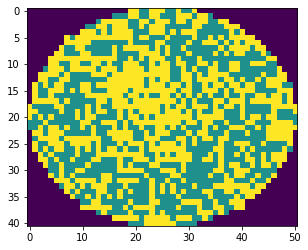

wafer_id:351, ウエハサイズ:41x51, スタンプサイズ:3x4, oDefects:384, nDefects:752, p=51.064


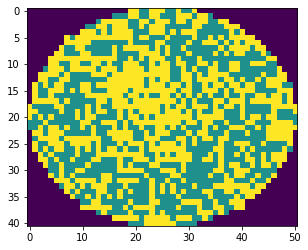

wafer_id:351, ウエハサイズ:41x51, スタンプサイズ:4x4, oDefects:393, nDefects:766, p=51.305


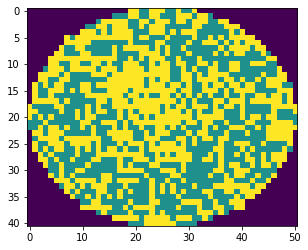

wafer_id:352, ウエハサイズ:41x51, スタンプサイズ:2x2, oDefects:447, nDefects:850, p=52.588


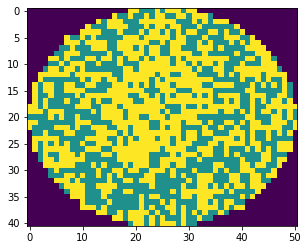

wafer_id:352, ウエハサイズ:41x51, スタンプサイズ:3x2, oDefects:443, nDefects:841, p=52.675


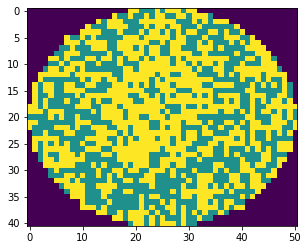

wafer_id:352, ウエハサイズ:41x51, スタンプサイズ:4x2, oDefects:447, nDefects:850, p=52.588


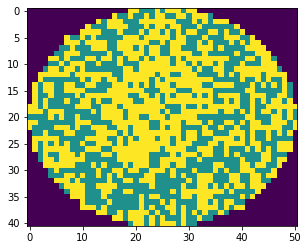

wafer_id:352, ウエハサイズ:41x51, スタンプサイズ:2x4, oDefects:413, nDefects:797, p=51.819


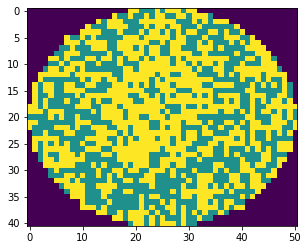

wafer_id:352, ウエハサイズ:41x51, スタンプサイズ:3x4, oDefects:408, nDefects:788, p=51.777


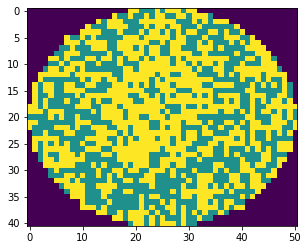

wafer_id:352, ウエハサイズ:41x51, スタンプサイズ:4x4, oDefects:413, nDefects:797, p=51.819


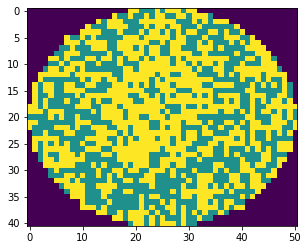

wafer_id:353, ウエハサイズ:41x51, スタンプサイズ:2x2, oDefects:406, nDefects:802, p=50.623


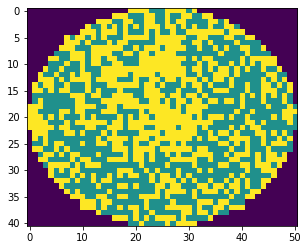

wafer_id:353, ウエハサイズ:41x51, スタンプサイズ:3x2, oDefects:399, nDefects:791, p=50.442


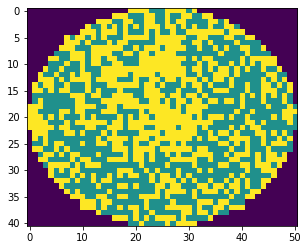

wafer_id:353, ウエハサイズ:41x51, スタンプサイズ:4x2, oDefects:406, nDefects:802, p=50.623


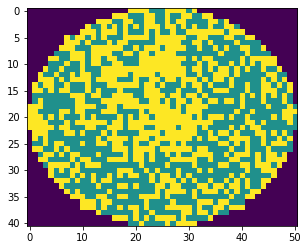

wafer_id:354, ウエハサイズ:41x51, スタンプサイズ:2x2, oDefects:459, nDefects:850, p=54.000


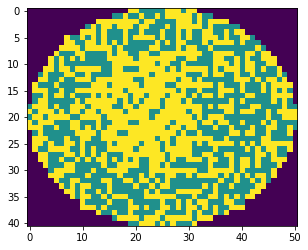

wafer_id:354, ウエハサイズ:41x51, スタンプサイズ:3x2, oDefects:449, nDefects:835, p=53.772


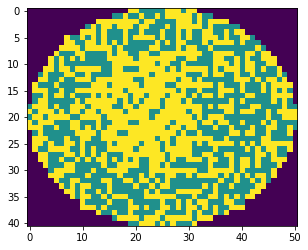

wafer_id:354, ウエハサイズ:41x51, スタンプサイズ:4x2, oDefects:459, nDefects:850, p=54.000


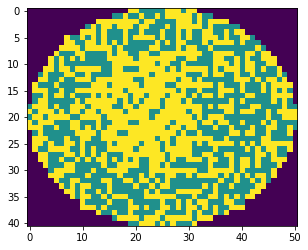

wafer_id:354, ウエハサイズ:41x51, スタンプサイズ:2x3, oDefects:451, nDefects:850, p=53.059


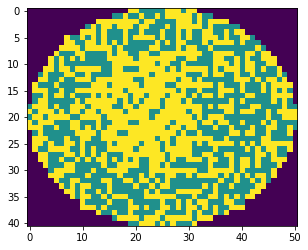

wafer_id:354, ウエハサイズ:41x51, スタンプサイズ:3x3, oDefects:442, nDefects:835, p=52.934


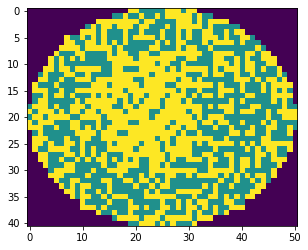

wafer_id:354, ウエハサイズ:41x51, スタンプサイズ:4x3, oDefects:451, nDefects:850, p=53.059


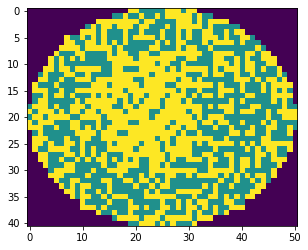

wafer_id:354, ウエハサイズ:41x51, スタンプサイズ:2x4, oDefects:429, nDefects:804, p=53.358


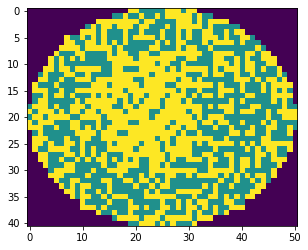

wafer_id:354, ウエハサイズ:41x51, スタンプサイズ:3x4, oDefects:419, nDefects:789, p=53.105


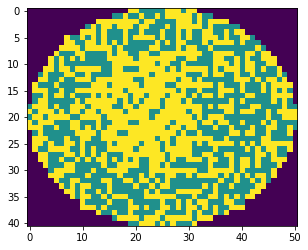

wafer_id:354, ウエハサイズ:41x51, スタンプサイズ:4x4, oDefects:429, nDefects:804, p=53.358


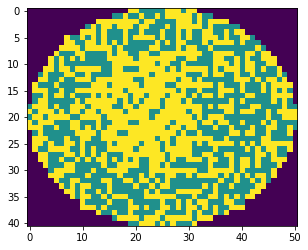

wafer_id:355, ウエハサイズ:41x51, スタンプサイズ:2x2, oDefects:435, nDefects:834, p=52.158


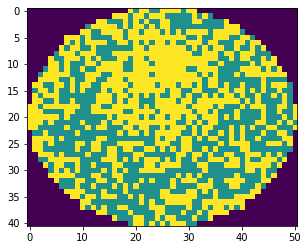

wafer_id:355, ウエハサイズ:41x51, スタンプサイズ:3x2, oDefects:434, nDefects:826, p=52.542


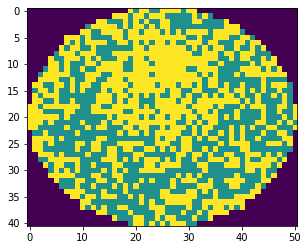

wafer_id:355, ウエハサイズ:41x51, スタンプサイズ:4x2, oDefects:435, nDefects:834, p=52.158


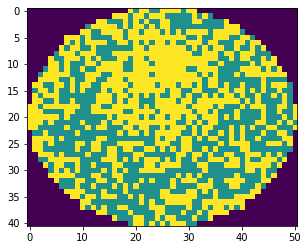

wafer_id:355, ウエハサイズ:41x51, スタンプサイズ:2x3, oDefects:422, nDefects:834, p=50.600


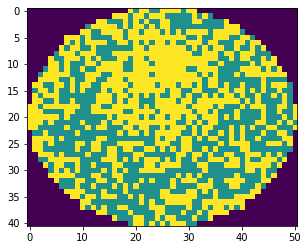

wafer_id:355, ウエハサイズ:41x51, スタンプサイズ:3x3, oDefects:419, nDefects:826, p=50.726


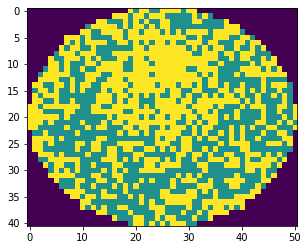

wafer_id:355, ウエハサイズ:41x51, スタンプサイズ:4x3, oDefects:422, nDefects:834, p=50.600


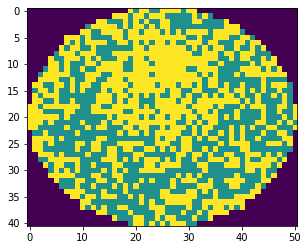

wafer_id:355, ウエハサイズ:41x51, スタンプサイズ:2x4, oDefects:404, nDefects:788, p=51.269


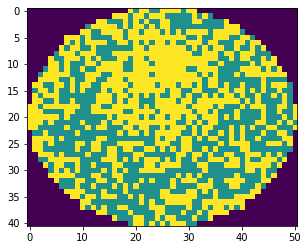

wafer_id:355, ウエハサイズ:41x51, スタンプサイズ:3x4, oDefects:401, nDefects:780, p=51.410


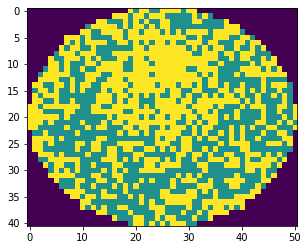

wafer_id:355, ウエハサイズ:41x51, スタンプサイズ:4x4, oDefects:404, nDefects:788, p=51.269


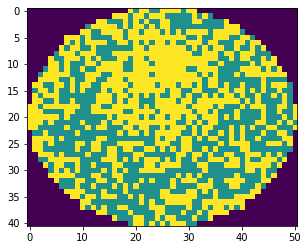

wafer_id:357, ウエハサイズ:58x60, スタンプサイズ:2x2, oDefects:645, nDefects:1247, p=51.724


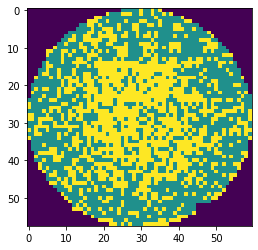

wafer_id:357, ウエハサイズ:58x60, スタンプサイズ:3x2, oDefects:638, nDefects:1236, p=51.618


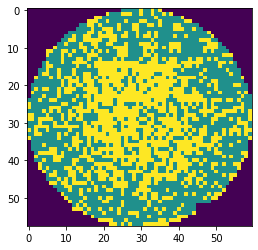

wafer_id:357, ウエハサイズ:58x60, スタンプサイズ:4x2, oDefects:634, nDefects:1226, p=51.713


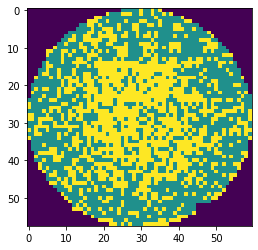

wafer_id:357, ウエハサイズ:58x60, スタンプサイズ:2x3, oDefects:631, nDefects:1239, p=50.928


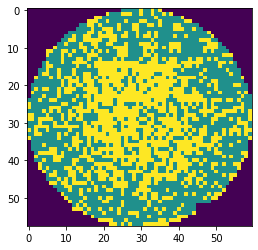

wafer_id:357, ウエハサイズ:58x60, スタンプサイズ:3x3, oDefects:626, nDefects:1228, p=50.977


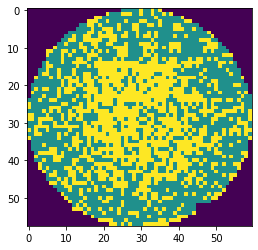

wafer_id:357, ウエハサイズ:58x60, スタンプサイズ:4x3, oDefects:623, nDefects:1218, p=51.149


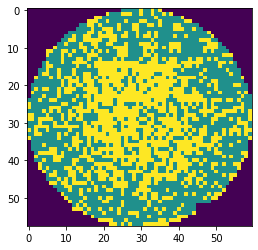

wafer_id:357, ウエハサイズ:58x60, スタンプサイズ:2x4, oDefects:632, nDefects:1228, p=51.466


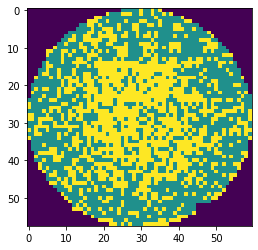

wafer_id:357, ウエハサイズ:58x60, スタンプサイズ:3x4, oDefects:627, nDefects:1217, p=51.520


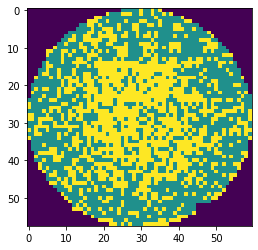

wafer_id:357, ウエハサイズ:58x60, スタンプサイズ:4x4, oDefects:624, nDefects:1207, p=51.698


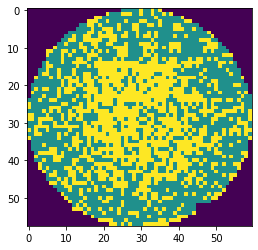

wafer_id:361, ウエハサイズ:48x52, スタンプサイズ:2x4, oDefects:702, nDefects:1199, p=58.549


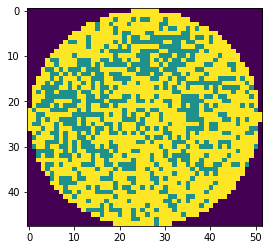

wafer_id:361, ウエハサイズ:48x52, スタンプサイズ:3x4, oDefects:702, nDefects:1199, p=58.549


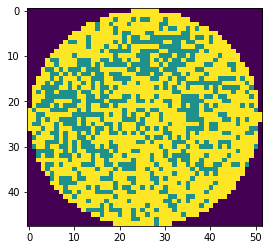

wafer_id:361, ウエハサイズ:48x52, スタンプサイズ:4x4, oDefects:702, nDefects:1199, p=58.549


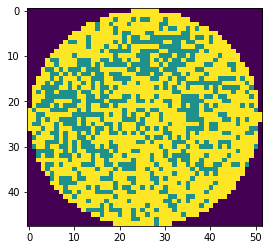

wafer_id:362, ウエハサイズ:56x57, スタンプサイズ:2x3, oDefects:841, nDefects:1433, p=58.688


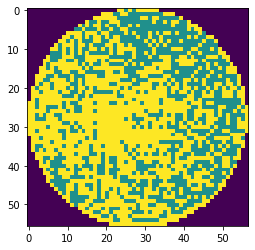

wafer_id:362, ウエハサイズ:56x57, スタンプサイズ:3x3, oDefects:825, nDefects:1406, p=58.677


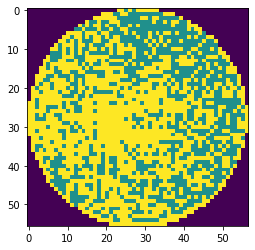

wafer_id:362, ウエハサイズ:56x57, スタンプサイズ:4x3, oDefects:841, nDefects:1433, p=58.688


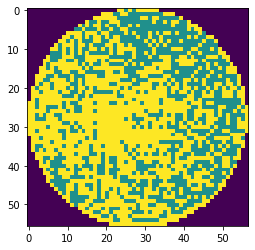

wafer_id:362, ウエハサイズ:56x57, スタンプサイズ:2x4, oDefects:820, nDefects:1414, p=57.992


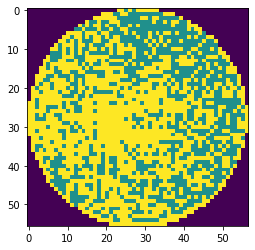

wafer_id:362, ウエハサイズ:56x57, スタンプサイズ:3x4, oDefects:806, nDefects:1387, p=58.111


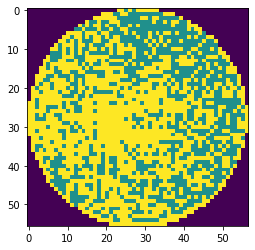

wafer_id:362, ウエハサイズ:56x57, スタンプサイズ:4x4, oDefects:820, nDefects:1414, p=57.992


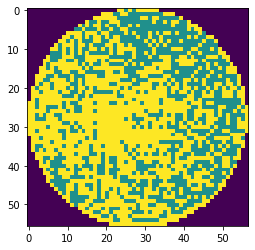

wafer_id:364, ウエハサイズ:58x60, スタンプサイズ:2x2, oDefects:791, nDefects:1488, p=53.159


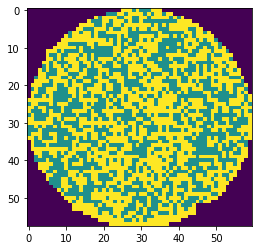

wafer_id:364, ウエハサイズ:58x60, スタンプサイズ:3x2, oDefects:777, nDefects:1472, p=52.785


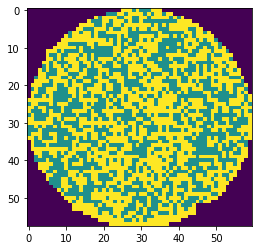

wafer_id:364, ウエハサイズ:58x60, スタンプサイズ:4x2, oDefects:763, nDefects:1454, p=52.476


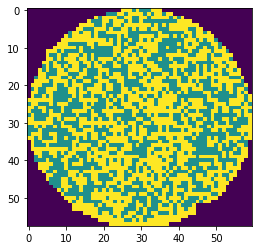

wafer_id:364, ウエハサイズ:58x60, スタンプサイズ:2x3, oDefects:776, nDefects:1475, p=52.610


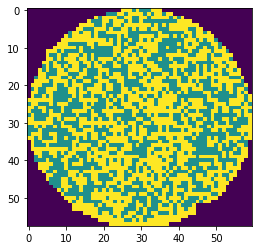

wafer_id:364, ウエハサイズ:58x60, スタンプサイズ:3x3, oDefects:763, nDefects:1459, p=52.296


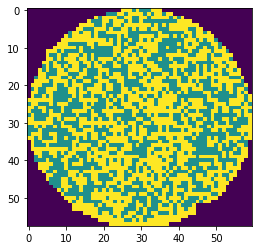

wafer_id:364, ウエハサイズ:58x60, スタンプサイズ:4x3, oDefects:751, nDefects:1441, p=52.117


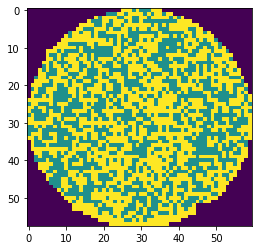

wafer_id:364, ウエハサイズ:58x60, スタンプサイズ:2x4, oDefects:743, nDefects:1458, p=50.960


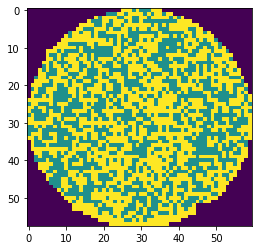

wafer_id:364, ウエハサイズ:58x60, スタンプサイズ:3x4, oDefects:731, nDefects:1442, p=50.693


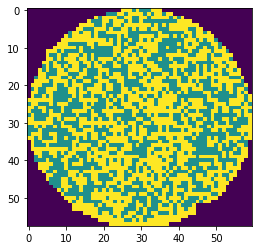

wafer_id:364, ウエハサイズ:58x60, スタンプサイズ:4x4, oDefects:720, nDefects:1424, p=50.562


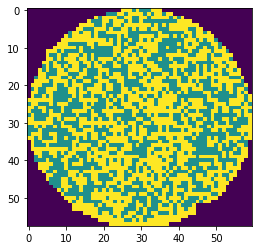

wafer_id:365, ウエハサイズ:58x60, スタンプサイズ:2x2, oDefects:951, nDefects:1632, p=58.272


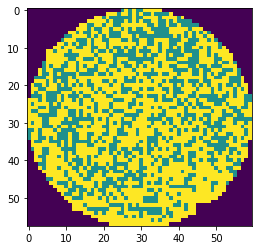

wafer_id:365, ウエハサイズ:58x60, スタンプサイズ:3x2, oDefects:937, nDefects:1616, p=57.983


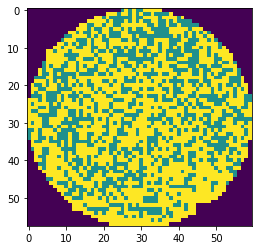

wafer_id:365, ウエハサイズ:58x60, スタンプサイズ:4x2, oDefects:920, nDefects:1596, p=57.644


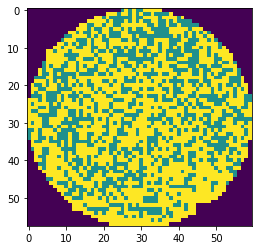

wafer_id:365, ウエハサイズ:58x60, スタンプサイズ:2x3, oDefects:933, nDefects:1616, p=57.735


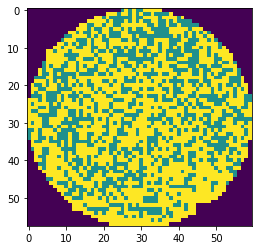

wafer_id:365, ウエハサイズ:58x60, スタンプサイズ:3x3, oDefects:920, nDefects:1600, p=57.500


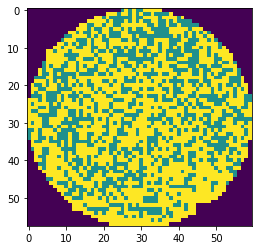

wafer_id:365, ウエハサイズ:58x60, スタンプサイズ:4x3, oDefects:905, nDefects:1580, p=57.278


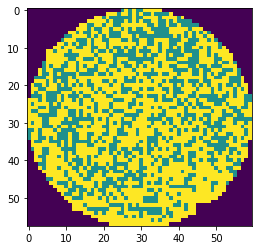

wafer_id:365, ウエハサイズ:58x60, スタンプサイズ:2x4, oDefects:903, nDefects:1600, p=56.438


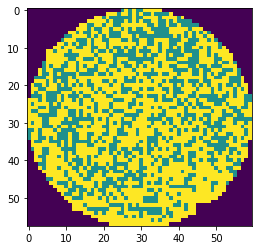

wafer_id:365, ウエハサイズ:58x60, スタンプサイズ:3x4, oDefects:891, nDefects:1584, p=56.250


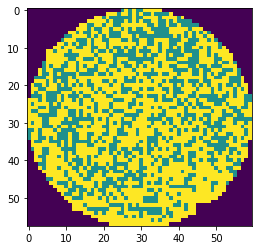

wafer_id:365, ウエハサイズ:58x60, スタンプサイズ:4x4, oDefects:877, nDefects:1564, p=56.074


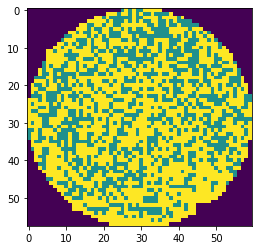

wafer_id:366, ウエハサイズ:81x73, スタンプサイズ:2x2, oDefects:1325, nDefects:2420, p=54.752


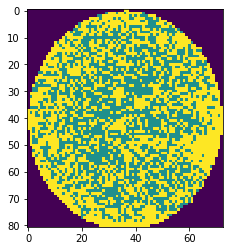

wafer_id:366, ウエハサイズ:81x73, スタンプサイズ:3x2, oDefects:1342, nDefects:2439, p=55.023


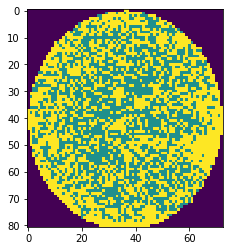

wafer_id:366, ウエハサイズ:81x73, スタンプサイズ:4x2, oDefects:1325, nDefects:2420, p=54.752


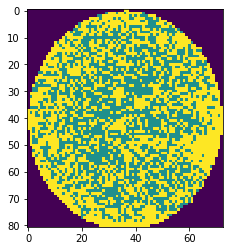

wafer_id:366, ウエハサイズ:81x73, スタンプサイズ:2x3, oDefects:1261, nDefects:2391, p=52.739


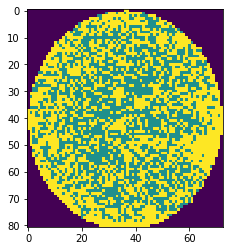

wafer_id:366, ウエハサイズ:81x73, スタンプサイズ:3x3, oDefects:1277, nDefects:2410, p=52.988


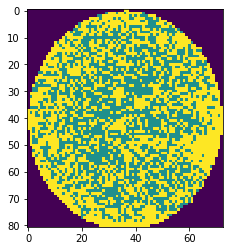

wafer_id:366, ウエハサイズ:81x73, スタンプサイズ:4x3, oDefects:1261, nDefects:2391, p=52.739


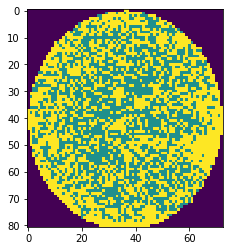

wafer_id:366, ウエハサイズ:81x73, スタンプサイズ:2x4, oDefects:1202, nDefects:2359, p=50.954


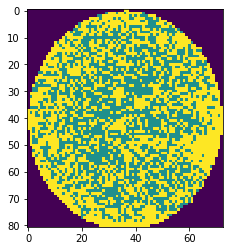

wafer_id:366, ウエハサイズ:81x73, スタンプサイズ:3x4, oDefects:1217, nDefects:2378, p=51.177


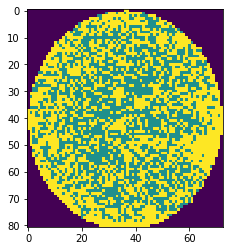

wafer_id:366, ウエハサイズ:81x73, スタンプサイズ:4x4, oDefects:1202, nDefects:2359, p=50.954


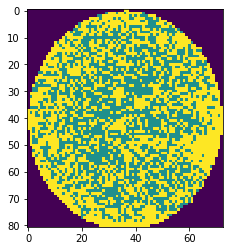

wafer_id:367, ウエハサイズ:81x73, スタンプサイズ:2x2, oDefects:1496, nDefects:2595, p=57.649


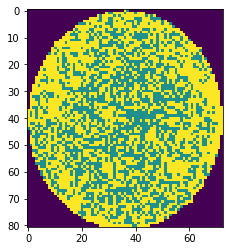

wafer_id:367, ウエハサイズ:81x73, スタンプサイズ:3x2, oDefects:1509, nDefects:2612, p=57.772


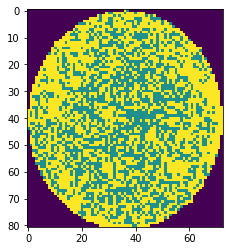

wafer_id:367, ウエハサイズ:81x73, スタンプサイズ:4x2, oDefects:1496, nDefects:2595, p=57.649


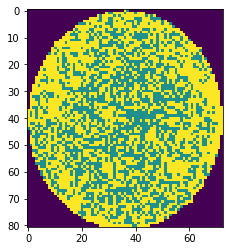

wafer_id:367, ウエハサイズ:81x73, スタンプサイズ:2x3, oDefects:1454, nDefects:2566, p=56.664


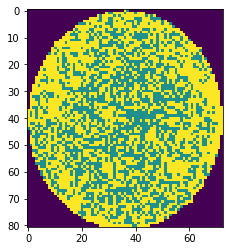

wafer_id:367, ウエハサイズ:81x73, スタンプサイズ:3x3, oDefects:1466, nDefects:2583, p=56.756


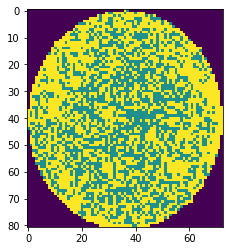

wafer_id:367, ウエハサイズ:81x73, スタンプサイズ:4x3, oDefects:1454, nDefects:2566, p=56.664


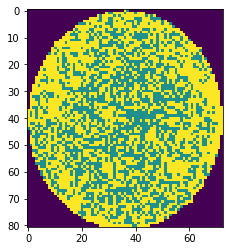

wafer_id:367, ウエハサイズ:81x73, スタンプサイズ:2x4, oDefects:1393, nDefects:2532, p=55.016


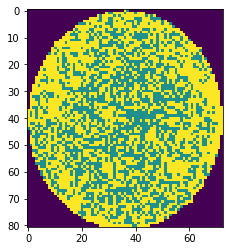

wafer_id:367, ウエハサイズ:81x73, スタンプサイズ:3x4, oDefects:1404, nDefects:2549, p=55.080


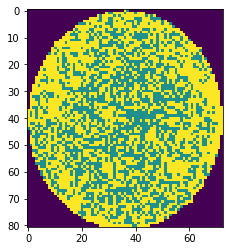

wafer_id:367, ウエハサイズ:81x73, スタンプサイズ:4x4, oDefects:1393, nDefects:2532, p=55.016


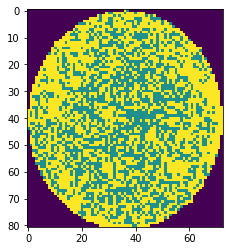

wafer_id:374, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:328, nDefects:589, p=55.688


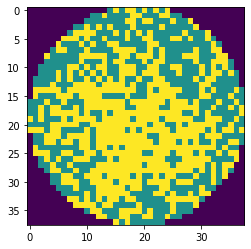

wafer_id:374, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:327, nDefects:580, p=56.379


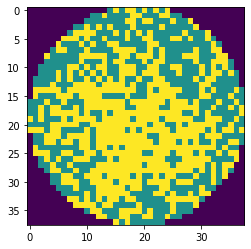

wafer_id:374, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:327, nDefects:580, p=56.379


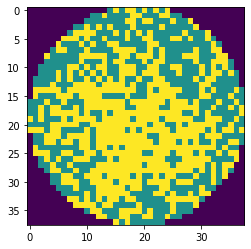

wafer_id:374, ウエハサイズ:38x38, スタンプサイズ:2x3, oDefects:308, nDefects:565, p=54.513


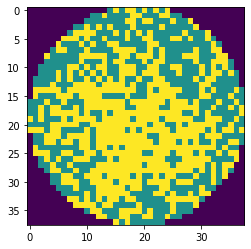

wafer_id:374, ウエハサイズ:38x38, スタンプサイズ:3x3, oDefects:305, nDefects:556, p=54.856


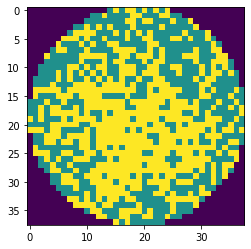

wafer_id:374, ウエハサイズ:38x38, スタンプサイズ:4x3, oDefects:305, nDefects:556, p=54.856


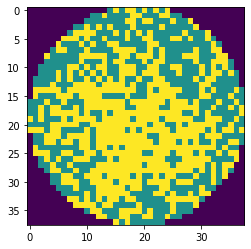

wafer_id:374, ウエハサイズ:38x38, スタンプサイズ:2x4, oDefects:311, nDefects:547, p=56.856


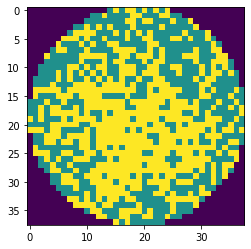

wafer_id:374, ウエハサイズ:38x38, スタンプサイズ:3x4, oDefects:306, nDefects:538, p=56.877


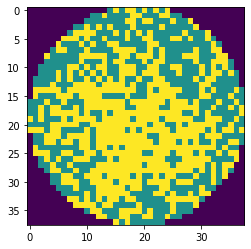

wafer_id:374, ウエハサイズ:38x38, スタンプサイズ:4x4, oDefects:306, nDefects:538, p=56.877


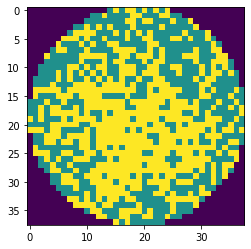

wafer_id:377, ウエハサイズ:27x27, スタンプサイズ:2x2, oDefects:151, nDefects:289, p=52.249


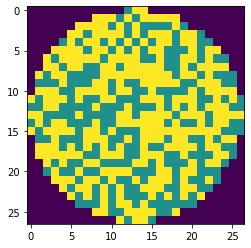

wafer_id:377, ウエハサイズ:27x27, スタンプサイズ:3x2, oDefects:152, nDefects:292, p=52.055


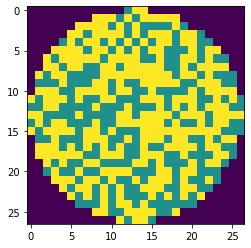

wafer_id:377, ウエハサイズ:27x27, スタンプサイズ:4x2, oDefects:147, nDefects:278, p=52.878


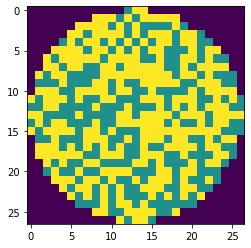

wafer_id:377, ウエハサイズ:27x27, スタンプサイズ:2x4, oDefects:129, nDefects:245, p=52.653


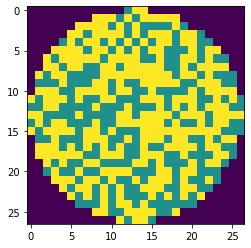

wafer_id:377, ウエハサイズ:27x27, スタンプサイズ:3x4, oDefects:129, nDefects:248, p=52.016


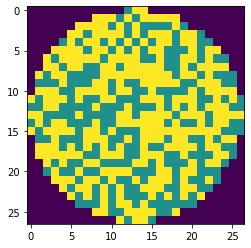

wafer_id:377, ウエハサイズ:27x27, スタンプサイズ:4x4, oDefects:126, nDefects:234, p=53.846


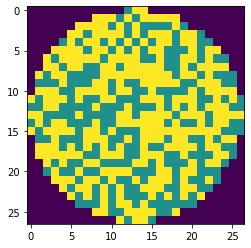

wafer_id:378, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:314, nDefects:602, p=52.159


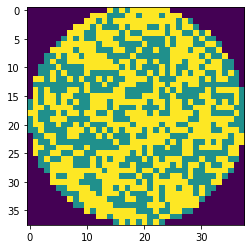

wafer_id:378, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:306, nDefects:588, p=52.041


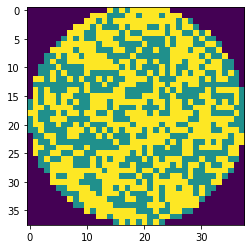

wafer_id:378, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:306, nDefects:588, p=52.041


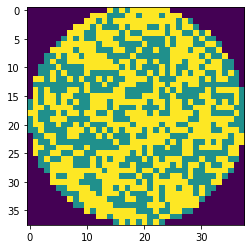

wafer_id:378, ウエハサイズ:38x38, スタンプサイズ:2x3, oDefects:292, nDefects:566, p=51.590


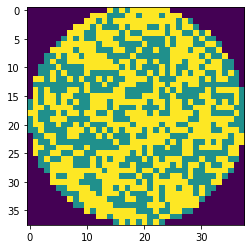

wafer_id:378, ウエハサイズ:38x38, スタンプサイズ:3x3, oDefects:286, nDefects:552, p=51.812


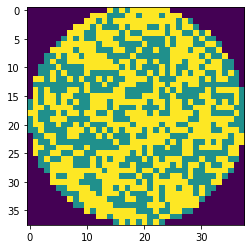

wafer_id:378, ウエハサイズ:38x38, スタンプサイズ:4x3, oDefects:286, nDefects:552, p=51.812


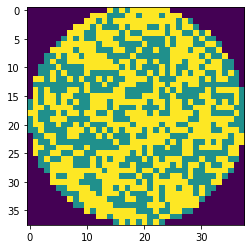

wafer_id:378, ウエハサイズ:38x38, スタンプサイズ:2x4, oDefects:286, nDefects:557, p=51.346


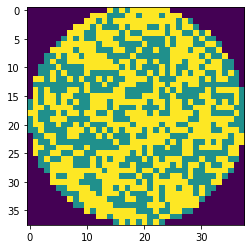

wafer_id:378, ウエハサイズ:38x38, スタンプサイズ:3x4, oDefects:278, nDefects:543, p=51.197


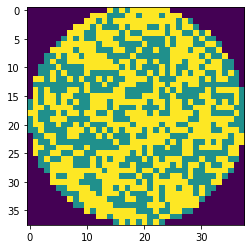

wafer_id:378, ウエハサイズ:38x38, スタンプサイズ:4x4, oDefects:278, nDefects:543, p=51.197


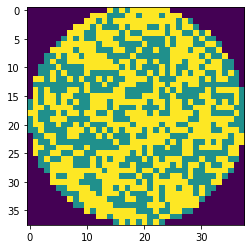

wafer_id:391, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:307, nDefects:589, p=52.122


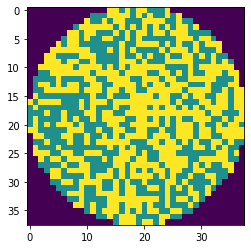

wafer_id:391, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:302, nDefects:577, p=52.340


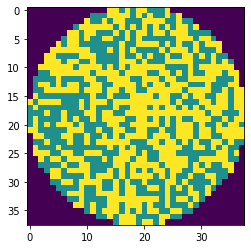

wafer_id:391, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:302, nDefects:577, p=52.340


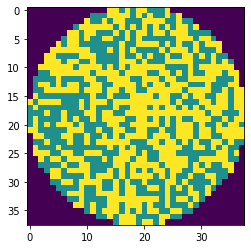

wafer_id:391, ウエハサイズ:38x38, スタンプサイズ:2x3, oDefects:287, nDefects:554, p=51.805


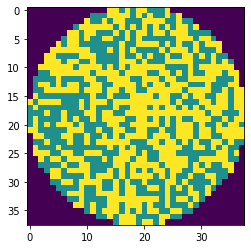

wafer_id:391, ウエハサイズ:38x38, スタンプサイズ:3x3, oDefects:283, nDefects:542, p=52.214


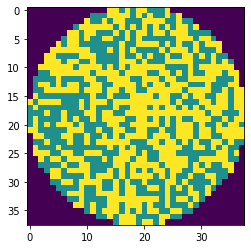

wafer_id:391, ウエハサイズ:38x38, スタンプサイズ:4x3, oDefects:283, nDefects:542, p=52.214


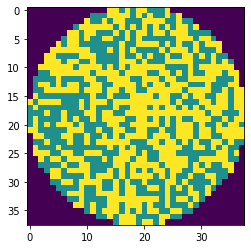

wafer_id:391, ウエハサイズ:38x38, スタンプサイズ:2x4, oDefects:288, nDefects:541, p=53.235


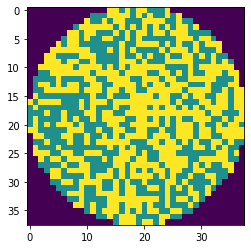

wafer_id:391, ウエハサイズ:38x38, スタンプサイズ:3x4, oDefects:285, nDefects:529, p=53.875


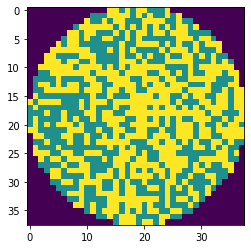

wafer_id:391, ウエハサイズ:38x38, スタンプサイズ:4x4, oDefects:285, nDefects:529, p=53.875


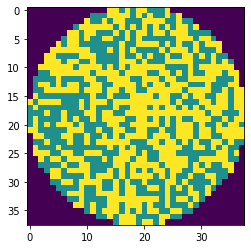

wafer_id:392, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:303, nDefects:568, p=53.345


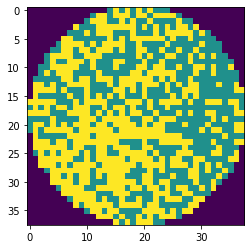

wafer_id:392, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:295, nDefects:554, p=53.249


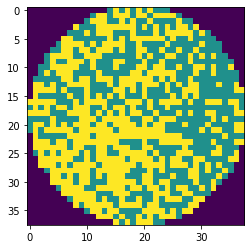

wafer_id:392, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:295, nDefects:554, p=53.249


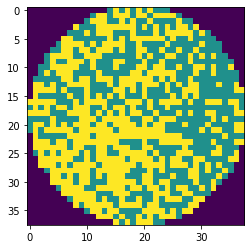

wafer_id:392, ウエハサイズ:38x38, スタンプサイズ:2x3, oDefects:279, nDefects:555, p=50.270


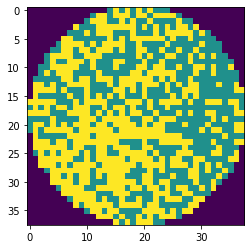

wafer_id:392, ウエハサイズ:38x38, スタンプサイズ:3x3, oDefects:275, nDefects:541, p=50.832


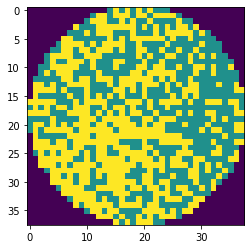

wafer_id:392, ウエハサイズ:38x38, スタンプサイズ:4x3, oDefects:275, nDefects:541, p=50.832


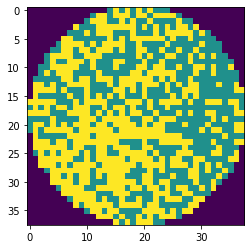

wafer_id:392, ウエハサイズ:38x38, スタンプサイズ:2x4, oDefects:273, nDefects:544, p=50.184


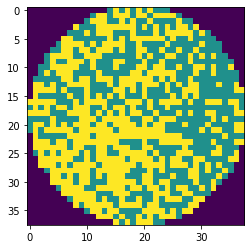

wafer_id:392, ウエハサイズ:38x38, スタンプサイズ:3x4, oDefects:268, nDefects:530, p=50.566


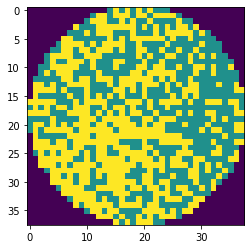

wafer_id:392, ウエハサイズ:38x38, スタンプサイズ:4x4, oDefects:268, nDefects:530, p=50.566


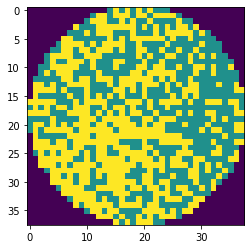

wafer_id:395, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:386, nDefects:666, p=57.958


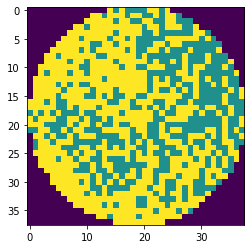

wafer_id:395, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:370, nDefects:644, p=57.453


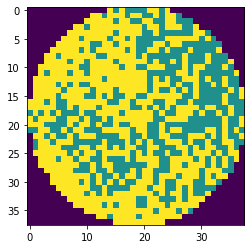

wafer_id:395, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:370, nDefects:644, p=57.453


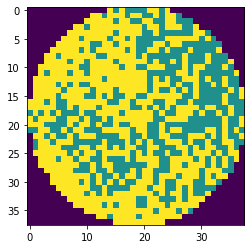

wafer_id:395, ウエハサイズ:38x38, スタンプサイズ:2x3, oDefects:375, nDefects:641, p=58.502


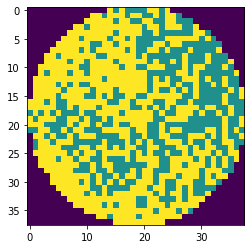

wafer_id:395, ウエハサイズ:38x38, スタンプサイズ:3x3, oDefects:360, nDefects:619, p=58.158


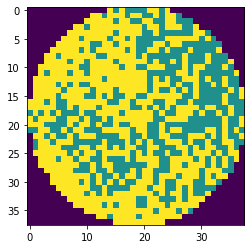

wafer_id:395, ウエハサイズ:38x38, スタンプサイズ:4x3, oDefects:360, nDefects:619, p=58.158


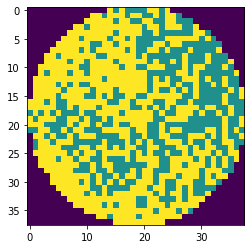

wafer_id:395, ウエハサイズ:38x38, スタンプサイズ:2x4, oDefects:352, nDefects:632, p=55.696


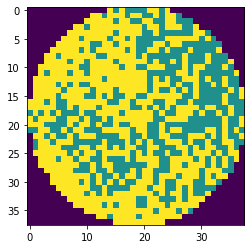

wafer_id:395, ウエハサイズ:38x38, スタンプサイズ:3x4, oDefects:339, nDefects:610, p=55.574


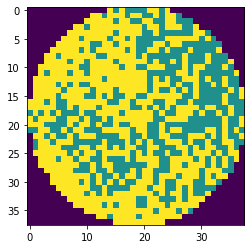

wafer_id:395, ウエハサイズ:38x38, スタンプサイズ:4x4, oDefects:339, nDefects:610, p=55.574


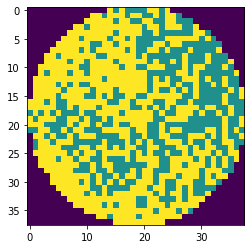

wafer_id:397, ウエハサイズ:25x26, スタンプサイズ:2x3, oDefects:118, nDefects:224, p=52.679


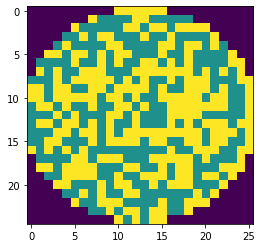

wafer_id:397, ウエハサイズ:25x26, スタンプサイズ:3x3, oDefects:118, nDefects:224, p=52.679


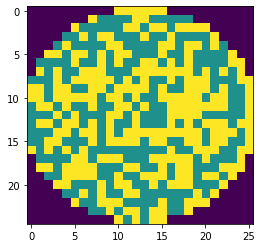

wafer_id:397, ウエハサイズ:25x26, スタンプサイズ:4x3, oDefects:118, nDefects:224, p=52.679


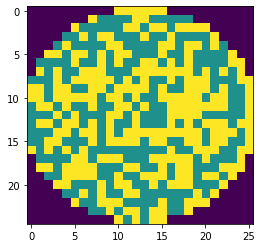

wafer_id:401, ウエハサイズ:26x28, スタンプサイズ:2x2, oDefects:156, nDefects:307, p=50.814


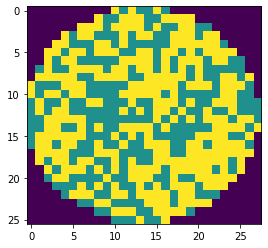

wafer_id:401, ウエハサイズ:26x28, スタンプサイズ:3x2, oDefects:153, nDefects:298, p=51.342


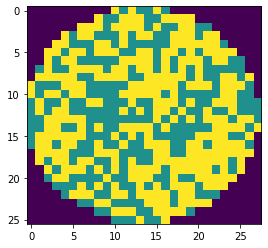

wafer_id:401, ウエハサイズ:26x28, スタンプサイズ:4x2, oDefects:153, nDefects:298, p=51.342


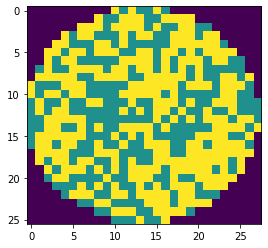

wafer_id:401, ウエハサイズ:26x28, スタンプサイズ:2x3, oDefects:147, nDefects:290, p=50.690


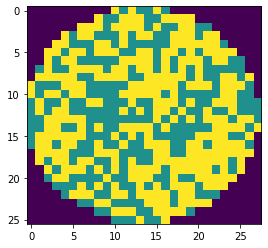

wafer_id:401, ウエハサイズ:26x28, スタンプサイズ:3x3, oDefects:144, nDefects:281, p=51.246


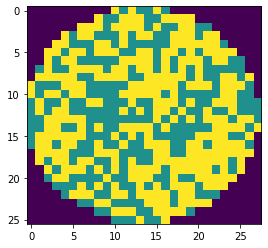

wafer_id:401, ウエハサイズ:26x28, スタンプサイズ:4x3, oDefects:144, nDefects:281, p=51.246


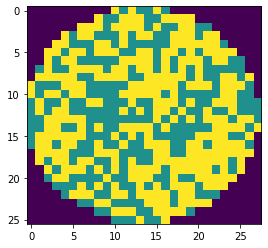

wafer_id:404, ウエハサイズ:43x42, スタンプサイズ:2x2, oDefects:378, nDefects:734, p=51.499


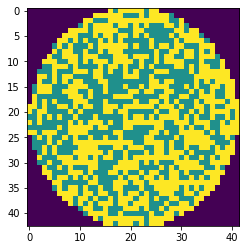

wafer_id:404, ウエハサイズ:43x42, スタンプサイズ:3x2, oDefects:378, nDefects:734, p=51.499


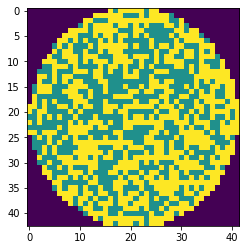

wafer_id:404, ウエハサイズ:43x42, スタンプサイズ:4x2, oDefects:364, nDefects:711, p=51.195


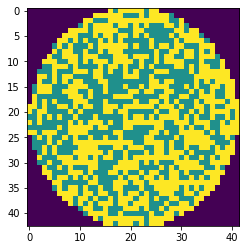

wafer_id:404, ウエハサイズ:43x42, スタンプサイズ:2x3, oDefects:361, nDefects:718, p=50.279


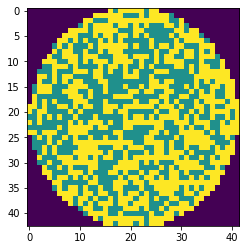

wafer_id:404, ウエハサイズ:43x42, スタンプサイズ:3x3, oDefects:361, nDefects:718, p=50.279


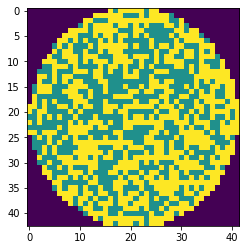

wafer_id:405, ウエハサイズ:25x26, スタンプサイズ:2x2, oDefects:129, nDefects:251, p=51.394


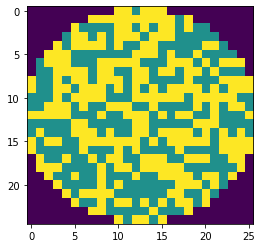

wafer_id:405, ウエハサイズ:25x26, スタンプサイズ:3x2, oDefects:129, nDefects:251, p=51.394


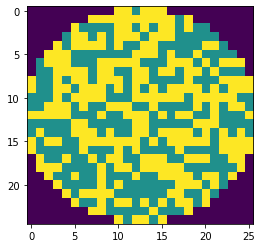

wafer_id:405, ウエハサイズ:25x26, スタンプサイズ:4x2, oDefects:129, nDefects:251, p=51.394


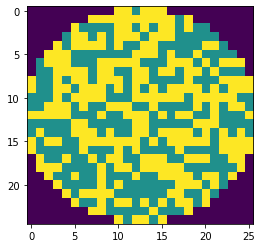

wafer_id:406, ウエハサイズ:45x45, スタンプサイズ:2x2, oDefects:408, nDefects:703, p=58.037


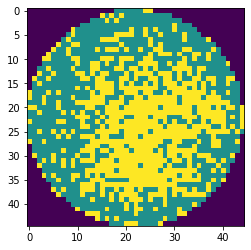

wafer_id:406, ウエハサイズ:45x45, スタンプサイズ:3x2, oDefects:409, nDefects:707, p=57.850


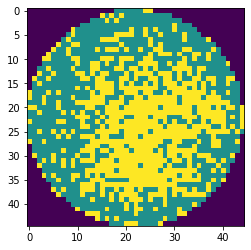

wafer_id:406, ウエハサイズ:45x45, スタンプサイズ:4x2, oDefects:408, nDefects:703, p=58.037


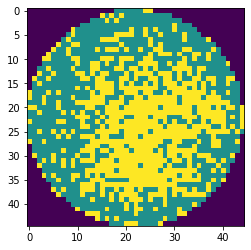

wafer_id:406, ウエハサイズ:45x45, スタンプサイズ:2x3, oDefects:387, nDefects:703, p=55.050


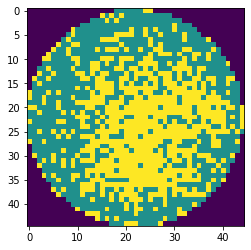

wafer_id:406, ウエハサイズ:45x45, スタンプサイズ:3x3, oDefects:387, nDefects:707, p=54.738


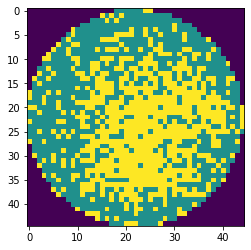

wafer_id:406, ウエハサイズ:45x45, スタンプサイズ:4x3, oDefects:387, nDefects:703, p=55.050


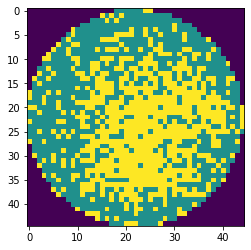

wafer_id:406, ウエハサイズ:45x45, スタンプサイズ:2x4, oDefects:393, nDefects:687, p=57.205


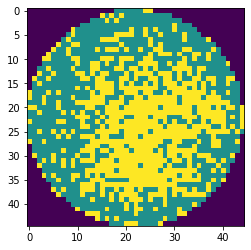

wafer_id:406, ウエハサイズ:45x45, スタンプサイズ:3x4, oDefects:393, nDefects:691, p=56.874


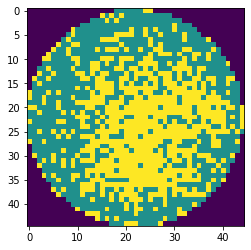

wafer_id:406, ウエハサイズ:45x45, スタンプサイズ:4x4, oDefects:393, nDefects:687, p=57.205


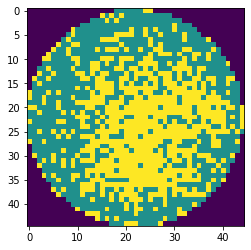

wafer_id:407, ウエハサイズ:25x26, スタンプサイズ:2x3, oDefects:119, nDefects:232, p=51.293


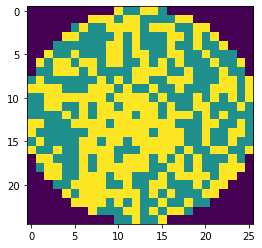

wafer_id:407, ウエハサイズ:25x26, スタンプサイズ:3x3, oDefects:119, nDefects:232, p=51.293


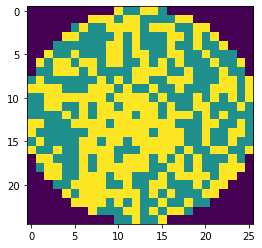

wafer_id:407, ウエハサイズ:25x26, スタンプサイズ:4x3, oDefects:119, nDefects:232, p=51.293


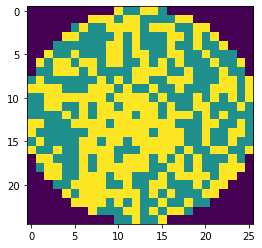

wafer_id:407, ウエハサイズ:25x26, スタンプサイズ:2x4, oDefects:115, nDefects:223, p=51.570


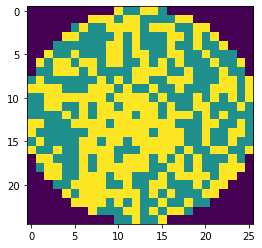

wafer_id:407, ウエハサイズ:25x26, スタンプサイズ:3x4, oDefects:115, nDefects:223, p=51.570


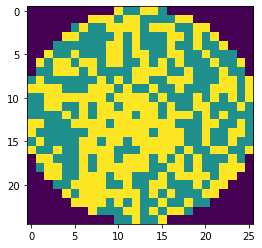

wafer_id:407, ウエハサイズ:25x26, スタンプサイズ:4x4, oDefects:115, nDefects:223, p=51.570


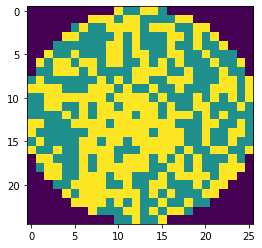

wafer_id:408, ウエハサイズ:25x26, スタンプサイズ:2x3, oDefects:120, nDefects:239, p=50.209


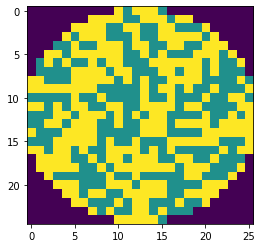

wafer_id:408, ウエハサイズ:25x26, スタンプサイズ:3x3, oDefects:120, nDefects:239, p=50.209


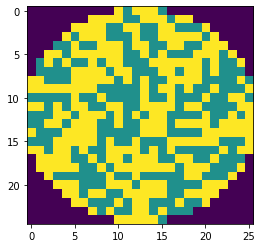

wafer_id:408, ウエハサイズ:25x26, スタンプサイズ:4x3, oDefects:120, nDefects:239, p=50.209


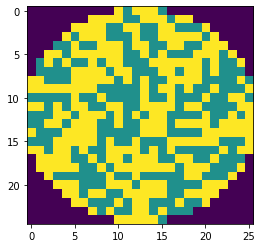

wafer_id:413, ウエハサイズ:39x46, スタンプサイズ:2x2, oDefects:384, nDefects:679, p=56.554


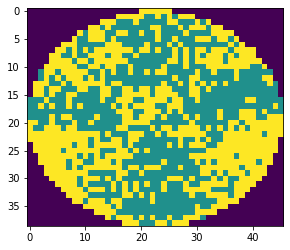

wafer_id:413, ウエハサイズ:39x46, スタンプサイズ:3x2, oDefects:387, nDefects:687, p=56.332


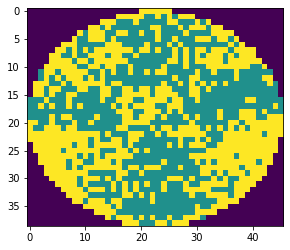

wafer_id:413, ウエハサイズ:39x46, スタンプサイズ:4x2, oDefects:375, nDefects:661, p=56.732


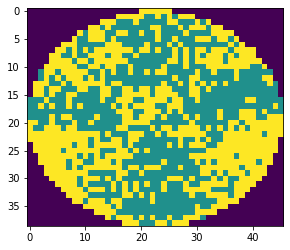

wafer_id:413, ウエハサイズ:39x46, スタンプサイズ:2x3, oDefects:338, nDefects:656, p=51.524


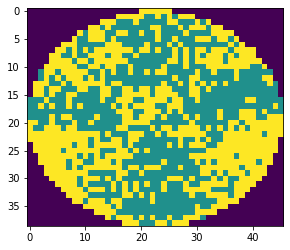

wafer_id:413, ウエハサイズ:39x46, スタンプサイズ:3x3, oDefects:340, nDefects:664, p=51.205


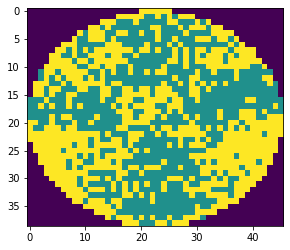

wafer_id:413, ウエハサイズ:39x46, スタンプサイズ:4x3, oDefects:332, nDefects:638, p=52.038


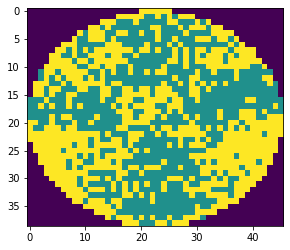

wafer_id:413, ウエハサイズ:39x46, スタンプサイズ:2x4, oDefects:324, nDefects:627, p=51.675


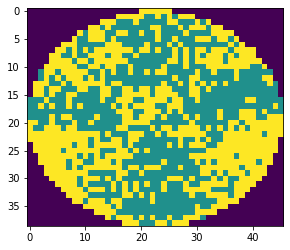

wafer_id:413, ウエハサイズ:39x46, スタンプサイズ:3x4, oDefects:327, nDefects:635, p=51.496


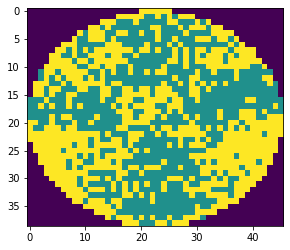

wafer_id:413, ウエハサイズ:39x46, スタンプサイズ:4x4, oDefects:320, nDefects:609, p=52.545


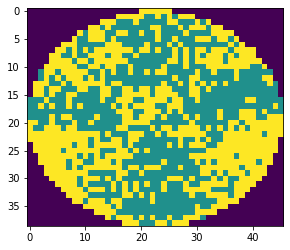

wafer_id:415, ウエハサイズ:39x46, スタンプサイズ:2x2, oDefects:388, nDefects:693, p=55.988


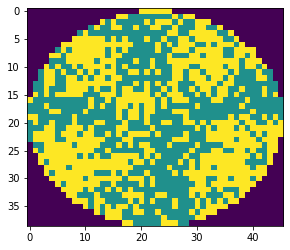

wafer_id:415, ウエハサイズ:39x46, スタンプサイズ:3x2, oDefects:389, nDefects:698, p=55.731


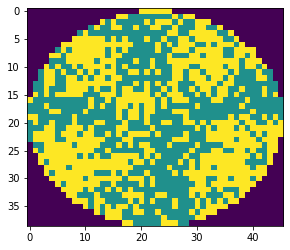

wafer_id:415, ウエハサイズ:39x46, スタンプサイズ:4x2, oDefects:383, nDefects:676, p=56.657


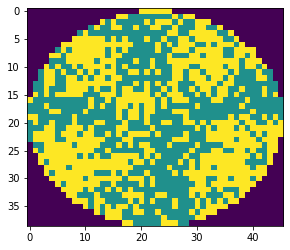

wafer_id:415, ウエハサイズ:39x46, スタンプサイズ:2x3, oDefects:358, nDefects:676, p=52.959


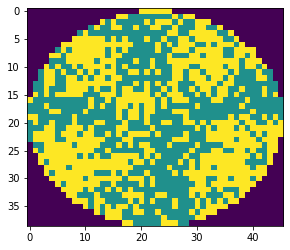

wafer_id:415, ウエハサイズ:39x46, スタンプサイズ:3x3, oDefects:358, nDefects:681, p=52.570


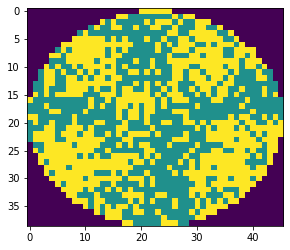

wafer_id:415, ウエハサイズ:39x46, スタンプサイズ:4x3, oDefects:354, nDefects:659, p=53.718


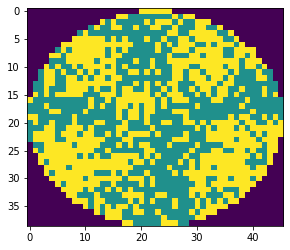

wafer_id:415, ウエハサイズ:39x46, スタンプサイズ:2x4, oDefects:345, nDefects:654, p=52.752


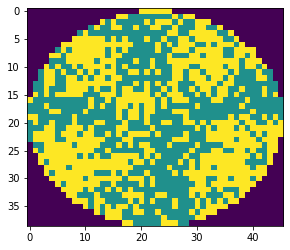

wafer_id:415, ウエハサイズ:39x46, スタンプサイズ:3x4, oDefects:345, nDefects:659, p=52.352


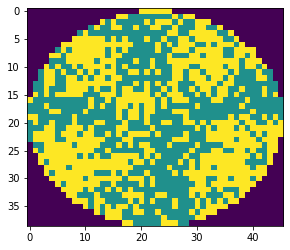

wafer_id:415, ウエハサイズ:39x46, スタンプサイズ:4x4, oDefects:340, nDefects:637, p=53.375


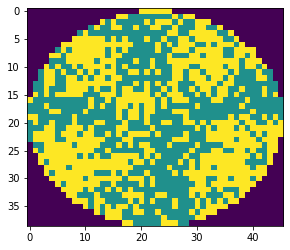

wafer_id:416, ウエハサイズ:63x58, スタンプサイズ:2x2, oDefects:584, nDefects:1128, p=51.773


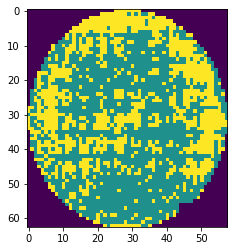

wafer_id:416, ウエハサイズ:63x58, スタンプサイズ:3x2, oDefects:592, nDefects:1139, p=51.975


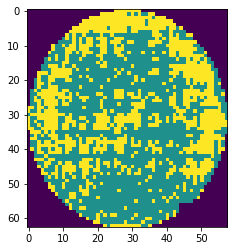

wafer_id:416, ウエハサイズ:63x58, スタンプサイズ:4x2, oDefects:584, nDefects:1117, p=52.283


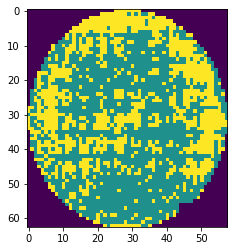

wafer_id:416, ウエハサイズ:63x58, スタンプサイズ:2x3, oDefects:552, nDefects:1102, p=50.091


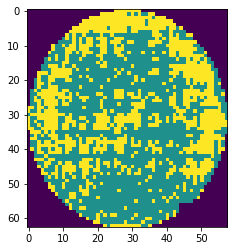

wafer_id:416, ウエハサイズ:63x58, スタンプサイズ:3x3, oDefects:560, nDefects:1113, p=50.314


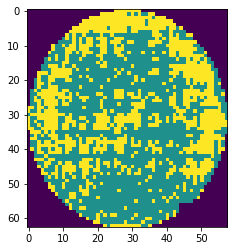

wafer_id:416, ウエハサイズ:63x58, スタンプサイズ:4x3, oDefects:551, nDefects:1091, p=50.504


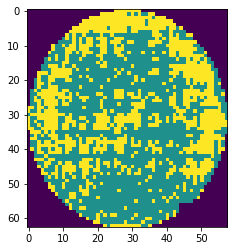

wafer_id:417, ウエハサイズ:43x42, スタンプサイズ:2x2, oDefects:454, nDefects:795, p=57.107


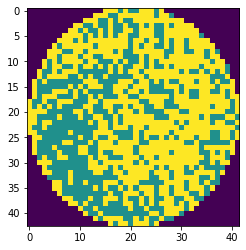

wafer_id:417, ウエハサイズ:43x42, スタンプサイズ:3x2, oDefects:454, nDefects:795, p=57.107


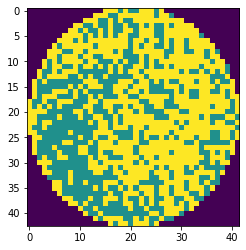

wafer_id:417, ウエハサイズ:43x42, スタンプサイズ:4x2, oDefects:448, nDefects:780, p=57.436


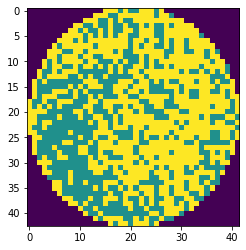

wafer_id:417, ウエハサイズ:43x42, スタンプサイズ:2x3, oDefects:453, nDefects:785, p=57.707


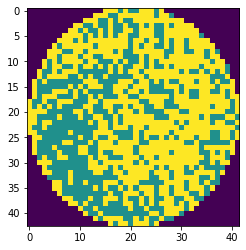

wafer_id:417, ウエハサイズ:43x42, スタンプサイズ:3x3, oDefects:453, nDefects:785, p=57.707


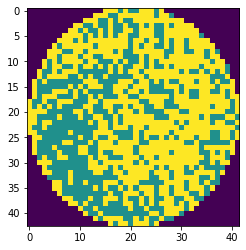

wafer_id:417, ウエハサイズ:43x42, スタンプサイズ:4x3, oDefects:446, nDefects:770, p=57.922


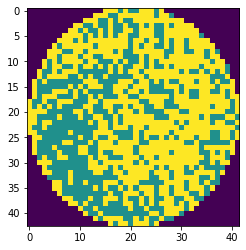

wafer_id:417, ウエハサイズ:43x42, スタンプサイズ:2x4, oDefects:423, nDefects:738, p=57.317


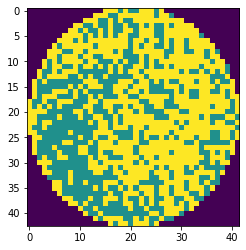

wafer_id:417, ウエハサイズ:43x42, スタンプサイズ:3x4, oDefects:423, nDefects:738, p=57.317


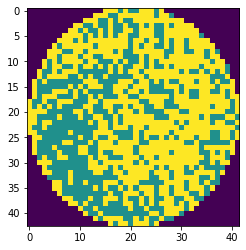

wafer_id:417, ウエハサイズ:43x42, スタンプサイズ:4x4, oDefects:419, nDefects:723, p=57.953


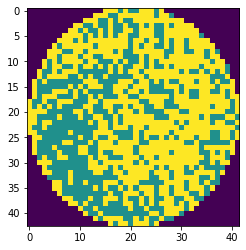

wafer_id:418, ウエハサイズ:43x42, スタンプサイズ:2x2, oDefects:445, nDefects:782, p=56.905


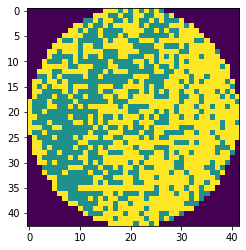

wafer_id:418, ウエハサイズ:43x42, スタンプサイズ:3x2, oDefects:445, nDefects:782, p=56.905


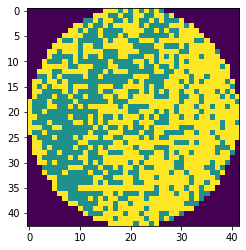

wafer_id:418, ウエハサイズ:43x42, スタンプサイズ:4x2, oDefects:432, nDefects:758, p=56.992


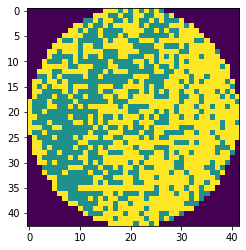

wafer_id:418, ウエハサイズ:43x42, スタンプサイズ:2x3, oDefects:428, nDefects:767, p=55.802


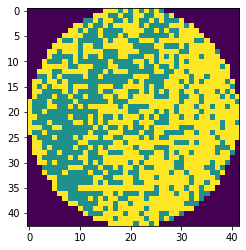

wafer_id:418, ウエハサイズ:43x42, スタンプサイズ:3x3, oDefects:428, nDefects:767, p=55.802


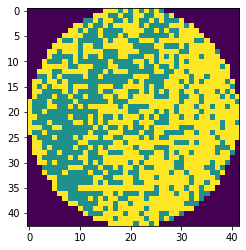

wafer_id:418, ウエハサイズ:43x42, スタンプサイズ:4x3, oDefects:414, nDefects:743, p=55.720


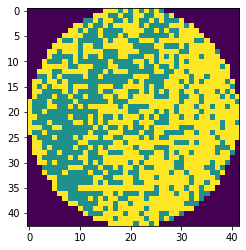

wafer_id:418, ウエハサイズ:43x42, スタンプサイズ:2x4, oDefects:397, nDefects:708, p=56.073


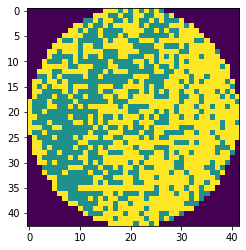

wafer_id:418, ウエハサイズ:43x42, スタンプサイズ:3x4, oDefects:397, nDefects:708, p=56.073


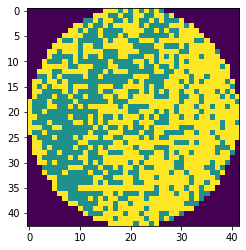

wafer_id:418, ウエハサイズ:43x42, スタンプサイズ:4x4, oDefects:384, nDefects:684, p=56.140


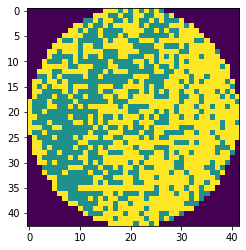

wafer_id:420, ウエハサイズ:43x42, スタンプサイズ:2x2, oDefects:442, nDefects:776, p=56.959


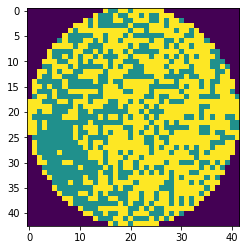

wafer_id:420, ウエハサイズ:43x42, スタンプサイズ:3x2, oDefects:442, nDefects:776, p=56.959


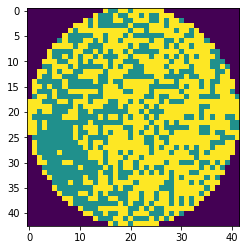

wafer_id:420, ウエハサイズ:43x42, スタンプサイズ:4x2, oDefects:436, nDefects:759, p=57.444


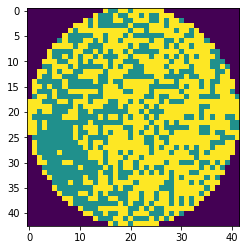

wafer_id:420, ウエハサイズ:43x42, スタンプサイズ:2x3, oDefects:425, nDefects:760, p=55.921


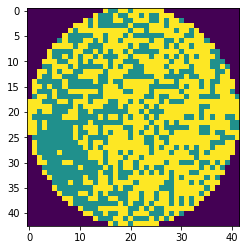

wafer_id:420, ウエハサイズ:43x42, スタンプサイズ:3x3, oDefects:425, nDefects:760, p=55.921


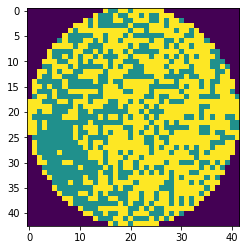

wafer_id:420, ウエハサイズ:43x42, スタンプサイズ:4x3, oDefects:420, nDefects:743, p=56.528


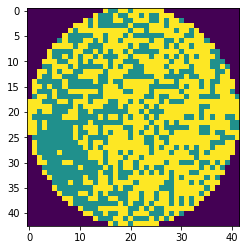

wafer_id:420, ウエハサイズ:43x42, スタンプサイズ:2x4, oDefects:395, nDefects:710, p=55.634


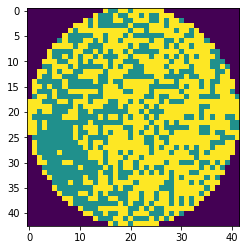

wafer_id:420, ウエハサイズ:43x42, スタンプサイズ:3x4, oDefects:395, nDefects:710, p=55.634


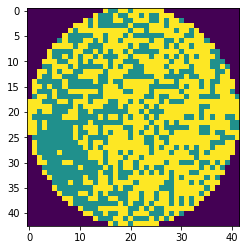

wafer_id:420, ウエハサイズ:43x42, スタンプサイズ:4x4, oDefects:387, nDefects:693, p=55.844


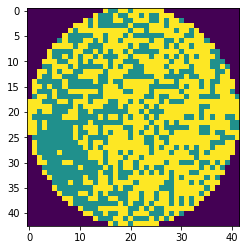

wafer_id:421, ウエハサイズ:43x42, スタンプサイズ:2x2, oDefects:413, nDefects:771, p=53.567


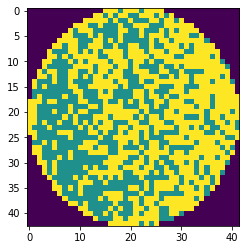

wafer_id:421, ウエハサイズ:43x42, スタンプサイズ:3x2, oDefects:413, nDefects:771, p=53.567


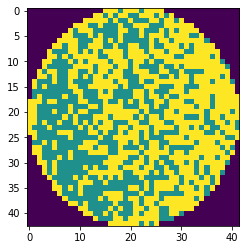

wafer_id:421, ウエハサイズ:43x42, スタンプサイズ:4x2, oDefects:405, nDefects:752, p=53.856


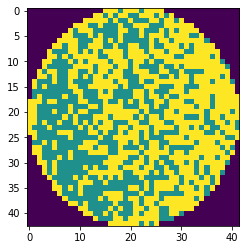

wafer_id:421, ウエハサイズ:43x42, スタンプサイズ:2x3, oDefects:395, nDefects:756, p=52.249


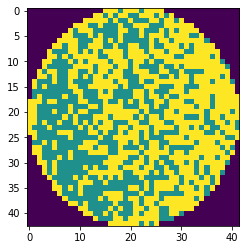

wafer_id:421, ウエハサイズ:43x42, スタンプサイズ:3x3, oDefects:395, nDefects:756, p=52.249


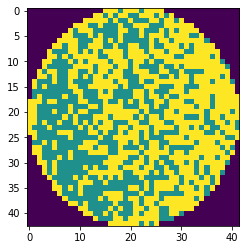

wafer_id:421, ウエハサイズ:43x42, スタンプサイズ:4x3, oDefects:387, nDefects:737, p=52.510


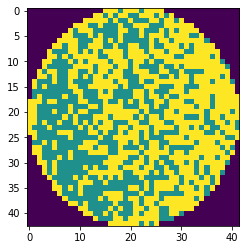

wafer_id:421, ウエハサイズ:43x42, スタンプサイズ:2x4, oDefects:374, nDefects:696, p=53.736


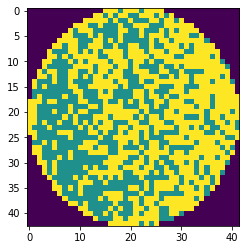

wafer_id:421, ウエハサイズ:43x42, スタンプサイズ:3x4, oDefects:374, nDefects:696, p=53.736


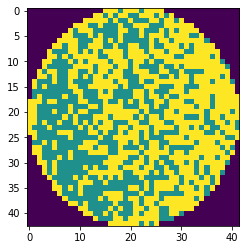

wafer_id:421, ウエハサイズ:43x42, スタンプサイズ:4x4, oDefects:364, nDefects:677, p=53.767


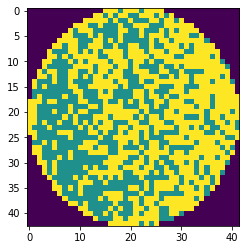

wafer_id:424, ウエハサイズ:43x42, スタンプサイズ:2x2, oDefects:364, nDefects:679, p=53.608


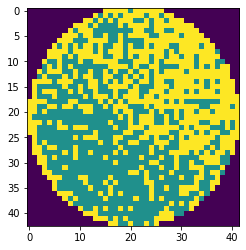

wafer_id:424, ウエハサイズ:43x42, スタンプサイズ:3x2, oDefects:364, nDefects:679, p=53.608


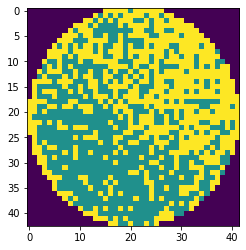

wafer_id:424, ウエハサイズ:43x42, スタンプサイズ:4x2, oDefects:357, nDefects:664, p=53.765


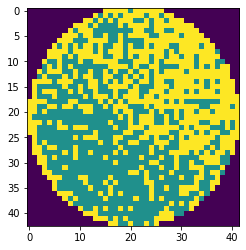

wafer_id:424, ウエハサイズ:43x42, スタンプサイズ:4x3, oDefects:326, nDefects:648, p=50.309


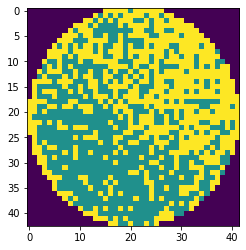

wafer_id:424, ウエハサイズ:43x42, スタンプサイズ:2x4, oDefects:310, nDefects:609, p=50.903


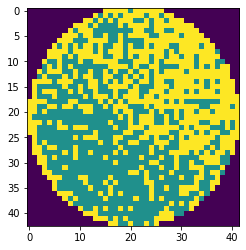

wafer_id:424, ウエハサイズ:43x42, スタンプサイズ:3x4, oDefects:310, nDefects:609, p=50.903


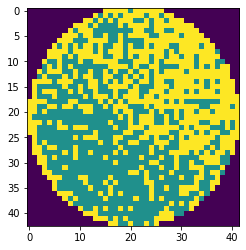

wafer_id:424, ウエハサイズ:43x42, スタンプサイズ:4x4, oDefects:308, nDefects:594, p=51.852


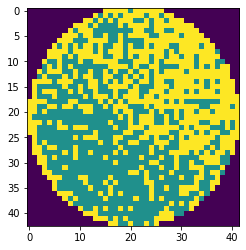

wafer_id:425, ウエハサイズ:81x81, スタンプサイズ:2x2, oDefects:1669, nDefects:2893, p=57.691


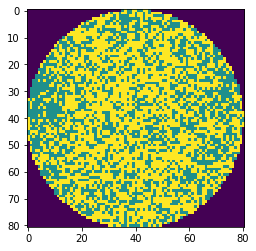

wafer_id:425, ウエハサイズ:81x81, スタンプサイズ:3x2, oDefects:1672, nDefects:2902, p=57.615


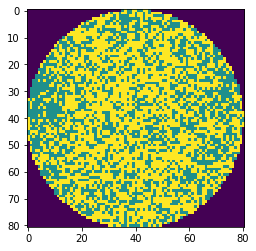

wafer_id:425, ウエハサイズ:81x81, スタンプサイズ:4x2, oDefects:1669, nDefects:2893, p=57.691


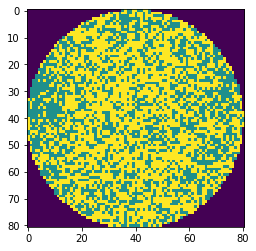

wafer_id:425, ウエハサイズ:81x81, スタンプサイズ:2x3, oDefects:1644, nDefects:2893, p=56.827


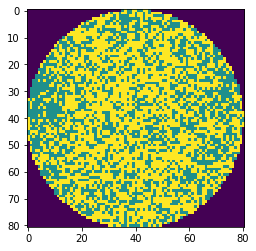

wafer_id:425, ウエハサイズ:81x81, スタンプサイズ:3x3, oDefects:1648, nDefects:2902, p=56.788


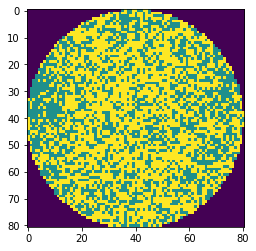

wafer_id:425, ウエハサイズ:81x81, スタンプサイズ:4x3, oDefects:1644, nDefects:2893, p=56.827


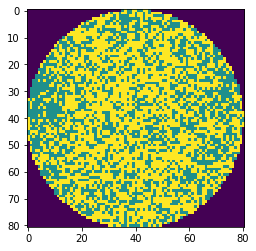

wafer_id:425, ウエハサイズ:81x81, スタンプサイズ:2x4, oDefects:1599, nDefects:2858, p=55.948


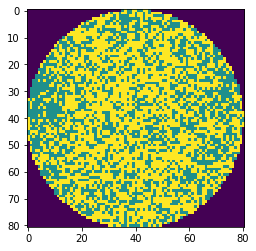

wafer_id:425, ウエハサイズ:81x81, スタンプサイズ:3x4, oDefects:1602, nDefects:2867, p=55.877


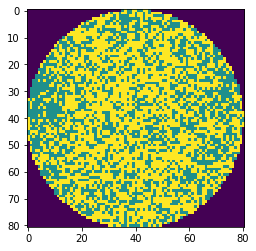

wafer_id:425, ウエハサイズ:81x81, スタンプサイズ:4x4, oDefects:1599, nDefects:2858, p=55.948


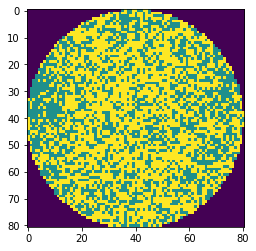

wafer_id:433, ウエハサイズ:41x42, スタンプサイズ:3x3, oDefects:177, nDefects:354, p=50.000


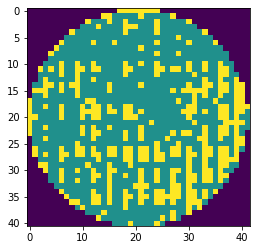

wafer_id:439, ウエハサイズ:41x42, スタンプサイズ:2x3, oDefects:205, nDefects:344, p=59.593


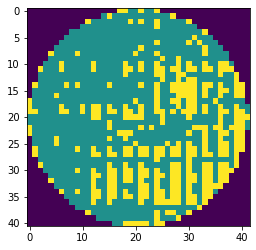

wafer_id:439, ウエハサイズ:41x42, スタンプサイズ:3x3, oDefects:205, nDefects:342, p=59.942


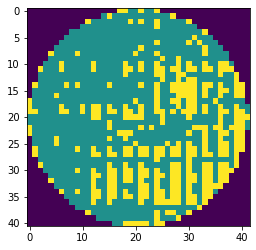

wafer_id:439, ウエハサイズ:41x42, スタンプサイズ:4x3, oDefects:205, nDefects:344, p=59.593


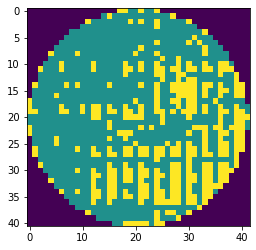

wafer_id:440, ウエハサイズ:41x42, スタンプサイズ:3x4, oDefects:277, nDefects:554, p=50.000


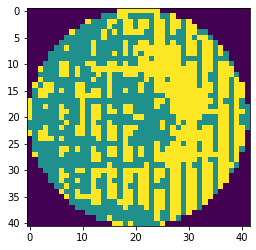

wafer_id:449, ウエハサイズ:45x43, スタンプサイズ:2x2, oDefects:489, nDefects:860, p=56.860


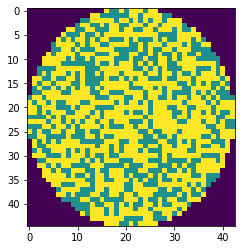

wafer_id:449, ウエハサイズ:45x43, スタンプサイズ:3x2, oDefects:493, nDefects:868, p=56.797


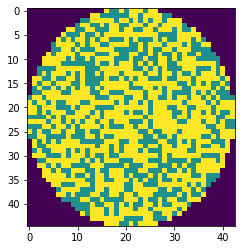

wafer_id:449, ウエハサイズ:45x43, スタンプサイズ:4x2, oDefects:489, nDefects:860, p=56.860


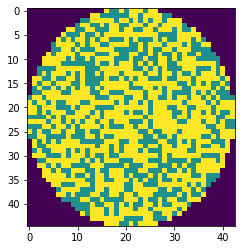

wafer_id:449, ウエハサイズ:45x43, スタンプサイズ:2x3, oDefects:471, nDefects:850, p=55.412


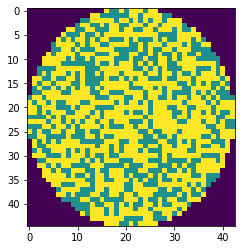

wafer_id:449, ウエハサイズ:45x43, スタンプサイズ:3x3, oDefects:474, nDefects:858, p=55.245


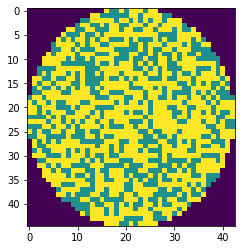

wafer_id:449, ウエハサイズ:45x43, スタンプサイズ:4x3, oDefects:471, nDefects:850, p=55.412


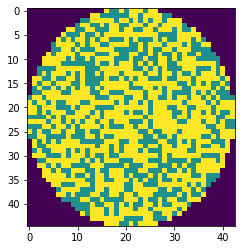

wafer_id:449, ウエハサイズ:45x43, スタンプサイズ:2x4, oDefects:433, nDefects:799, p=54.193


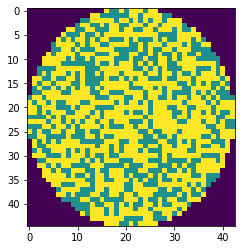

wafer_id:449, ウエハサイズ:45x43, スタンプサイズ:3x4, oDefects:435, nDefects:807, p=53.903


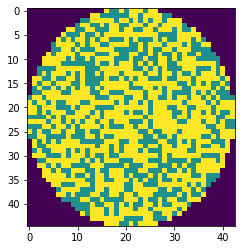

wafer_id:449, ウエハサイズ:45x43, スタンプサイズ:4x4, oDefects:433, nDefects:799, p=54.193


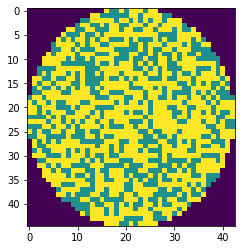

wafer_id:452, ウエハサイズ:35x40, スタンプサイズ:2x2, oDefects:289, nDefects:536, p=53.918


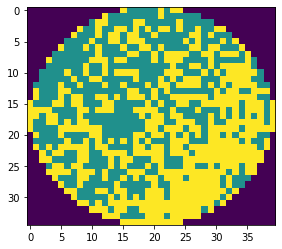

wafer_id:452, ウエハサイズ:35x40, スタンプサイズ:3x2, oDefects:283, nDefects:525, p=53.905


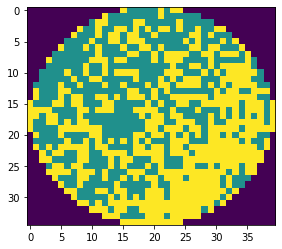

wafer_id:452, ウエハサイズ:35x40, スタンプサイズ:4x2, oDefects:272, nDefects:509, p=53.438


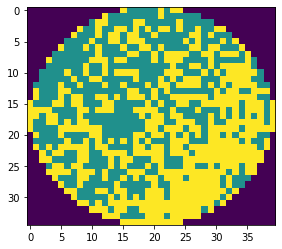

wafer_id:452, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:271, nDefects:514, p=52.724


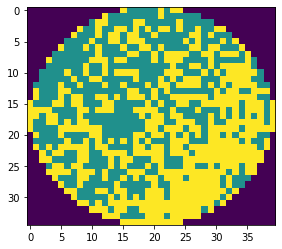

wafer_id:452, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:267, nDefects:503, p=53.082


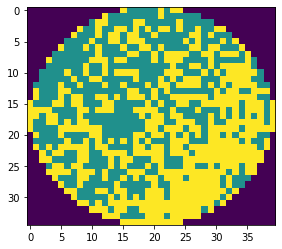

wafer_id:452, ウエハサイズ:35x40, スタンプサイズ:4x3, oDefects:256, nDefects:487, p=52.567


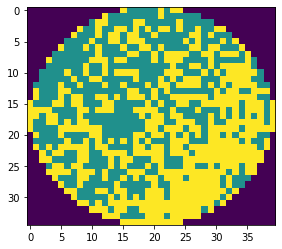

wafer_id:452, ウエハサイズ:35x40, スタンプサイズ:2x4, oDefects:277, nDefects:514, p=53.891


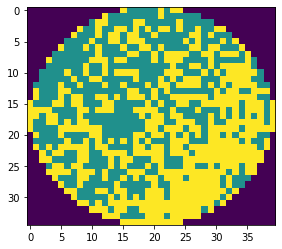

wafer_id:452, ウエハサイズ:35x40, スタンプサイズ:3x4, oDefects:273, nDefects:503, p=54.274


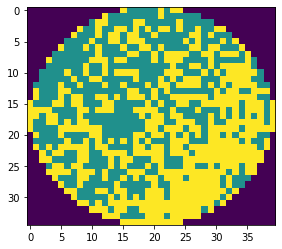

wafer_id:452, ウエハサイズ:35x40, スタンプサイズ:4x4, oDefects:262, nDefects:487, p=53.799


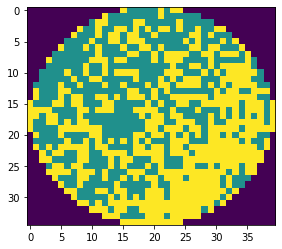

wafer_id:453, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:145, nDefects:245, p=59.184


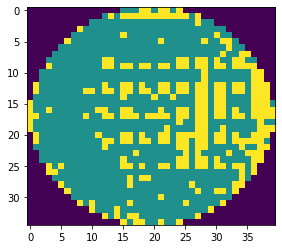

wafer_id:456, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:143, nDefects:262, p=54.580


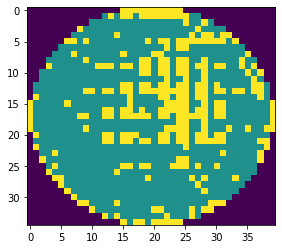

wafer_id:456, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:143, nDefects:258, p=55.426


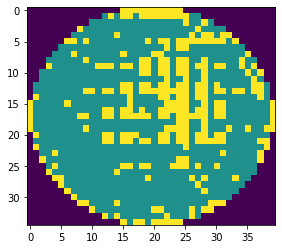

wafer_id:456, ウエハサイズ:35x40, スタンプサイズ:4x3, oDefects:142, nDefects:252, p=56.349


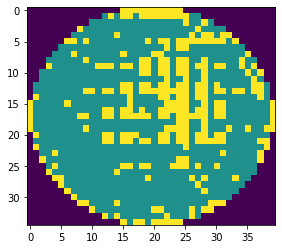

wafer_id:457, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:152, nDefects:261, p=58.238


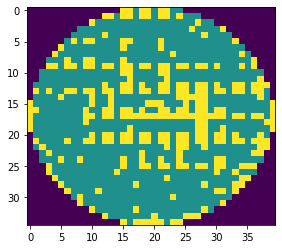

wafer_id:457, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:152, nDefects:256, p=59.375


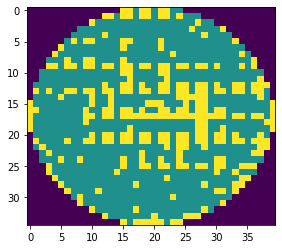

wafer_id:459, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:167, nDefects:297, p=56.229


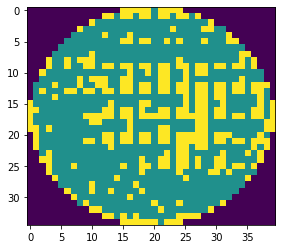

wafer_id:459, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:165, nDefects:289, p=57.093


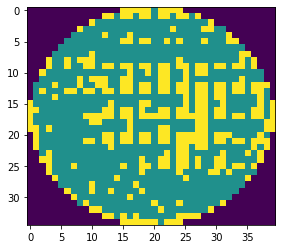

wafer_id:459, ウエハサイズ:35x40, スタンプサイズ:4x3, oDefects:165, nDefects:285, p=57.895


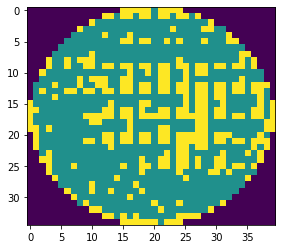

wafer_id:463, ウエハサイズ:53x58, スタンプサイズ:2x3, oDefects:824, nDefects:1400, p=58.857


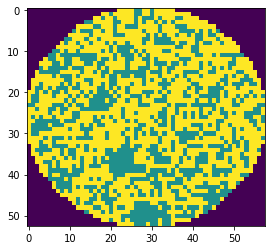

wafer_id:463, ウエハサイズ:53x58, スタンプサイズ:3x3, oDefects:818, nDefects:1389, p=58.891


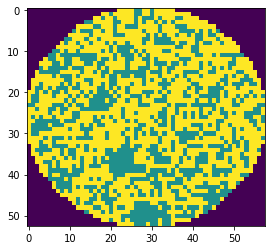

wafer_id:463, ウエハサイズ:53x58, スタンプサイズ:4x3, oDefects:824, nDefects:1400, p=58.857


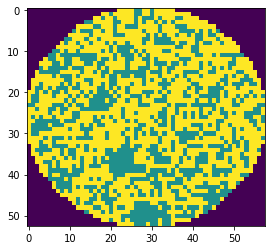

wafer_id:463, ウエハサイズ:53x58, スタンプサイズ:2x4, oDefects:780, nDefects:1362, p=57.269


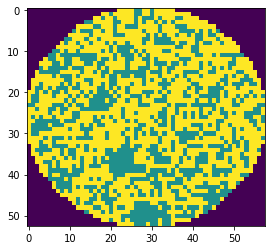

wafer_id:463, ウエハサイズ:53x58, スタンプサイズ:3x4, oDefects:777, nDefects:1351, p=57.513


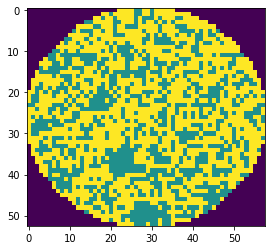

wafer_id:463, ウエハサイズ:53x58, スタンプサイズ:4x4, oDefects:780, nDefects:1362, p=57.269


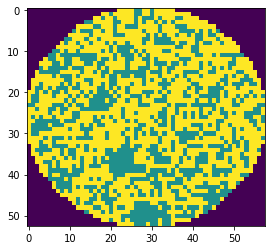

wafer_id:466, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:153, nDefects:273, p=56.044


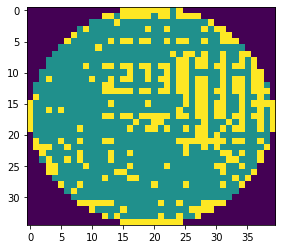

wafer_id:466, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:151, nDefects:268, p=56.343


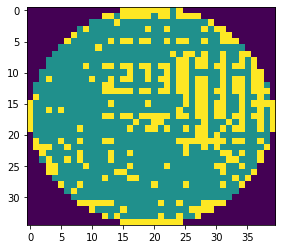

wafer_id:466, ウエハサイズ:35x40, スタンプサイズ:4x3, oDefects:150, nDefects:262, p=57.252


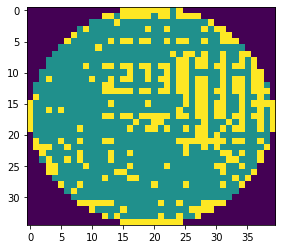

wafer_id:468, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:169, nDefects:284, p=59.507


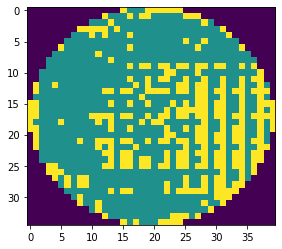

wafer_id:471, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:192, nDefects:336, p=57.143


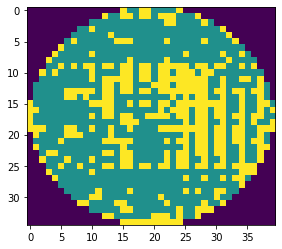

wafer_id:471, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:190, nDefects:329, p=57.751


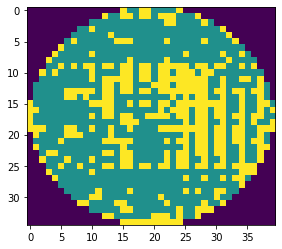

wafer_id:471, ウエハサイズ:35x40, スタンプサイズ:4x3, oDefects:189, nDefects:323, p=58.514


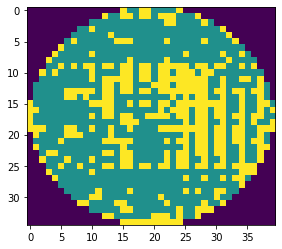

wafer_id:477, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:119, nDefects:220, p=54.091


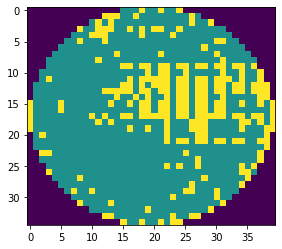

wafer_id:477, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:118, nDefects:215, p=54.884


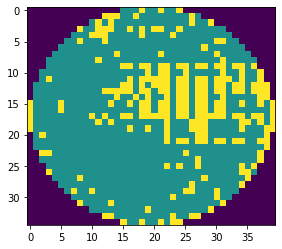

wafer_id:477, ウエハサイズ:35x40, スタンプサイズ:4x3, oDefects:118, nDefects:213, p=55.399


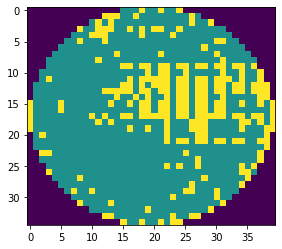

wafer_id:481, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:174, nDefects:323, p=53.870


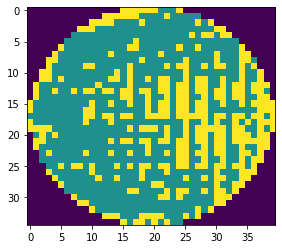

wafer_id:481, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:173, nDefects:314, p=55.096


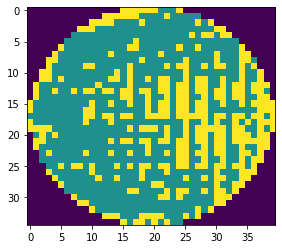

wafer_id:481, ウエハサイズ:35x40, スタンプサイズ:4x3, oDefects:173, nDefects:311, p=55.627


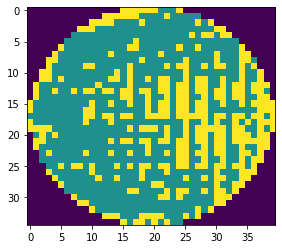

wafer_id:488, ウエハサイズ:35x40, スタンプサイズ:2x2, oDefects:256, nDefects:477, p=53.669


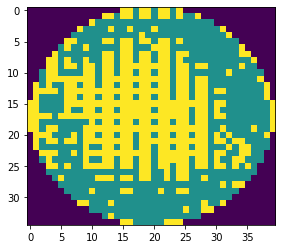

wafer_id:488, ウエハサイズ:35x40, スタンプサイズ:3x2, oDefects:256, nDefects:476, p=53.782


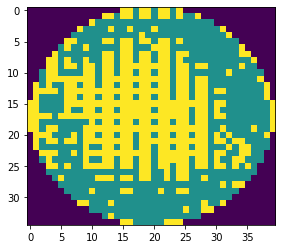

wafer_id:488, ウエハサイズ:35x40, スタンプサイズ:4x2, oDefects:256, nDefects:473, p=54.123


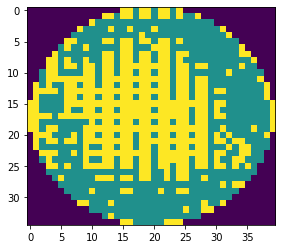

wafer_id:488, ウエハサイズ:35x40, スタンプサイズ:2x4, oDefects:248, nDefects:474, p=52.321


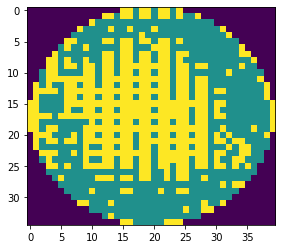

wafer_id:488, ウエハサイズ:35x40, スタンプサイズ:3x4, oDefects:248, nDefects:473, p=52.431


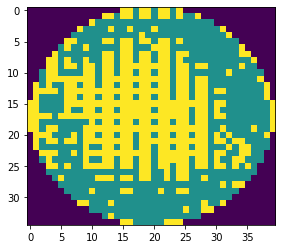

wafer_id:488, ウエハサイズ:35x40, スタンプサイズ:4x4, oDefects:247, nDefects:470, p=52.553


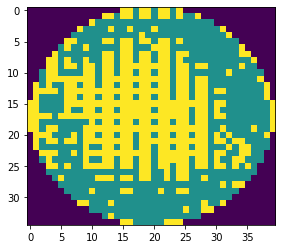

wafer_id:489, ウエハサイズ:35x40, スタンプサイズ:2x2, oDefects:229, nDefects:454, p=50.441


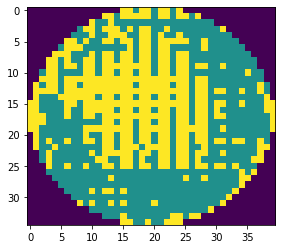

wafer_id:489, ウエハサイズ:35x40, スタンプサイズ:3x2, oDefects:228, nDefects:449, p=50.780


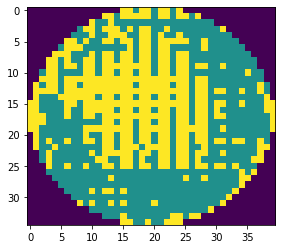

wafer_id:489, ウエハサイズ:35x40, スタンプサイズ:4x2, oDefects:228, nDefects:448, p=50.893


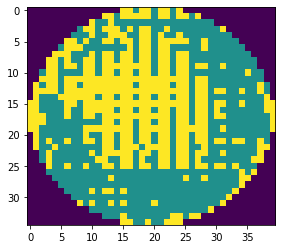

wafer_id:489, ウエハサイズ:35x40, スタンプサイズ:2x4, oDefects:226, nDefects:446, p=50.673


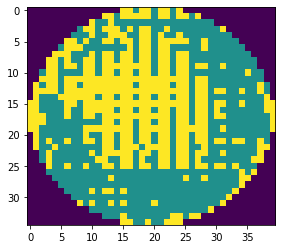

wafer_id:489, ウエハサイズ:35x40, スタンプサイズ:3x4, oDefects:225, nDefects:441, p=51.020


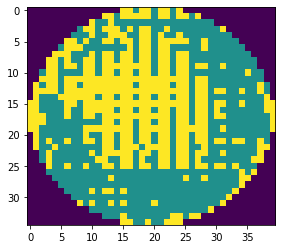

wafer_id:489, ウエハサイズ:35x40, スタンプサイズ:4x4, oDefects:225, nDefects:440, p=51.136


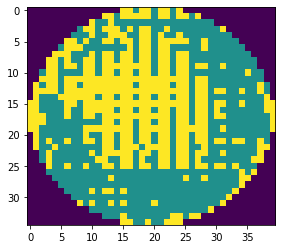

wafer_id:494, ウエハサイズ:35x40, スタンプサイズ:2x4, oDefects:202, nDefects:395, p=51.139


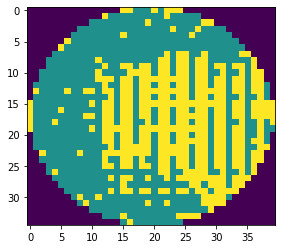

wafer_id:494, ウエハサイズ:35x40, スタンプサイズ:3x4, oDefects:202, nDefects:390, p=51.795


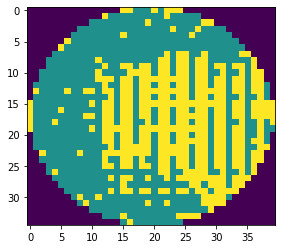

wafer_id:494, ウエハサイズ:35x40, スタンプサイズ:4x4, oDefects:202, nDefects:389, p=51.928


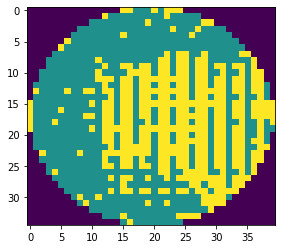

wafer_id:496, ウエハサイズ:35x40, スタンプサイズ:2x2, oDefects:264, nDefects:524, p=50.382


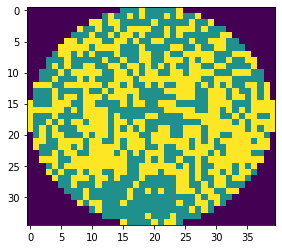

wafer_id:496, ウエハサイズ:35x40, スタンプサイズ:3x2, oDefects:264, nDefects:522, p=50.575


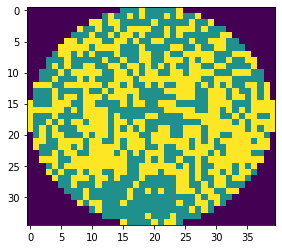

wafer_id:496, ウエハサイズ:35x40, スタンプサイズ:4x2, oDefects:263, nDefects:519, p=50.674


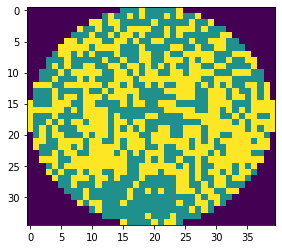

wafer_id:496, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:256, nDefects:503, p=50.895


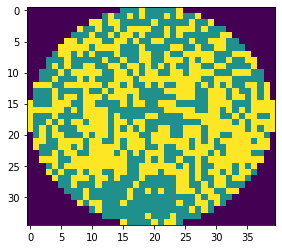

wafer_id:496, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:256, nDefects:501, p=51.098


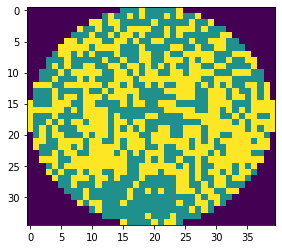

wafer_id:496, ウエハサイズ:35x40, スタンプサイズ:4x3, oDefects:256, nDefects:498, p=51.406


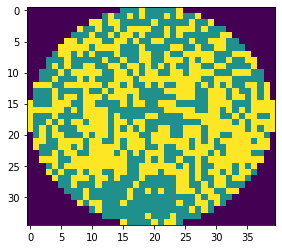

wafer_id:496, ウエハサイズ:35x40, スタンプサイズ:2x4, oDefects:254, nDefects:503, p=50.497


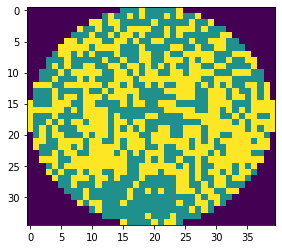

wafer_id:496, ウエハサイズ:35x40, スタンプサイズ:3x4, oDefects:253, nDefects:501, p=50.499


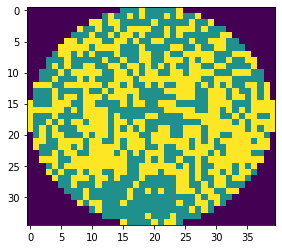

wafer_id:496, ウエハサイズ:35x40, スタンプサイズ:4x4, oDefects:253, nDefects:498, p=50.803


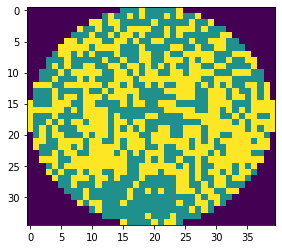

wafer_id:498, ウエハサイズ:35x40, スタンプサイズ:2x2, oDefects:370, nDefects:641, p=57.722


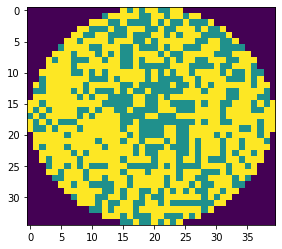

wafer_id:498, ウエハサイズ:35x40, スタンプサイズ:3x2, oDefects:367, nDefects:633, p=57.978


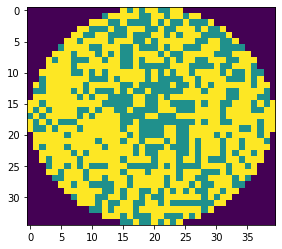

wafer_id:498, ウエハサイズ:35x40, スタンプサイズ:4x2, oDefects:355, nDefects:618, p=57.443


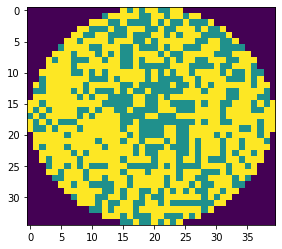

wafer_id:498, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:349, nDefects:620, p=56.290


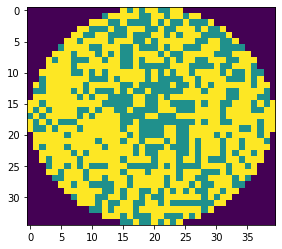

wafer_id:498, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:348, nDefects:612, p=56.863


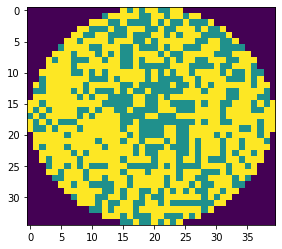

wafer_id:498, ウエハサイズ:35x40, スタンプサイズ:4x3, oDefects:337, nDefects:597, p=56.449


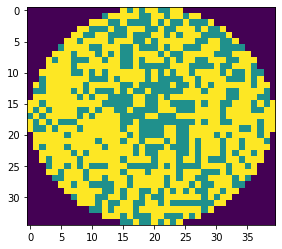

wafer_id:498, ウエハサイズ:35x40, スタンプサイズ:2x4, oDefects:345, nDefects:620, p=55.645


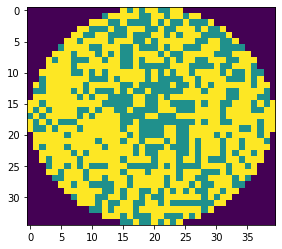

wafer_id:498, ウエハサイズ:35x40, スタンプサイズ:3x4, oDefects:342, nDefects:612, p=55.882


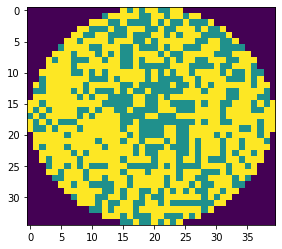

wafer_id:498, ウエハサイズ:35x40, スタンプサイズ:4x4, oDefects:331, nDefects:597, p=55.444


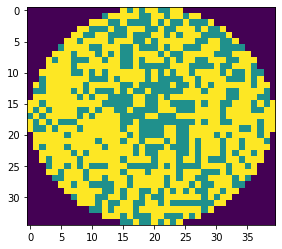

wafer_id:501, ウエハサイズ:35x40, スタンプサイズ:3x2, oDefects:267, nDefects:534, p=50.000


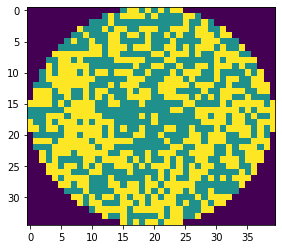

wafer_id:501, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:259, nDefects:517, p=50.097


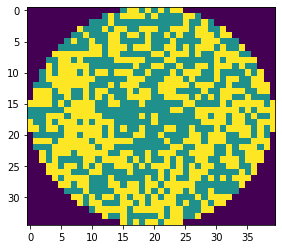

wafer_id:501, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:256, nDefects:511, p=50.098


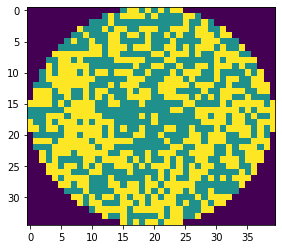

wafer_id:502, ウエハサイズ:35x40, スタンプサイズ:2x2, oDefects:291, nDefects:553, p=52.622


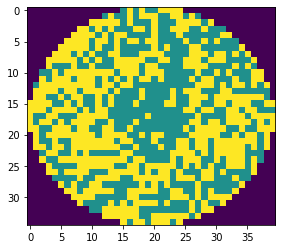

wafer_id:502, ウエハサイズ:35x40, スタンプサイズ:3x2, oDefects:282, nDefects:540, p=52.222


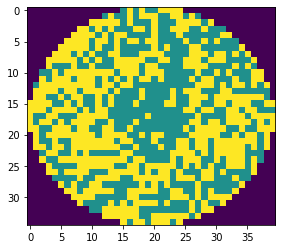

wafer_id:502, ウエハサイズ:35x40, スタンプサイズ:4x2, oDefects:277, nDefects:531, p=52.166


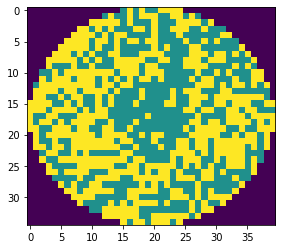

wafer_id:502, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:278, nDefects:534, p=52.060


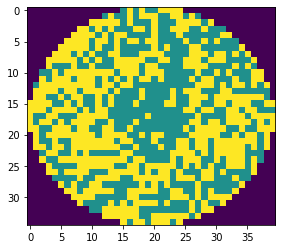

wafer_id:502, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:270, nDefects:521, p=51.823


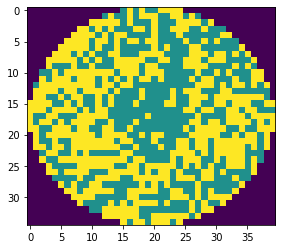

wafer_id:502, ウエハサイズ:35x40, スタンプサイズ:4x3, oDefects:266, nDefects:512, p=51.953


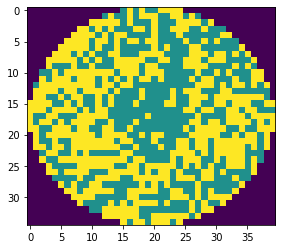

wafer_id:506, ウエハサイズ:35x40, スタンプサイズ:3x4, oDefects:368, nDefects:614, p=59.935


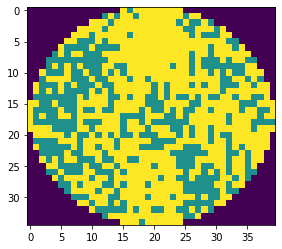

wafer_id:507, ウエハサイズ:35x40, スタンプサイズ:2x2, oDefects:282, nDefects:553, p=50.995


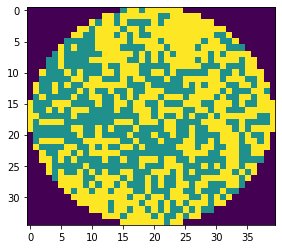

wafer_id:507, ウエハサイズ:35x40, スタンプサイズ:3x2, oDefects:276, nDefects:542, p=50.923


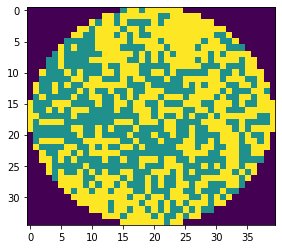

wafer_id:507, ウエハサイズ:35x40, スタンプサイズ:4x2, oDefects:270, nDefects:531, p=50.847


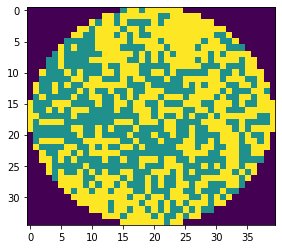

wafer_id:507, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:278, nDefects:531, p=52.354


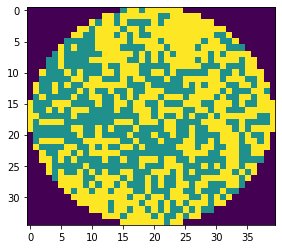

wafer_id:507, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:272, nDefects:520, p=52.308


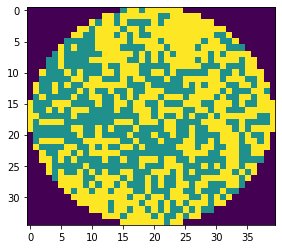

wafer_id:507, ウエハサイズ:35x40, スタンプサイズ:4x3, oDefects:266, nDefects:509, p=52.259


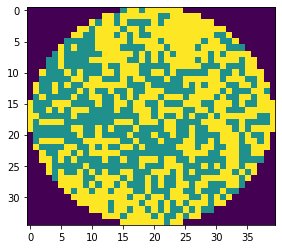

wafer_id:507, ウエハサイズ:35x40, スタンプサイズ:3x4, oDefects:260, nDefects:520, p=50.000


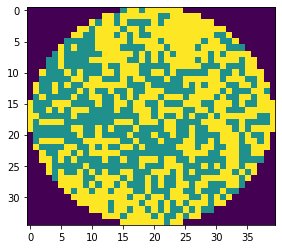

wafer_id:507, ウエハサイズ:35x40, スタンプサイズ:4x4, oDefects:256, nDefects:509, p=50.295


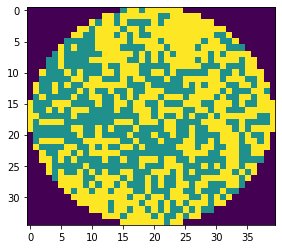

wafer_id:509, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:357, nDefects:600, p=59.500


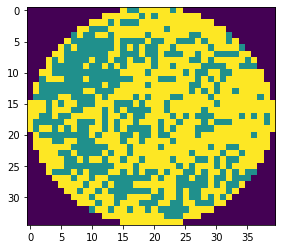

wafer_id:509, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:350, nDefects:587, p=59.625


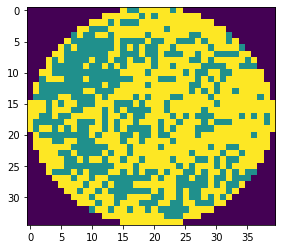

wafer_id:509, ウエハサイズ:35x40, スタンプサイズ:4x3, oDefects:344, nDefects:576, p=59.722


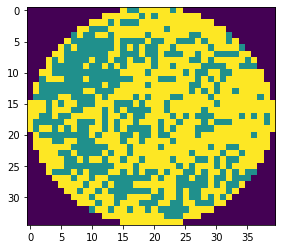

wafer_id:509, ウエハサイズ:35x40, スタンプサイズ:2x4, oDefects:335, nDefects:600, p=55.833


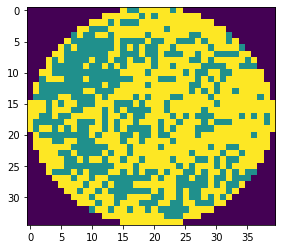

wafer_id:509, ウエハサイズ:35x40, スタンプサイズ:3x4, oDefects:328, nDefects:587, p=55.877


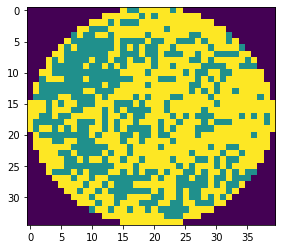

wafer_id:509, ウエハサイズ:35x40, スタンプサイズ:4x4, oDefects:326, nDefects:576, p=56.597


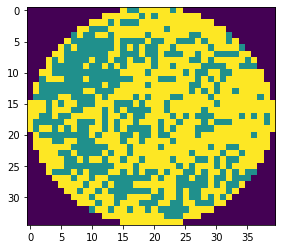

wafer_id:510, ウエハサイズ:35x40, スタンプサイズ:2x2, oDefects:359, nDefects:615, p=58.374


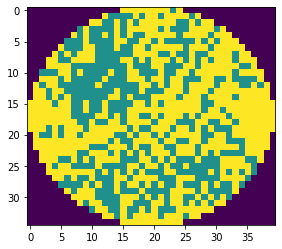

wafer_id:510, ウエハサイズ:35x40, スタンプサイズ:3x2, oDefects:352, nDefects:603, p=58.375


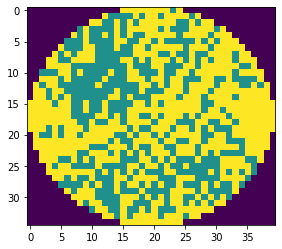

wafer_id:510, ウエハサイズ:35x40, スタンプサイズ:4x2, oDefects:347, nDefects:592, p=58.615


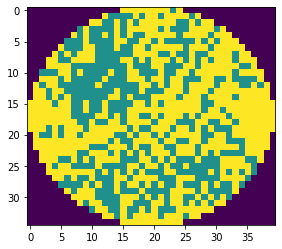

wafer_id:510, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:324, nDefects:586, p=55.290


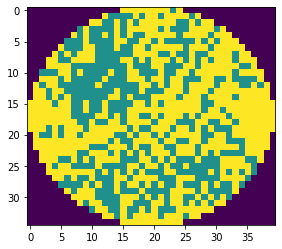

wafer_id:510, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:317, nDefects:574, p=55.226


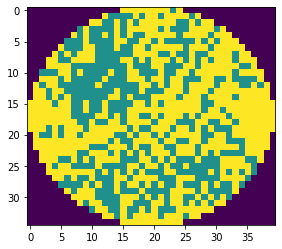

wafer_id:510, ウエハサイズ:35x40, スタンプサイズ:4x3, oDefects:312, nDefects:563, p=55.417


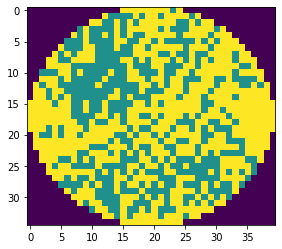

wafer_id:510, ウエハサイズ:35x40, スタンプサイズ:2x4, oDefects:320, nDefects:586, p=54.608


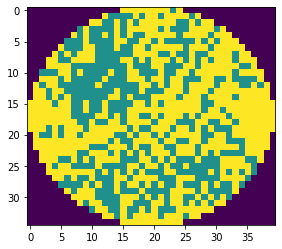

wafer_id:510, ウエハサイズ:35x40, スタンプサイズ:3x4, oDefects:313, nDefects:574, p=54.530


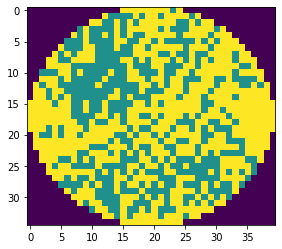

wafer_id:510, ウエハサイズ:35x40, スタンプサイズ:4x4, oDefects:309, nDefects:563, p=54.885


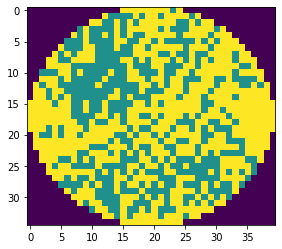

wafer_id:512, ウエハサイズ:35x40, スタンプサイズ:2x2, oDefects:362, nDefects:618, p=58.576


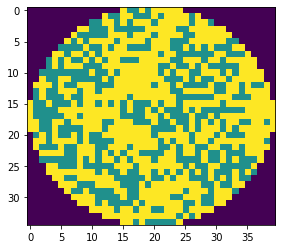

wafer_id:512, ウエハサイズ:35x40, スタンプサイズ:3x2, oDefects:350, nDefects:604, p=57.947


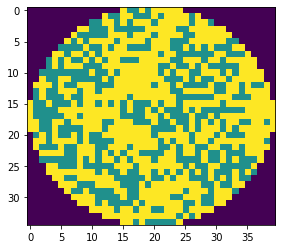

wafer_id:512, ウエハサイズ:35x40, スタンプサイズ:4x2, oDefects:342, nDefects:589, p=58.065


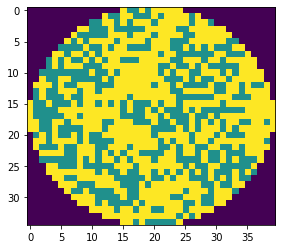

wafer_id:512, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:334, nDefects:588, p=56.803


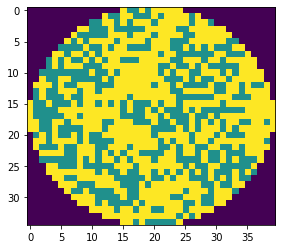

wafer_id:512, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:324, nDefects:574, p=56.446


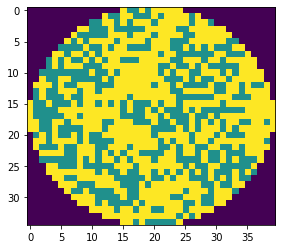

wafer_id:512, ウエハサイズ:35x40, スタンプサイズ:4x3, oDefects:315, nDefects:559, p=56.351


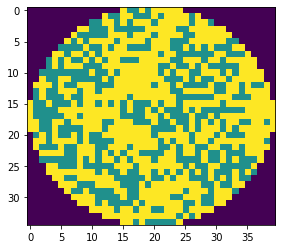

wafer_id:512, ウエハサイズ:35x40, スタンプサイズ:2x4, oDefects:325, nDefects:588, p=55.272


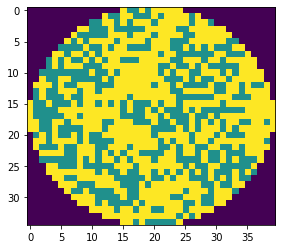

wafer_id:512, ウエハサイズ:35x40, スタンプサイズ:3x4, oDefects:315, nDefects:574, p=54.878


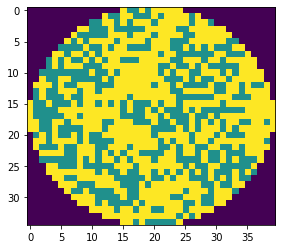

wafer_id:512, ウエハサイズ:35x40, スタンプサイズ:4x4, oDefects:307, nDefects:559, p=54.919


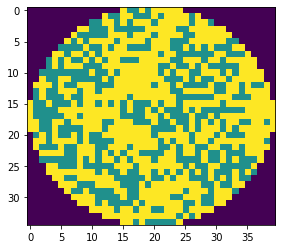

wafer_id:515, ウエハサイズ:35x40, スタンプサイズ:2x2, oDefects:278, nDefects:505, p=55.050


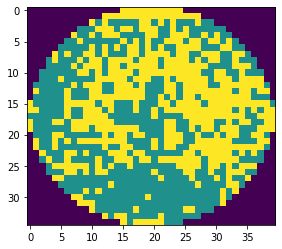

wafer_id:515, ウエハサイズ:35x40, スタンプサイズ:3x2, oDefects:277, nDefects:501, p=55.289


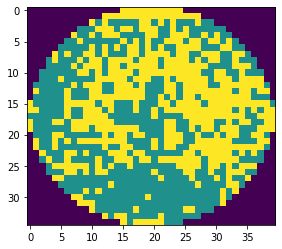

wafer_id:515, ウエハサイズ:35x40, スタンプサイズ:4x2, oDefects:277, nDefects:497, p=55.734


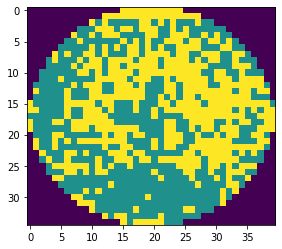

wafer_id:515, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:271, nDefects:488, p=55.533


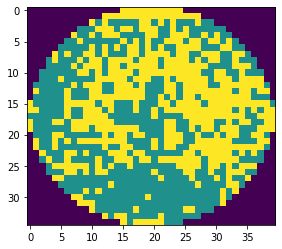

wafer_id:515, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:270, nDefects:484, p=55.785


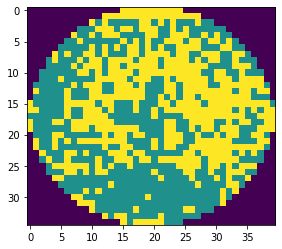

wafer_id:515, ウエハサイズ:35x40, スタンプサイズ:4x3, oDefects:270, nDefects:480, p=56.250


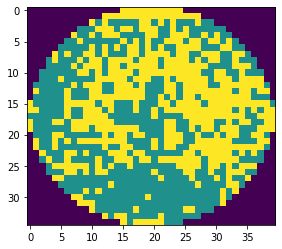

wafer_id:515, ウエハサイズ:35x40, スタンプサイズ:2x4, oDefects:261, nDefects:488, p=53.484


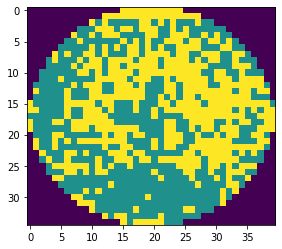

wafer_id:515, ウエハサイズ:35x40, スタンプサイズ:3x4, oDefects:261, nDefects:484, p=53.926


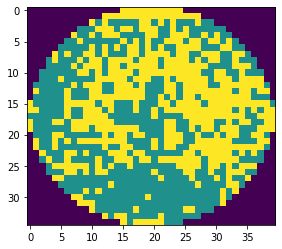

wafer_id:515, ウエハサイズ:35x40, スタンプサイズ:4x4, oDefects:261, nDefects:480, p=54.375


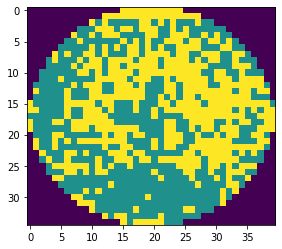

wafer_id:516, ウエハサイズ:35x40, スタンプサイズ:2x2, oDefects:315, nDefects:544, p=57.904


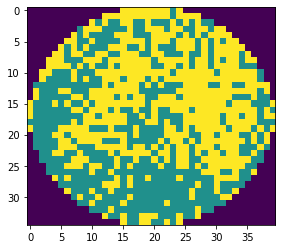

wafer_id:516, ウエハサイズ:35x40, スタンプサイズ:3x2, oDefects:314, nDefects:537, p=58.473


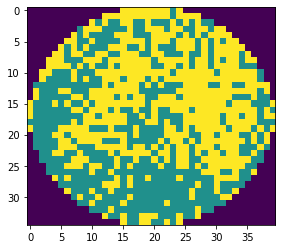

wafer_id:516, ウエハサイズ:35x40, スタンプサイズ:4x2, oDefects:314, nDefects:535, p=58.692


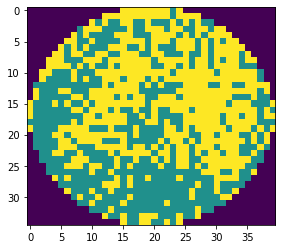

wafer_id:516, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:301, nDefects:528, p=57.008


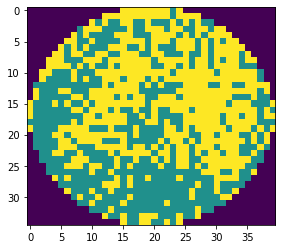

wafer_id:516, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:298, nDefects:521, p=57.198


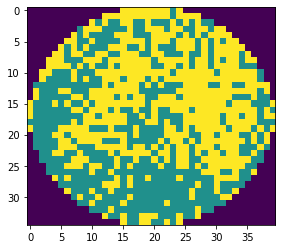

wafer_id:516, ウエハサイズ:35x40, スタンプサイズ:4x3, oDefects:298, nDefects:519, p=57.418


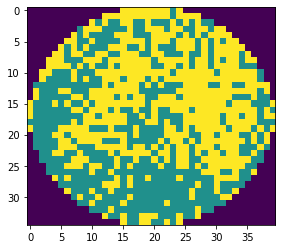

wafer_id:516, ウエハサイズ:35x40, スタンプサイズ:2x4, oDefects:290, nDefects:528, p=54.924


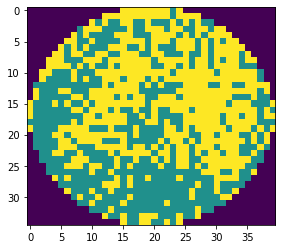

wafer_id:516, ウエハサイズ:35x40, スタンプサイズ:3x4, oDefects:288, nDefects:521, p=55.278


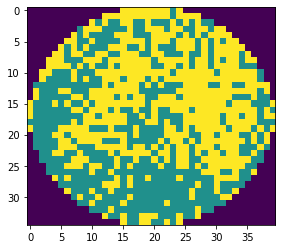

wafer_id:516, ウエハサイズ:35x40, スタンプサイズ:4x4, oDefects:288, nDefects:519, p=55.491


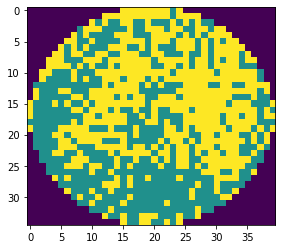

wafer_id:518, ウエハサイズ:35x40, スタンプサイズ:2x2, oDefects:312, nDefects:562, p=55.516


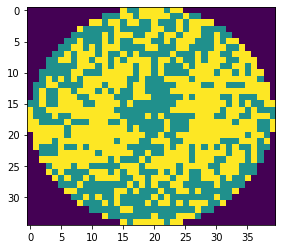

wafer_id:518, ウエハサイズ:35x40, スタンプサイズ:3x2, oDefects:311, nDefects:557, p=55.835


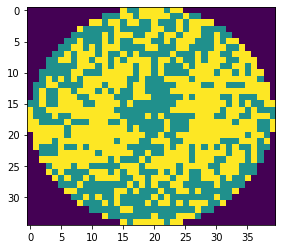

wafer_id:518, ウエハサイズ:35x40, スタンプサイズ:4x2, oDefects:311, nDefects:554, p=56.137


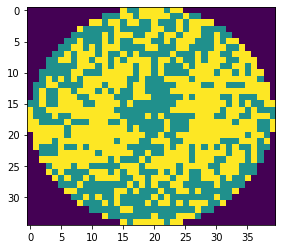

wafer_id:518, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:298, nDefects:541, p=55.083


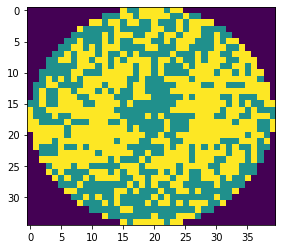

wafer_id:518, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:298, nDefects:536, p=55.597


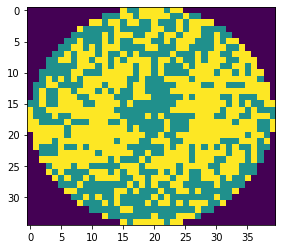

wafer_id:518, ウエハサイズ:35x40, スタンプサイズ:4x3, oDefects:298, nDefects:533, p=55.910


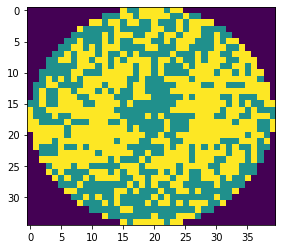

wafer_id:518, ウエハサイズ:35x40, スタンプサイズ:2x4, oDefects:294, nDefects:541, p=54.344


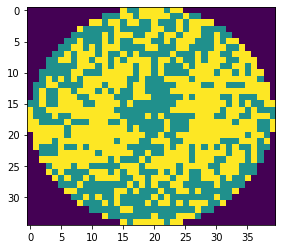

wafer_id:518, ウエハサイズ:35x40, スタンプサイズ:3x4, oDefects:293, nDefects:536, p=54.664


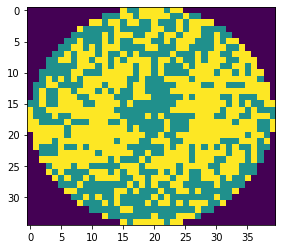

wafer_id:518, ウエハサイズ:35x40, スタンプサイズ:4x4, oDefects:293, nDefects:533, p=54.972


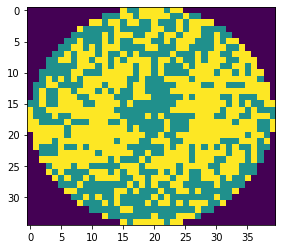

wafer_id:519, ウエハサイズ:35x40, スタンプサイズ:2x2, oDefects:288, nDefects:484, p=59.504


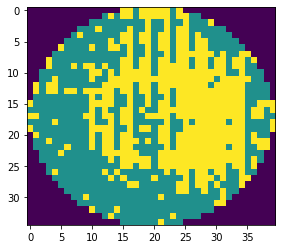

wafer_id:519, ウエハサイズ:35x40, スタンプサイズ:3x2, oDefects:288, nDefects:482, p=59.751


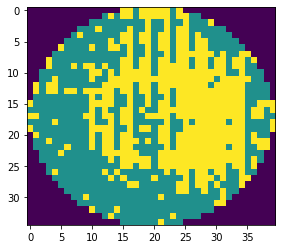

wafer_id:519, ウエハサイズ:35x40, スタンプサイズ:2x4, oDefects:257, nDefects:472, p=54.449


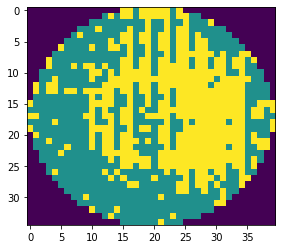

wafer_id:519, ウエハサイズ:35x40, スタンプサイズ:3x4, oDefects:257, nDefects:470, p=54.681


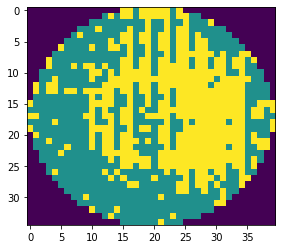

wafer_id:519, ウエハサイズ:35x40, スタンプサイズ:4x4, oDefects:256, nDefects:468, p=54.701


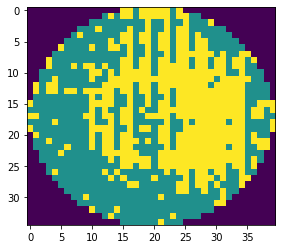

wafer_id:523, ウエハサイズ:35x40, スタンプサイズ:2x3, oDefects:348, nDefects:607, p=57.331


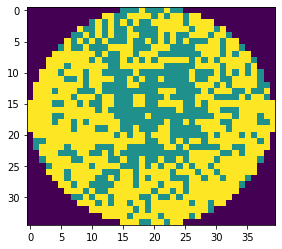

wafer_id:523, ウエハサイズ:35x40, スタンプサイズ:3x3, oDefects:340, nDefects:594, p=57.239


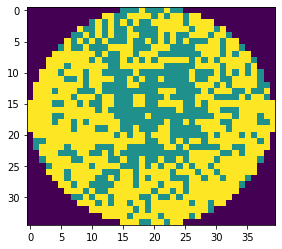

wafer_id:523, ウエハサイズ:35x40, スタンプサイズ:4x3, oDefects:328, nDefects:577, p=56.846


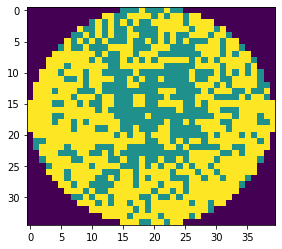

wafer_id:523, ウエハサイズ:35x40, スタンプサイズ:2x4, oDefects:332, nDefects:607, p=54.695


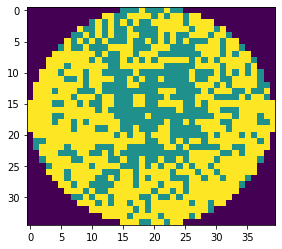

wafer_id:523, ウエハサイズ:35x40, スタンプサイズ:3x4, oDefects:325, nDefects:594, p=54.714


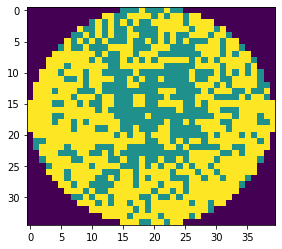

wafer_id:523, ウエハサイズ:35x40, スタンプサイズ:4x4, oDefects:314, nDefects:577, p=54.419


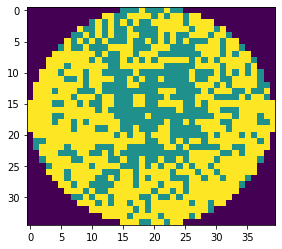

wafer_id:526, ウエハサイズ:27x25, スタンプサイズ:2x2, oDefects:139, nDefects:267, p=52.060


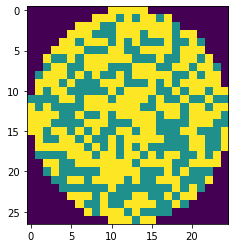

wafer_id:526, ウエハサイズ:27x25, スタンプサイズ:3x2, oDefects:141, nDefects:272, p=51.838


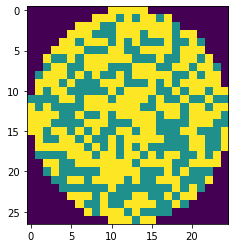

wafer_id:526, ウエハサイズ:27x25, スタンプサイズ:4x2, oDefects:134, nDefects:255, p=52.549


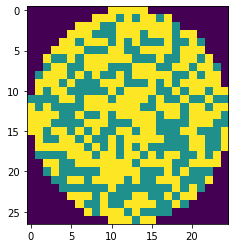

wafer_id:531, ウエハサイズ:31x31, スタンプサイズ:2x4, oDefects:196, nDefects:332, p=59.036


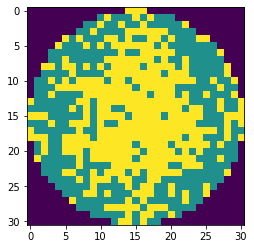

wafer_id:531, ウエハサイズ:31x31, スタンプサイズ:3x4, oDefects:196, nDefects:332, p=59.036


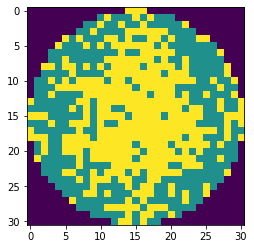

wafer_id:531, ウエハサイズ:31x31, スタンプサイズ:4x4, oDefects:191, nDefects:320, p=59.688


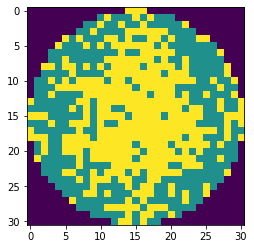

wafer_id:532, ウエハサイズ:31x31, スタンプサイズ:4x2, oDefects:145, nDefects:290, p=50.000


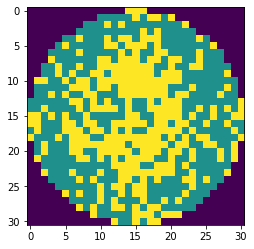

wafer_id:532, ウエハサイズ:31x31, スタンプサイズ:2x3, oDefects:156, nDefects:301, p=51.827


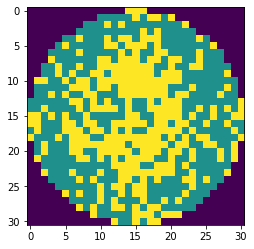

wafer_id:532, ウエハサイズ:31x31, スタンプサイズ:3x3, oDefects:156, nDefects:301, p=51.827


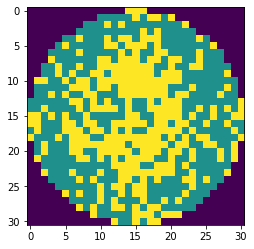

wafer_id:532, ウエハサイズ:31x31, スタンプサイズ:4x3, oDefects:151, nDefects:287, p=52.613


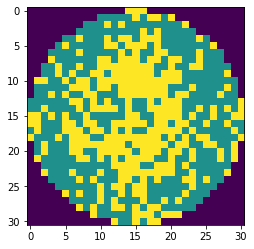

wafer_id:533, ウエハサイズ:31x31, スタンプサイズ:2x2, oDefects:181, nDefects:329, p=55.015


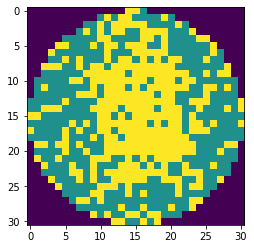

wafer_id:533, ウエハサイズ:31x31, スタンプサイズ:3x2, oDefects:181, nDefects:329, p=55.015


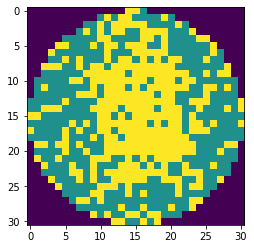

wafer_id:533, ウエハサイズ:31x31, スタンプサイズ:4x2, oDefects:179, nDefects:319, p=56.113


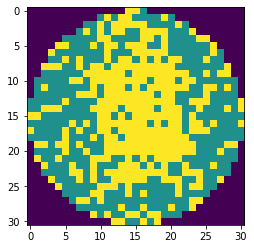

wafer_id:533, ウエハサイズ:31x31, スタンプサイズ:2x3, oDefects:174, nDefects:326, p=53.374


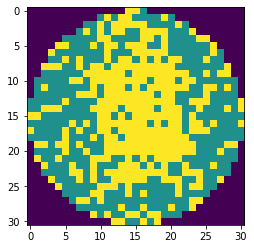

wafer_id:533, ウエハサイズ:31x31, スタンプサイズ:3x3, oDefects:174, nDefects:326, p=53.374


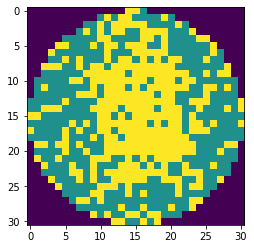

wafer_id:533, ウエハサイズ:31x31, スタンプサイズ:4x3, oDefects:169, nDefects:316, p=53.481


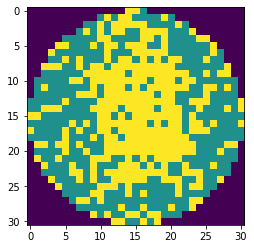

wafer_id:533, ウエハサイズ:31x31, スタンプサイズ:2x4, oDefects:160, nDefects:305, p=52.459


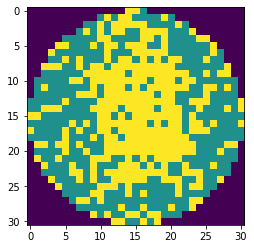

wafer_id:533, ウエハサイズ:31x31, スタンプサイズ:3x4, oDefects:160, nDefects:305, p=52.459


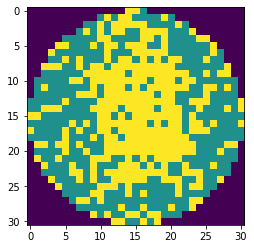

wafer_id:533, ウエハサイズ:31x31, スタンプサイズ:4x4, oDefects:157, nDefects:295, p=53.220


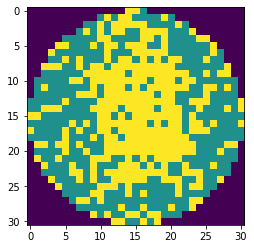

wafer_id:534, ウエハサイズ:32x29, スタンプサイズ:2x2, oDefects:184, nDefects:357, p=51.541


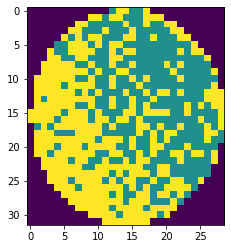

wafer_id:534, ウエハサイズ:32x29, スタンプサイズ:3x2, oDefects:172, nDefects:340, p=50.588


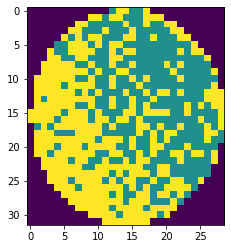

wafer_id:534, ウエハサイズ:32x29, スタンプサイズ:4x2, oDefects:184, nDefects:357, p=51.541


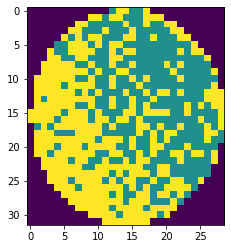

wafer_id:534, ウエハサイズ:32x29, スタンプサイズ:2x3, oDefects:188, nDefects:349, p=53.868


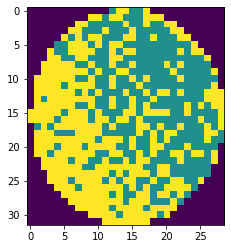

wafer_id:534, ウエハサイズ:32x29, スタンプサイズ:3x3, oDefects:178, nDefects:332, p=53.614


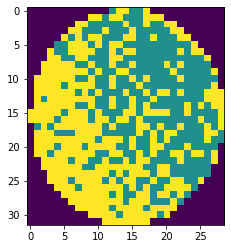

wafer_id:534, ウエハサイズ:32x29, スタンプサイズ:4x3, oDefects:188, nDefects:349, p=53.868


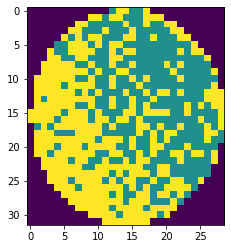

wafer_id:535, ウエハサイズ:32x29, スタンプサイズ:2x4, oDefects:200, nDefects:359, p=55.710


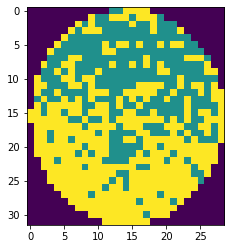

wafer_id:535, ウエハサイズ:32x29, スタンプサイズ:3x4, oDefects:190, nDefects:341, p=55.718


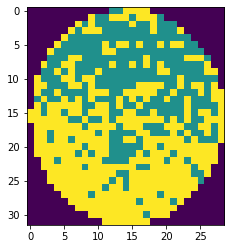

wafer_id:535, ウエハサイズ:32x29, スタンプサイズ:4x4, oDefects:200, nDefects:359, p=55.710


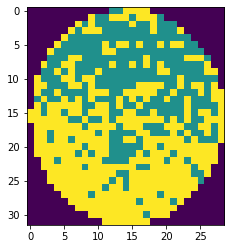

wafer_id:538, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:114, nDefects:228, p=50.000


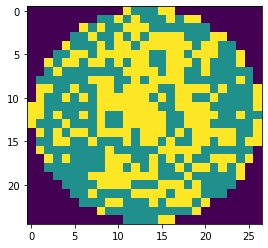

wafer_id:538, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:114, nDefects:228, p=50.000


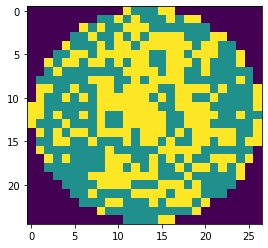

wafer_id:538, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:114, nDefects:228, p=50.000


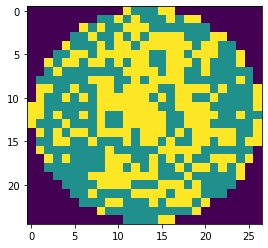

wafer_id:539, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:121, nDefects:233, p=51.931


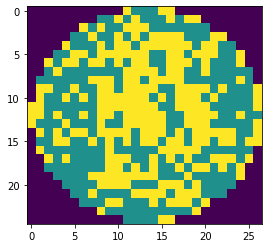

wafer_id:539, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:121, nDefects:233, p=51.931


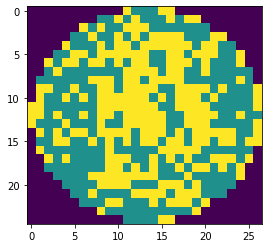

wafer_id:539, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:121, nDefects:233, p=51.931


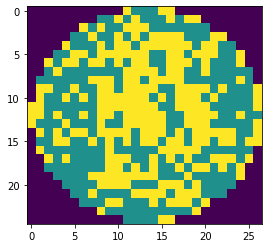

wafer_id:540, ウエハサイズ:49x39, スタンプサイズ:2x2, oDefects:470, nDefects:818, p=57.457


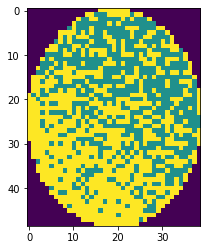

wafer_id:540, ウエハサイズ:49x39, スタンプサイズ:3x2, oDefects:470, nDefects:818, p=57.457


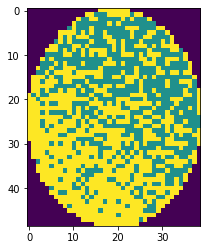

wafer_id:540, ウエハサイズ:49x39, スタンプサイズ:4x2, oDefects:470, nDefects:818, p=57.457


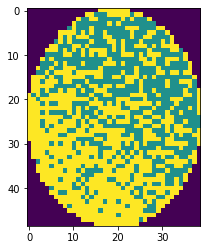

wafer_id:540, ウエハサイズ:49x39, スタンプサイズ:2x3, oDefects:439, nDefects:818, p=53.667


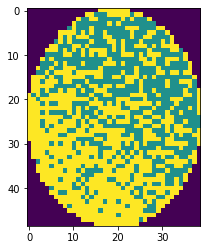

wafer_id:540, ウエハサイズ:49x39, スタンプサイズ:3x3, oDefects:439, nDefects:818, p=53.667


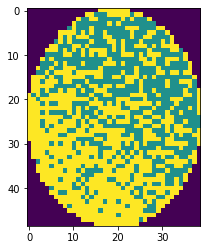

wafer_id:540, ウエハサイズ:49x39, スタンプサイズ:4x3, oDefects:439, nDefects:818, p=53.667


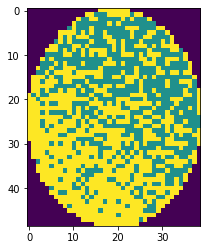

wafer_id:540, ウエハサイズ:49x39, スタンプサイズ:2x4, oDefects:430, nDefects:761, p=56.505


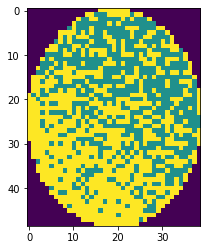

wafer_id:540, ウエハサイズ:49x39, スタンプサイズ:3x4, oDefects:430, nDefects:761, p=56.505


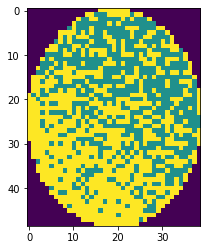

wafer_id:540, ウエハサイズ:49x39, スタンプサイズ:4x4, oDefects:430, nDefects:761, p=56.505


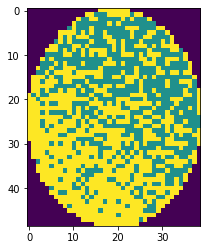

wafer_id:541, ウエハサイズ:32x29, スタンプサイズ:2x2, oDefects:188, nDefects:359, p=52.368


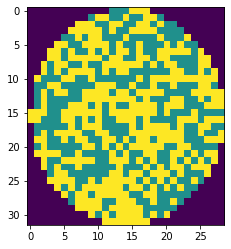

wafer_id:541, ウエハサイズ:32x29, スタンプサイズ:3x2, oDefects:177, nDefects:344, p=51.453


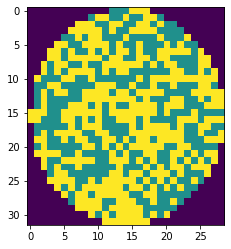

wafer_id:541, ウエハサイズ:32x29, スタンプサイズ:4x2, oDefects:188, nDefects:359, p=52.368


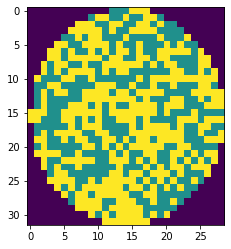

wafer_id:541, ウエハサイズ:32x29, スタンプサイズ:2x3, oDefects:174, nDefects:340, p=51.176


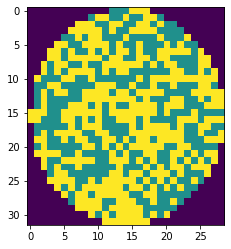

wafer_id:541, ウエハサイズ:32x29, スタンプサイズ:3x3, oDefects:167, nDefects:325, p=51.385


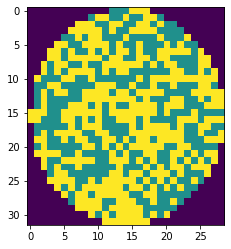

wafer_id:541, ウエハサイズ:32x29, スタンプサイズ:4x3, oDefects:174, nDefects:340, p=51.176


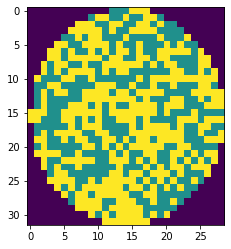

wafer_id:541, ウエハサイズ:32x29, スタンプサイズ:2x4, oDefects:170, nDefects:340, p=50.000


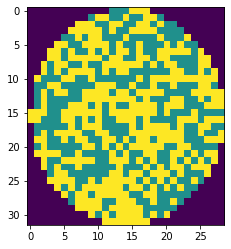

wafer_id:541, ウエハサイズ:32x29, スタンプサイズ:3x4, oDefects:163, nDefects:325, p=50.154


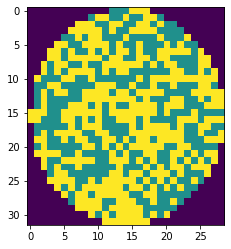

wafer_id:541, ウエハサイズ:32x29, スタンプサイズ:4x4, oDefects:170, nDefects:340, p=50.000


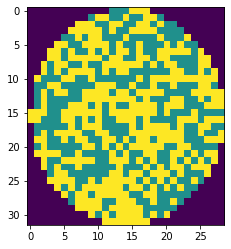

wafer_id:542, ウエハサイズ:32x29, スタンプサイズ:2x2, oDefects:174, nDefects:346, p=50.289


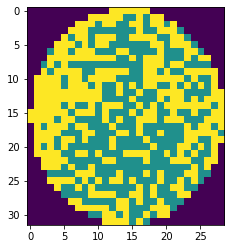

wafer_id:542, ウエハサイズ:32x29, スタンプサイズ:3x2, oDefects:169, nDefects:335, p=50.448


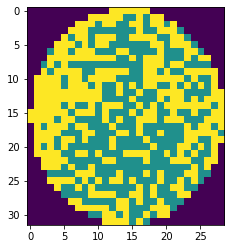

wafer_id:542, ウエハサイズ:32x29, スタンプサイズ:4x2, oDefects:174, nDefects:346, p=50.289


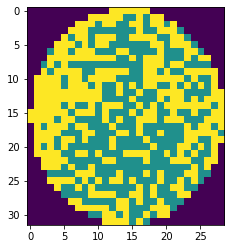

wafer_id:543, ウエハサイズ:32x29, スタンプサイズ:2x2, oDefects:238, nDefects:405, p=58.765


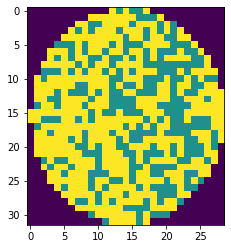

wafer_id:543, ウエハサイズ:32x29, スタンプサイズ:3x2, oDefects:230, nDefects:393, p=58.524


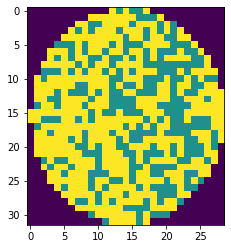

wafer_id:543, ウエハサイズ:32x29, スタンプサイズ:4x2, oDefects:238, nDefects:405, p=58.765


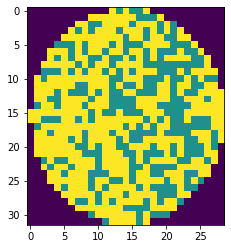

wafer_id:543, ウエハサイズ:32x29, スタンプサイズ:2x3, oDefects:210, nDefects:384, p=54.688


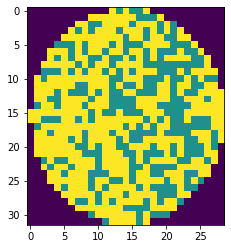

wafer_id:543, ウエハサイズ:32x29, スタンプサイズ:3x3, oDefects:204, nDefects:372, p=54.839


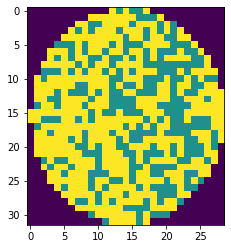

wafer_id:543, ウエハサイズ:32x29, スタンプサイズ:4x3, oDefects:210, nDefects:384, p=54.688


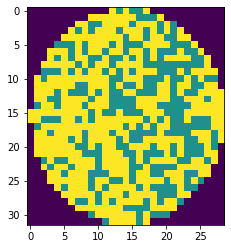

wafer_id:543, ウエハサイズ:32x29, スタンプサイズ:2x4, oDefects:208, nDefects:384, p=54.167


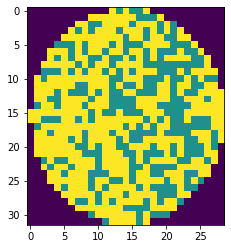

wafer_id:543, ウエハサイズ:32x29, スタンプサイズ:3x4, oDefects:204, nDefects:372, p=54.839


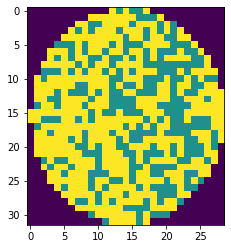

wafer_id:543, ウエハサイズ:32x29, スタンプサイズ:4x4, oDefects:208, nDefects:384, p=54.167


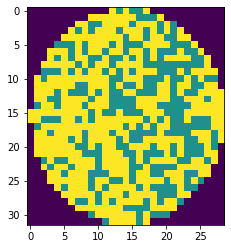

wafer_id:544, ウエハサイズ:32x29, スタンプサイズ:2x3, oDefects:170, nDefects:339, p=50.147


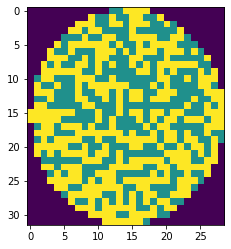

wafer_id:544, ウエハサイズ:32x29, スタンプサイズ:3x3, oDefects:164, nDefects:325, p=50.462


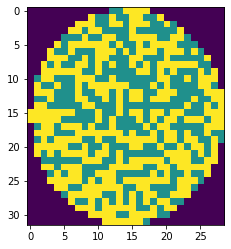

wafer_id:544, ウエハサイズ:32x29, スタンプサイズ:4x3, oDefects:170, nDefects:339, p=50.147


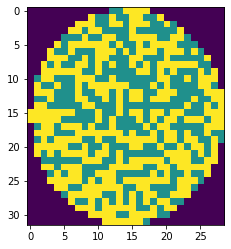

wafer_id:545, ウエハサイズ:32x29, スタンプサイズ:2x3, oDefects:238, nDefects:402, p=59.204


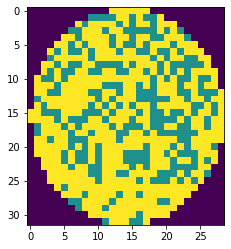

wafer_id:545, ウエハサイズ:32x29, スタンプサイズ:3x3, oDefects:230, nDefects:387, p=59.432


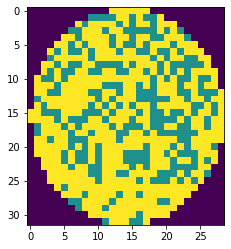

wafer_id:545, ウエハサイズ:32x29, スタンプサイズ:4x3, oDefects:238, nDefects:402, p=59.204


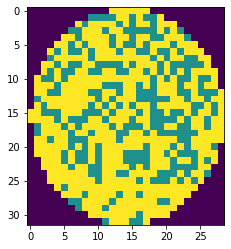

wafer_id:545, ウエハサイズ:32x29, スタンプサイズ:2x4, oDefects:229, nDefects:402, p=56.965


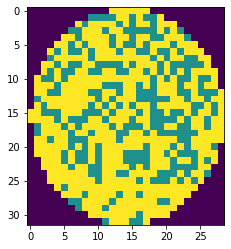

wafer_id:545, ウエハサイズ:32x29, スタンプサイズ:3x4, oDefects:222, nDefects:387, p=57.364


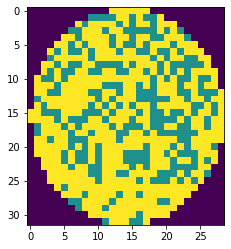

wafer_id:545, ウエハサイズ:32x29, スタンプサイズ:4x4, oDefects:229, nDefects:402, p=56.965


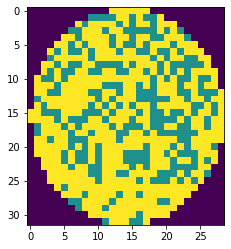

wafer_id:546, ウエハサイズ:32x29, スタンプサイズ:2x3, oDefects:156, nDefects:310, p=50.323


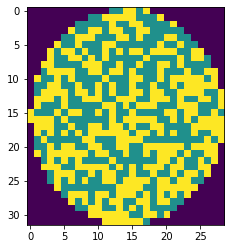

wafer_id:546, ウエハサイズ:32x29, スタンプサイズ:3x3, oDefects:148, nDefects:295, p=50.169


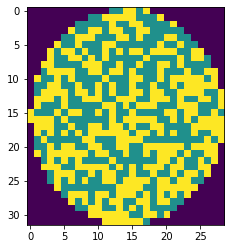

wafer_id:546, ウエハサイズ:32x29, スタンプサイズ:4x3, oDefects:156, nDefects:310, p=50.323


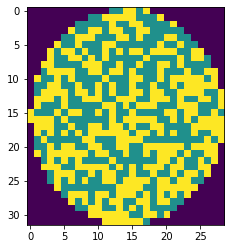

wafer_id:548, ウエハサイズ:32x29, スタンプサイズ:2x4, oDefects:246, nDefects:425, p=57.882


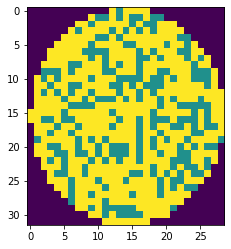

wafer_id:548, ウエハサイズ:32x29, スタンプサイズ:3x4, oDefects:243, nDefects:411, p=59.124


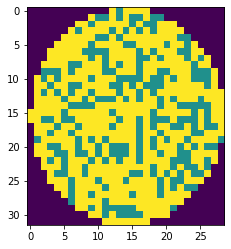

wafer_id:548, ウエハサイズ:32x29, スタンプサイズ:4x4, oDefects:246, nDefects:425, p=57.882


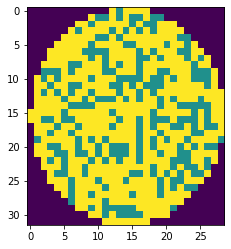

wafer_id:552, ウエハサイズ:33x33, スタンプサイズ:2x4, oDefects:207, nDefects:403, p=51.365


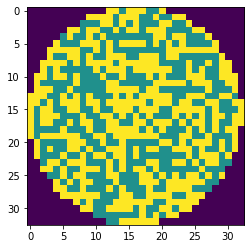

wafer_id:552, ウエハサイズ:33x33, スタンプサイズ:3x4, oDefects:209, nDefects:409, p=51.100


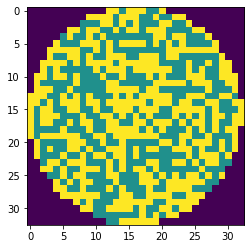

wafer_id:552, ウエハサイズ:33x33, スタンプサイズ:4x4, oDefects:207, nDefects:403, p=51.365


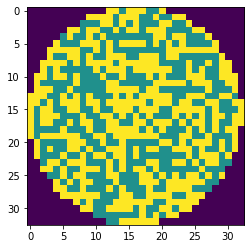

wafer_id:555, ウエハサイズ:32x29, スタンプサイズ:2x2, oDefects:172, nDefects:332, p=51.807


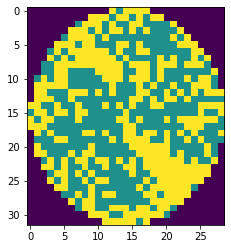

wafer_id:555, ウエハサイズ:32x29, スタンプサイズ:3x2, oDefects:163, nDefects:317, p=51.420


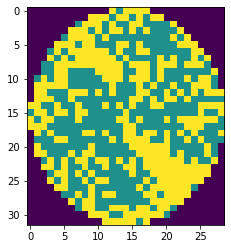

wafer_id:555, ウエハサイズ:32x29, スタンプサイズ:4x2, oDefects:172, nDefects:332, p=51.807


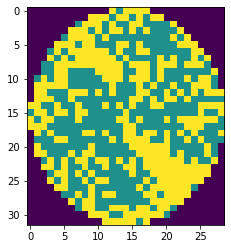

wafer_id:556, ウエハサイズ:32x29, スタンプサイズ:2x3, oDefects:243, nDefects:415, p=58.554


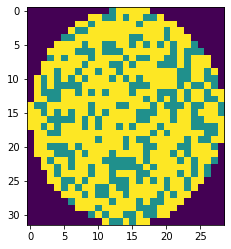

wafer_id:556, ウエハサイズ:32x29, スタンプサイズ:3x3, oDefects:238, nDefects:405, p=58.765


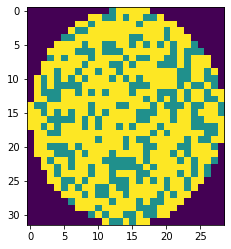

wafer_id:556, ウエハサイズ:32x29, スタンプサイズ:4x3, oDefects:243, nDefects:415, p=58.554


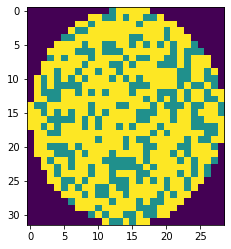

wafer_id:556, ウエハサイズ:32x29, スタンプサイズ:2x4, oDefects:244, nDefects:415, p=58.795


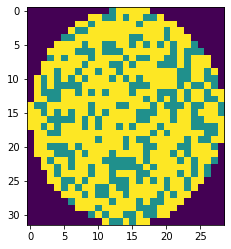

wafer_id:556, ウエハサイズ:32x29, スタンプサイズ:3x4, oDefects:242, nDefects:405, p=59.753


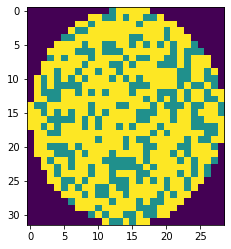

wafer_id:556, ウエハサイズ:32x29, スタンプサイズ:4x4, oDefects:244, nDefects:415, p=58.795


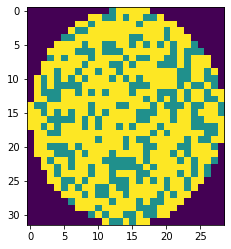

wafer_id:557, ウエハサイズ:32x29, スタンプサイズ:2x2, oDefects:200, nDefects:385, p=51.948


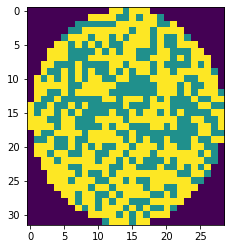

wafer_id:557, ウエハサイズ:32x29, スタンプサイズ:3x2, oDefects:192, nDefects:371, p=51.752


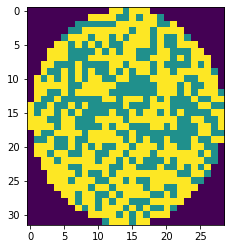

wafer_id:557, ウエハサイズ:32x29, スタンプサイズ:4x2, oDefects:200, nDefects:385, p=51.948


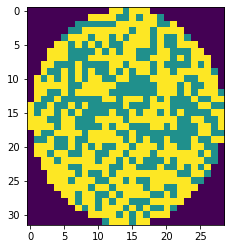

wafer_id:557, ウエハサイズ:32x29, スタンプサイズ:2x3, oDefects:186, nDefects:359, p=51.811


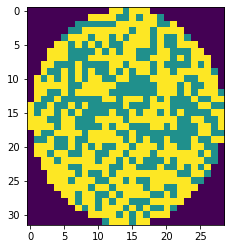

wafer_id:557, ウエハサイズ:32x29, スタンプサイズ:3x3, oDefects:181, nDefects:345, p=52.464


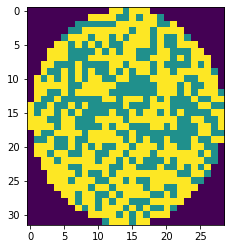

wafer_id:557, ウエハサイズ:32x29, スタンプサイズ:4x3, oDefects:186, nDefects:359, p=51.811


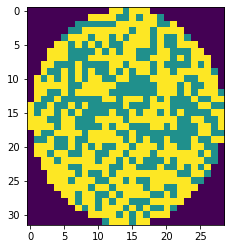

wafer_id:558, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:101, nDefects:199, p=50.754


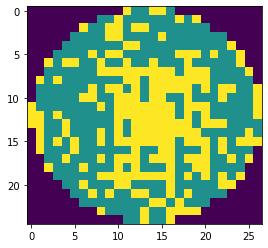

wafer_id:558, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:101, nDefects:199, p=50.754


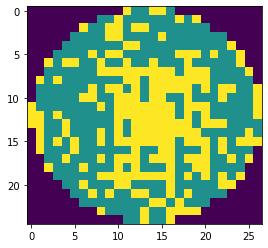

wafer_id:558, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:101, nDefects:199, p=50.754


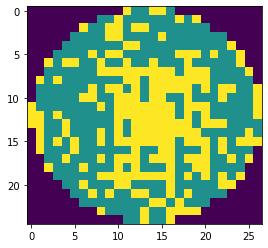

wafer_id:558, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:94, nDefects:175, p=53.714


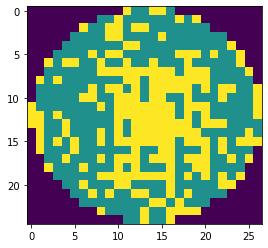

wafer_id:558, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:94, nDefects:175, p=53.714


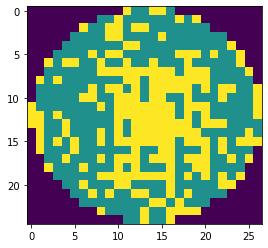

wafer_id:558, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:94, nDefects:175, p=53.714


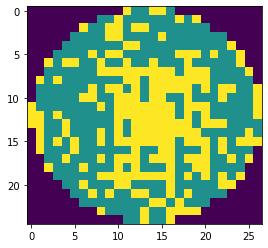

wafer_id:559, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:138, nDefects:273, p=50.549


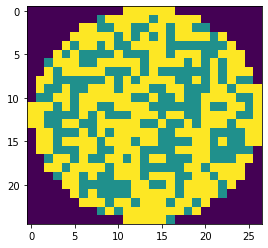

wafer_id:559, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:138, nDefects:273, p=50.549


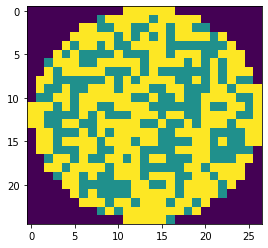

wafer_id:559, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:138, nDefects:273, p=50.549


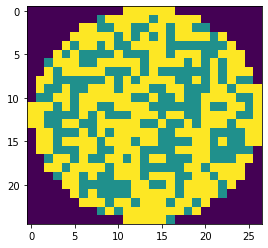

wafer_id:559, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:121, nDefects:230, p=52.609


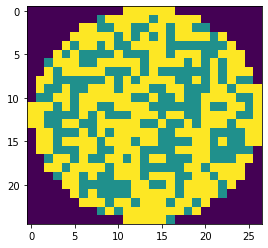

wafer_id:559, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:121, nDefects:230, p=52.609


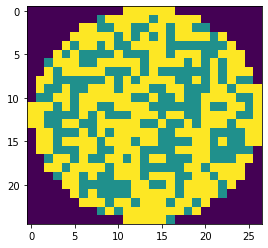

wafer_id:559, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:121, nDefects:230, p=52.609


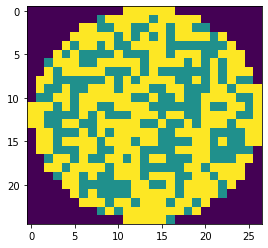

wafer_id:560, ウエハサイズ:32x29, スタンプサイズ:2x2, oDefects:190, nDefects:359, p=52.925


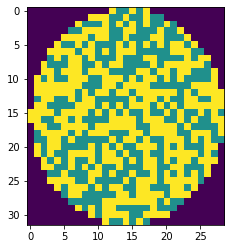

wafer_id:560, ウエハサイズ:32x29, スタンプサイズ:3x2, oDefects:184, nDefects:347, p=53.026


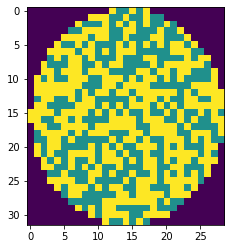

wafer_id:560, ウエハサイズ:32x29, スタンプサイズ:4x2, oDefects:190, nDefects:359, p=52.925


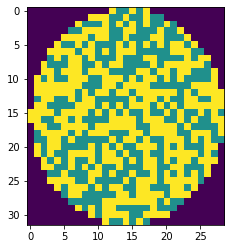

wafer_id:578, ウエハサイズ:26x26, スタンプサイズ:2x2, oDefects:141, nDefects:280, p=50.357


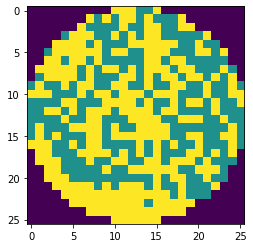

wafer_id:578, ウエハサイズ:26x26, スタンプサイズ:2x3, oDefects:136, nDefects:263, p=51.711


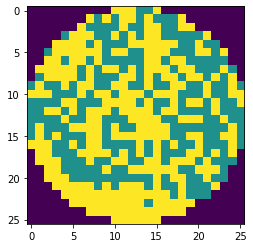

wafer_id:578, ウエハサイズ:26x26, スタンプサイズ:3x3, oDefects:124, nDefects:245, p=50.612


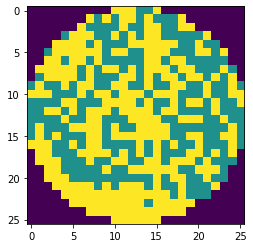

wafer_id:578, ウエハサイズ:26x26, スタンプサイズ:4x3, oDefects:124, nDefects:245, p=50.612


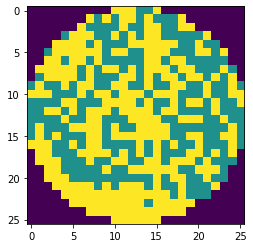

wafer_id:578, ウエハサイズ:26x26, スタンプサイズ:2x4, oDefects:127, nDefects:254, p=50.000


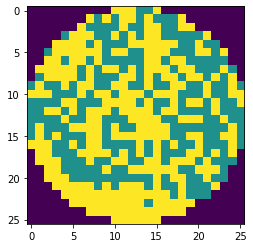

wafer_id:579, ウエハサイズ:26x26, スタンプサイズ:2x2, oDefects:154, nDefects:274, p=56.204


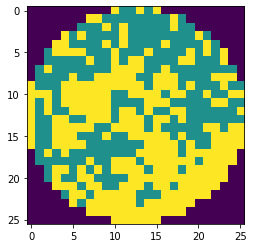

wafer_id:579, ウエハサイズ:26x26, スタンプサイズ:3x2, oDefects:140, nDefects:256, p=54.688


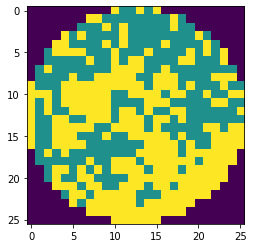

wafer_id:579, ウエハサイズ:26x26, スタンプサイズ:4x2, oDefects:140, nDefects:256, p=54.688


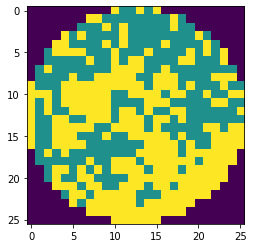

wafer_id:579, ウエハサイズ:26x26, スタンプサイズ:2x3, oDefects:134, nDefects:243, p=55.144


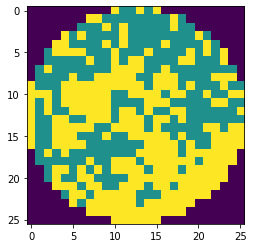

wafer_id:579, ウエハサイズ:26x26, スタンプサイズ:3x3, oDefects:122, nDefects:225, p=54.222


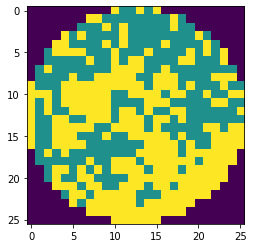

wafer_id:579, ウエハサイズ:26x26, スタンプサイズ:4x3, oDefects:122, nDefects:225, p=54.222


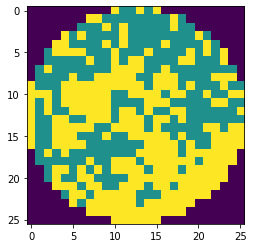

wafer_id:579, ウエハサイズ:26x26, スタンプサイズ:2x4, oDefects:128, nDefects:237, p=54.008


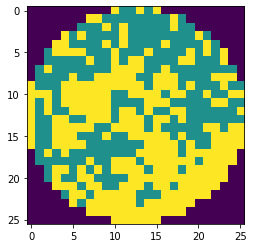

wafer_id:579, ウエハサイズ:26x26, スタンプサイズ:3x4, oDefects:118, nDefects:219, p=53.881


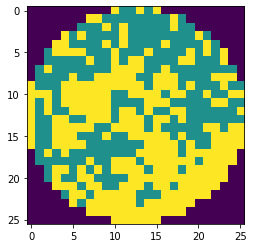

wafer_id:579, ウエハサイズ:26x26, スタンプサイズ:4x4, oDefects:118, nDefects:219, p=53.881


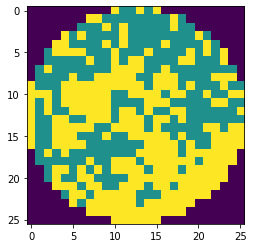

wafer_id:581, ウエハサイズ:26x26, スタンプサイズ:2x2, oDefects:137, nDefects:273, p=50.183


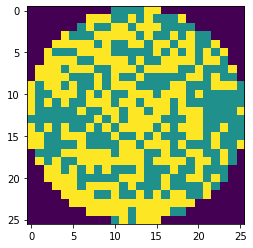

wafer_id:581, ウエハサイズ:26x26, スタンプサイズ:3x4, oDefects:117, nDefects:232, p=50.431


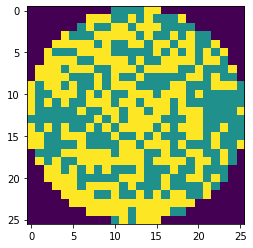

wafer_id:581, ウエハサイズ:26x26, スタンプサイズ:4x4, oDefects:117, nDefects:232, p=50.431


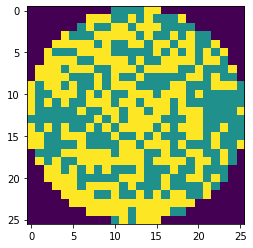

wafer_id:582, ウエハサイズ:26x26, スタンプサイズ:2x2, oDefects:155, nDefects:290, p=53.448


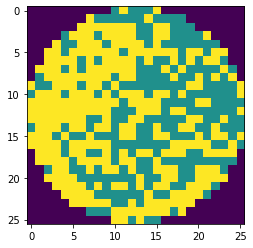

wafer_id:582, ウエハサイズ:26x26, スタンプサイズ:3x2, oDefects:148, nDefects:279, p=53.047


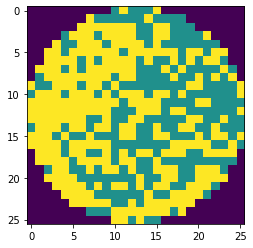

wafer_id:582, ウエハサイズ:26x26, スタンプサイズ:4x2, oDefects:148, nDefects:279, p=53.047


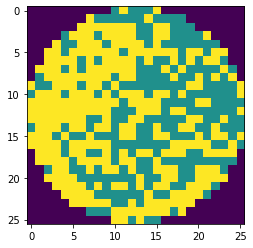

wafer_id:582, ウエハサイズ:26x26, スタンプサイズ:2x3, oDefects:151, nDefects:268, p=56.343


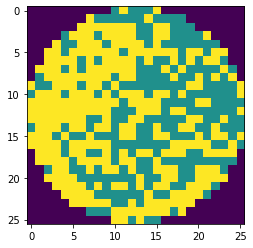

wafer_id:582, ウエハサイズ:26x26, スタンプサイズ:3x3, oDefects:145, nDefects:257, p=56.420


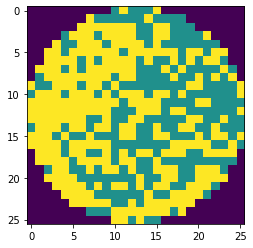

wafer_id:582, ウエハサイズ:26x26, スタンプサイズ:4x3, oDefects:145, nDefects:257, p=56.420


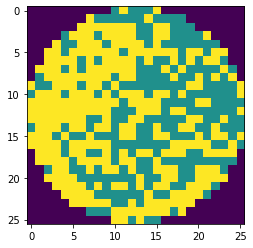

wafer_id:582, ウエハサイズ:26x26, スタンプサイズ:2x4, oDefects:134, nDefects:257, p=52.140


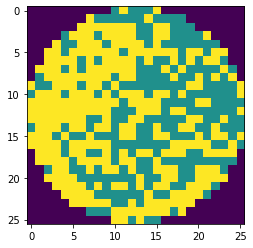

wafer_id:582, ウエハサイズ:26x26, スタンプサイズ:3x4, oDefects:130, nDefects:246, p=52.846


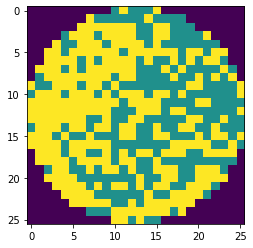

wafer_id:582, ウエハサイズ:26x26, スタンプサイズ:4x4, oDefects:130, nDefects:246, p=52.846


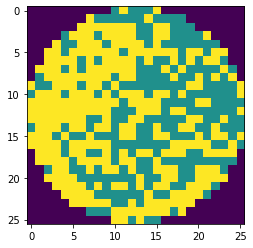

wafer_id:587, ウエハサイズ:26x26, スタンプサイズ:2x2, oDefects:142, nDefects:266, p=53.383


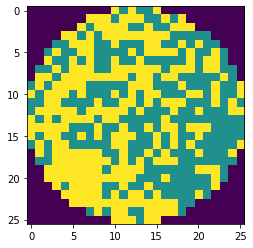

wafer_id:587, ウエハサイズ:26x26, スタンプサイズ:3x2, oDefects:137, nDefects:254, p=53.937


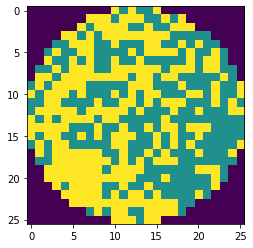

wafer_id:587, ウエハサイズ:26x26, スタンプサイズ:4x2, oDefects:137, nDefects:254, p=53.937


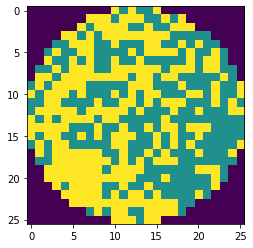

wafer_id:587, ウエハサイズ:26x26, スタンプサイズ:2x3, oDefects:131, nDefects:252, p=51.984


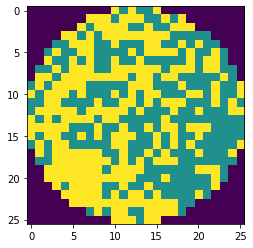

wafer_id:587, ウエハサイズ:26x26, スタンプサイズ:3x3, oDefects:126, nDefects:240, p=52.500


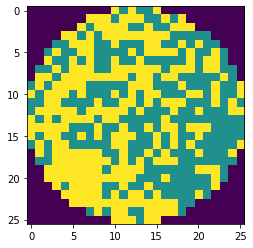

wafer_id:587, ウエハサイズ:26x26, スタンプサイズ:4x3, oDefects:126, nDefects:240, p=52.500


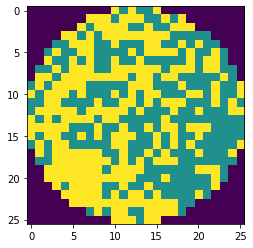

wafer_id:589, ウエハサイズ:26x26, スタンプサイズ:2x2, oDefects:163, nDefects:286, p=56.993


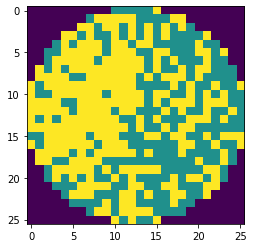

wafer_id:589, ウエハサイズ:26x26, スタンプサイズ:3x2, oDefects:159, nDefects:277, p=57.401


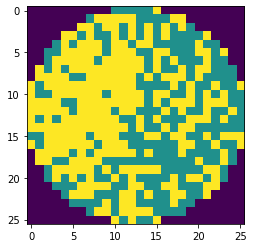

wafer_id:589, ウエハサイズ:26x26, スタンプサイズ:4x2, oDefects:159, nDefects:277, p=57.401


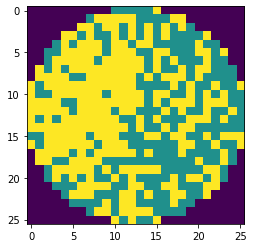

wafer_id:589, ウエハサイズ:26x26, スタンプサイズ:2x3, oDefects:144, nDefects:261, p=55.172


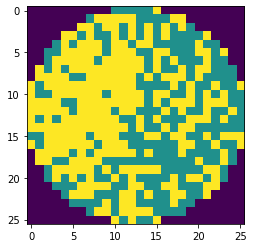

wafer_id:589, ウエハサイズ:26x26, スタンプサイズ:3x3, oDefects:140, nDefects:252, p=55.556


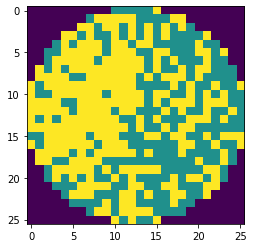

wafer_id:589, ウエハサイズ:26x26, スタンプサイズ:4x3, oDefects:140, nDefects:252, p=55.556


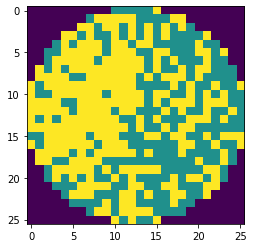

wafer_id:589, ウエハサイズ:26x26, スタンプサイズ:2x4, oDefects:134, nDefects:254, p=52.756


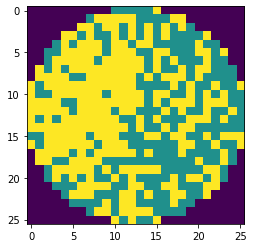

wafer_id:589, ウエハサイズ:26x26, スタンプサイズ:3x4, oDefects:132, nDefects:245, p=53.878


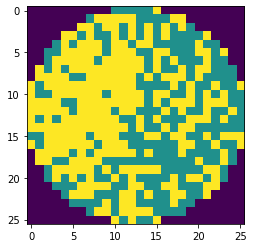

wafer_id:589, ウエハサイズ:26x26, スタンプサイズ:4x4, oDefects:132, nDefects:245, p=53.878


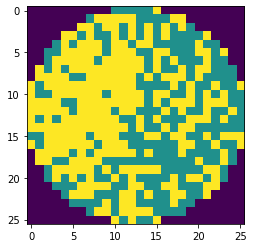

wafer_id:591, ウエハサイズ:26x26, スタンプサイズ:2x2, oDefects:132, nDefects:264, p=50.000


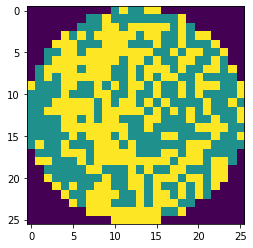

wafer_id:591, ウエハサイズ:26x26, スタンプサイズ:2x3, oDefects:129, nDefects:241, p=53.527


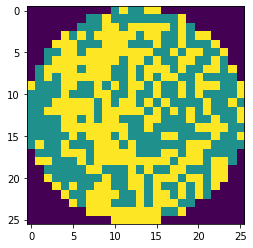

wafer_id:591, ウエハサイズ:26x26, スタンプサイズ:3x3, oDefects:119, nDefects:225, p=52.889


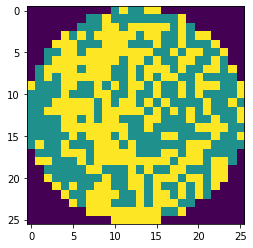

wafer_id:591, ウエハサイズ:26x26, スタンプサイズ:4x3, oDefects:119, nDefects:225, p=52.889


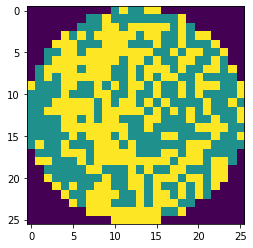

wafer_id:591, ウエハサイズ:26x26, スタンプサイズ:2x4, oDefects:120, nDefects:229, p=52.402


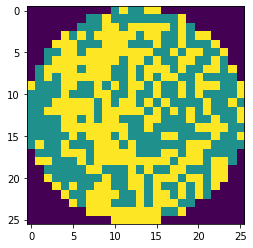

wafer_id:591, ウエハサイズ:26x26, スタンプサイズ:3x4, oDefects:112, nDefects:213, p=52.582


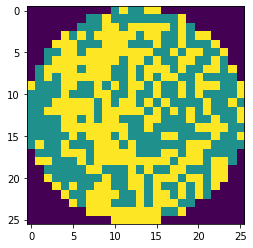

wafer_id:591, ウエハサイズ:26x26, スタンプサイズ:4x4, oDefects:112, nDefects:213, p=52.582


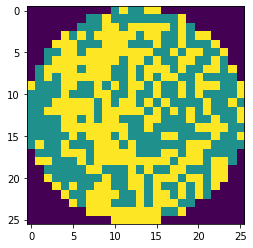

wafer_id:592, ウエハサイズ:26x26, スタンプサイズ:2x2, oDefects:139, nDefects:270, p=51.481


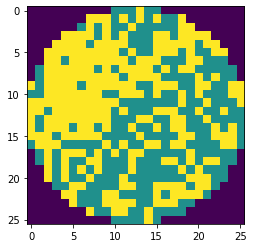

wafer_id:592, ウエハサイズ:26x26, スタンプサイズ:3x2, oDefects:139, nDefects:265, p=52.453


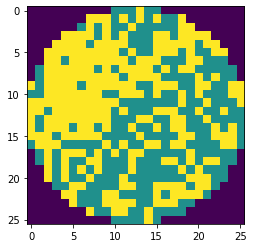

wafer_id:592, ウエハサイズ:26x26, スタンプサイズ:4x2, oDefects:139, nDefects:265, p=52.453


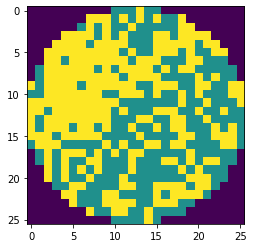

wafer_id:592, ウエハサイズ:26x26, スタンプサイズ:2x4, oDefects:123, nDefects:242, p=50.826


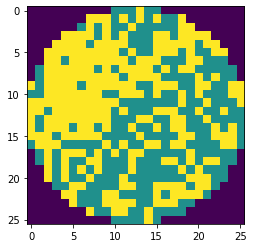

wafer_id:592, ウエハサイズ:26x26, スタンプサイズ:3x4, oDefects:121, nDefects:237, p=51.055


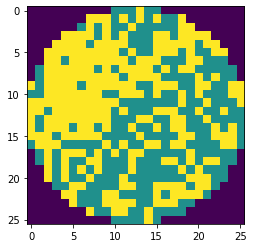

wafer_id:592, ウエハサイズ:26x26, スタンプサイズ:4x4, oDefects:121, nDefects:237, p=51.055


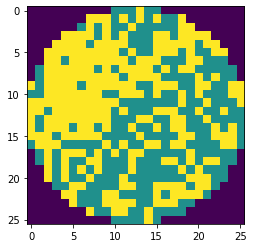

wafer_id:596, ウエハサイズ:26x26, スタンプサイズ:2x4, oDefects:161, nDefects:272, p=59.191


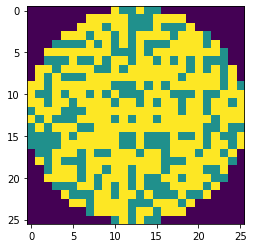

wafer_id:601, ウエハサイズ:26x26, スタンプサイズ:3x2, oDefects:127, nDefects:254, p=50.000


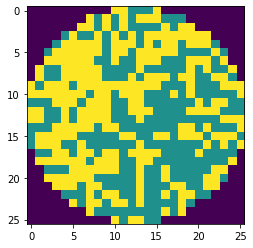

wafer_id:601, ウエハサイズ:26x26, スタンプサイズ:4x2, oDefects:127, nDefects:254, p=50.000


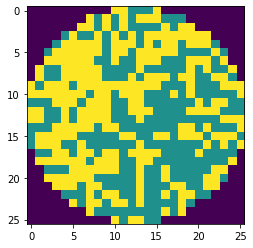

wafer_id:601, ウエハサイズ:26x26, スタンプサイズ:2x3, oDefects:120, nDefects:235, p=51.064


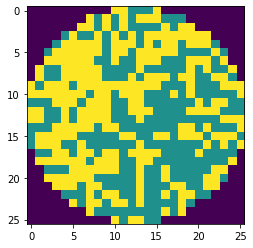

wafer_id:601, ウエハサイズ:26x26, スタンプサイズ:3x3, oDefects:119, nDefects:229, p=51.965


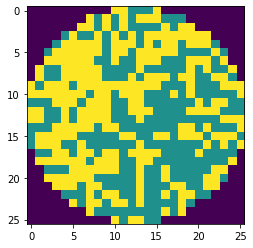

wafer_id:601, ウエハサイズ:26x26, スタンプサイズ:4x3, oDefects:119, nDefects:229, p=51.965


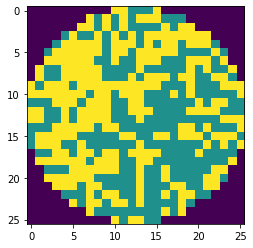

wafer_id:604, ウエハサイズ:30x34, スタンプサイズ:2x2, oDefects:213, nDefects:417, p=51.079


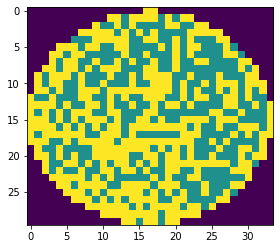

wafer_id:604, ウエハサイズ:30x34, スタンプサイズ:3x2, oDefects:213, nDefects:417, p=51.079


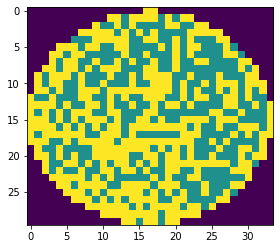

wafer_id:604, ウエハサイズ:30x34, スタンプサイズ:4x2, oDefects:201, nDefects:398, p=50.503


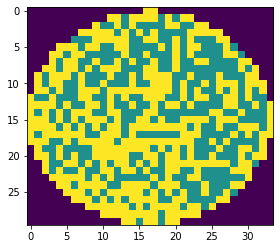

wafer_id:604, ウエハサイズ:30x34, スタンプサイズ:2x3, oDefects:205, nDefects:400, p=51.250


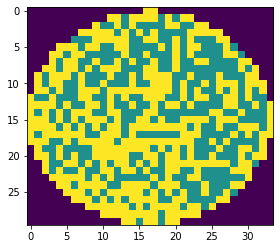

wafer_id:604, ウエハサイズ:30x34, スタンプサイズ:3x3, oDefects:205, nDefects:400, p=51.250


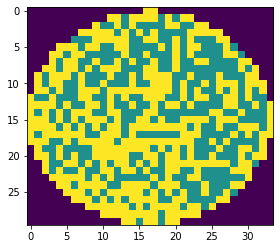

wafer_id:604, ウエハサイズ:30x34, スタンプサイズ:4x3, oDefects:192, nDefects:381, p=50.394


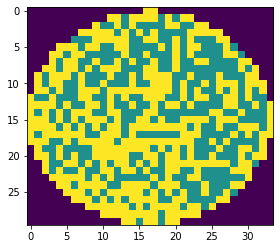

wafer_id:609, ウエハサイズ:30x34, スタンプサイズ:2x2, oDefects:180, nDefects:320, p=56.250


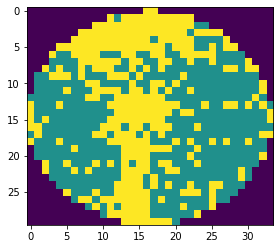

wafer_id:609, ウエハサイズ:30x34, スタンプサイズ:3x2, oDefects:180, nDefects:320, p=56.250


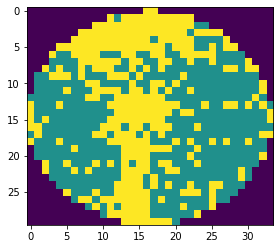

wafer_id:609, ウエハサイズ:30x34, スタンプサイズ:4x2, oDefects:171, nDefects:306, p=55.882


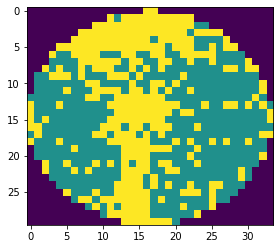

wafer_id:609, ウエハサイズ:30x34, スタンプサイズ:2x3, oDefects:164, nDefects:314, p=52.229


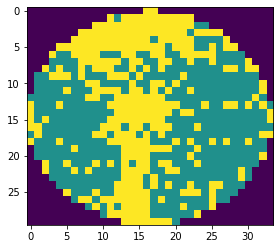

wafer_id:609, ウエハサイズ:30x34, スタンプサイズ:3x3, oDefects:164, nDefects:314, p=52.229


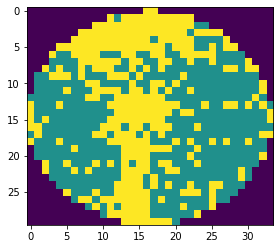

wafer_id:609, ウエハサイズ:30x34, スタンプサイズ:4x3, oDefects:157, nDefects:300, p=52.333


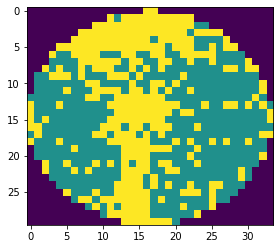

wafer_id:609, ウエハサイズ:30x34, スタンプサイズ:4x4, oDefects:149, nDefects:295, p=50.508


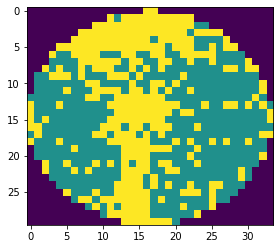

wafer_id:610, ウエハサイズ:30x34, スタンプサイズ:2x2, oDefects:167, nDefects:322, p=51.863


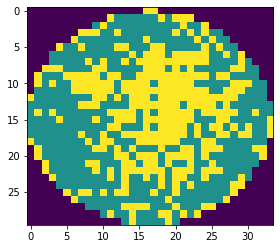

wafer_id:610, ウエハサイズ:30x34, スタンプサイズ:3x2, oDefects:167, nDefects:322, p=51.863


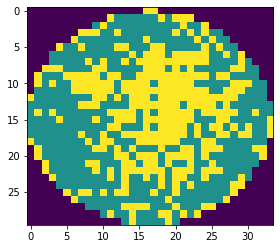

wafer_id:610, ウエハサイズ:30x34, スタンプサイズ:4x2, oDefects:165, nDefects:314, p=52.548


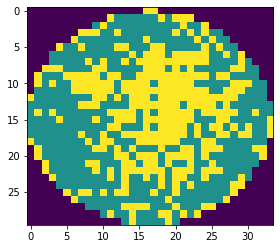

wafer_id:612, ウエハサイズ:30x34, スタンプサイズ:2x2, oDefects:194, nDefects:370, p=52.432


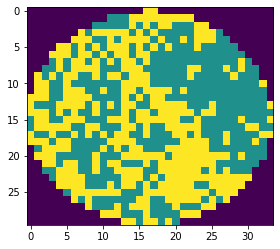

wafer_id:612, ウエハサイズ:30x34, スタンプサイズ:3x2, oDefects:194, nDefects:370, p=52.432


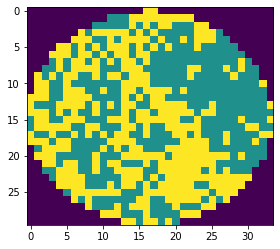

wafer_id:612, ウエハサイズ:30x34, スタンプサイズ:4x2, oDefects:190, nDefects:358, p=53.073


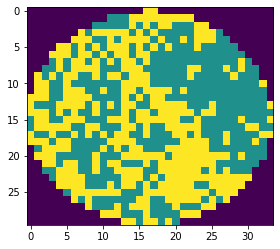

wafer_id:613, ウエハサイズ:30x34, スタンプサイズ:2x2, oDefects:209, nDefects:418, p=50.000


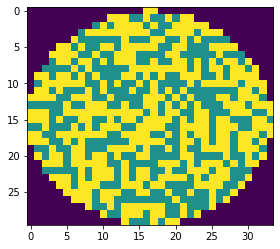

wafer_id:613, ウエハサイズ:30x34, スタンプサイズ:3x2, oDefects:209, nDefects:418, p=50.000


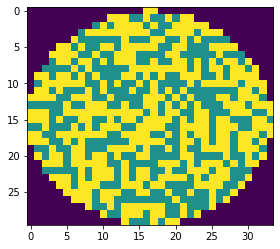

wafer_id:613, ウエハサイズ:30x34, スタンプサイズ:4x2, oDefects:205, nDefects:406, p=50.493


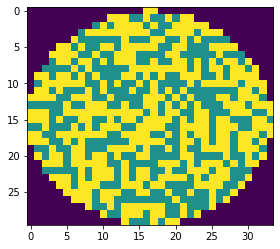

wafer_id:613, ウエハサイズ:30x34, スタンプサイズ:2x3, oDefects:205, nDefects:396, p=51.768


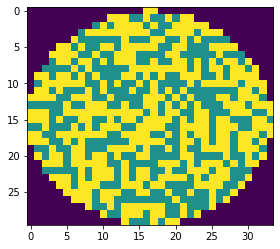

wafer_id:613, ウエハサイズ:30x34, スタンプサイズ:3x3, oDefects:205, nDefects:396, p=51.768


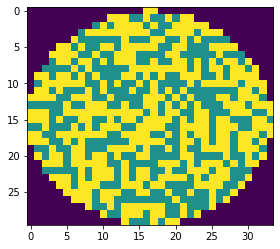

wafer_id:613, ウエハサイズ:30x34, スタンプサイズ:4x3, oDefects:200, nDefects:384, p=52.083


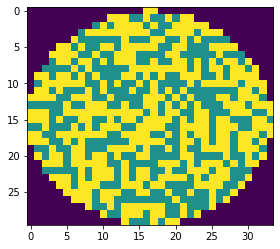

wafer_id:614, ウエハサイズ:30x34, スタンプサイズ:2x3, oDefects:149, nDefects:294, p=50.680


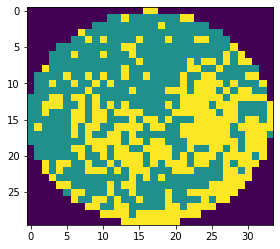

wafer_id:614, ウエハサイズ:30x34, スタンプサイズ:3x3, oDefects:149, nDefects:294, p=50.680


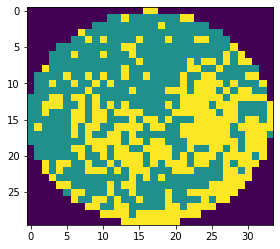

wafer_id:616, ウエハサイズ:32x29, スタンプサイズ:2x2, oDefects:215, nDefects:393, p=54.707


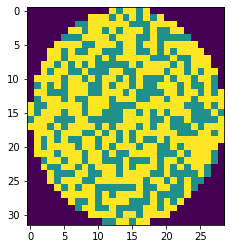

wafer_id:616, ウエハサイズ:32x29, スタンプサイズ:3x2, oDefects:208, nDefects:379, p=54.881


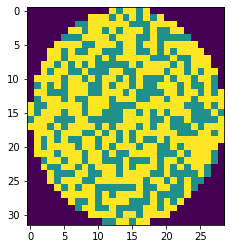

wafer_id:616, ウエハサイズ:32x29, スタンプサイズ:4x2, oDefects:215, nDefects:393, p=54.707


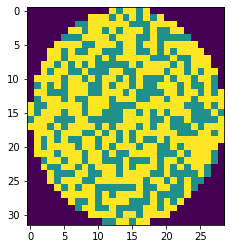

wafer_id:616, ウエハサイズ:32x29, スタンプサイズ:2x3, oDefects:195, nDefects:369, p=52.846


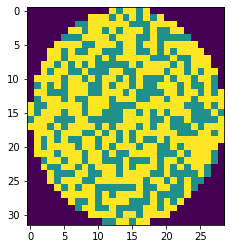

wafer_id:616, ウエハサイズ:32x29, スタンプサイズ:3x3, oDefects:187, nDefects:355, p=52.676


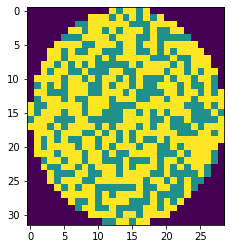

wafer_id:616, ウエハサイズ:32x29, スタンプサイズ:4x3, oDefects:195, nDefects:369, p=52.846


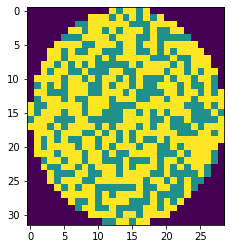

wafer_id:616, ウエハサイズ:32x29, スタンプサイズ:2x4, oDefects:191, nDefects:369, p=51.762


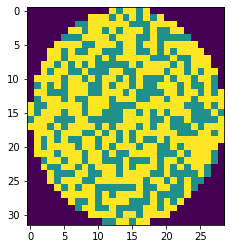

wafer_id:616, ウエハサイズ:32x29, スタンプサイズ:3x4, oDefects:186, nDefects:355, p=52.394


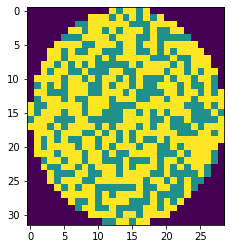

wafer_id:616, ウエハサイズ:32x29, スタンプサイズ:4x4, oDefects:191, nDefects:369, p=51.762


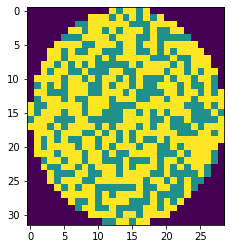

wafer_id:617, ウエハサイズ:32x29, スタンプサイズ:2x4, oDefects:251, nDefects:420, p=59.762


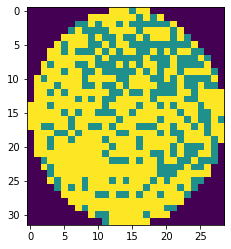

wafer_id:617, ウエハサイズ:32x29, スタンプサイズ:4x4, oDefects:251, nDefects:420, p=59.762


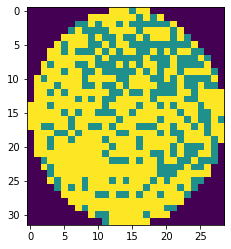

wafer_id:619, ウエハサイズ:32x29, スタンプサイズ:2x2, oDefects:209, nDefects:388, p=53.866


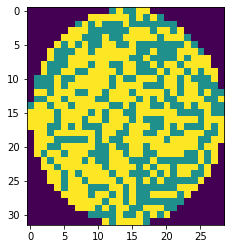

wafer_id:619, ウエハサイズ:32x29, スタンプサイズ:3x2, oDefects:204, nDefects:379, p=53.826


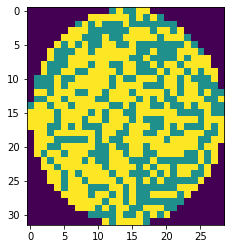

wafer_id:619, ウエハサイズ:32x29, スタンプサイズ:4x2, oDefects:209, nDefects:388, p=53.866


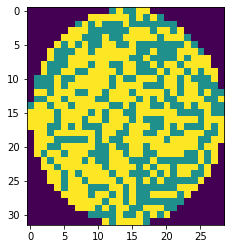

wafer_id:619, ウエハサイズ:32x29, スタンプサイズ:2x3, oDefects:206, nDefects:367, p=56.131


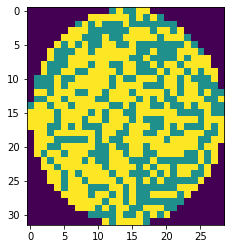

wafer_id:619, ウエハサイズ:32x29, スタンプサイズ:3x3, oDefects:203, nDefects:358, p=56.704


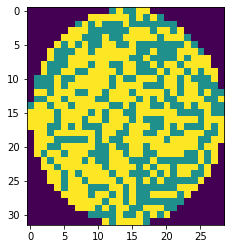

wafer_id:619, ウエハサイズ:32x29, スタンプサイズ:4x3, oDefects:206, nDefects:367, p=56.131


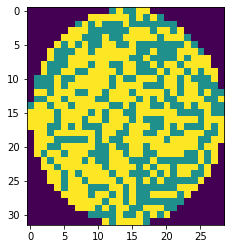

wafer_id:619, ウエハサイズ:32x29, スタンプサイズ:2x4, oDefects:197, nDefects:367, p=53.678


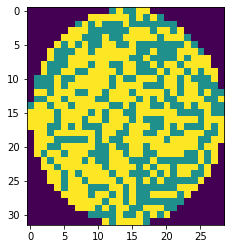

wafer_id:619, ウエハサイズ:32x29, スタンプサイズ:3x4, oDefects:195, nDefects:358, p=54.469


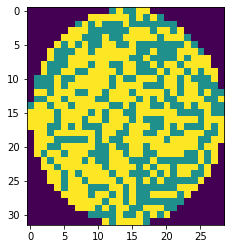

wafer_id:619, ウエハサイズ:32x29, スタンプサイズ:4x4, oDefects:197, nDefects:367, p=53.678


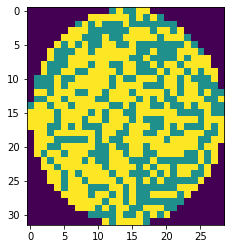

wafer_id:621, ウエハサイズ:32x29, スタンプサイズ:2x3, oDefects:234, nDefects:404, p=57.921


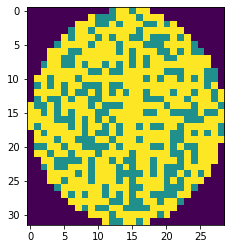

wafer_id:621, ウエハサイズ:32x29, スタンプサイズ:3x3, oDefects:226, nDefects:390, p=57.949


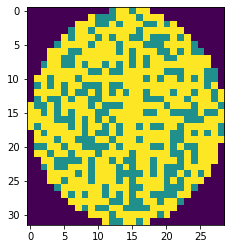

wafer_id:621, ウエハサイズ:32x29, スタンプサイズ:4x3, oDefects:234, nDefects:404, p=57.921


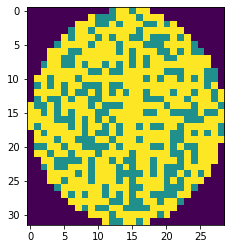

wafer_id:621, ウエハサイズ:32x29, スタンプサイズ:2x4, oDefects:232, nDefects:404, p=57.426


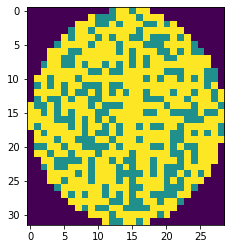

wafer_id:621, ウエハサイズ:32x29, スタンプサイズ:3x4, oDefects:225, nDefects:390, p=57.692


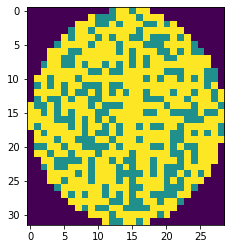

wafer_id:621, ウエハサイズ:32x29, スタンプサイズ:4x4, oDefects:232, nDefects:404, p=57.426


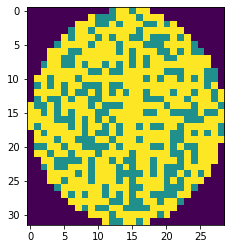

wafer_id:622, ウエハサイズ:32x29, スタンプサイズ:2x2, oDefects:169, nDefects:338, p=50.000


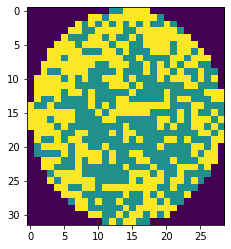

wafer_id:622, ウエハサイズ:32x29, スタンプサイズ:3x2, oDefects:165, nDefects:328, p=50.305


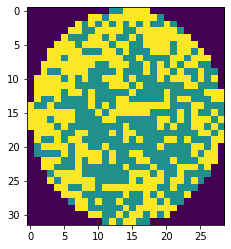

wafer_id:622, ウエハサイズ:32x29, スタンプサイズ:4x2, oDefects:169, nDefects:338, p=50.000


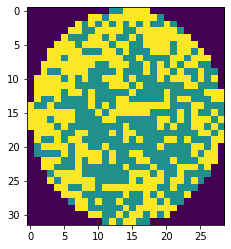

wafer_id:623, ウエハサイズ:32x29, スタンプサイズ:2x2, oDefects:211, nDefects:389, p=54.242


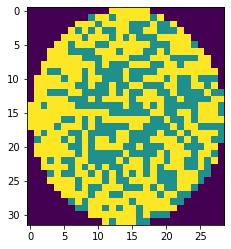

wafer_id:623, ウエハサイズ:32x29, スタンプサイズ:3x2, oDefects:203, nDefects:377, p=53.846


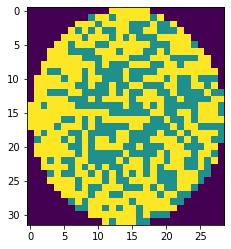

wafer_id:623, ウエハサイズ:32x29, スタンプサイズ:4x2, oDefects:211, nDefects:389, p=54.242


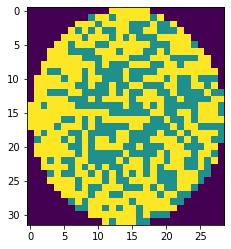

wafer_id:623, ウエハサイズ:32x29, スタンプサイズ:2x3, oDefects:184, nDefects:367, p=50.136


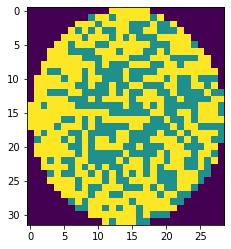

wafer_id:623, ウエハサイズ:32x29, スタンプサイズ:3x3, oDefects:178, nDefects:355, p=50.141


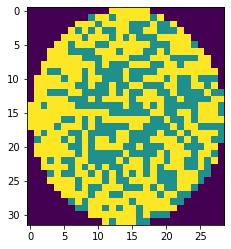

wafer_id:623, ウエハサイズ:32x29, スタンプサイズ:4x3, oDefects:184, nDefects:367, p=50.136


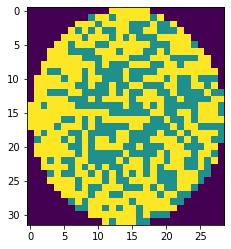

wafer_id:624, ウエハサイズ:32x29, スタンプサイズ:2x2, oDefects:217, nDefects:391, p=55.499


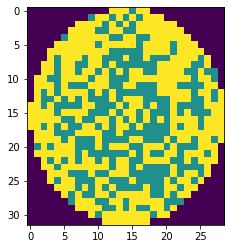

wafer_id:624, ウエハサイズ:32x29, スタンプサイズ:3x2, oDefects:205, nDefects:374, p=54.813


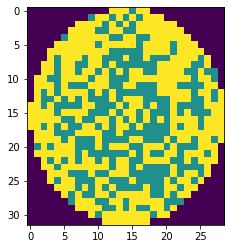

wafer_id:624, ウエハサイズ:32x29, スタンプサイズ:4x2, oDefects:217, nDefects:391, p=55.499


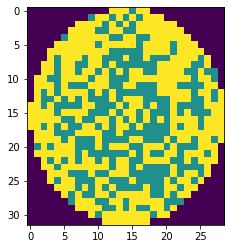

wafer_id:624, ウエハサイズ:32x29, スタンプサイズ:2x3, oDefects:192, nDefects:372, p=51.613


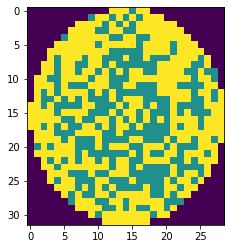

wafer_id:624, ウエハサイズ:32x29, スタンプサイズ:3x3, oDefects:181, nDefects:355, p=50.986


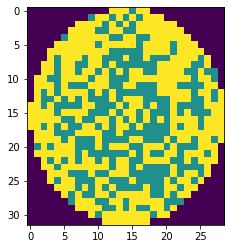

wafer_id:624, ウエハサイズ:32x29, スタンプサイズ:4x3, oDefects:192, nDefects:372, p=51.613


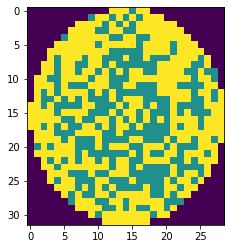

wafer_id:625, ウエハサイズ:32x29, スタンプサイズ:2x2, oDefects:197, nDefects:382, p=51.571


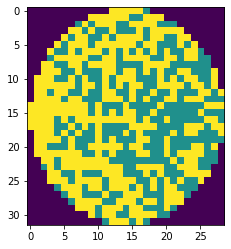

wafer_id:625, ウエハサイズ:32x29, スタンプサイズ:3x2, oDefects:192, nDefects:371, p=51.752


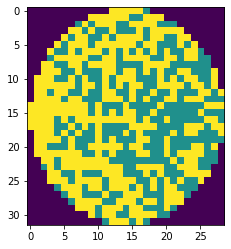

wafer_id:625, ウエハサイズ:32x29, スタンプサイズ:4x2, oDefects:197, nDefects:382, p=51.571


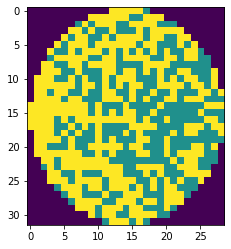

wafer_id:625, ウエハサイズ:32x29, スタンプサイズ:2x4, oDefects:180, nDefects:360, p=50.000


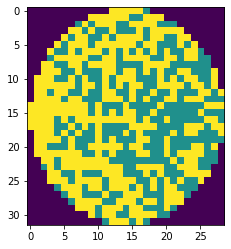

wafer_id:625, ウエハサイズ:32x29, スタンプサイズ:3x4, oDefects:177, nDefects:349, p=50.716


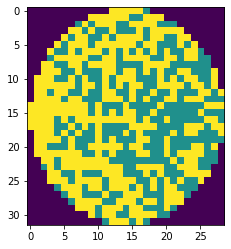

wafer_id:625, ウエハサイズ:32x29, スタンプサイズ:4x4, oDefects:180, nDefects:360, p=50.000


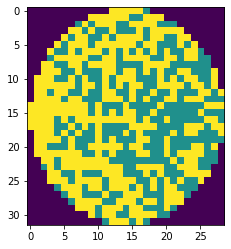

wafer_id:626, ウエハサイズ:32x29, スタンプサイズ:2x2, oDefects:212, nDefects:378, p=56.085


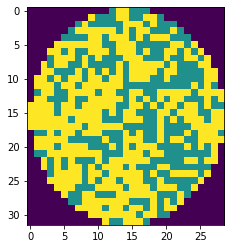

wafer_id:626, ウエハサイズ:32x29, スタンプサイズ:3x2, oDefects:205, nDefects:365, p=56.164


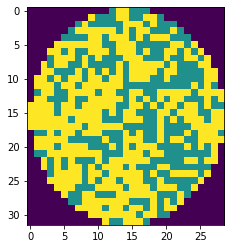

wafer_id:626, ウエハサイズ:32x29, スタンプサイズ:4x2, oDefects:212, nDefects:378, p=56.085


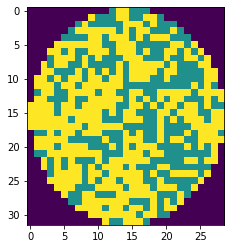

wafer_id:626, ウエハサイズ:32x29, スタンプサイズ:2x3, oDefects:185, nDefects:359, p=51.532


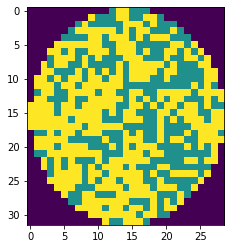

wafer_id:626, ウエハサイズ:32x29, スタンプサイズ:3x3, oDefects:178, nDefects:346, p=51.445


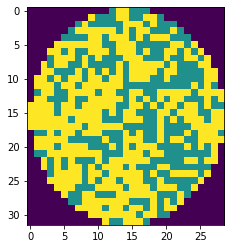

wafer_id:626, ウエハサイズ:32x29, スタンプサイズ:4x3, oDefects:185, nDefects:359, p=51.532


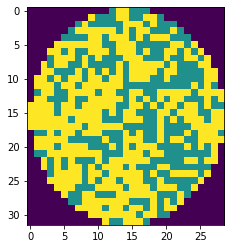

wafer_id:626, ウエハサイズ:32x29, スタンプサイズ:2x4, oDefects:190, nDefects:359, p=52.925


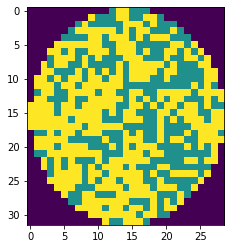

wafer_id:626, ウエハサイズ:32x29, スタンプサイズ:3x4, oDefects:184, nDefects:346, p=53.179


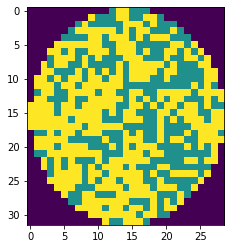

wafer_id:626, ウエハサイズ:32x29, スタンプサイズ:4x4, oDefects:190, nDefects:359, p=52.925


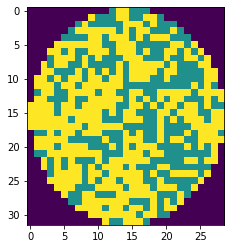

wafer_id:630, ウエハサイズ:29x27, スタンプサイズ:2x2, oDefects:144, nDefects:282, p=51.064


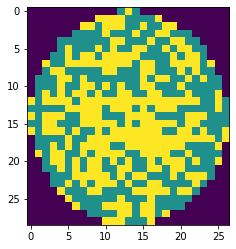

wafer_id:630, ウエハサイズ:29x27, スタンプサイズ:3x2, oDefects:142, nDefects:277, p=51.264


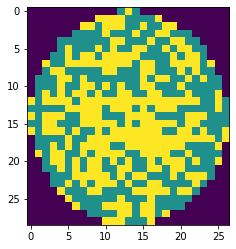

wafer_id:630, ウエハサイズ:29x27, スタンプサイズ:4x2, oDefects:144, nDefects:282, p=51.064


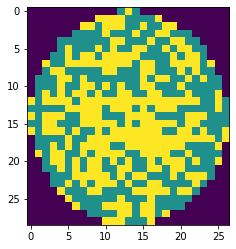

wafer_id:630, ウエハサイズ:29x27, スタンプサイズ:2x3, oDefects:145, nDefects:282, p=51.418


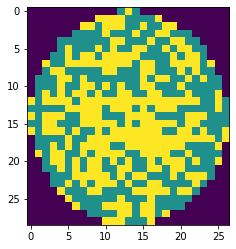

wafer_id:630, ウエハサイズ:29x27, スタンプサイズ:3x3, oDefects:142, nDefects:277, p=51.264


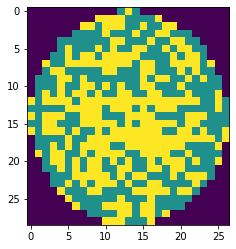

wafer_id:630, ウエハサイズ:29x27, スタンプサイズ:4x3, oDefects:145, nDefects:282, p=51.418


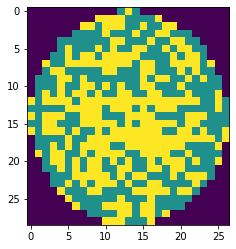

wafer_id:630, ウエハサイズ:29x27, スタンプサイズ:2x4, oDefects:133, nDefects:242, p=54.959


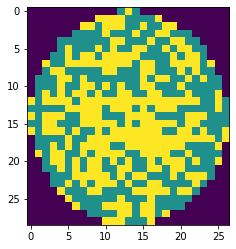

wafer_id:630, ウエハサイズ:29x27, スタンプサイズ:3x4, oDefects:132, nDefects:237, p=55.696


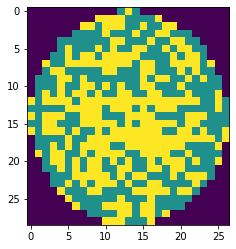

wafer_id:630, ウエハサイズ:29x27, スタンプサイズ:4x4, oDefects:133, nDefects:242, p=54.959


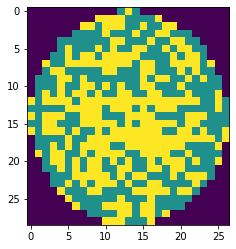

wafer_id:635, ウエハサイズ:26x26, スタンプサイズ:3x4, oDefects:77, nDefects:153, p=50.327


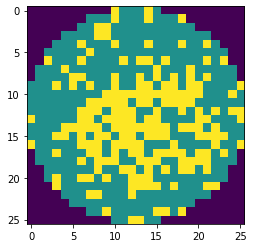

wafer_id:635, ウエハサイズ:26x26, スタンプサイズ:4x4, oDefects:77, nDefects:153, p=50.327


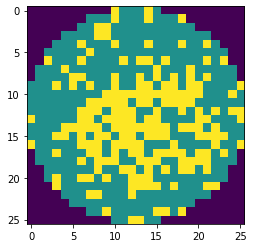

wafer_id:640, ウエハサイズ:35x31, スタンプサイズ:2x2, oDefects:283, nDefects:483, p=58.592


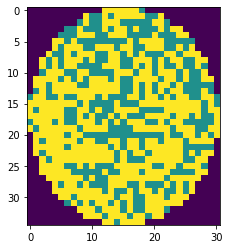

wafer_id:640, ウエハサイズ:35x31, スタンプサイズ:3x2, oDefects:278, nDefects:473, p=58.774


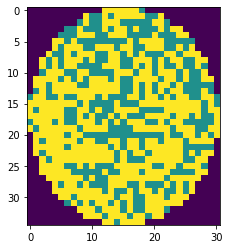

wafer_id:640, ウエハサイズ:35x31, スタンプサイズ:4x2, oDefects:273, nDefects:463, p=58.963


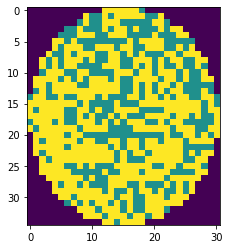

wafer_id:640, ウエハサイズ:35x31, スタンプサイズ:2x3, oDefects:269, nDefects:472, p=56.992


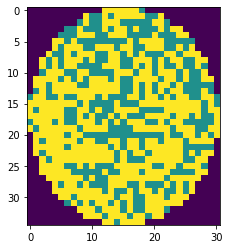

wafer_id:640, ウエハサイズ:35x31, スタンプサイズ:3x3, oDefects:263, nDefects:462, p=56.926


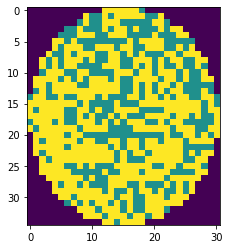

wafer_id:640, ウエハサイズ:35x31, スタンプサイズ:4x3, oDefects:259, nDefects:452, p=57.301


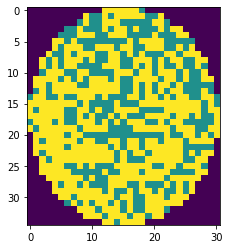

wafer_id:640, ウエハサイズ:35x31, スタンプサイズ:2x4, oDefects:236, nDefects:425, p=55.529


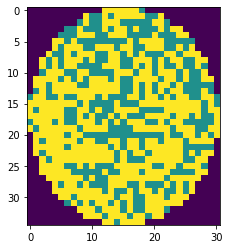

wafer_id:640, ウエハサイズ:35x31, スタンプサイズ:3x4, oDefects:230, nDefects:415, p=55.422


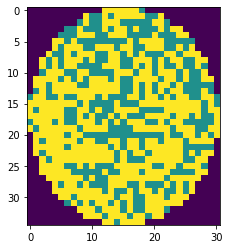

wafer_id:640, ウエハサイズ:35x31, スタンプサイズ:4x4, oDefects:225, nDefects:405, p=55.556


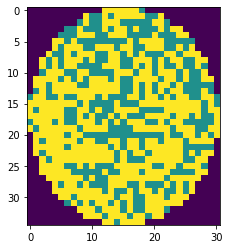

wafer_id:642, ウエハサイズ:35x31, スタンプサイズ:2x3, oDefects:240, nDefects:413, p=58.111


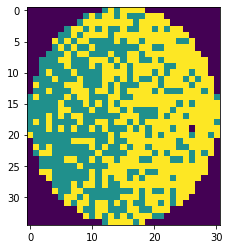

wafer_id:642, ウエハサイズ:35x31, スタンプサイズ:3x3, oDefects:239, nDefects:406, p=58.867


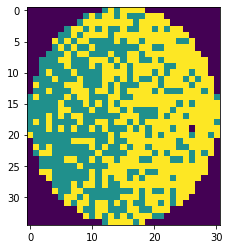

wafer_id:642, ウエハサイズ:35x31, スタンプサイズ:4x3, oDefects:237, nDefects:398, p=59.548


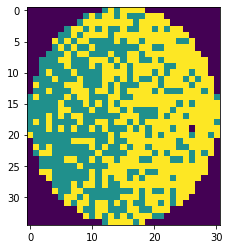

wafer_id:642, ウエハサイズ:35x31, スタンプサイズ:2x4, oDefects:203, nDefects:349, p=58.166


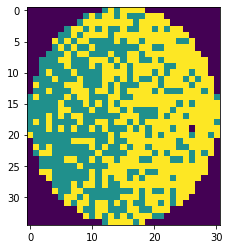

wafer_id:642, ウエハサイズ:35x31, スタンプサイズ:3x4, oDefects:199, nDefects:342, p=58.187


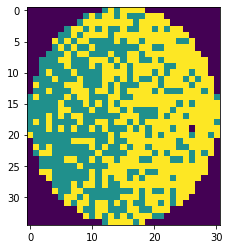

wafer_id:642, ウエハサイズ:35x31, スタンプサイズ:4x4, oDefects:195, nDefects:334, p=58.383


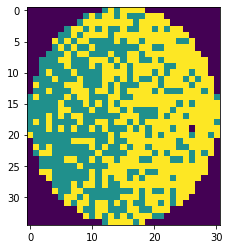

wafer_id:643, ウエハサイズ:35x31, スタンプサイズ:2x3, oDefects:164, nDefects:316, p=51.899


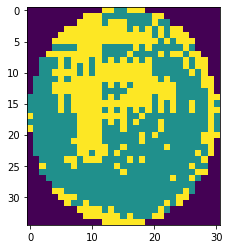

wafer_id:643, ウエハサイズ:35x31, スタンプサイズ:3x3, oDefects:160, nDefects:307, p=52.117


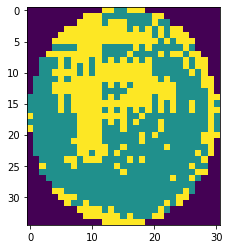

wafer_id:643, ウエハサイズ:35x31, スタンプサイズ:4x3, oDefects:158, nDefects:301, p=52.492


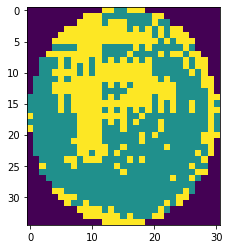

wafer_id:643, ウエハサイズ:35x31, スタンプサイズ:2x4, oDefects:154, nDefects:296, p=52.027


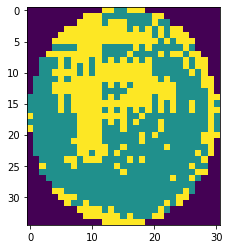

wafer_id:643, ウエハサイズ:35x31, スタンプサイズ:3x4, oDefects:150, nDefects:287, p=52.265


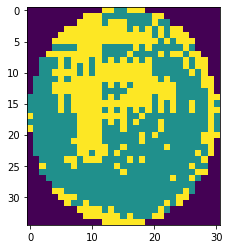

wafer_id:643, ウエハサイズ:35x31, スタンプサイズ:4x4, oDefects:149, nDefects:281, p=53.025


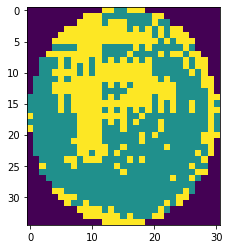

wafer_id:650, ウエハサイズ:38x38, スタンプサイズ:2x2, oDefects:324, nDefects:600, p=54.000


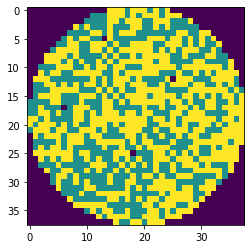

wafer_id:650, ウエハサイズ:38x38, スタンプサイズ:3x2, oDefects:316, nDefects:583, p=54.202


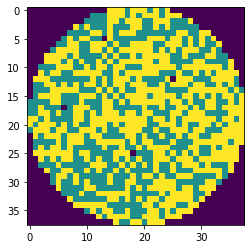

wafer_id:650, ウエハサイズ:38x38, スタンプサイズ:4x2, oDefects:316, nDefects:583, p=54.202


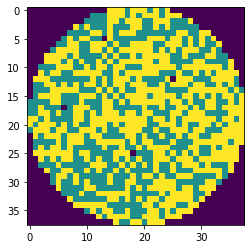

wafer_id:650, ウエハサイズ:38x38, スタンプサイズ:2x3, oDefects:281, nDefects:557, p=50.449


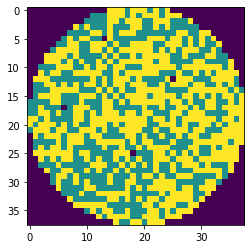

wafer_id:650, ウエハサイズ:38x38, スタンプサイズ:3x3, oDefects:273, nDefects:540, p=50.556


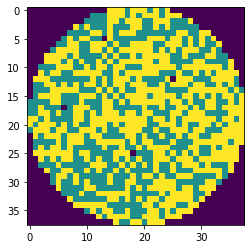

wafer_id:650, ウエハサイズ:38x38, スタンプサイズ:4x3, oDefects:273, nDefects:540, p=50.556


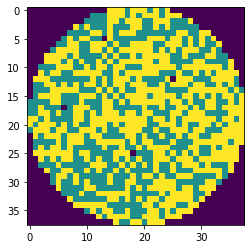

wafer_id:650, ウエハサイズ:38x38, スタンプサイズ:2x4, oDefects:274, nDefects:539, p=50.835


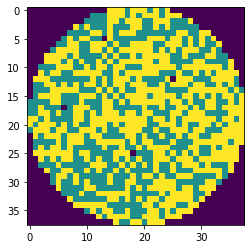

wafer_id:650, ウエハサイズ:38x38, スタンプサイズ:3x4, oDefects:265, nDefects:522, p=50.766


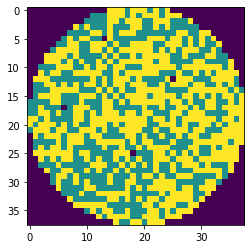

wafer_id:650, ウエハサイズ:38x38, スタンプサイズ:4x4, oDefects:265, nDefects:522, p=50.766


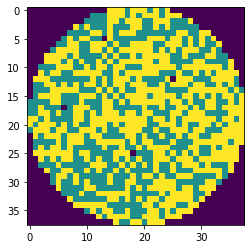

wafer_id:653, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:126, nDefects:234, p=53.846


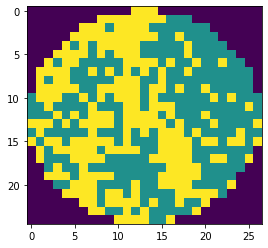

wafer_id:653, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:126, nDefects:234, p=53.846


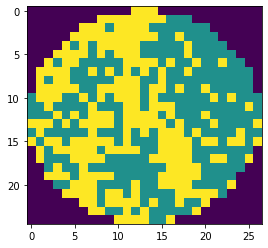

wafer_id:653, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:126, nDefects:234, p=53.846


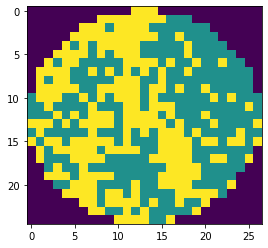

wafer_id:658, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:114, nDefects:215, p=53.023


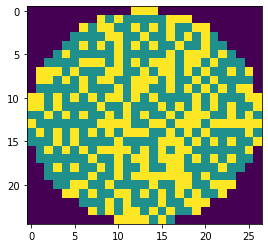

wafer_id:658, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:114, nDefects:215, p=53.023


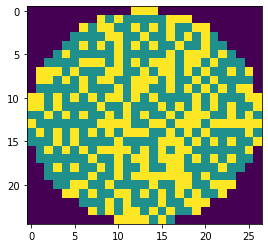

wafer_id:658, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:114, nDefects:215, p=53.023


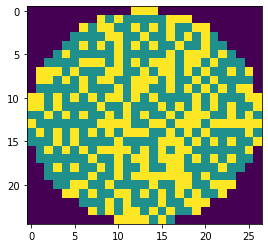

wafer_id:662, ウエハサイズ:25x27, スタンプサイズ:2x3, oDefects:128, nDefects:242, p=52.893


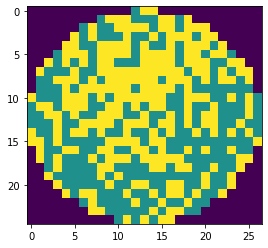

wafer_id:662, ウエハサイズ:25x27, スタンプサイズ:3x3, oDefects:128, nDefects:242, p=52.893


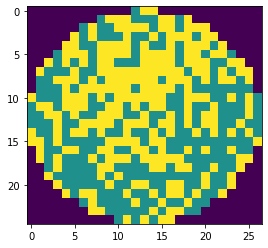

wafer_id:662, ウエハサイズ:25x27, スタンプサイズ:4x3, oDefects:128, nDefects:242, p=52.893


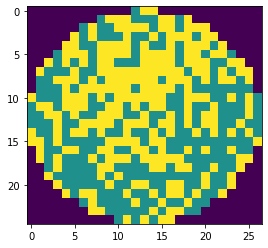

wafer_id:664, ウエハサイズ:25x27, スタンプサイズ:2x3, oDefects:184, nDefects:313, p=58.786


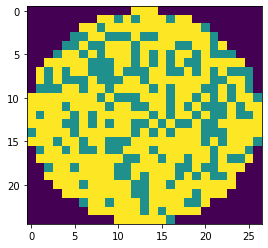

wafer_id:664, ウエハサイズ:25x27, スタンプサイズ:3x3, oDefects:184, nDefects:313, p=58.786


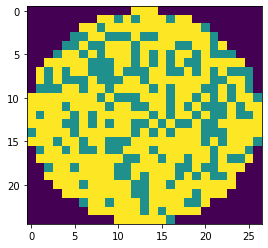

wafer_id:664, ウエハサイズ:25x27, スタンプサイズ:4x3, oDefects:184, nDefects:313, p=58.786


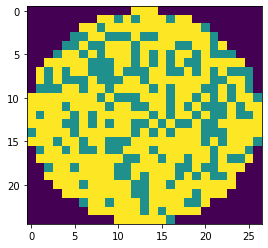

wafer_id:670, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:155, nDefects:281, p=55.160


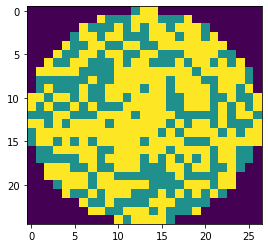

wafer_id:670, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:155, nDefects:281, p=55.160


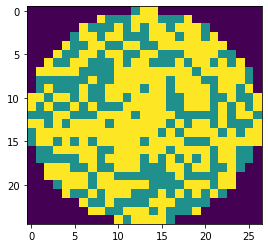

wafer_id:670, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:155, nDefects:281, p=55.160


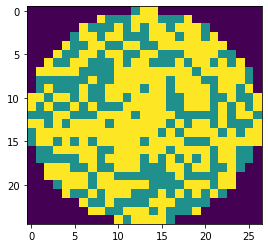

wafer_id:670, ウエハサイズ:25x27, スタンプサイズ:2x3, oDefects:148, nDefects:281, p=52.669


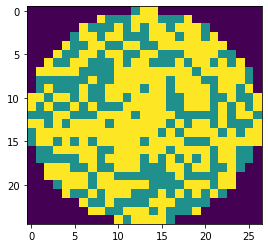

wafer_id:670, ウエハサイズ:25x27, スタンプサイズ:3x3, oDefects:148, nDefects:281, p=52.669


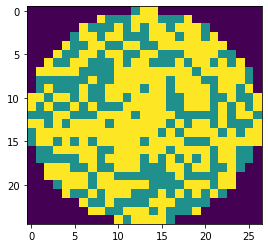

wafer_id:670, ウエハサイズ:25x27, スタンプサイズ:4x3, oDefects:148, nDefects:281, p=52.669


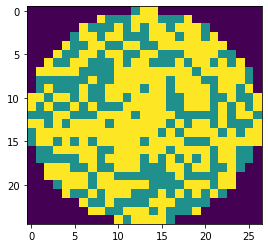

wafer_id:670, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:139, nDefects:237, p=58.650


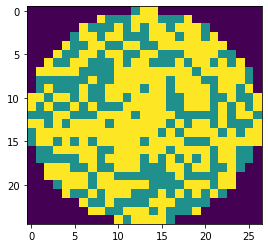

wafer_id:670, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:139, nDefects:237, p=58.650


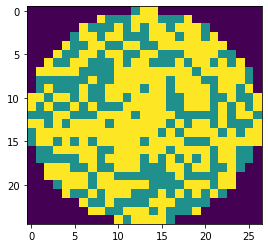

wafer_id:670, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:139, nDefects:237, p=58.650


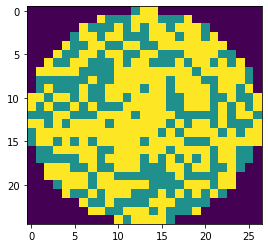

wafer_id:671, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:121, nDefects:239, p=50.628


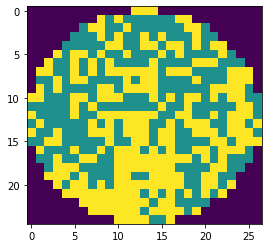

wafer_id:671, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:121, nDefects:239, p=50.628


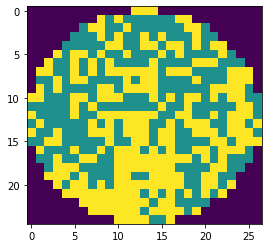

wafer_id:671, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:121, nDefects:239, p=50.628


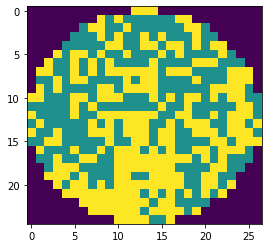

wafer_id:671, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:103, nDefects:204, p=50.490


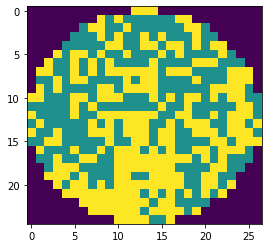

wafer_id:671, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:103, nDefects:204, p=50.490


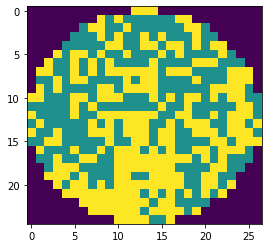

wafer_id:671, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:103, nDefects:204, p=50.490


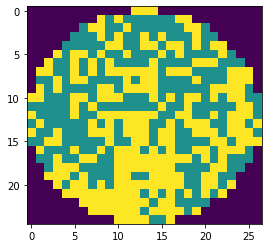

wafer_id:674, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:146, nDefects:264, p=55.303


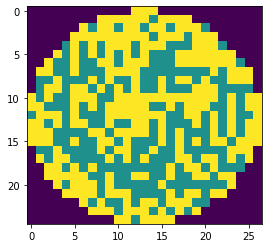

wafer_id:674, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:146, nDefects:264, p=55.303


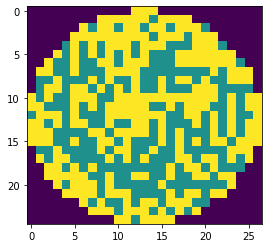

wafer_id:674, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:146, nDefects:264, p=55.303


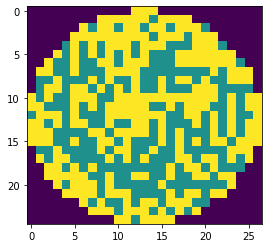

wafer_id:674, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:115, nDefects:222, p=51.802


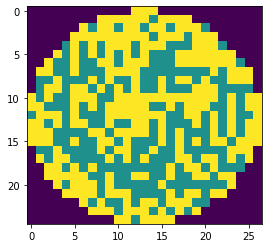

wafer_id:674, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:115, nDefects:222, p=51.802


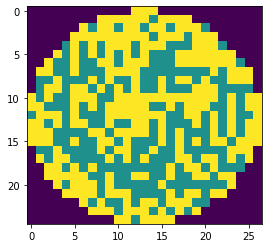

wafer_id:674, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:115, nDefects:222, p=51.802


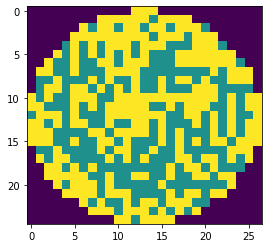

wafer_id:675, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:168, nDefects:300, p=56.000


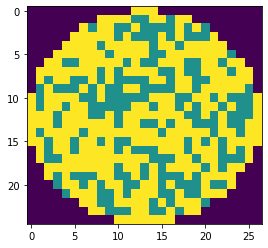

wafer_id:675, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:168, nDefects:300, p=56.000


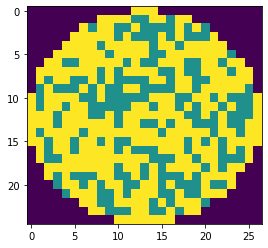

wafer_id:675, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:168, nDefects:300, p=56.000


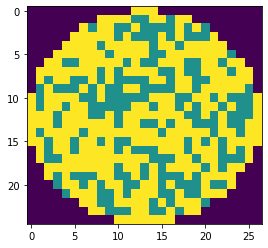

wafer_id:675, ウエハサイズ:25x27, スタンプサイズ:2x3, oDefects:172, nDefects:300, p=57.333


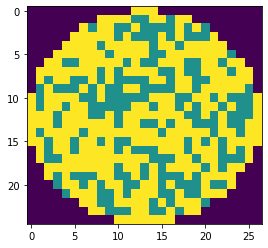

wafer_id:675, ウエハサイズ:25x27, スタンプサイズ:3x3, oDefects:172, nDefects:300, p=57.333


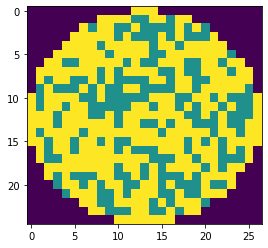

wafer_id:675, ウエハサイズ:25x27, スタンプサイズ:4x3, oDefects:172, nDefects:300, p=57.333


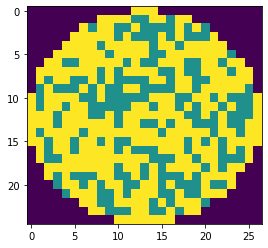

wafer_id:675, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:143, nDefects:251, p=56.972


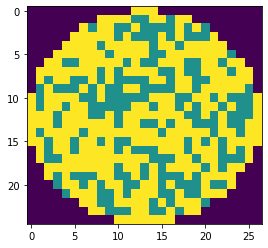

wafer_id:675, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:143, nDefects:251, p=56.972


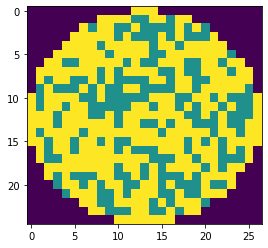

wafer_id:675, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:143, nDefects:251, p=56.972


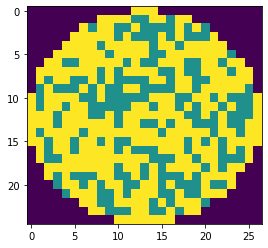

wafer_id:679, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:134, nDefects:239, p=56.067


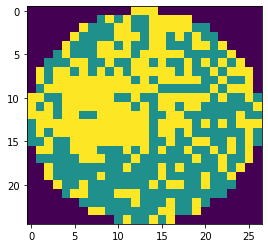

wafer_id:679, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:134, nDefects:239, p=56.067


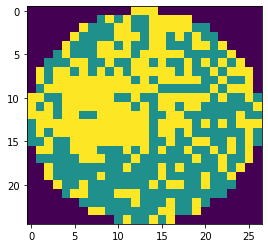

wafer_id:679, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:134, nDefects:239, p=56.067


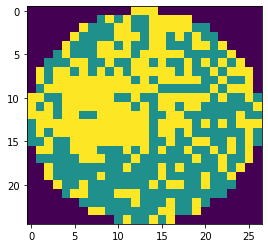

wafer_id:679, ウエハサイズ:25x27, スタンプサイズ:2x3, oDefects:129, nDefects:239, p=53.975


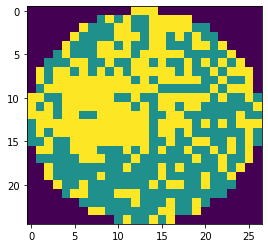

wafer_id:679, ウエハサイズ:25x27, スタンプサイズ:3x3, oDefects:129, nDefects:239, p=53.975


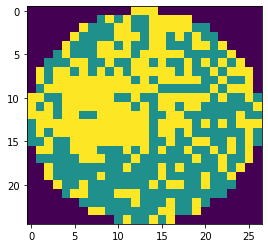

wafer_id:679, ウエハサイズ:25x27, スタンプサイズ:4x3, oDefects:129, nDefects:239, p=53.975


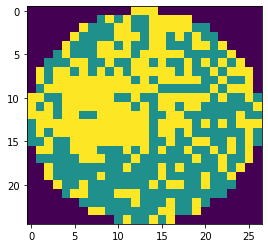

wafer_id:679, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:115, nDefects:216, p=53.241


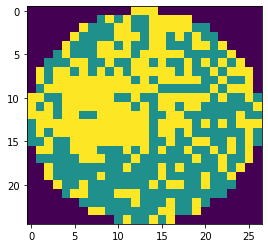

wafer_id:679, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:115, nDefects:216, p=53.241


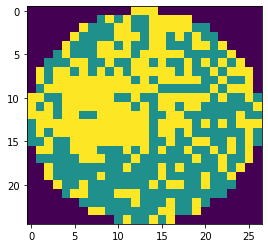

wafer_id:679, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:115, nDefects:216, p=53.241


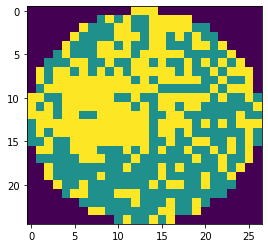

wafer_id:681, ウエハサイズ:25x27, スタンプサイズ:2x3, oDefects:185, nDefects:314, p=58.917


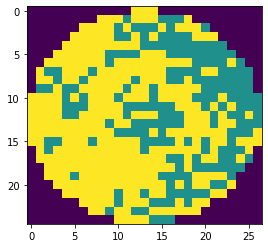

wafer_id:681, ウエハサイズ:25x27, スタンプサイズ:3x3, oDefects:185, nDefects:314, p=58.917


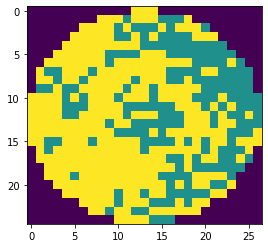

wafer_id:681, ウエハサイズ:25x27, スタンプサイズ:4x3, oDefects:185, nDefects:314, p=58.917


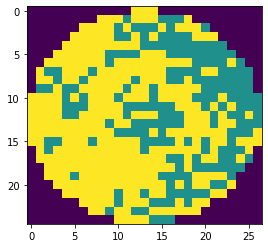

wafer_id:681, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:168, nDefects:285, p=58.947


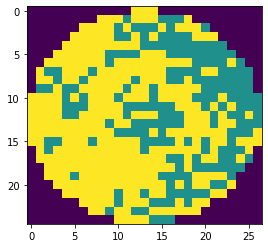

wafer_id:681, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:168, nDefects:285, p=58.947


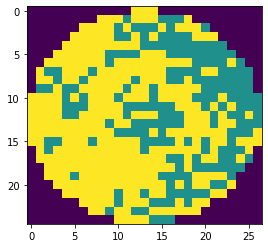

wafer_id:681, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:168, nDefects:285, p=58.947


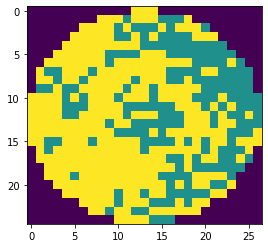

wafer_id:683, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:132, nDefects:256, p=51.562


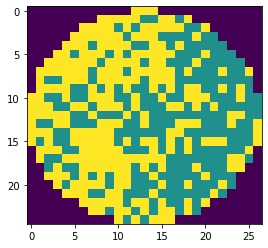

wafer_id:683, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:132, nDefects:256, p=51.562


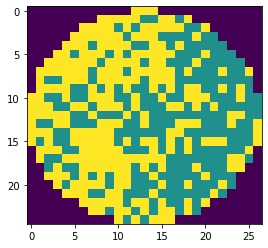

wafer_id:683, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:132, nDefects:256, p=51.562


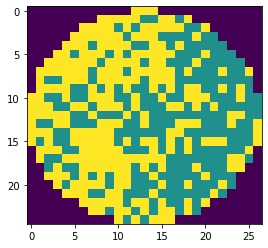

wafer_id:683, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:123, nDefects:239, p=51.464


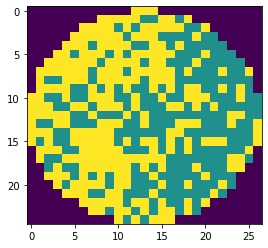

wafer_id:683, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:123, nDefects:239, p=51.464


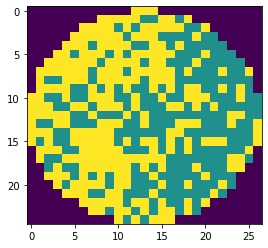

wafer_id:683, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:123, nDefects:239, p=51.464


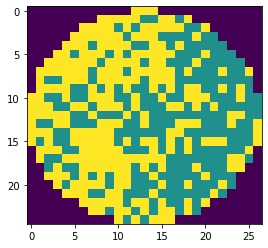

wafer_id:684, ウエハサイズ:25x27, スタンプサイズ:2x2, oDefects:159, nDefects:275, p=57.818


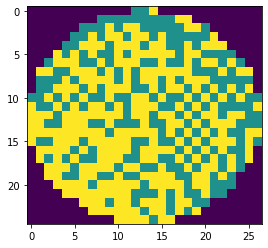

wafer_id:684, ウエハサイズ:25x27, スタンプサイズ:3x2, oDefects:159, nDefects:275, p=57.818


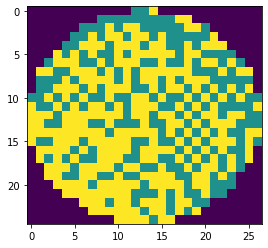

wafer_id:684, ウエハサイズ:25x27, スタンプサイズ:4x2, oDefects:159, nDefects:275, p=57.818


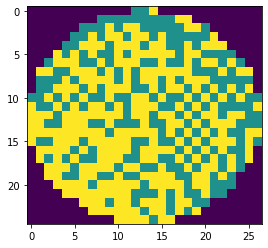

wafer_id:684, ウエハサイズ:25x27, スタンプサイズ:2x3, oDefects:145, nDefects:275, p=52.727


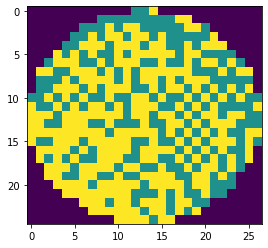

wafer_id:684, ウエハサイズ:25x27, スタンプサイズ:3x3, oDefects:145, nDefects:275, p=52.727


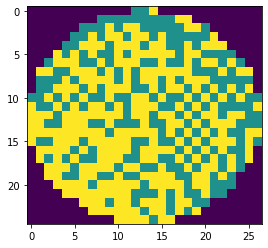

wafer_id:684, ウエハサイズ:25x27, スタンプサイズ:4x3, oDefects:145, nDefects:275, p=52.727


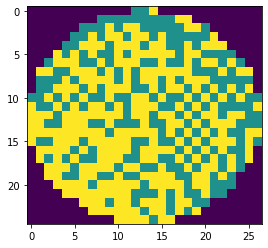

wafer_id:684, ウエハサイズ:25x27, スタンプサイズ:2x4, oDefects:135, nDefects:239, p=56.485


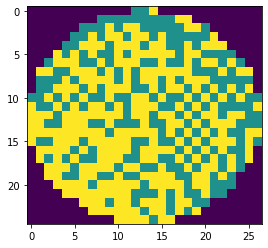

wafer_id:684, ウエハサイズ:25x27, スタンプサイズ:3x4, oDefects:135, nDefects:239, p=56.485


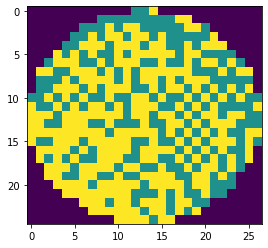

wafer_id:684, ウエハサイズ:25x27, スタンプサイズ:4x4, oDefects:135, nDefects:239, p=56.485


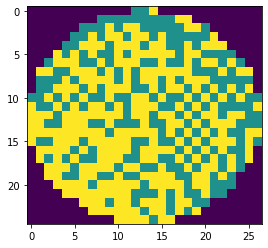

wafer_id:685, ウエハサイズ:25x27, スタンプサイズ:2x3, oDefects:134, nDefects:226, p=59.292


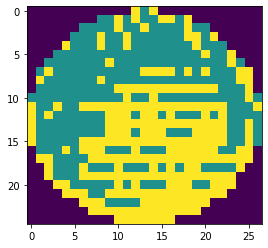

wafer_id:685, ウエハサイズ:25x27, スタンプサイズ:3x3, oDefects:134, nDefects:226, p=59.292


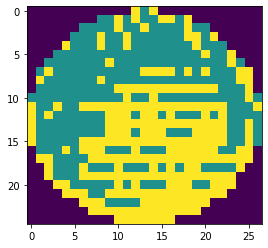

wafer_id:685, ウエハサイズ:25x27, スタンプサイズ:4x3, oDefects:134, nDefects:226, p=59.292


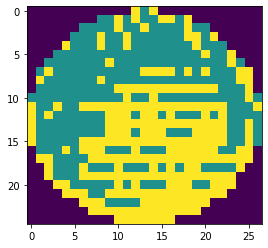

wafer_id:692, ウエハサイズ:34x31, スタンプサイズ:2x4, oDefects:227, nDefects:390, p=58.205


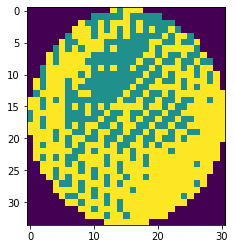

wafer_id:692, ウエハサイズ:34x31, スタンプサイズ:3x4, oDefects:224, nDefects:383, p=58.486


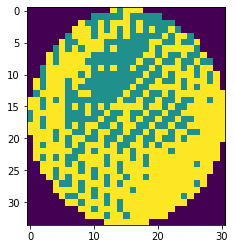

wafer_id:692, ウエハサイズ:34x31, スタンプサイズ:4x4, oDefects:218, nDefects:372, p=58.602


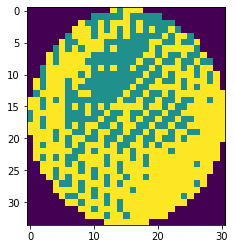

wafer_id:693, ウエハサイズ:34x31, スタンプサイズ:2x2, oDefects:226, nDefects:419, p=53.938


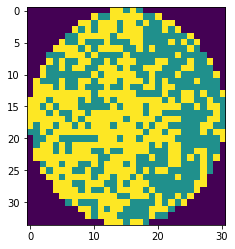

wafer_id:693, ウエハサイズ:34x31, スタンプサイズ:3x2, oDefects:224, nDefects:414, p=54.106


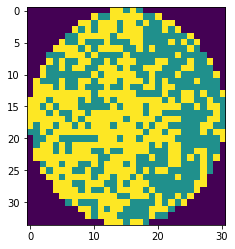

wafer_id:693, ウエハサイズ:34x31, スタンプサイズ:4x2, oDefects:222, nDefects:409, p=54.279


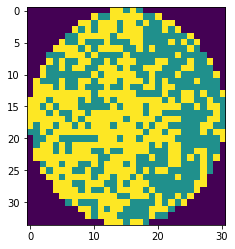

wafer_id:693, ウエハサイズ:34x31, スタンプサイズ:2x3, oDefects:217, nDefects:410, p=52.927


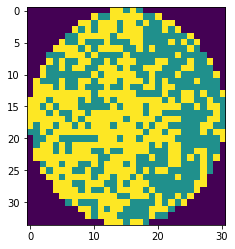

wafer_id:693, ウエハサイズ:34x31, スタンプサイズ:3x3, oDefects:215, nDefects:405, p=53.086


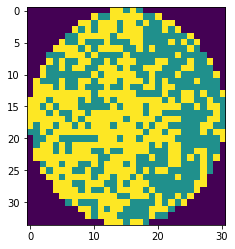

wafer_id:693, ウエハサイズ:34x31, スタンプサイズ:4x3, oDefects:214, nDefects:400, p=53.500


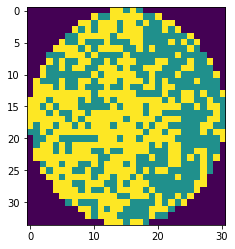

wafer_id:693, ウエハサイズ:34x31, スタンプサイズ:2x4, oDefects:203, nDefects:391, p=51.918


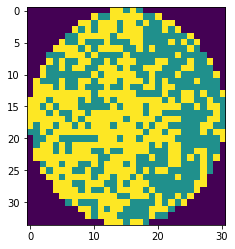

wafer_id:693, ウエハサイズ:34x31, スタンプサイズ:3x4, oDefects:201, nDefects:386, p=52.073


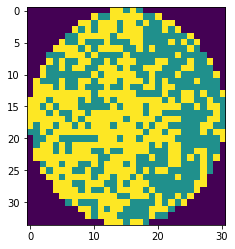

wafer_id:693, ウエハサイズ:34x31, スタンプサイズ:4x4, oDefects:200, nDefects:381, p=52.493


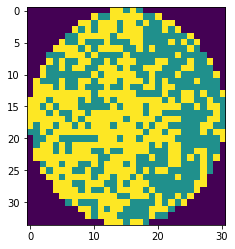

wafer_id:694, ウエハサイズ:34x31, スタンプサイズ:2x3, oDefects:266, nDefects:453, p=58.720


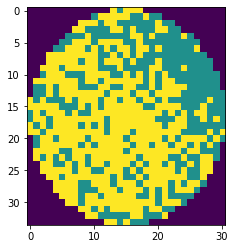

wafer_id:694, ウエハサイズ:34x31, スタンプサイズ:3x3, oDefects:265, nDefects:450, p=58.889


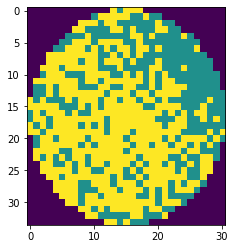

wafer_id:694, ウエハサイズ:34x31, スタンプサイズ:4x3, oDefects:265, nDefects:445, p=59.551


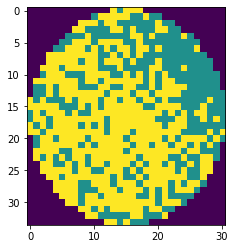

wafer_id:694, ウエハサイズ:34x31, スタンプサイズ:2x4, oDefects:253, nDefects:430, p=58.837


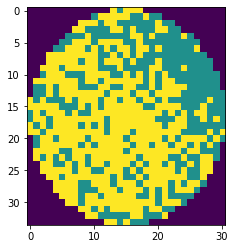

wafer_id:694, ウエハサイズ:34x31, スタンプサイズ:3x4, oDefects:253, nDefects:427, p=59.251


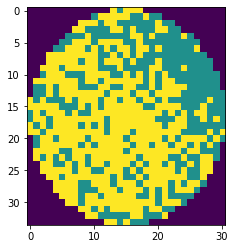

wafer_id:694, ウエハサイズ:34x31, スタンプサイズ:4x4, oDefects:252, nDefects:422, p=59.716


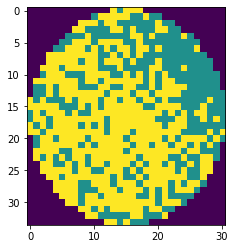

wafer_id:695, ウエハサイズ:34x31, スタンプサイズ:2x2, oDefects:260, nDefects:449, p=57.906


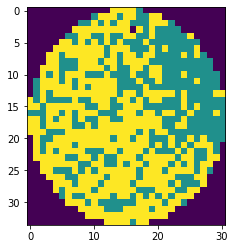

wafer_id:695, ウエハサイズ:34x31, スタンプサイズ:3x2, oDefects:257, nDefects:443, p=58.014


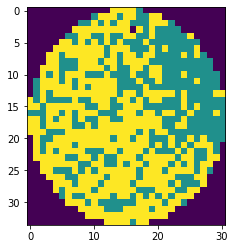

wafer_id:695, ウエハサイズ:34x31, スタンプサイズ:4x2, oDefects:246, nDefects:430, p=57.209


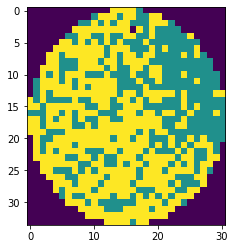

wafer_id:695, ウエハサイズ:34x31, スタンプサイズ:2x3, oDefects:238, nDefects:443, p=53.725


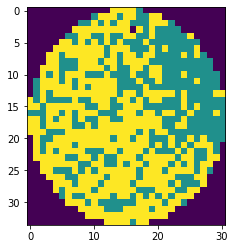

wafer_id:695, ウエハサイズ:34x31, スタンプサイズ:3x3, oDefects:235, nDefects:437, p=53.776


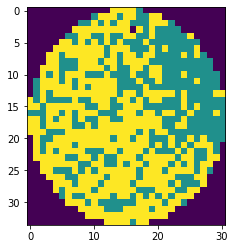

wafer_id:695, ウエハサイズ:34x31, スタンプサイズ:4x3, oDefects:225, nDefects:424, p=53.066


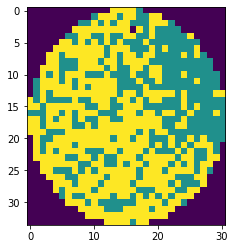

wafer_id:695, ウエハサイズ:34x31, スタンプサイズ:2x4, oDefects:242, nDefects:416, p=58.173


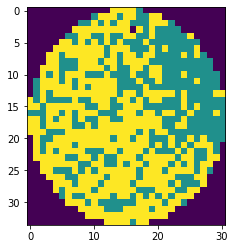

wafer_id:695, ウエハサイズ:34x31, スタンプサイズ:3x4, oDefects:240, nDefects:410, p=58.537


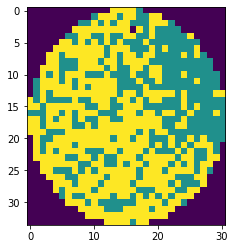

wafer_id:695, ウエハサイズ:34x31, スタンプサイズ:4x4, oDefects:231, nDefects:397, p=58.186


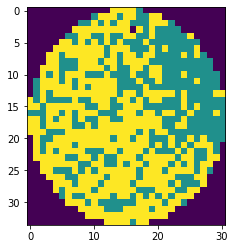

wafer_id:702, ウエハサイズ:34x31, スタンプサイズ:2x2, oDefects:224, nDefects:405, p=55.309


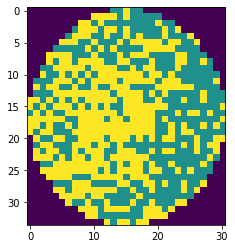

wafer_id:702, ウエハサイズ:34x31, スタンプサイズ:3x2, oDefects:222, nDefects:400, p=55.500


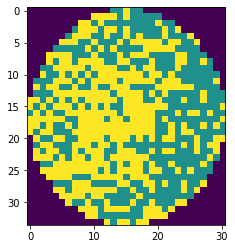

wafer_id:702, ウエハサイズ:34x31, スタンプサイズ:4x2, oDefects:220, nDefects:394, p=55.838


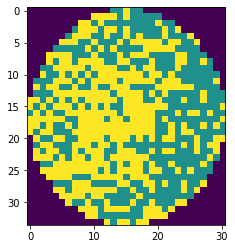

wafer_id:702, ウエハサイズ:34x31, スタンプサイズ:2x3, oDefects:214, nDefects:399, p=53.634


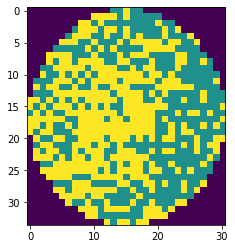

wafer_id:702, ウエハサイズ:34x31, スタンプサイズ:3x3, oDefects:211, nDefects:394, p=53.553


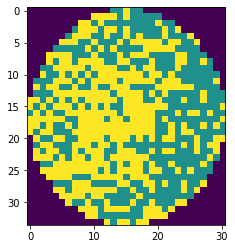

wafer_id:702, ウエハサイズ:34x31, スタンプサイズ:4x3, oDefects:210, nDefects:388, p=54.124


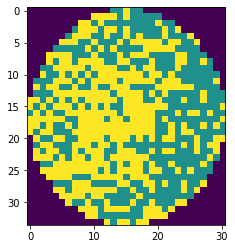

wafer_id:702, ウエハサイズ:34x31, スタンプサイズ:2x4, oDefects:190, nDefects:378, p=50.265


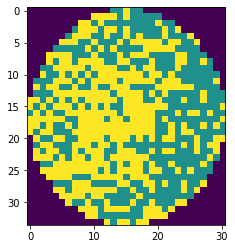

wafer_id:702, ウエハサイズ:34x31, スタンプサイズ:3x4, oDefects:189, nDefects:373, p=50.670


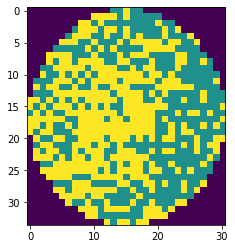

wafer_id:702, ウエハサイズ:34x31, スタンプサイズ:4x4, oDefects:189, nDefects:367, p=51.499


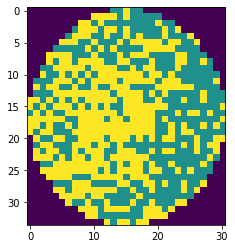

wafer_id:703, ウエハサイズ:34x31, スタンプサイズ:2x3, oDefects:283, nDefects:480, p=58.958


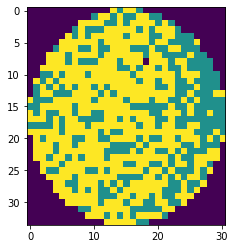

wafer_id:703, ウエハサイズ:34x31, スタンプサイズ:3x3, oDefects:281, nDefects:475, p=59.158


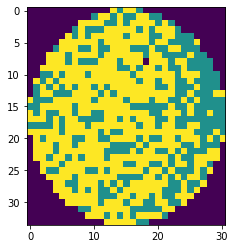

wafer_id:703, ウエハサイズ:34x31, スタンプサイズ:4x3, oDefects:278, nDefects:466, p=59.657


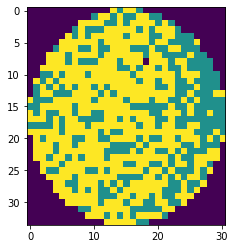

wafer_id:709, ウエハサイズ:34x31, スタンプサイズ:2x2, oDefects:228, nDefects:401, p=56.858


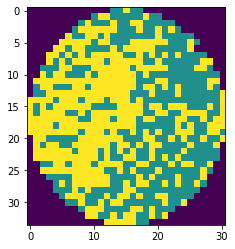

wafer_id:709, ウエハサイズ:34x31, スタンプサイズ:3x2, oDefects:225, nDefects:396, p=56.818


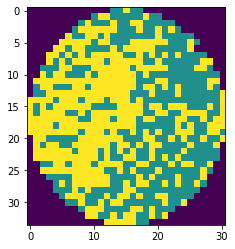

wafer_id:709, ウエハサイズ:34x31, スタンプサイズ:4x2, oDefects:223, nDefects:389, p=57.326


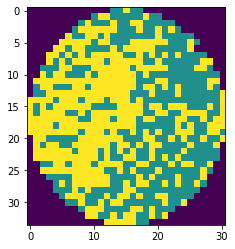

wafer_id:709, ウエハサイズ:34x31, スタンプサイズ:2x3, oDefects:212, nDefects:394, p=53.807


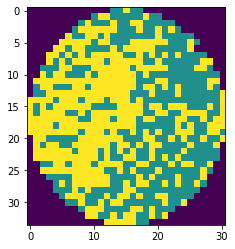

wafer_id:709, ウエハサイズ:34x31, スタンプサイズ:3x3, oDefects:210, nDefects:389, p=53.985


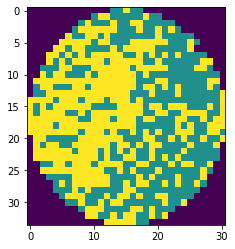

wafer_id:709, ウエハサイズ:34x31, スタンプサイズ:4x3, oDefects:207, nDefects:382, p=54.188


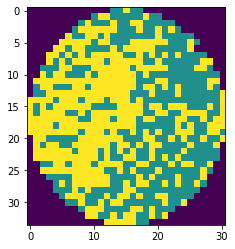

wafer_id:709, ウエハサイズ:34x31, スタンプサイズ:2x4, oDefects:199, nDefects:376, p=52.926


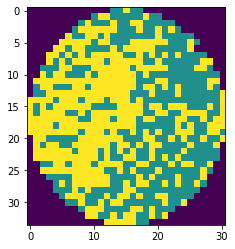

wafer_id:709, ウエハサイズ:34x31, スタンプサイズ:3x4, oDefects:198, nDefects:371, p=53.369


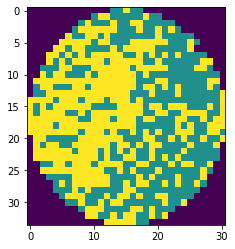

wafer_id:709, ウエハサイズ:34x31, スタンプサイズ:4x4, oDefects:196, nDefects:364, p=53.846


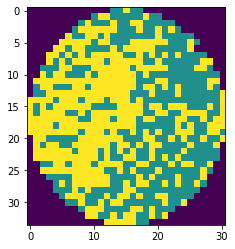

wafer_id:712, ウエハサイズ:25x26, スタンプサイズ:2x2, oDefects:108, nDefects:212, p=50.943


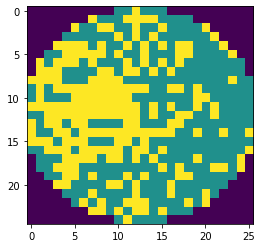

wafer_id:712, ウエハサイズ:25x26, スタンプサイズ:3x2, oDefects:108, nDefects:212, p=50.943


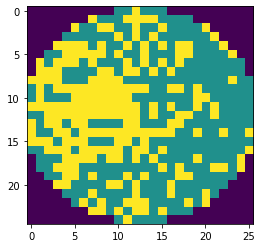

wafer_id:712, ウエハサイズ:25x26, スタンプサイズ:4x2, oDefects:108, nDefects:212, p=50.943


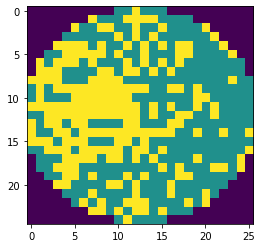

wafer_id:713, ウエハサイズ:25x26, スタンプサイズ:2x2, oDefects:169, nDefects:288, p=58.681


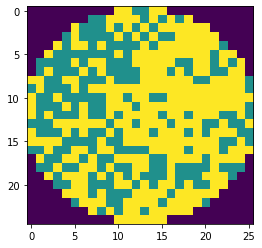

wafer_id:713, ウエハサイズ:25x26, スタンプサイズ:3x2, oDefects:169, nDefects:288, p=58.681


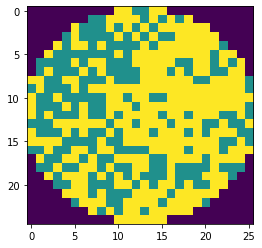

wafer_id:713, ウエハサイズ:25x26, スタンプサイズ:4x2, oDefects:169, nDefects:288, p=58.681


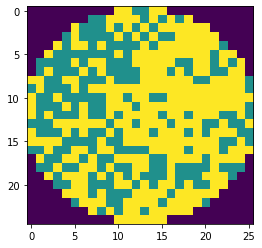

wafer_id:713, ウエハサイズ:25x26, スタンプサイズ:2x3, oDefects:148, nDefects:253, p=58.498


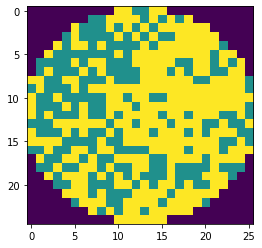

wafer_id:713, ウエハサイズ:25x26, スタンプサイズ:3x3, oDefects:148, nDefects:253, p=58.498


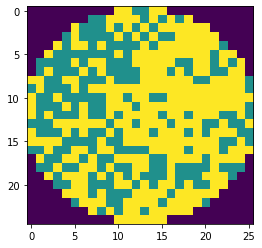

wafer_id:713, ウエハサイズ:25x26, スタンプサイズ:4x3, oDefects:148, nDefects:253, p=58.498


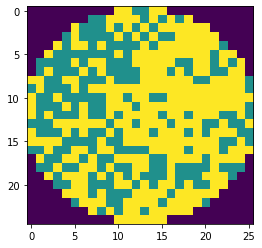

wafer_id:717, ウエハサイズ:25x26, スタンプサイズ:2x2, oDefects:160, nDefects:286, p=55.944


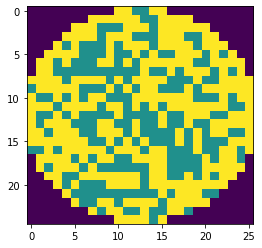

wafer_id:717, ウエハサイズ:25x26, スタンプサイズ:3x2, oDefects:160, nDefects:286, p=55.944


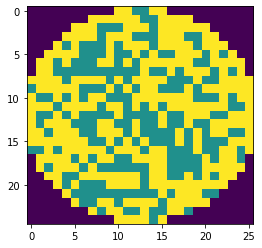

wafer_id:717, ウエハサイズ:25x26, スタンプサイズ:4x2, oDefects:160, nDefects:286, p=55.944


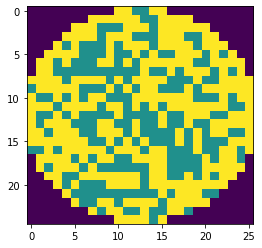

wafer_id:717, ウエハサイズ:25x26, スタンプサイズ:2x3, oDefects:130, nDefects:251, p=51.793


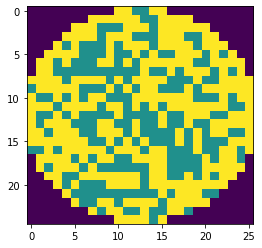

wafer_id:717, ウエハサイズ:25x26, スタンプサイズ:3x3, oDefects:130, nDefects:251, p=51.793


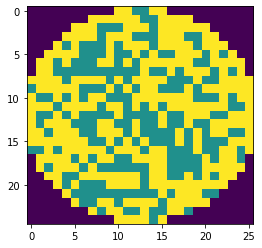

wafer_id:717, ウエハサイズ:25x26, スタンプサイズ:4x3, oDefects:130, nDefects:251, p=51.793


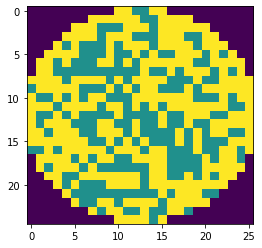

wafer_id:717, ウエハサイズ:25x26, スタンプサイズ:2x4, oDefects:131, nDefects:239, p=54.812


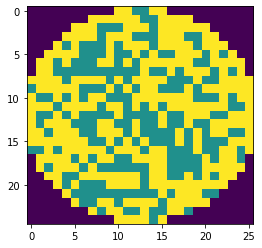

wafer_id:717, ウエハサイズ:25x26, スタンプサイズ:3x4, oDefects:131, nDefects:239, p=54.812


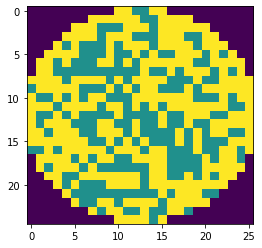

wafer_id:717, ウエハサイズ:25x26, スタンプサイズ:4x4, oDefects:131, nDefects:239, p=54.812


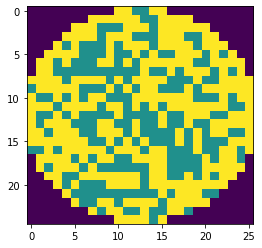

wafer_id:726, ウエハサイズ:33x29, スタンプサイズ:2x2, oDefects:255, nDefects:438, p=58.219


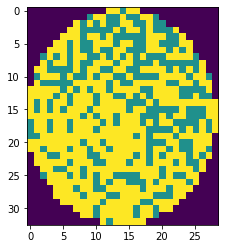

wafer_id:726, ウエハサイズ:33x29, スタンプサイズ:3x2, oDefects:259, nDefects:444, p=58.333


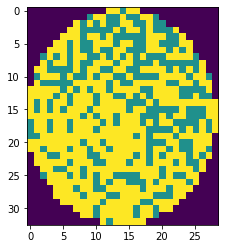

wafer_id:726, ウエハサイズ:33x29, スタンプサイズ:4x2, oDefects:255, nDefects:438, p=58.219


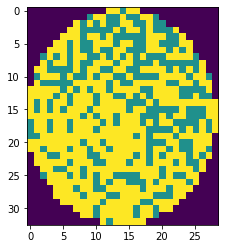

wafer_id:726, ウエハサイズ:33x29, スタンプサイズ:2x3, oDefects:242, nDefects:418, p=57.895


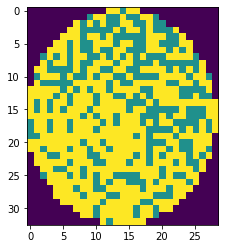

wafer_id:726, ウエハサイズ:33x29, スタンプサイズ:3x3, oDefects:245, nDefects:424, p=57.783


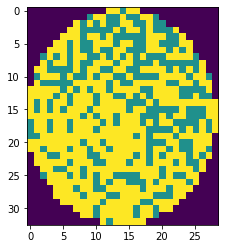

wafer_id:726, ウエハサイズ:33x29, スタンプサイズ:4x3, oDefects:242, nDefects:418, p=57.895


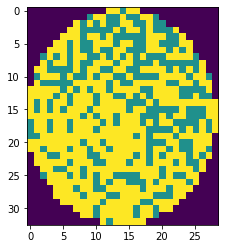

wafer_id:726, ウエハサイズ:33x29, スタンプサイズ:2x4, oDefects:244, nDefects:418, p=58.373


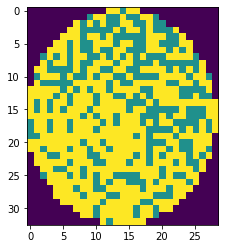

wafer_id:726, ウエハサイズ:33x29, スタンプサイズ:3x4, oDefects:246, nDefects:424, p=58.019


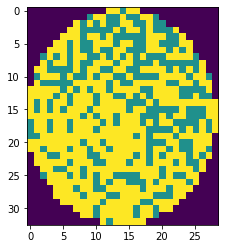

wafer_id:726, ウエハサイズ:33x29, スタンプサイズ:4x4, oDefects:244, nDefects:418, p=58.373


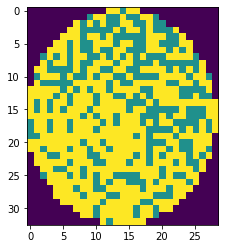

wafer_id:729, ウエハサイズ:33x29, スタンプサイズ:2x2, oDefects:185, nDefects:325, p=56.923


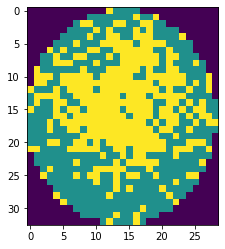

wafer_id:729, ウエハサイズ:33x29, スタンプサイズ:3x2, oDefects:185, nDefects:327, p=56.575


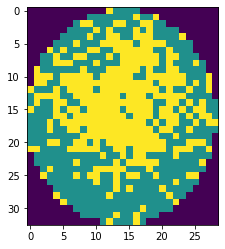

wafer_id:729, ウエハサイズ:33x29, スタンプサイズ:4x2, oDefects:185, nDefects:325, p=56.923


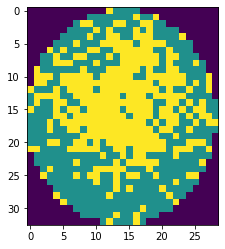

wafer_id:729, ウエハサイズ:33x29, スタンプサイズ:2x3, oDefects:185, nDefects:312, p=59.295


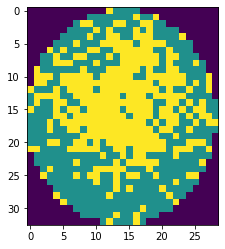

wafer_id:729, ウエハサイズ:33x29, スタンプサイズ:3x3, oDefects:185, nDefects:314, p=58.917


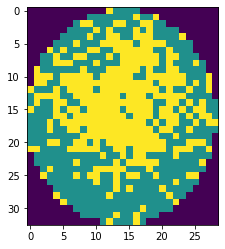

wafer_id:729, ウエハサイズ:33x29, スタンプサイズ:4x3, oDefects:185, nDefects:312, p=59.295


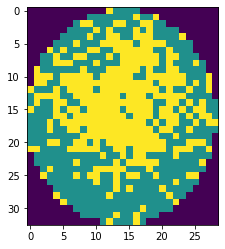

wafer_id:729, ウエハサイズ:33x29, スタンプサイズ:2x4, oDefects:185, nDefects:312, p=59.295


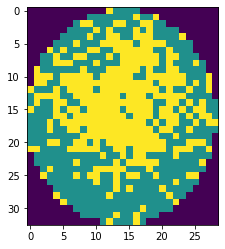

wafer_id:729, ウエハサイズ:33x29, スタンプサイズ:3x4, oDefects:186, nDefects:314, p=59.236


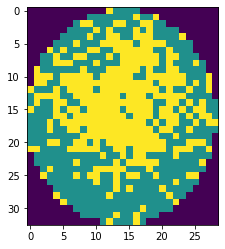

wafer_id:729, ウエハサイズ:33x29, スタンプサイズ:4x4, oDefects:185, nDefects:312, p=59.295


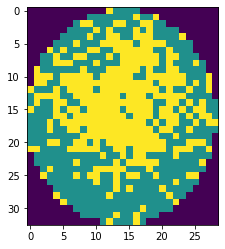

wafer_id:734, ウエハサイズ:33x29, スタンプサイズ:2x2, oDefects:180, nDefects:347, p=51.873


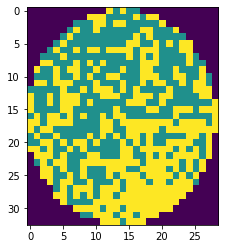

wafer_id:734, ウエハサイズ:33x29, スタンプサイズ:3x2, oDefects:183, nDefects:353, p=51.841


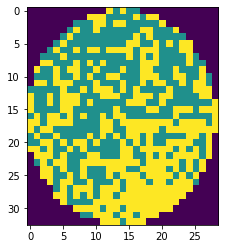

wafer_id:734, ウエハサイズ:33x29, スタンプサイズ:4x2, oDefects:180, nDefects:347, p=51.873


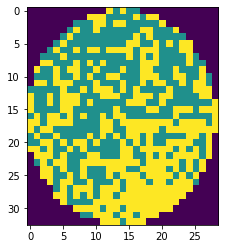

wafer_id:734, ウエハサイズ:33x29, スタンプサイズ:2x3, oDefects:163, nDefects:325, p=50.154


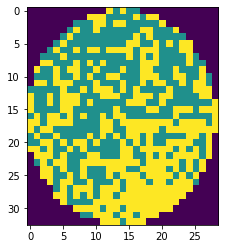

wafer_id:734, ウエハサイズ:33x29, スタンプサイズ:4x3, oDefects:163, nDefects:325, p=50.154


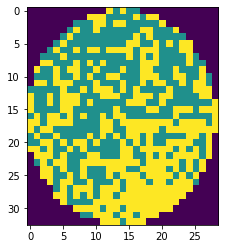

wafer_id:734, ウエハサイズ:33x29, スタンプサイズ:2x4, oDefects:163, nDefects:325, p=50.154


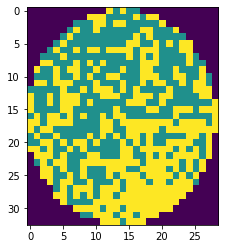

wafer_id:734, ウエハサイズ:33x29, スタンプサイズ:3x4, oDefects:166, nDefects:331, p=50.151


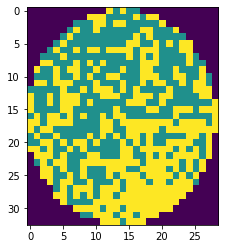

wafer_id:734, ウエハサイズ:33x29, スタンプサイズ:4x4, oDefects:163, nDefects:325, p=50.154


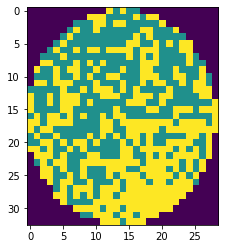

wafer_id:744, ウエハサイズ:27x25, スタンプサイズ:2x2, oDefects:152, nDefects:280, p=54.286


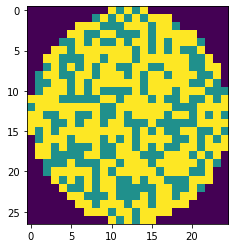

wafer_id:744, ウエハサイズ:27x25, スタンプサイズ:3x2, oDefects:154, nDefects:284, p=54.225


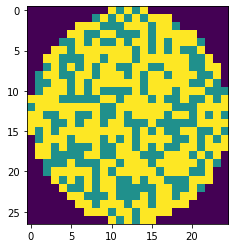

wafer_id:744, ウエハサイズ:27x25, スタンプサイズ:4x2, oDefects:141, nDefects:260, p=54.231


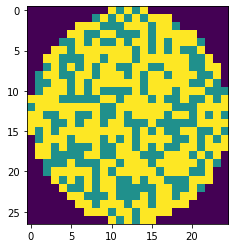

wafer_id:744, ウエハサイズ:27x25, スタンプサイズ:2x3, oDefects:142, nDefects:273, p=52.015


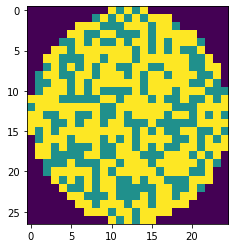

wafer_id:744, ウエハサイズ:27x25, スタンプサイズ:3x3, oDefects:143, nDefects:277, p=51.625


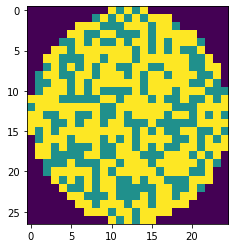

wafer_id:744, ウエハサイズ:27x25, スタンプサイズ:4x3, oDefects:130, nDefects:253, p=51.383


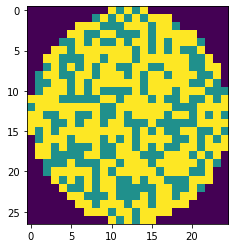

wafer_id:744, ウエハサイズ:27x25, スタンプサイズ:2x4, oDefects:150, nDefects:262, p=57.252


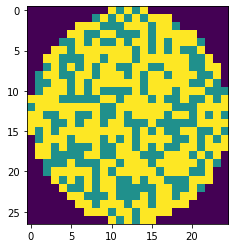

wafer_id:744, ウエハサイズ:27x25, スタンプサイズ:3x4, oDefects:151, nDefects:266, p=56.767


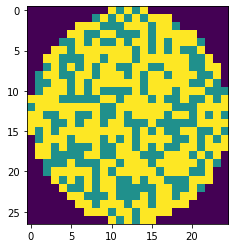

wafer_id:744, ウエハサイズ:27x25, スタンプサイズ:4x4, oDefects:140, nDefects:242, p=57.851


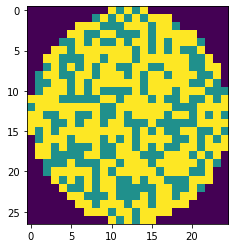

wafer_id:748, ウエハサイズ:27x25, スタンプサイズ:2x2, oDefects:178, nDefects:306, p=58.170


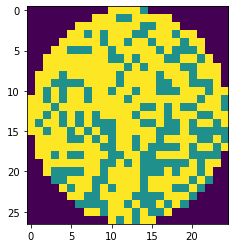

wafer_id:748, ウエハサイズ:27x25, スタンプサイズ:3x2, oDefects:180, nDefects:310, p=58.065


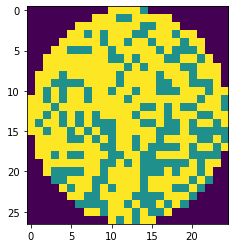

wafer_id:748, ウエハサイズ:27x25, スタンプサイズ:4x2, oDefects:173, nDefects:294, p=58.844


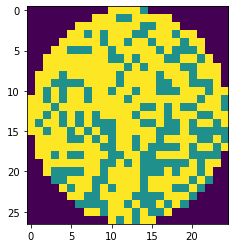

wafer_id:748, ウエハサイズ:27x25, スタンプサイズ:2x3, oDefects:173, nDefects:297, p=58.249


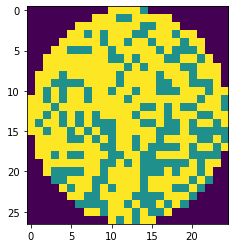

wafer_id:748, ウエハサイズ:27x25, スタンプサイズ:3x3, oDefects:174, nDefects:301, p=57.807


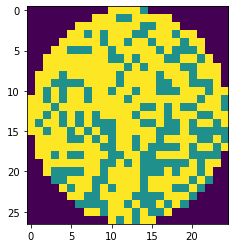

wafer_id:748, ウエハサイズ:27x25, スタンプサイズ:4x3, oDefects:167, nDefects:285, p=58.596


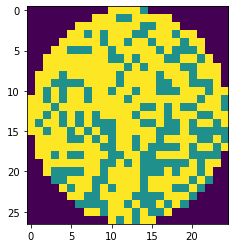

wafer_id:748, ウエハサイズ:27x25, スタンプサイズ:2x4, oDefects:158, nDefects:287, p=55.052


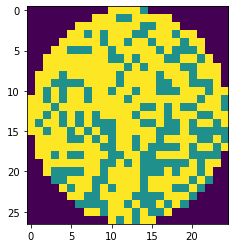

wafer_id:748, ウエハサイズ:27x25, スタンプサイズ:3x4, oDefects:159, nDefects:291, p=54.639


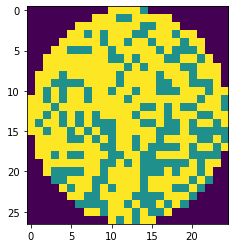

wafer_id:748, ウエハサイズ:27x25, スタンプサイズ:4x4, oDefects:155, nDefects:275, p=56.364


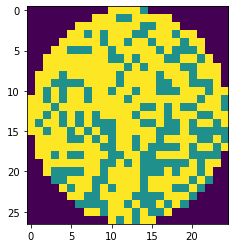

wafer_id:751, ウエハサイズ:27x25, スタンプサイズ:2x2, oDefects:91, nDefects:182, p=50.000


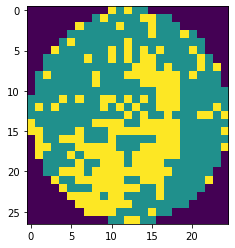

wafer_id:756, ウエハサイズ:39x37, スタンプサイズ:2x2, oDefects:271, nDefects:472, p=57.415


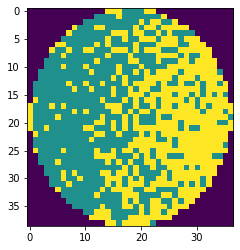

wafer_id:756, ウエハサイズ:39x37, スタンプサイズ:3x2, oDefects:275, nDefects:479, p=57.411


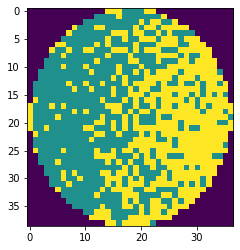

wafer_id:756, ウエハサイズ:39x37, スタンプサイズ:4x2, oDefects:260, nDefects:452, p=57.522


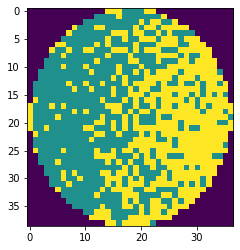

wafer_id:756, ウエハサイズ:39x37, スタンプサイズ:2x3, oDefects:245, nDefects:453, p=54.084


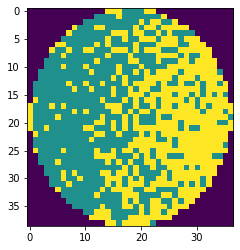

wafer_id:756, ウエハサイズ:39x37, スタンプサイズ:3x3, oDefects:249, nDefects:460, p=54.130


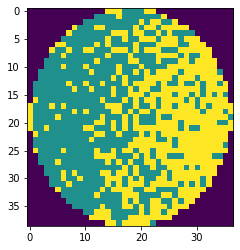

wafer_id:756, ウエハサイズ:39x37, スタンプサイズ:4x3, oDefects:236, nDefects:433, p=54.503


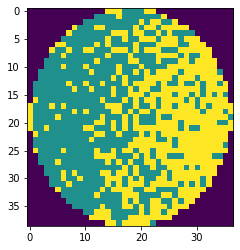

wafer_id:756, ウエハサイズ:39x37, スタンプサイズ:2x4, oDefects:230, nDefects:429, p=53.613


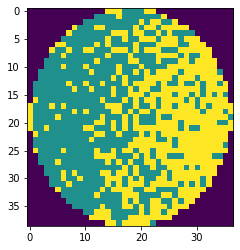

wafer_id:756, ウエハサイズ:39x37, スタンプサイズ:3x4, oDefects:233, nDefects:436, p=53.440


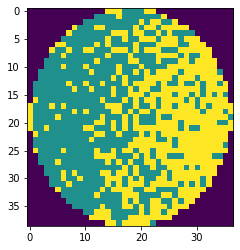

wafer_id:756, ウエハサイズ:39x37, スタンプサイズ:4x4, oDefects:224, nDefects:409, p=54.768


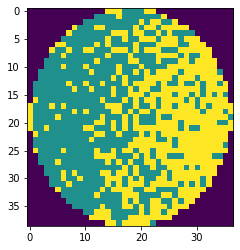

wafer_id:764, ウエハサイズ:39x37, スタンプサイズ:3x2, oDefects:286, nDefects:572, p=50.000


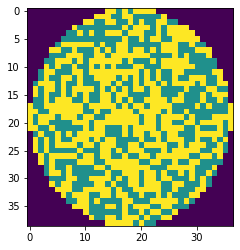

wafer_id:764, ウエハサイズ:39x37, スタンプサイズ:4x2, oDefects:278, nDefects:551, p=50.454


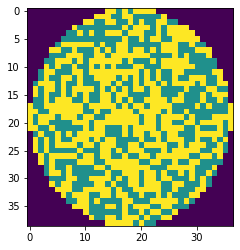

wafer_id:764, ウエハサイズ:39x37, スタンプサイズ:2x3, oDefects:290, nDefects:557, p=52.065


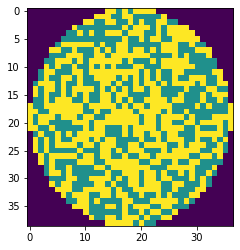

wafer_id:764, ウエハサイズ:39x37, スタンプサイズ:3x3, oDefects:293, nDefects:563, p=52.043


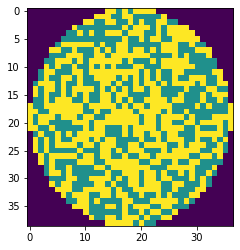

wafer_id:764, ウエハサイズ:39x37, スタンプサイズ:4x3, oDefects:282, nDefects:542, p=52.030


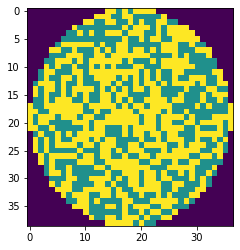

wafer_id:776, ウエハサイズ:39x37, スタンプサイズ:2x2, oDefects:271, nDefects:488, p=55.533


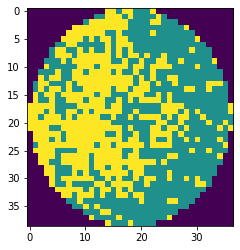

wafer_id:776, ウエハサイズ:39x37, スタンプサイズ:3x2, oDefects:271, nDefects:490, p=55.306


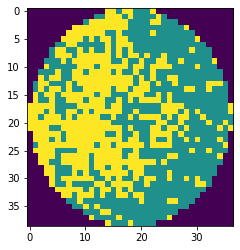

wafer_id:776, ウエハサイズ:39x37, スタンプサイズ:4x2, oDefects:271, nDefects:483, p=56.108


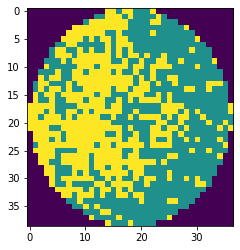

wafer_id:776, ウエハサイズ:39x37, スタンプサイズ:2x3, oDefects:278, nDefects:486, p=57.202


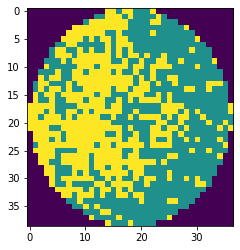

wafer_id:776, ウエハサイズ:39x37, スタンプサイズ:3x3, oDefects:278, nDefects:488, p=56.967


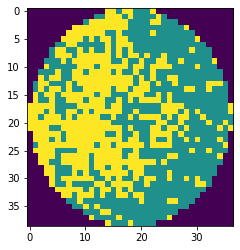

wafer_id:776, ウエハサイズ:39x37, スタンプサイズ:4x3, oDefects:278, nDefects:481, p=57.796


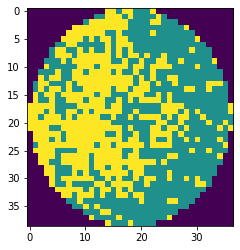

wafer_id:777, ウエハサイズ:39x37, スタンプサイズ:2x2, oDefects:242, nDefects:462, p=52.381


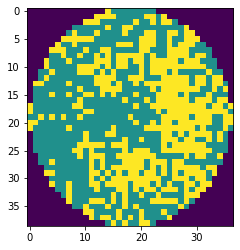

wafer_id:777, ウエハサイズ:39x37, スタンプサイズ:3x2, oDefects:243, nDefects:466, p=52.146


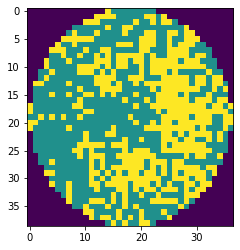

wafer_id:777, ウエハサイズ:39x37, スタンプサイズ:4x2, oDefects:238, nDefects:450, p=52.889


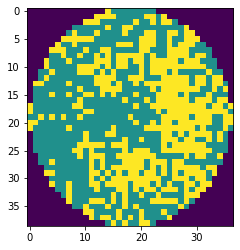

wafer_id:777, ウエハサイズ:39x37, スタンプサイズ:4x3, oDefects:224, nDefects:443, p=50.564


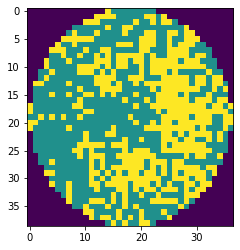

wafer_id:779, ウエハサイズ:39x37, スタンプサイズ:2x4, oDefects:341, nDefects:573, p=59.511


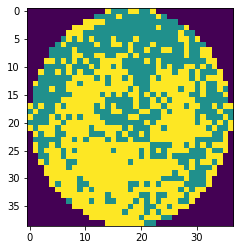

wafer_id:779, ウエハサイズ:39x37, スタンプサイズ:3x4, oDefects:344, nDefects:580, p=59.310


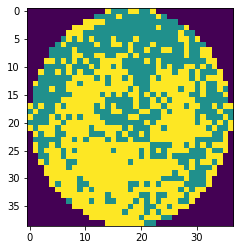

wafer_id:779, ウエハサイズ:39x37, スタンプサイズ:4x4, oDefects:324, nDefects:547, p=59.232


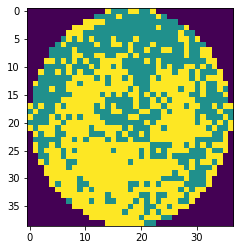

wafer_id:783, ウエハサイズ:34x34, スタンプサイズ:3x2, oDefects:206, nDefects:410, p=50.244


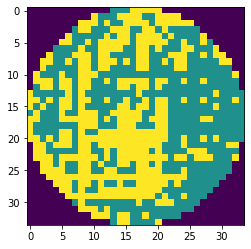

wafer_id:783, ウエハサイズ:34x34, スタンプサイズ:4x2, oDefects:204, nDefects:404, p=50.495


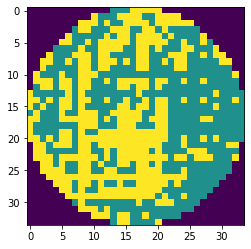

wafer_id:783, ウエハサイズ:34x34, スタンプサイズ:2x3, oDefects:223, nDefects:409, p=54.523


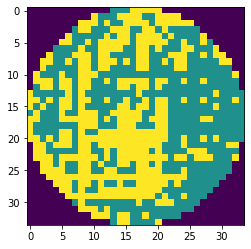

wafer_id:783, ウエハサイズ:34x34, スタンプサイズ:3x3, oDefects:223, nDefects:406, p=54.926


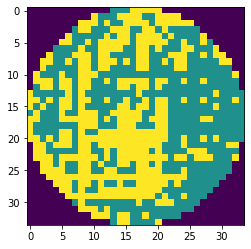

wafer_id:783, ウエハサイズ:34x34, スタンプサイズ:4x3, oDefects:220, nDefects:400, p=55.000


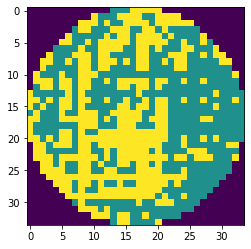

wafer_id:784, ウエハサイズ:34x34, スタンプサイズ:2x4, oDefects:315, nDefects:531, p=59.322


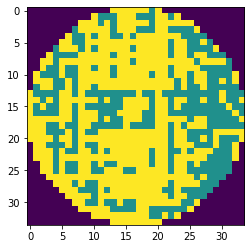

wafer_id:784, ウエハサイズ:34x34, スタンプサイズ:3x4, oDefects:311, nDefects:523, p=59.465


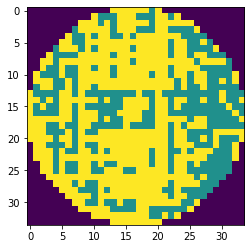

wafer_id:784, ウエハサイズ:34x34, スタンプサイズ:4x4, oDefects:305, nDefects:512, p=59.570


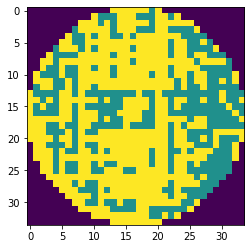

wafer_id:785, ウエハサイズ:34x34, スタンプサイズ:2x4, oDefects:316, nDefects:527, p=59.962


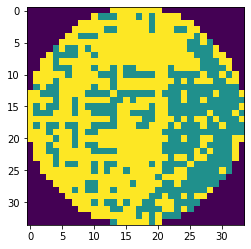

wafer_id:786, ウエハサイズ:34x34, スタンプサイズ:2x3, oDefects:191, nDefects:370, p=51.622


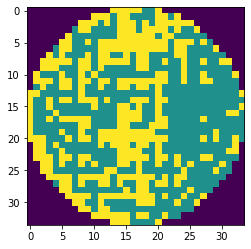

wafer_id:786, ウエハサイズ:34x34, スタンプサイズ:3x3, oDefects:191, nDefects:366, p=52.186


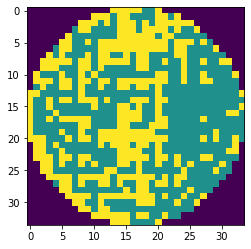

wafer_id:786, ウエハサイズ:34x34, スタンプサイズ:4x3, oDefects:185, nDefects:357, p=51.821


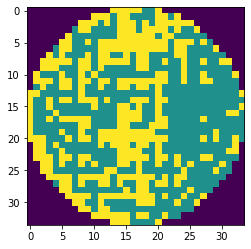

wafer_id:788, ウエハサイズ:34x34, スタンプサイズ:2x2, oDefects:270, nDefects:464, p=58.190


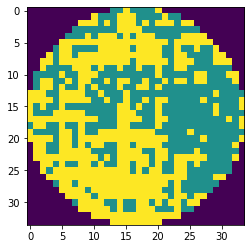

wafer_id:788, ウエハサイズ:34x34, スタンプサイズ:3x2, oDefects:264, nDefects:456, p=57.895


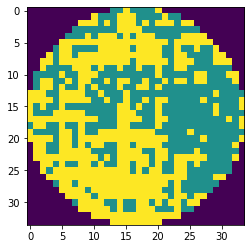

wafer_id:788, ウエハサイズ:34x34, スタンプサイズ:4x2, oDefects:252, nDefects:442, p=57.014


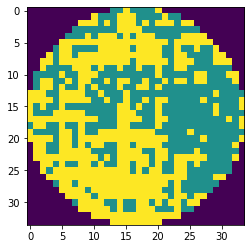

wafer_id:788, ウエハサイズ:34x34, スタンプサイズ:2x4, oDefects:240, nDefects:450, p=53.333


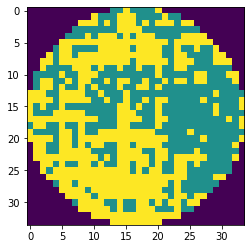

wafer_id:788, ウエハサイズ:34x34, スタンプサイズ:3x4, oDefects:236, nDefects:442, p=53.394


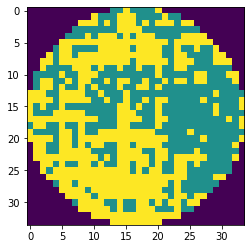

wafer_id:788, ウエハサイズ:34x34, スタンプサイズ:4x4, oDefects:226, nDefects:428, p=52.804


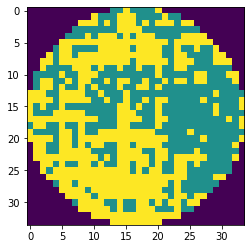

wafer_id:789, ウエハサイズ:34x34, スタンプサイズ:2x4, oDefects:304, nDefects:510, p=59.608


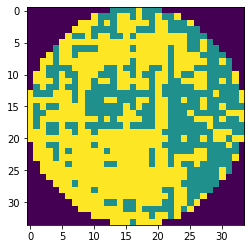

wafer_id:789, ウエハサイズ:34x34, スタンプサイズ:3x4, oDefects:301, nDefects:503, p=59.841


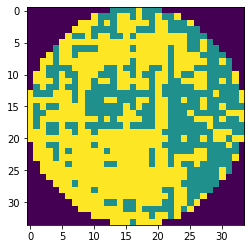

wafer_id:789, ウエハサイズ:34x34, スタンプサイズ:4x4, oDefects:294, nDefects:491, p=59.878


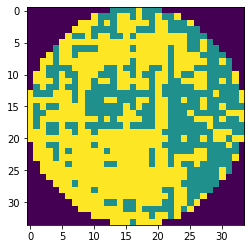

wafer_id:790, ウエハサイズ:34x34, スタンプサイズ:2x2, oDefects:281, nDefects:486, p=57.819


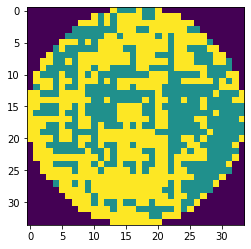

wafer_id:790, ウエハサイズ:34x34, スタンプサイズ:3x2, oDefects:275, nDefects:478, p=57.531


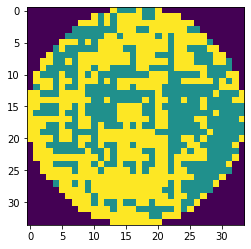

wafer_id:790, ウエハサイズ:34x34, スタンプサイズ:4x2, oDefects:267, nDefects:466, p=57.296


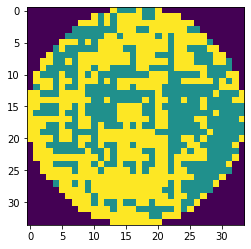

wafer_id:790, ウエハサイズ:34x34, スタンプサイズ:2x3, oDefects:274, nDefects:478, p=57.322


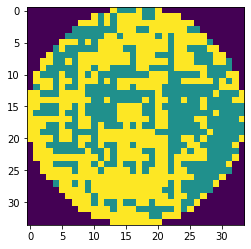

wafer_id:790, ウエハサイズ:34x34, スタンプサイズ:3x3, oDefects:269, nDefects:470, p=57.234


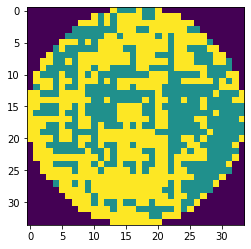

wafer_id:790, ウエハサイズ:34x34, スタンプサイズ:4x3, oDefects:262, nDefects:458, p=57.205


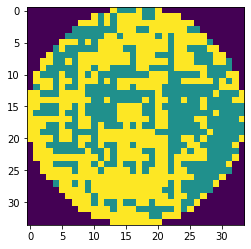

wafer_id:790, ウエハサイズ:34x34, スタンプサイズ:2x4, oDefects:247, nDefects:469, p=52.665


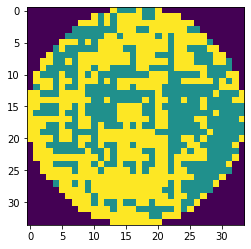

wafer_id:790, ウエハサイズ:34x34, スタンプサイズ:3x4, oDefects:243, nDefects:461, p=52.711


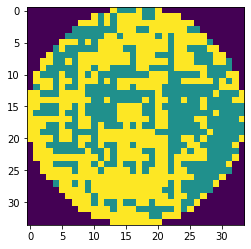

wafer_id:790, ウエハサイズ:34x34, スタンプサイズ:4x4, oDefects:236, nDefects:449, p=52.561


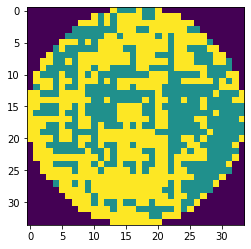

wafer_id:791, ウエハサイズ:34x34, スタンプサイズ:2x3, oDefects:229, nDefects:409, p=55.990


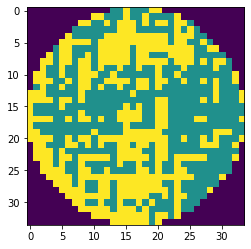

wafer_id:791, ウエハサイズ:34x34, スタンプサイズ:3x3, oDefects:225, nDefects:402, p=55.970


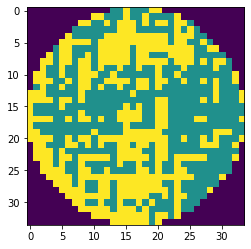

wafer_id:791, ウエハサイズ:34x34, スタンプサイズ:4x3, oDefects:216, nDefects:390, p=55.385


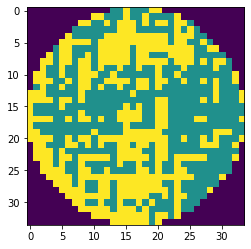

wafer_id:792, ウエハサイズ:34x34, スタンプサイズ:2x3, oDefects:213, nDefects:403, p=52.854


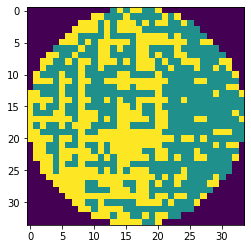

wafer_id:792, ウエハサイズ:34x34, スタンプサイズ:3x3, oDefects:210, nDefects:397, p=52.897


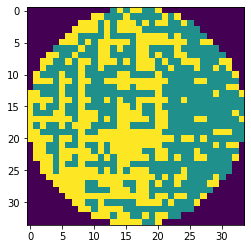

wafer_id:792, ウエハサイズ:34x34, スタンプサイズ:4x3, oDefects:206, nDefects:389, p=52.956


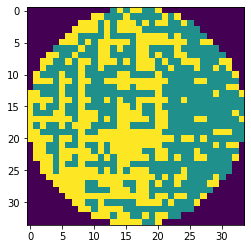

wafer_id:793, ウエハサイズ:34x34, スタンプサイズ:2x2, oDefects:217, nDefects:417, p=52.038


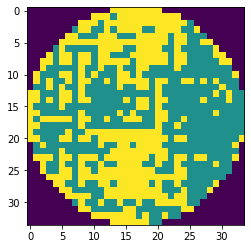

wafer_id:793, ウエハサイズ:34x34, スタンプサイズ:3x2, oDefects:213, nDefects:411, p=51.825


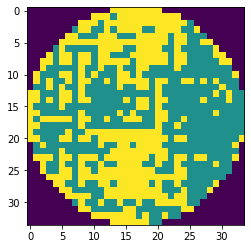

wafer_id:793, ウエハサイズ:34x34, スタンプサイズ:4x2, oDefects:207, nDefects:402, p=51.493


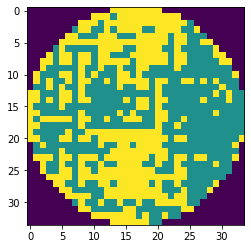

wafer_id:793, ウエハサイズ:34x34, スタンプサイズ:2x3, oDefects:243, nDefects:411, p=59.124


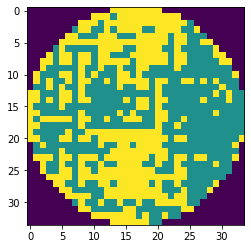

wafer_id:793, ウエハサイズ:34x34, スタンプサイズ:3x3, oDefects:240, nDefects:405, p=59.259


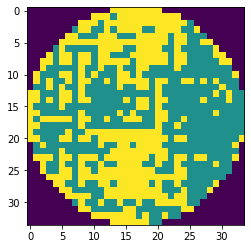

wafer_id:793, ウエハサイズ:34x34, スタンプサイズ:4x3, oDefects:234, nDefects:396, p=59.091


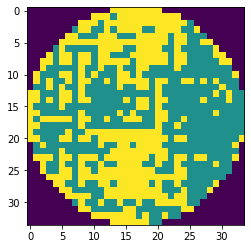

wafer_id:793, ウエハサイズ:34x34, スタンプサイズ:2x4, oDefects:204, nDefects:402, p=50.746


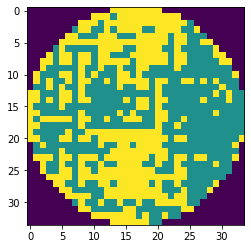

wafer_id:793, ウエハサイズ:34x34, スタンプサイズ:3x4, oDefects:202, nDefects:396, p=51.010


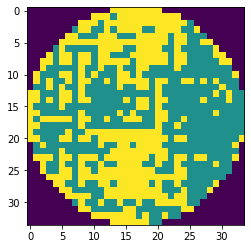

wafer_id:793, ウエハサイズ:34x34, スタンプサイズ:4x4, oDefects:198, nDefects:387, p=51.163


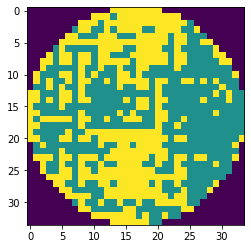

wafer_id:795, ウエハサイズ:34x34, スタンプサイズ:2x4, oDefects:299, nDefects:502, p=59.562


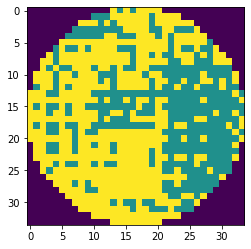

wafer_id:795, ウエハサイズ:34x34, スタンプサイズ:3x4, oDefects:295, nDefects:494, p=59.717


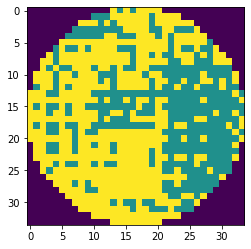

wafer_id:795, ウエハサイズ:34x34, スタンプサイズ:4x4, oDefects:285, nDefects:480, p=59.375


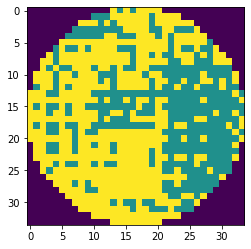

wafer_id:796, ウエハサイズ:34x34, スタンプサイズ:2x3, oDefects:194, nDefects:386, p=50.259


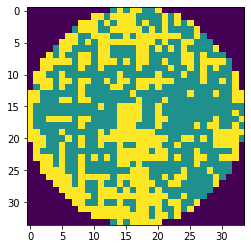

wafer_id:796, ウエハサイズ:34x34, スタンプサイズ:3x3, oDefects:191, nDefects:380, p=50.263


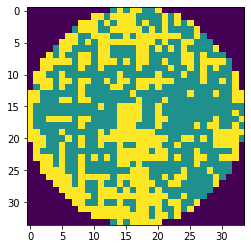

wafer_id:797, ウエハサイズ:34x34, スタンプサイズ:2x2, oDefects:225, nDefects:413, p=54.479


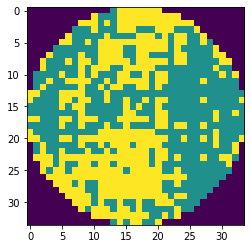

wafer_id:797, ウエハサイズ:34x34, スタンプサイズ:3x2, oDefects:224, nDefects:409, p=54.768


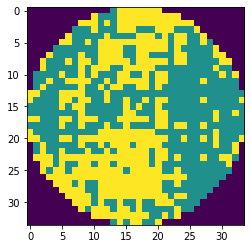

wafer_id:797, ウエハサイズ:34x34, スタンプサイズ:4x2, oDefects:216, nDefects:398, p=54.271


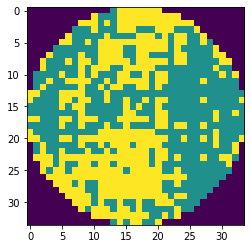

wafer_id:797, ウエハサイズ:34x34, スタンプサイズ:2x3, oDefects:238, nDefects:406, p=58.621


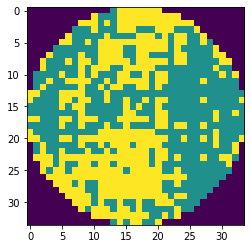

wafer_id:797, ウエハサイズ:34x34, スタンプサイズ:3x3, oDefects:236, nDefects:402, p=58.706


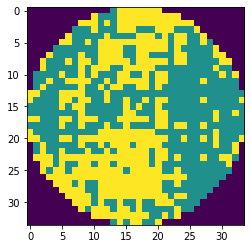

wafer_id:797, ウエハサイズ:34x34, スタンプサイズ:4x3, oDefects:229, nDefects:391, p=58.568


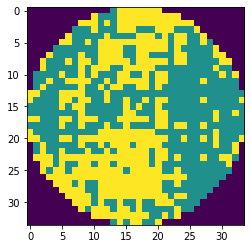

wafer_id:797, ウエハサイズ:34x34, スタンプサイズ:2x4, oDefects:206, nDefects:398, p=51.759


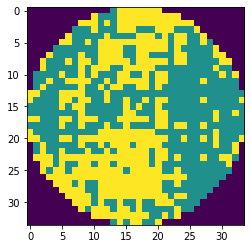

wafer_id:797, ウエハサイズ:34x34, スタンプサイズ:3x4, oDefects:205, nDefects:394, p=52.030


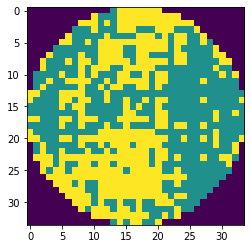

wafer_id:797, ウエハサイズ:34x34, スタンプサイズ:4x4, oDefects:199, nDefects:383, p=51.958


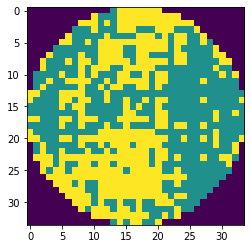

wafer_id:800, ウエハサイズ:34x34, スタンプサイズ:2x3, oDefects:189, nDefects:356, p=53.090


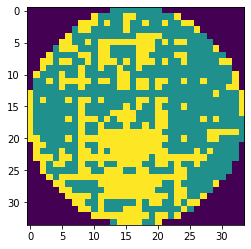

wafer_id:800, ウエハサイズ:34x34, スタンプサイズ:3x3, oDefects:187, nDefects:351, p=53.276


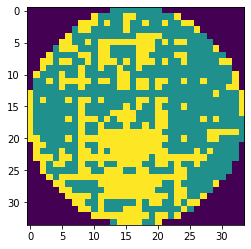

wafer_id:800, ウエハサイズ:34x34, スタンプサイズ:4x3, oDefects:178, nDefects:339, p=52.507


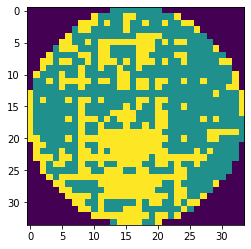

wafer_id:803, ウエハサイズ:34x34, スタンプサイズ:2x3, oDefects:304, nDefects:526, p=57.795


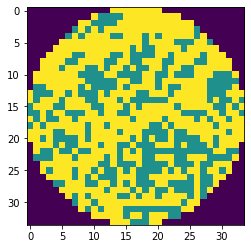

wafer_id:803, ウエハサイズ:34x34, スタンプサイズ:3x3, oDefects:304, nDefects:521, p=58.349


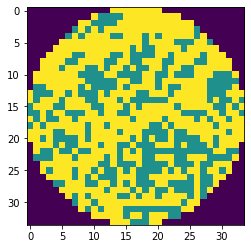

wafer_id:803, ウエハサイズ:34x34, スタンプサイズ:4x3, oDefects:298, nDefects:511, p=58.317


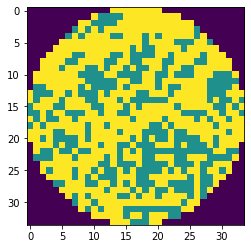

wafer_id:803, ウエハサイズ:34x34, スタンプサイズ:2x4, oDefects:285, nDefects:500, p=57.000


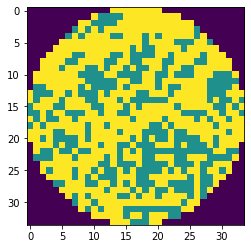

wafer_id:803, ウエハサイズ:34x34, スタンプサイズ:3x4, oDefects:284, nDefects:495, p=57.374


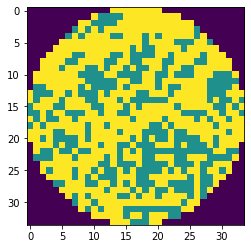

wafer_id:803, ウエハサイズ:34x34, スタンプサイズ:4x4, oDefects:279, nDefects:485, p=57.526


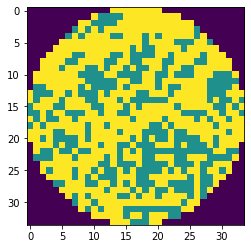

wafer_id:806, ウエハサイズ:44x41, スタンプサイズ:2x2, oDefects:355, nDefects:703, p=50.498


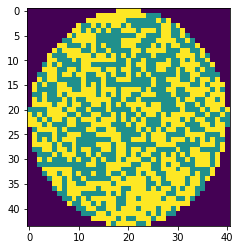

wafer_id:806, ウエハサイズ:44x41, スタンプサイズ:3x2, oDefects:346, nDefects:686, p=50.437


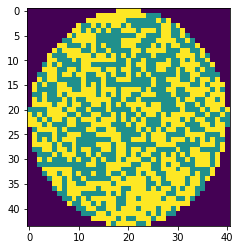

wafer_id:806, ウエハサイズ:44x41, スタンプサイズ:4x2, oDefects:355, nDefects:703, p=50.498


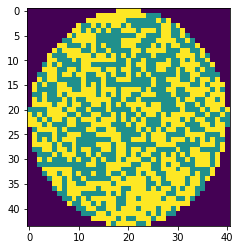

wafer_id:806, ウエハサイズ:44x41, スタンプサイズ:2x3, oDefects:343, nDefects:679, p=50.515


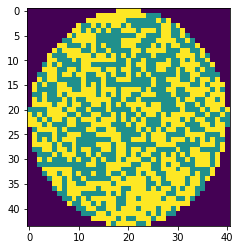

wafer_id:806, ウエハサイズ:44x41, スタンプサイズ:3x3, oDefects:334, nDefects:662, p=50.453


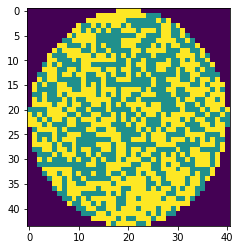

wafer_id:806, ウエハサイズ:44x41, スタンプサイズ:4x3, oDefects:343, nDefects:679, p=50.515


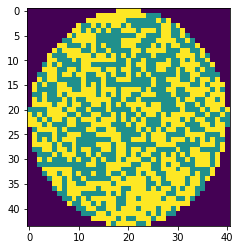

wafer_id:811, ウエハサイズ:44x41, スタンプサイズ:2x2, oDefects:362, nDefects:710, p=50.986


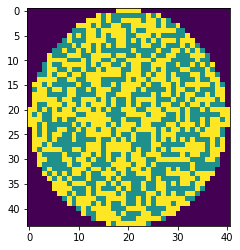

wafer_id:811, ウエハサイズ:44x41, スタンプサイズ:3x2, oDefects:351, nDefects:693, p=50.649


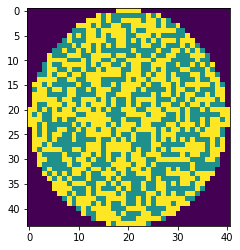

wafer_id:811, ウエハサイズ:44x41, スタンプサイズ:4x2, oDefects:362, nDefects:710, p=50.986


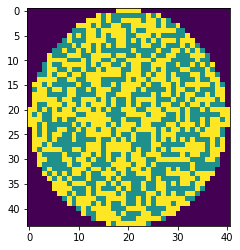

wafer_id:815, ウエハサイズ:44x41, スタンプサイズ:2x2, oDefects:391, nDefects:747, p=52.343


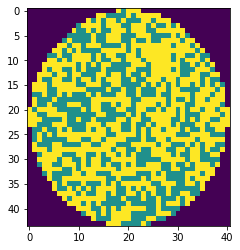

wafer_id:815, ウエハサイズ:44x41, スタンプサイズ:3x2, oDefects:388, nDefects:736, p=52.717


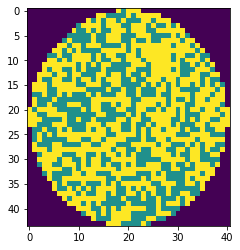

wafer_id:815, ウエハサイズ:44x41, スタンプサイズ:4x2, oDefects:391, nDefects:747, p=52.343


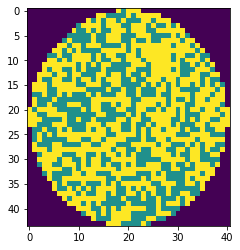

wafer_id:815, ウエハサイズ:44x41, スタンプサイズ:2x3, oDefects:374, nDefects:716, p=52.235


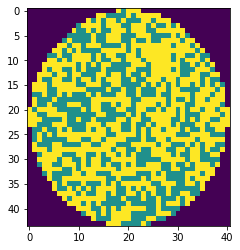

wafer_id:815, ウエハサイズ:44x41, スタンプサイズ:3x3, oDefects:373, nDefects:705, p=52.908


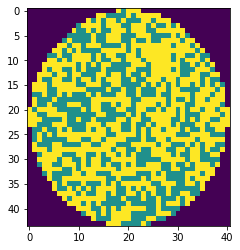

wafer_id:815, ウエハサイズ:44x41, スタンプサイズ:4x3, oDefects:374, nDefects:716, p=52.235


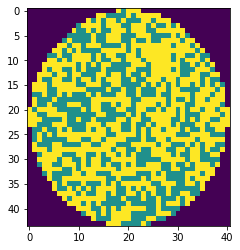

wafer_id:815, ウエハサイズ:44x41, スタンプサイズ:2x4, oDefects:363, nDefects:716, p=50.698


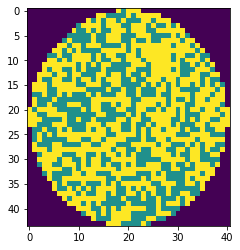

wafer_id:815, ウエハサイズ:44x41, スタンプサイズ:3x4, oDefects:361, nDefects:705, p=51.206


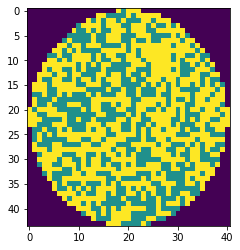

wafer_id:815, ウエハサイズ:44x41, スタンプサイズ:4x4, oDefects:363, nDefects:716, p=50.698


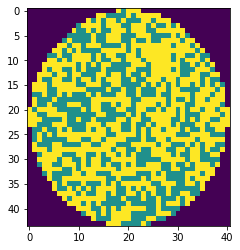

wafer_id:829, ウエハサイズ:39x50, スタンプサイズ:2x2, oDefects:381, nDefects:762, p=50.000


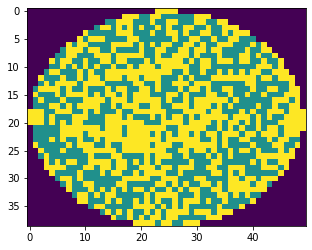

wafer_id:829, ウエハサイズ:39x50, スタンプサイズ:4x3, oDefects:351, nDefects:700, p=50.143


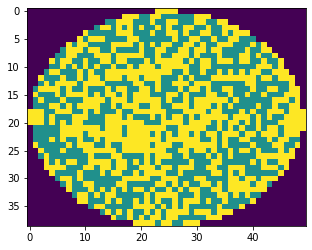

wafer_id:829, ウエハサイズ:39x50, スタンプサイズ:2x4, oDefects:367, nDefects:713, p=51.473


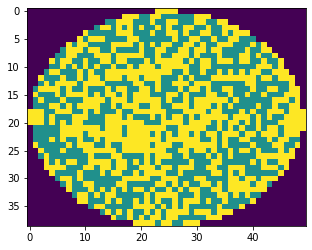

wafer_id:829, ウエハサイズ:39x50, スタンプサイズ:3x4, oDefects:371, nDefects:722, p=51.385


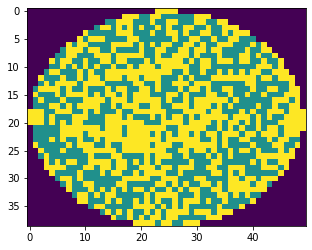

wafer_id:829, ウエハサイズ:39x50, スタンプサイズ:4x4, oDefects:356, nDefects:688, p=51.744


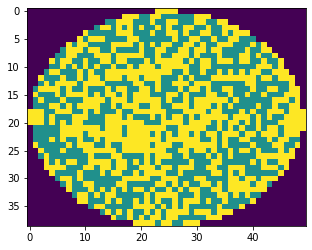

wafer_id:851, ウエハサイズ:42x44, スタンプサイズ:2x4, oDefects:318, nDefects:577, p=55.113


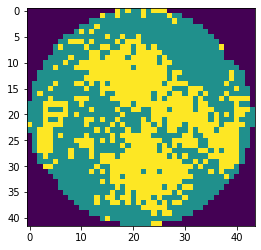

wafer_id:851, ウエハサイズ:42x44, スタンプサイズ:3x4, oDefects:318, nDefects:577, p=55.113


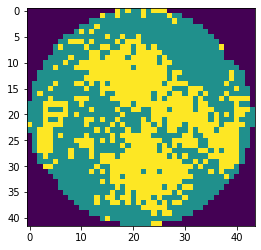

wafer_id:851, ウエハサイズ:42x44, スタンプサイズ:4x4, oDefects:318, nDefects:574, p=55.401


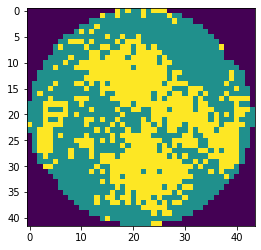

wafer_id:858, ウエハサイズ:33x35, スタンプサイズ:2x3, oDefects:274, nDefects:481, p=56.965


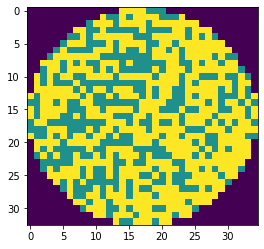

wafer_id:858, ウエハサイズ:33x35, スタンプサイズ:3x3, oDefects:277, nDefects:487, p=56.879


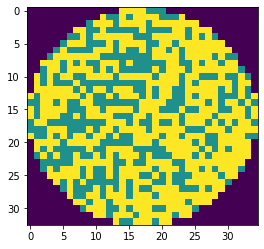

wafer_id:858, ウエハサイズ:33x35, スタンプサイズ:4x3, oDefects:274, nDefects:481, p=56.965


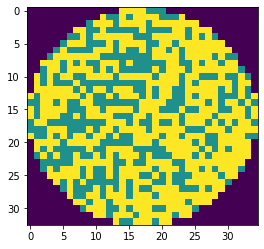

wafer_id:858, ウエハサイズ:33x35, スタンプサイズ:2x4, oDefects:247, nDefects:448, p=55.134


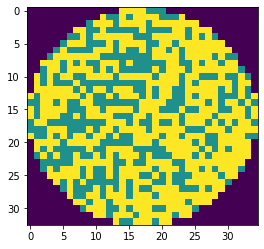

wafer_id:858, ウエハサイズ:33x35, スタンプサイズ:3x4, oDefects:250, nDefects:454, p=55.066


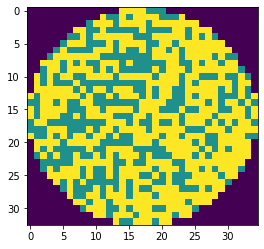

wafer_id:858, ウエハサイズ:33x35, スタンプサイズ:4x4, oDefects:247, nDefects:448, p=55.134


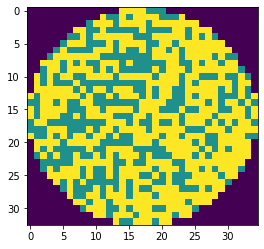

wafer_id:865, ウエハサイズ:26x30, スタンプサイズ:2x2, oDefects:158, nDefects:303, p=52.145


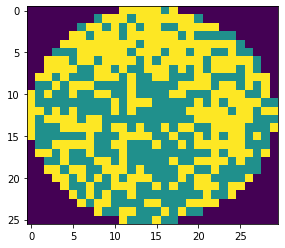

wafer_id:865, ウエハサイズ:26x30, スタンプサイズ:3x2, oDefects:157, nDefects:296, p=53.041


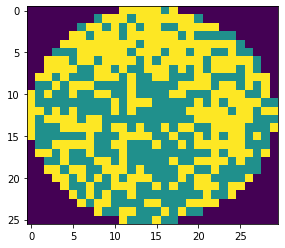

wafer_id:865, ウエハサイズ:26x30, スタンプサイズ:4x2, oDefects:157, nDefects:296, p=53.041


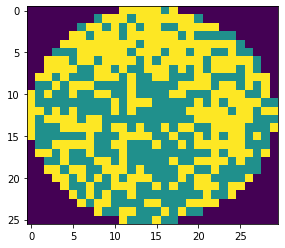

wafer_id:865, ウエハサイズ:26x30, スタンプサイズ:3x3, oDefects:147, nDefects:293, p=50.171


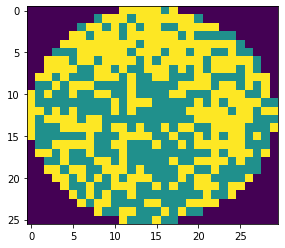

wafer_id:865, ウエハサイズ:26x30, スタンプサイズ:4x3, oDefects:147, nDefects:293, p=50.171


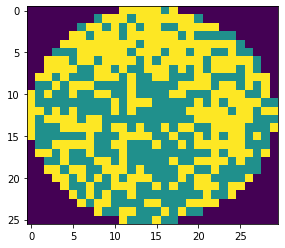

In [20]:
# random pattern 60 - 50
for w_id in range(len(sub_df)):
    x = sub_df.iloc[w_id, :]['waferMap']
    if w_id % 1000 == 0: print(x.shape)
    for w in range(2, 5):
        for h in range(2, 5):
            detectShotDefects(x, w_id, w, h)

In [54]:

    uni_waferDim=np.unique(df.waferMapDim, return_counts=True)
    wdim = uni_waferDim[0]
    failure_list = ['Center', 'Donut', 'Edge-Loc', 'Edge-Ring', 'Loc', 'Random', 'Scratch', 'Near-full', 'none']
    usable_wdim_list = []
    usable_wafer_num = 0
    for i in range(len(wdim)):
        if wdim[i][0] > max_size or wdim[i][1] > max_size:
            continue
        sub_df = df.loc[df['waferMapDim'] == wdim[i]]
        pattern_num = [0] * 9
        for j in range(len(sub_df)):
            if len(sub_df.iloc[j,:]['failureType']) == 0:
                continue
            pattern = sub_df.iloc[j,:]['failureType'][0][0]
            pattern_num[failure_list.index(pattern)] += 1
        usable_wdim_list.append(wdim[i])
        print(wdim[i], len(sub_df), sum(pattern_num))
        usable_wafer_num += sum(pattern_num)
    print(usable_wafer_num)

In [55]:
def make_unisize_wafer(size, wafer):
    width, height = wafer.shape
    unisize_wafer = np.zeros((size, size))
    width_pad = int((size - width) / 2)
    height_pad = int((size - height) / 2)
    unisize_wafer[width_pad:width_pad + width, height_pad:height_pad + height] = wafer
    return unisize_wafer

In [56]:
if MAKE_DATASET:
    sw = np.ones((usable_wafer_num, max_size, max_size), dtype='int8')
    label = list()
    count = 0
    pattern_num_list = []
    for usable_wdim in usable_wdim_list:
        sub_df = df.loc[df['waferMapDim'] == usable_wdim]
        sub_wafer = sub_df['waferMap'].values
        print(usable_wdim)
        print(len(sub_df))
        
        num = 0
        for i in range(len(sub_df)):
            # skip null label
            if len(sub_df.iloc[i,:]['failureType']) == 0:
                continue
            sw[count] = make_unisize_wafer(max_size, sub_df.iloc[i,:]['waferMap'])
            label.append(sub_df.iloc[i,:]['failureType'][0][0])
            count += 1
            num += 1
            if i % 1000 == 0:
                print(" ", i)
        pattern_num_list.append(num)
    x = sw
    y = np.array(label).reshape((-1,1))